## Rounded Micro Domain

The micro domain is defined by a bounding box and a smooth function parameterising the floor of the micro domain. 

In [1]:
import sys
sys.path.append('/home/emastr/phd/')

import torch
from boundary_solvers.gauss_grid_2d import *
from boundary_solvers.geometry import *
import numpy as np
import matplotlib.pyplot as plt
from util.plot_tools import *
from boundary_solvers.blobs import *

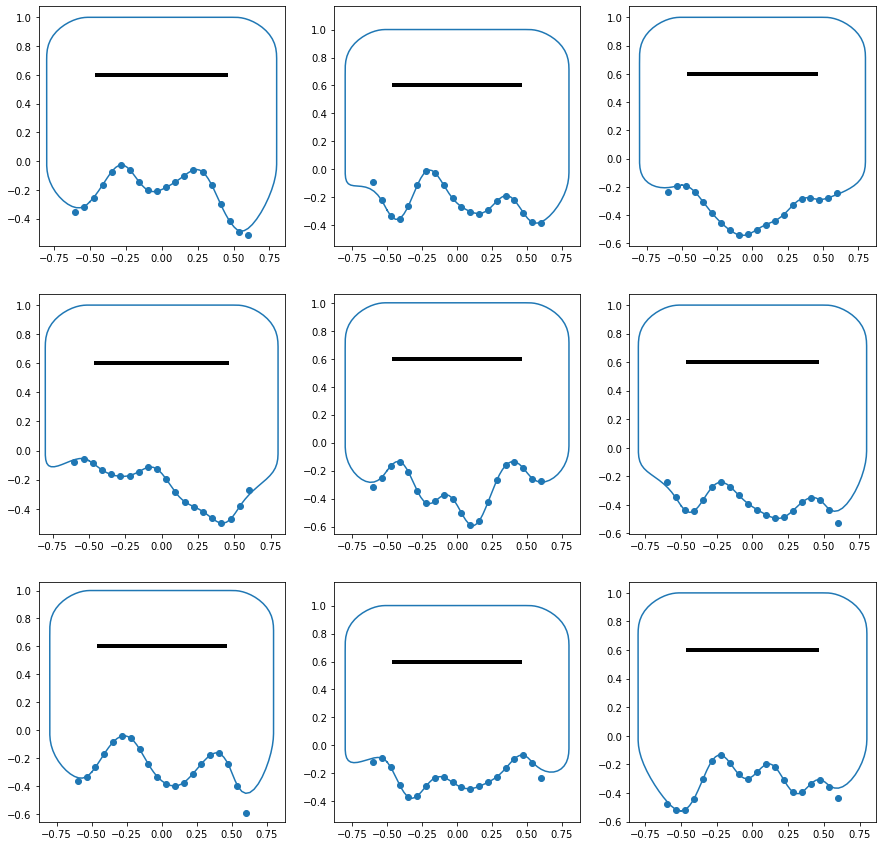

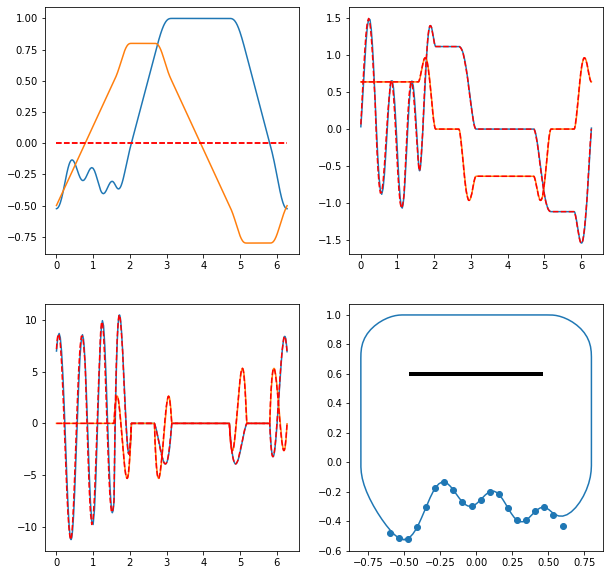

In [8]:
np.random.seed(0)
n = 3
plt.figure(figsize=(15,15))
riesz = []
zvec = []
for i in range(n * n):
    
    plt.subplot(n,n,i+1)
    mg = GPDomain("exp", 
                  shape=.05, 
                  num=20, 
                  scale=.05, 
                  bound=.3, 
                  width=1, 
                  height=1, 
                  corner_w = 0.3,
                  line_pos=0.6, 
                  n_refine=2, 
                  n_corner_refine=0)   
    
    mg.plot(ax=plt.gca())
    #remove_axes(plt.gca())
    plt.axis("equal")


    
plt.figure(figsize=(10,10))
plt.subplot(2,2,4)
mg.plot(ax=plt.gca())
t,w = mg.grid.get_grid_and_weights()
ddz = np.zeros_like(t[:-1])
for der in range(3):
    dz = mg.eval_param(derivative=der)
    plt.subplot(2,2,der+1)
    plt.plot(t,np.imag(dz))
    plt.plot(t,np.real(dz))
    plt.plot(t[:-1],np.imag(ddz), 'r--')
    plt.plot(t[:-1],np.real(ddz), 'r--')
    ddz = (dz[1:]-dz[:-1])/(t[1:]-t[:-1])
    

Converged in 0 iterations
Converged in 0 iterations
Converged in 0 iterations
Converged in 0 iterations


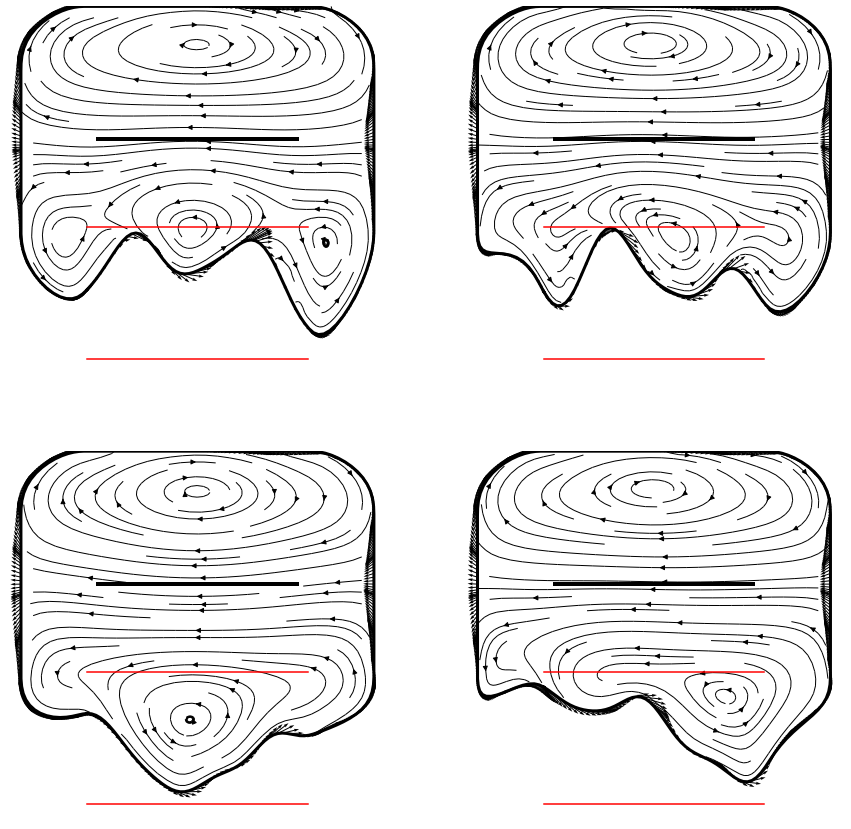

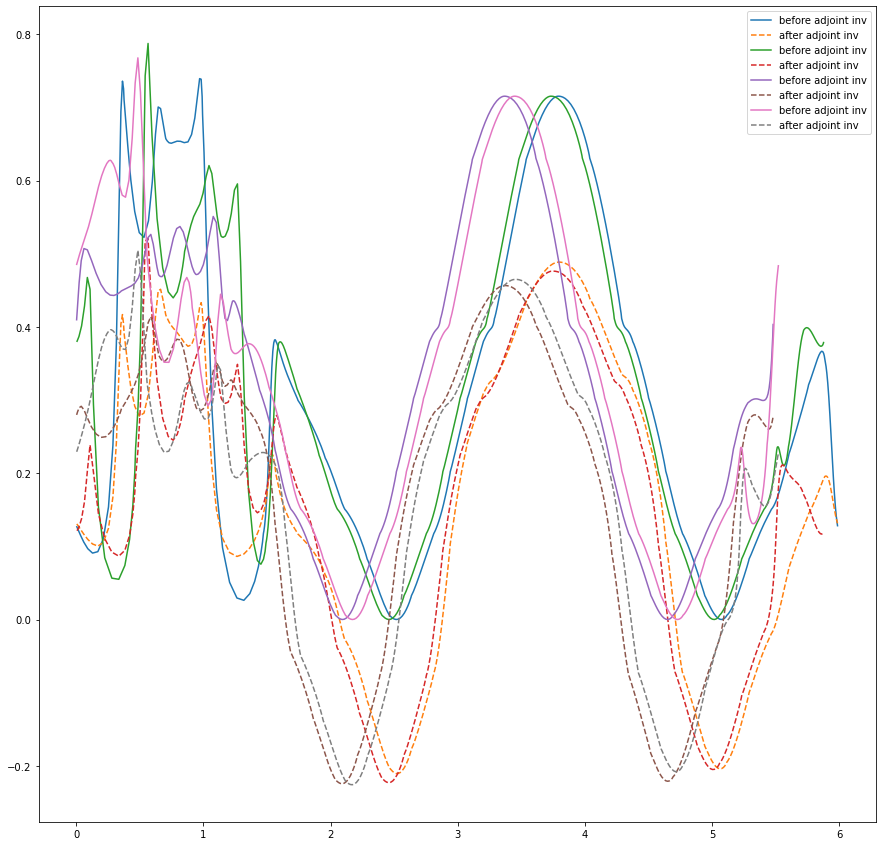

In [7]:
np.random.seed(0)
n = 2
plt.figure(figsize=(15,15))
plt.figure(figsize=(15,15))
riesz = []
zvec = []
for i in range(n * n):
    
    mg = GPDomain("exp", 
                  shape=.05, 
                  num=20, 
                  scale=.05, 
                  bound=.3, 
                  width=1, 
                  height=1, 
                  corner_w = 0.3,
                  line_pos=0.4, 
                  n_refine=2, 
                  n_corner_refine=0)    
    
    r1, func = mg.precompute_line_avg(derivative=0, tol=1e-10, maxiter=40, verbose=True)
    r2, _    = mg.precompute_line_avg(derivative=1, tol=1e-10, maxiter=40)
    r3, _    = mg.line_eval_adjoint(derivative=0, tol=1e-10, maxiter=40)
    mg.data["riesz_vec"]     = r1
    mg.data["riesz_vec_der"] = r2
    z = mg.eval_param()
    dz = mg.eval_param(derivative=1)
    a = mg.curve_length()
    
    # To test, plot field corresponding to riesz vector
    v = mg.zero_flow(r1)
    v /= np.linalg.norm(v)
    condition = lambda t: v
    problem = StokesDirichletProblem(mg, condition)
    problem.solve(tol=1e-9, maxiter=40)
    
    ### PLOT ###
    print(f"{i+1}/{n*n} done", end="\r")
   
    
    vel = lambda z: np.abs(problem.evaluate(z))
    #problem.geometry.plot_field(ax=plt.gca(), func=vel, apply_mask=True, cmap='inferno', vmax=np.max(np.abs(v)))
    #problem.geometry.plot_stream(ax=plt.gca(), func=problem.evaluate, apply_mask=True, color='white')
    #plt.quiver(np.real(z), np.imag(z), np.real(r1), np.imag(r1), color="red", scale=5)
    #mg.plot(ax=plt.gca(), show_samples=False, color="white", linewidth=3)  
    
    
    plt.figure(1)
    plt.subplot(n,n,i+1) 
    problem.geometry.plot_stream(ax=plt.gca(), func=problem.evaluate, apply_mask=True, color='black', linewidth=1)
    plt.quiver(np.real(z), np.imag(z), np.real(r1), np.imag(r1), color="black", scale=8)
    mg.plot(ax=plt.gca(), show_samples=False, color="black", linewidth=3)  
    
    plt.plot([-0.5,0.5], [0,0], "red")
    plt.plot([-0.5,0.5], [-0.6,-0.6], "red")
    
    #plt.xlim([-1,1])
    #plt.xlim([-1,1])
    plt.axis("equal")
    remove_axes(plt.gca())
    
    plt.figure(2)
    #plt.subplot(n,n,i+1) 
    plt.plot(a, np.real(r3), label="before adjoint inv")
    plt.plot(a, np.real(r1), '--', label="after adjoint inv")
    plt.legend()
    
    riesz.append(r1)
    zvec.append(z)
    
#plt.figure()
#for r in riesz:
#    plt.plot(np.imag(r))

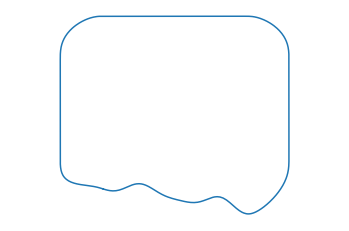

In [4]:
z_mean = np.zeros_like(zvec[0])
for z in zvec:
    z_mean += z / n**2

plt.plot(np.real(z_mean), np.imag(z_mean))
plt.axis("equal")
remove_axes(plt.gca())

## Generating a data set

In [5]:
np.random.seed(0)
N = 200000
plt.figure(figsize=(15,15))
riesz = []
zvec = []
for i in range(N):
    print(f"{i+1}/{N} done", end="\n")
    mg = GPDomain("exp", 
                  shape=.05, 
                  num=20, 
                  scale=.05, 
                  bound=.3, 
                  width=1, 
                  height=1, 
                  corner_w = 0.3,
                  line_pos=np.random.rand()*0.4 + 0.2, 
                  n_refine=1, 
                  n_corner_refine=0)    
    
    r1, func = mg.precompute_line_avg(derivative=0, tol=1e-12, maxiter=200, verbose=True)
    r2, _    = mg.precompute_line_avg(derivative=1, tol=1e-12, maxiter=200, verbose=True)
    r3, _    = mg.line_eval_adjoint(derivative=0, tol=1e-12, maxiter=200, verbose=True)
    r4, _    = mg.line_eval_adjoint(derivative=1, tol=1e-12, maxiter=200, verbose=True)
    
    
    c = 1j + 1
    vec = np.conjugate(mg.eval_param()) - c
    a = mg.line_pos * 1j - 0.45 * mg.width - c
    b = mg.line_pos * 1j + 0.45 * mg.width - c
    print(f"numerical: {func(vec)}, true: {np.real(b**2 - a**2)/2}")
    
    mg.data["riesz_vec"]     = r1
    mg.data["riesz_vec_der"] = r2
    mg.data["line_eval_adjoint"] = r3
    mg.data["line_eval_der_adjoint"] = r4
    
    #mg.plot(ax=plt.gca(), shownormals=True, showpts=True, npts=500)
    #mg.plot(ax=plt.gca(), npts=300)
    mg.save(f"/home/emastr/phd/data/rounded_micro_domains_w_riesz_vectors_2/domain_{i}.GPDomain")
    #data = torch.load(f"/home/emastr/phd/data/rounded_micro_domains_w_riesz_vectors/domain_{i}.GPDomain")
    #data.pop("riesz_vec")
    #data.pop("riesz_vec_der")
    #data.pop("line_eval_adjoint")
    #data.pop("line_eval_der_adjoint")
    #mg = GPDomain.load(f"/home/emastr/phd/data/rounded_micro_domains_w_riesz_vectors/domain_{i}.GPDomain")
    #mg.plot(ax=plt.gca(), npts=300, linestyle='--')
    #plt.axis("equal")
    #remove_axes(plt.gca())
    #plt.xlim([-1,1])
    #plt.ylim([-0.5,1.2])
    #remove_axes(plt.gca())

1/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000313333173318, true: -0.9
2/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994782681047, true: -0.9
3/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998402815546, true: -0.8999999999999999
4/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442103604, true: -0.9
5/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410312983, true: -0.9
6/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347591428, true: -0.9
7/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985554029096, true: -0.9
8/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001329230867, true: -0.9
9/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999518115787597, true: -0.9
10/2

Converged in 0 iterations
numerical: -0.9000185291453646, true: -0.9
73/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005153494786, true: -0.9
74/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988669691462, true: -0.8999999999999999
75/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999139315595, true: -0.9
76/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999248958939, true: -0.9
77/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997849622321, true: -0.9
78/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016995832801, true: -0.8999999999999999
79/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999788684038, true: -0.9
80/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005205275701, true: -0.9
81/200000 done
Converge

Converged in 0 iterations
numerical: -0.900001962146947, true: -0.9
145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421145103, true: -0.9
146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952388468471, true: -0.9
147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993609903202, true: -0.9
148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453078651, true: -0.8999999999999999
149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008049489672, true: -0.8999999999999999
150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058328344456, true: -0.9
151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316839633, true: -0.9
152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999955937113, true: -0.9
153/200000 done


Converged in 0 iterations
numerical: -0.8999999424176337, true: -0.9
216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998010561924, true: -0.9
217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346475325, true: -0.9
218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999783039063, true: -0.8999999999999999
219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998773906052, true: -0.9
220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999390439332418, true: -0.8999999999999999
221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107523339776, true: -0.8999999999999999
222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994453261546, true: -0.9
223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001864455776, true: -0.9

Converged in 0 iterations
numerical: -0.8999999283089481, true: -0.8999999999999999
287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007745856193, true: -0.9
288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226249847, true: -0.8999999999999999
289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999866435798, true: -0.9
290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999900254352, true: -0.9
291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987572510686, true: -0.8999999999999999
292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048561677993, true: -0.9
293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000901099212453, true: -0.9
294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954498984, true: -0.9


Converged in 0 iterations
numerical: -0.9000063976226901, true: -0.9
359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999835728479, true: -0.8999999999999999
360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983237206756, true: -0.9
361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230282512, true: -0.8999999999999999
362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932429036, true: -0.9
363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632922493, true: -0.9
364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996864495091, true: -0.9
365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999666757154, true: -0.9
366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998614068998306, true: -0.9
367/200000 done

Converged in 0 iterations
numerical: -0.8999997222212104, true: -0.9
430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944962059, true: -0.8999999999999999
431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000199474065, true: -0.9
432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943639818824, true: -0.8999999999999999
433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243112647, true: -0.9
434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959323181, true: -0.9
435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000367004543, true: -0.9
436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997330334055, true: -0.9
437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356391314, true: -0.8999999999999999
4

Converged in 0 iterations
numerical: -0.8999990969565039, true: -0.8999999999999999
501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010904931045, true: -0.8999999999999999
502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998579277919, true: -0.8999999999999999
503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913022692037, true: -0.9
504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001118048511, true: -0.9
505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189145483, true: -0.8999999999999999
506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967080243002, true: -0.9
507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941019863283, true: -0.9
508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899982133032

Converged in 0 iterations
numerical: -0.8999999851305022, true: -0.8999999999999999
572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067661385449, true: -0.8999999999999999
573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000105809385797, true: -0.9
574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235439972, true: -0.8999999999999999
575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252783583, true: -0.9
576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944680549706, true: -0.8999999999999999
577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316746634, true: -0.9
578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000672958170604, true: -0.8999999999999999
579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999358858446, true: -0.9
643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001787445895, true: -0.9
644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000377259914601, true: -0.8999999999999999
645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523665798, true: -0.8999999999999999
646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991556988503, true: -0.9
647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003783461044, true: -0.8999999999999999
648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802577197353, true: -0.9
649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000788509323, true: -0.9
650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899953714579214, true: -0.9
6

Converged in 0 iterations
numerical: -0.899964728885431, true: -0.9
714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002422738611, true: -0.9
715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505860012, true: -0.9
716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000097276895961, true: -0.9
717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593624722, true: -0.9
718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900012791999945, true: -0.9
719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999890526256675, true: -0.9
720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208323664, true: -0.9
721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998806190221, true: -0.9
722/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
numerical: -0.9000194916181888, true: -0.8999999999999999
786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184481113, true: -0.9
787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998983605982, true: -0.8999999999999999
788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418744509, true: -0.9
789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006637109828, true: -0.9
790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305562721, true: -0.9
791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993903508257, true: -0.9
792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183327501, true: -0.8999999999999999
793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999649915693, true: -0.

Converged in 0 iterations
numerical: -0.9000002492029442, true: -0.9
857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000094703434, true: -0.8999999999999999
858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118593184196, true: -0.9
859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994701664891, true: -0.8999999999999999
860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000522812962896, true: -0.8999999999999999
861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000620229804, true: -0.9
862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454819393, true: -0.8999999999999999
863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004732569796, true: -0.9
864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299890

Converged in 0 iterations
numerical: -0.8999991400353918, true: -0.9
928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398646266, true: -0.9
929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999806455177, true: -0.9
930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934828262308, true: -0.9
931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536341114, true: -0.8999999999999999
932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999627761929, true: -0.8999999999999999
933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018198016223, true: -0.9
934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004926602225, true: -0.9
935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957710381755, true: -0.899999999999999

Converged in 0 iterations
numerical: -0.9000060274570111, true: -0.9
1000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006853597253, true: -0.8999999999999999
1001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914146250094, true: -0.9
1002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998601988434, true: -0.8999999999999999
1003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001198139594, true: -0.8999999999999999
1004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989264906968, true: -0.9
1005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269677761, true: -0.9
1006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001557382478167, true: -0.9
1007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998794384683, t

Converged in 0 iterations
numerical: -0.8999799825505147, true: -0.8999999999999999
1070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953569303154, true: -0.8999999999999999
1071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989492252938, true: -0.9
1072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982831019979, true: -0.8999999999999999
1073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997537391768, true: -0.9
1074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379450061, true: -0.8999999999999999
1075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999663119927966, true: -0.9
1076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065091993847, true: -0.9
1077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
numerical: -0.8999999621422877, true: -0.9
1141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000077058958, true: -0.8999999999999999
1142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998281569082063, true: -0.8999999999999999
1143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993076325754, true: -0.9
1144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007505730394, true: -0.9
1145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980334530642, true: -0.9
1146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983524656276, true: -0.9
1147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998350485767, true: -0.9
1148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997895043972, true: -0.9
1149/2

Converged in 0 iterations
numerical: -0.899993608941591, true: -0.9
1212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997496546918, true: -0.9
1213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001416496439, true: -0.9
1214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000064350445, true: -0.8999999999999999
1215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443611773, true: -0.9
1216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899949211918472, true: -0.9
1217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000196043006917, true: -0.9
1218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394617776, true: -0.9
1219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929104311941, true: -0.9
1220/200000 done
Conve

Converged in 0 iterations
numerical: -0.899999938601481, true: -0.9
1283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030347868535, true: -0.9
1284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933505412401, true: -0.8999999999999999
1285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975804790367, true: -0.9
1286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095945918577, true: -0.8999999999999999
1287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012880996693, true: -0.9
1288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999702065279995, true: -0.8999999999999999
1289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999785874317, true: -0.9
1290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314514127, tr

Converged in 0 iterations
numerical: -0.8999999342979235, true: -0.8999999999999999
1353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944096282098, true: -0.9
1354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998737874019, true: -0.9
1355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089121961652, true: -0.8999999999999999
1356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028126221309, true: -0.8999999999999999
1357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007911674801, true: -0.8999999999999999
1358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365969029, true: -0.9
1359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998808018603, true: -0.8999999999999999
1360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numer

Converged in 0 iterations
numerical: -0.8999327322648858, true: -0.8999999999999999
1423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517935292, true: -0.9
1424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008395363203, true: -0.9
1425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560527348, true: -0.9
1426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460214427, true: -0.8999999999999999
1427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995301632585, true: -0.9
1428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992519316772, true: -0.9
1429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010717658211, true: -0.9
1430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999798775546516, true: -0.89999999

Converged in 0 iterations
numerical: -0.8999999885523557, true: -0.8999999999999999
1494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000012383724, true: -0.9
1495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431374867, true: -0.9
1496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551736309, true: -0.9
1497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992180047398, true: -0.8999999999999999
1498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457902832, true: -0.9
1499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002068127313, true: -0.9
1500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000073177543471, true: -0.8999999999999999
1501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009448082483, tr

Converged in 0 iterations
numerical: -0.8999989628483555, true: -0.9
1565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999768451175, true: -0.9
1566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996548528227, true: -0.8999999999999999
1567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562897856, true: -0.9
1568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293137216, true: -0.9
1569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000060508287, true: -0.8999999999999999
1570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363071333, true: -0.8999999999999999
1571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324471462, true: -0.8999999999999999
1572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000419

Converged in 0 iterations
numerical: -0.899999932242444, true: -0.9
1635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192527643, true: -0.9
1636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999616471909, true: -0.9
1637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993816937871, true: -0.8999999999999999
1638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975096797497, true: -0.9
1639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318037348, true: -0.9
1640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999797533349, true: -0.9
1641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993800003868, true: -0.8999999999999999
1642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999918542929, true: -0.9
1643/2

Converged in 0 iterations
numerical: -0.8999797001359536, true: -0.8999999999999999
1706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331976966, true: -0.8999999999999999
1707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998951739691, true: -0.9
1708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434272793, true: -0.9
1709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999073964897, true: -0.9
1710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997004413627, true: -0.9
1711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987336924263, true: -0.9
1712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999216643244294, true: -0.9
1713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996885966904, true: -0.8999999

Converged in 0 iterations
numerical: -0.8999990879929268, true: -0.8999999999999999
1777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002346267269, true: -0.8999999999999999
1778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984224576414, true: -0.9
1779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017611415815, true: -0.9
1780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326222223, true: -0.9
1781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033931654654, true: -0.9
1782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016051847403, true: -0.9
1783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001307299644, true: -0.9
1784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001704448166233, true: -0.9
1785/2

Converged in 0 iterations
numerical: -0.9000005913333087, true: -0.9
1848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000505877884, true: -0.9
1849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998579319057, true: -0.8999999999999999
1850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004316861396, true: -0.9
1851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949328973, true: -0.8999999999999999
1852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411268139, true: -0.9
1853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002103507017, true: -0.9
1854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999079107377, true: -0.9
1855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988562263106, true: -0.9
1856/20

Converged in 0 iterations
numerical: -0.8999919175770492, true: -0.8999999999999999
1919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001567388431, true: -0.8999999999999999
1920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232128639, true: -0.8999999999999999
1921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334332325, true: -0.9
1922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001554669537, true: -0.9
1923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999671806267, true: -0.9
1924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003171756494, true: -0.8999999999999999
1925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999909491237, true: -0.9
1926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999

Converged in 0 iterations
numerical: -0.8999999248284198, true: -0.8999999999999999
1989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000671783021, true: -0.9
1990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899936879842985, true: -0.9
1991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999831065842769, true: -0.8999999999999999
1992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250218707, true: -0.9
1993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000132039229, true: -0.9
1994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001267736862, true: -0.9
1995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000471153657791, true: -0.9
1996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118911244054, true: -0.9
1997/200

Converged in 0 iterations
numerical: -0.8999989332421379, true: -0.8999999999999999
2059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000996407821, true: -0.9
2060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426336143, true: -0.8999999999999999
2061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006182512632, true: -0.9
2062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000308005754627, true: -0.8999999999999999
2063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008903375324, true: -0.9
2064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999936019003, true: -0.8999999999999999
2065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344476403, true: -0.9
2066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.8999993848248831, true: -0.8999999999999999
2130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998657902113, true: -0.8999999999999999
2131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009850013024, true: -0.8999999999999999
2132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041038852269, true: -0.8999999999999999
2133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009838800186, true: -0.9
2134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575237634, true: -0.8999999999999999
2135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000703679348, true: -0.9
2136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001197869113, true: -0.9
2137/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184073727, true: -0.9
2200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077592074334, true: -0.9
2201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004815023361, true: -0.9
2202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989630956217, true: -0.9
2203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012937397224, true: -0.9
2204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411649641, true: -0.8999999999999999
2205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981197079747, true: -0.9
2206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000480983355, true: -0.8999999999999999
2207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355426067, true: -0.9
2270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004523794529, true: -0.8999999999999999
2271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002368102444085, true: -0.9
2272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425848128, true: -0.9
2273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000192754402613, true: -0.9
2274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329547966, true: -0.9
2275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999634897802, true: -0.9
2276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000450648903183, true: -0.8999999999999999
2277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033542658459, true: -0.8999999999999999
2340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963390974, true: -0.9
2341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033253352806, true: -0.8999999999999999
2342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977695737568, true: -0.9
2343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125050664631, true: -0.8999999999999999
2344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506626059, true: -0.9
2345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979407229251, true: -0.9
2346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983668462089, true: -0.9
2347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000307861096574, true: -0.8999999999999999
2411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999148392519, true: -0.9
2412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239422681, true: -0.8999999999999999
2413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014760296133, true: -0.9
2414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997917612242, true: -0.9
2415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465056632, true: -0.9
2416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920217362792, true: -0.9
2417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996181764783, true: -0.9
2418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001472

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926924092, true: -0.8999999999999999
2482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999824596885065, true: -0.8999999999999999
2483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474957064, true: -0.9
2484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397719648, true: -0.8999999999999999
2485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245093752, true: -0.8999999999999999
2486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997221956257, true: -0.8999999999999999
2487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000724094009275, true: -0.9
2488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001691164626342, true: -0.9
2489/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983478708639, true: -0.9
2553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997703591593, true: -0.9
2554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512520954, true: -0.9
2555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023535454732, true: -0.9
2556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006785272774, true: -0.8999999999999999
2557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999768432538334, true: -0.9
2558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999988158144, true: -0.9
2559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003502717111, true: -0.9
2560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002761633722166, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990479895432, true: -0.8999999999999999
2623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055502484232, true: -0.8999999999999999
2624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984810181412, true: -0.9
2625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899900502167499, true: -0.9
2626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999130573219, true: -0.8999999999999999
2627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298765701, true: -0.8999999999999999
2628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998895579978, true: -0.9
2629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004830270493, true: -0.8999999999999999
2630/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319948118, true: -0.9
2694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003704002526, true: -0.8999999999999999
2695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999615439876, true: -0.9
2696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000507738612, true: -0.9
2697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989239344106, true: -0.9
2698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050510469172, true: -0.9
2699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000179880168, true: -0.9
2700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000366987130397, true: -0.9
2701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992576071378, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279633961, true: -0.8999999999999999
2764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301122588, true: -0.9
2765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999807485133597, true: -0.9
2766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983038837553, true: -0.8999999999999999
2767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999047963481, true: -0.8999999999999999
2768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000091007561, true: -0.8999999999999999
2769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999105749909587, true: -0.8999999999999999
2770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417111929, true: -0.9
2771/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000282449728, true: -0.9
2834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006937086967, true: -0.9
2835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960839266665, true: -0.9
2836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014615314584, true: -0.9
2837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899956720715726, true: -0.8999999999999999
2838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998138103402, true: -0.8999999999999999
2839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990000265262, true: -0.9
2840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998921826393, true: -0.9
2841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991949966

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984362915525, true: -0.9
2905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003803237577, true: -0.9
2906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009788500954, true: -0.9
2907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385236223, true: -0.9
2908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000261336103157, true: -0.8999999999999999
2909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961137571, true: -0.8999999999999999
2910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979786769585, true: -0.9
2911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999158824851, true: -0.9
2912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000134306938, true: -0.8999999999999999
2976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999843174975, true: -0.9
2977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001631775132, true: -0.9
2978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638802639, true: -0.9
2979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477244305, true: -0.9
2980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999611766273778, true: -0.8999999999999999
2981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001167641749, true: -0.8999999999999999
2982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012210346707, true: -0.8999999999999999
2983/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071454349075, true: -0.8999999999999999
3046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994569999588, true: -0.9
3047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162416938, true: -0.8999999999999999
3048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415762189, true: -0.9
3049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998147075214, true: -0.9
3050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994750984722, true: -0.9
3051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169376188781, true: -0.8999999999999999
3052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995547931503, true: -0.9
3053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253680454, true: -0.9
3117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006857069959, true: -0.9
3118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460306265, true: -0.9
3119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996999444057, true: -0.9
3120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357429969, true: -0.9
3121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999726106487, true: -0.9
3122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005326693677, true: -0.8999999999999999
3123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999766860034875, true: -0.8999999999999999
3124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998837872186305, true: -0.9
3188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002164663675, true: -0.8999999999999999
3189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045883921138, true: -0.8999999999999999
3190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375557186, true: -0.9
3191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628223301, true: -0.9
3192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994642538678, true: -0.8999999999999999
3193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078793208117, true: -0.8999999999999999
3194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354171035, true: -0.9
3195/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996231450131, true: -0.8999999999999999
3259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999602277029, true: -0.9
3260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983833521695, true: -0.8999999999999999
3261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970276052061, true: -0.9
3262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985345864246, true: -0.8999999999999999
3263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921954462, true: -0.9
3264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000016326228, true: -0.9
3265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982138505807, true: -0.8999999999999999
3266/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993088376115, true: -0.9
3330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002403440057, true: -0.9
3331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000439007787, true: -0.8999999999999999
3332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027686123976, true: -0.9
3333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406805512, true: -0.8999999999999999
3334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414066562, true: -0.9
3335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999197369746, true: -0.8999999999999999
3336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931113457, true: -0.8999999999999999
3337/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999565405974198, true: -0.9
3400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944636502, true: -0.9
3401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004181303367, true: -0.9
3402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998031198795, true: -0.9
3403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999445348827112, true: -0.8999999999999999
3404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996527189852, true: -0.9
3405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046874107803, true: -0.9
3406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089098016913, true: -0.9
3407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015515498283, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546049281, true: -0.9
3543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898984693798, true: -0.9
3544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003582390909, true: -0.8999999999999999
3545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988372603903, true: -0.8999999999999999
3546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015084064288, true: -0.9
3547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991156796292, true: -0.8999999999999999
3548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506483769, true: -0.9
3549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345646018, true: -0.9
3550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463977287, true: -0.9
3613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998469308607, true: -0.9
3614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007804498108, true: -0.8999999999999999
3615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997095769268, true: -0.8999999999999999
3616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015093972815, true: -0.8999999999999999
3617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020584568107, true: -0.9
3618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999804788174, true: -0.9
3619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951238207, true: -0.9
3620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987601302166, true: -0.9
3684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427437216, true: -0.9
3685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998077380285, true: -0.9
3686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009278622775, true: -0.8999999999999999
3687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995042655897, true: -0.9
3688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203095698, true: -0.9
3689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993822007702377, true: -0.8999999999999999
3690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958948364615, true: -0.9
3691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90005306

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000176587478473, true: -0.9
3754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999473157458109, true: -0.8999999999999999
3755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947715490596, true: -0.9
3756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000339221525, true: -0.8999999999999999
3757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001654545372, true: -0.8999999999999999
3758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012147902763, true: -0.9
3759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970858162107, true: -0.9
3760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571717228, true: -0.9
3761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000237753640884, true: -0.9
3824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371333754, true: -0.9
3825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020763791206, true: -0.8999999999999999
3826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999723102761, true: -0.9
3827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392438539, true: -0.9
3828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415324929, true: -0.9
3829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379187951, true: -0.9
3830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326254804, true: -0.8999999999999999
3831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978297

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021787788917, true: -0.9
3895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921160191166, true: -0.9
3896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378740564, true: -0.8999999999999999
3897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985846286471, true: -0.8999999999999999
3898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988594320889, true: -0.8999999999999999
3899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998763122583, true: -0.8999999999999999
3900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997658660872, true: -0.9
3901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004553042565, true: -0.9
3902/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000829225228497, true: -0.9
4037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998027379552, true: -0.9
4038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308296118, true: -0.9
4039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000204419226576, true: -0.9
4040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519324511, true: -0.9
4041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949987202, true: -0.9
4042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877638602893, true: -0.9
4043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916793259, true: -0.9
4044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998774150350015, true: -0.8999999999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817566868973, true: -0.9
4108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999902880170814, true: -0.9
4109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000103773041, true: -0.9
4110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138114971, true: -0.9
4111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999752758578, true: -0.8999999999999999
4112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198390234, true: -0.9
4113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991644859004, true: -0.9
4114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015308227783, true: -0.9
4115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005981151803, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298494642, true: -0.9
4179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996721680297, true: -0.9
4180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998406231662, true: -0.9
4181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442430893, true: -0.9
4182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000083249856322, true: -0.9
4183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000219458329, true: -0.9
4184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998288126762, true: -0.9
4185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005691561536, true: -0.8999999999999999
4186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998653008937, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002363088351, true: -0.9
4250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999757710895, true: -0.8999999999999999
4251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999595601336, true: -0.8999999999999999
4252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513465263, true: -0.9
4253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998976649198022, true: -0.8999999999999999
4254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996428389628, true: -0.9
4255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997754472361588, true: -0.9
4256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425944609, true: -0.9
4257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002970374256, true: -0.8999999999999999
4320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743515339, true: -0.9
4321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936778445, true: -0.9
4322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087919423847, true: -0.8999999999999999
4323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993148174888, true: -0.9
4324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975035224621, true: -0.9
4325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983378936825, true: -0.9
4326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305806962, true: -0.9
4327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003838988695, true: -0.9
4391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999572060200088, true: -0.8999999999999999
4392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999197127044, true: -0.8999999999999999
4393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993774916193, true: -0.9
4394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999693323786137, true: -0.9
4395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002210370797, true: -0.9
4396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999744616851, true: -0.9
4397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000136466964, true: -0.9
4398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000022

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961202777297, true: -0.8999999999999999
4532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975524938328, true: -0.9
4533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000181812073801, true: -0.8999999999999999
4534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994891433472, true: -0.9
4535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000290965727648, true: -0.9
4536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444950582, true: -0.9
4537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978289620253, true: -0.9
4538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888752576, true: -0.8999999999999999
4539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999717705062302, true: -0.8999999999999999
4602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997705542231, true: -0.8999999999999999
4603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610989129, true: -0.9
4604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001032194329754, true: -0.8999999999999999
4605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998118190324, true: -0.9
4606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999988882058, true: -0.9
4607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000173338497355, true: -0.9
4608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966124565407, true: -0.9
4609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000230677836, true: -0.9
4673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998956744301, true: -0.9
4674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999990534169, true: -0.8999999999999999
4675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365496727, true: -0.9
4676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000841779673, true: -0.9
4677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547457271, true: -0.9
4678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995640148851, true: -0.9
4679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031286360219, true: -0.9
4680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042560529254, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000472694226, true: -0.8999999999999999
4744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999825030104, true: -0.8999999999999999
4745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994667039, true: -0.8999999999999999
4746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915114001, true: -0.9
4747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992790901181, true: -0.9
4748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932037845, true: -0.9
4749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307246476, true: -0.9
4750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250897862, true: -0.9
4751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000757786433812, true: -0.9
4815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955411881, true: -0.8999999999999999
4816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394573772, true: -0.8999999999999999
4817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437394316, true: -0.8999999999999999
4818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998790626517, true: -0.9
4819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382734032, true: -0.9
4820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000213411066, true: -0.9
4821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445498336, true: -0.8999999999999999
4822/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997818950757, true: -0.8999999999999999
4886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989209583176, true: -0.8999999999999999
4887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022011209736, true: -0.9
4888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593042204, true: -0.8999999999999999
4889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357836401, true: -0.9
4890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999767763533, true: -0.9
4891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985226360219, true: -0.9
4892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074712097946, true: -0.9
4893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006692438097, true: -0.9
4958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995353747745, true: -0.9
4959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000400954430778, true: -0.8999999999999999
4960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999615314974, true: -0.9
4961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999596355509, true: -0.9
4962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000891107142, true: -0.9
4963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604730412, true: -0.9
4964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000515167761, true: -0.8999999999999999
4965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000002

Converged in 0 iterations
numerical: -0.899997786434762, true: -0.9
5100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992304311302, true: -0.9
5101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334990041, true: -0.9
5102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928441365, true: -0.8999999999999999
5103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091311516892, true: -0.9
5104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056871193102, true: -0.8999999999999999
5105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993172188, true: -0.9
5106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000501190882509, true: -0.9
5107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994161506, true: -0.9
5108/200000

Converged in 0 iterations
numerical: -0.8999982012306094, true: -0.9
5171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053427754917, true: -0.9
5172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999789351977983, true: -0.8999999999999999
5173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000357733385956, true: -0.9
5174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008725168084, true: -0.9
5175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984571788029, true: -0.9
5176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999122514915, true: -0.8999999999999999
5177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994531507207, true: -0.9
5178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953898585773, true: -0.9
5179/

Converged in 0 iterations
numerical: -0.8999987636873708, true: -0.8999999999999999
5241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004076875286, true: -0.8999999999999999
5242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920000359, true: -0.8999999999999999
5243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997760749859, true: -0.9
5244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006061122191, true: -0.9
5245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944733502305, true: -0.9
5246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993853039392, true: -0.9
5247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998787199592111, true: -0.8999999999999999
5248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.8999999296913372, true: -0.9
5312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987576000972, true: -0.9
5313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018516874352, true: -0.8999999999999999
5314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311176552, true: -0.9
5315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998380836162, true: -0.9
5316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000142674212, true: -0.9
5317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003356113149, true: -0.9
5318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014859739994, true: -0.9
5319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340866415, true: -0.9
5320/200000 done
Conve

Converged in 0 iterations
numerical: -0.8999979730466265, true: -0.9
5383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282702522, true: -0.8999999999999999
5384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001456442892, true: -0.8999999999999999
5385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991728943187, true: -0.8999999999999999
5386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067886170166, true: -0.8999999999999999
5387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501802128, true: -0.9
5388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893159502099, true: -0.9
5389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999065742439, true: -0.8999999999999999
5390/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.8999999989988053, true: -0.9
5453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999253632328382, true: -0.9
5454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044316426, true: -0.9
5455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361549699, true: -0.8999999999999999
5456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467932314, true: -0.9
5457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999967698392, true: -0.9
5458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003878896619, true: -0.9
5459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005809657579, true: -0.9
5460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984819006526, true: -0.9
5461/200000 done
Con

Converged in 0 iterations
numerical: -0.8999999336393879, true: -0.8999999999999999
5523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034426497012, true: -0.8999999999999999
5524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996303387117, true: -0.9
5525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990075905848, true: -0.8999999999999999
5526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999234595779, true: -0.8999999999999999
5527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000168479537, true: -0.9
5528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997540721409226, true: -0.9
5529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264379472, true: -0.8999999999999999
5530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numer

Converged in 0 iterations
numerical: -0.8999999319672225, true: -0.9
5593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011351000021, true: -0.9
5594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997048366237, true: -0.9
5595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000670772725, true: -0.8999999999999999
5596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481662507, true: -0.8999999999999999
5597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895881956079, true: -0.9
5598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359662048, true: -0.9
5599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324351766, true: -0.9
5600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600162385, true: -0.9
5601/

Converged in 0 iterations
numerical: -0.8999992951135302, true: -0.9
5664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980783401617, true: -0.9
5665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164681184, true: -0.9
5666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999703640403116, true: -0.9
5667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995387277481, true: -0.8999999999999999
5668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364638579, true: -0.9
5669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000250217812651, true: -0.8999999999999999
5670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999426955262173, true: -0.9
5671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999688512714, true: -0.9
5672/

Converged in 0 iterations
numerical: -0.8999999298617404, true: -0.9
5735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999576452032045, true: -0.9
5736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962038578972, true: -0.8999999999999999
5737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988853866259, true: -0.9
5738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922136907579, true: -0.9
5739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946954164846, true: -0.9
5740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975994333305, true: -0.9
5741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985473118542, true: -0.9
5742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988654982652, true: -0.9
5743/200000 done
Conv

Converged in 0 iterations
numerical: -0.9000000072320323, true: -0.9
5806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988393855758, true: -0.9
5807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338195174, true: -0.9
5808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020819585077, true: -0.9
5809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998824613076, true: -0.9
5810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900017943344115, true: -0.9
5811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003392406925, true: -0.8999999999999999
5812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064768277533, true: -0.9
5813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461551353, true: -0.9
5814/200000 done
Conve

Converged in 0 iterations
numerical: -0.9000009867141072, true: -0.9
5878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001509222622, true: -0.9
5879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456283532, true: -0.9
5880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900030588180632, true: -0.9
5881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997397640248762, true: -0.9
5882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999744687510639, true: -0.9
5883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999753452544, true: -0.8999999999999999
5884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999885367741, true: -0.9
5885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127528259693, true: -0.8999999999999999
5886/200

Converged in 0 iterations
numerical: -0.899999969470926, true: -0.9
5950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904749143073, true: -0.8999999999999999
5951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022997162339, true: -0.9
5952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999894542259, true: -0.9
5953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016538799581, true: -0.8999999999999999
5954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000146407104341, true: -0.9
5955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322036876, true: -0.9
5956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568925633, true: -0.8999999999999999
5957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079666745391, tr

Converged in 0 iterations
numerical: -0.8999999378375249, true: -0.8999999999999999
6020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000583386101, true: -0.8999999999999999
6021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518141782, true: -0.9
6022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004370662456, true: -0.8999999999999999
6023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909614744921, true: -0.9
6024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999755064055, true: -0.8999999999999999
6025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999992085675, true: -0.8999999999999999
6026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000237866410288, true: -0.9
6027/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
numerical: -0.899999911991472, true: -0.9
6090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334631499, true: -0.9
6091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999531063706, true: -0.9
6092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999634199987316, true: -0.9
6093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965337678524, true: -0.9
6094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900100477960345, true: -0.8999999999999999
6095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901535843009, true: -0.9
6096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385026991, true: -0.9
6097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000846121085098, true: -0.8999999999999999
6098/20

Converged in 0 iterations
numerical: -0.8999981716967023, true: -0.8999999999999999
6161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001648568201, true: -0.9
6162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000074079042, true: -0.8999999999999999
6163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992772990535, true: -0.8999999999999999
6164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984059093842, true: -0.9
6165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512778709, true: -0.9
6166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350950781, true: -0.8999999999999999
6167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004267626762, true: -0.9
6168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.8999999362596374, true: -0.9
6232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000274752157071, true: -0.9
6233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999789691972937, true: -0.8999999999999999
6234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024856660257, true: -0.8999999999999999
6235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998515109102, true: -0.8999999999999999
6236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217880434, true: -0.9
6237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901426994299, true: -0.9
6238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290560646, true: -0.9
6239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348008378, t

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100800700037, true: -0.9
6302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628434173, true: -0.8999999999999999
6303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001782250272, true: -0.9
6304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998652919747, true: -0.9
6305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393650564, true: -0.9
6306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004443479088, true: -0.9
6307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000284004137, true: -0.9
6308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992669037528, true: -0.8999999999999999
6309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983530

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400873121, true: -0.9
6373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264270396, true: -0.9
6374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316544129, true: -0.9
6375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461293646, true: -0.9
6376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983166850609, true: -0.9
6377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997789866778, true: -0.9
6378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402991118, true: -0.8999999999999999
6379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057007711229, true: -0.9
6380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094914635, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313760603, true: -0.9
6444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964695098961, true: -0.9
6445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297128047, true: -0.9
6446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005747938742, true: -0.9
6447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015896249071, true: -0.9
6448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996525791344, true: -0.9
6449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282837378, true: -0.9
6450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900937818085, true: -0.9
6451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029091418775, true: -0.9
6452/2000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406737665, true: -0.8999999999999999
6515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359591131, true: -0.8999999999999999
6516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967442587906, true: -0.9
6517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999547650729138, true: -0.9
6518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996031584481, true: -0.9
6519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478677851, true: -0.9
6520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000233216833, true: -0.9
6521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934131614941, true: -0.8999999999999999
6522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000571738950657, true: -0.9
6586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239601205, true: -0.8999999999999999
6587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982497486727, true: -0.8999999999999999
6588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998233520408392, true: -0.9
6589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999801590967, true: -0.9
6590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994734322183, true: -0.8999999999999999
6591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000086936023, true: -0.9
6592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583404277, true: -0.9
6593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998600835337167, true: -0.8999999999999999
6726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949499138, true: -0.9
6727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364090205, true: -0.9
6728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998722911778, true: -0.9
6729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986179469899, true: -0.8999999999999999
6730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899945452304817, true: -0.8999999999999999
6731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935506892749, true: -0.9
6732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024170634543, true: -0.9
6733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001732839585, true: -0.8999999999999999
6796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014558947058, true: -0.9
6797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583255851, true: -0.9
6798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979097146302, true: -0.9
6799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999082783334, true: -0.8999999999999999
6800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328417592, true: -0.9
6801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997084814542, true: -0.9
6802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292718598, true: -0.8999999999999999
6803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427859429, true: -0.9
6866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013296847155, true: -0.9
6867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961423915446, true: -0.9
6868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999074925691, true: -0.9
6869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994418753973, true: -0.8999999999999999
6870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000392050144, true: -0.9
6871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324566743, true: -0.8999999999999999
6872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620606295, true: -0.8999999999999999
6873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959248114424, true: -0.9
6937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008618147087, true: -0.9
6938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003314859331, true: -0.8999999999999999
6939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999849425170681, true: -0.9
6940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004949312648, true: -0.8999999999999999
6941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432018029, true: -0.9
6942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297515715, true: -0.8999999999999999
6943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002049645187, true: -0.8999999999999999
6944/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024036480605, true: -0.8999999999999999
7078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999554198249056, true: -0.8999999999999999
7079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000718076593585, true: -0.9
7080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998792343982, true: -0.8999999999999999
7081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319709051, true: -0.9
7082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377019539, true: -0.8999999999999999
7083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971581999593, true: -0.9
7084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999218271726, true: -0.9
7085/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457231451, true: -0.8999999999999999
7149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009392133678, true: -0.9
7150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005190717784, true: -0.8999999999999999
7151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161528283, true: -0.9
7152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001305120167, true: -0.9
7153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000539937170823, true: -0.9
7154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994413203610735, true: -0.8999999999999999
7155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446174217, true: -0.9
7156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282534342, true: -0.9
7220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003267483325, true: -0.9
7221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999520844360707, true: -0.9
7222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000005724801, true: -0.9
7223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357871896, true: -0.9
7224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561505175, true: -0.8999999999999999
7225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001131316820973, true: -0.9
7226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985678654772, true: -0.8999999999999999
7227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000515

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977585030757, true: -0.9
7292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000255218399271, true: -0.8999999999999999
7293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252687123, true: -0.8999999999999999
7294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999824878487923, true: -0.8999999999999999
7295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000333572285016, true: -0.9
7296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961392897555, true: -0.8999999999999999
7297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277042416, true: -0.8999999999999999
7298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000040947778, true: -0.9
7299/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942580245059, true: -0.9
7363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227888106, true: -0.9
7364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483480552, true: -0.9
7365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989652418801, true: -0.8999999999999999
7366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999648848988987, true: -0.9
7367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919375749, true: -0.9
7368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460647587, true: -0.9
7369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000086523732044, true: -0.8999999999999999
7370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996256147349, true: -0.9
7434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042063136456, true: -0.9
7435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997771695009, true: -0.8999999999999999
7436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002302359633, true: -0.8999999999999999
7437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005945584003, true: -0.8999999999999999
7438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999401343764243, true: -0.9
7439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352514332, true: -0.8999999999999999
7440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541203034, true: -0.8999999999999999
7441/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298505608, true: -0.9
7505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004451897852, true: -0.9
7506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009635447509, true: -0.9
7507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895052771036, true: -0.9
7508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999620615306608, true: -0.9
7509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999613194858, true: -0.9
7510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466346414, true: -0.9
7511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000354828157, true: -0.8999999999999999
7512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445702924, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617303684, true: -0.9
7576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999082680712, true: -0.9
7577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989531996598, true: -0.9
7578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000203976241143, true: -0.9
7579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368151141, true: -0.8999999999999999
7580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250241772, true: -0.9
7581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001741266074, true: -0.8999999999999999
7582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998895879665, true: -0.9
7583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999957

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226275994, true: -0.9
7716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111826587381, true: -0.9
7717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000730768879, true: -0.8999999999999999
7718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369119764, true: -0.9
7719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998738928376, true: -0.9
7720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999895652529, true: -0.8999999999999999
7721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999736917642598, true: -0.8999999999999999
7722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322725207, true: -0.8999999999999999
7723/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999004641164, true: -0.9
7786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996792077404, true: -0.9
7787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174273186, true: -0.8999999999999999
7788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413937353, true: -0.9
7789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452365268, true: -0.9
7790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001886984758778, true: -0.9
7791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000962734742886, true: -0.8999999999999999
7792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003297763728937, true: -0.9
7793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89995152

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401149869, true: -0.9
7857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005075043184, true: -0.9
7858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347456543, true: -0.8999999999999999
7859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999120343887, true: -0.8999999999999999
7860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999920838205, true: -0.8999999999999999
7861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007734944384, true: -0.8999999999999999
7862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880899330797, true: -0.9
7863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001811464843, true: -0.8999999999999999
7864/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90003612276379, true: -0.9
7928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506808332, true: -0.9
7929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904723462637, true: -0.9
7930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071267618, true: -0.9
7931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000484641422, true: -0.9
7932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992213527748, true: -0.9
7933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999735023467, true: -0.9
7934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999689356000492, true: -0.9
7935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993103062753, true: -0.8999999999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018548578936, true: -0.9
7999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998914735523, true: -0.9
8000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018703288142, true: -0.9
8001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999518127705, true: -0.9
8002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906428807902, true: -0.9
8003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359731182, true: -0.8999999999999999
8004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926408898, true: -0.9
8005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005060195754, true: -0.9
8006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370358529, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936258536, true: -0.8999999999999999
8070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997283427879, true: -0.9
8071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004479257327, true: -0.9
8072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900015595287727, true: -0.8999999999999999
8073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998877201955, true: -0.8999999999999999
8074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001144234971, true: -0.9
8075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011981312885, true: -0.8999999999999999
8076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641193088, true: -0.9
8077/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964515888965, true: -0.9
8139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997895591848, true: -0.8999999999999999
8140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000009493103, true: -0.9
8141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999728658894, true: -0.9
8142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995692630869, true: -0.9
8143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009514140973, true: -0.9
8144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003215348373, true: -0.8999999999999999
8145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999576822018102, true: -0.9
8146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900020173

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072870314473, true: -0.9
8210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005001736213, true: -0.9
8211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942920639334, true: -0.9
8212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999713710938, true: -0.9
8213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900020425699556, true: -0.8999999999999999
8214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988197620756, true: -0.9
8215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003246034254039, true: -0.8999999999999999
8216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006116368836, true: -0.8999999999999999
8217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002340797153, true: -0.8999999999999999
8351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998258113915347, true: -0.9
8352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462580716, true: -0.9
8353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201104719, true: -0.9
8354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990157839234, true: -0.8999999999999999
8355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460694583, true: -0.9
8356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121043387466, true: -0.9
8357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982774210914, true: -0.8999999999999999
8358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000961745231, true: -0.9
8421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002066599285, true: -0.9
8422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010650824926, true: -0.8999999999999999
8423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000129838074, true: -0.9
8424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219721234108, true: -0.9
8425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949467022, true: -0.9
8426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004376712828, true: -0.9
8427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630040346, true: -0.8999999999999999
8428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987835

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630243174, true: -0.8999999999999999
8492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923710928, true: -0.8999999999999999
8493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965482943724, true: -0.9
8494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999562109366643, true: -0.8999999999999999
8495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484596575, true: -0.9
8496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999893418002, true: -0.8999999999999999
8497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005027663739, true: -0.8999999999999999
8498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461203445, true: -0.9
8499/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987902214481, true: -0.8999999999999999
8562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999851384087, true: -0.9
8563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899966388816162, true: -0.8999999999999999
8564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999146884612, true: -0.8999999999999999
8565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999870029528, true: -0.8999999999999999
8566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994531129167, true: -0.9
8567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995926403332, true: -0.8999999999999999
8568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401327302, true: -0.9
8569/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004718765153, true: -0.9
8633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001928926115, true: -0.9
8634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952883031724, true: -0.9
8635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168357429, true: -0.9
8636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999712075739691, true: -0.9
8637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953769051, true: -0.9
8638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011849286698, true: -0.9
8639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484391938, true: -0.8999999999999999
8640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370716957, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000147945653, true: -0.9
8703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611528776, true: -0.9
8704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998242619322506, true: -0.9
8705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000050878258, true: -0.8999999999999999
8706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294341527, true: -0.8999999999999999
8707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998488853658, true: -0.9
8708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000862371876, true: -0.9
8709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507748584, true: -0.9
8710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999914066852, true: -0.8999999999999999
8774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008997085235, true: -0.9
8775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499254105, true: -0.9
8776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271639528, true: -0.9
8777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969573905, true: -0.8999999999999999
8778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441182849, true: -0.9
8779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953351332437, true: -0.9
8780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998012694536, true: -0.9
8781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002226

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481349473, true: -0.9
8844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999556235932, true: -0.8999999999999999
8845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192966522, true: -0.9
8846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004932825111, true: -0.8999999999999999
8847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076768979471, true: -0.8999999999999999
8848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941772751, true: -0.9
8849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005669614045, true: -0.9
8850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382018193, true: -0.8999999999999999
8851/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036570377136, true: -0.9
8914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986965301328, true: -0.8999999999999999
8915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000529275647, true: -0.8999999999999999
8916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001238981766, true: -0.8999999999999999
8917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003523374153, true: -0.8999999999999999
8918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024488422753, true: -0.9
8919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996903939174, true: -0.9
8920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430470336, true: -0.9
8921/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000247694889, true: -0.8999999999999999
8984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999825695575, true: -0.9
8985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999076788975, true: -0.8999999999999999
8986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907745983, true: -0.8999999999999999
8987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999727447364, true: -0.8999999999999999
8988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991642135705, true: -0.9
8989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072538734352, true: -0.8999999999999999
8990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001714981730489, true: -0.8999999999999999
8991/200000 done
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001151442138025, true: -0.9
9055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118825318, true: -0.9
9056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999888178034, true: -0.8999999999999999
9057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999586900948, true: -0.8999999999999999
9058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999748202689045, true: -0.8999999999999999
9059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433929039, true: -0.9
9060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990628580554, true: -0.8999999999999999
9061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998964528761, true: -0.9
9062/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998779354532, true: -0.9
9196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091290253, true: -0.9
9197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998772960962, true: -0.9
9198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043373081612, true: -0.9
9199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455598612, true: -0.9
9200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253941294, true: -0.9
9201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998789194006, true: -0.8999999999999999
9202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331587965, true: -0.8999999999999999
9203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000443764053339, true: -0.9
9267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000735204419, true: -0.8999999999999999
9268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018718952705, true: -0.9
9269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941087162, true: -0.9
9270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937368957367, true: -0.9
9271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119444129386, true: -0.9
9272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000547644973735, true: -0.8999999999999999
9273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096082001, true: -0.9
9274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996308

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948766835675, true: -0.9
9337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979036597748, true: -0.9
9338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999853287702507, true: -0.9
9339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999958693743, true: -0.9
9340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999704111256, true: -0.8999999999999999
9341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997545870793, true: -0.9
9342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348343314, true: -0.9
9343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998614051694, true: -0.8999999999999999
9344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000261

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003394683133, true: -0.9
9407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900080765132004, true: -0.8999999999999999
9408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014026915133, true: -0.8999999999999999
9409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393727306, true: -0.9
9410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945441781748, true: -0.9
9411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003259870243, true: -0.9
9412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306700915, true: -0.9
9413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986362614781, true: -0.9
9414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000366

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029216155349, true: -0.8999999999999999
9478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340341394, true: -0.9
9479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000065625945, true: -0.9
9480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181381038, true: -0.9
9481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916312474595, true: -0.9
9482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000134039139103, true: -0.9
9483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038595668265, true: -0.8999999999999999
9484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000881326702, true: -0.8999999999999999
9485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999070597724, true: -0.9
9549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004964046178, true: -0.8999999999999999
9550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992809709072, true: -0.9
9551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999678833337, true: -0.9
9552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944343866, true: -0.9
9553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000670149805193, true: -0.9
9554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471051554, true: -0.8999999999999999
9555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001212703060936, true: -0.8999999999999999
9556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000864461619, true: -0.9
9619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084846192774, true: -0.9
9620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999693605552856, true: -0.8999999999999999
9621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999513366839157, true: -0.9
9622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015184210501, true: -0.9
9623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999703796308, true: -0.9
9624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216500503, true: -0.8999999999999999
9625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990315771702, true: -0.8999999999999999
9626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005416915652, true: -0.8999999999999999
9690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938791372, true: -0.8999999999999999
9691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966053133989, true: -0.9
9692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999626434647, true: -0.8999999999999999
9693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979185552789, true: -0.8999999999999999
9694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000191172905831, true: -0.9
9695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001844277806099, true: -0.8999999999999999
9696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950920504, true: -0.8999999999999999
9697/200000 done
Converged in 0 i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000474989904, true: -0.9
9760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001291888973, true: -0.9
9761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999177030654, true: -0.8999999999999999
9762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315871048, true: -0.9
9763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999004760447, true: -0.8999999999999999
9764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098064453611, true: -0.9
9765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954054740333, true: -0.9
9766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927466909646, true: -0.8999999999999999
9767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997717269547, true: -0.9
9830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974900361626, true: -0.8999999999999999
9831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983618015002, true: -0.9
9832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998841215104889, true: -0.9
9833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997741108678, true: -0.9
9834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985882421383, true: -0.9
9835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984468108722, true: -0.8999999999999999
9836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347877579, true: -0.8999999999999999
9837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007216018276, true: -0.9
9900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422637481, true: -0.8999999999999999
9901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067070273593, true: -0.9
9902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311350879, true: -0.9
9903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487371776, true: -0.8999999999999999
9904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999843423312, true: -0.9
9905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999789276067875, true: -0.9
9906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007158031139, true: -0.9
9907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000096

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077338869565, true: -0.9
9971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266595771, true: -0.9
9972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999731524015, true: -0.9
9973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999939858545, true: -0.8999999999999999
9974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996394738549, true: -0.9
9975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980470513823, true: -0.9
9976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001747827211, true: -0.9
9977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504919145, true: -0.8999999999999999
9978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999864

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003447519681, true: -0.8999999999999999
10042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146542981, true: -0.8999999999999999
10043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005682762119, true: -0.9
10044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612507027, true: -0.9
10045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996247747262, true: -0.9
10046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997753100414, true: -0.9
10047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973468609133, true: -0.8999999999999999
10048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000330023983, true: -0.9
10049/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999098083566, true: -0.8999999999999999
10112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271255297, true: -0.9
10113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000217967618156, true: -0.8999999999999999
10114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003598994581, true: -0.9
10115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999856757154846, true: -0.9
10116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001972337072, true: -0.9
10117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568510199, true: -0.9
10118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999847470189, true: -0.8999999999999999
10119/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991022868825, true: -0.9
10182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000201375062, true: -0.9
10183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999555915357, true: -0.8999999999999999
10184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001200340289484, true: -0.8999999999999999
10185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995731937902, true: -0.8999999999999999
10186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011805558051, true: -0.9
10187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000074105774, true: -0.9
10188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359092886, true: -0.8999999999999999
10189/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235956364, true: -0.8999999999999999
10253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999127519299531, true: -0.9
10254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175273306, true: -0.9
10255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980041805944, true: -0.8999999999999999
10256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679320332, true: -0.8999999999999999
10257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402496778, true: -0.9
10258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999786849840119, true: -0.8999999999999999
10259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980864285498, true: -0.8999999999999999
10260/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936083188, true: -0.8999999999999999
10323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909054256, true: -0.9
10324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303409459, true: -0.8999999999999999
10325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418953838, true: -0.9
10326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000936550075, true: -0.9
10327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006694566498, true: -0.8999999999999999
10328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103331339486, true: -0.9
10329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000199892458, true: -0.9
10330/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000574099220908, true: -0.9
10392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979174880263, true: -0.9
10393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999248575214, true: -0.8999999999999999
10394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000235531389406, true: -0.9
10395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999099192377, true: -0.9
10396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428932253, true: -0.9
10397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913125366602, true: -0.9
10398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405245194, true: -0.8999999999999999
10399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434326987, true: -0.8999999999999999
10462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997526174479078, true: -0.8999999999999999
10463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999843227586, true: -0.9
10464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988960891243, true: -0.9
10465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997003366817, true: -0.9
10466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952770545254, true: -0.9
10467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599781483, true: -0.8999999999999999
10468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000655695683, true: -0.9
10469/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988248855, true: -0.9
10602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000113070935588, true: -0.9
10603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033605030089, true: -0.8999999999999999
10604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994424921218, true: -0.8999999999999999
10605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493171792, true: -0.9
10606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802151557403, true: -0.9
10607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000097830918, true: -0.9
10608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998113788807, true: -0.8999999999999999
10609/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990566323192, true: -0.9
10672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003176920148, true: -0.9
10673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478292698, true: -0.9
10674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534693516, true: -0.9
10675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998356298301, true: -0.8999999999999999
10676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000002644477, true: -0.9
10677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050873454157, true: -0.9
10678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270370311, true: -0.9
10679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900231961275041

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996597073197, true: -0.9
10743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998224792447, true: -0.8999999999999999
10744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920947710688, true: -0.9
10745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004625018079, true: -0.9
10746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999041318361, true: -0.9
10747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000763599044, true: -0.8999999999999999
10748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999231928292024, true: -0.9
10749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006545316024, true: -0.9
10750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203272652, true: -0.9
10813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974031694625, true: -0.9
10814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345730884, true: -0.8999999999999999
10815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998673690132, true: -0.9
10816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496067502, true: -0.9
10817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033927130905, true: -0.9
10818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585242755, true: -0.8999999999999999
10819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001944723188, true: -0.9
10820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111168896681, true: -0.9
10883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999800517169, true: -0.9
10884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618263815, true: -0.8999999999999999
10885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980968805297, true: -0.8999999999999999
10886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999727972760413, true: -0.9
10887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237500758, true: -0.9
10888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998874731792, true: -0.9
10889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998927882606, true: -0.9
10890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999141368307, true: -0.9
10953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005163592723, true: -0.8999999999999999
10954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000103610689, true: -0.8999999999999999
10955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998795750258, true: -0.9
10956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000163325239101, true: -0.8999999999999999
10957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960906034168, true: -0.9
10958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001030618874, true: -0.9
10959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993228449668, true: -0.9
10960/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997192539646, true: -0.9
11023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999692546310814, true: -0.9
11024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999648561860838, true: -0.9
11025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743520943, true: -0.9
11026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394014304, true: -0.9
11027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999537919843, true: -0.9
11028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998769086193, true: -0.8999999999999999
11029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995446335496, true: -0.9
11030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001295052055691

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972459611303, true: -0.9
11093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999968263863, true: -0.8999999999999999
11094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992419022603, true: -0.9
11095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001213949297047, true: -0.8999999999999999
11096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999978253032, true: -0.9
11097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003543568229, true: -0.9
11098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998777627252, true: -0.8999999999999999
11099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999773236897831, true: -0.8999999999999999
11100/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993102068723, true: -0.9
11163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376413854, true: -0.8999999999999999
11164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915897383, true: -0.9
11165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999740881677, true: -0.9
11166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000111363377, true: -0.9
11167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997769759867, true: -0.8999999999999999
11168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005862140097, true: -0.9
11169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998778052942, true: -0.8999999999999999
11170/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973236176373, true: -0.8999999999999999
11233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997708626638, true: -0.9
11234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194790842, true: -0.8999999999999999
11235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109554113216, true: -0.9
11236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047175881407, true: -0.9
11237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001662624778, true: -0.9
11238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293721817, true: -0.9
11239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900207467706269, true: -0.9
11240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945391191151, true: -0.9
11304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048740384468, true: -0.9
11305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971633128911, true: -0.9
11306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000156299390292, true: -0.9
11307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998960582002, true: -0.9
11308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995248975254, true: -0.9
11309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957312528, true: -0.8999999999999999
11310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309958799, true: -0.8999999999999999
11311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221990788, true: -0.9
11374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999897293194, true: -0.9
11375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465525588, true: -0.9
11376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289352457, true: -0.9
11377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998720044186, true: -0.8999999999999999
11378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365309224, true: -0.9
11379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899976693548794, true: -0.9
11380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956158926163, true: -0.8999999999999999
11381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999336483380567, true: -0.9
11444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961312133624, true: -0.9
11445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983940563292, true: -0.8999999999999999
11446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981179019105, true: -0.9
11447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100492476221, true: -0.9
11448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004587753033, true: -0.9
11449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998360755567, true: -0.9
11450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943671336, true: -0.8999999999999999
11451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998437334187, true: -0.8999999999999999
11515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001985427158, true: -0.9
11516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000522684639, true: -0.9
11517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611842944, true: -0.8999999999999999
11518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996603631436, true: -0.9
11519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983758455876, true: -0.8999999999999999
11520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279302713, true: -0.9
11521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404933968, true: -0.9
11522/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204325566, true: -0.9
11585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993025521312, true: -0.8999999999999999
11586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747833709, true: -0.9
11587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430951389, true: -0.9
11588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998960552972, true: -0.9
11589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006728400763, true: -0.8999999999999999
11590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892406852947, true: -0.8999999999999999
11591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000020626341, true: -0.9
11592/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229350955, true: -0.9
11655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955929714, true: -0.9
11656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499323738, true: -0.9
11657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999098997003752, true: -0.9
11658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422626747, true: -0.8999999999999999
11659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981792740549, true: -0.9
11660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007891742208, true: -0.9
11661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999276668581, true: -0.9
11662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999707371144641

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540219192, true: -0.8999999999999999
11796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004116447551178, true: -0.8999999999999999
11797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925974752442, true: -0.9
11798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999968081964, true: -0.9
11799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323431229, true: -0.9
11800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000117829376814, true: -0.9
11801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164766574, true: -0.9
11802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992321669019, true: -0.9
11803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002783250603801, true: -0.8999999999999999
11866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000476544948, true: -0.9
11867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566772237, true: -0.8999999999999999
11868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412951953, true: -0.8999999999999999
11869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517627324, true: -0.9
11870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999770396663, true: -0.9
11871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007675875031, true: -0.9
11872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383998196, true: -0.8999999999999999
11873/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295494767, true: -0.9
11936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290848806, true: -0.8999999999999999
11937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133516963, true: -0.9
11938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119326811757, true: -0.9
11939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304030739, true: -0.9
11940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000207418767587, true: -0.9
11941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993450130205, true: -0.9
11942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980506798886, true: -0.8999999999999999
11943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000115123356172, true: -0.9
12006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976598459494, true: -0.9
12007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426388793, true: -0.9
12008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926507653, true: -0.9
12009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383013547, true: -0.8999999999999999
12010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303793725, true: -0.9
12011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328579564, true: -0.9
12012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003404267333, true: -0.9
12013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002718105188

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000189170952615, true: -0.9
12075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290069405, true: -0.9
12076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001763128043, true: -0.8999999999999999
12077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001971825603, true: -0.8999999999999999
12078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376266996, true: -0.8999999999999999
12079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519785375, true: -0.8999999999999999
12080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967936861235, true: -0.8999999999999999
12081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999684796454369, true: -0.9
12082/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000473583187805, true: -0.9
12145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002250710791, true: -0.8999999999999999
12146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181331455, true: -0.9
12147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005696445573, true: -0.8999999999999999
12148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000402948505, true: -0.9
12149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000480815895, true: -0.8999999999999999
12150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429183391, true: -0.9
12151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995123876078, true: -0.9
12152/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958255317826, true: -0.9
12214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999046612963, true: -0.9
12215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001326237851, true: -0.9
12216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900012559629561, true: -0.9
12217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361662601, true: -0.9
12218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000101879057818, true: -0.9
12219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987570269743, true: -0.8999999999999999
12220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999788868186089, true: -0.8999999999999999
12221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192770073, true: -0.9
12285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336174559, true: -0.9
12286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522242601, true: -0.9
12287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988188980806, true: -0.9
12288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337669236, true: -0.8999999999999999
12289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994817841444, true: -0.9
12290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006915036357, true: -0.9
12291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998956875906, true: -0.8999999999999999
12292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219244237, true: -0.9
12355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997381622692, true: -0.9
12356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956580877, true: -0.9
12357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213594433, true: -0.9
12358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995622176687, true: -0.9
12359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000018289843, true: -0.9
12360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001670007359, true: -0.8999999999999999
12361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599359878, true: -0.9
12362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513238313,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996615032803, true: -0.8999999999999999
12425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359018787, true: -0.9
12426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518255941, true: -0.9
12427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955243696828, true: -0.9
12428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989843994916, true: -0.9
12429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999543687344, true: -0.8999999999999999
12430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992524003702, true: -0.9
12431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045977929503, true: -0.9
12432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001281388991457, true: -0.9
12495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999815357336411, true: -0.9
12496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001066892941, true: -0.8999999999999999
12497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001523529888, true: -0.8999999999999999
12498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563198179, true: -0.8999999999999999
12499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004255853551, true: -0.9
12500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995454119415, true: -0.9
12501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994982434236, true: -0.8999999999999999
12502/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078820872881, true: -0.9
12566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999098030702, true: -0.9
12567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388371682, true: -0.9
12568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999891189803776, true: -0.9
12569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003143113189, true: -0.9
12570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483751966, true: -0.8999999999999999
12571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000834041633, true: -0.9
12572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409791526, true: -0.8999999999999999
12573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010322471882, true: -0.8999999999999999
12637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009607263232, true: -0.9
12638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999114439386, true: -0.8999999999999999
12639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109206157528, true: -0.9
12640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212688587, true: -0.9
12641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993914781903, true: -0.9
12642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240086359, true: -0.9
12643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000113213631153, true: -0.8999999999999999
12644/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986067200254, true: -0.9
12706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370293261, true: -0.8999999999999999
12707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005409955964084, true: -0.8999999999999999
12708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370563256, true: -0.9
12709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223886234856, true: -0.9
12710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001111615019, true: -0.9
12711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277430139, true: -0.8999999999999999
12712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009398327611, true: -0.9
12713/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995963291542, true: -0.9
12776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998857070622, true: -0.9
12777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000287305823, true: -0.9
12778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004110165124, true: -0.9
12779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876613868372, true: -0.8999999999999999
12780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795049804966, true: -0.8999999999999999
12781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474351186, true: -0.9
12782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000221885359, true: -0.9
12783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001883694544, true: -0.8999999999999999
12846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000002944038, true: -0.9
12847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999741621806914, true: -0.9
12848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934310963513, true: -0.8999999999999999
12849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014259060758, true: -0.9
12850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998924079609, true: -0.8999999999999999
12851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387711446, true: -0.9
12852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900091963821824, true: -0.9
12853/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962904237988, true: -0.9
12915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000013368577, true: -0.9
12916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000265572823, true: -0.9
12917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338720497, true: -0.8999999999999999
12918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9007516574979301, true: -0.9
12919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000602973394, true: -0.8999999999999999
12920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254975113, true: -0.9
12921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000385037561917, true: -0.9
12922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903448146227, true: -0.9
12985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000361651342, true: -0.9
12986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999898308584, true: -0.8999999999999999
12987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048823173, true: -0.8999999999999999
12988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985585199382, true: -0.9
12989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318027758, true: -0.9
12990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994042931105, true: -0.9
12991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993363418997, true: -0.9
12992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093976250769, true: -0.8999999999999999
13055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009446264501, true: -0.9
13056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019591348405, true: -0.9
13057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439331072, true: -0.9
13058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006187957519, true: -0.9
13059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802481959216, true: -0.9
13060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023992373248, true: -0.8999999999999999
13061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025720047956, true: -0.8999999999999999
13062/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988994184431, true: -0.9
13125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382881468, true: -0.9
13126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999567070063004, true: -0.9
13127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002106934158, true: -0.8999999999999999
13128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000092777204, true: -0.8999999999999999
13129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976208159393, true: -0.8999999999999999
13130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534056399, true: -0.9
13131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006832334975, true: -0.9
13132/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974331036271, true: -0.9
13195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001920185448, true: -0.8999999999999999
13196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384597304, true: -0.9
13197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057417305805, true: -0.9
13198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345693942, true: -0.9
13199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998668231319, true: -0.8999999999999999
13200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974584700969, true: -0.9
13201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000043783042, true: -0.9
13202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004279990278, true: -0.9
13266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003872504685, true: -0.9
13267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999886643309, true: -0.9
13268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999889299299091, true: -0.9
13269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8988052571329042, true: -0.8999999999999999
13270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997064192488, true: -0.9
13271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998759723198037, true: -0.9
13272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975869235535, true: -0.9
13273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000728214806819

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992337631268, true: -0.9
13405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144826762546, true: -0.9
13406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946883892825, true: -0.9
13407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205990428, true: -0.9
13408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416866085, true: -0.9
13409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361370521, true: -0.9
13410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999722637646, true: -0.8999999999999999
13411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999151880258, true: -0.9
13412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375642789

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998842161181, true: -0.8999999999999999
13475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323740925, true: -0.8999999999999999
13476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906407722, true: -0.9
13477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999502079385838, true: -0.8999999999999999
13478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000469418353649, true: -0.9
13479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004574337752, true: -0.9
13480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289346686, true: -0.9
13481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952251299415, true: -0.8999999999999999
13482/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001468171647, true: -0.9
13545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346283867, true: -0.8999999999999999
13546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316512266, true: -0.9
13547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249866458, true: -0.8999999999999999
13548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999165779853, true: -0.8999999999999999
13549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207096588, true: -0.9
13550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992211433442, true: -0.9
13551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998632256554, true: -0.8999999999999999
13552/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999836061012778, true: -0.8999999999999999
13615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952379572697, true: -0.9
13616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482065286, true: -0.9
13617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000589208398, true: -0.8999999999999999
13618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999586239354, true: -0.8999999999999999
13619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997837227685, true: -0.9
13620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997854193149, true: -0.8999999999999999
13621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575743189, true: -0.8999999999999999
13622/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998667159586, true: -0.9
13685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436979433, true: -0.9
13686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001222784348, true: -0.9
13687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325397945, true: -0.9
13688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936864247, true: -0.9
13689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899917316683037, true: -0.8999999999999999
13690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568099121, true: -0.8999999999999999
13691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999777590647975, true: -0.9
13692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988514067611, true: -0.8999999999999999
13756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007300673039, true: -0.9
13757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999767010611, true: -0.9
13758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916884831, true: -0.9
13759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956034096241, true: -0.8999999999999999
13760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444577699, true: -0.9
13761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999283859437, true: -0.8999999999999999
13762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996398700215, true: -0.9
13763/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001283687225, true: -0.9
13826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998771555750349, true: -0.9
13827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029898988275, true: -0.9
13828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001584277675, true: -0.8999999999999999
13829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999051643921, true: -0.9
13830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343468884, true: -0.9
13831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999836455735, true: -0.8999999999999999
13832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937304254, true: -0.9
13833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001482978479, true: -0.8999999999999999
13896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509238151, true: -0.9
13897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999438262516334, true: -0.9
13898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001493794705, true: -0.9
13899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000146157596, true: -0.9
13900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353356645, true: -0.9
13901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422422265, true: -0.8999999999999999
13902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000207129182, true: -0.9
13903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380915149, true: -0.9
13966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000511397732, true: -0.8999999999999999
13967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999549846868, true: -0.9
13968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009776959138, true: -0.9
13969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059883208288, true: -0.9
13970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004988254346, true: -0.9
13971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998060294865, true: -0.8999999999999999
13972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985420974796, true: -0.9
13973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995317280861, true: -0.9
14037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999879342953863, true: -0.9
14038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301419583, true: -0.9
14039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433334632, true: -0.8999999999999999
14040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313104647, true: -0.9
14041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999748705928925, true: -0.8999999999999999
14042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999744547183248, true: -0.9
14043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008972361583, true: -0.8999999999999999
14044/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013372609669, true: -0.8999999999999999
14108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986579192758, true: -0.9
14109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289151648, true: -0.9
14110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999794692738, true: -0.9
14111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000251552284818, true: -0.9
14112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000866011498687, true: -0.9
14113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963536082, true: -0.8999999999999999
14114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022521212492, true: -0.8999999999999999
14115/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297038739, true: -0.9
14178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868045716675, true: -0.8999999999999999
14179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999774983862, true: -0.9
14180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547599817, true: -0.9
14181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966889346325, true: -0.8999999999999999
14182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998768692803, true: -0.9
14183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299376744, true: -0.8999999999999999
14184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914901349355, true: -0.9
14185/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002372838726, true: -0.8999999999999999
14248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099304386381, true: -0.9
14249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931947990675, true: -0.9
14250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998519648803665, true: -0.9
14251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992133399592, true: -0.9
14252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993080063936, true: -0.9
14253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441770038, true: -0.9
14254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000390281551117, true: -0.8999999999999999
14255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001115699567, true: -0.8999999999999999
14387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323486145, true: -0.9
14388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997345940125, true: -0.9
14389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998859740244, true: -0.9
14390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998002009393, true: -0.9
14391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999580295361675, true: -0.9
14392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998647909284, true: -0.9
14393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000332035254246, true: -0.9
14394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998936360029

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030716498725, true: -0.9
14457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990243717813, true: -0.9
14458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000120052212018, true: -0.9
14459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983703141595, true: -0.9
14460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341546572, true: -0.9
14461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354840817, true: -0.8999999999999999
14462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941842879337, true: -0.8999999999999999
14463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015081362407, true: -0.9
14464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998917458276, true: -0.8999999999999999
14527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998002615391, true: -0.9
14528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999796983573, true: -0.9
14529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001112833951, true: -0.9
14530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979466833322, true: -0.9
14531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997612447088, true: -0.9
14532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993522591964, true: -0.8999999999999999
14533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281425715, true: -0.9
14534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999034054778, true: -0.9
14598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957250076974, true: -0.9
14599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955853657262, true: -0.8999999999999999
14600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921911936855, true: -0.9
14601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001735396175, true: -0.9
14602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006939983719, true: -0.8999999999999999
14603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992222873589, true: -0.9
14604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880292994479, true: -0.8999999999999999
14605/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043594957431, true: -0.9
14667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044350151, true: -0.9
14668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371401394, true: -0.8999999999999999
14669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528139158, true: -0.9
14670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973593678336, true: -0.9
14671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489766584, true: -0.8999999999999999
14672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999827629186268, true: -0.9
14673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424230509, true: -0.9
14674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981327223392, true: -0.9
14737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998756933061, true: -0.8999999999999999
14738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999727887248, true: -0.9
14739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476373307, true: -0.9
14740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000580062585, true: -0.9
14741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013848484097, true: -0.9
14742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999133549192548, true: -0.9
14743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999682090790354, true: -0.8999999999999999
14744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532464714, true: -0.8999999999999999
14806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571640458, true: -0.9
14807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998410283541, true: -0.9
14808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002171137902, true: -0.9
14809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441412099, true: -0.9
14810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996440972968, true: -0.9
14811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455033487, true: -0.8999999999999999
14812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422574635, true: -0.9
14813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420605247, true: -0.8999999999999999
14877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055371244049, true: -0.9
14878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001428563172784, true: -0.9
14879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132202263995, true: -0.8999999999999999
14880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060777794653, true: -0.9
14881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996819250464, true: -0.8999999999999999
14882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344849313, true: -0.9
14883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064169286393, true: -0.9
14884/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999636765132, true: -0.9
14947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998560360063, true: -0.9
14948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533468215, true: -0.8999999999999999
14949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323341704, true: -0.8999999999999999
14950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519457167, true: -0.9
14951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333070412, true: -0.9
14952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229230916, true: -0.9
14953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000524599427132, true: -0.8999999999999999
14954/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996588712893, true: -0.8999999999999999
15018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996636253321, true: -0.9
15019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015035257966, true: -0.9
15020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435410104, true: -0.9
15021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986697700365, true: -0.8999999999999999
15022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999608138264, true: -0.8999999999999999
15023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999709778562849, true: -0.9
15024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046037649642, true: -0.9
15025/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994784823122, true: -0.9
15088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998151399327, true: -0.9
15089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007157710241, true: -0.9
15090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991961847336, true: -0.9
15091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901399552054, true: -0.8999999999999999
15092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940433205036, true: -0.9
15093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345052008, true: -0.8999999999999999
15094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971825501342, true: -0.9
15095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999980059428, true: -0.8999999999999999
15158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990329003816, true: -0.9
15159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999383390290245, true: -0.9
15160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999580845168, true: -0.8999999999999999
15161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291766806, true: -0.9
15162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399078592, true: -0.8999999999999999
15163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996977867533206, true: -0.8999999999999999
15164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008243074784, true: -0.9
15165/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111593206748, true: -0.9
15228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999825652705, true: -0.9
15229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000204073193461, true: -0.9
15230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955734375, true: -0.9
15231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998176735392, true: -0.9
15232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988128055161, true: -0.8999999999999999
15233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269910575, true: -0.8999999999999999
15234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998812965362, true: -0.9
15235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995817006345, true: -0.9
15298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004973573246, true: -0.9
15299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000840790938, true: -0.9
15300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000342959207, true: -0.9
15301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991440198893, true: -0.9
15302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001839101546, true: -0.8999999999999999
15303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000281436988713, true: -0.9
15304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000361898494, true: -0.9
15305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998425929321

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017398366171, true: -0.9
15368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243054, true: -0.9
15369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868653799898, true: -0.9
15370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000021195003, true: -0.9
15371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999691270301, true: -0.9
15372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080913117702, true: -0.8999999999999999
15373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010073157996, true: -0.9
15374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998979360315902, true: -0.8999999999999999
15375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984699676479, true: -0.9
15438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996466826494, true: -0.8999999999999999
15439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003912709898, true: -0.9
15440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000320288674, true: -0.9
15441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938662994, true: -0.9
15442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016182316003, true: -0.9
15443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967352721089, true: -0.8999999999999999
15444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934134674, true: -0.9
15445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991951192567, true: -0.9
15508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005870492568, true: -0.9
15509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410219133, true: -0.9
15510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273841368, true: -0.9
15511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990656657136, true: -0.8999999999999999
15512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995314647108, true: -0.8999999999999999
15513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985283653558, true: -0.9
15514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972571773601, true: -0.9
15515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984662405291, true: -0.9
15578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379209594, true: -0.9
15579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932134967, true: -0.9
15580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999755471495, true: -0.9
15581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589700391, true: -0.9
15582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168407695, true: -0.9
15583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019831070523, true: -0.9
15584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999664924764, true: -0.9
15585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994341263302, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005884402101, true: -0.9
15648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997860020129, true: -0.9
15649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999060955008, true: -0.9
15650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999971651984, true: -0.9
15651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267673722, true: -0.8999999999999999
15652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999940950222, true: -0.8999999999999999
15653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001524866141, true: -0.9
15654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041126954343, true: -0.9
15655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047362396492, true: -0.8999999999999999
15788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040842677401, true: -0.9
15789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002681504127, true: -0.9
15790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265830158, true: -0.9
15791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976393765741, true: -0.8999999999999999
15792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998866206087, true: -0.9
15793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994479850707, true: -0.9
15794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433247556, true: -0.9
15795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998955213389, true: -0.9
15928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069424442801, true: -0.9
15929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394465485, true: -0.9
15930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000148166291091, true: -0.9
15931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963097501038, true: -0.8999999999999999
15932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110286500542, true: -0.9
15933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326519933, true: -0.9
15934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018483307723, true: -0.9
15935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999897980117

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296330546, true: -0.9
15998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028018192148, true: -0.9
15999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912859257717, true: -0.9
16000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416233118, true: -0.9
16001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867769114693, true: -0.8999999999999999
16002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999251160729, true: -0.8999999999999999
16003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006696846977, true: -0.8999999999999999
16004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414298585, true: -0.9
16005/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004245702742, true: -0.8999999999999999
16068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958955938661, true: -0.9
16069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998144056536, true: -0.9
16070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999030303711, true: -0.9
16071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905649159299, true: -0.8999999999999999
16072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484222333, true: -0.9
16073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381685796, true: -0.8999999999999999
16074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727831186, true: -0.8999999999999999
16075/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978572990757, true: -0.9
16138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407175684, true: -0.9
16139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940242668532, true: -0.8999999999999999
16140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025107263789, true: -0.8999999999999999
16141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641354471, true: -0.9
16142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998386982861, true: -0.8999999999999999
16143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862452619374, true: -0.8999999999999999
16144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999525267773569, true: -0.9
16145/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945752533205, true: -0.9
16276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288503444, true: -0.9
16277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999671027024, true: -0.9
16278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285880413, true: -0.8999999999999999
16279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967675704, true: -0.9
16280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996216800814, true: -0.8999999999999999
16281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986898197313, true: -0.9
16282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596021376, true: -0.8999999999999999
16283/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999076352587, true: -0.9
16346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430406257, true: -0.9
16347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975426579515, true: -0.8999999999999999
16348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264696144, true: -0.9
16349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452527566, true: -0.9
16350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003391242056, true: -0.9
16351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999095612824, true: -0.8999999999999999
16352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886778999436, true: -0.8999999999999999
16353/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833514099362, true: -0.8999999999999999
16486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852220316383, true: -0.9
16487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999252010244185, true: -0.9
16488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004310542452, true: -0.8999999999999999
16489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612120964, true: -0.9
16490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004656877967, true: -0.9
16491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222474588, true: -0.9
16492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909457741047, true: -0.9
16493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000773836765, true: -0.9
16556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999804271642, true: -0.8999999999999999
16557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998641667142, true: -0.9
16558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002545622351149, true: -0.8999999999999999
16559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972059865853, true: -0.9
16560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999542173246559, true: -0.8999999999999999
16561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355111563, true: -0.8999999999999999
16562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451503546, true: -0.9
16563/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391447469, true: -0.9
16626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211728359, true: -0.8999999999999999
16627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004453845938, true: -0.9
16628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000209890131354, true: -0.9
16629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380536954, true: -0.9
16630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431285342, true: -0.9
16631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999998414156, true: -0.8999999999999999
16632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993863495558, true: -0.9
16633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000581837555, true: -0.9
16766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003748660336, true: -0.9
16767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999714313474, true: -0.9
16768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470426564, true: -0.8999999999999999
16769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983633312609, true: -0.9
16770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999680081658, true: -0.9
16771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000190776659063, true: -0.8999999999999999
16772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999969426903, true: -0.8999999999999999
16773/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001918445486, true: -0.9
16836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000070887605, true: -0.8999999999999999
16837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000149025085, true: -0.9
16838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985464098817, true: -0.9
16839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939029784, true: -0.8999999999999999
16840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900056768074205, true: -0.9
16841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996461171884, true: -0.9
16842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999807678152, true: -0.9
16843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995896911938, true: -0.8999999999999999
16906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420374654, true: -0.9
16907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011909794968, true: -0.9
16908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993458807924, true: -0.9
16909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107207439174, true: -0.9
16910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001702969599, true: -0.9
16911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320792634, true: -0.9
16912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012901664511, true: -0.9
16913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951974778

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952984876461, true: -0.9
16977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962690224724, true: -0.8999999999999999
16978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383061559, true: -0.9
16979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483054207, true: -0.9
16980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961492578945, true: -0.9
16981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975024059, true: -0.9
16982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110915469246, true: -0.9
16983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998965043241, true: -0.9
16984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000038271404

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023021781629, true: -0.9
17047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998243664851, true: -0.9
17048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914259063116, true: -0.8999999999999999
17049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998149320656, true: -0.9
17050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000473438601, true: -0.9
17051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008438510224, true: -0.8999999999999999
17052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997009951195, true: -0.9
17053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882884952112, true: -0.9
17054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944380017679, true: -0.9
17117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976694393469, true: -0.8999999999999999
17118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370157632, true: -0.8999999999999999
17119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999108462103, true: -0.8999999999999999
17120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000280534557743, true: -0.9
17121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339801348, true: -0.8999999999999999
17122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000263151029417, true: -0.8999999999999999
17123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000695683981, true: -0.9
17124/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999768808038, true: -0.9
17187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275940869, true: -0.9
17188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998513451528, true: -0.9
17189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995940956398, true: -0.8999999999999999
17190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004387869549, true: -0.9
17191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961855058, true: -0.9
17192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998862100426, true: -0.9
17193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852134906865, true: -0.8999999999999999
17194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990142795818, true: -0.9
17257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999721106047445, true: -0.9
17258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014612547222, true: -0.9
17259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000180086979, true: -0.9
17260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011800727179, true: -0.8999999999999999
17261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998894405504, true: -0.9
17262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011088118107, true: -0.9
17263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976192888812, true: -0.8999999999999999
17264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000641456524, true: -0.9
17326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380349866, true: -0.8999999999999999
17327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648247895, true: -0.8999999999999999
17328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124887078814, true: -0.8999999999999999
17329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999462199300303, true: -0.9
17330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430848777, true: -0.9
17331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009166896449, true: -0.9
17332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886597444864, true: -0.8999999999999999
17333/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960756493876, true: -0.9
17396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948876078652, true: -0.9
17397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936363655, true: -0.9
17398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005268620219, true: -0.9
17399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924955831, true: -0.8999999999999999
17400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993727384967, true: -0.8999999999999999
17401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202205353, true: -0.8999999999999999
17402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279634026, true: -0.9
17403/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999621797172, true: -0.9
17466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977868265086, true: -0.9
17467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348274972, true: -0.8999999999999999
17468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000594500625, true: -0.9
17469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998607378192, true: -0.9
17470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005985364339, true: -0.9
17471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551964982, true: -0.9
17472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000156928458, true: -0.9
17473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996300236555

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999126277511, true: -0.9
17536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985638126182, true: -0.8999999999999999
17537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000793753518, true: -0.8999999999999999
17538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058422503228, true: -0.9
17539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999852956394, true: -0.9
17540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998861309104, true: -0.9
17541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450645818, true: -0.8999999999999999
17542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989596185458, true: -0.9
17543/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974342307611, true: -0.9
17605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005925432497, true: -0.9
17606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900599787466, true: -0.9
17607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475207091, true: -0.8999999999999999
17608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184140905, true: -0.8999999999999999
17609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899928808679816, true: -0.8999999999999999
17610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998891084686, true: -0.9
17611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934547302951, true: -0.9
17612/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999533743486998, true: -0.8999999999999999
17675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007280203941, true: -0.8999999999999999
17676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999980890561, true: -0.9
17677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000776543999243, true: -0.9
17678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012353297858, true: -0.9
17679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000203678741809, true: -0.9
17680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999145972933674, true: -0.9
17681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997788667551, true: -0.9
17682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999097798035, true: -0.8999999999999999
17745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995849180078, true: -0.9
17746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946542844295, true: -0.9
17747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999029411079, true: -0.9
17748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029376733059, true: -0.9
17749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937902501285, true: -0.9
17750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193561594, true: -0.9
17751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007359243238, true: -0.9
17752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967180920

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999760638085, true: -0.9
17815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991505079467, true: -0.8999999999999999
17816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993987501684, true: -0.9
17817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296488436, true: -0.8999999999999999
17818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999983158295, true: -0.9
17819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996247760781, true: -0.8999999999999999
17820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912798886784, true: -0.9
17821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001981515041, true: -0.9
17822/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024805347742, true: -0.9
17885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003830075934, true: -0.8999999999999999
17886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925600023364, true: -0.9
17887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314529362, true: -0.9
17888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297396319, true: -0.9
17889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997591283233, true: -0.8999999999999999
17890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216414591, true: -0.9
17891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999613209669577, true: -0.9
17892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390497614, true: -0.9
17955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000941823549, true: -0.8999999999999999
17956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999881026778, true: -0.8999999999999999
17957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081774596849, true: -0.9
17958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264598058, true: -0.9
17959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998068138606, true: -0.8999999999999999
17960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999601483513, true: -0.8999999999999999
17961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991333476773, true: -0.8999999999999999
17962/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489608362, true: -0.8999999999999999
18024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111477664232, true: -0.8999999999999999
18025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996089565219, true: -0.9
18026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907513597323, true: -0.9
18027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979173974717, true: -0.8999999999999999
18028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486707047, true: -0.9
18029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000208591530128, true: -0.9
18030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311107527, true: -0.8999999999999999
18031/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004473507057, true: -0.9
18094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983737651193, true: -0.8999999999999999
18095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999838149590511, true: -0.9
18096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978132384656, true: -0.8999999999999999
18097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008747129866, true: -0.9
18098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021515629016, true: -0.8999999999999999
18099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381933084, true: -0.8999999999999999
18100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067837732943, true: -0.8999999999999999
18101/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997299088596, true: -0.9
18164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222009369, true: -0.9
18165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8989014598971711, true: -0.8999999999999999
18166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495504984, true: -0.8999999999999999
18167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999099397265, true: -0.9
18168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950267346, true: -0.9
18169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300945345, true: -0.9
18170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244903117, true: -0.9
18171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995005978986488, true: -0.8999999999999999
18235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098292298603, true: -0.9
18236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011718800291, true: -0.9
18237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539145913, true: -0.9
18238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992752735574, true: -0.9
18239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403258994, true: -0.9
18240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000146123815724, true: -0.8999999999999999
18241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998350921460108, true: -0.9
18242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001059533393685, true: -0.8999999999999999
18304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900090256392403, true: -0.9
18305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995478047051, true: -0.8999999999999999
18306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999306611915223, true: -0.8999999999999999
18307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994743888013, true: -0.8999999999999999
18308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527809305, true: -0.9
18309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920651871, true: -0.9
18310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999979650244, true: -0.8999999999999999
18311/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981052744075, true: -0.9
18443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955043943, true: -0.9
18444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950895324578, true: -0.9
18445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999868821258, true: -0.9
18446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031395780497, true: -0.9
18447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475674602, true: -0.9
18448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993566025799, true: -0.9
18449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518263035, true: -0.8999999999999999
18450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005138456117

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995828338978, true: -0.9
18513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998397595858, true: -0.8999999999999999
18514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000628871716, true: -0.9
18515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998788487367, true: -0.9
18516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115642359, true: -0.9
18517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995305180376, true: -0.9
18518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255744453, true: -0.9
18519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975049459525, true: -0.9
18520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999804627354

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000509954172529, true: -0.8999999999999999
18585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001948521893, true: -0.8999999999999999
18586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007631897791, true: -0.8999999999999999
18587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628541793, true: -0.9
18588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001394933938311, true: -0.9
18589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935252240968, true: -0.9
18590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000373561348, true: -0.9
18591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947716486, true: -0.8999999999999999
18592/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542131409, true: -0.9
18656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293985699, true: -0.9
18657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869555845512, true: -0.9
18658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000265673708665, true: -0.9
18659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002494670238, true: -0.9
18660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983239454065, true: -0.8999999999999999
18661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389528848, true: -0.8999999999999999
18662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002189265708, true: -0.9
18663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000150388865825, true: -0.8999999999999999
18727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002282374915, true: -0.9
18728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006513286324, true: -0.8999999999999999
18729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002612966608, true: -0.8999999999999999
18730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998660396653, true: -0.9
18731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027559966816, true: -0.8999999999999999
18732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966160222, true: -0.9
18733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999800430563, true: -0.9
18734/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991409706334, true: -0.9
18796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920707077, true: -0.9
18797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959972541, true: -0.9
18798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003093202416, true: -0.8999999999999999
18799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994699118804, true: -0.9
18800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000752959550737, true: -0.9
18801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223799782314, true: -0.8999999999999999
18802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998113015555, true: -0.9
18803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999807742755, true: -0.9
18866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500261323, true: -0.9
18867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985186187301, true: -0.9
18868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000135516614188, true: -0.9
18869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999135680654, true: -0.9
18870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990064815222, true: -0.8999999999999999
18871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007894693272, true: -0.9
18872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999748420221602, true: -0.8999999999999999
18873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990108352485, true: -0.9
18936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314286695, true: -0.8999999999999999
18937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989725588515, true: -0.9
18938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985841346086, true: -0.8999999999999999
18939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032011447443, true: -0.9
18940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999948987264, true: -0.9
18941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052309001086, true: -0.8999999999999999
18942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329943013, true: -0.9
18943/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997009708747, true: -0.9
19006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398956767, true: -0.8999999999999999
19007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998247398386, true: -0.9
19008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004742867557, true: -0.8999999999999999
19009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998175387992435, true: -0.9
19010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999782848891, true: -0.8999999999999999
19011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945503757, true: -0.9
19012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997972245173, true: -0.9
19013/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000392208091321, true: -0.8999999999999999
19076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023292202717, true: -0.9
19077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999914310853, true: -0.8999999999999999
19078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998724401702, true: -0.9
19079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043792868292, true: -0.9
19080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996168451333139, true: -0.9
19081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998240823490034, true: -0.9
19082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997150611916, true: -0.9
19083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077842444, true: -0.9
19147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006389914429, true: -0.9
19148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462122925, true: -0.9
19149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994287024939, true: -0.8999999999999999
19150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353398407, true: -0.9
19151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943227503, true: -0.9
19152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451990879, true: -0.8999999999999999
19153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001718237096, true: -0.8999999999999999
19154/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998886366538, true: -0.9
19218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999635736053, true: -0.9
19219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309281184, true: -0.8999999999999999
19220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002892184572, true: -0.9
19221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947891389, true: -0.8999999999999999
19222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999860718727165, true: -0.8999999999999999
19223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362018652, true: -0.9
19224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010130053108, true: -0.8999999999999999
19225/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998986157972, true: -0.9
19287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007939058594, true: -0.8999999999999999
19288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999758322531, true: -0.8999999999999999
19289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598219592, true: -0.9
19290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933155360553, true: -0.9
19291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173907308, true: -0.8999999999999999
19292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998997241416, true: -0.9
19293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017643077932, true: -0.9
19294/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999891638988056, true: -0.8999999999999999
19356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945615835, true: -0.8999999999999999
19357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975399918705, true: -0.8999999999999999
19358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993131454213, true: -0.9
19359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996646425799, true: -0.9
19360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001663071806, true: -0.9
19361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016710002336, true: -0.9
19362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955171921139, true: -0.8999999999999999
19363/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993218092057, true: -0.8999999999999999
19426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589358367, true: -0.8999999999999999
19427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544686719, true: -0.9
19428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253636208, true: -0.9
19429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000545440341, true: -0.8999999999999999
19430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308700966, true: -0.9
19431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405635217, true: -0.9
19432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997748862338, true: -0.8999999999999999
19433/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999754668324722, true: -0.8999999999999999
19495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983247626535, true: -0.9
19496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999967452229, true: -0.9
19497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998999592564, true: -0.9
19498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976042352361, true: -0.9
19499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999995247587, true: -0.9
19500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996735541118583, true: -0.8999999999999999
19501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057583816891, true: -0.8999999999999999
19502/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999773844612698, true: -0.9
19565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000256060164, true: -0.9
19566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010246898373, true: -0.8999999999999999
19567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087038577689, true: -0.9
19568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004753745039, true: -0.8999999999999999
19569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027352870539, true: -0.9
19570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064571638653, true: -0.9
19571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510648402, true: -0.9
19572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999693009963, true: -0.9
19636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098845921998, true: -0.8999999999999999
19637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014977627998, true: -0.9
19638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618274569, true: -0.9
19639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969979849329, true: -0.9
19640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000453880322, true: -0.9
19641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998065765366, true: -0.8999999999999999
19642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999057701937, true: -0.8999999999999999
19643/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424100462, true: -0.9
19705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950438642, true: -0.9
19706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212994021, true: -0.9
19707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999623790593, true: -0.8999999999999999
19708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995786957734, true: -0.9
19709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995683028192, true: -0.9
19710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999899858298, true: -0.8999999999999999
19711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044693358653, true: -0.8999999999999999
19712/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002275178692, true: -0.9
19775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319844189, true: -0.9
19776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062126232302, true: -0.8999999999999999
19777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999998401617, true: -0.9
19778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561322842, true: -0.9
19779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990166416196, true: -0.9
19780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999875039227, true: -0.9
19781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998527835482, true: -0.9
19782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917444372, t

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999666098777, true: -0.8999999999999999
19845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000591959705, true: -0.8999999999999999
19846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198453227, true: -0.9
19847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993803861575, true: -0.9
19848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998901221375, true: -0.8999999999999999
19849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977098243999, true: -0.9
19850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995619066936, true: -0.8999999999999999
19851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981339216009, true: -0.9
19852/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917600205564, true: -0.9
19914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012825273864, true: -0.8999999999999999
19915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982706301873, true: -0.8999999999999999
19916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000400752666, true: -0.8999999999999999
19917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018017016689, true: -0.9
19918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000388279373551, true: -0.9
19919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004579308263, true: -0.9
19920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998900179138, true: -0.9
19921/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314474937, true: -0.9
19985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432076325, true: -0.8999999999999999
19986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020115151653, true: -0.9
19987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053565049587, true: -0.8999999999999999
19988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993385330638, true: -0.8999999999999999
19989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919440924263, true: -0.9
19990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916825667, true: -0.9
19991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999558407372363, true: -0.9
19992/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016396362119, true: -0.9
20054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994968337102, true: -0.9
20055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933467964, true: -0.8999999999999999
20056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004892893527, true: -0.9
20057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999975854934, true: -0.8999999999999999
20058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007816285627, true: -0.8999999999999999
20059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966220322273, true: -0.9
20060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004610705994, true: -0.9
20061/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547897891, true: -0.9
20124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000190404484905, true: -0.8999999999999999
20125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000633515252, true: -0.9
20126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996762653114796, true: -0.9
20127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006033492275, true: -0.9
20128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993202695015, true: -0.8999999999999999
20129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496023336, true: -0.8999999999999999
20130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795507051791, true: -0.9
20131/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000495914537, true: -0.9
20194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999007470398, true: -0.9
20195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924238496, true: -0.8999999999999999
20196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924172518614, true: -0.8999999999999999
20197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999339577948, true: -0.9
20198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390396307, true: -0.9
20199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000230853959399, true: -0.8999999999999999
20200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315587836, true: -0.8999999999999999
20201/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021018439851, true: -0.9
20263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015012720652, true: -0.9
20264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000339116724, true: -0.9
20265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998624050254, true: -0.9
20266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048791475695, true: -0.9
20267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949837013, true: -0.9
20268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999635864569, true: -0.9
20269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998351403066, true: -0.8999999999999999
20270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998085817441, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996151107598, true: -0.8999999999999999
20333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996488707371971, true: -0.9
20334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001378085136, true: -0.9
20335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979704239064, true: -0.8999999999999999
20336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592253827, true: -0.8999999999999999
20337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320825995, true: -0.9
20338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535531648, true: -0.9
20339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315083088, true: -0.9
20340/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381574415, true: -0.9
20403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899941147995658, true: -0.9
20404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994287038836, true: -0.9
20405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997939279911, true: -0.9
20406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282694535, true: -0.9
20407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999702741455, true: -0.8999999999999999
20408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000828111920688, true: -0.8999999999999999
20409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936845444, true: -0.9
20410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985696361393, true: -0.8999999999999999
20472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999175460515747, true: -0.9
20473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476772651, true: -0.8999999999999999
20474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966964086243, true: -0.9
20475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356346565, true: -0.9
20476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998508253467362, true: -0.9
20477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966370786, true: -0.9
20478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947903782, true: -0.9
20479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603299642, true: -0.9
20542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363911992, true: -0.8999999999999999
20543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980096484334, true: -0.9
20544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192535233, true: -0.8999999999999999
20545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164127461, true: -0.8999999999999999
20546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999035019637, true: -0.9
20547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925323111332, true: -0.8999999999999999
20548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044384003638, true: -0.8999999999999999
20549/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999688105116, true: -0.8999999999999999
20612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998736964755, true: -0.8999999999999999
20613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998539960279357, true: -0.9
20614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003845703037, true: -0.9
20615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985108219737, true: -0.9
20616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951503851508, true: -0.9
20617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997475471744, true: -0.9
20618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610885097, true: -0.9
20619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906855288, true: -0.8999999999999999
20682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965657608914, true: -0.9
20683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999483673373, true: -0.8999999999999999
20684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999904499519, true: -0.9
20685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990735784668, true: -0.8999999999999999
20686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000076450327, true: -0.8999999999999999
20687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338978816, true: -0.8999999999999999
20688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099420982121, true: -0.8999999999999999
20689/200000 done
Converged

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932399917, true: -0.9
20752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001516263272, true: -0.8999999999999999
20753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016710128008, true: -0.8999999999999999
20754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056729946861, true: -0.9
20755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006173023413, true: -0.9
20756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365420508, true: -0.8999999999999999
20757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000786537656, true: -0.9
20758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998920361433, true: -0.9
20759/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003033695246, true: -0.8999999999999999
20822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999669505973, true: -0.9
20823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899963858197859, true: -0.9
20824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014004408724, true: -0.9
20825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011965979064, true: -0.9
20826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995635334315, true: -0.9
20827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006386766728, true: -0.9
20828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336503886, true: -0.9
20829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004712375422

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998848415043, true: -0.8999999999999999
20893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993586393272, true: -0.9
20894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494270996, true: -0.8999999999999999
20895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999684764216, true: -0.9
20896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993292283626, true: -0.9
20897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152732846438, true: -0.9
20898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370902737, true: -0.9
20899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998768201847102, true: -0.9
20900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037807780619, true: -0.9
20962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001468451873242, true: -0.9
20963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998789137369, true: -0.9
20964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992768219, true: -0.9
20965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999720020088992, true: -0.8999999999999999
20966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504644078, true: -0.9
20967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999865731916402, true: -0.9
20968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026683520613, true: -0.9
20969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998003802079,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027675228802, true: -0.9
21101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999829060453728, true: -0.9
21102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998631972818, true: -0.9
21103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032223922478, true: -0.8999999999999999
21104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004200921932, true: -0.9
21105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999093375359, true: -0.9
21106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999031372017, true: -0.9
21107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999667225292, true: -0.9
21108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995770615994,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001176128002, true: -0.9
21171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997042284202, true: -0.8999999999999999
21172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999711819770329, true: -0.9
21173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000291648328542, true: -0.9
21174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998085779316, true: -0.9
21175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000969788671342, true: -0.9
21176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996458199928, true: -0.8999999999999999
21177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001162530154, true: -0.9
21178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989635991391, true: -0.8999999999999999
21240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416273288, true: -0.9
21241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851392153468, true: -0.9
21242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974636782826, true: -0.9
21243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998904622997, true: -0.9
21244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467202783, true: -0.9
21245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385346664, true: -0.8999999999999999
21246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352931324, true: -0.8999999999999999
21247/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993617380488, true: -0.8999999999999999
21310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997587596534, true: -0.9
21311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999859470181, true: -0.8999999999999999
21312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985079886805, true: -0.9
21313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367487894, true: -0.8999999999999999
21314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304851797, true: -0.9
21315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997709121832, true: -0.9
21316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997491427734, true: -0.9
21317/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998484900742, true: -0.8999999999999999
21380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996344769435, true: -0.9
21381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923229414, true: -0.8999999999999999
21382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999977618049, true: -0.9
21383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000164732835, true: -0.8999999999999999
21384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983448233715, true: -0.9
21385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999535417413768, true: -0.9
21386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384923755, true: -0.8999999999999999
21387/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294369239, true: -0.8999999999999999
21518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000114836576978, true: -0.9
21519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999078171386, true: -0.9
21520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998501079628, true: -0.9
21521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140894801, true: -0.9
21522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015696465418, true: -0.8999999999999999
21523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017475188088, true: -0.8999999999999999
21524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682972433, true: -0.9
21525/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002731541318219, true: -0.8999999999999999
21587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994968366974, true: -0.9
21588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515959003, true: -0.8999999999999999
21589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187882944, true: -0.9
21590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122379614732, true: -0.8999999999999999
21591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017854450132, true: -0.8999999999999999
21592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997957637478, true: -0.8999999999999999
21593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999114072666632, true: -0.9
21594/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933603117795, true: -0.9
21656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922409331054, true: -0.9
21657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223683774575, true: -0.9
21658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000984351029, true: -0.8999999999999999
21659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957154464637, true: -0.8999999999999999
21660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899725786325221, true: -0.8999999999999999
21661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391617428, true: -0.8999999999999999
21662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997138497501, true: -0.8999999999999999
21663/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990583915948, true: -0.9
21726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000440810955, true: -0.9
21727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004132806627, true: -0.9
21728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000164377344, true: -0.8999999999999999
21729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001133718918, true: -0.9
21730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999968913767, true: -0.8999999999999999
21731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998689140114, true: -0.9
21732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966914427, true: -0.9
21733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610258416, true: -0.9
21797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999787643871067, true: -0.9
21798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974657968106, true: -0.8999999999999999
21799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999755581716455, true: -0.9
21800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006821102999, true: -0.8999999999999999
21801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999557063692001, true: -0.9
21802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998861822075, true: -0.9
21803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934646101, true: -0.9
21804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471968565, true: -0.8999999999999999
21867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999748958906, true: -0.9
21868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003006934198053, true: -0.9
21869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000424883281, true: -0.8999999999999999
21870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999126020211127, true: -0.9
21871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999973355046, true: -0.9
21872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990867456417, true: -0.9
21873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303741726, true: -0.9
21874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000074771269, true: -0.8999999999999999
21937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389176497, true: -0.9
21938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507478951, true: -0.9
21939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926219702196, true: -0.9
21940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397480714, true: -0.9
21941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931359581755, true: -0.9
21942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998939777866, true: -0.9
21943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994282745256, true: -0.9
21944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004301726795

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000168187977007, true: -0.9
22007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009086069412, true: -0.9
22008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983686444425, true: -0.9
22009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958281683611, true: -0.8999999999999999
22010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992931486658, true: -0.9
22011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071392691045, true: -0.8999999999999999
22012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426518802, true: -0.9
22013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000005580743, true: -0.9
22014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006912250491, true: -0.9
22077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006226793628, true: -0.8999999999999999
22078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985791858551, true: -0.9
22079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997329355847, true: -0.9
22080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967310822393, true: -0.9
22081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406190033, true: -0.9
22082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996576031051, true: -0.9
22083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998564436512, true: -0.9
22084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919830842

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203088094, true: -0.9
22147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983216757977, true: -0.9
22148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357780737, true: -0.9
22149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246607888, true: -0.9
22150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990017144943, true: -0.8999999999999999
22151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932005948, true: -0.9
22152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990764477984, true: -0.9
22153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568231877, true: -0.8999999999999999
22154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001336599301, true: -0.9
22217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000276444319829, true: -0.9
22218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979911772319, true: -0.9
22219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411747193, true: -0.9
22220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994229603098, true: -0.9
22221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424312661, true: -0.9
22222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999654832447, true: -0.9
22223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983976697609, true: -0.8999999999999999
22224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899896486871355

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999983889772, true: -0.9
22287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997329928914, true: -0.8999999999999999
22288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030129853852, true: -0.9
22289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995514063214, true: -0.9
22290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980071893992, true: -0.9
22291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999131592212, true: -0.9
22292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460031788, true: -0.9
22293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169163365, true: -0.8999999999999999
22294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971626951696, true: -0.9
22358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075823054748, true: -0.9
22359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360530602, true: -0.9
22360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016389717751, true: -0.9
22361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998180035335, true: -0.9
22362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998697279591, true: -0.9
22363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000308975208907, true: -0.9
22364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999883416399121, true: -0.9
22365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999863837271, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003094986462, true: -0.9
22429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999900722199, true: -0.9
22430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998999081874, true: -0.8999999999999999
22431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004469552998, true: -0.8999999999999999
22432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999823761744, true: -0.8999999999999999
22433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999988580575, true: -0.9
22434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511076462, true: -0.9
22435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068859285297, true: -0.9
22436/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000324123339529, true: -0.9
22499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009486644724, true: -0.8999999999999999
22500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549219428, true: -0.9
22501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614164809, true: -0.9
22502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383634056, true: -0.8999999999999999
22503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999972541584, true: -0.9
22504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303629596, true: -0.8999999999999999
22505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998978347866, true: -0.9
22506/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992734416205, true: -0.8999999999999999
22568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997845247334, true: -0.9
22569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964795056162, true: -0.9
22570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992002053483, true: -0.8999999999999999
22571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487933086, true: -0.8999999999999999
22572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240297014, true: -0.9
22573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405325656, true: -0.9
22574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422867374, true: -0.9
22575/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081332067846, true: -0.9
22638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095256356144, true: -0.9
22639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999703748365053, true: -0.8999999999999999
22640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999403574954669, true: -0.9
22641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317462875, true: -0.9
22642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998987060487, true: -0.9
22643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009180302537, true: -0.9
22644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998537365683, true: -0.9
22645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924486947

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987626333898, true: -0.8999999999999999
22708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999021050802, true: -0.9
22709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610096935, true: -0.8999999999999999
22710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999011441836, true: -0.9
22711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002198307805, true: -0.9
22712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998939910436, true: -0.9
22713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996596096884, true: -0.9
22714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968012192276, true: -0.8999999999999999
22715/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448797578, true: -0.9
22778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013412113254, true: -0.9
22779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948902962, true: -0.9
22780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997351206798, true: -0.9
22781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193941401, true: -0.9
22782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077710320072, true: -0.9
22783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997839992895, true: -0.9
22784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261702092, true: -0.9
22785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000098060611, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300790067, true: -0.9
22848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000474055709, true: -0.8999999999999999
22849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002286478705, true: -0.8999999999999999
22850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998909627789, true: -0.9
22851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376675847, true: -0.8999999999999999
22852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998141966632, true: -0.9
22853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427998091, true: -0.9
22854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013131584588, true: -0.9
22855/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032278568603, true: -0.9
22918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004536278475, true: -0.9
22919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998878541418, true: -0.8999999999999999
22920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998069231339, true: -0.9
22921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993116179595253, true: -0.8999999999999999
22922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015460243087, true: -0.8999999999999999
22923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993081632777, true: -0.9
22924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301584903, true: -0.9
22925/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001432549073, true: -0.9
22988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001583591395, true: -0.9
22989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988759949114, true: -0.9
22990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403908517, true: -0.9
22991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999747202601591, true: -0.8999999999999999
22992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072955571363, true: -0.8999999999999999
22993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172957096648, true: -0.8999999999999999
22994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002281585384, true: -0.8999999999999999
22995/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361046607, true: -0.9
23058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998943659651, true: -0.8999999999999999
23059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999669335873797, true: -0.8999999999999999
23060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999995389351, true: -0.9
23061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998262808504, true: -0.8999999999999999
23062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981370161259, true: -0.8999999999999999
23063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992811388919, true: -0.9
23064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999810928224, true: -0.8999999999999999
23065/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989696616574, true: -0.9
23127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001127421423, true: -0.9
23128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390291314, true: -0.9
23129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996810182507, true: -0.9
23130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919233988696, true: -0.8999999999999999
23131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945839928413, true: -0.8999999999999999
23132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000320321023643, true: -0.8999999999999999
23133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231711184, true: -0.9
23134/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997840618067, true: -0.8999999999999999
23197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996794490194, true: -0.8999999999999999
23198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307829113, true: -0.9
23199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994639745, true: -0.8999999999999999
23200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997704210705, true: -0.8999999999999999
23201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003637109072, true: -0.9
23202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000218679357, true: -0.8999999999999999
23203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479447014, true: -0.9
23204/200000 done
Converged in 0 iteration

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999121544539, true: -0.8999999999999999
23267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212740765, true: -0.9
23268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998959926152, true: -0.9
23269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275341675, true: -0.9
23270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001009925528436, true: -0.9
23271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000540169589896, true: -0.9
23272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044485812306, true: -0.9
23273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939648254028, true: -0.9
23274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990320730998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001134554765, true: -0.9
23336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997848590457, true: -0.9
23337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405420139, true: -0.9
23338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999870145927, true: -0.9
23339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982027441203, true: -0.8999999999999999
23340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009609251172, true: -0.8999999999999999
23341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004384230105, true: -0.8999999999999999
23342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003390433134, true: -0.8999999999999999
23343/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997947090512, true: -0.9
23406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442302474, true: -0.8999999999999999
23407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906734575, true: -0.9
23408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409700484, true: -0.9
23409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016725544518, true: -0.8999999999999999
23410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975660176167, true: -0.9
23411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999647185124, true: -0.9
23412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999066385932, true: -0.8999999999999999
23413/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999813418461, true: -0.9
23476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272582557, true: -0.9
23477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999966081523, true: -0.8999999999999999
23478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282205322, true: -0.9
23479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944780360907, true: -0.9
23480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998323332871, true: -0.9
23481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998627188184, true: -0.9
23482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983964366178, true: -0.8999999999999999
23483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001048488341977, true: -0.9
23547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936011546, true: -0.9
23548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988087312984, true: -0.9
23549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013530754704, true: -0.9
23550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005297254148, true: -0.9
23551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110771336807, true: -0.9
23552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966736783, true: -0.9
23553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000009079507, true: -0.9
23554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398177992, true: -0.9
23555/

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452839635, true: -0.9
23618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946562563, true: -0.9
23619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059843380378, true: -0.9
23620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984599098646, true: -0.8999999999999999
23621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919817648352, true: -0.8999999999999999
23622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003208082711, true: -0.8999999999999999
23623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999842382002116, true: -0.8999999999999999
23624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747488594, true: -0.9
23625/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955836643169, true: -0.8999999999999999
23688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010899370823, true: -0.9
23689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950123625251, true: -0.9
23690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977755414428, true: -0.9
23691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055355452303, true: -0.8999999999999999
23692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001855255254, true: -0.9
23693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995057883573, true: -0.9
23694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000008006077, true: -0.9
23695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528399858, true: -0.9
23759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648408867, true: -0.9
23760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999802403296, true: -0.8999999999999999
23761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000484036781414, true: -0.9
23762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402249039, true: -0.9
23763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269229109, true: -0.9
23764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582622642, true: -0.9
23765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545195925, true: -0.9
23766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000070078324

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991166706462, true: -0.9
23829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027067462459, true: -0.9
23830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994348878734, true: -0.8999999999999999
23831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000284592723, true: -0.9
23832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880355161777, true: -0.9
23833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968830136419, true: -0.9
23834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000292767355866, true: -0.8999999999999999
23835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978949684204, true: -0.8999999999999999
23836/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009580171802, true: -0.9
23899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984709733855, true: -0.8999999999999999
23900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999810186391586, true: -0.8999999999999999
23901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825974662654, true: -0.8999999999999999
23902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470785955, true: -0.9
23903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998042889022, true: -0.8999999999999999
23904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000714394506, true: -0.8999999999999999
23905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941851193882, true: -0.9
23906/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994105833518, true: -0.8999999999999999
23969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026139493107, true: -0.9
23970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296464616, true: -0.8999999999999999
23971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999814365460074, true: -0.8999999999999999
23972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001329596005198, true: -0.8999999999999999
23973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230685027, true: -0.9
23974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994396798, true: -0.9
23975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340870155, true: -0.8999999999999999
23976/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046481522244, true: -0.9
24039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280100126, true: -0.9
24040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277709884, true: -0.9
24041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993671549065, true: -0.8999999999999999
24042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402255197, true: -0.9
24043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002616831503, true: -0.8999999999999999
24044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975276492, true: -0.8999999999999999
24045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999025149744941, true: -0.9
24046/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584857796, true: -0.9
24109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000203542857, true: -0.8999999999999999
24110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458995342, true: -0.9
24111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971661711365, true: -0.8999999999999999
24112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008251549994, true: -0.9
24113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950706242, true: -0.8999999999999999
24114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032247830022, true: -0.9
24115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941699468096, true: -0.8999999999999999
24116/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000305469199812, true: -0.9
24179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000484334882, true: -0.9
24180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035799276092, true: -0.8999999999999999
24181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925975387, true: -0.8999999999999999
24182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002105397784, true: -0.9
24183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003395604773, true: -0.9
24184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999773051947, true: -0.9
24185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139621692125, true: -0.8999999999999999
24186/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001639294226, true: -0.9
24248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897251897457, true: -0.9
24249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532501318, true: -0.9
24250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993491093973, true: -0.9
24251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999748275097, true: -0.9
24252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988357663757, true: -0.9
24253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007851394897, true: -0.9
24254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002671570061, true: -0.8999999999999999
24255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000101143884

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298200837, true: -0.9
24318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220718552, true: -0.9
24319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960437573054, true: -0.9
24320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000520027226205, true: -0.9
24321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999808330759, true: -0.8999999999999999
24322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999885598466, true: -0.9
24323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005692882673, true: -0.9
24324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998023323236, true: -0.9
24325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425449021

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998957116424, true: -0.9
24388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208244951, true: -0.8999999999999999
24389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9011511372872878, true: -0.8999999999999999
24390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035445274309, true: -0.9
24391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477416023, true: -0.8999999999999999
24392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999320860049131, true: -0.8999999999999999
24393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296950506, true: -0.8999999999999999
24394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999722240793, true: -0.8999999999999999
24395/200000 done
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996939226111, true: -0.8999999999999999
24458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982035635694, true: -0.9
24459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999210548404, true: -0.9
24460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994752506094, true: -0.9
24461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998394085343, true: -0.8999999999999999
24462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997961622304, true: -0.9
24463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267388235, true: -0.9
24464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002437223269, true: -0.9
24465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001270462397121, true: -0.9
24598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002586114246, true: -0.9
24599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285103384, true: -0.9
24600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031940289923, true: -0.8999999999999999
24601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040154300768, true: -0.9
24602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999135399236, true: -0.9
24603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997681272837, true: -0.8999999999999999
24604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112712820033, true: -0.9
24605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998897312261, true: -0.8999999999999999
24668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470925186, true: -0.9
24669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205649976, true: -0.9
24670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342622195, true: -0.9
24671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995371370105, true: -0.8999999999999999
24672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996474668326, true: -0.9
24673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994612320598, true: -0.9
24674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999629905994935, true: -0.8999999999999999
24675/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587047822, true: -0.9
24738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080219922599, true: -0.8999999999999999
24739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002662757562, true: -0.9
24740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996128435871, true: -0.9
24741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007771607705, true: -0.9
24742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415392839, true: -0.9
24743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999875694313506, true: -0.8999999999999999
24744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999719808654331, true: -0.8999999999999999
24745/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019431074332, true: -0.8999999999999999
24808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999692675521, true: -0.9
24809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000368738426, true: -0.9
24810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013968268403, true: -0.8999999999999999
24811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094607386, true: -0.9
24812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157299117, true: -0.9
24813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999901506306, true: -0.8999999999999999
24814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999550487898, true: -0.9
24815/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945007074, true: -0.9
24878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999233560638171, true: -0.9
24879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000598571731449, true: -0.8999999999999999
24880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998753390002, true: -0.9
24881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999832820482149, true: -0.9
24882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999466242361005, true: -0.8999999999999999
24883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938179834495, true: -0.9
24884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999989673302, true: -0.9
24885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058599278513, true: -0.9
24948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387198171, true: -0.8999999999999999
24949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999870443276, true: -0.9
24950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369374669, true: -0.9
24951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994076761465, true: -0.9
24952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987242398626, true: -0.8999999999999999
24953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999760641135477, true: -0.8999999999999999
24954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999933789689, true: -0.8999999999999999
24955/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965698662533, true: -0.9
25017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999919009465, true: -0.9
25018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998761175711011, true: -0.9
25019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348815896, true: -0.9
25020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000336869270401, true: -0.8999999999999999
25021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266246651, true: -0.9
25022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992037611724, true: -0.8999999999999999
25023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585471401, true: -0.9
25024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523616773, true: -0.9
25087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9010003456965683, true: -0.9
25088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988465651659, true: -0.9
25089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964652595723, true: -0.9
25090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997189373391, true: -0.9
25091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988430573833, true: -0.9
25092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999749303293, true: -0.9
25093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280161994, true: -0.8999999999999999
25094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026596007636

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487829995, true: -0.9
25157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050808693065, true: -0.9
25158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975282848357, true: -0.9
25159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999912661509, true: -0.9
25160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398533159, true: -0.8999999999999999
25161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288152106, true: -0.9
25162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988676037058, true: -0.8999999999999999
25163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999721881913, true: -0.8999999999999999
25164/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005362223675, true: -0.9
25227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001921267173, true: -0.9
25228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000070758818, true: -0.9
25229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899827110194093, true: -0.9
25230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999501891769158, true: -0.9
25231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222975219, true: -0.9
25232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000228058819, true: -0.9
25233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024718704577, true: -0.9
25234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349257062, true: -0.9
2523

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008095807153, true: -0.9
25369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999791244688766, true: -0.9
25370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899984150323615, true: -0.9
25371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928943138219, true: -0.8999999999999999
25372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030040698649, true: -0.8999999999999999
25373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454887548, true: -0.9
25374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998258752925, true: -0.9
25375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017406168281, true: -0.9
25376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000824993082074, true: -0.9
25438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009677739857, true: -0.8999999999999999
25439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201917555, true: -0.9
25440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149050082, true: -0.9
25441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272397741, true: -0.9
25442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003097485255045, true: -0.8999999999999999
25443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028382602915, true: -0.9
25444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419589952, true: -0.9
25445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998151821413, true: -0.9
25508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998232894273, true: -0.8999999999999999
25509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956825317275, true: -0.8999999999999999
25510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008601746838, true: -0.9
25511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413143354, true: -0.9
25512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019566542309, true: -0.9
25513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008092864922, true: -0.8999999999999999
25514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305500872, true: -0.8999999999999999
25515/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998417574131, true: -0.8999999999999999
25577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554106307, true: -0.9
25578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993245313556, true: -0.9
25579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323564207, true: -0.9
25580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999738411384, true: -0.9
25581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000163308629334, true: -0.9
25582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000507928979553, true: -0.9
25583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959757035103, true: -0.8999999999999999
25584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937327624, true: -0.8999999999999999
25647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972949142114, true: -0.8999999999999999
25648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994269738921, true: -0.9
25649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321424471, true: -0.9
25650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999447565470657, true: -0.9
25651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000230749425753, true: -0.9
25652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000984676939, true: -0.9
25653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359522396, true: -0.9
25654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998096865757, true: -0.9
25718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998318965695, true: -0.9
25719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998817943733, true: -0.9
25720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994660604578, true: -0.9
25721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245316814, true: -0.9
25722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900174362136709, true: -0.9
25723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998995244751, true: -0.9
25724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420265026, true: -0.9
25725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000155763642, true: -0.9
25

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000208072108, true: -0.9
25788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453359693, true: -0.8999999999999999
25789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003295418719, true: -0.9
25790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996718832848, true: -0.8999999999999999
25791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995421818961827, true: -0.9
25792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944809069598, true: -0.9
25793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059376696365, true: -0.9
25794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906274022144, true: -0.8999999999999999
25795/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295156148, true: -0.9
25858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000142357689, true: -0.8999999999999999
25859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969895849154, true: -0.9
25860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134307767, true: -0.9
25861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006769829582, true: -0.8999999999999999
25862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998884854855, true: -0.9
25863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997635358163, true: -0.8999999999999999
25864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008574359708, true: -0.9
25865/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895908719505, true: -0.8999999999999999
25928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997244415292, true: -0.8999999999999999
25929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994964300986, true: -0.9
25930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598726119, true: -0.9
25931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157442266, true: -0.8999999999999999
25932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003055560382, true: -0.9
25933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000217812927559, true: -0.9
25934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994597665266, true: -0.9
25935/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989458881819, true: -0.8999999999999999
25998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999012202721, true: -0.8999999999999999
25999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992086033047, true: -0.9
26000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941713314478, true: -0.9
26001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252155151, true: -0.9
26002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999056761654, true: -0.9
26003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001895814136, true: -0.9
26004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999196393512, true: -0.8999999999999999
26005/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999871202350597, true: -0.8999999999999999
26067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000164995822785, true: -0.9
26068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025109650547, true: -0.8999999999999999
26069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999090571496677, true: -0.9
26070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001029533532, true: -0.9
26071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008924200037, true: -0.9
26072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246830168, true: -0.9
26073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984819059021, true: -0.9
26074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406375224, true: -0.8999999999999999
26137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589726668, true: -0.9
26138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191456362, true: -0.9
26139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498306317, true: -0.9
26140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001747478555, true: -0.8999999999999999
26141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246471893, true: -0.9
26142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006469564266, true: -0.9
26143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996805670869, true: -0.9
26144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966654246223, true: -0.9
26206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030098227345, true: -0.8999999999999999
26207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900068502657753, true: -0.8999999999999999
26208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925389903, true: -0.9
26209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544664332, true: -0.9
26210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999974959235, true: -0.9
26211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071729226192, true: -0.9
26212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999167134192, true: -0.9
26213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312959436, true: -0.9
26276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266166279, true: -0.9
26277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406832877, true: -0.8999999999999999
26278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999899549861, true: -0.8999999999999999
26279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947701007, true: -0.8999999999999999
26280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996884904344, true: -0.9
26281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939238018633, true: -0.9
26282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000565683959, true: -0.8999999999999999
26283/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999033150585, true: -0.9
26414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000431146612, true: -0.9
26415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127885871625, true: -0.9
26416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004382442587, true: -0.9
26417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002373041324, true: -0.9
26418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999652130974, true: -0.9
26419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900018936670253, true: -0.9
26420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396587286, true: -0.9
26421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002128645481, true: -0.9
2642

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000153186294, true: -0.9
26484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992087956841, true: -0.8999999999999999
26485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987591751704, true: -0.9
26486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006363676291197, true: -0.9
26487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096341745165, true: -0.9
26488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992448375173, true: -0.9
26489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997188873065, true: -0.8999999999999999
26490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999074120137, true: -0.8999999999999999
26491/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277596344, true: -0.8999999999999999
26624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023357656409, true: -0.9
26625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044610329931, true: -0.8999999999999999
26626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406446009, true: -0.9
26627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413280577, true: -0.8999999999999999
26628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266617914, true: -0.8999999999999999
26629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007237942295, true: -0.8999999999999999
26630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998923663207, true: -0.9
26631/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995083626739, true: -0.9
26694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333409199, true: -0.9
26695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460631068, true: -0.9
26696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981873997657, true: -0.8999999999999999
26697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996684678729, true: -0.8999999999999999
26698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999036901568, true: -0.9
26699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002686781758, true: -0.9
26700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000160321497417, true: -0.9
26701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995498305, true: -0.9
26764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999486560687678, true: -0.9
26765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001884790604, true: -0.8999999999999999
26766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181157533, true: -0.9
26767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997096293886, true: -0.8999999999999999
26768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998209193194, true: -0.8999999999999999
26769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984522277351, true: -0.9
26770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534141389, true: -0.8999999999999999
26771/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000474608371, true: -0.9
26834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397427062, true: -0.8999999999999999
26835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997443326633, true: -0.9
26836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396882536, true: -0.8999999999999999
26837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999119209809, true: -0.8999999999999999
26838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998599776419, true: -0.9
26839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995599061257, true: -0.8999999999999999
26840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003356708121, true: -0.9
26841/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003708576854, true: -0.8999999999999999
26904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897356086877, true: -0.9
26905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001777729238, true: -0.9
26906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697340955, true: -0.9
26907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981616535502, true: -0.9
26908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065805151226, true: -0.8999999999999999
26909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413807276, true: -0.9
26910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998782258891, true: -0.9
26911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002316304154, true: -0.8999999999999999
26974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002897282846, true: -0.9
26975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002076474934, true: -0.8999999999999999
26976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998766396184, true: -0.9
26977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997690954421, true: -0.9
26978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016958163438, true: -0.9
26979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998511406874, true: -0.9
26980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998436280002, true: -0.9
26981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003816999105045, true: -0.8999999999999999
27044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001043583455, true: -0.9
27045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999912238356, true: -0.9
27046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947793645, true: -0.9
27047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267228147, true: -0.9
27048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004876350739, true: -0.9
27049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997324458597, true: -0.8999999999999999
27050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998459843903, true: -0.8999999999999999
27051/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999102906757, true: -0.8999999999999999
27113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998842366369, true: -0.8999999999999999
27114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925748501, true: -0.9
27115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900032609239398, true: -0.8999999999999999
27116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403226836, true: -0.8999999999999999
27117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947328004904, true: -0.9
27118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001085879739, true: -0.9
27119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045699565619, true: -0.9
27120/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923252510585, true: -0.9
27182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994486989032, true: -0.8999999999999999
27183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000401716554, true: -0.8999999999999999
27184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999855672480941, true: -0.8999999999999999
27185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022045111556, true: -0.9
27186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953538340317, true: -0.9
27187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002611690354, true: -0.8999999999999999
27188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935658067, true: -0.9
27189/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999799450262, true: -0.9
27252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362528085, true: -0.9
27253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988701597306, true: -0.8999999999999999
27254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999690301274212, true: -0.8999999999999999
27255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000012532634, true: -0.8999999999999999
27256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000408751016672, true: -0.9
27257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990929771588, true: -0.8999999999999999
27258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915845988566, true: -0.9
27259/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999855016606331, true: -0.8999999999999999
27322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417236187, true: -0.9
27323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335372803, true: -0.9
27324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999052460043081, true: -0.9
27325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001360546072, true: -0.9
27326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986894322607, true: -0.9
27327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011207921019, true: -0.9
27328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947795712944, true: -0.9
27329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899858334076004

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999634638417, true: -0.9
27392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604384832, true: -0.9
27393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989020704, true: -0.8999999999999999
27394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999679512549579, true: -0.8999999999999999
27395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004250619078, true: -0.9
27396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963852662815, true: -0.9
27397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278285647, true: -0.9
27398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900018899653653, true: -0.9
27399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999137847234, true: -0.8999999999999999
27462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990478094207, true: -0.9
27463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002872475996, true: -0.8999999999999999
27464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373466977, true: -0.9
27465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990268624647, true: -0.8999999999999999
27466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999425462118665, true: -0.8999999999999999
27467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999749643278, true: -0.9
27468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017921191421, true: -0.8999999999999999
27469/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920469081, true: -0.9
27532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999980300153, true: -0.8999999999999999
27533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473836803, true: -0.9
27534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294049444, true: -0.8999999999999999
27535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236339432, true: -0.9
27536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999891419423431, true: -0.9
27537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990902012458, true: -0.9
27538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487516015, true: -0.9
27539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994541238884, true: -0.9
27602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996998169935, true: -0.9
27603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003234594496, true: -0.8999999999999999
27604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990413016448, true: -0.9
27605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263022723, true: -0.9
27606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954150669509, true: -0.9
27607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036410574901, true: -0.8999999999999999
27608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260621503, true: -0.9
27609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000385489098353, true: -0.9
27742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278424949, true: -0.9
27743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980500004776, true: -0.8999999999999999
27744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936058481502, true: -0.8999999999999999
27745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994944408368, true: -0.9
27746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999878683194, true: -0.8999999999999999
27747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443936376, true: -0.9
27748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973180815042, true: -0.9
27749/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323521387, true: -0.9
27812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000574448241, true: -0.8999999999999999
27813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409825185, true: -0.9
27814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999726115038, true: -0.9
27815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979921469514, true: -0.8999999999999999
27816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996232654465, true: -0.9
27817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538424999, true: -0.8999999999999999
27818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394148656, true: -0.9
27819/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000468278078, true: -0.9
27952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982661498569, true: -0.8999999999999999
27953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000166109001502, true: -0.9
27954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998147572592, true: -0.9
27955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999805389067, true: -0.9
27956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966461295108, true: -0.9
27957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360199245, true: -0.9
27958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911692536358, true: -0.8999999999999999
27959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948289964153, true: -0.8999999999999999
28023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976366066514, true: -0.9
28024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911790385801, true: -0.9
28025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977435211569, true: -0.9
28026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998800701505, true: -0.8999999999999999
28027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632616681, true: -0.9
28028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989294262223, true: -0.9
28029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999644326597, true: -0.9
28030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999800884867768, true: -0.9
28163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489697277, true: -0.9
28164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031828259164, true: -0.9
28165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996097975531, true: -0.8999999999999999
28166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440132693, true: -0.9
28167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999334080876755, true: -0.9
28168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000307938703, true: -0.9
28169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000285385438416, true: -0.8999999999999999
28170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998427138675, true: -0.8999999999999999
28233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000232458893, true: -0.9
28234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413813558, true: -0.9
28235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018774292106, true: -0.9
28236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999846653584525, true: -0.8999999999999999
28237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659472286, true: -0.9
28238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995604715086, true: -0.8999999999999999
28239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000946033458415, true: -0.9
28240/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999065420404, true: -0.9
28303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000549509748228, true: -0.9
28304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413696019, true: -0.8999999999999999
28305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999132569583, true: -0.8999999999999999
28306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021491641428, true: -0.9
28307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998468216419, true: -0.9
28308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997561335087, true: -0.9
28309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406036896, true: -0.9
28310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491276799, true: -0.8999999999999999
28372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041977266248, true: -0.9
28373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999193865668711, true: -0.9
28374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999662724518, true: -0.9
28375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000652608290806, true: -0.9
28376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999279130473921, true: -0.9
28377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563175312, true: -0.9
28378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000721829828, true: -0.9
28379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998170736139

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990729214516, true: -0.9
28443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545372278, true: -0.9
28444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998695523433, true: -0.9
28445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999680957536, true: -0.9
28446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394260824, true: -0.9
28447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001545972034279, true: -0.9
28448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999985058791, true: -0.8999999999999999
28449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286579821, true: -0.9
28450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999433134368328,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326389471, true: -0.9
28513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957617951704, true: -0.8999999999999999
28514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014136892137, true: -0.9
28515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882867605985, true: -0.8999999999999999
28516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935181179, true: -0.8999999999999999
28517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139417664649, true: -0.9
28518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000281179113387, true: -0.8999999999999999
28519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160720842, true: -0.9
28520/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001463837666, true: -0.8999999999999999
28583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001390901621, true: -0.8999999999999999
28584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297603339, true: -0.9
28585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998962371855, true: -0.8999999999999999
28586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999826569554, true: -0.8999999999999999
28587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001019653433185, true: -0.8999999999999999
28588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999189437617158, true: -0.8999999999999999
28589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000722546482, true: -0.9
28590/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515352793, true: -0.9
28652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000201719547329, true: -0.8999999999999999
28653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409448494, true: -0.8999999999999999
28654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138671714, true: -0.9
28655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997669064412, true: -0.9
28656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899974759307643, true: -0.9
28657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000307491167, true: -0.9
28658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000285307618128, true: -0.9
28659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480446329, true: -0.8999999999999999
28722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000250540015651, true: -0.8999999999999999
28723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000084899913, true: -0.9
28724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995195364714, true: -0.9
28725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517823865, true: -0.9
28726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082521474844, true: -0.8999999999999999
28727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000700154560014, true: -0.8999999999999999
28728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89988481946772, true: -0.9
28729/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010110996887, true: -0.9
28791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999345080031989, true: -0.9
28792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004505522206, true: -0.9
28793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358628132, true: -0.9
28794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001923350684, true: -0.9
28795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020673806964, true: -0.8999999999999999
28796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000192528393, true: -0.9
28797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583934055, true: -0.9
28798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957214924752

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999237115517729, true: -0.9
28861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001461454104, true: -0.8999999999999999
28862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939138900946, true: -0.9
28863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015072877442, true: -0.9
28864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998979188618, true: -0.8999999999999999
28865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001323102199, true: -0.9
28866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290195668, true: -0.9
28867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996713752249, true: -0.8999999999999999
28868/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481143746, true: -0.9
28930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993274412466, true: -0.9
28931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066526244058, true: -0.9
28932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990485807348, true: -0.9
28933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991680719391, true: -0.8999999999999999
28934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093961946296, true: -0.8999999999999999
28935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081121872036, true: -0.8999999999999999
28936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998967512601, true: -0.9
28937/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979810964693, true: -0.9
29000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998906495312, true: -0.9
29001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082333239672, true: -0.9
29002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993010402416, true: -0.8999999999999999
29003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000195953289026, true: -0.9
29004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032471009967, true: -0.9
29005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311594254, true: -0.9
29006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998317397411, true: -0.9
29007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926178626

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998156423564, true: -0.9
29069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056685443113, true: -0.9
29070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001197217545, true: -0.8999999999999999
29071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991595507715, true: -0.9
29072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282505264, true: -0.8999999999999999
29073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008224801752, true: -0.9
29074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999616016785, true: -0.9
29075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188544766, true: -0.9
29076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015113188617, true: -0.9
29138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999564086466, true: -0.9
29139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047413799238, true: -0.9
29140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995278949762, true: -0.9
29141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994199328093, true: -0.8999999999999999
29142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011049698804, true: -0.8999999999999999
29143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959060787153, true: -0.9
29144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001951119799, true: -0.9
29145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998623789555, true: -0.8999999999999999
29208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437316318, true: -0.9
29209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348714589, true: -0.8999999999999999
29210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446868947, true: -0.9
29211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999793374276, true: -0.8999999999999999
29212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990503497028, true: -0.8999999999999999
29213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057881386212, true: -0.8999999999999999
29214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424276415, true: -0.9
29215/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999116943099656, true: -0.8999999999999999
29278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998659038415, true: -0.8999999999999999
29279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971514754261, true: -0.9
29280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956280894957, true: -0.8999999999999999
29281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998429227499, true: -0.9
29282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004911603506, true: -0.9
29283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998731555539, true: -0.9
29284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996330077881936, true: -0.9
29285/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947091382662, true: -0.9
29348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002797750042, true: -0.9
29349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327276312, true: -0.8999999999999999
29350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994670674202, true: -0.9
29351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400637687, true: -0.9
29352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193261273, true: -0.8999999999999999
29353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962894138474, true: -0.8999999999999999
29354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486963611, true: -0.8999999999999999
29355/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002980129798, true: -0.9
29488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006264835911, true: -0.8999999999999999
29489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000023688926, true: -0.8999999999999999
29490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998910182463, true: -0.9
29491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356145625, true: -0.9
29492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999806852362, true: -0.9
29493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048109389, true: -0.9
29494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990468015115, true: -0.8999999999999999
29495/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999008954571, true: -0.9
29558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988811106727, true: -0.8999999999999999
29559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187836525, true: -0.8999999999999999
29560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998901044038, true: -0.8999999999999999
29561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999056073661, true: -0.8999999999999999
29562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351019878, true: -0.9
29563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000412378723, true: -0.9
29564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874633925642, true: -0.9
29565/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010044957958, true: -0.9
29627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996266486938, true: -0.8999999999999999
29628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817783218365, true: -0.9
29629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998743126292, true: -0.9
29630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592237623, true: -0.8999999999999999
29631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084442474248, true: -0.9
29632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000000801285, true: -0.9
29633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999559856844518, true: -0.9
29634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037262353668, true: -0.9
29697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001057784197707, true: -0.9
29698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001543804989067, true: -0.8999999999999999
29699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350897647, true: -0.8999999999999999
29700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077280809571, true: -0.8999999999999999
29701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000419229841, true: -0.9
29702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988465916751, true: -0.8999999999999999
29703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000645715959, true: -0.9
29704/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000210867046065, true: -0.9
29767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264103542, true: -0.9
29768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299289967, true: -0.9
29769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979935181388, true: -0.9
29770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999966982267, true: -0.9
29771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998815868153, true: -0.8999999999999999
29772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000491666804, true: -0.8999999999999999
29773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999712714257, true: -0.9
29774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899974839387211, true: -0.9
29907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999699848526056, true: -0.8999999999999999
29908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999002490306, true: -0.8999999999999999
29909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928928608828, true: -0.9
29910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993067572978, true: -0.8999999999999999
29911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001201116199, true: -0.8999999999999999
29912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515242482, true: -0.9
29913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927109151, true: -0.8999999999999999
29914/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013580440647, true: -0.9
29977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051008796012, true: -0.8999999999999999
29978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000406021095175, true: -0.8999999999999999
29979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297374595, true: -0.8999999999999999
29980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308173677, true: -0.8999999999999999
29981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999719863793, true: -0.8999999999999999
29982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992105626033, true: -0.8999999999999999
29983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906947829979, true: -0.9
29984/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360169566, true: -0.9
30047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379549168, true: -0.9
30048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888575684, true: -0.8999999999999999
30049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152331510569, true: -0.9
30050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996852433645, true: -0.9
30051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109046701286, true: -0.9
30052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000492347277402, true: -0.9
30053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959906210666, true: -0.9
30054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994580977662

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123972175, true: -0.9
30118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999888854715, true: -0.9
30119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008854016776, true: -0.9
30120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001163837079, true: -0.9
30121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991235594849, true: -0.9
30122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967223952879, true: -0.8999999999999999
30123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998717405692, true: -0.9
30124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954570084, true: -0.9
30125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617346082

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999887605325, true: -0.9
30189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996602518995, true: -0.8999999999999999
30190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999991224447, true: -0.8999999999999999
30191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493683111, true: -0.9
30192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463685586, true: -0.8999999999999999
30193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010041647752, true: -0.9
30194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005757581863, true: -0.9
30195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034763419319, true: -0.8999999999999999
30196/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057666289657, true: -0.8999999999999999
30328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947271491662, true: -0.8999999999999999
30329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005016150217, true: -0.9
30330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263479974, true: -0.9
30331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999725267026955, true: -0.9
30332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991766350797, true: -0.9
30333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356016517, true: -0.9
30334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999718313919, true: -0.9
30335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001083382301, true: -0.8999999999999999
30397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984265002664, true: -0.9
30398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990081741127, true: -0.8999999999999999
30399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966644180295, true: -0.9
30400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998682708286, true: -0.9
30401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000884748069057, true: -0.8999999999999999
30402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058362184951, true: -0.9
30403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999667817172, true: -0.9
30404/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000307644876463, true: -0.8999999999999999
30467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571293648, true: -0.9
30468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000097727636, true: -0.9
30469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013999755849, true: -0.9
30470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999201888485259, true: -0.8999999999999999
30471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453097223, true: -0.9
30472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417773816, true: -0.9
30473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001714887496, true: -0.9
30474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076170264699, true: -0.9
30537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999141578972, true: -0.9
30538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999576281055186, true: -0.8999999999999999
30539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507770595, true: -0.9
30540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998871377085017, true: -0.9
30541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317700195, true: -0.8999999999999999
30542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002535461502, true: -0.9
30543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999985968438, true: -0.8999999999999999
30544/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002989786224, true: -0.9
30607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321445299, true: -0.8999999999999999
30608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999732186609, true: -0.9
30609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997560016955, true: -0.9
30610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304953611, true: -0.9
30611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592355161, true: -0.8999999999999999
30612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992681852684, true: -0.9
30613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356841292, true: -0.9
30614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990345593467, true: -0.9
30677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999975533982, true: -0.9
30678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997315605507, true: -0.8999999999999999
30679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000206507407, true: -0.9
30680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989314123022, true: -0.8999999999999999
30681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998033127811, true: -0.8999999999999999
30682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999979331496, true: -0.9
30683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321880289, true: -0.9
30684/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990554414633, true: -0.9
30747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540377162, true: -0.9
30748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002130808461, true: -0.9
30749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359267093, true: -0.8999999999999999
30750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007495161652, true: -0.9
30751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424380853, true: -0.9
30752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999135075933, true: -0.9
30753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997925155434936, true: -0.8999999999999999
30754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000605255616, true: -0.8999999999999999
30817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467549602, true: -0.9
30818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999664567698, true: -0.9
30819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990514790117, true: -0.9
30820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997498445396, true: -0.8999999999999999
30821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000045802083, true: -0.8999999999999999
30822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971654247918, true: -0.8999999999999999
30823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993542293356, true: -0.9
30824/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727992052, true: -0.8999999999999999
30887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003157163232, true: -0.8999999999999999
30888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005991588969, true: -0.9
30889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071203215, true: -0.9
30890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999594991208997, true: -0.9
30891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048261011209, true: -0.8999999999999999
30892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350683645, true: -0.8999999999999999
30893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022761793356, true: -0.9
30894/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999856824866, true: -0.9
31026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997044420479, true: -0.8999999999999999
31027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000117196931559, true: -0.9
31028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968396522021, true: -0.9
31029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999517895884, true: -0.8999999999999999
31030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040322951586, true: -0.9
31031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000249769741034, true: -0.9
31032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988772600314, true: -0.9
31033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961130433923, true: -0.9
31095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004432457643, true: -0.8999999999999999
31096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439387437, true: -0.9
31097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995814290358, true: -0.9
31098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004553642299, true: -0.8999999999999999
31099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998440915627, true: -0.8999999999999999
31100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007829916894, true: -0.9
31101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365149938, true: -0.8999999999999999
31102/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121027048167, true: -0.9
31165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038111559857, true: -0.8999999999999999
31166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979397276708, true: -0.9
31167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012055010009, true: -0.9
31168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899667415503512, true: -0.9
31169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909585229806, true: -0.8999999999999999
31170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449257374, true: -0.9
31171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991588571958, true: -0.9
31172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003969058259, true: -0.9
31235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001230344854, true: -0.9
31236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000006678084, true: -0.8999999999999999
31237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229608482, true: -0.9
31238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999725065452, true: -0.8999999999999999
31239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984987588512, true: -0.9
31240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994152498, true: -0.9
31241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042919954099, true: -0.8999999999999999
31242/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997168724440279, true: -0.8999999999999999
31374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003191392723, true: -0.9
31375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006008068933, true: -0.9
31376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998905248068, true: -0.9
31377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489565423, true: -0.9
31378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999792909284401, true: -0.9
31379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954300882351, true: -0.9
31380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001937738684, true: -0.9
31381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989008130003,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008276299164, true: -0.9
31513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899963482280226, true: -0.9
31514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003134532244075, true: -0.9
31515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010805451841, true: -0.9
31516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995710995352, true: -0.9
31517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321103838, true: -0.9
31518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001386154454, true: -0.8999999999999999
31519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001168205889, true: -0.9
31520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983457947142

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921640845222, true: -0.9
31584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999775870394, true: -0.9
31585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001705269992, true: -0.9
31586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031803825632, true: -0.8999999999999999
31587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997149180103, true: -0.9
31588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390989597, true: -0.8999999999999999
31589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999788619836, true: -0.9
31590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002013125871, true: -0.8999999999999999
31591/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000571110241, true: -0.9
31654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921569016, true: -0.9
31655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368970901, true: -0.9
31656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999652098463, true: -0.9
31657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990758582266, true: -0.9
31658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422522941, true: -0.9
31659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000236190988224, true: -0.8999999999999999
31660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443190481, true: -0.9
31661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995534267091,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001528192053, true: -0.8999999999999999
31724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006138144752, true: -0.9
31725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000204473348, true: -0.9
31726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998038695279, true: -0.9
31727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000563816414335, true: -0.8999999999999999
31728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134313486, true: -0.9
31729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377940898, true: -0.9
31730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002711438753, true: -0.9
31731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347597495, true: -0.8999999999999999
31794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001626249512, true: -0.8999999999999999
31795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021988723688, true: -0.8999999999999999
31796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002829319875, true: -0.8999999999999999
31797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225502584, true: -0.8999999999999999
31798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974901418015, true: -0.9
31799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946837597, true: -0.9
31800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999429345454, true: -0.9
31801/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000174045018, true: -0.8999999999999999
31865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438238652, true: -0.9
31866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174292899, true: -0.9
31867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966343332375, true: -0.9
31868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510841201, true: -0.9
31869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380537477, true: -0.9
31870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877783752485, true: -0.8999999999999999
31871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377685024, true: -0.8999999999999999
31872/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005843843241, true: -0.8999999999999999
31936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110957667817, true: -0.9
31937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924614163, true: -0.9
31938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014639725242, true: -0.8999999999999999
31939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262353113, true: -0.9
31940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328992853, true: -0.8999999999999999
31941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003909447281, true: -0.9
31942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297076277, true: -0.9
31943/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295330701, true: -0.8999999999999999
32006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088674062069, true: -0.9
32007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878209734284, true: -0.9
32008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983844507276, true: -0.9
32009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999405328519, true: -0.9
32010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021556607725, true: -0.9
32011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999701392951, true: -0.8999999999999999
32012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999633246992, true: -0.9
32013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001689101567423, true: -0.9
32077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999211044393014, true: -0.9
32078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997559585393, true: -0.8999999999999999
32079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999993099811, true: -0.8999999999999999
32080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992200453599, true: -0.8999999999999999
32081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999678537854352, true: -0.8999999999999999
32082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976474777837, true: -0.8999999999999999
32083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995523510975, true: -0.9
32084/200000 done
Converged in 0 iteration

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123210357514, true: -0.9
32146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899899096085717, true: -0.9
32147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355987165, true: -0.9
32148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028056767995, true: -0.8999999999999999
32149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905687673327, true: -0.9
32150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867982032341, true: -0.9
32151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599539246, true: -0.9
32152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000874201344, true: -0.9
32153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999089900502

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000151762662851, true: -0.9
32216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000195972105904, true: -0.9
32217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511456575, true: -0.9
32218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998973580804, true: -0.8999999999999999
32219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001843008347, true: -0.9
32220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000151544796527, true: -0.9
32221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998823443971, true: -0.8999999999999999
32222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377358088, true: -0.8999999999999999
32223/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524222964, true: -0.9
32285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997893563527, true: -0.8999999999999999
32286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000426976509, true: -0.8999999999999999
32287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000241209338076, true: -0.9
32288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905669323208, true: -0.9
32289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138712218, true: -0.9
32290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281181511, true: -0.9
32291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984147894868, true: -0.8999999999999999
32292/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998624305727787, true: -0.8999999999999999
32356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525800997, true: -0.9
32357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967914599247, true: -0.9
32358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454327129, true: -0.9
32359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994775597259, true: -0.9
32360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293154791, true: -0.9
32361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999263616852, true: -0.8999999999999999
32362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989780887586, true: -0.9
32363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999810906944081, true: -0.9
32426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001576611273892, true: -0.9
32427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512671473, true: -0.9
32428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322830197, true: -0.9
32429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003221628475, true: -0.8999999999999999
32430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239444416, true: -0.8999999999999999
32431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305153012, true: -0.9
32432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899984539159886, true: -0.9
32433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384160604, true: -0.9
32495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945092167089, true: -0.8999999999999999
32496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001951814215832, true: -0.9
32497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268920658, true: -0.9
32498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917409679, true: -0.8999999999999999
32499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939126287, true: -0.9
32500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238804643, true: -0.9
32501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000248132, true: -0.9
32502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396404723, true: -0.9
32565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999633921004, true: -0.8999999999999999
32566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002693414775, true: -0.8999999999999999
32567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802897903422, true: -0.9
32568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011279612499, true: -0.9
32569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997949335891, true: -0.9
32570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308456057, true: -0.8999999999999999
32571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331036298, true: -0.8999999999999999
32572/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000435044793, true: -0.8999999999999999
32635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098816650723, true: -0.8999999999999999
32636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900033395653046, true: -0.9
32637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326645141, true: -0.8999999999999999
32638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492099977, true: -0.8999999999999999
32639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409449235, true: -0.9
32640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950531844797, true: -0.9
32641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937341752671, true: -0.8999999999999999
32642/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999984626731, true: -0.9
32705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997282090435, true: -0.9
32706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170412574053, true: -0.9
32707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907630385329, true: -0.9
32708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309611962, true: -0.8999999999999999
32709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939633789, true: -0.9
32710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000595320288, true: -0.9
32711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988759168273, true: -0.9
32712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993842759622, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323383792, true: -0.8999999999999999
32776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981946072485, true: -0.9
32777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997367434684, true: -0.9
32778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339233211, true: -0.8999999999999999
32779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051038468632, true: -0.9
32780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996066782002, true: -0.9
32781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060388757494, true: -0.9
32782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999856781646316, true: -0.9
32783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024456812914, true: -0.9
32846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355529164, true: -0.9
32847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998099548946, true: -0.9
32848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188094476, true: -0.8999999999999999
32849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988936462137, true: -0.8999999999999999
32850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234530791, true: -0.9
32851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000154143119833, true: -0.8999999999999999
32852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453037988, true: -0.9
32853/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953828714, true: -0.9
32916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999674376271906, true: -0.9
32917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993609838778, true: -0.8999999999999999
32918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974871103833, true: -0.9
32919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001022684478324, true: -0.8999999999999999
32920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379138343, true: -0.8999999999999999
32921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000103530143, true: -0.9
32922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999042076644, true: -0.9
32923/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005568259263, true: -0.9
32986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161193175, true: -0.9
32987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999997456201, true: -0.8999999999999999
32988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001784477571, true: -0.8999999999999999
32989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967626873353, true: -0.8999999999999999
32990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999824817756338, true: -0.8999999999999999
32991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542654215, true: -0.9
32992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999947365265, true: -0.9
32993/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994977008552, true: -0.9
33056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999619844027995, true: -0.9
33057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997169181579, true: -0.9
33058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477938478, true: -0.8999999999999999
33059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019175539382, true: -0.8999999999999999
33060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373622183, true: -0.9
33061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275444935, true: -0.9
33062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990611617286, true: -0.9
33063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265175569, true: -0.8999999999999999
33127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018021375622, true: -0.9
33128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997102395142, true: -0.9
33129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993810951149, true: -0.9
33130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021424490363, true: -0.9
33131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000140943488283, true: -0.9
33132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318124947, true: -0.9
33133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998540119616, true: -0.9
33134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000162761251

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921934696, true: -0.9
33197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999116861831, true: -0.9
33198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917636658906, true: -0.9
33199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013242116273, true: -0.8999999999999999
33200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964969606846, true: -0.8999999999999999
33201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989297736719, true: -0.8999999999999999
33202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993986535769, true: -0.9
33203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358566845, true: -0.9
33204/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004237682937, true: -0.9
33268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002933955685, true: -0.9
33269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000234624336891, true: -0.8999999999999999
33270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001619452609, true: -0.9
33271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997029771449, true: -0.9
33272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999396748932744, true: -0.8999999999999999
33273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215834638, true: -0.9
33274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999760695930854, true: -0.9
33275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000162268464286, true: -0.8999999999999999
33338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970362251679, true: -0.9
33339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022230332785, true: -0.9
33340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404464332, true: -0.9
33341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513780678, true: -0.8999999999999999
33342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999167846777, true: -0.8999999999999999
33343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973722665197, true: -0.8999999999999999
33344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999884001519614, true: -0.8999999999999999
33345/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986865279411, true: -0.8999999999999999
33408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007517834017, true: -0.9
33409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000278374688, true: -0.8999999999999999
33410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999780934408775, true: -0.8999999999999999
33411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999065046712, true: -0.9
33412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907428890748, true: -0.8999999999999999
33413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001714101067, true: -0.9
33414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214157663, true: -0.8999999999999999
33415/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026676908756, true: -0.8999999999999999
33478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000453714993, true: -0.8999999999999999
33479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018182193421, true: -0.9
33480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112010046394, true: -0.8999999999999999
33481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994319975645, true: -0.9
33482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993932827, true: -0.9
33483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900015586615259, true: -0.8999999999999999
33484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018407596266, true: -0.9
33485/200000 done
Converged in 0 iterations
Converged in 0 i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999504309577, true: -0.8999999999999999
33548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900030605447578, true: -0.9
33549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998353435645, true: -0.9
33550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612525222, true: -0.9
33551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287618541, true: -0.8999999999999999
33552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999835019849852, true: -0.8999999999999999
33553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000579518812619, true: -0.9
33554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007257434915, true: -0.9
33555/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182488357442, true: -0.9
33617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140463446, true: -0.9
33618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998794560308, true: -0.9
33619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905133304931, true: -0.8999999999999999
33620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000805468835, true: -0.9
33621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994946104586, true: -0.9
33622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050507347711, true: -0.9
33623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998933121719, true: -0.9
33624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998221705774

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995331141087, true: -0.9
33687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033475920695, true: -0.8999999999999999
33688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996934303404, true: -0.9
33689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935197318, true: -0.9
33690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454650857, true: -0.9
33691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524994089, true: -0.9
33692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000425785224, true: -0.9
33693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998813061756, true: -0.9
33694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001696307064

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000219154264, true: -0.9
33757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030447960413, true: -0.9
33758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915072465111, true: -0.9
33759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000263230665, true: -0.8999999999999999
33760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999017583085, true: -0.9
33761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995164065369, true: -0.9
33762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941189368682, true: -0.8999999999999999
33763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000120032295476, true: -0.9
33764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281096498, true: -0.9
33827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001615293831, true: -0.9
33828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000369407022745, true: -0.8999999999999999
33829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007525263112, true: -0.9
33830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999470111504725, true: -0.8999999999999999
33831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081078126632, true: -0.9
33832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000177742603493, true: -0.9
33833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109406740663, true: -0.9
33834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000065936226, true: -0.8999999999999999
33898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000166515324, true: -0.8999999999999999
33899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998232452205615, true: -0.9
33900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986750359805, true: -0.9
33901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007363840976, true: -0.9
33902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193872603, true: -0.8999999999999999
33903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996689633174, true: -0.8999999999999999
33904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003261317585, true: -0.8999999999999999
33905/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997754096146, true: -0.9
33967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574991655, true: -0.9
33968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997096534192, true: -0.9
33969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998466305799, true: -0.8999999999999999
33970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999078095324, true: -0.9
33971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000129481749, true: -0.9
33972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638551577, true: -0.9
33973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043491040798, true: -0.9
33974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998986194243

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617457884, true: -0.9
34038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000073432158147, true: -0.8999999999999999
34039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999114431164, true: -0.9
34040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987670192642, true: -0.8999999999999999
34041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016655436719, true: -0.9
34042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239325938, true: -0.8999999999999999
34043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989944525228, true: -0.8999999999999999
34044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468371023, true: -0.9
34045/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146106767, true: -0.8999999999999999
34108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062875528249, true: -0.9
34109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022614913232, true: -0.9
34110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897043664091, true: -0.8999999999999999
34111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002101091826, true: -0.8999999999999999
34112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000216550473443, true: -0.8999999999999999
34113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004592905656, true: -0.9
34114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999144586895, true: -0.8999999999999999
34115/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057529962466, true: -0.9
34178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000600204939067, true: -0.9
34179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006010785303, true: -0.9
34180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940155656161, true: -0.8999999999999999
34181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999821796772982, true: -0.9
34182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004717669812, true: -0.8999999999999999
34183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993710607543, true: -0.9
34184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020545638345, true: -0.8999999999999999
34185/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534474545, true: -0.8999999999999999
34248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867086422862, true: -0.9
34249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000086573081, true: -0.9
34250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999838269479361, true: -0.8999999999999999
34251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445910882, true: -0.8999999999999999
34252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067054150158, true: -0.9
34253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999043589055, true: -0.9
34254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029193069032, true: -0.9
34255/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001635108923, true: -0.8999999999999999
34319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999890925483, true: -0.9
34320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998616339917, true: -0.9
34321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221566287, true: -0.9
34322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999537188333274, true: -0.9
34323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999364981215386, true: -0.8999999999999999
34324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000226411127, true: -0.9
34325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002673032564, true: -0.8999999999999999
34326/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999248958745, true: -0.8999999999999999
34389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169061175826, true: -0.9
34390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002986525426, true: -0.9
34391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909620696915, true: -0.9
34392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036757812949, true: -0.9
34393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502516919, true: -0.9
34394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004382156347, true: -0.8999999999999999
34395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992847402016, true: -0.9
34396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987345812209, true: -0.9
34459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974556249105, true: -0.9
34460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439972842, true: -0.8999999999999999
34461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995685695833, true: -0.9
34462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999686358507416, true: -0.8999999999999999
34463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925443029, true: -0.9
34464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596875234, true: -0.9
34465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271611694, true: -0.9
34466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383323617, true: -0.9
34528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999693067884, true: -0.8999999999999999
34529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021678133314, true: -0.9
34530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998123938469, true: -0.9
34531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998755316168, true: -0.9
34532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8991790176919205, true: -0.9
34533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298846463, true: -0.8999999999999999
34534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263509694, true: -0.9
34535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000219105286, true: -0.9
34598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986308260153, true: -0.8999999999999999
34599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998923991013, true: -0.9
34600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319035931, true: -0.9
34601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998112734562, true: -0.9
34602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000218478599, true: -0.9
34603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999725509627, true: -0.9
34604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007396193215, true: -0.8999999999999999
34605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988036571793, true: -0.9
34669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989659981853, true: -0.9
34670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001074039715, true: -0.8999999999999999
34671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347845794, true: -0.9
34672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998601257489, true: -0.9
34673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005027940964, true: -0.9
34674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184829619, true: -0.9
34675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999419218912312, true: -0.8999999999999999
34676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350814398, true: -0.9
34809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992826414573, true: -0.9
34810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003440225509, true: -0.9
34811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643402289, true: -0.9
34812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000077495172, true: -0.8999999999999999
34813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516128896, true: -0.9
34814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000128320549, true: -0.9
34815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449792835, true: -0.9
34816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002720774131

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950049967, true: -0.9
34879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995859388532, true: -0.9
34880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001711268458, true: -0.8999999999999999
34881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003402983265, true: -0.9
34882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990014562642, true: -0.8999999999999999
34883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209550875, true: -0.9
34884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973215639423, true: -0.9
34885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955634359453, true: -0.9
34886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334954261, true: -0.8999999999999999
34949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495686876, true: -0.9
34950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174037615, true: -0.9
34951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999152234462, true: -0.8999999999999999
34952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999841109647868, true: -0.8999999999999999
34953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998254429006, true: -0.9
34954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000009863746, true: -0.9
34955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212963367, true: -0.9
34956/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541844443, true: -0.9
35019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345957532, true: -0.9
35020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999761045679057, true: -0.9
35021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991486794012, true: -0.8999999999999999
35022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000104448776, true: -0.9
35023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999962014705, true: -0.9
35024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932787322, true: -0.9
35025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001362911016705, true: -0.8999999999999999
35026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030963188419, true: -0.9
35089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937209301754, true: -0.9
35090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000773177018966, true: -0.9
35091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997988420225, true: -0.9
35092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548324475, true: -0.9
35093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995547287769, true: -0.9
35094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009366553341, true: -0.9
35095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986470114965, true: -0.9
35096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430344181, true: -0.9
3

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001087062445, true: -0.8999999999999999
35159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999004225658, true: -0.8999999999999999
35160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946147477996, true: -0.8999999999999999
35161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998926276433, true: -0.8999999999999999
35162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907084868184, true: -0.8999999999999999
35163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206206679, true: -0.8999999999999999
35164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004954795538, true: -0.8999999999999999
35165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351779817, true: -0.9
35166/2000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999543693828, true: -0.9
35228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923555062319, true: -0.8999999999999999
35229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422888401, true: -0.9
35230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868535677088, true: -0.9
35231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000572257713, true: -0.8999999999999999
35232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899860742288, true: -0.8999999999999999
35233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963005859927, true: -0.9
35234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711632437, true: -0.9
35235/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004328667923, true: -0.9
35298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998698732977, true: -0.9
35299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997422668625, true: -0.9
35300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076092778012, true: -0.9
35301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992046297743, true: -0.8999999999999999
35302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817547995246, true: -0.9
35303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999143700967, true: -0.9
35304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325040052, true: -0.9
35305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899945059789415

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989228907016, true: -0.9
35368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998368046853, true: -0.9
35369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157261414, true: -0.9
35370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987655433669, true: -0.9
35371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998654860227, true: -0.9
35372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449281127, true: -0.9
35373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345711132, true: -0.9
35374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992306499751, true: -0.8999999999999999
35375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999716795156

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002383066901, true: -0.8999999999999999
35439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997421171753, true: -0.8999999999999999
35440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964239877, true: -0.9
35441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999977868459, true: -0.8999999999999999
35442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997086870934, true: -0.9
35443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999188006301808, true: -0.9
35444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271986443, true: -0.9
35445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999570378099, true: -0.8999999999999999
35446/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999132016037, true: -0.8999999999999999
35509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997508762698, true: -0.9
35510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958815858163, true: -0.9
35511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213067749, true: -0.9
35512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991102291015, true: -0.9
35513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000091251289, true: -0.9
35514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989860970625, true: -0.9
35515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998938004514, true: -0.8999999999999999
35516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000576672193638, true: -0.9
35579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000640648805, true: -0.9
35580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298107915, true: -0.9
35581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002592801901, true: -0.9
35582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997838191075, true: -0.9
35583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959458325, true: -0.9
35584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998454410468, true: -0.9
35585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947041852296, true: -0.9
35586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000151884429466, true: -0.899999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295774148, true: -0.9
35649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950000130645, true: -0.8999999999999999
35650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475396102, true: -0.9
35651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000512237519, true: -0.9
35652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038180221238, true: -0.9
35653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998658032277, true: -0.9
35654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998092025057, true: -0.9
35655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539786434, true: -0.9
35656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001261906384

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988208441092, true: -0.9
35718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397575646, true: -0.9
35719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941761738, true: -0.9
35720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000458133961, true: -0.9
35721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422441123, true: -0.9
35722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018272624817, true: -0.8999999999999999
35723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994782671056656, true: -0.8999999999999999
35724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999931125309, true: -0.9
35725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957587989279, true: -0.9
35788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643279831, true: -0.9
35789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977553323768, true: -0.9
35790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274523971, true: -0.8999999999999999
35791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997467835842, true: -0.9
35792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001342570141, true: -0.9
35793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000206991649771, true: -0.9
35794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197907779152, true: -0.8999999999999999
35795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999594502053, true: -0.9
35858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000176868141, true: -0.9
35859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972144072015, true: -0.9
35860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999817065008, true: -0.8999999999999999
35861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999906498642, true: -0.9
35862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697757186, true: -0.9
35863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998904602288337, true: -0.8999999999999999
35864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000093468081, true: -0.8999999999999999
35865/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987887965208, true: -0.9
35998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948588424243, true: -0.9
35999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990612680363, true: -0.9
36000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249668164, true: -0.9
36001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033717615314, true: -0.9
36002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003910008212, true: -0.9
36003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387256952, true: -0.8999999999999999
36004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001087579923, true: -0.9
36005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230080779, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969522723, true: -0.9
36068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123757695326, true: -0.8999999999999999
36069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932294860258, true: -0.9
36070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989678891577, true: -0.8999999999999999
36071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997684271227, true: -0.9
36072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322955967, true: -0.9
36073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994109825513, true: -0.9
36074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911980465902, true: -0.8999999999999999
36075/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003137137267, true: -0.9
36138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308234805, true: -0.9
36139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960229656018, true: -0.9
36140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001078721502, true: -0.9
36141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002352310077, true: -0.9
36142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999989699304, true: -0.8999999999999999
36143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980335340313, true: -0.9
36144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999090083752, true: -0.9
36145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999699862334386

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988251233688, true: -0.9
36208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000421754314, true: -0.8999999999999999
36209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027557226171, true: -0.8999999999999999
36210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998988494043, true: -0.9
36211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015471664935, true: -0.9
36212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428238017, true: -0.9
36213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987950135071, true: -0.8999999999999999
36214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341151474, true: -0.9
36215/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253626139, true: -0.9
36277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459241518, true: -0.8999999999999999
36278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999310423459, true: -0.9
36279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260685683, true: -0.9
36280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000033844493, true: -0.9
36281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391066429, true: -0.8999999999999999
36282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957095193137, true: -0.8999999999999999
36283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001795459681, true: -0.9
36284/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660867672, true: -0.8999999999999999
36347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843381870183, true: -0.8999999999999999
36348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370895095, true: -0.9
36349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001959703549, true: -0.9
36350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517654584, true: -0.9
36351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010946626193, true: -0.8999999999999999
36352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006720612975, true: -0.9
36353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421620593, true: -0.9
36354/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994561057711, true: -0.8999999999999999
36417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002424316087, true: -0.8999999999999999
36418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999672143781, true: -0.8999999999999999
36419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044705803477, true: -0.9
36420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142973271, true: -0.9
36421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999820488566712, true: -0.8999999999999999
36422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443928224, true: -0.8999999999999999
36423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997459214145, true: -0.9
36424/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002056860273, true: -0.9
36487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002580883736, true: -0.9
36488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063419377936, true: -0.9
36489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036054088156, true: -0.9
36490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000296414739, true: -0.9
36491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916241238558, true: -0.8999999999999999
36492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006556613882, true: -0.9
36493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000852618729956, true: -0.9
36494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950632912

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140497512, true: -0.8999999999999999
36557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994260788313, true: -0.9
36558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922554923, true: -0.9
36559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000167216591, true: -0.9
36560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999858919873, true: -0.8999999999999999
36561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999798724592246, true: -0.9
36562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336900812, true: -0.9
36563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998452501007, true: -0.8999999999999999
36564/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295455333, true: -0.8999999999999999
36627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996776914988159, true: -0.9
36628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873269433873, true: -0.9
36629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412937917, true: -0.9
36630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996861578703, true: -0.8999999999999999
36631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999872653214489, true: -0.8999999999999999
36632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294711982, true: -0.8999999999999999
36633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054104704993, true: -0.8999999999999999
36634/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942697650545, true: -0.8999999999999999
36765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994579693967, true: -0.9
36766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953601447863, true: -0.8999999999999999
36767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000034112004, true: -0.9
36768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994088629707, true: -0.9
36769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945087812, true: -0.9
36770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004687826367, true: -0.8999999999999999
36771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280776058, true: -0.8999999999999999
36772/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993053351516, true: -0.8999999999999999
36835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999677699163, true: -0.8999999999999999
36836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003139654764, true: -0.9
36837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941726864847, true: -0.9
36838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572445923, true: -0.9
36839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412922912, true: -0.8999999999999999
36840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294544423, true: -0.9
36841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004289966819, true: -0.8999999999999999
36842/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149579905243, true: -0.9
36905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000408999202036, true: -0.8999999999999999
36906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998835171976, true: -0.9
36907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006053899371, true: -0.9
36908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000119095932, true: -0.8999999999999999
36909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035795075123, true: -0.9
36910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000942403223, true: -0.9
36911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999860538812, true: -0.8999999999999999
36912/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528154911, true: -0.8999999999999999
36975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997893983016814, true: -0.8999999999999999
36976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998679921566, true: -0.9
36977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999625589822, true: -0.9
36978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438222823, true: -0.9
36979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411084748, true: -0.8999999999999999
36980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242326757, true: -0.9
36981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015945950903, true: -0.9
36982/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265321225, true: -0.9
37045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121120479516, true: -0.9
37046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996441195117, true: -0.9
37047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984506010819, true: -0.9
37048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000381595973375, true: -0.8999999999999999
37049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292303507, true: -0.9
37050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038893228077, true: -0.9
37051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418513769, true: -0.9
37052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924315108

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905994417136, true: -0.9
37115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998489330217, true: -0.8999999999999999
37116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988684327221, true: -0.9
37117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999027007399, true: -0.9
37118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985649301313, true: -0.9
37119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508074147, true: -0.8999999999999999
37120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316014378, true: -0.9
37121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064773190004, true: -0.9
37122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998937460101, true: -0.9
37185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439273827, true: -0.9
37186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998985455637, true: -0.9
37187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999112245097, true: -0.9
37188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999716767175, true: -0.9
37189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110701078576, true: -0.9
37190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000349672320143, true: -0.9
37191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998034078622, true: -0.9
37192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000453532203943, true: -0.9
3

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000423637445213, true: -0.9
37256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015071971084, true: -0.9
37257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029319123068, true: -0.9
37258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000027974926, true: -0.9
37259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999178681402, true: -0.8999999999999999
37260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605513458, true: -0.9
37261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484896117, true: -0.9
37262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002833258639, true: -0.8999999999999999
37263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999657436663004, true: -0.9
37326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001348096547, true: -0.9
37327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362805903, true: -0.9
37328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059271584775, true: -0.9
37329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342643136, true: -0.9
37330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999832412954706, true: -0.9
37331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009719316457, true: -0.9
37332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999625290811, true: -0.9
37333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467326808, true: -0.9
3

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451144612, true: -0.9
37396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857271747446, true: -0.8999999999999999
37397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998831758516, true: -0.8999999999999999
37398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949971237567, true: -0.9
37399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014360930513, true: -0.9
37400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221064907, true: -0.9
37401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999992908159, true: -0.9
37402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403968657, true: -0.9
37403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364289903, true: -0.9
37467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941053962, true: -0.9
37468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000124452293, true: -0.9
37469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000656094239, true: -0.9
37470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298172459, true: -0.9
37471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982579578545, true: -0.9
37472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005526880528, true: -0.9
37473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303795446, true: -0.9
37474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247477839, true: -0.9
374

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997153304204, true: -0.8999999999999999
37538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001041003475, true: -0.9
37539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592253194, true: -0.8999999999999999
37540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323061638, true: -0.8999999999999999
37541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191327578, true: -0.9
37542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038547411393, true: -0.8999999999999999
37543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998193389608, true: -0.9
37544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995612103346, true: -0.8999999999999999
37545/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402845097, true: -0.9
37608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202052884, true: -0.9
37609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000500046597946, true: -0.9
37610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194875506213, true: -0.9
37611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244529405, true: -0.9
37612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999078394273, true: -0.8999999999999999
37613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998326843082, true: -0.9
37614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997726141215, true: -0.9
37615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999805135685

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002683796822, true: -0.9
37748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019769736953, true: -0.9
37749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998840108314, true: -0.8999999999999999
37750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457582799, true: -0.9
37751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917392329622, true: -0.8999999999999999
37752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465947821, true: -0.8999999999999999
37753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997977288414, true: -0.9
37754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997832043288377, true: -0.9
37755/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000327855935, true: -0.9
37818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000304253156, true: -0.8999999999999999
37819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986727092419, true: -0.9
37820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122875748705, true: -0.9
37821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003246480669, true: -0.9
37822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001228804714, true: -0.9
37823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999908552424, true: -0.9
37824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972115986, true: -0.8999999999999999
37825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004050714706, true: -0.9
37888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001279545674, true: -0.8999999999999999
37889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354026681, true: -0.9
37890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012040620434, true: -0.9
37891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999103509077, true: -0.9
37892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901889078616, true: -0.9
37893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519356525, true: -0.9
37894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013438289137, true: -0.8999999999999999
37895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264275469, true: -0.9
38027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999903146142, true: -0.8999999999999999
38028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368255259, true: -0.9
38029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010797736262, true: -0.9
38030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965927794249, true: -0.9
38031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297261579, true: -0.9
38032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999648481324015, true: -0.8999999999999999
38033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998878124958, true: -0.9
38034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290293972, true: -0.9
38097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004666263155, true: -0.9
38098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944766401, true: -0.9
38099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297116014, true: -0.9
38100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414003377, true: -0.9
38101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998366881681, true: -0.9
38102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006790835088, true: -0.8999999999999999
38103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426077796, true: -0.8999999999999999
38104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027431189549, true: -0.9
38167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030943244166, true: -0.9
38168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071995879, true: -0.9
38169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954335181446, true: -0.9
38170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995805994945, true: -0.9
38171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876610562274, true: -0.8999999999999999
38172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972202844267, true: -0.8999999999999999
38173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999369597613359, true: -0.9
38174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954111796, true: -0.9
38238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936852982, true: -0.9
38239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983158329742, true: -0.9
38240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998348109025, true: -0.8999999999999999
38241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317966004, true: -0.8999999999999999
38242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002687377182, true: -0.9
38243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999888307615, true: -0.9
38244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999002361534, true: -0.9
38245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995547633313, true: -0.9
38307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269188887, true: -0.9
38308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532640902, true: -0.9
38309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995510579735, true: -0.8999999999999999
38310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206445829, true: -0.9
38311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284501732, true: -0.9
38312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000098897734, true: -0.9
38313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321269136, true: -0.9
38314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008526658847

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002264426303, true: -0.8999999999999999
38377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990139416143, true: -0.9
38378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999796031679, true: -0.9
38379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957247015293, true: -0.9
38380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012500402839, true: -0.9
38381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999869291272, true: -0.9
38382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552573354, true: -0.9
38383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966306447084, true: -0.9
38384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999822216053662

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034503064226, true: -0.9
38448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371576238, true: -0.9
38449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006523097716971, true: -0.9
38450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999787642485, true: -0.9
38451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915787065, true: -0.8999999999999999
38452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349674215, true: -0.9
38453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999020254128, true: -0.8999999999999999
38454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194480017836, true: -0.9
38455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000206839031549, true: -0.9
38518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999793283093, true: -0.9
38519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648135895, true: -0.9
38520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998805120876, true: -0.8999999999999999
38521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002696620208, true: -0.8999999999999999
38522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899927000246895, true: -0.9
38523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997971317594131, true: -0.8999999999999999
38524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013164451962, true: -0.9
38525/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014393023897, true: -0.9
38587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000527440453, true: -0.8999999999999999
38588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999043858868, true: -0.9
38589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900051944640213, true: -0.8999999999999999
38590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519168171, true: -0.9
38591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999316373476729, true: -0.9
38592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004733794287, true: -0.9
38593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999830164808, true: -0.8999999999999999
38594/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000053769972, true: -0.9
38656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943788299659, true: -0.8999999999999999
38657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978610986235, true: -0.9
38658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004068293894, true: -0.9
38659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001866213197571, true: -0.9
38660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000834302761, true: -0.8999999999999999
38661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970560696434, true: -0.9
38662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127515095141, true: -0.9
38663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000519407854244, true: -0.9
38727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999648544902, true: -0.9
38728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697129901, true: -0.9
38729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053347537493, true: -0.9
38730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999770865713279, true: -0.9
38731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320621276, true: -0.8999999999999999
38732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390025721, true: -0.9
38733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000425534524288, true: -0.9
38734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999218790082

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496503943, true: -0.9
38797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997376687498, true: -0.9
38798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000133054121559, true: -0.8999999999999999
38799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998956818195986, true: -0.9
38800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320751073, true: -0.9
38801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297403543, true: -0.9
38802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881903820145, true: -0.8999999999999999
38803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008480567544, true: -0.9
38804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972120830448, true: -0.9
38867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002640226448, true: -0.9
38868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998232746396, true: -0.9
38869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003902057088, true: -0.8999999999999999
38870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997169728167, true: -0.9
38871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455850985, true: -0.9
38872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447718674, true: -0.8999999999999999
38873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011952653422, true: -0.9
38874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000105820464, true: -0.9
38936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973563865641, true: -0.9
38937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002564620739, true: -0.9
38938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925125354504, true: -0.9
38939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999691574746, true: -0.9
38940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000573562769, true: -0.9
38941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999747626020411, true: -0.8999999999999999
38942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990409415211, true: -0.9
38943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005021655181, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993445087505, true: -0.9
39006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997010822969, true: -0.9
39007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002467792252, true: -0.9
39008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220052985, true: -0.9
39009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302363177, true: -0.8999999999999999
39010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000083417974, true: -0.9
39011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318389256, true: -0.8999999999999999
39012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998949500689, true: -0.9
39013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405293203, true: -0.8999999999999999
39076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923959587, true: -0.9
39077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321942641, true: -0.9
39078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998344436699, true: -0.9
39079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191662876, true: -0.8999999999999999
39080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995412464841, true: -0.9
39081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071390935853, true: -0.9
39082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999800288906479, true: -0.9
39083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013688102466, true: -0.8999999999999999
39146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374340959, true: -0.9
39147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962600229175, true: -0.9
39148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966275295253, true: -0.8999999999999999
39149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193698927, true: -0.9
39150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965076500577, true: -0.8999999999999999
39151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993482442399, true: -0.9
39152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423908186, true: -0.8999999999999999
39153/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282514872, true: -0.8999999999999999
39216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203690133, true: -0.8999999999999999
39217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996407560353, true: -0.8999999999999999
39218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998852321273, true: -0.9
39219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979719404099, true: -0.9
39220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023639682763, true: -0.9
39221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999695023886, true: -0.9
39222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994463392412, true: -0.8999999999999999
39223/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385567874, true: -0.9
39285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944561783549, true: -0.9
39286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006553842201, true: -0.9
39287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023759335165, true: -0.9
39288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000261119518064, true: -0.9
39289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015435537776, true: -0.9
39290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001293943693, true: -0.8999999999999999
39291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012215843423, true: -0.9
39292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272214961

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545747007, true: -0.9
39355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001465654196, true: -0.9
39356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993412310529, true: -0.9
39357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988246515764, true: -0.9
39358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747173355, true: -0.9
39359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961203217622, true: -0.9
39360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932406680523, true: -0.8999999999999999
39361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403502372, true: -0.8999999999999999
39362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999911216488, true: -0.8999999999999999
39425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995518081362, true: -0.8999999999999999
39426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169912313, true: -0.8999999999999999
39427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473388718, true: -0.9
39428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998833968481, true: -0.8999999999999999
39429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001743376382, true: -0.8999999999999999
39430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207623325, true: -0.8999999999999999
39431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022346209451, true: -0.9
39432/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998514658835, true: -0.8999999999999999
39494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036991629752, true: -0.8999999999999999
39495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000805267718, true: -0.8999999999999999
39496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997700897445, true: -0.8999999999999999
39497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000116763599574, true: -0.9
39498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236757823, true: -0.9
39499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993118123639, true: -0.9
39500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996293230634, true: -0.8999999999999999
39501/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940043312, true: -0.9
39564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281317502, true: -0.8999999999999999
39565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999626040313, true: -0.8999999999999999
39566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459083996, true: -0.9
39567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002520674678, true: -0.9
39568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650855245, true: -0.9
39569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000206381954152, true: -0.8999999999999999
39570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997512614425, true: -0.9
39571/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005919821163, true: -0.9
39634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001727122467, true: -0.8999999999999999
39635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999703984598, true: -0.9
39636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998748213353, true: -0.9
39637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932965875, true: -0.9
39638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938659763, true: -0.8999999999999999
39639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881052973543, true: -0.9
39640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460603961, true: -0.9
39641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002276988126, true: -0.9
39703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000355658085349, true: -0.8999999999999999
39704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999156456087, true: -0.9
39705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868865125336, true: -0.9
39706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683152022, true: -0.9
39707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448405106, true: -0.9
39708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452980988, true: -0.9
39709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569770646, true: -0.9
39710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930076293

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977134002409, true: -0.8999999999999999
39843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994734913156, true: -0.8999999999999999
39844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357491435, true: -0.8999999999999999
39845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000929756021095, true: -0.9
39846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998835557592, true: -0.9
39847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322277903, true: -0.9
39848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989377358437, true: -0.9
39849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093510330741, true: -0.8999999999999999
39850/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998100008948, true: -0.9
39913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998773492949077, true: -0.9
39914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011269457908, true: -0.9
39915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999136173046, true: -0.9
39916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431135002, true: -0.9
39917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506213656, true: -0.9
39918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002400266368, true: -0.8999999999999999
39919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000818851004, true: -0.8999999999999999
39920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994285442212, true: -0.9
39983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061224749356, true: -0.9
39984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005226823926, true: -0.9
39985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265898921, true: -0.9
39986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888689436115, true: -0.8999999999999999
39987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945213274712, true: -0.8999999999999999
39988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941613241, true: -0.8999999999999999
39989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003543623136, true: -0.9
39990/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387372285, true: -0.8999999999999999
40053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995721861706, true: -0.9
40054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994461762217, true: -0.9
40055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954917548639, true: -0.9
40056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998811414361, true: -0.9
40057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059489742804, true: -0.9
40058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997633685495, true: -0.9
40059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080345831976, true: -0.8999999999999999
40060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998665573223, true: -0.8999999999999999
40124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000468092221109, true: -0.8999999999999999
40125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561060853, true: -0.9
40126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000005791194, true: -0.8999999999999999
40127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001358431277, true: -0.9
40128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000239315310664, true: -0.8999999999999999
40129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999630508428355, true: -0.9
40130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001551392890874, true: -0.9
40131/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953417776431, true: -0.9
40264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985091635496, true: -0.9
40265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232601796, true: -0.9
40266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990235205021, true: -0.8999999999999999
40267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648672821, true: -0.9
40268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124979801698, true: -0.9
40269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480958124, true: -0.9
40270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998789076270516, true: -0.9
40271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999042311688

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259303583, true: -0.8999999999999999
40335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426129563, true: -0.9
40336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001445096347, true: -0.9
40337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999321192551, true: -0.9
40338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440987112, true: -0.9
40339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996558331745, true: -0.8999999999999999
40340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002758283747, true: -0.9
40341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399325994, true: -0.9
40342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022652351514, true: -0.8999999999999999
40405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994826224993, true: -0.9
40406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000495163100201, true: -0.9
40407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986376708766, true: -0.9
40408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919083865, true: -0.9
40409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160611541, true: -0.9
40410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004717319366, true: -0.9
40411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997012936352, true: -0.8999999999999999
40412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001574457136, true: -0.8999999999999999
40476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999847863678, true: -0.9
40477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618419255, true: -0.8999999999999999
40478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995193956677, true: -0.9
40479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542832339, true: -0.9
40480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999026809656, true: -0.8999999999999999
40481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127740655699, true: -0.9
40482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999566814444662, true: -0.9
40483/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998312571807, true: -0.9
40546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361047073, true: -0.8999999999999999
40547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066587837653, true: -0.8999999999999999
40548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090059916538, true: -0.9
40549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999717821205, true: -0.9
40550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042730323705, true: -0.9
40551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928044201, true: -0.8999999999999999
40552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999840945299, true: -0.8999999999999999
40553/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002622780152, true: -0.8999999999999999
40616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236749141, true: -0.9
40617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045296347371, true: -0.9
40618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538303114, true: -0.9
40619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212830578, true: -0.9
40620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992179611616, true: -0.8999999999999999
40621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998922479506, true: -0.9
40622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000350660966527, true: -0.9
40623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998993387006, true: -0.9
40685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000020683538, true: -0.9
40686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446135853, true: -0.9
40687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434944594, true: -0.8999999999999999
40688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991577337194, true: -0.8999999999999999
40689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999128903126, true: -0.9
40690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004169357538, true: -0.9
40691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992411396731, true: -0.8999999999999999
40692/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985355003083, true: -0.9
40826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005201327184, true: -0.9
40827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387543485, true: -0.9
40828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056298981342, true: -0.9
40829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232514505, true: -0.8999999999999999
40830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611584226, true: -0.9
40831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947665988104, true: -0.8999999999999999
40832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997545624219, true: -0.8999999999999999
40833/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999276924551, true: -0.8999999999999999
40896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019858357045, true: -0.9
40897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999879810321653, true: -0.9
40898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993904729899, true: -0.8999999999999999
40899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001161492046, true: -0.9
40900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001043464721, true: -0.9
40901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280004631, true: -0.9
40902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000113561155, true: -0.9
40903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989173436554, true: -0.9
41035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921395777721, true: -0.9
41036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986128496298, true: -0.8999999999999999
41037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987226348869, true: -0.9
41038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993581923579, true: -0.9
41039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980541384147, true: -0.8999999999999999
41040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987178588977, true: -0.9
41041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002731082547, true: -0.9
41042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545014561, true: -0.9
41105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513806829, true: -0.9
41106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507161143, true: -0.8999999999999999
41107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999529368606, true: -0.9
41108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998201900254212, true: -0.8999999999999999
41109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429233594, true: -0.9
41110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000163577191, true: -0.9
41111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330888924, true: -0.9
41112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998520402803, true: -0.9
41175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998792920468, true: -0.9
41176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000281483951, true: -0.9
41177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998331514641, true: -0.9
41178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571968158, true: -0.8999999999999999
41179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542062529, true: -0.8999999999999999
41180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972972679129, true: -0.8999999999999999
41181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142049983, true: -0.9
41182/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997382086835, true: -0.9
41315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930420231, true: -0.9
41316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206985563, true: -0.8999999999999999
41317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000000937578, true: -0.8999999999999999
41318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682585551, true: -0.8999999999999999
41319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003947625592, true: -0.8999999999999999
41320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035188877922, true: -0.8999999999999999
41321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111784009133, true: -0.9
41322/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325491166, true: -0.8999999999999999
41385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949958515497, true: -0.9
41386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972030055559, true: -0.9
41387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003448080973, true: -0.8999999999999999
41388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000635271204, true: -0.9
41389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001484966998339, true: -0.9
41390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463385955, true: -0.9
41391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991396892, true: -0.8999999999999999
41392/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945372693114, true: -0.8999999999999999
41455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917546205, true: -0.9
41456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264542958, true: -0.8999999999999999
41457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899901433630528, true: -0.9
41458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000556611027544, true: -0.9
41459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091396391031, true: -0.8999999999999999
41460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999904353505, true: -0.9
41461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999080899505, true: -0.9
41462/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042729750082, true: -0.9
41525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000060464754, true: -0.9
41526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502799987, true: -0.9
41527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000075926611, true: -0.8999999999999999
41528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999695891169, true: -0.9
41529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801212328, true: -0.9
41530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992588644, true: -0.9
41531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955744060564, true: -0.8999999999999999
41532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002533111957, true: -0.9
41595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998292052371, true: -0.9
41596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000447878808137, true: -0.9
41597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345043608, true: -0.9
41598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014462861833, true: -0.8999999999999999
41599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989412133831, true: -0.9
41600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258309695, true: -0.9
41601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081504484473, true: -0.9
41602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999891688831

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011397265053, true: -0.8999999999999999
41665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508956447, true: -0.9
41666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997397665254, true: -0.9
41667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469722376, true: -0.9
41668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047985109336, true: -0.9
41669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998938554148, true: -0.8999999999999999
41670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107396064835, true: -0.8999999999999999
41671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138169502, true: -0.8999999999999999
41672/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000387847027, true: -0.9
41734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002269708819, true: -0.9
41735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995950596523, true: -0.9
41736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000739855082, true: -0.9
41737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999871297994, true: -0.8999999999999999
41738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234290434, true: -0.9
41739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975083917682, true: -0.8999999999999999
41740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367274798, true: -0.9
41741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995527889501365, true: -0.9
41803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016050013028, true: -0.9
41804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942121977645, true: -0.9
41805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957934644695, true: -0.9
41806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999631091275, true: -0.9
41807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301780742, true: -0.9
41808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032383564138, true: -0.9
41809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987893165193, true: -0.9
41810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053245899946, true: -0.9
41

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999759035484, true: -0.9
41943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034202785773, true: -0.9
41944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306552949, true: -0.9
41945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999174922201829, true: -0.9
41946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998800192041, true: -0.8999999999999999
41947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989151393226, true: -0.8999999999999999
41948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010557814437, true: -0.9
41949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998539947175965, true: -0.9
41950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187463076, true: -0.9
42012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090798154299, true: -0.9
42013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997542785912, true: -0.8999999999999999
42014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549949603, true: -0.8999999999999999
42015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328995429, true: -0.9
42016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999393761684, true: -0.8999999999999999
42017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000430024864, true: -0.9
42018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038111543978, true: -0.9
42019/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996173881605, true: -0.8999999999999999
42082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982412731994, true: -0.8999999999999999
42083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989101991486, true: -0.9
42084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002306668318, true: -0.8999999999999999
42085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997709511567, true: -0.9
42086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051714235537, true: -0.9
42087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999751678781, true: -0.8999999999999999
42088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191363623, true: -0.8999999999999999
42089/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306029124, true: -0.9
42151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003794854566, true: -0.9
42152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009139025748, true: -0.9
42153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998021366602608, true: -0.9
42154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001294961061601, true: -0.9
42155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288195346, true: -0.9
42156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005400523744689, true: -0.9
42157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957207095, true: -0.9
42158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017519667862, true: -0.9
42

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184630076, true: -0.8999999999999999
42221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999962197237, true: -0.9
42222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995530600433, true: -0.9
42223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216311286, true: -0.8999999999999999
42224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774934751845, true: -0.8999999999999999
42225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000476339796, true: -0.9
42226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011639289164, true: -0.9
42227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999581423292, true: -0.8999999999999999
42228/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004064608812, true: -0.8999999999999999
42291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999055397211, true: -0.9
42292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980264789571, true: -0.9
42293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397135076, true: -0.8999999999999999
42294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998398278293, true: -0.8999999999999999
42295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000145341802687, true: -0.9
42296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935717287, true: -0.8999999999999999
42297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999968028987, true: -0.9
42298/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002594208701242, true: -0.9
42361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997352481282, true: -0.8999999999999999
42362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994133334325, true: -0.9
42363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999052997513, true: -0.9
42364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999127976598, true: -0.9
42365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999068561620325, true: -0.9
42366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000773561652, true: -0.8999999999999999
42367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596703327, true: -0.9
42368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873506722256, true: -0.8999999999999999
42500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496633005, true: -0.9
42501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405143049, true: -0.9
42502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371559424, true: -0.8999999999999999
42503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008515616159, true: -0.9
42504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997432474599, true: -0.8999999999999999
42505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999621512198, true: -0.9
42506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011373284387, true: -0.9
42507/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000148158491488, true: -0.8999999999999999
42570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000105393594332, true: -0.9
42571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981032218116, true: -0.8999999999999999
42572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713663277, true: -0.9
42573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999768121746533, true: -0.9
42574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928869941, true: -0.9
42575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003564938346, true: -0.8999999999999999
42576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991032561542, true: -0.9
42577/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999923968395, true: -0.9
42640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416031733, true: -0.9
42641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997856656516, true: -0.9
42642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994781569804982, true: -0.9
42643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990962451959, true: -0.8999999999999999
42644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948066406, true: -0.9
42645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008432473901, true: -0.8999999999999999
42646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094717911, true: -0.9
42647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997918509594873, true: -0.9
42710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605555455, true: -0.9
42711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444225204, true: -0.8999999999999999
42712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002586781742, true: -0.9
42713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000706381231836, true: -0.9
42714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999645774598, true: -0.9
42715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999022273161, true: -0.9
42716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056559735415, true: -0.8999999999999999
42717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991068891365, true: -0.9
42781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318503289, true: -0.9
42782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999028584921, true: -0.9
42783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002533786257, true: -0.8999999999999999
42784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033761016495, true: -0.8999999999999999
42785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995654521524, true: -0.9
42786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999914253937, true: -0.8999999999999999
42787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899815721980827, true: -0.9
42788/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970885475257, true: -0.9
42851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999806756441, true: -0.9
42852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266282136, true: -0.9
42853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398034737, true: -0.9
42854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005736216289, true: -0.9
42855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056381225517, true: -0.9
42856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904409814814, true: -0.8999999999999999
42857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013689200901, true: -0.9
42858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359775819

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994764835892228, true: -0.9
42921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330969138, true: -0.8999999999999999
42922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022557572855, true: -0.9
42923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979366193991, true: -0.9
42924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024950806467, true: -0.8999999999999999
42925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350103128, true: -0.9
42926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476028603, true: -0.9
42927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010079418205, true: -0.8999999999999999
42928/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003858753173, true: -0.8999999999999999
42990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359673275, true: -0.9
42991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929104065654, true: -0.8999999999999999
42992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002014153496514, true: -0.9
42993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993377521445, true: -0.9
42994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000504143502744, true: -0.9
42995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054109264262, true: -0.9
42996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000919174977, true: -0.9
42997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029742464002, true: -0.9
43060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352340363, true: -0.8999999999999999
43061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000340999139848, true: -0.9
43062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998812046776, true: -0.8999999999999999
43063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003670358429, true: -0.9
43064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294293588, true: -0.9
43065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998794704286, true: -0.9
43066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141009115404, true: -0.9
43067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999627587963, true: -0.8999999999999999
43200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988604604039, true: -0.8999999999999999
43201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007304682165, true: -0.8999999999999999
43202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008651705532, true: -0.9
43203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003142158377, true: -0.9
43204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990146623514, true: -0.9
43205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003082094944, true: -0.8999999999999999
43206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440935738, true: -0.8999999999999999
43207/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363397044, true: -0.8999999999999999
43270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000934181143, true: -0.9
43271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009512047729, true: -0.8999999999999999
43272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000390242047, true: -0.9
43273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006072934407, true: -0.9
43274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999637952109, true: -0.8999999999999999
43275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999435533074105, true: -0.9
43276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003985939241, true: -0.9
43277/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000848030045143, true: -0.9
43340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964684899, true: -0.9
43341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998446100824, true: -0.9
43342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993122808, true: -0.8999999999999999
43343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000991157397736, true: -0.9
43344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009712918625, true: -0.9
43345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999185998884, true: -0.9
43346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000300966557, true: -0.9
43347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978544233069, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000889785396, true: -0.9
43410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999878555264, true: -0.9
43411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988673385193, true: -0.8999999999999999
43412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999731970754, true: -0.9
43413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005885013362, true: -0.8999999999999999
43414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988052410102, true: -0.9
43415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007537827106, true: -0.9
43416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003371560028, true: -0.9
43417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006685783479, true: -0.8999999999999999
43480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964956018215, true: -0.8999999999999999
43481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930000978, true: -0.9
43482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995543614364, true: -0.8999999999999999
43483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996362667634, true: -0.8999999999999999
43484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999556012883, true: -0.9
43485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900358703361988, true: -0.9
43486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997600261815, true: -0.9
43487/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111975923845, true: -0.9
43550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431659941, true: -0.8999999999999999
43551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149509742, true: -0.9
43552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157449522, true: -0.9
43553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429391241, true: -0.9
43554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998344999971, true: -0.9
43555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899977534049017, true: -0.9
43556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991040549501, true: -0.9
43557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998229823777,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000099473435, true: -0.9
43621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90004609193516, true: -0.8999999999999999
43622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942717236, true: -0.9
43623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262551073, true: -0.8999999999999999
43624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296362999, true: -0.8999999999999999
43625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998409623751, true: -0.8999999999999999
43626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373991252, true: -0.8999999999999999
43627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998417257871, true: -0.9
43628/200000 done
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998954243706, true: -0.9
43691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282425508, true: -0.9
43692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001017209862, true: -0.9
43693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199063048, true: -0.8999999999999999
43694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984777482116, true: -0.9
43695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999879248732, true: -0.9
43696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019851306192, true: -0.9
43697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993486080999, true: -0.9
43698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001322010041

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999107960832, true: -0.9
43761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253018448, true: -0.8999999999999999
43762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998730277672, true: -0.9
43763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999160589768384, true: -0.9
43764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309380375, true: -0.9
43765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355523728, true: -0.8999999999999999
43766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971755384686, true: -0.9
43767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396938696, true: -0.9
43768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992539122, true: -0.9
43831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002679906039, true: -0.8999999999999999
43832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312928609, true: -0.8999999999999999
43833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953628734494, true: -0.9
43834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964489025876, true: -0.8999999999999999
43835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89996513811579, true: -0.9
43836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998536905048, true: -0.8999999999999999
43837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957284401703, true: -0.9
43838/200000 done
Converged in 0 iterations
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938252018, true: -0.9
43901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517747195, true: -0.8999999999999999
43902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005478932371, true: -0.8999999999999999
43903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001390501482, true: -0.9
43904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999771218704911, true: -0.9
43905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999230426674, true: -0.8999999999999999
43906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219455034683, true: -0.8999999999999999
43907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436361847, true: -0.9
43908/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975720985551, true: -0.9
43972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999640764259, true: -0.8999999999999999
43973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258874969, true: -0.9
43974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979062881555, true: -0.9
43975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289473929, true: -0.8999999999999999
43976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999248390314, true: -0.8999999999999999
43977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259685327, true: -0.9
43978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001903551423, true: -0.9
43979/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000137603069, true: -0.9
44042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000099779899, true: -0.8999999999999999
44043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968002278859, true: -0.9
44044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90009814376969, true: -0.9
44045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380149304, true: -0.8999999999999999
44046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000188306249896, true: -0.9
44047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239724978, true: -0.8999999999999999
44048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330141581, true: -0.8999999999999999
44049/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909678561, true: -0.9
44180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300240751, true: -0.9
44181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236905124, true: -0.9
44182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989462464076, true: -0.9
44183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000558358968, true: -0.8999999999999999
44184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493894721, true: -0.9
44185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999508507599565, true: -0.8999999999999999
44186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311329457, true: -0.8999999999999999
44187/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217195291, true: -0.9
44250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002809788328, true: -0.8999999999999999
44251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271132488, true: -0.8999999999999999
44252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997396131296, true: -0.9
44253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998939565186, true: -0.9
44254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999668894002, true: -0.9
44255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995591870743, true: -0.9
44256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998474851143, true: -0.8999999999999999
44257/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958330456559, true: -0.8999999999999999
44320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011240616281, true: -0.9
44321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282176676, true: -0.9
44322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921726450544, true: -0.8999999999999999
44323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995243016361, true: -0.9
44324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995934115358, true: -0.8999999999999999
44325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999354205633899, true: -0.9
44326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999905368913, true: -0.8999999999999999
44327/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509057667, true: -0.9
44390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987318591363, true: -0.8999999999999999
44391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006841932935, true: -0.8999999999999999
44392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999654469481156, true: -0.9
44393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005144955352, true: -0.8999999999999999
44394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000162258798856, true: -0.9
44395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998383927661, true: -0.9
44396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960392043445, true: -0.8999999999999999
44397/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337679367, true: -0.8999999999999999
44460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005688474684, true: -0.9
44461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019383450689, true: -0.8999999999999999
44462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630698121, true: -0.9
44463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031989224485, true: -0.9
44464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589182062, true: -0.9
44465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997324508486, true: -0.9
44466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320086882, true: -0.9
44467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993746326146, true: -0.8999999999999999
44530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027611243371, true: -0.8999999999999999
44531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998325821223, true: -0.9
44532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998760726239, true: -0.8999999999999999
44533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956834709, true: -0.8999999999999999
44534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946921176, true: -0.8999999999999999
44535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552227238, true: -0.8999999999999999
44536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899953163300413, true: -0.9
44537/200000 done
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475603406, true: -0.9
44599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999555664423, true: -0.9
44600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000645434210556, true: -0.9
44601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000073701824, true: -0.9
44602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994451738542, true: -0.9
44603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996975838646795, true: -0.9
44604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348423864, true: -0.9
44605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998552508425, true: -0.9
44606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062747777704, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001394285239, true: -0.9
44739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998619555538, true: -0.8999999999999999
44740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006825907754, true: -0.8999999999999999
44741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000097710505, true: -0.9
44742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999151583485, true: -0.8999999999999999
44743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998812946443, true: -0.9
44744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015994385324, true: -0.8999999999999999
44745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999548536772005, true: -0.8999999999999999
44746/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000056864058, true: -0.9
44809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999564348584, true: -0.8999999999999999
44810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004606433525, true: -0.9
44811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915745638, true: -0.9
44812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999651111561693, true: -0.9
44813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900089373268963, true: -0.8999999999999999
44814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000367238727333, true: -0.8999999999999999
44815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901587049634, true: -0.8999999999999999
44816/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980852931491, true: -0.8999999999999999
44879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024204434258, true: -0.9
44880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000049097583, true: -0.9
44881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991580066035, true: -0.8999999999999999
44882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037990410787, true: -0.9
44883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999719113368, true: -0.8999999999999999
44884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954900571704, true: -0.9
44885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999810311028, true: -0.9
44886/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825176273417, true: -0.9
44949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000991180596, true: -0.9
44950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998461147187, true: -0.9
44951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999544150087, true: -0.9
44952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091768563095, true: -0.9
44953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457147584, true: -0.9
44954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999696032354, true: -0.9
44955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091851244392, true: -0.9
44956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067873647077, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009459560466, true: -0.8999999999999999
45019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297390833, true: -0.9
45020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998355197368, true: -0.9
45021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430222769, true: -0.9
45022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103048641304, true: -0.8999999999999999
45023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896521881738, true: -0.9
45024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992175426352, true: -0.8999999999999999
45025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994685736346, true: -0.9
45026/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998386271082, true: -0.9
45088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977769419698, true: -0.8999999999999999
45089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002564139421, true: -0.9
45090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003721108876, true: -0.9
45091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961697825672, true: -0.9
45092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224215824, true: -0.8999999999999999
45093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961621773347, true: -0.8999999999999999
45094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000766660240495, true: -0.9
45095/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057642408672, true: -0.8999999999999999
45157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997246505574, true: -0.8999999999999999
45158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998857517, true: -0.8999999999999999
45159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398092674, true: -0.9
45160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990587900479, true: -0.9
45161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346736134, true: -0.9
45162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037814001918, true: -0.9
45163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000948310962, true: -0.9
45164/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999165935247, true: -0.8999999999999999
45227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000350870557366, true: -0.9
45228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011355245621, true: -0.8999999999999999
45229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566801271, true: -0.9
45230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188440388, true: -0.9
45231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604225559, true: -0.8999999999999999
45232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000186288248, true: -0.9
45233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970155973321, true: -0.9
45234/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992498515224, true: -0.9
45297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000060015652, true: -0.9
45298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003441742148, true: -0.8999999999999999
45299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999105630758, true: -0.9
45300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947117361, true: -0.9
45301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061202039645, true: -0.8999999999999999
45302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515422374, true: -0.9
45303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965700578642, true: -0.8999999999999999
45304/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063138646159, true: -0.8999999999999999
45367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998046893687, true: -0.8999999999999999
45368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999872265189, true: -0.8999999999999999
45369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274707776, true: -0.8999999999999999
45370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042589170006, true: -0.9
45371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996432751318, true: -0.8999999999999999
45372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417550218, true: -0.9
45373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997399296069, true: -0.9
45374/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991979436772, true: -0.9
45437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999780883459667, true: -0.9
45438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999778179844502, true: -0.8999999999999999
45439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343522109, true: -0.8999999999999999
45440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002137517535, true: -0.8999999999999999
45441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999848735769, true: -0.9
45442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967772074188, true: -0.9
45443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377901426, true: -0.9
45444/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018027047197, true: -0.8999999999999999
45506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998798343665, true: -0.8999999999999999
45507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9092063191534315, true: -0.8999999999999999
45508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000863671793438, true: -0.9
45509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304897996, true: -0.8999999999999999
45510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998620483225, true: -0.8999999999999999
45511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024920604248, true: -0.9
45512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184333127, true: -0.8999999999999999
45513/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447551242, true: -0.9
45576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992628621525, true: -0.9
45577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999988752324, true: -0.9
45578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962025828159, true: -0.8999999999999999
45579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025271106973, true: -0.9
45580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998616461562, true: -0.9
45581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999782262667, true: -0.8999999999999999
45582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995162502621, true: -0.9
45583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448514494, true: -0.8999999999999999
45646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956890702, true: -0.8999999999999999
45647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316643059, true: -0.9
45648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007912896577, true: -0.9
45649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990329681133, true: -0.8999999999999999
45650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873861900523, true: -0.8999999999999999
45651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999084385925, true: -0.9
45652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282121627, true: -0.9
45653/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357101569, true: -0.8999999999999999
45715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994926398293, true: -0.9
45716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996177465583, true: -0.9
45717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031694955546, true: -0.9
45718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998941726236, true: -0.9
45719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351019504, true: -0.8999999999999999
45720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006784935584, true: -0.9
45721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993597647663, true: -0.9
45722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002810273457794, true: -0.8999999999999999
45785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899838090446462, true: -0.8999999999999999
45786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999332466913144, true: -0.8999999999999999
45787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993194205893, true: -0.8999999999999999
45788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979855160893, true: -0.9
45789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999503165745623, true: -0.9
45790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993755324852467, true: -0.9
45791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020967002639, true: -0.9
45792/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366229984, true: -0.9
45855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993685974848, true: -0.8999999999999999
45856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005306669914, true: -0.9
45857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000253627433749, true: -0.9
45858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000129953647928, true: -0.9
45859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104433111058, true: -0.8999999999999999
45860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999895321232, true: -0.9
45861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355175864, true: -0.9
45862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998058916001, true: -0.8999999999999999
45925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037847849867, true: -0.9
45926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992052671102, true: -0.8999999999999999
45927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264431767, true: -0.9
45928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994994532009, true: -0.9
45929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899958663356259, true: -0.8999999999999999
45930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022382171939, true: -0.9
45931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265964072, true: -0.8999999999999999
45932/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825569864235, true: -0.9
45994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851710364887, true: -0.8999999999999999
45995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990952073295, true: -0.9
45996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997324151389, true: -0.9
45997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136601172753, true: -0.9
45998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000093766915, true: -0.9
45999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232942213, true: -0.9
46000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048780818, true: -0.9
46001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024817095954,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123566843488, true: -0.9
46065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063641426634, true: -0.9
46066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999138007244, true: -0.8999999999999999
46067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281852762, true: -0.9
46068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903516807118, true: -0.9
46069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464141543, true: -0.9
46070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997346687559, true: -0.8999999999999999
46071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999088360134, true: -0.8999999999999999
46072/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440969159, true: -0.8999999999999999
46135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998092688862, true: -0.9
46136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394929452, true: -0.9
46137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410310209, true: -0.9
46138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243193687, true: -0.9
46139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950345247107, true: -0.9
46140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008705787838, true: -0.8999999999999999
46141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999074280857, true: -0.9
46142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999155445307, true: -0.8999999999999999
46205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553577039, true: -0.9
46206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999567526463, true: -0.8999999999999999
46207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999813990996, true: -0.8999999999999999
46208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899414944926, true: -0.9
46209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492163533, true: -0.9
46210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001482235553879, true: -0.9
46211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518277622, true: -0.9
46212/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431420422, true: -0.9
46275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933818544, true: -0.9
46276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321676833, true: -0.8999999999999999
46277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004185993703, true: -0.8999999999999999
46278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173595494, true: -0.9
46279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993521534577, true: -0.8999999999999999
46280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999602228483, true: -0.8999999999999999
46281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999521557595, true: -0.8999999999999999
46282/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467924795, true: -0.8999999999999999
46345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998994770698897, true: -0.9
46346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392977526, true: -0.9
46347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997237229362, true: -0.9
46348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285049436, true: -0.8999999999999999
46349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000128690224625, true: -0.9
46350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998545491283934, true: -0.9
46351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999121979965, true: -0.9
46352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996348305900692, true: -0.9
46415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998597348181, true: -0.8999999999999999
46416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999688066247, true: -0.8999999999999999
46417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018405143055, true: -0.9
46418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910901150951, true: -0.8999999999999999
46419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995090292712, true: -0.9
46420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999273218811659, true: -0.8999999999999999
46421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018130596716, true: -0.9
46422/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023755417083, true: -0.9
46485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999703314428598, true: -0.9
46486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031559596535, true: -0.9
46487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999860042632404, true: -0.9
46488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047183754476, true: -0.9
46489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014432179074, true: -0.8999999999999999
46490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988540720107, true: -0.8999999999999999
46491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999616392945, true: -0.9
46492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111619150897, true: -0.9
46555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292474725, true: -0.8999999999999999
46556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668224018, true: -0.9
46557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992235634837, true: -0.9
46558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004799314686, true: -0.9
46559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948898423, true: -0.9
46560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999672256644, true: -0.9
46561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032867818952, true: -0.8999999999999999
46562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999727092632983, true: -0.9
46625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999734182064336, true: -0.9
46626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342170594, true: -0.9
46627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870369206254, true: -0.8999999999999999
46628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981314591157, true: -0.9
46629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002256139372, true: -0.9
46630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909723951309, true: -0.8999999999999999
46631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997952633134, true: -0.9
46632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395212366, true: -0.8999999999999999
46695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999635178986, true: -0.8999999999999999
46696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906243330911, true: -0.9
46697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999736218584, true: -0.9
46698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999106454858, true: -0.9
46699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000209091952358, true: -0.8999999999999999
46700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999840155129084, true: -0.9
46701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999895708679, true: -0.9
46702/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430895095, true: -0.9
46765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999133099568144, true: -0.9
46766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002751009788, true: -0.9
46767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002369103089, true: -0.9
46768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000350930309178, true: -0.8999999999999999
46769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946584654, true: -0.8999999999999999
46770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001176989735, true: -0.9
46771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436933211, true: -0.9
46772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003713312978, true: -0.9
46835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999658593071, true: -0.9
46836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006539971865, true: -0.9
46837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999275958234841, true: -0.9
46838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361067883, true: -0.8999999999999999
46839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998426853951, true: -0.9
46840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453007348, true: -0.9
46841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998323880086, true: -0.9
46842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000721852405, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999060022281, true: -0.9
46905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000058433498, true: -0.9
46906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000228107893, true: -0.8999999999999999
46907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999026835214, true: -0.9
46908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915992503851, true: -0.8999999999999999
46909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973431326275, true: -0.8999999999999999
46910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998439245349, true: -0.8999999999999999
46911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998301529031, true: -0.9
46912/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999757943614268, true: -0.8999999999999999
46974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000183960871673, true: -0.8999999999999999
46975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144832133886, true: -0.8999999999999999
46976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042454312468, true: -0.9
46977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000187234732889, true: -0.8999999999999999
46978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015241868909, true: -0.8999999999999999
46979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999810055324172, true: -0.9
46980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000979565720998, true: -0.9
46981/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999611279193582, true: -0.8999999999999999
47044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000451216823, true: -0.9
47045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000319155233425, true: -0.9
47046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998823570337, true: -0.8999999999999999
47047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958769007037, true: -0.9
47048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002420320266, true: -0.8999999999999999
47049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970894719441, true: -0.8999999999999999
47050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999864757784, true: -0.9
47051/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308963829, true: -0.9
47114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466232115, true: -0.8999999999999999
47115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991660909916, true: -0.9
47116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944580038, true: -0.9
47117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021281505088, true: -0.9
47118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504722441, true: -0.8999999999999999
47119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037667236229, true: -0.8999999999999999
47120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233694657, true: -0.9
47121/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335074932, true: -0.9
47184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000117811251874, true: -0.9
47185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593981388, true: -0.9
47186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999722627755, true: -0.9
47187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096157953, true: -0.8999999999999999
47188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549900303, true: -0.9
47189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998963390466, true: -0.8999999999999999
47190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998947687544, true: -0.8999999999999999
47191/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422609951, true: -0.8999999999999999
47254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002907127521511, true: -0.9
47255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000336659756486, true: -0.9
47256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316580604, true: -0.9
47257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996255438616, true: -0.9
47258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999885312238, true: -0.9
47259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000173286097, true: -0.8999999999999999
47260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997314052624, true: -0.9
47261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010493745776, true: -0.9
47324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994622528315, true: -0.9
47325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980833560558, true: -0.9
47326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134521535, true: -0.9
47327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007758261834, true: -0.8999999999999999
47328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001321464957, true: -0.9
47329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996160922392, true: -0.9
47330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409471979, true: -0.9
47331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918935142

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545873948, true: -0.9
47394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997049152537, true: -0.9
47395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911959895815, true: -0.8999999999999999
47396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297535064, true: -0.9
47397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655990055, true: -0.8999999999999999
47398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446528595, true: -0.9
47399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997482810734, true: -0.9
47400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997813915223, true: -0.9
47401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320019632, true: -0.9
47464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999959938978, true: -0.8999999999999999
47465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995795258963, true: -0.9
47466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999689456919, true: -0.9
47467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519400734, true: -0.8999999999999999
47468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000276757097434, true: -0.9
47469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000835131909, true: -0.9
47470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025434842192, true: -0.8999999999999999
47471/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317815788, true: -0.9
47534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996953883391, true: -0.9
47535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000545573552, true: -0.9
47536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956084367439, true: -0.8999999999999999
47537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479649217, true: -0.8999999999999999
47538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999529996728, true: -0.8999999999999999
47539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999757930714, true: -0.9
47540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410745809, true: -0.9
47541/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000380198688123, true: -0.8999999999999999
47604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952665613635, true: -0.9
47605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622269411, true: -0.9
47606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943265344, true: -0.9
47607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617089034, true: -0.9
47608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046850629562, true: -0.9
47609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971288771297, true: -0.9
47610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998841280069, true: -0.9
47611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899964207863929,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063342336777, true: -0.9
47674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065515953994, true: -0.9
47675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646065089, true: -0.8999999999999999
47676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998803358764356, true: -0.9
47677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006701985266, true: -0.9
47678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990144500394, true: -0.9
47679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999061614027, true: -0.8999999999999999
47680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243478464, true: -0.8999999999999999
47681/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367006564, true: -0.8999999999999999
47744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990098440911, true: -0.9
47745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999965074118, true: -0.8999999999999999
47746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977763540965, true: -0.9
47747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227950224, true: -0.8999999999999999
47748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464219743, true: -0.8999999999999999
47749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536433166, true: -0.9
47750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999537411629, true: -0.8999999999999999
47751/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002982572347, true: -0.8999999999999999
47813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002930588723, true: -0.9
47814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434607142, true: -0.8999999999999999
47815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999356349179637, true: -0.9
47816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074871923837, true: -0.8999999999999999
47817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420920268, true: -0.9
47818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985376071867, true: -0.8999999999999999
47819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998984834431, true: -0.9
47820/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575573212, true: -0.8999999999999999
47883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452186189, true: -0.9
47884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994149831146, true: -0.8999999999999999
47885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239126657, true: -0.9
47886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000024995232, true: -0.8999999999999999
47887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183189167, true: -0.9
47888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048954359421, true: -0.9
47889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998328394277804, true: -0.9
47890/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032449281326, true: -0.8999999999999999
47952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505057925, true: -0.8999999999999999
47953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998534681799, true: -0.9
47954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992976597858, true: -0.9
47955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972010646572, true: -0.8999999999999999
47956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915777518523, true: -0.9
47957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955782875287, true: -0.9
47958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998999036557893, true: -0.8999999999999999
47959/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409468914, true: -0.9
48022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958194432, true: -0.9
48023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983877638223, true: -0.9
48024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034355778919, true: -0.8999999999999999
48025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000028547461, true: -0.9
48026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975243922541, true: -0.8999999999999999
48027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997539599713, true: -0.9
48028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406162722, true: -0.9
48029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999675067056, true: -0.8999999999999999
48093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999666073586893, true: -0.9
48094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995201460796, true: -0.9
48095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040603609634, true: -0.8999999999999999
48096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999823707875814, true: -0.8999999999999999
48097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372825128, true: -0.9
48098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000193070327, true: -0.9
48099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996415100663, true: -0.8999999999999999
48100/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439900225, true: -0.9
48163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985416514019, true: -0.9
48164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008887470195, true: -0.8999999999999999
48165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999862737388, true: -0.9
48166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999810740139, true: -0.8999999999999999
48167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992664406977, true: -0.8999999999999999
48168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943120429, true: -0.8999999999999999
48169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003463822182, true: -0.9
48170/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275571262, true: -0.8999999999999999
48302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991763135845, true: -0.9
48303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130895751117, true: -0.9
48304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999882180595, true: -0.9
48305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996121955349, true: -0.8999999999999999
48306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051222651473, true: -0.9
48307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000277296061, true: -0.9
48308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000135381493111, true: -0.9
48309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468843534, true: -0.9
48372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991170772, true: -0.8999999999999999
48373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109132949657, true: -0.8999999999999999
48374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534616631, true: -0.9
48375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344498657, true: -0.8999999999999999
48376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001936925296, true: -0.9
48377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467964798, true: -0.8999999999999999
48378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998651339551, true: -0.9
48379/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955457809554, true: -0.9
48442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507749481, true: -0.8999999999999999
48443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990837557086, true: -0.9
48444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996976853826, true: -0.8999999999999999
48445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002959894574, true: -0.9
48446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999020316605, true: -0.9
48447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022425519334, true: -0.9
48448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996132847266, true: -0.9
48449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000175818579, true: -0.9
48581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999776461488859, true: -0.9
48582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002548425221, true: -0.9
48583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088872085055, true: -0.9
48584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326720776, true: -0.8999999999999999
48585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000291146874578, true: -0.9
48586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999564247981, true: -0.9
48587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017245694468, true: -0.9
48588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998428957894

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994047093991, true: -0.8999999999999999
48651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001522632964, true: -0.8999999999999999
48652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230549438, true: -0.9
48653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047331770241, true: -0.8999999999999999
48654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005364668728, true: -0.9
48655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999713992447138, true: -0.8999999999999999
48656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998620085807, true: -0.8999999999999999
48657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999386880952, true: -0.8999999999999999
48658/200000 done
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377147975, true: -0.9
48721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958409481217, true: -0.9
48722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998441507213, true: -0.9
48723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000822199072, true: -0.8999999999999999
48724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990884112236, true: -0.9
48725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992080146448, true: -0.9
48726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999737979218, true: -0.9
48727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999888670395, true: -0.9
48728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286964457

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417486402, true: -0.9
48791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010154149369, true: -0.9
48792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079928863558, true: -0.9
48793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997804482329, true: -0.8999999999999999
48794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003997166230171, true: -0.9
48795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899962741018657, true: -0.8999999999999999
48796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262665834, true: -0.8999999999999999
48797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560667259, true: -0.9
48798/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331978553, true: -0.8999999999999999
48861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999847621674968, true: -0.9
48862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973271172169, true: -0.8999999999999999
48863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387405682, true: -0.8999999999999999
48864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999038653217117, true: -0.9
48865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037106590466, true: -0.8999999999999999
48866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187478742, true: -0.9
48867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999472013554629, true: -0.9
48868/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999645939969751, true: -0.9
48930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189201084, true: -0.9
48931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990651980667, true: -0.8999999999999999
48932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999832069067749, true: -0.8999999999999999
48933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293077396, true: -0.8999999999999999
48934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010517426211, true: -0.8999999999999999
48935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546798549, true: -0.9
48936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056903506857, true: -0.9
48937/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319158591, true: -0.8999999999999999
49000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998465855333, true: -0.9
49001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001028756146704, true: -0.8999999999999999
49002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998389121242, true: -0.9
49003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265532064, true: -0.9
49004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997149424819, true: -0.9
49005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352270417, true: -0.8999999999999999
49006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171621299, true: -0.9
49007/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017622000875, true: -0.9
49071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061106343143, true: -0.9
49072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426414971, true: -0.8999999999999999
49073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031577150116, true: -0.9
49074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007692284006, true: -0.9
49075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445642408, true: -0.9
49076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932682369, true: -0.8999999999999999
49077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999640585889681, true: -0.9
49078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888883092, true: -0.9
49141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998493161147, true: -0.8999999999999999
49142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016150380264, true: -0.8999999999999999
49143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538903837, true: -0.9
49144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994703955201, true: -0.9
49145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424541172, true: -0.9
49146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234673143, true: -0.8999999999999999
49147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361092113, true: -0.9
49148/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394147662, true: -0.8999999999999999
49211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332731896, true: -0.9
49212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926989367562, true: -0.9
49213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937727464344, true: -0.9
49214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996712336889156, true: -0.9
49215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439955899, true: -0.9
49216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977082369927, true: -0.9
49217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999849316783245, true: -0.9
49218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925950970

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999651199528, true: -0.9
49281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991431020393, true: -0.9
49282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998489651306, true: -0.9
49283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999681955264, true: -0.9
49284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864493683895, true: -0.8999999999999999
49285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999789347197, true: -0.9
49286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000550560966785, true: -0.9
49287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088058201186, true: -0.9
49288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034348475445,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620568457, true: -0.8999999999999999
49351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077471073652, true: -0.9
49352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000843269926, true: -0.9
49353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999703411072, true: -0.8999999999999999
49354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030524347342, true: -0.9
49355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939020490569, true: -0.8999999999999999
49356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975686031556, true: -0.8999999999999999
49357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001082055322, true: -0.9
49358/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353458414, true: -0.8999999999999999
49490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899888382885118, true: -0.8999999999999999
49491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948630662, true: -0.9
49492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939292065093, true: -0.8999999999999999
49493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460919873, true: -0.8999999999999999
49494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954476852, true: -0.8999999999999999
49495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049537789061, true: -0.8999999999999999
49496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001499301377, true: -0.9
49497/200000 done
Converged

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998421075992, true: -0.8999999999999999
49560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003487681768, true: -0.9
49561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959996836, true: -0.8999999999999999
49562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268991259, true: -0.9
49563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401286118, true: -0.9
49564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999036006934, true: -0.8999999999999999
49565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297130148, true: -0.8999999999999999
49566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536890018, true: -0.9
49567/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296820003, true: -0.9
49629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316280068, true: -0.9
49630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025028648776, true: -0.8999999999999999
49631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999432181386, true: -0.9
49632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668499719, true: -0.8999999999999999
49633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999580176068, true: -0.8999999999999999
49634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000940131636, true: -0.9
49635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372104377, true: -0.9
49636/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358474909, true: -0.9
49699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966486034017, true: -0.9
49700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001014341761, true: -0.8999999999999999
49701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992359821625, true: -0.9
49702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032105422215, true: -0.8999999999999999
49703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038871809314, true: -0.8999999999999999
49704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326550289, true: -0.8999999999999999
49705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302110868, true: -0.9
49706/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565042609, true: -0.9
49769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999750708768735, true: -0.9
49770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003628735442, true: -0.9
49771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498739542, true: -0.8999999999999999
49772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000001596936, true: -0.9
49773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252246602, true: -0.9
49774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597449783, true: -0.9
49775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000633720935, true: -0.9
49776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999862457287

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998527386022, true: -0.8999999999999999
49840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354762853, true: -0.9
49841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272765213, true: -0.9
49842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007755610446, true: -0.9
49843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014101303303, true: -0.8999999999999999
49844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170810707876, true: -0.8999999999999999
49845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003511301597, true: -0.9
49846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8991173401589864, true: -0.8999999999999999
49847/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001079189564, true: -0.8999999999999999
49980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997857978173, true: -0.9
49981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423327026, true: -0.8999999999999999
49982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003301576873506, true: -0.9
49983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007954256315, true: -0.8999999999999999
49984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347040806, true: -0.9
49985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000330873266, true: -0.9
49986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997572788438, true: -0.8999999999999999
49987/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999788342478, true: -0.9
50050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999962151344, true: -0.9
50051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004720021436, true: -0.9
50052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161732961, true: -0.9
50053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015795325031, true: -0.9
50054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217225803, true: -0.8999999999999999
50055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986254653747, true: -0.9
50056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518717754, true: -0.9
50057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004482439607

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995923791944, true: -0.8999999999999999
50120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000233133790848, true: -0.9
50121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302818971, true: -0.8999999999999999
50122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979063557618, true: -0.8999999999999999
50123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999439330569, true: -0.9
50124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991159731892, true: -0.8999999999999999
50125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194136745001, true: -0.9
50126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994455059834, true: -0.9
50127/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440384852, true: -0.9
50190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579179835, true: -0.9
50191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400221235, true: -0.8999999999999999
50192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942731373, true: -0.9
50193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334327271, true: -0.9
50194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995373914375, true: -0.9
50195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990999516867, true: -0.8999999999999999
50196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996293106205, true: -0.9
50197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001244720516, true: -0.8999999999999999
50260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999585999639227, true: -0.9
50261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000980133078, true: -0.8999999999999999
50262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993689215595, true: -0.9
50263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011614775472, true: -0.9
50264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024242575219, true: -0.9
50265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216695579, true: -0.9
50266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999889645406, true: -0.8999999999999999
50267/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959960363, true: -0.9
50330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084253482629, true: -0.9
50331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999162796756, true: -0.8999999999999999
50332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894615466082, true: -0.9
50333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999684318114, true: -0.9
50334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006338401147, true: -0.9
50335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936652386, true: -0.9
50336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340000387, true: -0.9
50337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828135730276, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999559652504, true: -0.8999999999999999
50400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999754827235, true: -0.9
50401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991912864539, true: -0.8999999999999999
50402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119522197352, true: -0.8999999999999999
50403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067730574562, true: -0.9
50404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006942051570601, true: -0.9
50405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982061715708, true: -0.9
50406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999977300317, true: -0.9
50407/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964574627142, true: -0.9
50469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036806526311, true: -0.9
50470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002249592063, true: -0.8999999999999999
50471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996953473771, true: -0.8999999999999999
50472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003336236874, true: -0.8999999999999999
50473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981915674568, true: -0.8999999999999999
50474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435328989, true: -0.9
50475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384054826, true: -0.9
50476/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546428816, true: -0.9
50539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000329122226322, true: -0.9
50540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933153047, true: -0.8999999999999999
50541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999889856393, true: -0.8999999999999999
50542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999639563367, true: -0.9
50543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943156084188, true: -0.8999999999999999
50544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139255592041, true: -0.9
50545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997432937369, true: -0.9
50546/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997739165034, true: -0.8999999999999999
50610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342115614, true: -0.8999999999999999
50611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994275415588, true: -0.9
50612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999653696453, true: -0.9
50613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965690604056, true: -0.8999999999999999
50614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001712243202, true: -0.9
50615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000764375586, true: -0.9
50616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999667832241, true: -0.9
50617/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939945039974, true: -0.9
50679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301109667, true: -0.8999999999999999
50680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968746670794, true: -0.8999999999999999
50681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998777213047, true: -0.9
50682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018389400695, true: -0.9
50683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993692089808, true: -0.8999999999999999
50684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049250535321, true: -0.9
50685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999762483628, true: -0.9
50686/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001196005344, true: -0.9
50749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999254058859396, true: -0.8999999999999999
50750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999931857526, true: -0.8999999999999999
50751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000135159552468, true: -0.9
50752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000226064795, true: -0.9
50753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013886447192, true: -0.8999999999999999
50754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983381188007, true: -0.8999999999999999
50755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005586704416, true: -0.8999999999999999
50756/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450631185, true: -0.8999999999999999
50887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998740625543, true: -0.8999999999999999
50888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004326500092, true: -0.9
50889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910008135, true: -0.9
50890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244286542, true: -0.8999999999999999
50891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429267896, true: -0.9
50892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999788317786, true: -0.9
50893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323723988, true: -0.9
50894/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324717973, true: -0.8999999999999999
50957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997152112412, true: -0.9
50958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340276876, true: -0.9
50959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999715603575, true: -0.8999999999999999
50960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000252700931963, true: -0.9
50961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966125371054, true: -0.9
50962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336059912, true: -0.9
50963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978310416115, true: -0.9
50964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997445692386, true: -0.8999999999999999
51027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976910871108, true: -0.9
51028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997653313772, true: -0.8999999999999999
51029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044326023606, true: -0.9
51030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999882893233, true: -0.9
51031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368017456, true: -0.8999999999999999
51032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975465036713, true: -0.9
51033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286323467, true: -0.8999999999999999
51034/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999976828413, true: -0.8999999999999999
51166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999136852981, true: -0.8999999999999999
51167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991906509163, true: -0.8999999999999999
51168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003504022951, true: -0.9
51169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446837059, true: -0.9
51170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058286306506, true: -0.8999999999999999
51171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988283195792, true: -0.9
51172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061332943331, true: -0.9
51173/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204700022, true: -0.8999999999999999
51235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372366616, true: -0.9
51236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605778242, true: -0.9
51237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998843712245, true: -0.9
51238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802863842351, true: -0.9
51239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279501723, true: -0.8999999999999999
51240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460207786, true: -0.8999999999999999
51241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314636623, true: -0.8999999999999999
51242/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139357032224, true: -0.9
51305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999822673695484, true: -0.8999999999999999
51306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999369121015153, true: -0.9
51307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938714418, true: -0.9
51308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012145101786, true: -0.8999999999999999
51309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007008121599, true: -0.9
51310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000569281289, true: -0.9
51311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341741752, true: -0.8999999999999999
51312/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589931941, true: -0.9
51374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999619426403, true: -0.8999999999999999
51375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320809922, true: -0.9
51376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191632615, true: -0.9
51377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203398796, true: -0.8999999999999999
51378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279939241, true: -0.9
51379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976064141344, true: -0.9
51380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061104382104, true: -0.9
51381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001506680715, true: -0.9
51444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994658760292, true: -0.9
51445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000154092045, true: -0.8999999999999999
51446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002891475949, true: -0.9
51447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997696149549, true: -0.9
51448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007908075011, true: -0.9
51449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315482052, true: -0.9
51450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998392556497, true: -0.8999999999999999
51451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900012812937185, true: -0.9
51514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249512362, true: -0.8999999999999999
51515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997016331753, true: -0.9
51516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004004067421, true: -0.9
51517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379961044, true: -0.9
51518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999890738120281, true: -0.8999999999999999
51519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413501532, true: -0.9
51520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000342280469, true: -0.9
51521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361729826, true: -0.9
51584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000120989535, true: -0.9
51585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938257015336, true: -0.9
51586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005889826367, true: -0.9
51587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000651598435, true: -0.9
51588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999283841704374, true: -0.9
51589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941750052262, true: -0.9
51590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000037729246, true: -0.9
51591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999283055581, true: -0.9
5

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010091839619, true: -0.9
51653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001126700149, true: -0.9
51654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994530634302, true: -0.8999999999999999
51655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381926875, true: -0.9
51656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367559399, true: -0.9
51657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828530992438, true: -0.8999999999999999
51658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043915978554, true: -0.9
51659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280317317, true: -0.9
51660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039547095451, true: -0.9
51723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994154589233, true: -0.9
51724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999658548231, true: -0.9
51725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525613127, true: -0.9
51726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997016560217, true: -0.9
51727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344584388, true: -0.9
51728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107225139296, true: -0.9
51729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001114859673, true: -0.8999999999999999
51730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999900659763

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941757302, true: -0.8999999999999999
51793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247907124, true: -0.9
51794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998319955048, true: -0.9
51795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958540116915, true: -0.9
51796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000366248267853, true: -0.9
51797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999565073425279, true: -0.9
51798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993900090482, true: -0.9
51799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008498454295, true: -0.8999999999999999
51800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245129975, true: -0.9
51933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005855977538, true: -0.9
51934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455187794, true: -0.9
51935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002188364957, true: -0.9
51936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000544092212, true: -0.9
51937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004903466159, true: -0.8999999999999999
51938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000292912707512, true: -0.8999999999999999
51939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469742708, true: -0.8999999999999999
51940/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230743474, true: -0.9
52003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999726473844, true: -0.9
52004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946884013, true: -0.9
52005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001204957166, true: -0.9
52006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023427093969, true: -0.9
52007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000392909072, true: -0.9
52008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225465093, true: -0.9
52009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999656172295, true: -0.8999999999999999
52010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998777069045,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125217688518, true: -0.8999999999999999
52074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139466653749, true: -0.9
52075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005332400725, true: -0.8999999999999999
52076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022507811923, true: -0.8999999999999999
52077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864737544527, true: -0.9
52078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994920281791, true: -0.9
52079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949044938, true: -0.9
52080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000437910932, true: -0.9
52081/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254660511, true: -0.8999999999999999
52144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999677203177, true: -0.9
52145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011831639638, true: -0.8999999999999999
52146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122359704978, true: -0.8999999999999999
52147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182299614, true: -0.9
52148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340653345, true: -0.9
52149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006472339048, true: -0.9
52150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999107067305, true: -0.9
52151/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994872755068, true: -0.8999999999999999
52213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998607427283, true: -0.9
52214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999905706221, true: -0.9
52215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007817192307, true: -0.8999999999999999
52216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999861630736, true: -0.9
52217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384845822, true: -0.9
52218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999101350556, true: -0.9
52219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340687069, true: -0.8999999999999999
52220/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956668287, true: -0.9
52283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892453305082, true: -0.9
52284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512438093, true: -0.9
52285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141854445101, true: -0.8999999999999999
52286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294526904, true: -0.8999999999999999
52287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250197916, true: -0.9
52288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032767242991, true: -0.9
52289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936447562, true: -0.8999999999999999
52290/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899961686009238, true: -0.9
52353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940240962, true: -0.9
52354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053377741477, true: -0.9
52355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994244082414, true: -0.8999999999999999
52356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998507352034, true: -0.9
52357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053989470017, true: -0.9
52358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068116316899, true: -0.8999999999999999
52359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254324154, true: -0.8999999999999999
52360/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368972518, true: -0.9
52423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337546691, true: -0.9
52424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004053363979, true: -0.8999999999999999
52425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336763148, true: -0.8999999999999999
52426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001264038312, true: -0.9
52427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999981890956, true: -0.8999999999999999
52428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391711423, true: -0.9
52429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999962115306, true: -0.8999999999999999
52430/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312886892, true: -0.9
52492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069773588321, true: -0.8999999999999999
52493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000888820907, true: -0.9
52494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146797577, true: -0.8999999999999999
52495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000779300886, true: -0.8999999999999999
52496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985626175068, true: -0.8999999999999999
52497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460856662, true: -0.9
52498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999961132977, true: -0.9
52499/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440656687, true: -0.9
52561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003560084819, true: -0.9
52562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999076320776, true: -0.9
52563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999934697777, true: -0.8999999999999999
52564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994934425, true: -0.8999999999999999
52565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996510751515, true: -0.9
52566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999941830536, true: -0.9
52567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002201642957, true: -0.8999999999999999
52568/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373636492, true: -0.9
52630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027474017127, true: -0.9
52631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000941452733, true: -0.9
52632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015616884625, true: -0.9
52633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992851998773, true: -0.9
52634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003011307501, true: -0.9
52635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000501282047, true: -0.9
52636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000327854993008, true: -0.9
52637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932349711, true: -0.89999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998717092634, true: -0.8999999999999999
52701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396808627, true: -0.9
52702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998660796011, true: -0.8999999999999999
52703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009005275504, true: -0.8999999999999999
52704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981311572447, true: -0.9
52705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999564076474, true: -0.9
52706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290327035, true: -0.8999999999999999
52707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000921682378, true: -0.8999999999999999
52708/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999063467838, true: -0.8999999999999999
52770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006264983378, true: -0.8999999999999999
52771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050493790888, true: -0.9
52772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011078065191, true: -0.9
52773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996453766786, true: -0.9
52774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991804092093, true: -0.8999999999999999
52775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000143943109964, true: -0.9
52776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998164691034, true: -0.9
52777/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317986269, true: -0.9
52840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194198416898, true: -0.9
52841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006838939781, true: -0.9
52842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042525802714, true: -0.9
52843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341219754, true: -0.8999999999999999
52844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000814765873, true: -0.9
52845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201391634, true: -0.8999999999999999
52846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000441181124, true: -0.9
52847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996687277291, true: -0.9
52911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000550074116, true: -0.9
52912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000041223352, true: -0.8999999999999999
52913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997229793019, true: -0.8999999999999999
52914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993644516706, true: -0.9
52915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002558585250064, true: -0.9
52916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011039368269, true: -0.9
52917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365437998, true: -0.8999999999999999
52918/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917056767449, true: -0.8999999999999999
52981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104670926183, true: -0.9
52982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996064375831, true: -0.9
52983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998132706235, true: -0.8999999999999999
52984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005628724623, true: -0.9
52985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998374243907, true: -0.9
52986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166233867, true: -0.9
52987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995751934149, true: -0.9
52988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998826997891, true: -0.9
53051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959308524399, true: -0.9
53052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998416691244, true: -0.9
53053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998044764144, true: -0.9
53054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999039308508, true: -0.9
53055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001368440101962, true: -0.9
53056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997823520981, true: -0.9
53057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000375209517225, true: -0.9
53058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031072769888, true: -0.9
5

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999751638085, true: -0.9
53122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462601161, true: -0.9
53123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802686592459, true: -0.9
53124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999837724586, true: -0.9
53125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996928147648269, true: -0.9
53126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993424589018, true: -0.9
53127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999732715207, true: -0.8999999999999999
53128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578057056, true: -0.8999999999999999
53129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030616212449, true: -0.9
53193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997882044275, true: -0.8999999999999999
53194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486641139, true: -0.8999999999999999
53195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998828923792, true: -0.8999999999999999
53196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935394608, true: -0.9
53197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350343996, true: -0.8999999999999999
53198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271597386, true: -0.9
53199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923372563, true: -0.8999999999999999
53200/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990956963881, true: -0.8999999999999999
53263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001531157248, true: -0.9
53264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999847025785, true: -0.9
53265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997699320309, true: -0.9
53266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589403599, true: -0.9
53267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257782603, true: -0.8999999999999999
53268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295294034, true: -0.9
53269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999920203949, true: -0.9
53270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001077940256296, true: -0.9
53332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000184705454, true: -0.8999999999999999
53333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000323086834339, true: -0.9
53334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977118323818, true: -0.9
53335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995055863118, true: -0.8999999999999999
53336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000521977637918, true: -0.9
53337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781024568, true: -0.9
53338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964664002114, true: -0.8999999999999999
53339/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895226253998, true: -0.9
53402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999910237862, true: -0.8999999999999999
53403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999792999667, true: -0.9
53404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554644569, true: -0.9
53405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000303470345106, true: -0.9
53406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000497971389787, true: -0.9
53407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997331028002, true: -0.8999999999999999
53408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781525556, true: -0.9
53409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999685174979721, true: -0.9
53472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990611862184, true: -0.9
53473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999694189142, true: -0.9
53474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994015390538, true: -0.9
53475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008956883184, true: -0.8999999999999999
53476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999654107593, true: -0.9
53477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972152359198, true: -0.8999999999999999
53478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998806809081, true: -0.9
53479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999721878861817, true: -0.9
53541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993481934079, true: -0.9
53542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020389913138, true: -0.9
53543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866332561771, true: -0.9
53544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096335205, true: -0.9
53545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293236609, true: -0.9
53546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000549823727223, true: -0.9
53547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023966177326, true: -0.8999999999999999
53548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928222843

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927081117, true: -0.9
53611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237448675, true: -0.9
53612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001673269302, true: -0.9
53613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988619339968, true: -0.8999999999999999
53614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561327209, true: -0.8999999999999999
53615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000382496064009, true: -0.9
53616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026127588497, true: -0.8999999999999999
53617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220057138, true: -0.8999999999999999
53618/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961224896748, true: -0.9
53680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998673194106, true: -0.8999999999999999
53681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033385644626, true: -0.9
53682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397137858, true: -0.9
53683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272922461, true: -0.9
53684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000076178422, true: -0.8999999999999999
53685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490837511, true: -0.8999999999999999
53686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999079507398, true: -0.9
53687/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084337987977, true: -0.8999999999999999
53751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001419402116783, true: -0.9
53752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263710411, true: -0.8999999999999999
53753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999108939274, true: -0.8999999999999999
53754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996037293202, true: -0.9
53755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998259344743, true: -0.8999999999999999
53756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987749664937, true: -0.9
53757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999386559381, true: -0.9
53758/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422496989, true: -0.9
53820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399176437, true: -0.8999999999999999
53821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027228529695, true: -0.9
53822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181436217, true: -0.8999999999999999
53823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998162721914, true: -0.8999999999999999
53824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055467375905, true: -0.9
53825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795922405888, true: -0.9
53826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522481459, true: -0.9
53827/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013450572978, true: -0.8999999999999999
53890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009998166147, true: -0.9
53891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453427188, true: -0.8999999999999999
53892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031023827555, true: -0.9
53893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000094921512, true: -0.9
53894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969681043292, true: -0.9
53895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494928409, true: -0.9
53896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260238749, true: -0.8999999999999999
53897/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974796868253, true: -0.9
53959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660849388, true: -0.8999999999999999
53960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305305875, true: -0.9
53961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998343536288, true: -0.9
53962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552317526, true: -0.8999999999999999
53963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998764881915, true: -0.8999999999999999
53964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981654075531, true: -0.8999999999999999
53965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899805673999918, true: -0.9
53966/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258952232, true: -0.8999999999999999
54029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016035786381, true: -0.9
54030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437942452, true: -0.8999999999999999
54031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515002339, true: -0.9
54032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162270614, true: -0.9
54033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387181699, true: -0.9
54034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365880229, true: -0.9
54035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002271633117, true: -0.9
54036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500226368, true: -0.9
54098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000113773016, true: -0.8999999999999999
54099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001035870794, true: -0.8999999999999999
54100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000266165178, true: -0.9
54101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528782887, true: -0.8999999999999999
54102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992434194696, true: -0.9
54103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992726185114, true: -0.8999999999999999
54104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940528561914, true: -0.8999999999999999
54105/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007064295996, true: -0.8999999999999999
54168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999786902569418, true: -0.8999999999999999
54169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999008273438, true: -0.8999999999999999
54170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833791488511, true: -0.9
54171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000528540345, true: -0.8999999999999999
54172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999777230079, true: -0.8999999999999999
54173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211387752, true: -0.9
54174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961570586171, true: -0.9
54175/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998985073547, true: -0.9
54238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993966782822, true: -0.8999999999999999
54239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998496030253, true: -0.9
54240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991264678335, true: -0.9
54241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362161994, true: -0.9
54242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091504443, true: -0.8999999999999999
54243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998556491726, true: -0.8999999999999999
54244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970280802503, true: -0.9
54245/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997744549519, true: -0.8999999999999999
54377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488064407, true: -0.8999999999999999
54378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004076439807, true: -0.8999999999999999
54379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998892895159105, true: -0.8999999999999999
54380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999536690780416, true: -0.8999999999999999
54381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973026556816, true: -0.8999999999999999
54382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244898439, true: -0.9
54383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975132366939, true: -0.9
54384/200000 done
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998733439083, true: -0.8999999999999999
54447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915268365681, true: -0.9
54448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420089506, true: -0.9
54449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998799217919, true: -0.8999999999999999
54450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998981137983, true: -0.9
54451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996535563339, true: -0.9
54452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000300013602306, true: -0.8999999999999999
54453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999862742892, true: -0.8999999999999999
54454/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319132954, true: -0.8999999999999999
54518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323068656, true: -0.9
54519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007382223816, true: -0.8999999999999999
54520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000448213082517, true: -0.9
54521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562692317, true: -0.9
54522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984961264043, true: -0.9
54523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303599814, true: -0.9
54524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674419132, true: -0.8999999999999999
54525/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000014887124, true: -0.9
54588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998404726772, true: -0.9
54589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191518222, true: -0.9
54590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063082965, true: -0.9
54591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999211934080129, true: -0.9
54592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000200041143803, true: -0.8999999999999999
54593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999681077009, true: -0.9
54594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998338725448, true: -0.9
54595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940803220

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995664843269, true: -0.9
54658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988961749008, true: -0.9
54659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031371421248, true: -0.9
54660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256866611, true: -0.9
54661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022942163967, true: -0.9
54662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409766143, true: -0.8999999999999999
54663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910889153, true: -0.9
54664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998987619004732, true: -0.9
54665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149713827335

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000602896248, true: -0.9
54798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998936765877, true: -0.9
54799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006536604801737, true: -0.9
54800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298733731, true: -0.9
54801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331335564, true: -0.8999999999999999
54802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023704720683, true: -0.9
54803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000727298598, true: -0.9
54804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360945792, true: -0.9
54805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403331832

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941104508175, true: -0.9
54868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997447800682, true: -0.9
54869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000092615076, true: -0.8999999999999999
54870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992111358619, true: -0.9
54871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000076745194, true: -0.8999999999999999
54872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998061360723, true: -0.9
54873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295752842, true: -0.9
54874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998650673832, true: -0.9
54875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995725170002, true: -0.9
54939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995005627877, true: -0.8999999999999999
54940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485914177, true: -0.9
54941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045262027492, true: -0.9
54942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171937806, true: -0.9
54943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918364623521, true: -0.8999999999999999
54944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491819108, true: -0.8999999999999999
54945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002707356839982, true: -0.9
54946/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999783074157, true: -0.8999999999999999
55010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048432099264, true: -0.8999999999999999
55011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408953349, true: -0.9
55012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000314538731728, true: -0.8999999999999999
55013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999891657159, true: -0.9
55014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000409799608452, true: -0.8999999999999999
55015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996449029455, true: -0.9
55016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000500061168, true: -0.8999999999999999
55017/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975480989639, true: -0.9
55080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998443254164, true: -0.8999999999999999
55081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019849397431, true: -0.9
55082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996717592349, true: -0.8999999999999999
55083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997912628718, true: -0.9
55084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995187285, true: -0.9
55085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999854337181792, true: -0.8999999999999999
55086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999763843244005, true: -0.9
55087/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002022410286, true: -0.8999999999999999
55151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998232467719884, true: -0.9
55152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998904369795, true: -0.9
55153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000251380747, true: -0.9
55154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988744225377, true: -0.9
55155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992335311517, true: -0.8999999999999999
55156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000644879283, true: -0.9
55157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007585964666, true: -0.9
55158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211079744, true: -0.9
55220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337029637, true: -0.9
55221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004489718047891, true: -0.8999999999999999
55222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019552817418, true: -0.9
55223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257629385, true: -0.9
55224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000885798243, true: -0.9
55225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071490233503, true: -0.9
55226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382458066, true: -0.8999999999999999
55227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392212927, true: -0.9
55290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893471818109, true: -0.9
55291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999034771984, true: -0.9
55292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999896138146, true: -0.9
55293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000015640408, true: -0.9
55294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999787113007, true: -0.8999999999999999
55295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003358973768489, true: -0.8999999999999999
55296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598393119, true: -0.9
55297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919598708, true: -0.9
55360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383265185, true: -0.8999999999999999
55361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269268406, true: -0.8999999999999999
55362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002245613757, true: -0.8999999999999999
55363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952709136093, true: -0.8999999999999999
55364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005254877106, true: -0.9
55365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004022328797, true: -0.8999999999999999
55366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132468592803, true: -0.9
55367/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974314741118, true: -0.9
55431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968220485753, true: -0.9
55432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926598127579, true: -0.8999999999999999
55433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016612587887, true: -0.8999999999999999
55434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004122593478, true: -0.8999999999999999
55435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005324524054, true: -0.8999999999999999
55436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254565529, true: -0.8999999999999999
55437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999782208722639, true: -0.9
55438/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996262739659, true: -0.9
55502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228892495, true: -0.9
55503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949591032, true: -0.9
55504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001059976221, true: -0.8999999999999999
55505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987808778655, true: -0.8999999999999999
55506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395738256, true: -0.9
55507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000309460121, true: -0.8999999999999999
55508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100529857058, true: -0.8999999999999999
55509/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091700601, true: -0.9
55571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999758979757922, true: -0.9
55572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969454839992, true: -0.9
55573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252868736, true: -0.9
55574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040894331672, true: -0.9
55575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999769680391, true: -0.9
55576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324812902, true: -0.8999999999999999
55577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001958856036, true: -0.9
55578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318055432

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000706851965, true: -0.9
55642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000117534813249, true: -0.9
55643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000262728842, true: -0.8999999999999999
55644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452131069, true: -0.8999999999999999
55645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999782322898, true: -0.9
55646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442323341, true: -0.9
55647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074170595579, true: -0.9
55648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996666460044, true: -0.9
55649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999775365691, true: -0.9
55712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999063940494, true: -0.8999999999999999
55713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445054943, true: -0.9
55714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983697422393, true: -0.9
55715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002243506626, true: -0.8999999999999999
55716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907488973, true: -0.8999999999999999
55717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992621768089, true: -0.9
55718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999717115071043, true: -0.9
55719/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003224527573, true: -0.9
55782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000551446959, true: -0.8999999999999999
55783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000705699283, true: -0.9
55784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264747163, true: -0.9
55785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991501163653, true: -0.9
55786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002228737897, true: -0.9
55787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426497913, true: -0.8999999999999999
55788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137507499073, true: -0.9
55789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939694299, true: -0.8999999999999999
55921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001443099579, true: -0.9
55922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294309653, true: -0.8999999999999999
55923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979807279812, true: -0.8999999999999999
55924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274086415, true: -0.9
55925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233075333, true: -0.9
55926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035083497357, true: -0.9
55927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058721324665, true: -0.9
55928/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997601693108, true: -0.8999999999999999
55991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000692462092619, true: -0.8999999999999999
55992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347231574, true: -0.8999999999999999
55993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483929215, true: -0.8999999999999999
55994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001911744725, true: -0.8999999999999999
55995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000588771344753, true: -0.9
55996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999905875891, true: -0.9
55997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998883799716, true: -0.9
55998/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522877172, true: -0.9
56061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998297737561, true: -0.8999999999999999
56062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939784023613, true: -0.8999999999999999
56063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172368400448, true: -0.9
56064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003162600918, true: -0.9
56065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998643048414, true: -0.9
56066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449925402, true: -0.9
56067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999540882628, true: -0.9
56068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230156187, true: -0.9
56132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328947427, true: -0.8999999999999999
56133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000108627942868, true: -0.9
56134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068477885508, true: -0.9
56135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996707518356, true: -0.9
56136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999550715949, true: -0.9
56137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368015238, true: -0.9
56138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002289800542634, true: -0.8999999999999999
56139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976243111564, true: -0.9
56202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958067367351, true: -0.9
56203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938325031, true: -0.9
56204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465164965, true: -0.8999999999999999
56205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486966224, true: -0.9
56206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998837950326, true: -0.8999999999999999
56207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002294512914, true: -0.9
56208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992360740225, true: -0.9
56209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077169269268, true: -0.9
56273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851697259504, true: -0.9
56274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985247168389, true: -0.9
56275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249967215, true: -0.8999999999999999
56276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998466453987, true: -0.9
56277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980436744827, true: -0.9
56278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961137715372, true: -0.8999999999999999
56279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998354525552, true: -0.9
56280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015486810125, true: -0.8999999999999999
56343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032824008595, true: -0.9
56344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000330649383665, true: -0.9
56345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000463180625, true: -0.9
56346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000196395104911, true: -0.9
56347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077367531, true: -0.8999999999999999
56348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998666934996, true: -0.8999999999999999
56349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282320178, true: -0.8999999999999999
56350/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981183543659, true: -0.8999999999999999
56413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999472564847, true: -0.9
56414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998797801423, true: -0.9
56415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577422985, true: -0.8999999999999999
56416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998319259082, true: -0.8999999999999999
56417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004496403436, true: -0.8999999999999999
56418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900100673576781, true: -0.8999999999999999
56419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544400011, true: -0.9
56420/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341209288, true: -0.9
56483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000138885094, true: -0.9
56484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183365367, true: -0.9
56485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130164932901, true: -0.9
56486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995988207677, true: -0.8999999999999999
56487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031186152185, true: -0.8999999999999999
56488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900078911249628, true: -0.8999999999999999
56489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997963706032, true: -0.9
56490/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999872294358676, true: -0.9
56553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378479058, true: -0.9
56554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999829666463, true: -0.9
56555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682413877, true: -0.9
56556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103858449646, true: -0.8999999999999999
56557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001503738523, true: -0.8999999999999999
56558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982440069596, true: -0.9
56559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003286635985, true: -0.9
56560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959362807, true: -0.9
56624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643223577, true: -0.9
56625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000294830015, true: -0.9
56626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000101092460671, true: -0.8999999999999999
56627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431154249, true: -0.8999999999999999
56628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996505405118, true: -0.9
56629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068740910834, true: -0.9
56630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999865984299041, true: -0.9
56631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096362705, true: -0.8999999999999999
56694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999887419936199, true: -0.9
56695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999378393254216, true: -0.8999999999999999
56696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986973031592, true: -0.9
56697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304346618, true: -0.9
56698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478634177, true: -0.8999999999999999
56699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018799574427, true: -0.8999999999999999
56700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999630544231, true: -0.9
56701/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986643367743, true: -0.9
56764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993293036541, true: -0.8999999999999999
56765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000373891632, true: -0.8999999999999999
56766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999972707589, true: -0.8999999999999999
56767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021115869941, true: -0.9
56768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289511416, true: -0.9
56769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000675556556, true: -0.9
56770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054175083575, true: -0.9
56771/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999019129452, true: -0.9
56834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237682857, true: -0.9
56835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000233937786334, true: -0.8999999999999999
56836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933209244901, true: -0.8999999999999999
56837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999865342501083, true: -0.9
56838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997491474357, true: -0.8999999999999999
56839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999737728884, true: -0.9
56840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342767315, true: -0.9
56841/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016461048805, true: -0.9
56904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988941303997, true: -0.9
56905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449796097, true: -0.9
56906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999783719794, true: -0.9
56907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623694072, true: -0.9
56908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000608665386877, true: -0.9
56909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003437639338013, true: -0.8999999999999999
56910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423076559, true: -0.8999999999999999
56911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001269285496, true: -0.9
57043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497003416, true: -0.9
57044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996108283066, true: -0.9
57045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397872092, true: -0.8999999999999999
57046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992714259718, true: -0.9
57047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000800020529, true: -0.9
57048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953778195, true: -0.8999999999999999
57049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004433082005, true: -0.8999999999999999
57050/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999890959143, true: -0.8999999999999999
57112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998769228350556, true: -0.9
57113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492352647, true: -0.9
57114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431372878, true: -0.9
57115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320101035, true: -0.8999999999999999
57116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007646297246, true: -0.9
57117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004735700474, true: -0.9
57118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481132261, true: -0.8999999999999999
57119/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004500597532, true: -0.9
57182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999890947733546, true: -0.8999999999999999
57183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318411268, true: -0.9
57184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003451967742, true: -0.9
57185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996147746496, true: -0.8999999999999999
57186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003463408, true: -0.8999999999999999
57187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342288516, true: -0.9
57188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417119022, true: -0.9
57189/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914443663206, true: -0.8999999999999999
57321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998858130742, true: -0.9
57322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000030492472, true: -0.9
57323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998933101176, true: -0.9
57324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365489729, true: -0.9
57325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996410553033, true: -0.9
57326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063831233, true: -0.9
57327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000209611275, true: -0.8999999999999999
57328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232620399, true: -0.8999999999999999
57392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998349415579256, true: -0.9
57393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002628411156, true: -0.9
57394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015865570913, true: -0.9
57395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997902235553, true: -0.8999999999999999
57396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864089499109, true: -0.9
57397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064585222395, true: -0.9
57398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032432711518, true: -0.8999999999999999
57399/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000638598132152, true: -0.9
57462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999849764524, true: -0.9
57463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475538454, true: -0.9
57464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998648045258, true: -0.9
57465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972001443131, true: -0.8999999999999999
57466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002090502371, true: -0.9
57467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002181848838675, true: -0.9
57468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428244373, true: -0.9
57469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999857266772, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999668675018593, true: -0.9
57532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424133717, true: -0.9
57533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999962554241, true: -0.9
57534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277918922, true: -0.8999999999999999
57535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290450525, true: -0.8999999999999999
57536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252138807, true: -0.8999999999999999
57537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422401138, true: -0.8999999999999999
57538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998914135758, true: -0.9
57539/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013672502867, true: -0.9
57601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998860989565756, true: -0.9
57602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997353496465, true: -0.9
57603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235643911, true: -0.9
57604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999863539026243, true: -0.9
57605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944084254, true: -0.9
57606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452751513, true: -0.9
57607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000071033181, true: -0.9
57608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474308227, true: -0.9
576

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003040754139, true: -0.9
57671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095231346146, true: -0.9
57672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997161248168, true: -0.8999999999999999
57673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969460389211, true: -0.9
57674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998646538441, true: -0.8999999999999999
57675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001471118224, true: -0.9
57676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89994836799774, true: -0.9
57677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999172339543, true: -0.9
57678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999580130253, true: -0.9
57741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035634710161, true: -0.8999999999999999
57742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995216002057, true: -0.9
57743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966854991033, true: -0.9
57744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427836847, true: -0.9
57745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000381513392839, true: -0.8999999999999999
57746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985934109389, true: -0.9
57747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996876385177, true: -0.9
57748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997456937593, true: -0.9
57811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000740424406, true: -0.9
57812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999831964451143, true: -0.9
57813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999621047389, true: -0.9
57814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021924274869, true: -0.9
57815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985996467214, true: -0.8999999999999999
57816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321128298, true: -0.9
57817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003223876507, true: -0.9
57818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007702631985

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004107565711, true: -0.9
57950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999808613308, true: -0.9
57951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954469461846, true: -0.9
57952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009415302189, true: -0.8999999999999999
57953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429744672, true: -0.8999999999999999
57954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999863549697, true: -0.8999999999999999
57955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001553460023101, true: -0.9
57956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000162878672, true: -0.9
57957/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993592349923, true: -0.9
58020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037828050854, true: -0.9
58021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999586391375, true: -0.9
58022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012319379797, true: -0.8999999999999999
58023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011282006559, true: -0.9
58024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007194315973, true: -0.8999999999999999
58025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995286151245, true: -0.8999999999999999
58026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004702526778, true: -0.8999999999999999
58027/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189598091, true: -0.8999999999999999
58090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000565216943, true: -0.9
58091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998591358893, true: -0.9
58092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381038645, true: -0.9
58093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002824379664, true: -0.9
58094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001464158089, true: -0.9
58095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444885725, true: -0.9
58096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100052305775, true: -0.8999999999999999
58097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956984773, true: -0.9
58161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991206417337, true: -0.9
58162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967367908575, true: -0.9
58163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989638128162, true: -0.9
58164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001038558209237, true: -0.8999999999999999
58165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994008179862, true: -0.9
58166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999776112665, true: -0.8999999999999999
58167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999537388472, true: -0.8999999999999999
58168/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465773421, true: -0.8999999999999999
58231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998495168979, true: -0.9
58232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953304977, true: -0.9
58233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320009803, true: -0.9
58234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999800517727239, true: -0.9
58235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081786169349, true: -0.9
58236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995889055095, true: -0.8999999999999999
58237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994410857677, true: -0.9
58238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084659906264, true: -0.8999999999999999
58301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253441557, true: -0.8999999999999999
58302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947861750422, true: -0.9
58303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995793128195, true: -0.9
58304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528719792, true: -0.9
58305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372076753, true: -0.9
58306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999120722418232, true: -0.9
58307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545126238, true: -0.8999999999999999
58308/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959163154343, true: -0.9
58370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009068849374, true: -0.8999999999999999
58371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306926281, true: -0.9
58372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040064373482, true: -0.9
58373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060659713505, true: -0.9
58374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998928162176, true: -0.9
58375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406741224, true: -0.9
58376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781384737, true: -0.9
58377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961658613

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955943563, true: -0.9
58440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364362156, true: -0.8999999999999999
58441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183017059, true: -0.9
58442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044984769751, true: -0.9
58443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682714093, true: -0.9
58444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956003081188, true: -0.8999999999999999
58445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000680970845, true: -0.9
58446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999442748474, true: -0.9
58447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009463763138, true: -0.8999999999999999
58510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001402388828, true: -0.9
58511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999902408372, true: -0.8999999999999999
58512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999083634208, true: -0.8999999999999999
58513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009693687661, true: -0.9
58514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926301880341, true: -0.9
58515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000639447949, true: -0.9
58516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230188584, true: -0.9
58517/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013290071858, true: -0.9
58580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003293799512, true: -0.9
58581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997599091908, true: -0.9
58582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998671328407006, true: -0.9
58583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373619568, true: -0.9
58584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977323319455, true: -0.8999999999999999
58585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391789403, true: -0.8999999999999999
58586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995171833, true: -0.9
58587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851926056959, true: -0.9
58719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825742274812, true: -0.9
58720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002077467048, true: -0.9
58721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000393696169796, true: -0.9
58722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242963032, true: -0.9
58723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412135751, true: -0.8999999999999999
58724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981922361819, true: -0.9
58725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362275072, true: -0.9
58726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999108702493

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426561694, true: -0.9
58789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003755546, true: -0.9
58790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000841445949, true: -0.8999999999999999
58791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999459183153127, true: -0.9
58792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980493051394, true: -0.9
58793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938444182846, true: -0.8999999999999999
58794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938368972, true: -0.8999999999999999
58795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998942843460508, true: -0.9
58796/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000760403108, true: -0.9
58859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674241712, true: -0.8999999999999999
58860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261154282, true: -0.9
58861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976423167605, true: -0.9
58862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990757292828, true: -0.8999999999999999
58863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996760252461, true: -0.9
58864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008388428107, true: -0.9
58865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993571601522, true: -0.9
58866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998263181132905, true: -0.9
59000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011854265193, true: -0.8999999999999999
59001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327687441, true: -0.8999999999999999
59002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001874604171, true: -0.8999999999999999
59003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123710491, true: -0.9
59004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999822154555086, true: -0.8999999999999999
59005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000237014364831, true: -0.9
59006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072272507988, true: -0.9
59007/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995402690198, true: -0.9
59139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000068603698, true: -0.8999999999999999
59140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998831870709, true: -0.9
59141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332196494, true: -0.8999999999999999
59142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994671814228, true: -0.9
59143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998393478204, true: -0.9
59144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468550053, true: -0.8999999999999999
59145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999081084458, true: -0.9
59146/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542179786, true: -0.9
59210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084475418781, true: -0.9
59211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967868987668, true: -0.9
59212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994506586201, true: -0.9
59213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998782488168, true: -0.8999999999999999
59214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975900658134, true: -0.9
59215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995861284338, true: -0.9
59216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995599535435, true: -0.9
59217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999165777664352

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029917141272, true: -0.9
59350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343296277, true: -0.9
59351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994766464123, true: -0.9
59352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997195966851, true: -0.9
59353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998388236787, true: -0.8999999999999999
59354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987557438816, true: -0.9
59355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010831915176, true: -0.9
59356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363760479, true: -0.9
59357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942628578

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998063250327, true: -0.9
59420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015236028005, true: -0.9
59421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462160202, true: -0.9
59422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648934647, true: -0.9
59423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892473809885, true: -0.9
59424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992178334587, true: -0.9
59425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448236007, true: -0.9
59426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999148792825, true: -0.9
59427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516581361, true: -0.9
59

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995074273751, true: -0.8999999999999999
59490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659396583, true: -0.8999999999999999
59491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999871476737, true: -0.9
59492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337284108, true: -0.8999999999999999
59493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999724526491, true: -0.8999999999999999
59494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002076479321, true: -0.9
59495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002811262642, true: -0.9
59496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999876275144, true: -0.9
59497/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419358767, true: -0.8999999999999999
59560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899913791343973, true: -0.9
59561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000602230092178, true: -0.8999999999999999
59562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299866803, true: -0.9
59563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614338112, true: -0.8999999999999999
59564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888836087, true: -0.9
59565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999904674291, true: -0.9
59566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263107724, true: -0.9
59567/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974282104367, true: -0.9
59630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443608371, true: -0.8999999999999999
59631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998979302452, true: -0.9
59632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298335679, true: -0.9
59633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999803823357584, true: -0.8999999999999999
59634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997801222075104, true: -0.9
59635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137570533385, true: -0.9
59636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894889155136, true: -0.8999999999999999
59637/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111051012316, true: -0.9
59699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260845513, true: -0.9
59700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390135878, true: -0.9
59701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422572765, true: -0.8999999999999999
59702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563196306, true: -0.8999999999999999
59703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996606222714, true: -0.9
59704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530383452, true: -0.8999999999999999
59705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981044457703, true: -0.8999999999999999
59706/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998786643411, true: -0.9
59840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998511070538736, true: -0.8999999999999999
59841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006989488682, true: -0.8999999999999999
59842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945607036, true: -0.9
59843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660065781, true: -0.9
59844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000792277863444, true: -0.8999999999999999
59845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997872400276, true: -0.8999999999999999
59846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998913729238, true: -0.9
59847/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974236212018, true: -0.9
59910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138266995, true: -0.9
59911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000142075293263, true: -0.9
59912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924327279, true: -0.9
59913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425413778, true: -0.9
59914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260429935, true: -0.8999999999999999
59915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013224007438, true: -0.8999999999999999
59916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000174542062, true: -0.9
59917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429426405, true: -0.8999999999999999
60050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000124435105, true: -0.9
60051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998093615243, true: -0.9
60052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042132105437, true: -0.9
60053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394332856, true: -0.9
60054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997642716391, true: -0.9
60055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997819775886, true: -0.9
60056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443704506, true: -0.9
60057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987418660866

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990183648647, true: -0.9
60121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90003322753311, true: -0.9
60122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016352722808, true: -0.9
60123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999897235152, true: -0.9
60124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999980253858, true: -0.9
60125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991613964893, true: -0.9
60126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999812073782898, true: -0.8999999999999999
60127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999559283012882, true: -0.9
60128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387288772, tr

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004166608233, true: -0.8999999999999999
60260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992912277228, true: -0.8999999999999999
60261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930281387, true: -0.9
60262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960278507341, true: -0.9
60263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000409920342, true: -0.9
60264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444889742, true: -0.8999999999999999
60265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998880437732, true: -0.9
60266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997227137764, true: -0.8999999999999999
60267/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000308457396234, true: -0.9
60330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345652796, true: -0.9
60331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425516056, true: -0.8999999999999999
60332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040425466971, true: -0.8999999999999999
60333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137162061446, true: -0.9
60334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998799756275, true: -0.9
60335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999061848487, true: -0.9
60336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994333889945, true: -0.9
60337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000436800033, true: -0.9
60400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514658792, true: -0.8999999999999999
60401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990261285635, true: -0.8999999999999999
60402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021507059511, true: -0.9
60403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999655051990979, true: -0.8999999999999999
60404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938668716, true: -0.9
60405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068567554189, true: -0.9
60406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000296588464478, true: -0.9
60407/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355753536, true: -0.9
60470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999153809977, true: -0.9
60471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950970668, true: -0.9
60472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002764288755, true: -0.9
60473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512424349, true: -0.9
60474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001092405199, true: -0.9
60475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801445702944, true: -0.8999999999999999
60476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005364981906, true: -0.9
60477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016421361147

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992708641904, true: -0.9
60609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994210419092, true: -0.8999999999999999
60610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328444463, true: -0.8999999999999999
60611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998046515827, true: -0.9
60612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999687102786829, true: -0.9
60613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001565490472685, true: -0.9
60614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000525617001, true: -0.9
60615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999974369822, true: -0.9
60616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978859766125, true: -0.8999999999999999
60679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441072692, true: -0.8999999999999999
60680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255735525, true: -0.8999999999999999
60681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000164167704321, true: -0.9
60682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115760244, true: -0.9
60683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001103847591552, true: -0.9
60684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947727781279, true: -0.9
60685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996998853275, true: -0.8999999999999999
60686/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843905627214, true: -0.9
60748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000659372063, true: -0.9
60749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370015672, true: -0.8999999999999999
60750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999251919781, true: -0.9
60751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938862593, true: -0.9
60752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006422149431, true: -0.9
60753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001759681548528, true: -0.8999999999999999
60754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514107146, true: -0.9
60755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007012265192, true: -0.9
60818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962336267631, true: -0.9
60819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911188810513, true: -0.8999999999999999
60820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995233944638, true: -0.9
60821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989999940704, true: -0.8999999999999999
60822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987978428927, true: -0.9
60823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999719435658, true: -0.8999999999999999
60824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992798534, true: -0.8999999999999999
60825/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633268092, true: -0.8999999999999999
60888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999557301428, true: -0.8999999999999999
60889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352085031, true: -0.9
60890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318003248, true: -0.9
60891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002634191058, true: -0.8999999999999999
60892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398233396, true: -0.8999999999999999
60893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571961064, true: -0.9
60894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018663976899, true: -0.9
60895/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518664747, true: -0.8999999999999999
60958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004995360633, true: -0.8999999999999999
60959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003368861265, true: -0.9
60960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285818614, true: -0.9
60961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569454775, true: -0.9
60962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213086651, true: -0.9
60963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999531830603, true: -0.9
60964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275277177, true: -0.9
60965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069541271791, true: -0.8999999999999999
61028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443869158, true: -0.9
61029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000002658661, true: -0.8999999999999999
61030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999787834141582, true: -0.9
61031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997496092352, true: -0.8999999999999999
61032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998815217355, true: -0.9
61033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000868088633, true: -0.9
61034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000710352839818, true: -0.9
61035/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000592365192, true: -0.9
61098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000468657858, true: -0.9
61099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378774098, true: -0.8999999999999999
61100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999365770794, true: -0.9
61101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999686786057, true: -0.8999999999999999
61102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005616044195, true: -0.8999999999999999
61103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401188022, true: -0.9
61104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000116479250968, true: -0.9
61105/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000316167899, true: -0.9
61168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122118121374, true: -0.9
61169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999331589923, true: -0.9
61170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001427880855, true: -0.9
61171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000048835379, true: -0.9
61172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000318334028742, true: -0.9
61173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460123367, true: -0.9
61174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000253258275, true: -0.9
61175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002140090112, true: -0.9
6117

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319126497, true: -0.8999999999999999
61238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997304873278, true: -0.9
61239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982417932988, true: -0.8999999999999999
61240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964097737887, true: -0.8999999999999999
61241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999632719049799, true: -0.9
61242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999678088902832, true: -0.8999999999999999
61243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999912806076, true: -0.8999999999999999
61244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000162320749, true: -0.8999999999999999
61245/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324771157, true: -0.8999999999999999
61307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004968141322, true: -0.9
61308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994877987094, true: -0.8999999999999999
61309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940468962, true: -0.8999999999999999
61310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995103738416, true: -0.9
61311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000352771029, true: -0.8999999999999999
61312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993424219377, true: -0.9
61313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221368328, true: -0.9
61314/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000530537198, true: -0.9
61376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281055531, true: -0.9
61377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950257924124, true: -0.9
61378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284667362, true: -0.9
61379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388354665, true: -0.8999999999999999
61380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094005431, true: -0.9
61381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395843205, true: -0.9
61382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000178253826576, true: -0.9
61383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957182304

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999720587133336, true: -0.8999999999999999
61447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998696254303, true: -0.9
61448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920696701534, true: -0.9
61449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999824271648126, true: -0.8999999999999999
61450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996457928068, true: -0.8999999999999999
61451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999472093700915, true: -0.9
61452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996379401611, true: -0.9
61453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998910577125, true: -0.9
61454/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000353330985, true: -0.9
61517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254057373, true: -0.9
61518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004604225094, true: -0.9
61519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012655650184, true: -0.9
61520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011184832915, true: -0.8999999999999999
61521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344505509, true: -0.9
61522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399080667, true: -0.9
61523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258935831, true: -0.8999999999999999
61524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001106490905, true: -0.9
61587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994522036279, true: -0.8999999999999999
61588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998501515812, true: -0.9
61589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999678926387, true: -0.9
61590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999015483968, true: -0.8999999999999999
61591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000472111531171, true: -0.9
61592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001002736796, true: -0.9
61593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903614838665, true: -0.9
61594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514089899, true: -0.9
61657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000781089274, true: -0.8999999999999999
61658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004618408971, true: -0.9
61659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999650462811, true: -0.9
61660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000996127536, true: -0.9
61661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994272792543, true: -0.8999999999999999
61662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002542399636, true: -0.9
61663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000271877216832, true: -0.8999999999999999
61664/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470539058, true: -0.9
61727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999751642311288, true: -0.9
61728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441135801, true: -0.8999999999999999
61729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999647027301, true: -0.9
61730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193904693, true: -0.9
61731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421318946, true: -0.8999999999999999
61732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562804586, true: -0.8999999999999999
61733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999830409061893, true: -0.8999999999999999
61734/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090498785139, true: -0.9
61797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002798399429, true: -0.8999999999999999
61798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003287436759, true: -0.9
61799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993393893, true: -0.8999999999999999
61800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003840550368, true: -0.9
61801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057923281579, true: -0.8999999999999999
61802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000241881077, true: -0.8999999999999999
61803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943016693, true: -0.9
61804/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999425939996, true: -0.8999999999999999
61867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104266313271, true: -0.9
61868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992596578454, true: -0.8999999999999999
61869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952864594, true: -0.8999999999999999
61870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104766833045, true: -0.9
61871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021176427391, true: -0.8999999999999999
61872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004184031614, true: -0.9
61873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996813121282, true: -0.8999999999999999
61874/200000 done
Converged in 0 iteration

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486590177, true: -0.8999999999999999
61937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451343033, true: -0.9
61938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293614807, true: -0.9
61939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999767811905754, true: -0.8999999999999999
61940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000493873129105, true: -0.9
61941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999862012077, true: -0.9
61942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511766846, true: -0.8999999999999999
61943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541882601, true: -0.9
61944/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376936829, true: -0.8999999999999999
62008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288816013, true: -0.8999999999999999
62009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442055349, true: -0.9
62010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999581829485, true: -0.8999999999999999
62011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002121917604, true: -0.9
62012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391519427, true: -0.8999999999999999
62013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000980343917508, true: -0.9
62014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347498902, true: -0.9
62015/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998352541877, true: -0.9
62078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002248613425, true: -0.9
62079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946174456859, true: -0.9
62080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992230195413, true: -0.9
62081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000058414598, true: -0.9
62082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325663162, true: -0.9
62083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538340382, true: -0.9
62084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461105033, true: -0.9
62085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006799278303, true: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996806173453, true: -0.8999999999999999
62148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003269776624, true: -0.9
62149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999814417277323, true: -0.8999999999999999
62150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899853639471631, true: -0.9
62151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998942950886, true: -0.8999999999999999
62152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991574895267, true: -0.9
62153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998707687619, true: -0.9
62154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990519171479, true: -0.9
62155/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017507956312, true: -0.9
62217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999612806114827, true: -0.9
62218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997579229619, true: -0.9
62219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001208883905, true: -0.8999999999999999
62220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000794914389, true: -0.9
62221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006011574933, true: -0.9
62222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995906164134, true: -0.9
62223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006723018483, true: -0.9
62224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921815861

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999742376494, true: -0.9
62286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000081762762, true: -0.9
62287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016964198982, true: -0.9
62288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988893070265, true: -0.9
62289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899855522737036, true: -0.9
62290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339575053, true: -0.9
62291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000244473734272, true: -0.8999999999999999
62292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000011768555, true: -0.9
62293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961413969, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999952258249, true: -0.9
62426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369073608, true: -0.8999999999999999
62427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000795071487, true: -0.9
62428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962329551549, true: -0.9
62429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606192446, true: -0.9
62430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999289202185348, true: -0.8999999999999999
62431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561704353, true: -0.9
62432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998190054318, true: -0.9
62433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381966439, true: -0.9
62496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988401190022, true: -0.9
62497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317366703, true: -0.8999999999999999
62498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081981760402, true: -0.8999999999999999
62499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997144194161261, true: -0.8999999999999999
62500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912168597719, true: -0.9
62501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999634383813, true: -0.9
62502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000166154038761, true: -0.9
62503/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000153897040035, true: -0.9
62565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998690958894, true: -0.8999999999999999
62566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994971134775, true: -0.9
62567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000300500391518, true: -0.9
62568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000313370575, true: -0.9
62569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995222093721, true: -0.8999999999999999
62570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999022211704, true: -0.8999999999999999
62571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455511959, true: -0.8999999999999999
62572/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000005900371, true: -0.9
62635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334368337, true: -0.9
62636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049358656036, true: -0.9
62637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358863369, true: -0.9
62638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027025680255, true: -0.8999999999999999
62639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384275104, true: -0.9
62640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000319556996, true: -0.9
62641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999773840977275, true: -0.9
62642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533357357

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483206906, true: -0.9
62705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969858133623, true: -0.8999999999999999
62706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002021610636, true: -0.9
62707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417508693, true: -0.9
62708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923617769253, true: -0.9
62709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995133612421, true: -0.9
62710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004032911064, true: -0.8999999999999999
62711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001655052203, true: -0.9
62712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403002136, true: -0.9
62775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272664203, true: -0.8999999999999999
62776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998421719652884, true: -0.9
62777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000001973028, true: -0.9
62778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945911893, true: -0.9
62779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999113837399, true: -0.9
62780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999671079216, true: -0.9
62781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403641181, true: -0.9
62782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029342183097,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032391494319, true: -0.8999999999999999
62844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411421339, true: -0.9
62845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998808866302, true: -0.9
62846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003314965198, true: -0.9
62847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907387677726, true: -0.9
62848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407866361, true: -0.9
62849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092037614381, true: -0.9
62850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992981836934, true: -0.9
62851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927866959

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374854359, true: -0.8999999999999999
62914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90020447244952, true: -0.9
62915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999790933834, true: -0.9
62916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380256105, true: -0.8999999999999999
62917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049031283219, true: -0.9
62918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514398107, true: -0.9
62919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015614863357, true: -0.8999999999999999
62920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996801946725799, true: -0.9
62921/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980466327668, true: -0.9
62984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272879287, true: -0.9
62985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354716285, true: -0.9
62986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000238514843103, true: -0.9
62987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638233148, true: -0.9
62988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970615120675, true: -0.9
62989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008656996853, true: -0.8999999999999999
62990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999630430878, true: -0.9
62991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998098690741,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000172979679, true: -0.9
63055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975777798668, true: -0.8999999999999999
63056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002713430222, true: -0.9
63057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963063223427, true: -0.9
63058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038111664698, true: -0.9
63059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059459456935, true: -0.8999999999999999
63060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195093914, true: -0.9
63061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998991150754, true: -0.9
63062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929286405, true: -0.9
63195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999632716542172, true: -0.8999999999999999
63196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426157268, true: -0.9
63197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984805925695, true: -0.9
63198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998177253067, true: -0.8999999999999999
63199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996536693317, true: -0.9
63200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238920612, true: -0.8999999999999999
63201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997907340316, true: -0.8999999999999999
63202/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226940443, true: -0.9
63265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001190718940151, true: -0.9
63266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990641501256, true: -0.8999999999999999
63267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000306620812, true: -0.9
63268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000678007808398, true: -0.9
63269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402568983, true: -0.8999999999999999
63270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230839437, true: -0.9
63271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001720089064214, true: -0.8999999999999999
63272/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774883883855, true: -0.9
63335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398402483, true: -0.9
63336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553606913, true: -0.8999999999999999
63337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999630164520227, true: -0.9
63338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989819217922, true: -0.9
63339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002785156045, true: -0.8999999999999999
63340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999528657053, true: -0.9
63341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035060235247, true: -0.9
63342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360542531, true: -0.8999999999999999
63474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000523865399699, true: -0.9
63475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003982748539, true: -0.8999999999999999
63476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998630003156765, true: -0.9
63477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997608936537, true: -0.8999999999999999
63478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999474772799, true: -0.9
63479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010565206058, true: -0.9
63480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448884246, true: -0.9
63481/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986886120053, true: -0.9
63545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998339781197, true: -0.9
63546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990122267292, true: -0.9
63547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000160778174855, true: -0.8999999999999999
63548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269675658, true: -0.9
63549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994016480188, true: -0.9
63550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000059860666, true: -0.9
63551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995132515148, true: -0.8999999999999999
63552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958881698822, true: -0.9
63616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004025635099, true: -0.8999999999999999
63617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998925979866, true: -0.8999999999999999
63618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996823759726, true: -0.8999999999999999
63619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934944211, true: -0.8999999999999999
63620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416838148, true: -0.8999999999999999
63621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990815758772, true: -0.9
63622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277366313, true: -0.9
63623/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999891666965, true: -0.9
63686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996042027533, true: -0.9
63687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001968978612886, true: -0.9
63688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000001314196, true: -0.8999999999999999
63689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992929884645, true: -0.9
63690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347571354, true: -0.9
63691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374076133, true: -0.9
63692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998795111833786, true: -0.9
63693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000208565849,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001089794774, true: -0.8999999999999999
63755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011672186649, true: -0.8999999999999999
63756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013003241538, true: -0.8999999999999999
63757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006360365731, true: -0.8999999999999999
63758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475093072, true: -0.9
63759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997286411059, true: -0.9
63760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876588488454, true: -0.9
63761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444173906, true: -0.9
63762/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998851540947, true: -0.9
63825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995407256689, true: -0.9
63826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998924374022, true: -0.8999999999999999
63827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274608897, true: -0.9
63828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936152825917, true: -0.9
63829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000148118990838, true: -0.9
63830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001799542088, true: -0.9
63831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024668317024, true: -0.9
63832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000146814642

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995636472436, true: -0.8999999999999999
63895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001421555871, true: -0.9
63896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192065082, true: -0.9
63897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914988074744, true: -0.9
63898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170060935, true: -0.9
63899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996006171236, true: -0.9
63900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996788145666, true: -0.9
63901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490495003, true: -0.9
63902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952836279

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367237529, true: -0.8999999999999999
63965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949700133, true: -0.9
63966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009108619271, true: -0.9
63967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004634576434, true: -0.9
63968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013376493332, true: -0.8999999999999999
63969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913301079046, true: -0.9
63970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454304083, true: -0.9
63971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964135571531, true: -0.8999999999999999
63972/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056397628398, true: -0.8999999999999999
64036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973433999849, true: -0.9
64037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297564281, true: -0.8999999999999999
64038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997744170914, true: -0.9
64039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367308554, true: -0.9
64040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999776655648053, true: -0.9
64041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899963285436165, true: -0.8999999999999999
64042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997269710427, true: -0.8999999999999999
64043/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000463750176, true: -0.9
64106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987033861098, true: -0.9
64107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030797821486, true: -0.9
64108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000574474203, true: -0.8999999999999999
64109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000797321462933, true: -0.9
64110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001964773593572, true: -0.8999999999999999
64111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899927412416609, true: -0.9
64112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007120995968, true: -0.9
64113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999098279016, true: -0.9
64176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997299938505, true: -0.9
64177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000504626186, true: -0.9
64178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939373665, true: -0.9
64179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660438474, true: -0.9
64180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999113106677, true: -0.8999999999999999
64181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410460329, true: -0.9
64182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585439282, true: -0.8999999999999999
64183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998263913584, true: -0.9
64246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008357801045, true: -0.9
64247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000047457825, true: -0.8999999999999999
64248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429769485, true: -0.8999999999999999
64249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987030289858, true: -0.9
64250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468857082, true: -0.8999999999999999
64251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945650425132, true: -0.8999999999999999
64252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999109957595, true: -0.8999999999999999
64253/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016550988019, true: -0.9
64316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216957109, true: -0.9
64317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162062209, true: -0.9
64318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000143320820926, true: -0.9
64319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993462007, true: -0.8999999999999999
64320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209394555, true: -0.9
64321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009982233451, true: -0.9
64322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001098719015, true: -0.9
64323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983092832323, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033055659417, true: -0.9
64386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002269956306, true: -0.8999999999999999
64387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081297085724, true: -0.9
64388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999968461249, true: -0.9
64389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926356174, true: -0.9
64390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781618244, true: -0.9
64391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448929401, true: -0.9
64392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387857284, true: -0.9
64393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019903621951,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360924027, true: -0.9
64456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997020898345351, true: -0.9
64457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993387788235, true: -0.8999999999999999
64458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932069039223, true: -0.8999999999999999
64459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291058827, true: -0.8999999999999999
64460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002110737391, true: -0.9
64461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999857507737, true: -0.8999999999999999
64462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008113839388, true: -0.8999999999999999
64463/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899986637968795, true: -0.9
64594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000631885428, true: -0.9
64595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204128284, true: -0.9
64596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326359716, true: -0.8999999999999999
64597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995080992846, true: -0.9
64598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998309576773, true: -0.9
64599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998718271562, true: -0.9
64600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010993401087, true: -0.9
64601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603760357

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992366345967, true: -0.9
64664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541273307, true: -0.9
64665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000505703540749, true: -0.9
64666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022771631458, true: -0.9
64667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997882224119, true: -0.9
64668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999866781425, true: -0.9
64669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337152991, true: -0.9
64670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306633291, true: -0.8999999999999999
64671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967503246

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012478462882, true: -0.9
64803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936762699, true: -0.9
64804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001857346269, true: -0.9
64805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984073084631, true: -0.8999999999999999
64806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995835343833, true: -0.9
64807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016942715693, true: -0.9
64808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000352930258633, true: -0.9
64809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000337189753472, true: -0.9
64810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998955281841803

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999976577839, true: -0.8999999999999999
64873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643986877, true: -0.9
64874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999132857582, true: -0.9
64875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991001598585, true: -0.9
64876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026337235916, true: -0.9
64877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998382578487, true: -0.9
64878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989726462314, true: -0.9
64879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999386884439761, true: -0.9
64880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900058470194934

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029468641418, true: -0.8999999999999999
64943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432442247, true: -0.8999999999999999
64944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000391754504364, true: -0.9
64945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997875053088, true: -0.8999999999999999
64946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010329647886, true: -0.9
64947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999172090991, true: -0.9
64948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999990208091, true: -0.8999999999999999
64949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988517143156, true: -0.8999999999999999
64950/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244456209, true: -0.9
65012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402866256, true: -0.8999999999999999
65013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096129417804, true: -0.8999999999999999
65014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999482055683451, true: -0.9
65015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371711831, true: -0.9
65016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005994289347, true: -0.9
65017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002054666562, true: -0.9
65018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990628404442, true: -0.9
65019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497549298, true: -0.9
65082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323564254, true: -0.9
65083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999846969641419, true: -0.9
65084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998679983578, true: -0.9
65085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998817504575, true: -0.8999999999999999
65086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003442094257, true: -0.9
65087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256820587, true: -0.9
65088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998390806596, true: -0.9
65089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999268428148867

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000786959013, true: -0.9
65153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115061159, true: -0.9
65154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999697292354873, true: -0.9
65155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016476385141, true: -0.9
65156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992659586826, true: -0.9
65157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611942637, true: -0.9
65158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002473839983, true: -0.9
65159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335235822, true: -0.8999999999999999
65160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991644823145

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999268707868239, true: -0.9
65223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349515014, true: -0.9
65224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605185789, true: -0.8999999999999999
65225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943990509, true: -0.8999999999999999
65226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001493542695, true: -0.8999999999999999
65227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998219993651, true: -0.8999999999999999
65228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376628459, true: -0.9
65229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000497814553259, true: -0.9
65230/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003035484003, true: -0.8999999999999999
65293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184954733, true: -0.9
65294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360898366, true: -0.8999999999999999
65295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998648806602, true: -0.9
65296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000167217327, true: -0.9
65297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020633809354, true: -0.9
65298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974676799197, true: -0.9
65299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985207046243, true: -0.8999999999999999
65300/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004106705609342, true: -0.9
65363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029805609926, true: -0.8999999999999999
65364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993122427646, true: -0.9
65365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999375068844091, true: -0.9
65366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993356829816, true: -0.9
65367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193118602, true: -0.9
65368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998367422027, true: -0.8999999999999999
65369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081499981893, true: -0.9
65370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999689635948, true: -0.9
65433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998018325065, true: -0.8999999999999999
65434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504185614, true: -0.9
65435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938785488366, true: -0.9
65436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988961570626, true: -0.9
65437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463456978, true: -0.8999999999999999
65438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000649447656, true: -0.8999999999999999
65439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211008921, true: -0.8999999999999999
65440/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533074786, true: -0.8999999999999999
65502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001936561085, true: -0.8999999999999999
65503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998844353474, true: -0.9
65504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001791377261, true: -0.9
65505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172427087392, true: -0.8999999999999999
65506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000454818129, true: -0.9
65507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949663817, true: -0.8999999999999999
65508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001956098428, true: -0.9
65509/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999666052628, true: -0.9
65571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996575558, true: -0.9
65572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992092921, true: -0.8999999999999999
65573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953255644831, true: -0.9
65574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998778628844, true: -0.9
65575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999310600502, true: -0.8999999999999999
65576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378150295, true: -0.9
65577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997707873924, true: -0.8999999999999999
65578/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999789788582, true: -0.9
65641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991929646325, true: -0.8999999999999999
65642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219051211, true: -0.9
65643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008827483634, true: -0.8999999999999999
65644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978034439128, true: -0.9
65645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130570365812, true: -0.9
65646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000044129284, true: -0.9
65647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013801555806, true: -0.8999999999999999
65648/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926030261761, true: -0.9
65711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999749531744, true: -0.9
65712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001664082878075, true: -0.8999999999999999
65713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998860455745, true: -0.9
65714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747688364, true: -0.9
65715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000996940241, true: -0.9
65716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998532105482, true: -0.8999999999999999
65717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999663487692, true: -0.9
65718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868873133897, true: -0.9
65781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942968003786, true: -0.9
65782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950819417, true: -0.8999999999999999
65783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646518572, true: -0.8999999999999999
65784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993447174174, true: -0.8999999999999999
65785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000532904649785, true: -0.8999999999999999
65786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024946248689, true: -0.9
65787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000908992113, true: -0.8999999999999999
65788/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999013442795, true: -0.8999999999999999
65920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926213023, true: -0.9
65921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991354393054, true: -0.9
65922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997660192023, true: -0.9
65923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479379777, true: -0.8999999999999999
65924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999710454168746, true: -0.8999999999999999
65925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118872479, true: -0.9
65926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277944065, true: -0.9
65927/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999678856207565, true: -0.9
65990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096959009872, true: -0.9
65991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999101910773, true: -0.8999999999999999
65992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002481025039, true: -0.9
65993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000395315705, true: -0.8999999999999999
65994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999127886602, true: -0.8999999999999999
65995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996522743916, true: -0.8999999999999999
65996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009368645243, true: -0.8999999999999999
65997/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930631108517, true: -0.9
66060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998121021614, true: -0.9
66061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149579358838, true: -0.9
66062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183485243, true: -0.9
66063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316847783, true: -0.9
66064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999595570152, true: -0.9
66065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999741603077, true: -0.8999999999999999
66066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900079142702061, true: -0.9
66067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998451039763

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998230954461816, true: -0.8999999999999999
66130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000525781275692, true: -0.9
66131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008663320683, true: -0.9
66132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996220823919, true: -0.9
66133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462909936, true: -0.9
66134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340873118, true: -0.9
66135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906518925, true: -0.8999999999999999
66136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918098206733, true: -0.8999999999999999
66137/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212827641, true: -0.9
66200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061904003838, true: -0.8999999999999999
66201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010300062121, true: -0.8999999999999999
66202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995007406923, true: -0.9
66203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933803463, true: -0.9
66204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000129476936, true: -0.9
66205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999785576757358, true: -0.9
66206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000819371472, true: -0.8999999999999999
66207/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913775161, true: -0.8999999999999999
66270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268130852, true: -0.9
66271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998873704665353, true: -0.9
66272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271511774, true: -0.9
66273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999819985385, true: -0.9
66274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711418852, true: -0.8999999999999999
66275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996641076549, true: -0.9
66276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998286672767, true: -0.9
66277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009959214263, true: -0.8999999999999999
66340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000001608252, true: -0.9
66341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361997542, true: -0.9
66342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980249128495, true: -0.8999999999999999
66343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294156349, true: -0.8999999999999999
66344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999953059541, true: -0.9
66345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934654769, true: -0.9
66346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001090690777592, true: -0.9
66347/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000196002037067, true: -0.8999999999999999
66410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999842000699554, true: -0.9
66411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998764766410141, true: -0.8999999999999999
66412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996372049519, true: -0.9
66413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984104394863, true: -0.9
66414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998884055269, true: -0.9
66415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001132191572591, true: -0.9
66416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991026952562, true: -0.9
66417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000628395857961, true: -0.8999999999999999
66481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992475997128, true: -0.9
66482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774971886538, true: -0.8999999999999999
66483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431260662, true: -0.8999999999999999
66484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976928039839, true: -0.9
66485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917531539, true: -0.8999999999999999
66486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019293033198, true: -0.9
66487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999165955792, true: -0.9
66488/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913755846, true: -0.8999999999999999
66551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997862378126, true: -0.8999999999999999
66552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996589938797, true: -0.9
66553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195638113, true: -0.9
66554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333983877, true: -0.9
66555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997485856804, true: -0.9
66556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914724345932, true: -0.9
66557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724690315, true: -0.8999999999999999
66558/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047591351984, true: -0.9
66620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000309416872527, true: -0.9
66621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972635462969, true: -0.8999999999999999
66622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258377127, true: -0.9
66623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001468151212958, true: -0.8999999999999999
66624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999032714867, true: -0.8999999999999999
66625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828564997974, true: -0.9
66626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882665079937, true: -0.8999999999999999
66627/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957211273181, true: -0.9
66690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922655486, true: -0.9
66691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980633935609, true: -0.8999999999999999
66692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990573000414, true: -0.8999999999999999
66693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010264027576, true: -0.8999999999999999
66694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307588733, true: -0.9
66695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999197503644, true: -0.9
66696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994678939, true: -0.8999999999999999
66697/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254709508, true: -0.9
66759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998521381631, true: -0.9
66760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429334917, true: -0.8999999999999999
66761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999719937276, true: -0.8999999999999999
66762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999698747223067, true: -0.9
66763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898070170619, true: -0.9
66764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001862263584, true: -0.8999999999999999
66765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008053831006, true: -0.9
66766/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373123522, true: -0.8999999999999999
66828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993646694566, true: -0.9
66829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031750372508, true: -0.8999999999999999
66830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024652427516, true: -0.9
66831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980967645661, true: -0.9
66832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000283341793, true: -0.8999999999999999
66833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002796009219, true: -0.8999999999999999
66834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978510227358, true: -0.9
66835/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355306172, true: -0.8999999999999999
66898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008466176819, true: -0.9
66899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999890038185965, true: -0.8999999999999999
66900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999016912281, true: -0.9
66901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526533752, true: -0.9
66902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239323349, true: -0.8999999999999999
66903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899984777591596, true: -0.9
66904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996263784074, true: -0.9
66905/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991022194191, true: -0.9
66968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999853858088233, true: -0.9
66969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072887731665, true: -0.9
66970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998122352211, true: -0.9
66971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527238822, true: -0.9
66972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999823548749052, true: -0.8999999999999999
66973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277812252, true: -0.9
66974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234469458, true: -0.8999999999999999
66975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010378291031, true: -0.9
67038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941231263, true: -0.9
67039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998676994594, true: -0.8999999999999999
67040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995878829318, true: -0.9
67041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411697804, true: -0.8999999999999999
67042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016860790164, true: -0.8999999999999999
67043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417557143, true: -0.9
67044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961507264, true: -0.9
67045/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538679686, true: -0.9
67177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993511409614, true: -0.9
67178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999855569503, true: -0.8999999999999999
67179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000820298312302, true: -0.9
67180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963262618053, true: -0.9
67181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000002931801, true: -0.9
67182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999035887353, true: -0.8999999999999999
67183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373628871, true: -0.9
67184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010580946042, true: -0.9
67247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899941861382455, true: -0.8999999999999999
67248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001961965317, true: -0.9
67249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364547193, true: -0.9
67250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000939412553179, true: -0.9
67251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983464455055, true: -0.8999999999999999
67252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995231808830104, true: -0.9
67253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389985148, true: -0.9
67254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907737631291, true: -0.9
67317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000991985209, true: -0.9
67318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379190723, true: -0.9
67319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999667247176302, true: -0.9
67320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268163416, true: -0.9
67321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330690801, true: -0.9
67322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423546681, true: -0.8999999999999999
67323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094403510575, true: -0.9
67324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000265336585

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023108774922, true: -0.8999999999999999
67388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995883534357, true: -0.9
67389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002846364867, true: -0.8999999999999999
67390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998991421622, true: -0.9
67391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914029090309, true: -0.9
67392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566473191, true: -0.9
67393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998805499664, true: -0.9
67394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035697637851, true: -0.9
67395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000579437912669, true: -0.8999999999999999
67458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002093178162, true: -0.9
67459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999083085066, true: -0.9
67460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999908377121, true: -0.9
67461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353216783, true: -0.9
67462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000314728389, true: -0.9
67463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000599671363324, true: -0.8999999999999999
67464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001785908451, true: -0.8999999999999999
67465/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016496916952, true: -0.9
67527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020920351136, true: -0.8999999999999999
67528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998591842262, true: -0.9
67529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010928253849, true: -0.8999999999999999
67530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024676850218, true: -0.9
67531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207089581, true: -0.9
67532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331027868, true: -0.9
67533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992537608732, true: -0.9
67534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419233725, true: -0.9
67597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000470320338, true: -0.9
67598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574621016, true: -0.9
67599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885762451788, true: -0.8999999999999999
67600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999654031366, true: -0.9
67601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995036736798, true: -0.9
67602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997146291654, true: -0.8999999999999999
67603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996900086952, true: -0.9
67604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994653549569, true: -0.8999999999999999
67667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430793245, true: -0.8999999999999999
67668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023335636506, true: -0.9
67669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994544945, true: -0.8999999999999999
67670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972257200297, true: -0.9
67671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534441139, true: -0.8999999999999999
67672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598999666, true: -0.9
67673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282183451, true: -0.8999999999999999
67674/200000 done
Converged in 0 iteration

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005122641002, true: -0.9
67737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364209471, true: -0.8999999999999999
67738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002739323922, true: -0.8999999999999999
67739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999895869224, true: -0.9
67740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992328735658, true: -0.8999999999999999
67741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999827334213781, true: -0.8999999999999999
67742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000356108920773, true: -0.8999999999999999
67743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999831649393, true: -0.9
67744/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001361546572, true: -0.9
67875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953745773542, true: -0.8999999999999999
67876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998756936921, true: -0.9
67877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374779184, true: -0.8999999999999999
67878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987995296519, true: -0.9
67879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968270534733, true: -0.9
67880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046959973913, true: -0.8999999999999999
67881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014361786076, true: -0.9
67882/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999627463953, true: -0.8999999999999999
67945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945671743433, true: -0.9
67946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999755120953, true: -0.9
67947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466293189, true: -0.9
67948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90002062520355, true: -0.9
67949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323230953, true: -0.9
67950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577424609, true: -0.9
67951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942555689, true: -0.9
67952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002387304882, t

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999855962758, true: -0.9
68015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067796981155, true: -0.9
68016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042254012317, true: -0.9
68017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996655587861, true: -0.9
68018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298019601, true: -0.9
68019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998831282422939, true: -0.9
68020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043951618806, true: -0.8999999999999999
68021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998671414339069, true: -0.9
68022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002826428577

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000222532358, true: -0.9
68085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998067235366, true: -0.9
68086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960758062608, true: -0.9
68087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900035320454342, true: -0.9
68088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944637399, true: -0.9
68089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341455943, true: -0.9
68090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998665351086, true: -0.9
68091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338804173, true: -0.8999999999999999
68092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990233066061,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305984493, true: -0.8999999999999999
68155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013543924632, true: -0.8999999999999999
68156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964322529765, true: -0.9
68157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038062286115, true: -0.9
68158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147570185, true: -0.8999999999999999
68159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360503561, true: -0.8999999999999999
68160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937346813, true: -0.9
68161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922489626, true: -0.9
68162/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996296388098, true: -0.9
68225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977373531994, true: -0.9
68226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000281418324395, true: -0.9
68227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439317945, true: -0.9
68228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999017267901, true: -0.9
68229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358860279, true: -0.8999999999999999
68230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996759156665, true: -0.9
68231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000014645093, true: -0.9
68232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918288054194

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419523711, true: -0.9
68296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058318665635, true: -0.9
68297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134335008, true: -0.9
68298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002106730294, true: -0.9
68299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801069244401, true: -0.9
68300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000305784174643, true: -0.9
68301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450998031, true: -0.8999999999999999
68302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957030706283, true: -0.9
68303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995276617834

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995221054162, true: -0.9
68367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955799092877, true: -0.9
68368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998823657459972, true: -0.9
68369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994314811665, true: -0.9
68370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016842721629, true: -0.8999999999999999
68371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984821416658, true: -0.9
68372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999687836097, true: -0.9
68373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999624010742, true: -0.9
68374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005257249368,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998011847662, true: -0.9
68436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999984852141, true: -0.9
68437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999842442135, true: -0.9
68438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999997788751, true: -0.9
68439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968870924581, true: -0.9
68440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000748430031982, true: -0.9
68441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314311001, true: -0.9
68442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001274359567955, true: -0.8999999999999999
68443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000264173852579,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518191313, true: -0.8999999999999999
68506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013906055577, true: -0.9
68507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002934288889, true: -0.9
68508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466231889, true: -0.8999999999999999
68509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996859318138, true: -0.8999999999999999
68510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512137312, true: -0.9
68511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957858638, true: -0.9
68512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999056814804, true: -0.9
68513/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997335634192, true: -0.9
68576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292304911, true: -0.9
68577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979098600341, true: -0.8999999999999999
68578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999872654888, true: -0.9
68579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021601461661, true: -0.9
68580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996494525252, true: -0.8999999999999999
68581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259907608, true: -0.8999999999999999
68582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982460945539, true: -0.8999999999999999
68583/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000819239978, true: -0.9
68714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998845441400526, true: -0.8999999999999999
68715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993167418482, true: -0.9
68716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000979362635, true: -0.8999999999999999
68717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398410037, true: -0.9
68718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999013429942, true: -0.8999999999999999
68719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552642711, true: -0.9
68720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000618373706095, true: -0.9
68721/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262626157, true: -0.9
68784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933195689, true: -0.8999999999999999
68785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280547533, true: -0.8999999999999999
68786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390592088, true: -0.9
68787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992345878569, true: -0.9
68788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524162928, true: -0.9
68789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197260960634, true: -0.9
68790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040681419723, true: -0.9
68791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956421274443, true: -0.9
68854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353425985, true: -0.8999999999999999
68855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002934248184, true: -0.9
68856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942489, true: -0.9
68857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502074991, true: -0.8999999999999999
68858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006687513988, true: -0.8999999999999999
68859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976216427396, true: -0.9
68860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996933244069, true: -0.8999999999999999
68861/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001593186719, true: -0.9
68924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000164683088, true: -0.9
68925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496131114, true: -0.9
68926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993082007142, true: -0.8999999999999999
68927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998060570726, true: -0.8999999999999999
68928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996307896356, true: -0.9
68929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497563395, true: -0.9
68930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992435268485, true: -0.9
68931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992271040149, true: -0.9
68994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003534064274258, true: -0.8999999999999999
68995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009247926974, true: -0.8999999999999999
68996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939847239, true: -0.8999999999999999
68997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724896617, true: -0.9
68998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995961532042, true: -0.8999999999999999
68999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404146808, true: -0.8999999999999999
69000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996260854217, true: -0.9
69001/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996883371503, true: -0.9
69064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998309995118, true: -0.9
69065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411427643, true: -0.9
69066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944915692495, true: -0.9
69067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866966317435, true: -0.8999999999999999
69068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404680408, true: -0.9
69069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999718144742, true: -0.9
69070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999115113522901, true: -0.9
69071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000352794984

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899865179519816, true: -0.9
69135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993036261159, true: -0.8999999999999999
69136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000036831887, true: -0.9
69137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922081466, true: -0.9
69138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488463984, true: -0.9
69139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000426622213, true: -0.9
69140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993531938336458, true: -0.8999999999999999
69141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007843689419, true: -0.9
69142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000897432040927, true: -0.9
69205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015865060713, true: -0.9
69206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341361749, true: -0.9
69207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007996189655, true: -0.9
69208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993656083853, true: -0.9
69209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346216593, true: -0.9
69210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998725566135, true: -0.9
69211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006669636553, true: -0.9
69212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995942783369, true: -0.9
69

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330893217, true: -0.8999999999999999
69275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999977860396, true: -0.9
69276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936602728927, true: -0.9
69277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999980004837, true: -0.9
69278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899973339683247, true: -0.9
69279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998995348554, true: -0.8999999999999999
69280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598612095, true: -0.9
69281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254545246, true: -0.9
69282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998533415003328, true: -0.9
69346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000278345102725, true: -0.9
69347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016322917992, true: -0.9
69348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000993662753, true: -0.8999999999999999
69349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224995087, true: -0.8999999999999999
69350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983725947737, true: -0.8999999999999999
69351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999805931312488, true: -0.9
69352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002839962037, true: -0.9
69353/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998799522990022, true: -0.9
69416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992254180309, true: -0.8999999999999999
69417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924967064, true: -0.9
69418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003090208184, true: -0.9
69419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351181122, true: -0.9
69420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999594814833, true: -0.8999999999999999
69421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001847512954, true: -0.9
69422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999983915214, true: -0.9
69423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483365931, true: -0.9
69486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001474378009, true: -0.8999999999999999
69487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987395532145, true: -0.9
69488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000714323481, true: -0.8999999999999999
69489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000022033552, true: -0.9
69490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000612922705695, true: -0.9
69491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999095343904097, true: -0.9
69492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999219704736204, true: -0.9
69493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036827652446, true: -0.8999999999999999
69557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000202775443398, true: -0.8999999999999999
69558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019450513371, true: -0.8999999999999999
69559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987539203791, true: -0.9
69560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960317203641, true: -0.9
69561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994965874591, true: -0.8999999999999999
69562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998999404318, true: -0.9
69563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137201011562, true: -0.9
69564/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020707830424, true: -0.8999999999999999
69626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999400074219186, true: -0.9
69627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999006956048, true: -0.8999999999999999
69628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995666422713, true: -0.9
69629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548399196, true: -0.9
69630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979532677779, true: -0.9
69631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000131076828, true: -0.9
69632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006656546162, true: -0.9
69633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999529958398, true: -0.9
69695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000156955981456, true: -0.9
69696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906519679521, true: -0.8999999999999999
69697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000219045321, true: -0.9
69698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444030389, true: -0.9
69699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969757184767, true: -0.9
69700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437428875, true: -0.8999999999999999
69701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994043185808, true: -0.9
69702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995199996886, true: -0.8999999999999999
69765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476444014, true: -0.9
69766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402755068, true: -0.9
69767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000263842661949, true: -0.8999999999999999
69768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8991169050818302, true: -0.8999999999999999
69769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018254663636, true: -0.8999999999999999
69770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418270429, true: -0.9
69771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998047700937, true: -0.9
69772/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000266266409289, true: -0.9
69835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940606238511, true: -0.8999999999999999
69836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046914975665, true: -0.9
69837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258355097, true: -0.8999999999999999
69838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998929597611, true: -0.9
69839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998762506758, true: -0.9
69840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948942925554, true: -0.9
69841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999059419765, true: -0.9
69842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000156055777548, true: -0.9
69904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123243769, true: -0.9
69905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999666915106046, true: -0.8999999999999999
69906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873637721112, true: -0.8999999999999999
69907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998314497456, true: -0.9
69908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404628898, true: -0.9
69909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973517622728, true: -0.9
69910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998412667942, true: -0.9
69911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994544583343, true: -0.9
69974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259087038, true: -0.9
69975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999701000903, true: -0.9
69976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001243776985, true: -0.9
69977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088113623917, true: -0.8999999999999999
69978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003445386484, true: -0.9
69979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981777949436, true: -0.8999999999999999
69980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456773724, true: -0.8999999999999999
69981/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003529727044, true: -0.9
70043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999825687206, true: -0.8999999999999999
70044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999153177763, true: -0.8999999999999999
70045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000661832569, true: -0.9
70046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261136085, true: -0.9
70047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562210597, true: -0.9
70048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001859123958, true: -0.9
70049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098833544428, true: -0.9
70050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080948272235, true: -0.9
70113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414275828, true: -0.9
70114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987105406329, true: -0.8999999999999999
70115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997442321122, true: -0.8999999999999999
70116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991938462, true: -0.9
70117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998802072284, true: -0.9
70118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999020396036, true: -0.9
70119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400550414, true: -0.9
70120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579946387, true: -0.8999999999999999
70183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000427459090671, true: -0.8999999999999999
70184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066053121205, true: -0.9
70185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247328906, true: -0.9
70186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998520737622, true: -0.9
70187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084260724766, true: -0.9
70188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253189712, true: -0.9
70189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998396773542, true: -0.8999999999999999
70190/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433202498, true: -0.8999999999999999
70253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986672525575, true: -0.8999999999999999
70254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998272908175, true: -0.9
70255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991077395411, true: -0.8999999999999999
70256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986458675023, true: -0.9
70257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000790735851, true: -0.9
70258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373990919, true: -0.8999999999999999
70259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011609752386, true: -0.8999999999999999
70260/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170211090581, true: -0.8999999999999999
70323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999072817204, true: -0.9
70324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406943487, true: -0.8999999999999999
70325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998696047292554, true: -0.9
70326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941307530457, true: -0.9
70327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899155135429, true: -0.9
70328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302546733, true: -0.9
70329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356913917, true: -0.9
70330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781480665, true: -0.8999999999999999
70393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999891980627, true: -0.9
70394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999788023378, true: -0.8999999999999999
70395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298297421, true: -0.8999999999999999
70396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999112266084, true: -0.8999999999999999
70397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998897969039, true: -0.8999999999999999
70398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999049669651, true: -0.9
70399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999360662922, true: -0.8999999999999999
70400/200000 done
Converge

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010167779207, true: -0.8999999999999999
70463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027649756572, true: -0.8999999999999999
70464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401929873, true: -0.8999999999999999
70465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000201405931848, true: -0.9
70466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989925872862, true: -0.9
70467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885950881599, true: -0.9
70468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999786344018, true: -0.8999999999999999
70469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004681975315, true: -0.9
70470/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009742602031, true: -0.8999999999999999
70533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979656440581, true: -0.9
70534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024813802228, true: -0.8999999999999999
70535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999728761553343, true: -0.9
70536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999049148978, true: -0.9
70537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998917022523, true: -0.9
70538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998852628749, true: -0.9
70539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988450362943, true: -0.8999999999999999
70540/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312883158, true: -0.8999999999999999
70604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000410833521, true: -0.9
70605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317095111, true: -0.8999999999999999
70606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037396776005, true: -0.8999999999999999
70607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999718193337, true: -0.9
70608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998637261073, true: -0.8999999999999999
70609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998838226327, true: -0.8999999999999999
70610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408733967, true: -0.9
70611/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032216570113, true: -0.9
70675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001166763696, true: -0.9
70676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989658763676, true: -0.9
70677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085611501939, true: -0.9
70678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371884966, true: -0.8999999999999999
70679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924147727245, true: -0.9
70680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403504207, true: -0.9
70681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999847099469354, true: -0.8999999999999999
70682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999294025551657, true: -0.9
70745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296856915, true: -0.9
70746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004263687, true: -0.9
70747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993435221758, true: -0.9
70748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226193292, true: -0.9
70749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945917649529, true: -0.9
70750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000225396623756, true: -0.9
70751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998301759838296, true: -0.9
70752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999769083365785, true: -0.9
7075

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540242045, true: -0.9
70815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899922882428434, true: -0.9
70816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041192941517, true: -0.8999999999999999
70817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999504290444889, true: -0.8999999999999999
70818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930228422, true: -0.9
70819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996526546673, true: -0.8999999999999999
70820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249595612, true: -0.9
70821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995405238864, true: -0.9
70822/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985035372181, true: -0.9
70885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422867992, true: -0.8999999999999999
70886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009171637096, true: -0.9
70887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000145519560128, true: -0.9
70888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998561527207, true: -0.9
70889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978839549966, true: -0.9
70890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001421200601, true: -0.8999999999999999
70891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999793909315488, true: -0.8999999999999999
70892/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002327788739, true: -0.9
70955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907734711527, true: -0.9
70956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000398382987316, true: -0.9
70957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898232540336, true: -0.8999999999999999
70958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999455796246657, true: -0.9
70959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490114934, true: -0.9
70960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999410753969, true: -0.8999999999999999
70961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009480939429, true: -0.9
70962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000074232211, true: -0.9
71024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299834776, true: -0.8999999999999999
71025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996698115821, true: -0.9
71026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110971127049, true: -0.9
71027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999148900257, true: -0.9
71028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000518594344, true: -0.9
71029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000781175622785, true: -0.9
71030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042068118816, true: -0.8999999999999999
71031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998391281191, true: -0.9
71163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999064774456418, true: -0.9
71164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415002518, true: -0.9
71165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547908277, true: -0.9
71166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997140828631, true: -0.9
71167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000475794775, true: -0.9
71168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035715142907, true: -0.8999999999999999
71169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998976977912, true: -0.9
71170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918658870

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035820034055, true: -0.8999999999999999
71233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478789311, true: -0.9
71234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506464808, true: -0.8999999999999999
71235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998876414418, true: -0.8999999999999999
71236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201392843, true: -0.8999999999999999
71237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013048827236, true: -0.8999999999999999
71238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987549517448, true: -0.9
71239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087142165095, true: -0.9
71240/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997523240514, true: -0.9
71303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679369736, true: -0.8999999999999999
71304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994886102471, true: -0.8999999999999999
71305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999365897929, true: -0.8999999999999999
71306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999179394673, true: -0.9
71307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001787615048, true: -0.8999999999999999
71308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999665035637, true: -0.9
71309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054440129742, true: -0.8999999999999999
71310/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641536839, true: -0.8999999999999999
71373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402894505, true: -0.8999999999999999
71374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007990675829, true: -0.9
71375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002390311399, true: -0.9
71376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326447163, true: -0.9
71377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013490806502, true: -0.8999999999999999
71378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999899127355, true: -0.9
71379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018471173643, true: -0.9
71380/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998747380497628, true: -0.9
71443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063422263, true: -0.9
71444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410445658, true: -0.9
71445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000390958926467, true: -0.8999999999999999
71446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998082311292, true: -0.8999999999999999
71447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455722039, true: -0.9
71448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382489767, true: -0.9
71449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914659186194, true: -0.9
71450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999818719795, true: -0.8999999999999999
71514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001353960796029, true: -0.8999999999999999
71515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000064377055, true: -0.9
71516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000317880015, true: -0.9
71517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180431130278, true: -0.8999999999999999
71518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996821460454, true: -0.9
71519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088719917558, true: -0.9
71520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027187358562, true: -0.8999999999999999
71521/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009217933466, true: -0.9
71584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998878733138, true: -0.9
71585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004199973806, true: -0.9
71586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000142997354, true: -0.9
71587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434299311, true: -0.8999999999999999
71588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998965534138, true: -0.9
71589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005985397309644, true: -0.9
71590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054148117383, true: -0.9
71591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507640222

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922576617969, true: -0.8999999999999999
71654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976188551224, true: -0.9
71655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398987876, true: -0.9
71656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881216659762, true: -0.9
71657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323033242, true: -0.8999999999999999
71658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995317893338, true: -0.9
71659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029284162897, true: -0.9
71660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998902440898, true: -0.9
71661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952809946, true: -0.8999999999999999
71724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425118533, true: -0.8999999999999999
71725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998851437199, true: -0.9
71726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938519490085, true: -0.8999999999999999
71727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996161845683, true: -0.9
71728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999036995254, true: -0.9
71729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000755047608, true: -0.9
71730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876006433238, true: -0.8999999999999999
71731/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010586422659, true: -0.9
71794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999449379295213, true: -0.8999999999999999
71795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379929926, true: -0.9
71796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000916250683567, true: -0.8999999999999999
71797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008356323398, true: -0.9
71798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996409737601, true: -0.8999999999999999
71799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107556160455, true: -0.9
71800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010511203134, true: -0.9
71801/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910801383503, true: -0.8999999999999999
71863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005352653813, true: -0.8999999999999999
71864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915940315864, true: -0.8999999999999999
71865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001193256424, true: -0.8999999999999999
71866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979563901799, true: -0.9
71867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000821825255828, true: -0.9
71868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023170985132, true: -0.9
71869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985017985522, true: -0.8999999999999999
71870/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973389688534, true: -0.8999999999999999
71932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481348313, true: -0.8999999999999999
71933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001572601554, true: -0.8999999999999999
71934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009679233962, true: -0.9
71935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912841228256, true: -0.9
71936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014212933274, true: -0.9
71937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003129971343, true: -0.9
71938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001768439134, true: -0.9
71939/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980342659626, true: -0.9
72002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168315079, true: -0.9
72003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009184588309, true: -0.9
72004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007342934748, true: -0.9
72005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999336293331, true: -0.9
72006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946646921639, true: -0.9
72007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014024404184, true: -0.9
72008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266146851, true: -0.8999999999999999
72009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000034046999, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045135715892, true: -0.9
72072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223835552676, true: -0.9
72073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949289807481, true: -0.9
72074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000138137161645, true: -0.9
72075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997723745865321, true: -0.9
72076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000705312334, true: -0.8999999999999999
72077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000015837815, true: -0.9
72078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365406237, true: -0.9
72079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422975293,

Converged in 0 iterations
numerical: -0.8999999429077072, true: -0.9
72142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989220459603, true: -0.9
72143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999799437306, true: -0.9
72144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000239964364161, true: -0.8999999999999999
72145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953573064, true: -0.9
72146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215078445, true: -0.8999999999999999
72147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998678014758, true: -0.9
72148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262661066, true: -0.9
72149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998764886877, true: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975046528838, true: -0.8999999999999999
72212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998725852573, true: -0.9
72213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999840999188, true: -0.9
72214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023819352094, true: -0.8999999999999999
72215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998196413428, true: -0.9
72216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990833373515, true: -0.9
72217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999856770597398, true: -0.8999999999999999
72218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000787088829, true: -0.9
72219/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998533205038, true: -0.9
72282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020732625388, true: -0.9
72283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993329682571, true: -0.9
72284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989900261536, true: -0.9
72285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999675424101609, true: -0.9
72286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999897271378, true: -0.8999999999999999
72287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554082367, true: -0.8999999999999999
72288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999732660939, true: -0.9
72289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001069733802, true: -0.9
72352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994611663354, true: -0.9
72353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355004057, true: -0.8999999999999999
72354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996477795381, true: -0.9
72355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000147346479066, true: -0.8999999999999999
72356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933731713, true: -0.8999999999999999
72357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999276557865, true: -0.9
72358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998937200278, true: -0.8999999999999999
72359/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475564416, true: -0.9
72422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266270551, true: -0.8999999999999999
72423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999595263622193, true: -0.9
72424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907170344624, true: -0.8999999999999999
72425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003377332035, true: -0.8999999999999999
72426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996378748428, true: -0.8999999999999999
72427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016828757249, true: -0.9
72428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407943258, true: -0.8999999999999999
72429/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000232892113229, true: -0.9
72491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998774681772, true: -0.9
72492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906159499, true: -0.9
72493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998181326625, true: -0.9
72494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330328498, true: -0.9
72495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352497632, true: -0.8999999999999999
72496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051790898996, true: -0.9
72497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998845268503, true: -0.9
72498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341351324

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009047479051, true: -0.8999999999999999
72561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997609273864, true: -0.9
72562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000102672408197, true: -0.9
72563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929203702378, true: -0.9
72564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995562544738, true: -0.9
72565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016099179606, true: -0.9
72566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999488548519838, true: -0.8999999999999999
72567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000190091622544, true: -0.9
72568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997427855729, true: -0.9
72630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000115511223, true: -0.8999999999999999
72631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998234013247, true: -0.9
72632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000082470011, true: -0.8999999999999999
72633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982282565215, true: -0.9
72634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523079276, true: -0.8999999999999999
72635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999674265494293, true: -0.9
72636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997999456466, true: -0.8999999999999999
72637/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961198174482, true: -0.9
72700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997687306922, true: -0.9
72701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403345651, true: -0.8999999999999999
72702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160011134, true: -0.8999999999999999
72703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007900526703, true: -0.9
72704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997050274813, true: -0.8999999999999999
72705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951228596, true: -0.9
72706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498196786, true: -0.9
72707/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888721989895, true: -0.9
72770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999892740141, true: -0.8999999999999999
72771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460052887, true: -0.8999999999999999
72772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005121371767, true: -0.9
72773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209876169, true: -0.9
72774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596078784, true: -0.9
72775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041481304241, true: -0.9
72776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996496483031, true: -0.9
72777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000714078447, true: -0.9
72840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510910137, true: -0.9
72841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365377676, true: -0.9
72842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019209110324, true: -0.9
72843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900037844812049, true: -0.8999999999999999
72844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999827691746645, true: -0.9
72845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027533395049, true: -0.8999999999999999
72846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987500676772, true: -0.8999999999999999
72847/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919207239, true: -0.9
72909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000185655096826, true: -0.8999999999999999
72910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000658375349402, true: -0.8999999999999999
72911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999786414008928, true: -0.8999999999999999
72912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999207517020116, true: -0.9
72913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999039095751, true: -0.8999999999999999
72914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999127984919, true: -0.8999999999999999
72915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996626322093, true: -0.9
72916/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997552787844, true: -0.9
72978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998436566821, true: -0.8999999999999999
72979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010297499013, true: -0.8999999999999999
72980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985400991626, true: -0.9
72981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954390926, true: -0.8999999999999999
72982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996385591862, true: -0.9
72983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900039547198142, true: -0.9
72984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636824763, true: -0.9
72985/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200421123, true: -0.8999999999999999
73117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202562557, true: -0.8999999999999999
73118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184020415, true: -0.8999999999999999
73119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999637120448, true: -0.8999999999999999
73120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459529264, true: -0.9
73121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019203507772, true: -0.9
73122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995961367141, true: -0.9
73123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095616944872, true: -0.9
73124/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999748284846, true: -0.9
73186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999805353369413, true: -0.9
73187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983146140544, true: -0.9
73188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364926108, true: -0.9
73189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998703295439, true: -0.8999999999999999
73190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005087230253, true: -0.9
73191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000377743211, true: -0.8999999999999999
73192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001869979526, true: -0.9
73193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013650644196, true: -0.8999999999999999
73256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000107609336, true: -0.9
73257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123262460565, true: -0.9
73258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027278791789, true: -0.9
73259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993775012234, true: -0.9
73260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001534617206, true: -0.8999999999999999
73261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899981267182776, true: -0.8999999999999999
73262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420604312, true: -0.9
73263/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000593475715, true: -0.9
73395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993062979007, true: -0.8999999999999999
73396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981305756792, true: -0.9
73397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357783808, true: -0.8999999999999999
73398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001603112476, true: -0.9
73399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005439727599, true: -0.8999999999999999
73400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000364122454009, true: -0.9
73401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000073957362, true: -0.9
73402/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219698964, true: -0.9
73465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003229823743, true: -0.9
73466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554353504, true: -0.9
73467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612830472, true: -0.9
73468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294802534, true: -0.9
73469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997983582618, true: -0.9
73470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000124290041, true: -0.9
73471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002102361178664, true: -0.8999999999999999
73472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035459955253

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995764587934, true: -0.9
73535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999136908976, true: -0.9
73536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022304050392, true: -0.8999999999999999
73537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254112172, true: -0.8999999999999999
73538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944366443, true: -0.8999999999999999
73539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510247396, true: -0.9
73540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994215266602, true: -0.8999999999999999
73541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000789821221032, true: -0.8999999999999999
73542/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495836783, true: -0.8999999999999999
73604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001754058441, true: -0.8999999999999999
73605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008039095204, true: -0.8999999999999999
73606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997177926944, true: -0.9
73607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000573916146, true: -0.9
73608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005956025633, true: -0.9
73609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000576934478142, true: -0.8999999999999999
73610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350183415, true: -0.8999999999999999
73611/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992045237935, true: -0.9
73674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495541801, true: -0.9
73675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998504145629, true: -0.8999999999999999
73676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002869109893, true: -0.9
73677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000703316026, true: -0.8999999999999999
73678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391059327, true: -0.9
73679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072031769447, true: -0.9
73680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991144192843, true: -0.8999999999999999
73681/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005092506601, true: -0.9
73744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919307505015, true: -0.9
73745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997644357745, true: -0.9
73746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995539573815, true: -0.8999999999999999
73747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207933453, true: -0.9
73748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022645387233, true: -0.8999999999999999
73749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000299555068, true: -0.9
73750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001636809927, true: -0.8999999999999999
73751/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992303802, true: -0.8999999999999999
73814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261304845, true: -0.8999999999999999
73815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991025471294, true: -0.9
73816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356211407, true: -0.8999999999999999
73817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998234591544, true: -0.8999999999999999
73818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224444413, true: -0.8999999999999999
73819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944152600192, true: -0.8999999999999999
73820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000378547274, true: -0.9
73821/200000 done
Converge

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000289828696, true: -0.9
73884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934833475, true: -0.9
73885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992878663916, true: -0.8999999999999999
73886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979257127191, true: -0.8999999999999999
73887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001114374465, true: -0.9
73888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001018753332, true: -0.9
73889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999192368127, true: -0.9
73890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998843751157873, true: -0.8999999999999999
73891/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999658007134, true: -0.9
73954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997566140641, true: -0.8999999999999999
73955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989333681627, true: -0.9
73956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002672843256, true: -0.9
73957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471337802, true: -0.9
73958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998552142343, true: -0.8999999999999999
73959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388063626, true: -0.9
73960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003032033148, true: -0.9
73961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450459203, true: -0.9
74024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998597120742, true: -0.9
74025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981901313708, true: -0.8999999999999999
74026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498825108, true: -0.8999999999999999
74027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000014407968, true: -0.9
74028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996211420407, true: -0.8999999999999999
74029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007756750953, true: -0.9
74030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983641103589, true: -0.8999999999999999
74031/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983461022748, true: -0.9
74093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989816375733, true: -0.9
74094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313704597, true: -0.9
74095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098744776329, true: -0.9
74096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998837565213, true: -0.8999999999999999
74097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001247740616714, true: -0.9
74098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998753203013, true: -0.8999999999999999
74099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999908515835, true: -0.9
74100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997059879913, true: -0.8999999999999999
74164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999283719222, true: -0.8999999999999999
74165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999549976028008, true: -0.9
74166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000102190838362, true: -0.9
74167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851252998234, true: -0.9
74168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314051913, true: -0.9
74169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002579815672376, true: -0.8999999999999999
74170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394178503, true: -0.9
74171/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023811193498, true: -0.9
74234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342986155, true: -0.9
74235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998677556278, true: -0.9
74236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998649654976, true: -0.8999999999999999
74237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929763159, true: -0.9
74238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995522992067, true: -0.8999999999999999
74239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088787401637, true: -0.9
74240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506553032, true: -0.9
74241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226649836, true: -0.9
74303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617113987, true: -0.8999999999999999
74304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347882106, true: -0.9
74305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089870022437, true: -0.8999999999999999
74306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220004993, true: -0.8999999999999999
74307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002782201276, true: -0.8999999999999999
74308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446502605, true: -0.9
74309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568837247, true: -0.9
74310/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988112447612, true: -0.8999999999999999
74373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998938721638, true: -0.9
74374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913667751, true: -0.8999999999999999
74375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999911918705, true: -0.9
74376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008690071986, true: -0.8999999999999999
74377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423967013, true: -0.9
74378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001044005655, true: -0.9
74379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999607865042, true: -0.9
74380/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914509569806, true: -0.9
74443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969034957771, true: -0.9
74444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382087382, true: -0.9
74445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000291773215, true: -0.8999999999999999
74446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998754992047, true: -0.9
74447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002911819955, true: -0.9
74448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000383369732, true: -0.9
74449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999986405334, true: -0.8999999999999999
74450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033958267122, true: -0.9
74513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993030834865, true: -0.9
74514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998512181082, true: -0.8999999999999999
74515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250922728, true: -0.8999999999999999
74516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000168922174484, true: -0.9
74517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530819334, true: -0.9
74518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001254082903, true: -0.9
74519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413713721, true: -0.9
74520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397951821, true: -0.9
74584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000099569388, true: -0.9
74585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999141465724447, true: -0.9
74586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000287204278, true: -0.9
74587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000356420726, true: -0.9
74588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8992644190901808, true: -0.9
74589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999141548033, true: -0.9
74590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999965366514, true: -0.9
74591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996506588933, true: -0.9
7459

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000446838026008, true: -0.9
74654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604559814, true: -0.9
74655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000130396253, true: -0.8999999999999999
74656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999521611349, true: -0.8999999999999999
74657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999480732361, true: -0.8999999999999999
74658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996364120095, true: -0.9
74659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999398121293, true: -0.9
74660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980628217475, true: -0.9
74661/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000034057187, true: -0.8999999999999999
74724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243239375, true: -0.9
74725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999684030704, true: -0.8999999999999999
74726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000065542042, true: -0.9
74727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982474520524, true: -0.9
74728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987984921968, true: -0.8999999999999999
74729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981388822254, true: -0.9
74730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973076641841, true: -0.8999999999999999
74731/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270473902, true: -0.9
74793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091447438, true: -0.9
74794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999624186203, true: -0.9
74795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893639171197, true: -0.8999999999999999
74796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978180989006, true: -0.8999999999999999
74797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988955111762, true: -0.9
74798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497621065, true: -0.9
74799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998864117957, true: -0.9
74800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997572482608, true: -0.9
74862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443479832, true: -0.9
74863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005076310725924, true: -0.9
74864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998972898907, true: -0.9
74865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999965562396, true: -0.9
74866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972779347863, true: -0.9
74867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147398522, true: -0.8999999999999999
74868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966099134851, true: -0.8999999999999999
74869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90002585425765, true: -0.8999999999999999
75001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047518325892, true: -0.8999999999999999
75002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000008101617, true: -0.9
75003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897874336659, true: -0.9
75004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995300977603, true: -0.9
75005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377202526, true: -0.8999999999999999
75006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8991920956361553, true: -0.8999999999999999
75007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930046195, true: -0.9
75008/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935206524, true: -0.8999999999999999
75071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957750902745, true: -0.9
75072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088145638377, true: -0.9
75073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256389041, true: -0.9
75074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999112087241, true: -0.9
75075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979051408505, true: -0.9
75076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372406668, true: -0.9
75077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660572194, true: -0.8999999999999999
75078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001954272083, true: -0.9
75141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743865073, true: -0.9
75142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541601406, true: -0.9
75143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999089257982, true: -0.9
75144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259087752, true: -0.9
75145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996497195404, true: -0.9
75146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255870039, true: -0.8999999999999999
75147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011592924979, true: -0.8999999999999999
75148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059773050841, true: -0.9
75211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000305381328073, true: -0.8999999999999999
75212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375727517, true: -0.9
75213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000195290334735, true: -0.9
75214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243345055, true: -0.8999999999999999
75215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984485945501, true: -0.9
75216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091930091476, true: -0.9
75217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072090188427, true: -0.8999999999999999
75218/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998662466222, true: -0.9
75280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208088797, true: -0.9
75281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576640226, true: -0.9
75282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940889412, true: -0.9
75283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419587683, true: -0.9
75284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112996699147, true: -0.9
75285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998149774847, true: -0.8999999999999999
75286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900455112991791, true: -0.9
75287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418237298,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000135295015856, true: -0.9
75350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162027176, true: -0.9
75351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998020654227, true: -0.8999999999999999
75352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051776384206, true: -0.9
75353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049906338644, true: -0.9
75354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998979795483, true: -0.8999999999999999
75355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000296524939, true: -0.8999999999999999
75356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999750227280685, true: -0.8999999999999999
75357/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004605193718, true: -0.8999999999999999
75419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088359277116, true: -0.8999999999999999
75420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027843673734, true: -0.8999999999999999
75421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438297384, true: -0.8999999999999999
75422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034826602717, true: -0.9
75423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997424539954, true: -0.9
75424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923225168, true: -0.9
75425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969932897, true: -0.9
75426/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303294131, true: -0.9
75489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918222134, true: -0.9
75490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005590621693, true: -0.9
75491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381589623, true: -0.8999999999999999
75492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999431093414723, true: -0.9
75493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296283412, true: -0.8999999999999999
75494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157380586, true: -0.9
75495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000547132929, true: -0.9
75496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043122665622, true: -0.8999999999999999
75559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561507974, true: -0.8999999999999999
75560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000563965832, true: -0.9
75561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987748672973, true: -0.8999999999999999
75562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999186014751, true: -0.8999999999999999
75563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994420098767, true: -0.8999999999999999
75564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869814447989, true: -0.8999999999999999
75565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000463588383, true: -0.9
75566/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032844517485, true: -0.8999999999999999
75629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017257611154, true: -0.9
75630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426976524, true: -0.9
75631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003203630298, true: -0.8999999999999999
75632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998268577357, true: -0.9
75633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999799163405, true: -0.9
75634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000165008337455, true: -0.9
75635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006980586356, true: -0.9
75636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899941216928851, true: -0.8999999999999999
75699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014006950585, true: -0.8999999999999999
75700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006380519785, true: -0.9
75701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367265172, true: -0.8999999999999999
75702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010470127782, true: -0.9
75703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998799161205143, true: -0.8999999999999999
75704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518473236, true: -0.9
75705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993836085123, true: -0.9
75706/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999345431, true: -0.9
75769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369567184, true: -0.9
75770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346535533, true: -0.9
75771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90004944876258, true: -0.9
75772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315557645, true: -0.8999999999999999
75773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998960811745855, true: -0.8999999999999999
75774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217411486, true: -0.8999999999999999
75775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003774353, true: -0.8999999999999999
75776/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419373258, true: -0.8999999999999999
75839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070455370691, true: -0.9
75840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303045996, true: -0.8999999999999999
75841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021490549366, true: -0.9
75842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171363944, true: -0.9
75843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997573869344, true: -0.9
75844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003609057907, true: -0.9
75845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001958879269952, true: -0.9
75846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515186348, true: -0.8999999999999999
75908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302229834, true: -0.8999999999999999
75909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049484208972, true: -0.8999999999999999
75910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504293614, true: -0.9
75911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291139408, true: -0.9
75912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023537672226, true: -0.8999999999999999
75913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241473392, true: -0.8999999999999999
75914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996781197325, true: -0.9
75915/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000028531059, true: -0.9
75978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000005333076, true: -0.8999999999999999
75979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000228064585, true: -0.9
75980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005685786144, true: -0.9
75981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002425250322913, true: -0.9
75982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999647425867, true: -0.9
75983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936451017475, true: -0.9
75984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043540173585, true: -0.9
75985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999047998721, t

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999391258729003, true: -0.9
76048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999689392835, true: -0.9
76049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999158579586, true: -0.9
76050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999932212521, true: -0.8999999999999999
76051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013139388683, true: -0.8999999999999999
76052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900022571409876, true: -0.8999999999999999
76053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041518014518, true: -0.9
76054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000703568833, true: -0.8999999999999999
76055/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329902917, true: -0.8999999999999999
76119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004480291128, true: -0.9
76120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999685189075, true: -0.9
76121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240497241, true: -0.8999999999999999
76122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235813235, true: -0.9
76123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019646355739, true: -0.9
76124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899986112260853, true: -0.8999999999999999
76125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311003762, true: -0.9
76126/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000181523165884, true: -0.9
76189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995869097421, true: -0.9
76190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009085321792, true: -0.9
76191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999834507167, true: -0.8999999999999999
76192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001640887059, true: -0.8999999999999999
76193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985341090354, true: -0.9
76194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998022660263, true: -0.8999999999999999
76195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006112378847, true: -0.9
76196/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235824396, true: -0.9
76327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006181923591, true: -0.9
76328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227615397, true: -0.9
76329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999688656636, true: -0.9
76330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385075717, true: -0.9
76331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575483881, true: -0.8999999999999999
76332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005804464097, true: -0.9
76333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000115710445, true: -0.8999999999999999
76334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996195046458, true: -0.9
76467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998489427465, true: -0.9
76468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987913371245, true: -0.8999999999999999
76469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983862087696, true: -0.8999999999999999
76470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997035252965732, true: -0.9
76471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958505716443, true: -0.9
76472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999110963302, true: -0.8999999999999999
76473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368667305, true: -0.8999999999999999
76474/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469266853, true: -0.8999999999999999
76536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999930225709, true: -0.9
76537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998785828348, true: -0.9
76538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998898221713, true: -0.9
76539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801870125, true: -0.9
76540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000027282677, true: -0.8999999999999999
76541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489789954, true: -0.9
76542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517547279, true: -0.9
76543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014241493801, true: -0.9
76606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490212207, true: -0.9
76607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941456325, true: -0.9
76608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019846472573, true: -0.9
76609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999568132766, true: -0.9
76610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000266517485859, true: -0.9
76611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028508040778, true: -0.8999999999999999
76612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307282646, true: -0.9
76613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991834747921

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535823932, true: -0.9
76677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474617797, true: -0.9
76678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000595335849029, true: -0.9
76679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000262878183, true: -0.9
76680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999861718955581, true: -0.8999999999999999
76681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990417037642, true: -0.9
76682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481024543, true: -0.8999999999999999
76683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100996004408, true: -0.9
76684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000491498401038, true: -0.8999999999999999
76747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160393644, true: -0.9
76748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539988642, true: -0.9
76749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935644625, true: -0.9
76750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933608076, true: -0.9
76751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144826576542, true: -0.9
76752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921746008, true: -0.9
76753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999663193461, true: -0.9
76754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000588392809, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975118454502, true: -0.9
76818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985448370578, true: -0.8999999999999999
76819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002618023731, true: -0.9
76820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999562985247679, true: -0.9
76821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986518376779, true: -0.9
76822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000544874047, true: -0.9
76823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974892337754, true: -0.9
76824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933887839, true: -0.9
76825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008331955602

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893292851074, true: -0.9
76889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292719766, true: -0.8999999999999999
76890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233125002, true: -0.8999999999999999
76891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939520621223, true: -0.8999999999999999
76892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415398344, true: -0.9
76893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000241574483, true: -0.9
76894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569896762, true: -0.8999999999999999
76895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996923591862, true: -0.9
76896/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000528686052244, true: -0.9
76958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927244344, true: -0.9
76959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082603547248, true: -0.8999999999999999
76960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000627737421, true: -0.9
76961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396877072, true: -0.8999999999999999
76962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998085668391919, true: -0.9
76963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000519027529, true: -0.9
76964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014346606855, true: -0.9
76965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000095343225, true: -0.8999999999999999
77029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000703019727, true: -0.9
77030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952834144025, true: -0.8999999999999999
77031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319163643, true: -0.9
77032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998621146483, true: -0.9
77033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948202793295, true: -0.9
77034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000807851719, true: -0.8999999999999999
77035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000367233634, true: -0.9
77036/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606727033, true: -0.8999999999999999
77168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999531859246, true: -0.8999999999999999
77169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999730130370912, true: -0.8999999999999999
77170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015379720295, true: -0.9
77171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999407246366595, true: -0.8999999999999999
77172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995786191963, true: -0.9
77173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504784959, true: -0.8999999999999999
77174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999971498842, true: -0.9
77175/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999631667723, true: -0.9
77306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003689958647, true: -0.9
77307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327376353, true: -0.9
77308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344831134, true: -0.9
77309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505551828, true: -0.8999999999999999
77310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998083564552, true: -0.9
77311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000014521659, true: -0.8999999999999999
77312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453086835, true: -0.9
77313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999839326993844, true: -0.9
77376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991181749316, true: -0.8999999999999999
77377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999109849371, true: -0.8999999999999999
77378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948526276352, true: -0.9
77379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527318162, true: -0.9
77380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296031611, true: -0.9
77381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998841079782, true: -0.8999999999999999
77382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007504582211, true: -0.9
77383/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867212049719, true: -0.9
77446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997340320822548, true: -0.9
77447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000250079787429, true: -0.8999999999999999
77448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012064974541, true: -0.9
77449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993567633024, true: -0.8999999999999999
77450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999852760286, true: -0.8999999999999999
77451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918542262, true: -0.9
77452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474445368, true: -0.8999999999999999
77453/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993095974815, true: -0.9
77516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967055008669, true: -0.8999999999999999
77517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405333987, true: -0.8999999999999999
77518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347572847, true: -0.9
77519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000881915525987, true: -0.8999999999999999
77520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997458103488, true: -0.8999999999999999
77521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998507347868, true: -0.9
77522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999561442519446, true: -0.8999999999999999
77523/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004570414903, true: -0.9
77586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996048809276, true: -0.9
77587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364452131, true: -0.9
77588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221800039, true: -0.9
77589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278315954, true: -0.8999999999999999
77590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998415822583, true: -0.9
77591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000094509487, true: -0.9
77592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998641591174, true: -0.9
77593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000975839222,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203039615, true: -0.9
77657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992140708329, true: -0.9
77658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118277452268, true: -0.9
77659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000337703661, true: -0.8999999999999999
77660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998550487481, true: -0.9
77661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998912172815914, true: -0.9
77662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992849882479, true: -0.9
77663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487181254, true: -0.9
77664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000078693333, 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968269575418, true: -0.9
77727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999863449303883, true: -0.9
77728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327680044, true: -0.9
77729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926997825, true: -0.9
77730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997493458349, true: -0.8999999999999999
77731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976365221373, true: -0.8999999999999999
77732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000822647228, true: -0.9
77733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336424898, true: -0.9
77734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999824437701, true: -0.9
77797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996600282639, true: -0.9
77798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999830825902, true: -0.8999999999999999
77799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001797367219, true: -0.9
77800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899963737565483, true: -0.9
77801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622603864, true: -0.8999999999999999
77802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348890718, true: -0.9
77803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926817376713, true: -0.9
77804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916382856809, true: -0.9
77866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992672891914, true: -0.8999999999999999
77867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906205136627, true: -0.9
77868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293762857, true: -0.8999999999999999
77869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924310914057, true: -0.9
77870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931268526045, true: -0.9
77871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013246724505, true: -0.9
77872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007351056605, true: -0.8999999999999999
77873/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004228778166041, true: -0.9
77936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390345849, true: -0.9
77937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448210866, true: -0.8999999999999999
77938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508406441, true: -0.9
77939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925172931353, true: -0.9
77940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999586062344924, true: -0.9
77941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957504034257, true: -0.9
77942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982831081011, true: -0.8999999999999999
77943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998927687783814, true: -0.8999999999999999
78006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419905437, true: -0.8999999999999999
78007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488739854, true: -0.8999999999999999
78008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393386364, true: -0.9
78009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355451315, true: -0.9
78010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398432819, true: -0.8999999999999999
78011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042263912704, true: -0.9
78012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367471071, true: -0.9
78013/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341159777, true: -0.8999999999999999
78075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997082353693, true: -0.8999999999999999
78076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261790677, true: -0.8999999999999999
78077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439606333, true: -0.8999999999999999
78078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260749962, true: -0.8999999999999999
78079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317236838, true: -0.9
78080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004858662206, true: -0.8999999999999999
78081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260920728, true: -0.9
78082/200000 done
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924077237895, true: -0.9
78144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087466495803, true: -0.9
78145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000106449421, true: -0.9
78146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545303881, true: -0.9
78147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115891499, true: -0.8999999999999999
78148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000949285512, true: -0.9
78149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002166880692, true: -0.9
78150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999092011284, true: -0.8999999999999999
78151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002177237331, true: -0.9
78214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997294000119, true: -0.8999999999999999
78215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330616558, true: -0.9
78216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000011976306, true: -0.9
78217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459931224, true: -0.9
78218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997059543492, true: -0.8999999999999999
78219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443090443, true: -0.9
78220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204519369, true: -0.8999999999999999
78221/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291278515, true: -0.9
78284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000872999866, true: -0.8999999999999999
78285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603160511, true: -0.9
78286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221460322, true: -0.9
78287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001174936343, true: -0.9
78288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998014761487, true: -0.8999999999999999
78289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929312084, true: -0.9
78290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006261193234, true: -0.9
78291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060446710989, true: -0.9
78353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380778364, true: -0.8999999999999999
78354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979876393486, true: -0.9
78355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290277473, true: -0.9
78356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936036000464, true: -0.9
78357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023394416724, true: -0.9
78358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000073244891, true: -0.8999999999999999
78359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407962034, true: -0.8999999999999999
78360/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999006026195, true: -0.8999999999999999
78423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985347538426, true: -0.8999999999999999
78424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230035918, true: -0.9
78425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001382908811, true: -0.9
78426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998998399794, true: -0.9
78427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993971094439, true: -0.9
78428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360423002, true: -0.9
78429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314485828, true: -0.8999999999999999
78430/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998651862926, true: -0.8999999999999999
78562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352006177, true: -0.9
78563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999637614796, true: -0.9
78564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968591206311, true: -0.9
78565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191505327, true: -0.9
78566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896843182552, true: -0.8999999999999999
78567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976089613586, true: -0.9
78568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265318517, true: -0.9
78569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899784074800464, true: -0.9
78632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968305490844, true: -0.9
78633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082752280234, true: -0.9
78634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610453435, true: -0.8999999999999999
78635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999753432578, true: -0.9
78636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998693799123, true: -0.9
78637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828952043719, true: -0.8999999999999999
78638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018408966911, true: -0.8999999999999999
78639/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942317543427, true: -0.9
78771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010181168544, true: -0.9
78772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983086038619, true: -0.9
78773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998634809783, true: -0.8999999999999999
78774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451435944, true: -0.9
78775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001998355703, true: -0.9
78776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360061663, true: -0.9
78777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650592131, true: -0.9
78778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002078211267

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000697643554812, true: -0.9
78842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000395437204, true: -0.9
78843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008088122591, true: -0.9
78844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001387868367, true: -0.9
78845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960512394152, true: -0.9
78846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067297039612, true: -0.8999999999999999
78847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000239471015, true: -0.9
78848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002351165017, true: -0.8999999999999999
78849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493990201, true: -0.8999999999999999
78981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999779440894, true: -0.9
78982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970049450516, true: -0.8999999999999999
78983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017949447392, true: -0.9
78984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002647198452, true: -0.9
78985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003211566557, true: -0.9
78986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999875001027446, true: -0.8999999999999999
78987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317969436, true: -0.8999999999999999
78988/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375985672, true: -0.9
79051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998220592549, true: -0.9
79052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998538392979, true: -0.9
79053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000648738302, true: -0.8999999999999999
79054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996222713139, true: -0.8999999999999999
79055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528202932, true: -0.9
79056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993398318, true: -0.8999999999999999
79057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997411880856, true: -0.8999999999999999
79058/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011925567613, true: -0.9
79121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743523476, true: -0.9
79122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997278263681, true: -0.9
79123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001140697584, true: -0.9
79124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446471418, true: -0.8999999999999999
79125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518902692, true: -0.9
79126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362255394, true: -0.9
79127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927595731, true: -0.9
79128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049141820546

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998325083615, true: -0.9
79191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571967731, true: -0.8999999999999999
79192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999770492701615, true: -0.8999999999999999
79193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522203582, true: -0.8999999999999999
79194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998188149515, true: -0.9
79195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000961820429139, true: -0.9
79196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993216357751, true: -0.9
79197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992590145645, true: -0.8999999999999999
79198/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442896663, true: -0.9
79260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998857241819, true: -0.8999999999999999
79261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099554057468, true: -0.8999999999999999
79262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999065597585, true: -0.9
79263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002114098073, true: -0.9
79264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971007296208, true: -0.9
79265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001317113216, true: -0.9
79266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508619905, true: -0.9
79267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065604920733, true: -0.9
79330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007405459834, true: -0.9
79331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419718998, true: -0.8999999999999999
79332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000220507090919, true: -0.8999999999999999
79333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999037457407, true: -0.9
79334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136688631987, true: -0.9
79335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011442533482, true: -0.9
79336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952511256182, true: -0.8999999999999999
79337/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004476222736, true: -0.9
79400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998530692241, true: -0.8999999999999999
79401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999733361171, true: -0.9
79402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003049432418, true: -0.8999999999999999
79403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477136308, true: -0.8999999999999999
79404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000519017874351, true: -0.8999999999999999
79405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998077641866, true: -0.8999999999999999
79406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998980785221, true: -0.9
79407/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002145559618, true: -0.8999999999999999
79469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000487734086309, true: -0.9
79470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999547586322157, true: -0.9
79471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008833619569, true: -0.9
79472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910815428, true: -0.9
79473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000949889391, true: -0.9
79474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230391962, true: -0.9
79475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000804716444, true: -0.9
79476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899974075206831,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512348318, true: -0.9
79610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000294586007052, true: -0.9
79611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988198822477, true: -0.8999999999999999
79612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997294557134, true: -0.8999999999999999
79613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993217012094, true: -0.9
79614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000927634727552, true: -0.9
79615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999609879215, true: -0.9
79616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999557543098, true: -0.9
79617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973639398555, true: -0.9
79680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998703647478, true: -0.9
79681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002051787346, true: -0.8999999999999999
79682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280913897, true: -0.9
79683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480753978, true: -0.9
79684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893903873496, true: -0.9
79685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992924910815, true: -0.8999999999999999
79686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873418505961, true: -0.9
79687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304674426, true: -0.9
79750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933696511, true: -0.9
79751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152949868525, true: -0.9
79752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391850546, true: -0.9
79753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998524764338, true: -0.8999999999999999
79754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999159019267, true: -0.8999999999999999
79755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999990731222, true: -0.9
79756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434444432, true: -0.9
79757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013532804779, true: -0.8999999999999999
79820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999550123860752, true: -0.9
79821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007635739984, true: -0.9
79822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004673918157, true: -0.9
79823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994522811, true: -0.8999999999999999
79824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999076457459, true: -0.8999999999999999
79825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000150537323706, true: -0.8999999999999999
79826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977479753418, true: -0.9
79827/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005943764587, true: -0.8999999999999999
79890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335638786, true: -0.8999999999999999
79891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000565917040165, true: -0.9
79892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938800367, true: -0.9
79893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002036864769, true: -0.9
79894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926375131, true: -0.9
79895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268594041, true: -0.9
79896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999769892427, true: -0.8999999999999999
79897/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000839392691984, true: -0.9
79960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051498813597, true: -0.9
79961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994603247095, true: -0.8999999999999999
79962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995088417355, true: -0.8999999999999999
79963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510996345, true: -0.9
79964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261990754, true: -0.9
79965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960768123451, true: -0.8999999999999999
79966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994181821988759, true: -0.9
79967/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999575830301211, true: -0.8999999999999999
80030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522082063, true: -0.9
80031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003492331300345, true: -0.9
80032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999987637096, true: -0.9
80033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994031004591, true: -0.9
80034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001397663672, true: -0.9
80035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003324676366, true: -0.9
80036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000560274016, true: -0.8999999999999999
80037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997575354601, true: -0.8999999999999999
80100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999074203671, true: -0.9
80101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004951159927, true: -0.9
80102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007400769163, true: -0.9
80103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008336805077, true: -0.9
80104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118631155, true: -0.9
80105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443019672, true: -0.9
80106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998909315765, true: -0.9
80107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998786955006

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252752524, true: -0.8999999999999999
80171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085294015003, true: -0.9
80172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012177365386, true: -0.9
80173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004515270026, true: -0.9
80174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999965048706, true: -0.8999999999999999
80175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999851427113, true: -0.8999999999999999
80176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064020339041, true: -0.9
80177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254868576, true: -0.9
80178/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592146749, true: -0.8999999999999999
80241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370676621, true: -0.9
80242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378592705, true: -0.8999999999999999
80243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534583402, true: -0.8999999999999999
80244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002764733149, true: -0.9
80245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002620572098, true: -0.8999999999999999
80246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010421957922, true: -0.8999999999999999
80247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047020105191, true: -0.9
80248/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998785631299, true: -0.9
80311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911551424513, true: -0.8999999999999999
80312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986274359721, true: -0.9
80313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003342746482, true: -0.9
80314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997487614425, true: -0.9
80315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004916981161759, true: -0.9
80316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999126868472, true: -0.9
80317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001749751887, true: -0.9
80318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000226673418

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999404157091253, true: -0.9
80381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998237666319975, true: -0.9
80382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996695353427, true: -0.9
80383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353050353, true: -0.9
80384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320243499, true: -0.9
80385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003091681, true: -0.9
80386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024527826143, true: -0.8999999999999999
80387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517948369, true: -0.8999999999999999
80388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986414018695, true: -0.9
80452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003127911810447, true: -0.8999999999999999
80453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999667747189, true: -0.9
80454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939220416, true: -0.8999999999999999
80455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000350758783, true: -0.8999999999999999
80456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004489327721, true: -0.8999999999999999
80457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999692668341, true: -0.9
80458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932092054, true: -0.9
80459/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002041368568, true: -0.9
80522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169577325, true: -0.9
80523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999635937583, true: -0.9
80524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931025833453, true: -0.9
80525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998231501819, true: -0.9
80526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068283700561, true: -0.9
80527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233868315, true: -0.9
80528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006758024715, true: -0.9
80529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222514163, true: -0.9
8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006934061331, true: -0.8999999999999999
80592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006987340924, true: -0.9
80593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012383552071, true: -0.9
80594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025790414252, true: -0.9
80595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458078421, true: -0.9
80596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015027864678, true: -0.8999999999999999
80597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986376445509, true: -0.9
80598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365889032, true: -0.9
80599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993381548, true: -0.9
80663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572170685, true: -0.9
80664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987661961097, true: -0.9
80665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969980053848, true: -0.8999999999999999
80666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999710307793, true: -0.9
80667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998368314844, true: -0.9
80668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000375179275688, true: -0.9
80669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001406363610501, true: -0.9
80670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998859951435,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397566582, true: -0.9
80733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377220993, true: -0.8999999999999999
80734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000181587625, true: -0.9
80735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483068686, true: -0.9
80736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486023234, true: -0.8999999999999999
80737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944736727076, true: -0.8999999999999999
80738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985948317915, true: -0.9
80739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900018694724706, true: -0.8999999999999999
80740/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998924000854, true: -0.9
80804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833657868919, true: -0.9
80805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999578577538695, true: -0.9
80806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945830792047, true: -0.9
80807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002798694027, true: -0.9
80808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495485779, true: -0.8999999999999999
80809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005950126354, true: -0.9
80810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992233474571, true: -0.9
80811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967016833

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001440566232, true: -0.9
80875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978381719195, true: -0.9
80876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342807217, true: -0.8999999999999999
80877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023219121657, true: -0.9
80878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948936675528, true: -0.9
80879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334935029, true: -0.9
80880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014132937542, true: -0.9
80881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000343682183, true: -0.9
80882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000079777485

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999806171441, true: -0.9
80945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998127972644, true: -0.9
80946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006212154392, true: -0.9
80947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998651628225, true: -0.9
80948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996856512298, true: -0.9
80949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004072774431, true: -0.9
80950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269264845, true: -0.9
80951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991237209121, true: -0.8999999999999999
80952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246655948,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339123148, true: -0.9
81015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001218040312875, true: -0.9
81016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992451705574, true: -0.8999999999999999
81017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017210265027, true: -0.9
81018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873906673106, true: -0.9
81019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978961758306, true: -0.9
81020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002823799824, true: -0.9
81021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003736678125, true: -0.9
81022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900043226090185

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005523303664, true: -0.9
81084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000799077347, true: -0.8999999999999999
81085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254578668, true: -0.9
81086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867696934979, true: -0.9
81087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335207299, true: -0.9
81088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021624711848, true: -0.9
81089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999283453311167, true: -0.9
81090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998854854788496, true: -0.9
81091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000330965760

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985351269588, true: -0.8999999999999999
81154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333440384, true: -0.9
81155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997108608329, true: -0.8999999999999999
81156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993303182537, true: -0.9
81157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999173408470559, true: -0.8999999999999999
81158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003339195105, true: -0.8999999999999999
81159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479517903, true: -0.8999999999999999
81160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008040768197, true: -0.8999999999999999
81161/200000 done
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266592431, true: -0.8999999999999999
81224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936793266, true: -0.8999999999999999
81225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997123971823, true: -0.8999999999999999
81226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215273475, true: -0.9
81227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918870817, true: -0.9
81228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000368336037432, true: -0.9
81229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992327083044, true: -0.9
81230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233703517, true: -0.8999999999999999
81231/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012057189678, true: -0.8999999999999999
81293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288833194, true: -0.9
81294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350225252, true: -0.8999999999999999
81295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997338207673, true: -0.9
81296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511214837, true: -0.8999999999999999
81297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991420985, true: -0.9
81298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000145326855, true: -0.8999999999999999
81299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039062780296, true: -0.8999999999999999
81300/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013489016889, true: -0.9
81362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943717398107, true: -0.9
81363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940979015348, true: -0.9
81364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000159590327, true: -0.9
81365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000526460847073, true: -0.8999999999999999
81366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998825630788, true: -0.9
81367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195922539, true: -0.9
81368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014449518525, true: -0.9
81369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997534724788

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011269526993, true: -0.9
81432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999992626304, true: -0.9
81433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295392238, true: -0.8999999999999999
81434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000096539241, true: -0.9
81435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997510713872, true: -0.8999999999999999
81436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643905828, true: -0.9
81437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351823161, true: -0.9
81438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024175251731, true: -0.9
81439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003175010906, true: -0.9
81502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436904152, true: -0.9
81503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996976290432, true: -0.9
81504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949924015, true: -0.9
81505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998555710971, true: -0.9
81506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345156094, true: -0.9
81507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997053547769, true: -0.8999999999999999
81508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899968661085506, true: -0.9
81509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021576823, tr

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277099058, true: -0.8999999999999999
81572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987539265523, true: -0.8999999999999999
81573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999730292678416, true: -0.9
81574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975221855923, true: -0.8999999999999999
81575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983940216878, true: -0.8999999999999999
81576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916660035358, true: -0.9
81577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189026526, true: -0.9
81578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058241412762, true: -0.9
81579/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995571502486, true: -0.8999999999999999
81643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522923097, true: -0.9
81644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999687577592, true: -0.8999999999999999
81645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002483590721, true: -0.9
81646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995817675456, true: -0.8999999999999999
81647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984191255828, true: -0.9
81648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002275380115, true: -0.9
81649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000322087196613, true: -0.9
81650/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998317948397, true: -0.8999999999999999
81713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000053479915, true: -0.9
81714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996706374543, true: -0.8999999999999999
81715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988593271455, true: -0.8999999999999999
81716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000537814489, true: -0.9
81717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002589735516, true: -0.9
81718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001444778525, true: -0.9
81719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000585143005, true: -0.9
81720/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999985693423, true: -0.9
81783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327234625, true: -0.8999999999999999
81784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000110509625, true: -0.8999999999999999
81785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001835778508, true: -0.8999999999999999
81786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514023832, true: -0.9
81787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898457968547, true: -0.9
81788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999608028261, true: -0.9
81789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934058533, true: -0.9
81790/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996289233517, true: -0.9
81853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008725680733, true: -0.8999999999999999
81854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999057896254, true: -0.9
81855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952044438602, true: -0.9
81856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019024650436, true: -0.9
81857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998353723144952, true: -0.9
81858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008971199864, true: -0.9
81859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328550112, true: -0.8999999999999999
81860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065812993163, true: -0.9
81923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406504419, true: -0.8999999999999999
81924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000765717826, true: -0.8999999999999999
81925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993480957802, true: -0.8999999999999999
81926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007526220645, true: -0.9
81927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431366351, true: -0.9
81928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998686544634, true: -0.9
81929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996504695909, true: -0.9
81930/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999117798582, true: -0.9
81993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539713284, true: -0.9
81994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005295653495, true: -0.8999999999999999
81995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997815857258, true: -0.9
81996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999735385644, true: -0.9
81997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885205551987, true: -0.9
81998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475686347, true: -0.8999999999999999
81999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005085400816, true: -0.9
82000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583249744, true: -0.8999999999999999
82063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228753034, true: -0.8999999999999999
82064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995660436995, true: -0.9
82065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293639931, true: -0.9
82066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979836488616, true: -0.8999999999999999
82067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506362901, true: -0.8999999999999999
82068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491465579, true: -0.8999999999999999
82069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999322407847, true: -0.8999999999999999
82070/200000 done
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000113376199, true: -0.9
82132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000485267545988, true: -0.8999999999999999
82133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003328395293, true: -0.9
82134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998495398611, true: -0.8999999999999999
82135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999949182, true: -0.9
82136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171848776, true: -0.8999999999999999
82137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999039605964, true: -0.9
82138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000499897271096, true: -0.9
82139/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001246655984341, true: -0.8999999999999999
82202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340069011, true: -0.8999999999999999
82203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132159785743, true: -0.9
82204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000652346395, true: -0.8999999999999999
82205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980204310631, true: -0.9
82206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011770162512, true: -0.9
82207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999687022691718, true: -0.9
82208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399381009, true: -0.9
82209/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000919169217, true: -0.9
82272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900015476597038, true: -0.9
82273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951785719108, true: -0.8999999999999999
82274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213311791, true: -0.9
82275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002179431198, true: -0.8999999999999999
82276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003415761451, true: -0.9
82277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991514639942, true: -0.8999999999999999
82278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997463886056, true: -0.8999999999999999
82279/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001165434144, true: -0.9
82341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059126913986, true: -0.9
82342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030742232377, true: -0.8999999999999999
82343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008508781672, true: -0.8999999999999999
82344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968732390956, true: -0.8999999999999999
82345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016008283186, true: -0.9
82346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000979567686018, true: -0.8999999999999999
82347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092951736314, true: -0.9
82348/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001929076276, true: -0.9
82410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006136079882, true: -0.8999999999999999
82411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999853219642, true: -0.9
82412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999840508861372, true: -0.8999999999999999
82413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013486455083, true: -0.9
82414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999680946734, true: -0.8999999999999999
82415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999741328787, true: -0.8999999999999999
82416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033100425967, true: -0.9
82417/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995892611363, true: -0.9
82480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999900462878, true: -0.9
82481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448840308, true: -0.9
82482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957085437782, true: -0.9
82483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994257829432, true: -0.9
82484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999324440759, true: -0.9
82485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000209616292785, true: -0.9
82486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017657860886, true: -0.9
82487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999915599934, true: -0.9
82

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092849371619, true: -0.9
82550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003125811096219, true: -0.9
82551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325606424, true: -0.9
82552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999253621462766, true: -0.9
82553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000374753542, true: -0.8999999999999999
82554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003710955745, true: -0.9
82555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999595239294, true: -0.9
82556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006071181214, true: -0.9
82557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999561337253

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004914046145, true: -0.8999999999999999
82690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970588943609, true: -0.9
82691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929201104, true: -0.9
82692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294215941, true: -0.9
82693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005915947126, true: -0.9
82694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000443458184865, true: -0.9
82695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998455300053, true: -0.8999999999999999
82696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743928573, true: -0.9
82697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992565741743, true: -0.8999999999999999
82760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197485475969, true: -0.8999999999999999
82761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965080215484, true: -0.8999999999999999
82762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999395106102, true: -0.9
82763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973539395176, true: -0.8999999999999999
82764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999461807068762, true: -0.9
82765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989953316171, true: -0.8999999999999999
82766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999752000952, true: -0.9
82767/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646621718, true: -0.9
82830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997934443301, true: -0.8999999999999999
82831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009819042065, true: -0.9
82832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993620841826, true: -0.9
82833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991119725375, true: -0.8999999999999999
82834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999756558554, true: -0.9
82835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000072278249, true: -0.9
82836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340349873, true: -0.9
82837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933770774443, true: -0.9
82900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000162165668568, true: -0.9
82901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997412313745, true: -0.9
82902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059436735948, true: -0.9
82903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999086652826, true: -0.8999999999999999
82904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951417419964, true: -0.8999999999999999
82905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314534054, true: -0.9
82906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286503096, true: -0.8999999999999999
82907/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077095409353, true: -0.8999999999999999
82970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000642263023058, true: -0.9
82971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998973111853, true: -0.9
82972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632456471, true: -0.9
82973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945635867458, true: -0.9
82974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997370009778, true: -0.8999999999999999
82975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922455738192, true: -0.9
82976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980248332748, true: -0.8999999999999999
82977/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999998271014, true: -0.9
83040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273658306, true: -0.9
83041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997422088983, true: -0.9
83042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999223984793, true: -0.9
83043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985893413386, true: -0.8999999999999999
83044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098676458114, true: -0.8999999999999999
83045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226291884, true: -0.9
83046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199603667, true: -0.9
83047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999857887944, true: -0.8999999999999999
83180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999625343068, true: -0.8999999999999999
83181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002925794823, true: -0.8999999999999999
83182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338919111, true: -0.9
83183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004871407395, true: -0.9
83184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953104475, true: -0.9
83185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999034762272, true: -0.9
83186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488992965, true: -0.8999999999999999
83187/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999106267, true: -0.9
83250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442278465, true: -0.9
83251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069451086508, true: -0.8999999999999999
83252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007787323985, true: -0.9
83253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023000547038, true: -0.9
83254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303456128, true: -0.9
83255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352593048, true: -0.9
83256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999334558203798, true: -0.9
83257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990162401041,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986820759575, true: -0.9
83320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999402332209103, true: -0.8999999999999999
83321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000396901867282, true: -0.9
83322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461629611, true: -0.9
83323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972100410998, true: -0.9
83324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994964973721, true: -0.8999999999999999
83325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003882771679, true: -0.8999999999999999
83326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000502298843405, true: -0.9
83327/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000094327483, true: -0.8999999999999999
83460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993324772311, true: -0.9
83461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252836237, true: -0.8999999999999999
83462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976367052378, true: -0.9
83463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999894549884, true: -0.9
83464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016717831427, true: -0.8999999999999999
83465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006502938118, true: -0.8999999999999999
83466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530087839, true: -0.8999999999999999
83467/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002313441154, true: -0.9
83530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275776165, true: -0.8999999999999999
83531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999746088454, true: -0.9
83532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966517578458, true: -0.9
83533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999691380351, true: -0.9
83534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668965203, true: -0.9
83535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199575313, true: -0.9
83536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925977834, true: -0.8999999999999999
83537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930203498, true: -0.9
83600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536723985, true: -0.9
83601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317147624, true: -0.8999999999999999
83602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976402727887, true: -0.9
83603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000311431432, true: -0.8999999999999999
83604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988619673565, true: -0.9
83605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124172647783, true: -0.9
83606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000367544276581, true: -0.9
83607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000014005987, true: -0.9
83670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998286351558, true: -0.9
83671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991112399719, true: -0.9
83672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085331909711, true: -0.9
83673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999621102943, true: -0.9
83674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000034937101, true: -0.9
83675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999675630366, true: -0.9
83676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014238970755, true: -0.9
83677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998913419057, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000110096813, true: -0.8999999999999999
83741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431768774, true: -0.9
83742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949664076873, true: -0.9
83743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913156325, true: -0.9
83744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052390760448, true: -0.9
83745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929632456, true: -0.9
83746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998439810558, true: -0.8999999999999999
83747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992532159, true: -0.9
83748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999863214450412, true: -0.9
83811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958573866408, true: -0.8999999999999999
83812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394870397, true: -0.9
83813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208941052, true: -0.9
83814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953724375, true: -0.8999999999999999
83815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900065158266802, true: -0.9
83816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202050231, true: -0.9
83817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999122512065, true: -0.9
83818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068829052257, true: -0.9
83881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462024553, true: -0.9
83882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007513840267, true: -0.8999999999999999
83883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002634271125, true: -0.9
83884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999739192178078, true: -0.9
83885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038670198114, true: -0.9
83886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998436923473, true: -0.9
83887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998150008536, true: -0.8999999999999999
83888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025958417368, true: -0.9
83951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003272256751, true: -0.9
83952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998188083310986, true: -0.9
83953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999851045683, true: -0.8999999999999999
83954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999688271809104, true: -0.9
83955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998978564118, true: -0.9
83956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999755259905, true: -0.9
83957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327719356, true: -0.9
83958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998113837876,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881995965529, true: -0.8999999999999999
84022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935362439, true: -0.8999999999999999
84023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998683630324, true: -0.9
84024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000428080702, true: -0.9
84025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000058252862, true: -0.9
84026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000313938348, true: -0.9
84027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000216164081, true: -0.9
84028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350055017, true: -0.9
84029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000266025456174, true: -0.9
84092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999213023793, true: -0.8999999999999999
84093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000584555025832, true: -0.9
84094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994692812607, true: -0.9
84095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996160152126, true: -0.9
84096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058654808754, true: -0.8999999999999999
84097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585998758, true: -0.9
84098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999011550631, true: -0.9
84099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500720589, true: -0.9
84162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002559046714, true: -0.8999999999999999
84163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000050723247, true: -0.9
84164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998970285222094, true: -0.8999999999999999
84165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374887124, true: -0.9
84166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961264905145, true: -0.9
84167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992973677892, true: -0.9
84168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999669131009462, true: -0.8999999999999999
84169/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999105901405, true: -0.8999999999999999
84231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198080817, true: -0.8999999999999999
84232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000234417307, true: -0.9
84233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004491534794, true: -0.9
84234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999964972225, true: -0.9
84235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998934159505, true: -0.9
84236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996198781893, true: -0.9
84237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294415965, true: -0.9
84238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988932087167, true: -0.9
84302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008111518232, true: -0.9
84303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998772016216, true: -0.8999999999999999
84304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371012964, true: -0.9
84305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999856662062, true: -0.8999999999999999
84306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000616972028, true: -0.8999999999999999
84307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001611267121, true: -0.9
84308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004620713749, true: -0.9
84309/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000780994999, true: -0.8999999999999999
84372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016222553764, true: -0.9
84373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999033457514, true: -0.9
84374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006486659438, true: -0.9
84375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446585611, true: -0.9
84376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000511981237, true: -0.8999999999999999
84377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899500413528, true: -0.8999999999999999
84378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438928326, true: -0.9
84379/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348814515, true: -0.9
84442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997591103817, true: -0.9
84443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344738691, true: -0.8999999999999999
84444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000403070383, true: -0.8999999999999999
84445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467021828, true: -0.8999999999999999
84446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001496958598, true: -0.9
84447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001545660412, true: -0.9
84448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441052876, true: -0.9
84449/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999715832795, true: -0.9
84512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999702356818, true: -0.9
84513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618457193, true: -0.9
84514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010072387105, true: -0.8999999999999999
84515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999818073428647, true: -0.9
84516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339052802, true: -0.8999999999999999
84517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435636947, true: -0.8999999999999999
84518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998937332123, true: -0.9
84519/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995776817722, true: -0.9
84581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357533226, true: -0.9
84582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988869074185, true: -0.8999999999999999
84583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010103813963, true: -0.9
84584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993434128776, true: -0.9
84585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000133530896604, true: -0.9
84586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983305313352, true: -0.8999999999999999
84587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002488751117, true: -0.9
84588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000034004158, true: -0.8999999999999999
84651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574055684, true: -0.9
84652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999866055802, true: -0.8999999999999999
84653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007289396563, true: -0.9
84654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442968796, true: -0.9
84655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927786633899, true: -0.9
84656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998940967466, true: -0.9
84657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571085753, true: -0.9
84658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008134903608, true: -0.9
84721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995335592264, true: -0.9
84722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548303621, true: -0.9
84723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255613886, true: -0.9
84724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969505623944, true: -0.9
84725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000175019678, true: -0.9
84726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090030695415, true: -0.8999999999999999
84727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002616525926, true: -0.9
84728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989281368086

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257421981, true: -0.9
84792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998716706357, true: -0.9
84793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997598868806, true: -0.9
84794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202267466, true: -0.9
84795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977634620316, true: -0.8999999999999999
84796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928005663, true: -0.9
84797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002591527743, true: -0.9
84798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378796424, true: -0.9
84799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999638231206446,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454694614, true: -0.8999999999999999
84863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983899035114, true: -0.9
84864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998366282451, true: -0.9
84865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997126444435, true: -0.8999999999999999
84866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002255017265, true: -0.8999999999999999
84867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999687994461, true: -0.9
84868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999683162097478, true: -0.9
84869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998682322294, true: -0.8999999999999999
84870/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011887766862, true: -0.8999999999999999
84933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999151045772, true: -0.9
84934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319576363, true: -0.8999999999999999
84935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254828911, true: -0.9
84936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000702097631, true: -0.8999999999999999
84937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351337671, true: -0.9
84938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002863970028, true: -0.9
84939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998945397077, true: -0.8999999999999999
84940/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
numerical: -0.8999999574597377, true: -0.8999999999999999
85002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995847158206, true: -0.8999999999999999
85003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021687970486, true: -0.8999999999999999
85004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476890741, true: -0.9
85005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419012854, true: -0.9
85006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365822351, true: -0.9
85007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268966209, true: -0.8999999999999999
85008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033118816696, true: -0.9
85009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.9002568018310311, true: -0.9
85072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458891156, true: -0.9
85073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993891688354, true: -0.9
85074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998721993668, true: -0.9
85075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448018338, true: -0.9
85076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997631629229, true: -0.9
85077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636616225, true: -0.9
85078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948702952, true: -0.8999999999999999
85079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999155940017, true: -0.899999999999999

Converged in 0 iterations
numerical: -0.9000002922968031, true: -0.8999999999999999
85143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353216661, true: -0.9
85144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998931962785, true: -0.8999999999999999
85145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430103945, true: -0.9
85146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900044436975861, true: -0.8999999999999999
85147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000473497489, true: -0.9
85148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999629566342, true: -0.8999999999999999
85149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711268405, true: -0.9
85150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.8999737756188776, true: -0.9
85212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095806064526, true: -0.9
85213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000370879839936, true: -0.9
85214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194254668, true: -0.8999999999999999
85215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103618142918, true: -0.9
85216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901068765537, true: -0.9
85217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999333798566431, true: -0.9
85218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002607132928, true: -0.9
85219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000344381421985, true: -0.9
85220/200000

Converged in 0 iterations
numerical: -0.9000000249220352, true: -0.9
85283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545882458, true: -0.9
85284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999675155371, true: -0.9
85285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597167266, true: -0.9
85286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987076617499, true: -0.8999999999999999
85287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954298384452, true: -0.9
85288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517274013, true: -0.9
85289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997895309452, true: -0.9
85290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008754846469, true: -0.9
85291/200000

Converged in 0 iterations
numerical: -0.8999998379378984, true: -0.9
85353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038966124723, true: -0.9
85354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995181384567, true: -0.9
85355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006351995931, true: -0.8999999999999999
85356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338572445, true: -0.9
85357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006218723829, true: -0.9
85358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000425936589, true: -0.8999999999999999
85359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997548456086049, true: -0.9
85360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899877368868764, true: -0.89

Converged in 0 iterations
numerical: -0.9000608571197702, true: -0.8999999999999999
85423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000206906405042, true: -0.8999999999999999
85424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377843136, true: -0.8999999999999999
85425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008460850819, true: -0.9
85426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019551565288, true: -0.9
85427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001141060472, true: -0.9
85428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939333357199, true: -0.8999999999999999
85429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000445683018, true: -0.8999999999999999
85430/200000 done
Converged in 0 iterations
Converged in 0 iterati

Converged in 0 iterations
numerical: -0.8999999485389717, true: -0.9
85493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002344209438, true: -0.8999999999999999
85494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997057939388, true: -0.8999999999999999
85495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305692653, true: -0.9
85496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999814572582, true: -0.9
85497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000256824632, true: -0.9
85498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998790351357, true: -0.9
85499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969630586, true: -0.9
85500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007011521778, true: -0.

Converged in 0 iterations
numerical: -0.8999982038925458, true: -0.9
85563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205113933, true: -0.9
85564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015017017087, true: -0.9
85565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309046641, true: -0.8999999999999999
85566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998389127594, true: -0.9
85567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998735018984, true: -0.8999999999999999
85568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899965913996837, true: -0.8999999999999999
85569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005075870652, true: -0.8999999999999999
85570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000087012052, true: -0.8999999999999999
85633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991107345884, true: -0.9
85634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999678232415, true: -0.9
85635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998881280082, true: -0.9
85636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014032445558, true: -0.9
85637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991015618173, true: -0.8999999999999999
85638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004229330785, true: -0.8999999999999999
85639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931452619769, true: -0.8999999999999999
85640/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992774222, true: -0.9
85703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998351441457, true: -0.9
85704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999671273957, true: -0.9
85705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993453989, true: -0.8999999999999999
85706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136916271306, true: -0.9
85707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000759969966121, true: -0.9
85708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993751751, true: -0.9
85709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899658701168734, true: -0.9
85710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999520091161, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291700737, true: -0.9
85773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999797321348385, true: -0.8999999999999999
85774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139463094576, true: -0.8999999999999999
85775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530113522, true: -0.9
85776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351557408, true: -0.9
85777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489528557, true: -0.9
85778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435242741, true: -0.9
85779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917989666192, true: -0.8999999999999999
85780/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350148294, true: -0.9
85843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381701119, true: -0.8999999999999999
85844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453341669, true: -0.9
85845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048115913459, true: -0.9
85846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998103126521, true: -0.9
85847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005225592685, true: -0.9
85848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410278248, true: -0.9
85849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001428812461, true: -0.9
85850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935558059

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481073754, true: -0.9
85914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352045766, true: -0.8999999999999999
85915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998789422978, true: -0.8999999999999999
85916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010465097461, true: -0.9
85917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063273819607, true: -0.9
85918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994338850074, true: -0.9
85919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998994472342, true: -0.9
85920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998967139068, true: -0.8999999999999999
85921/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133070364, true: -0.9
85985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495073894, true: -0.9
85986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999732117542704, true: -0.9
85987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998680036043, true: -0.8999999999999999
85988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990082250122, true: -0.9
85989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006877716034, true: -0.8999999999999999
85990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998187665542, true: -0.9
85991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022194372693, true: -0.8999999999999999
85992/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181212757, true: -0.9
86055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994383348761, true: -0.9
86056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999506812978357, true: -0.9
86057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009870832089, true: -0.9
86058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999925437524, true: -0.9
86059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172533790155, true: -0.9
86060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999607556195, true: -0.9
86061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004683376018, true: -0.8999999999999999
86062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000147224078,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000410017458672, true: -0.9
86126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001668021761, true: -0.9
86127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998131194765, true: -0.9
86128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998626262922346, true: -0.9
86129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234445835, true: -0.9
86130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998461154985, true: -0.8999999999999999
86131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984880113351, true: -0.8999999999999999
86132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294668501, true: -0.8999999999999999
86133/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999800594282412, true: -0.8999999999999999
86195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099656624716, true: -0.8999999999999999
86196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370594398, true: -0.9
86197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003209785555, true: -0.9
86198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231588836, true: -0.9
86199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995588597691, true: -0.9
86200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321384562, true: -0.8999999999999999
86201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006323436882, true: -0.9
86202/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628299625, true: -0.8999999999999999
86264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316732576, true: -0.8999999999999999
86265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000277472381, true: -0.8999999999999999
86266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002430761467, true: -0.9
86267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397419695, true: -0.8999999999999999
86268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439853231, true: -0.9
86269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300506734, true: -0.9
86270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000856343941274, true: -0.9
86271/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554829484, true: -0.9
86334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421254924, true: -0.8999999999999999
86335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932511604009, true: -0.8999999999999999
86336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406815914, true: -0.9
86337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222904518, true: -0.9
86338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124607762, true: -0.9
86339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294603751, true: -0.9
86340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000316992471189, true: -0.9
86341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045681913692, true: -0.9
86474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995718759383, true: -0.9
86475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005864187371, true: -0.9
86476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157228236, true: -0.8999999999999999
86477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006108691568, true: -0.9
86478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014367169455, true: -0.9
86479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264469158, true: -0.8999999999999999
86480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967385535106, true: -0.8999999999999999
86481/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452777999, true: -0.9
86614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047286216252, true: -0.9
86615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999716370691, true: -0.9
86616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002290383962614, true: -0.9
86617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997858378387, true: -0.9
86618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016490187969, true: -0.9
86619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999699091512, true: -0.9
86620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996634458703, true: -0.8999999999999999
86621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061505275148

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009037469316, true: -0.8999999999999999
86684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999546811798, true: -0.8999999999999999
86685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933366997, true: -0.8999999999999999
86686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230671, true: -0.8999999999999999
86687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027985298424, true: -0.9
86688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000725315302, true: -0.9
86689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315776357, true: -0.9
86690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888734619641, true: -0.9
86691/200000 done
Converged in 0 iterations
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995166444813, true: -0.9
86754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010362326439, true: -0.9
86755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986588414848, true: -0.9
86756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973397842504, true: -0.8999999999999999
86757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002617936368962, true: -0.9
86758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438395838, true: -0.9
86759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967077653753, true: -0.9
86760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402310964, true: -0.9
86761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999797635986

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232022049, true: -0.8999999999999999
86824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324861754, true: -0.9
86825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000655673889, true: -0.9
86826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999594466585471, true: -0.9
86827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997222559214316, true: -0.9
86828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315689721, true: -0.8999999999999999
86829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951553853, true: -0.8999999999999999
86830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951918297, true: -0.9
86831/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347597082, true: -0.9
86893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006078772149, true: -0.9
86894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280581125, true: -0.9
86895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999816700152163, true: -0.9
86896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505414646, true: -0.9
86897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998521437865288, true: -0.8999999999999999
86898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998971754011, true: -0.9
86899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314778221, true: -0.9
86900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939412043

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243621477, true: -0.9
86963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301228891, true: -0.8999999999999999
86964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998960943847886, true: -0.8999999999999999
86965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991538946179, true: -0.9
86966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040406986015, true: -0.9
86967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054671716762, true: -0.9
86968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462321953, true: -0.9
86969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085724218022, true: -0.8999999999999999
86970/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962476870144, true: -0.8999999999999999
87033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303606971, true: -0.9
87034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054937629896, true: -0.8999999999999999
87035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977570230722, true: -0.8999999999999999
87036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420724234, true: -0.9
87037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000265474928217, true: -0.9
87038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999965458792, true: -0.9
87039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990186300437, true: -0.8999999999999999
87040/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057020081973, true: -0.9
87102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082730725648, true: -0.8999999999999999
87103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998913565883, true: -0.8999999999999999
87104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187792627, true: -0.9
87105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998421946649, true: -0.8999999999999999
87106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504227689, true: -0.8999999999999999
87107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119250016816, true: -0.9
87108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377427526, true: -0.9
87109/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979874520404, true: -0.9
87172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998932531731576, true: -0.9
87173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996870909835, true: -0.8999999999999999
87174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216233263, true: -0.9
87175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176105491, true: -0.9
87176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603153623, true: -0.9
87177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319100683, true: -0.9
87178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000213206711, true: -0.8999999999999999
87179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002563197543, true: -0.9
87243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000128317832, true: -0.8999999999999999
87244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551344257, true: -0.8999999999999999
87245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998930348293, true: -0.8999999999999999
87246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999758844592, true: -0.8999999999999999
87247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003953456853592, true: -0.9
87248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015506694119, true: -0.9
87249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000347896977, true: -0.9
87250/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999974302893, true: -0.9
87313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460283841, true: -0.9
87314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999820270737, true: -0.8999999999999999
87315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006516331961, true: -0.8999999999999999
87316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000359885544227, true: -0.9
87317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000179064932865, true: -0.9
87318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000260700113126, true: -0.9
87319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200373234, true: -0.8999999999999999
87320/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919302377, true: -0.9
87382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372753282, true: -0.9
87383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985829496819, true: -0.8999999999999999
87384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961305944029, true: -0.9
87385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476628842, true: -0.9
87386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958033537828, true: -0.8999999999999999
87387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005130121731, true: -0.9
87388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998421452456, true: -0.9
87389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175867488, true: -0.9
87521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298736624, true: -0.9
87522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000143163644, true: -0.9
87523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526888387, true: -0.9
87524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008970481715, true: -0.9
87525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946231399, true: -0.8999999999999999
87526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999839582079, true: -0.9
87527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998409111484, true: -0.9
87528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012987262309

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998857924137851, true: -0.8999999999999999
87592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976894343996, true: -0.9
87593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900108942231797, true: -0.9
87594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137762140559, true: -0.8999999999999999
87595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999564077137, true: -0.9
87596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999289296539819, true: -0.8999999999999999
87597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002887836982, true: -0.9
87598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980121079446, true: -0.9
87599/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975725011116, true: -0.8999999999999999
87662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945124853669, true: -0.9
87663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997536389023, true: -0.9
87664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9007667327581016, true: -0.8999999999999999
87665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995602224127, true: -0.9
87666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937440049499, true: -0.9
87667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461676467, true: -0.9
87668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000514394848, true: -0.9
87669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999103908793, true: -0.9
87732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003541116173, true: -0.9
87733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999565679801571, true: -0.9
87734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946651140491, true: -0.9
87735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999012947794, true: -0.8999999999999999
87736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937974665, true: -0.8999999999999999
87737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999721725627, true: -0.9
87738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996644878002467, true: -0.9
87739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292133346, true: -0.9
87802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578737026, true: -0.9
87803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878037035605, true: -0.9
87804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998508054604, true: -0.8999999999999999
87805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998751104917, true: -0.8999999999999999
87806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253904514, true: -0.8999999999999999
87807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239682275, true: -0.9
87808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994420048576, true: -0.8999999999999999
87809/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998816263513, true: -0.8999999999999999
87872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005242898688, true: -0.9
87873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001023920359, true: -0.9
87874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999871082935, true: -0.9
87875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434965882, true: -0.9
87876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342975318, true: -0.9
87877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993572990084, true: -0.9
87878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133594278, true: -0.9
87879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939015769,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226988482, true: -0.8999999999999999
88012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994589712413, true: -0.9
88013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993438938496, true: -0.9
88014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945720517, true: -0.9
88015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015043261654, true: -0.8999999999999999
88016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000256038235, true: -0.9
88017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002852204332, true: -0.9
88018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868119808853, true: -0.8999999999999999
88019/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576151528, true: -0.8999999999999999
88082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999823208878, true: -0.8999999999999999
88083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007440338817, true: -0.9
88084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998896945851, true: -0.8999999999999999
88085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007531459692, true: -0.9
88086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013971874046, true: -0.9
88087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001156689917, true: -0.8999999999999999
88088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245513743, true: -0.8999999999999999
88089/200000 done
Converged in 0 iteratio

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345275056, true: -0.8999999999999999
88220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000041120788, true: -0.9
88221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958626298683, true: -0.9
88222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001845946326, true: -0.9
88223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079644808053, true: -0.8999999999999999
88224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087226454676, true: -0.8999999999999999
88225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010104778967, true: -0.8999999999999999
88226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996990949067, true: -0.9
88227/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096332472656, true: -0.8999999999999999
88289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983084352786, true: -0.9
88290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000129365518875, true: -0.8999999999999999
88291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999673777273, true: -0.8999999999999999
88292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244970407, true: -0.9
88293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025610554884, true: -0.9
88294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006484933132, true: -0.9
88295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997680870705648, true: -0.9
88296/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999109531243, true: -0.9
88360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445643608, true: -0.8999999999999999
88361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006144238537, true: -0.9
88362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981028082779, true: -0.8999999999999999
88363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998541402068, true: -0.9
88364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330081444, true: -0.9
88365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023309294793, true: -0.9
88366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000154143886, true: -0.8999999999999999
88367/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221200584, true: -0.9
88430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992576179133, true: -0.8999999999999999
88431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991784373487, true: -0.8999999999999999
88432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992277152, true: -0.8999999999999999
88433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000789458509, true: -0.9
88434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999792334399, true: -0.8999999999999999
88435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049013762244, true: -0.9
88436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998497060621, true: -0.9
88437/200000 done
Converged in 0 iterations
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999800273447986, true: -0.8999999999999999
88501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999888013904, true: -0.9
88502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000269965371, true: -0.8999999999999999
88503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976161515931, true: -0.9
88504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017259388297, true: -0.8999999999999999
88505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349892946, true: -0.9
88506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998359570112, true: -0.9
88507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618531493, true: -0.8999999999999999
88508/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998678032368, true: -0.8999999999999999
88571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183041669, true: -0.9
88572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000106639103, true: -0.9
88573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999106654878, true: -0.9
88574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996874090781, true: -0.8999999999999999
88575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985087710433, true: -0.9
88576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980859122308, true: -0.8999999999999999
88577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000131900038143, true: -0.8999999999999999
88578/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994999926578, true: -0.9
88641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000943123554649, true: -0.9
88642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991679119472, true: -0.9
88643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019793566183, true: -0.8999999999999999
88644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937759883, true: -0.9
88645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916674116297, true: -0.9
88646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997953494475, true: -0.8999999999999999
88647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170082203165, true: -0.9
88648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002221155037, true: -0.9
88711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013848313587, true: -0.9
88712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999037676116, true: -0.9
88713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000416632312, true: -0.9
88714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943248456, true: -0.9
88715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991368143767, true: -0.9
88716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040805209278, true: -0.9
88717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998903198252, true: -0.9
88718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002899190465, true: -0.8999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985921567524, true: -0.8999999999999999
88781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069868585711, true: -0.9
88782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972223181889, true: -0.8999999999999999
88783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063071714, true: -0.8999999999999999
88784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043680823023, true: -0.8999999999999999
88785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990587215196, true: -0.9
88786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578229253, true: -0.9
88787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309427463, true: -0.8999999999999999
88788/200000 done
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046821516767, true: -0.9
88851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958703509, true: -0.9
88852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940964652994, true: -0.9
88853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999764756374865, true: -0.9
88854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176202801, true: -0.9
88855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969448882212, true: -0.8999999999999999
88856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009158412215, true: -0.9
88857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000008849968, true: -0.9
88858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999763014921851,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996162508866, true: -0.9
88921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002779326366535, true: -0.8999999999999999
88922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437027195, true: -0.9
88923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987608028812, true: -0.8999999999999999
88924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000852480174866, true: -0.9
88925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995020641668645, true: -0.8999999999999999
88926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000268301067356, true: -0.9
88927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997506720284, true: -0.9
88928/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325222425, true: -0.9
88991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034781806585, true: -0.8999999999999999
88992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921187968785, true: -0.9
88993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996099194194, true: -0.9
88994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965633405257, true: -0.9
88995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030817236907, true: -0.8999999999999999
88996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319551073, true: -0.9
88997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039969408875, true: -0.9
88998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000149540326, true: -0.8999999999999999
89131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208651275, true: -0.9
89132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397557785, true: -0.9
89133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006439775277355, true: -0.9
89134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995410718182, true: -0.9
89135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000730776684749, true: -0.9
89136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938747882, true: -0.9
89137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998930827274, true: -0.8999999999999999
89138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999031601642, true: -0.8999999999999999
89200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894960877943, true: -0.9
89201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999931613927, true: -0.9
89202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003149053126, true: -0.9
89203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999112439336, true: -0.9
89204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303706732, true: -0.8999999999999999
89205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997472899641, true: -0.9
89206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420021927, true: -0.8999999999999999
89207/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999975099162, true: -0.9
89270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007596680013, true: -0.9
89271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996362445133, true: -0.8999999999999999
89272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999673694512, true: -0.8999999999999999
89273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000177732839422, true: -0.8999999999999999
89274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002738005866, true: -0.8999999999999999
89275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999016801804, true: -0.9
89276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000113129063685, true: -0.9
89277/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000939614756, true: -0.9
89340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999218396828, true: -0.9
89341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001291976186787, true: -0.9
89342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001648659841, true: -0.8999999999999999
89343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544852746, true: -0.9
89344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999223384721, true: -0.9
89345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999859700325, true: -0.9
89346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989657538788, true: -0.9
89347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394082011

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964742935, true: -0.9
89411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900774573139, true: -0.9
89412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000115679002, true: -0.8999999999999999
89413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999785436921, true: -0.9
89414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007458029798, true: -0.9
89415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999809526822, true: -0.9
89416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429617885, true: -0.9
89417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954191358, true: -0.8999999999999999
89418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998045943485, true: -0.9
89482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982196657794, true: -0.9
89483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219524184, true: -0.9
89484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982402525135, true: -0.9
89485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998946077931909, true: -0.9
89486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498830951, true: -0.8999999999999999
89487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000116979034, true: -0.8999999999999999
89488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876074374147, true: -0.9
89489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
numerical: -0.9000005030097988, true: -0.9
89621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574025075, true: -0.9
89622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825177544827, true: -0.8999999999999999
89623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930136889963, true: -0.8999999999999999
89624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984991899328, true: -0.9
89625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001080680165177, true: -0.8999999999999999
89626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009410187434, true: -0.8999999999999999
89627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999895156962, true: -0.9
89628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.9000001024737109, true: -0.8999999999999999
89690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981384004792, true: -0.8999999999999999
89691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988920689843, true: -0.9
89692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674622715, true: -0.9
89693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001417473344, true: -0.9
89694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000042067099, true: -0.9
89695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014927750514, true: -0.9
89696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095552502387, true: -0.9
89697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999128180819, true: -0.8

Converged in 0 iterations
numerical: -0.9000066254193216, true: -0.9
89760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643791324, true: -0.8999999999999999
89761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995417299005, true: -0.8999999999999999
89762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983443366181, true: -0.9
89763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000240549746759, true: -0.9
89764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997555352271238, true: -0.9
89765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004686758006, true: -0.9
89766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001011806091, true: -0.9
89767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980459762794, true: -0.

Converged in 0 iterations
numerical: -0.9000076162739304, true: -0.8999999999999999
89831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978561541013, true: -0.8999999999999999
89832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947682035843, true: -0.8999999999999999
89833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001958087656, true: -0.9
89834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003366285513, true: -0.9
89835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001758749396482, true: -0.8999999999999999
89836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999010810851013, true: -0.8999999999999999
89837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000314034880881, true: -0.8999999999999999
89838/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
numerical: -0.9000002703939698, true: -0.9
89900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552210921, true: -0.8999999999999999
89901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913527661, true: -0.9
89902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014246868838, true: -0.9
89903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015895622633, true: -0.9
89904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961553939053, true: -0.9
89905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992506357007, true: -0.9
89906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029550579044, true: -0.9
89907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039089944898, true: -0.899999999999999

Converged in 0 iterations
numerical: -0.8999999547661695, true: -0.9
89970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975508076624, true: -0.8999999999999999
89971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051226345963, true: -0.9
89972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003179987841, true: -0.9
89973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988590851824, true: -0.9
89974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001549825601752, true: -0.9
89975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456566679, true: -0.9
89976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219018774, true: -0.8999999999999999
89977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999358857711559, true: -0.

Converged in 0 iterations
numerical: -0.8999999452847821, true: -0.9
90040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998823996415, true: -0.8999999999999999
90041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000103697233, true: -0.9
90042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395193607, true: -0.9
90043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999833679673, true: -0.9
90044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001245944237, true: -0.8999999999999999
90045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006134553236, true: -0.8999999999999999
90046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320344512, true: -0.9
90047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003751652

Converged in 0 iterations
numerical: -0.8999997743970595, true: -0.8999999999999999
90110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003759735066, true: -0.8999999999999999
90111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002265252096, true: -0.8999999999999999
90112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596123717, true: -0.8999999999999999
90113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964090656, true: -0.9
90114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997428575431732, true: -0.9
90115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288414623, true: -0.9
90116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450460621, true: -0.8999999999999999
90117/200000 done
Converged in 0 iterations
Converged in 0 iteratio

Converged in 0 iterations
numerical: -0.900009815503521, true: -0.9
90180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994360829149, true: -0.8999999999999999
90181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999835610267, true: -0.9
90182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978832510791, true: -0.9
90183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999796996669, true: -0.9
90184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506200774, true: -0.8999999999999999
90185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999753793376, true: -0.8999999999999999
90186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000217127677, true: -0.9
90187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999979279642

Converged in 0 iterations
numerical: -0.8999999475084067, true: -0.8999999999999999
90250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888900875, true: -0.8999999999999999
90251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994414859112, true: -0.9
90252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434415125, true: -0.9
90253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999152779059, true: -0.8999999999999999
90254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997264655821, true: -0.9
90255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355204729, true: -0.9
90256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259235868, true: -0.9
90257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999878222

Converged in 0 iterations
numerical: -0.9000013836373602, true: -0.9
90319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280079882, true: -0.8999999999999999
90320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646604309, true: -0.9
90321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999835937694247, true: -0.8999999999999999
90322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343518807, true: -0.8999999999999999
90323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232219096, true: -0.8999999999999999
90324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008372931048, true: -0.8999999999999999
90325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998154672261, true: -0.8999999999999999
90326/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
numerical: -0.9000002582718069, true: -0.8999999999999999
90389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995356707984264, true: -0.8999999999999999
90390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208504303, true: -0.8999999999999999
90391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999790913766, true: -0.8999999999999999
90392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011390285294, true: -0.9
90393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055052894403, true: -0.9
90394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022269391993, true: -0.9
90395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000937340116, true: -0.9
90396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.8999999585475397, true: -0.9
90459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994828471392, true: -0.8999999999999999
90460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000596328738, true: -0.8999999999999999
90461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999878973516, true: -0.9
90462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999666722338, true: -0.9
90463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009951174974, true: -0.8999999999999999
90464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934469119, true: -0.9
90465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048822112, true: -0.9
90466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546263

Converged in 0 iterations
numerical: -0.8999997515220488, true: -0.9
90530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947380652665, true: -0.9
90531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955612027605, true: -0.9
90532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000688300042, true: -0.9
90533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936804631101, true: -0.9
90534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857748652315, true: -0.8999999999999999
90535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064118258349, true: -0.9
90536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213344965, true: -0.9
90537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414307944, true: -0.9
90538/200000

Converged in 0 iterations
numerical: -0.8999999700374185, true: -0.8999999999999999
90601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999095601308, true: -0.9
90602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453780176, true: -0.9
90603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000106096544, true: -0.9
90604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002632296655, true: -0.9
90605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000690803284, true: -0.9
90606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942080492, true: -0.8999999999999999
90607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164115282, true: -0.8999999999999999
90608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938938

Converged in 0 iterations
numerical: -0.8999995233926843, true: -0.9
90670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999828497729, true: -0.9
90671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963936225674, true: -0.9
90672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999030159659, true: -0.8999999999999999
90673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057713083084, true: -0.8999999999999999
90674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988046836676, true: -0.9
90675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004599304035, true: -0.9
90676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094788649339, true: -0.9
90677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022986749591, true: -0

Converged in 0 iterations
numerical: -0.9001244527493866, true: -0.8999999999999999
90741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020225407909, true: -0.8999999999999999
90742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000397452181, true: -0.9
90743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045799046571, true: -0.8999999999999999
90744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950238638232, true: -0.9
90745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999961769991, true: -0.9
90746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967665417962, true: -0.9
90747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999068570714, true: -0.9
90748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999914497

Converged in 0 iterations
numerical: -0.9000003352982696, true: -0.9
90811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000435371042083, true: -0.9
90812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489291828, true: -0.8999999999999999
90813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994711817, true: -0.9
90814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999737814598, true: -0.9
90815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000730690014996, true: -0.9
90816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173005596, true: -0.9
90817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999156334868, true: -0.9
90818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500739537, true: -0.9
90819/200000 do

Converged in 0 iterations
numerical: -0.9000001440308099, true: -0.9
90882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000400392213764, true: -0.8999999999999999
90883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003496343838, true: -0.8999999999999999
90884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000128526440205, true: -0.9
90885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999217609642515, true: -0.8999999999999999
90886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000988474172968, true: -0.9
90887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000247656832, true: -0.9
90888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980519856554, true: -0.9
90889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014610679

Converged in 0 iterations
numerical: -0.9000000270382712, true: -0.9
90953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996070201813, true: -0.9
90954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998758328314, true: -0.9
90955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040980654418, true: -0.9
90956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998855935216, true: -0.9
90957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998218371209, true: -0.9
90958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001170600314, true: -0.9
90959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000118433457, true: -0.9
90960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348561439, true: -0.9
90961/200000 done
Converged

Converged in 0 iterations
numerical: -0.8999999293269059, true: -0.9
91024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937659276, true: -0.9
91025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999899614055, true: -0.9
91026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955164758, true: -0.9
91027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997909669961, true: -0.9
91028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983042992488, true: -0.9
91029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999737575196419, true: -0.9
91030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999725877483361, true: -0.9
91031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118642398, true: -0.9
91032/200000 done
Converged i

Converged in 0 iterations
numerical: -0.8999999444515754, true: -0.8999999999999999
91095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075417150306, true: -0.9
91096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582070379, true: -0.9
91097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004203437406, true: -0.8999999999999999
91098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000371505188849, true: -0.8999999999999999
91099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489913656, true: -0.9
91100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061546040697, true: -0.9
91101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999196626757349, true: -0.9
91102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999969561

Converged in 0 iterations
numerical: -0.9000051579985504, true: -0.9
91165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999846526945374, true: -0.9
91166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585311595, true: -0.9
91167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996928004301, true: -0.9
91168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364733485, true: -0.9
91169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004871772741, true: -0.9
91170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620615151, true: -0.9
91171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538966847, true: -0.9
91172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995551677016, true: -0.8999999999999999
91173/200000 

Converged in 0 iterations
numerical: -0.9000001267146038, true: -0.9
91236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000092791974, true: -0.8999999999999999
91237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991085780962, true: -0.9
91238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225949238, true: -0.9
91239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999607594413777, true: -0.9
91240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898017137062, true: -0.9
91241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452835985, true: -0.9
91242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000012497794, true: -0.8999999999999999
91243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002360980872, true: -0.

Converged in 0 iterations
numerical: -0.8999999276445214, true: -0.8999999999999999
91306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998092203255, true: -0.9
91307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930014689, true: -0.9
91308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994874749029, true: -0.9
91309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998015485496, true: -0.8999999999999999
91310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990370756421, true: -0.8999999999999999
91311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976360851779, true: -0.8999999999999999
91312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990713594904, true: -0.8999999999999999
91313/200000 done
Converged in 0 iterations
Converged in 0 iterati

Converged in 0 iterations
numerical: -0.8999998352060451, true: -0.9
91376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006457396373, true: -0.8999999999999999
91377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320649412, true: -0.8999999999999999
91378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948037068293, true: -0.9
91379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458108914, true: -0.9
91380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999778645276, true: -0.8999999999999999
91381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414818851, true: -0.9
91382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922201344, true: -0.8999999999999999
91383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0

Converged in 0 iterations
numerical: -0.8999987381016357, true: -0.9
91446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004329223575, true: -0.9
91447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007436409665, true: -0.9
91448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999765653201885, true: -0.8999999999999999
91449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999715878901869, true: -0.9
91450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366534536, true: -0.9
91451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900021405504886, true: -0.8999999999999999
91452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003255214605, true: -0.9
91453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526550919, true: -0.

Converged in 0 iterations
numerical: -0.9000001924637749, true: -0.9
91516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979564440308, true: -0.9
91517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966776816484, true: -0.8999999999999999
91518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000069468117, true: -0.8999999999999999
91519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999879947221, true: -0.8999999999999999
91520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000337056243106, true: -0.9
91521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958484895038, true: -0.9
91522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000418343417, true: -0.9
91523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999985454

Converged in 0 iterations
numerical: -0.8999966352948101, true: -0.9
91587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001797163565, true: -0.8999999999999999
91588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969223226816, true: -0.9
91589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211654636, true: -0.8999999999999999
91590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244992446, true: -0.8999999999999999
91591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999945304296, true: -0.8999999999999999
91592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999775036454154, true: -0.9
91593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999157555347337, true: -0.8999999999999999
91594/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
numerical: -0.9000000918460691, true: -0.9
91657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999566607647476, true: -0.9
91658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999794134, true: -0.8999999999999999
91659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000114589874106, true: -0.9
91660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406200143, true: -0.9
91661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999773342382051, true: -0.9
91662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400822051, true: -0.9
91663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424218259, true: -0.9
91664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000835499209, true: -0.8999999999999999

Converged in 0 iterations
numerical: -0.8999953894921001, true: -0.9
91728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998497033216, true: -0.8999999999999999
91729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000935596979, true: -0.9
91730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398548829, true: -0.9
91731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003512709258, true: -0.9
91732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449314352, true: -0.8999999999999999
91733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999030717144, true: -0.9
91734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997069925176, true: -0.9
91735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025754889368, true: -0.

Converged in 0 iterations
numerical: -0.8999999517153335, true: -0.9
91798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064176234748, true: -0.9
91799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000980259717, true: -0.9
91800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416442297, true: -0.9
91801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000299260837052, true: -0.9
91802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396518158, true: -0.9
91803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899933098093793, true: -0.9
91804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999987973128, true: -0.9
91805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947072058052, true: -0.9
91806/200000 done
Converged in

Converged in 0 iterations
numerical: -0.9000016275975027, true: -0.8999999999999999
91870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008450723657, true: -0.9
91871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007698521365, true: -0.9
91872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852696412644, true: -0.9
91873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974553271619, true: -0.8999999999999999
91874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989997459499, true: -0.9
91875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000120903450728, true: -0.8999999999999999
91876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096809193062, true: -0.8999999999999999
91877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.899996045675773, true: -0.8999999999999999
91940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002690024075, true: -0.9
91941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998703399898, true: -0.8999999999999999
91942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000585317246119, true: -0.9
91943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994268726048, true: -0.9
91944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997827534302, true: -0.8999999999999999
91945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004825270116, true: -0.8999999999999999
91946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927178020126, true: -0.9
91947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999519312685, true: -0.9
92010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999855389934346, true: -0.8999999999999999
92011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999083599578, true: -0.9
92012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999784563624, true: -0.9
92013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996749818814, true: -0.9
92014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044137542914, true: -0.8999999999999999
92015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994438315726, true: -0.9
92016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795892612803, true: -0.9
92017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874248207402, true: -0

Converged in 0 iterations
numerical: -0.8999988301476464, true: -0.8999999999999999
92080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487056879, true: -0.9
92081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998889243783, true: -0.9
92082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205744532, true: -0.8999999999999999
92083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040746002596, true: -0.8999999999999999
92084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291463727, true: -0.9
92085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435284725, true: -0.8999999999999999
92086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367127629, true: -0.9
92087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.8999998745050075, true: -0.8999999999999999
92149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925822134147, true: -0.8999999999999999
92150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004012194869, true: -0.8999999999999999
92151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540299738, true: -0.8999999999999999
92152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000115096171029, true: -0.9
92153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007963676099, true: -0.9
92154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894476329399, true: -0.9
92155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999112252116, true: -0.9
92156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999916044037, true: -0.9
92218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999455191530816, true: -0.9
92219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401244163, true: -0.9
92220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995872189176, true: -0.9
92221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018422760903, true: -0.9
92222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982601719383, true: -0.9
92223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989796855667, true: -0.8999999999999999
92224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895472571967, true: -0.9
92225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296264258, true: -0.9
92226/200000

Converged in 0 iterations
numerical: -0.8999999561864646, true: -0.9
92288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000467630721, true: -0.9
92289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922693091457, true: -0.9
92290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016302204131, true: -0.9
92291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220176855, true: -0.9
92292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995601614484, true: -0.9
92293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003192436198, true: -0.9
92294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068582591609, true: -0.9
92295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986542612219, true: -0.9
92296/200000 done
Converged

Converged in 0 iterations
numerical: -0.8999997917032233, true: -0.9
92358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999951548183, true: -0.8999999999999999
92359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061324218797, true: -0.9
92360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988497835071, true: -0.9
92361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979061725718, true: -0.9
92362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025795458394, true: -0.8999999999999999
92363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001010249517734, true: -0.8999999999999999
92364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012032868827, true: -0.9
92365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900064358836

Converged in 0 iterations
numerical: -0.899992677284802, true: -0.8999999999999999
92428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170506718, true: -0.8999999999999999
92429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518609063, true: -0.9
92430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993965213124, true: -0.8999999999999999
92431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999022455566, true: -0.9
92432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000226359106, true: -0.9
92433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247090107, true: -0.9
92434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481253027, true: -0.9
92435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950979

Converged in 0 iterations
numerical: -0.9000355507383335, true: -0.8999999999999999
92499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955090147516, true: -0.9
92500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020128510555, true: -0.9
92501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348870769, true: -0.9
92502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071837854233, true: -0.9
92503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997662053673, true: -0.9
92504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368378655, true: -0.9
92505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997208263054, true: -0.8999999999999999
92506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000676036093, true: -0.9

Converged in 0 iterations
numerical: -0.8996192803693412, true: -0.9
92569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999918224798, true: -0.9
92570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999062884653, true: -0.9
92571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021418934124, true: -0.9
92572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255470195, true: -0.9
92573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001611892355433, true: -0.9
92574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987565589149, true: -0.9
92575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999342486358, true: -0.9
92576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999983763475, true: -0.9
92577/200000 done
Converged in 

Converged in 0 iterations
numerical: -0.9000029747543703, true: -0.8999999999999999
92639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587321609, true: -0.9
92640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490568444, true: -0.8999999999999999
92641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984814084694, true: -0.8999999999999999
92642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166145329, true: -0.9
92643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986781107461, true: -0.9
92644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054335439838, true: -0.9
92645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900056896665828, true: -0.8999999999999999
92646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.900006437784826, true: -0.9
92709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999902025867849, true: -0.8999999999999999
92710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995308431867, true: -0.8999999999999999
92711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998854139631, true: -0.9
92712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189694611, true: -0.9
92713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618465886, true: -0.8999999999999999
92714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994812892536, true: -0.9
92715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999707256198722, true: -0.9
92716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950773

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081903855359, true: -0.9
92780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008137128603, true: -0.9
92781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265496151, true: -0.9
92782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999613615948, true: -0.9
92783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998880754164, true: -0.9
92784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993657392265, true: -0.9
92785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238865445, true: -0.9
92786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959779525, true: -0.9
92787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025140990406, true: -0.9
92

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000167707578407, true: -0.9
92850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447342624, true: -0.9
92851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987417750471, true: -0.9
92852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963792815411, true: -0.9
92853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479367745, true: -0.9
92854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003242483712, true: -0.9
92855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000359110979, true: -0.9
92856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259742012, true: -0.9
92857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213054527, true: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998214079019, true: -0.9
92920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000042178116, true: -0.8999999999999999
92921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980453410963, true: -0.8999999999999999
92922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000465577697, true: -0.8999999999999999
92923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971647904841, true: -0.9
92924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958190549585, true: -0.9
92925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045037318871, true: -0.8999999999999999
92926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937780086511, true: -0.9
92927/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998490809944, true: -0.8999999999999999
92990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999976062741, true: -0.9
92991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999826269043, true: -0.8999999999999999
92992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870063787755, true: -0.9
92993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001461405227109, true: -0.9
92994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999465331057275, true: -0.8999999999999999
92995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473103556, true: -0.8999999999999999
92996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297504155, true: -0.8999999999999999
92997/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989105778182, true: -0.8999999999999999
93059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361620261, true: -0.8999999999999999
93060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999924191335, true: -0.9
93061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981335921081, true: -0.9
93062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987712198626, true: -0.9
93063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999938104845, true: -0.9
93064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998459473033, true: -0.9
93065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998808519905, true: -0.9
93066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005046509313, true: -0.9
93129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293816581, true: -0.9
93130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999653804510538, true: -0.8999999999999999
93131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018147104065, true: -0.8999999999999999
93132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000218093052205, true: -0.9
93133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000595432703375, true: -0.9
93134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999742906622188, true: -0.9
93135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991263217, true: -0.9
93136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000244489260022, true: -0.8999999999999999
93199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358688713, true: -0.9
93200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463475767, true: -0.9
93201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072005561826, true: -0.9
93202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013008158076, true: -0.8999999999999999
93203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403816109, true: -0.9
93204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000005627561, true: -0.8999999999999999
93205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998585509982476, true: -0.8999999999999999
93206/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999741861026103, true: -0.9
93268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999525450851, true: -0.9
93269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067100648885, true: -0.8999999999999999
93270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000747638565693, true: -0.8999999999999999
93271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999871600592076, true: -0.8999999999999999
93272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996385793475, true: -0.9
93273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999817724101, true: -0.9
93274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998913426425, true: -0.9
93275/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960851243374, true: -0.9
93337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335625324, true: -0.8999999999999999
93338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987968662332, true: -0.9
93339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024779318676, true: -0.9
93340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979500457376, true: -0.9
93341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006356270764, true: -0.9
93342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997134787151, true: -0.9
93343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000157271181403, true: -0.9
93344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997043708909,

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999780107736, true: -0.8999999999999999
93407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062755496391, true: -0.9
93408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000486237072175, true: -0.9
93409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345973277, true: -0.8999999999999999
93410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122763963805, true: -0.8999999999999999
93411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633849579, true: -0.9
93412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382711251, true: -0.9
93413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517847654, true: -0.9
93414/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000955373531843, true: -0.9
93477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990168960375, true: -0.9
93478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993530243389, true: -0.9
93479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016951399203, true: -0.8999999999999999
93480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324052881, true: -0.8999999999999999
93481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972711070453, true: -0.9
93482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999618830177395, true: -0.9
93483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939961359, true: -0.9
93484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958156551019, true: -0.9
93547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978261677217, true: -0.8999999999999999
93548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993532320041, true: -0.8999999999999999
93549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973977192023, true: -0.9
93550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214849926, true: -0.9
93551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138176635, true: -0.9
93552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459563681, true: -0.8999999999999999
93553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967961753387, true: -0.9
93554/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527122008, true: -0.9
93618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000678927417, true: -0.8999999999999999
93619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085419382642, true: -0.9
93620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182133306, true: -0.9
93621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002761641513, true: -0.9
93622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022660625251, true: -0.8999999999999999
93623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898493579339, true: -0.9
93624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966946428792, true: -0.9
93625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994179895856, true: -0.8999999999999999
93688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051721627528, true: -0.9
93689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003242187299, true: -0.9
93690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335872894, true: -0.8999999999999999
93691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999972628308, true: -0.9
93692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988989380403, true: -0.8999999999999999
93693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008837373675, true: -0.9
93694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997226471687, true: -0.8999999999999999
93695/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377928061, true: -0.8999999999999999
93758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999222485515, true: -0.9
93759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979431915712, true: -0.9
93760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000337345662, true: -0.9
93761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920220929607, true: -0.9
93762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939741789003, true: -0.8999999999999999
93763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000292641557435, true: -0.8999999999999999
93764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371911886, true: -0.9
93765/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437475042, true: -0.8999999999999999
93827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000284210054637, true: -0.8999999999999999
93828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996337659564, true: -0.8999999999999999
93829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996875143507, true: -0.9
93830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098689660938, true: -0.8999999999999999
93831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300100981, true: -0.8999999999999999
93832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005672265367, true: -0.9
93833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000883801568125, true: -0.9
93834/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015252304456, true: -0.8999999999999999
93897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052048354101, true: -0.9
93898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999897940746, true: -0.9
93899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000203725281215, true: -0.9
93900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003339474, true: -0.9
93901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996533235202, true: -0.9
93902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990756829281, true: -0.9
93903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516326929, true: -0.9
93904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224818024

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998417899879, true: -0.9
93967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999838746139, true: -0.8999999999999999
93968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997497913121, true: -0.9
93969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430204889, true: -0.9
93970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123699731388, true: -0.9
93971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944604748, true: -0.9
93972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000196562014173, true: -0.9
93973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001751593208, true: -0.8999999999999999
93974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999870566089, true: -0.9
94038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968103298479, true: -0.8999999999999999
94039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927529192178, true: -0.8999999999999999
94040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059378449479, true: -0.9
94041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050618062245, true: -0.8999999999999999
94042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999642864664, true: -0.9
94043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023045671938, true: -0.9
94044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176435286, true: -0.8999999999999999
94045/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066822442504, true: -0.9
94108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993210308617, true: -0.8999999999999999
94109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000380661117, true: -0.8999999999999999
94110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998709122449, true: -0.9
94111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003554965533, true: -0.8999999999999999
94112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001100000947, true: -0.9
94113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406746125, true: -0.8999999999999999
94114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000276804534, true: -0.9
94115/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991684868132, true: -0.9
94247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297893377, true: -0.9
94248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569269272, true: -0.8999999999999999
94249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999979308698, true: -0.8999999999999999
94250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953863016457, true: -0.9
94251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357845322, true: -0.9
94252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999180140343, true: -0.9
94253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000040199827, true: -0.9
94254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017682232193, true: -0.9
94317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285220036, true: -0.8999999999999999
94318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029827525745, true: -0.9
94319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925743380199, true: -0.8999999999999999
94320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446756062, true: -0.8999999999999999
94321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996685722346, true: -0.8999999999999999
94322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028631621411, true: -0.9
94323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000019960008, true: -0.9
94324/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959863234296, true: -0.9
94387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999521082698, true: -0.8999999999999999
94388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000418119672, true: -0.8999999999999999
94389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948610960484, true: -0.9
94390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997680556913, true: -0.9
94391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010672365102, true: -0.9
94392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000816145219, true: -0.8999999999999999
94393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999704421984, true: -0.9
94394/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998908182048, true: -0.9
94457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998664553982, true: -0.9
94458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454393415, true: -0.8999999999999999
94459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000922273933961, true: -0.8999999999999999
94460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009607096142, true: -0.8999999999999999
94461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420269704, true: -0.9
94462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001038659211, true: -0.8999999999999999
94463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000007322719, true: -0.9
94464/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999706696566, true: -0.9
94596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001049419764428, true: -0.8999999999999999
94597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255182944, true: -0.9
94598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463692974, true: -0.9
94599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998887925771, true: -0.9
94600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999613908409, true: -0.9
94601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998300856127, true: -0.9
94602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445901141, true: -0.8999999999999999
94603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053991370516, true: -0.9
94666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339466547, true: -0.9
94667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004609522560925, true: -0.8999999999999999
94668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007174269673, true: -0.8999999999999999
94669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998523355894, true: -0.9
94670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008909896379, true: -0.8999999999999999
94671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003500308073294, true: -0.9
94672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000124903142, true: -0.8999999999999999
94673/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947913466, true: -0.9
94735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900049588067293, true: -0.9
94736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504936251, true: -0.9
94737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999633503572176, true: -0.9
94738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8987777378454397, true: -0.8999999999999999
94739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001993760723, true: -0.8999999999999999
94740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998953740799, true: -0.8999999999999999
94741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417939702, true: -0.9
94742/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774068882801, true: -0.9
94804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999728968405, true: -0.8999999999999999
94805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999190384771, true: -0.9
94806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983705248831, true: -0.9
94807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383924183, true: -0.8999999999999999
94808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026408802226, true: -0.8999999999999999
94809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446891752, true: -0.8999999999999999
94810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030143350081, true: -0.9
94811/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463571483, true: -0.9
94874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259805066, true: -0.9
94875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123649585, true: -0.9
94876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522750278, true: -0.8999999999999999
94877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001905575743, true: -0.9
94878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000709764996, true: -0.9
94879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002761526067, true: -0.8999999999999999
94880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999062954493, true: -0.8999999999999999
94881/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990109568878, true: -0.9
94944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460654754, true: -0.8999999999999999
94945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001162183117428, true: -0.8999999999999999
94946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466292956, true: -0.9
94947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959944037932, true: -0.9
94948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378348809, true: -0.9
94949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999543713639, true: -0.9
94950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308409377, true: -0.9
94951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989285029415, true: -0.9
95084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382301246, true: -0.9
95085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999771593976384, true: -0.9
95086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232775405, true: -0.8999999999999999
95087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998590501881, true: -0.9
95088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000836164364492, true: -0.9
95089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971543200634, true: -0.8999999999999999
95090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988982256263, true: -0.9
95091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909253298978, true: -0.9
95154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998537313583, true: -0.9
95155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995284021745, true: -0.8999999999999999
95156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960786178285, true: -0.9
95157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229345776, true: -0.8999999999999999
95158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547438785, true: -0.9
95159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000274744608, true: -0.9
95160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015367706703, true: -0.8999999999999999
95161/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998590719669, true: -0.9
95224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990455851976, true: -0.8999999999999999
95225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488194087, true: -0.8999999999999999
95226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998409232081679, true: -0.9
95227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655721292, true: -0.9
95228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992538447434, true: -0.8999999999999999
95229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001358988319, true: -0.9
95230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007711054265, true: -0.9
95231/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620322545, true: -0.8999999999999999
95294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268362306, true: -0.9
95295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047986593621, true: -0.9
95296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023598401837, true: -0.9
95297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999772120659195, true: -0.8999999999999999
95298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090314740702, true: -0.9
95299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997973555833, true: -0.8999999999999999
95300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998906493254, true: -0.8999999999999999
95301/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999517428661, true: -0.8999999999999999
95364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993603880811, true: -0.9
95365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001598746161, true: -0.8999999999999999
95366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311844888, true: -0.8999999999999999
95367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927194249571, true: -0.9
95368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999812021709317, true: -0.8999999999999999
95369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013676886043, true: -0.9
95370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014938184676, true: -0.9
95371/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851233483471, true: -0.8999999999999999
95434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409330056, true: -0.9
95435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899904379251096, true: -0.9
95436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449247192, true: -0.8999999999999999
95437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996872270898, true: -0.8999999999999999
95438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995255040741, true: -0.9
95439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228679234, true: -0.9
95440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322924649, true: -0.9
95441/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407049739, true: -0.9
95572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990229060196, true: -0.9
95573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327923156, true: -0.9
95574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315975937, true: -0.9
95575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298417195, true: -0.9
95576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264540389, true: -0.9
95577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001505699537, true: -0.9
95578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999828428838, true: -0.9
95579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628229739, true: -0.899

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999658199435, true: -0.9
95642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900018659295375, true: -0.9
95643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965199242002, true: -0.9
95644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495327965, true: -0.9
95645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999177333713, true: -0.8999999999999999
95646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272519024, true: -0.8999999999999999
95647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041342708553, true: -0.8999999999999999
95648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974334231965, true: -0.8999999999999999
95649/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358200271, true: -0.9
95711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998463715898, true: -0.8999999999999999
95712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422130004, true: -0.9
95713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010223774108, true: -0.9
95714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000786557638, true: -0.9
95715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998247375891, true: -0.8999999999999999
95716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019821295255, true: -0.8999999999999999
95717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981801848236, true: -0.8999999999999999
95718/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014899679147, true: -0.9
95780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000104557369, true: -0.8999999999999999
95781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961400898346, true: -0.9
95782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999086292236, true: -0.8999999999999999
95783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312889629, true: -0.9
95784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000433931381, true: -0.8999999999999999
95785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969062162693, true: -0.9
95786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990080247632, true: -0.9
95787/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000441551788914, true: -0.9
95850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565558864, true: -0.9
95851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000174596736514, true: -0.9
95852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998982868855, true: -0.9
95853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000094166526, true: -0.8999999999999999
95854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495427612, true: -0.9
95855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999777741033878, true: -0.9
95856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001003380418, true: -0.8999999999999999
95857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998508515813, true: -0.9
95920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015718127791, true: -0.9
95921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003434592264, true: -0.8999999999999999
95922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972567289275, true: -0.8999999999999999
95923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042496818028, true: -0.8999999999999999
95924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000475149182, true: -0.9
95925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946772969, true: -0.9
95926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984916350988, true: -0.9
95927/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998624735439, true: -0.8999999999999999
95989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487983643, true: -0.8999999999999999
95990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367680702, true: -0.8999999999999999
95991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000704535438, true: -0.9
95992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999181172207444, true: -0.9
95993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003392929465059, true: -0.8999999999999999
95994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986967841171, true: -0.9
95995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071682456, true: -0.9
95996/200000 done
Converged in 0 iterations
Converged 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995140685169, true: -0.9
96059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325201475, true: -0.9
96060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942647959236, true: -0.8999999999999999
96061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401441219, true: -0.9
96062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999906935428, true: -0.8999999999999999
96063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952138345708, true: -0.9
96064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990446856564, true: -0.9
96065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298598655, true: -0.8999999999999999
96066/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000583834346403, true: -0.8999999999999999
96198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997553074919, true: -0.8999999999999999
96199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000260518426, true: -0.8999999999999999
96200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194440755, true: -0.9
96201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976398104509, true: -0.9
96202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999251783581, true: -0.8999999999999999
96203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996693173855721, true: -0.9
96204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579758177, true: -0.8999999999999999
96205/200000 done
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999822520661, true: -0.8999999999999999
96267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437156454, true: -0.8999999999999999
96268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038297566019, true: -0.9
96269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999014181710373, true: -0.9
96270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987844608401, true: -0.9
96271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999868773248425, true: -0.9
96272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998809898776, true: -0.9
96273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999672271235017, true: -0.8999999999999999
96274/200000 done
Converged in 0 iterations
Converged in 0 iterations

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994264995684, true: -0.8999999999999999
96336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006473742301, true: -0.9
96337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002676042919, true: -0.9
96338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045939132165, true: -0.8999999999999999
96339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978592908628, true: -0.9
96340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428532642, true: -0.9
96341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617494372, true: -0.8999999999999999
96342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999441349390166, true: -0.8999999999999999
96343/200000 done
Converged in 0 iterations
Converged i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001301954572, true: -0.9
96406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998268433354, true: -0.9
96407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491627277, true: -0.8999999999999999
96408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354579744, true: -0.8999999999999999
96409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001263291695, true: -0.9
96410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913464208, true: -0.8999999999999999
96411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039045212606, true: -0.9
96412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001389663745, true: -0.8999999999999999
96413/200000 done
Converged in 0 iterations
Converged in

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040171484527, true: -0.9
96476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033879944783, true: -0.8999999999999999
96477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484111192, true: -0.9
96478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005061613454, true: -0.9
96479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961010737418, true: -0.8999999999999999
96480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068612546634, true: -0.9
96481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900022235716756, true: -0.8999999999999999
96482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934537864, true: -0.9
96483/200000 done
Converged in 0 iterations
Converged in 0 iterations
n

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000292036396, true: -0.9
96545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999676717376, true: -0.9
96546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999435677882, true: -0.8999999999999999
96547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569221296, true: -0.8999999999999999
96548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024863334907, true: -0.9
96549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004993972304, true: -0.8999999999999999
96550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998063253098, true: -0.9
96551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301798847, true: -0.9
96552/200000 done
Converged in 0 iterations
Converged in 0 iterations


Converged in 0 iterations
numerical: -0.8999999650274269, true: -0.9
96615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261653985, true: -0.8999999999999999
96616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279781189, true: -0.9
96617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336058535, true: -0.8999999999999999
96618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906807694227, true: -0.8999999999999999
96619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932003238416, true: -0.9
96620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000917846173451, true: -0.9
96621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996592323896, true: -0.9
96622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992977

Converged in 0 iterations
numerical: -0.8999999419479913, true: -0.9
96685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001994452112458, true: -0.9
96686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000344631966495, true: -0.8999999999999999
96687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318580723, true: -0.9
96688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000603053959, true: -0.9
96689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000558113913, true: -0.8999999999999999
96690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992102550229, true: -0.9
96691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990765970719, true: -0.9
96692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931075447432, true: -0

Converged in 0 iterations
numerical: -0.9000000384088661, true: -0.8999999999999999
96755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020716213145, true: -0.9
96756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000720153212, true: -0.9
96757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611299414, true: -0.9
96758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910470962784, true: -0.9
96759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999548324608804, true: -0.9
96760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000093984983, true: -0.8999999999999999
96761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001219893543, true: -0.8999999999999999
96762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999987767664

Converged in 0 iterations
numerical: -0.8999998721889094, true: -0.8999999999999999
96825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999054209796, true: -0.9
96826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320538675, true: -0.9
96827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997949985231, true: -0.8999999999999999
96828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000218615966773, true: -0.9
96829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997347077193, true: -0.8999999999999999
96830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995565728705, true: -0.9
96831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968448673239, true: -0.8999999999999999
96832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.900000650483177, true: -0.8999999999999999
96895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004997091215, true: -0.8999999999999999
96896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950108332491, true: -0.9
96897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994478098077, true: -0.9
96898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952475104, true: -0.9
96899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000826781891, true: -0.8999999999999999
96900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000367161185916, true: -0.8999999999999999
96901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000907801311, true: -0.9
96902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.8999999669073262, true: -0.9
96965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000155636466, true: -0.8999999999999999
96966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004898639244, true: -0.8999999999999999
96967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000331347435, true: -0.9
96968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994451306799, true: -0.9
96969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924401315247, true: -0.9
96970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795444863, true: -0.8999999999999999
96971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995805105356, true: -0.8999999999999999
96972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.9000005447677284, true: -0.9
97035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027070881198, true: -0.8999999999999999
97036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000608447641, true: -0.9
97037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957733523, true: -0.9
97038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000235034418365, true: -0.9
97039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001764445606, true: -0.8999999999999999
97040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969243564745, true: -0.8999999999999999
97041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623770846, true: -0.9
97042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996318398594

Converged in 0 iterations
numerical: -0.8999999466605897, true: -0.9
97105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001307039025, true: -0.9
97106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059347337849, true: -0.9
97107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998980231606, true: -0.9
97108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929131049, true: -0.8999999999999999
97109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003247177867, true: -0.8999999999999999
97110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037865609714, true: -0.8999999999999999
97111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999028984255, true: -0.8999999999999999
97112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999225627666, true: -0.9
97175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997598279437, true: -0.9
97176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001319823983, true: -0.9
97177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309762191, true: -0.9
97178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998495859911, true: -0.9
97179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929871178, true: -0.9
97180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999695129985, true: -0.9
97181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019489221364, true: -0.8999999999999999
97182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026133634158, true: -0.9
97183/200000 

Converged in 0 iterations
numerical: -0.8999900024129337, true: -0.9
97244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001191333309, true: -0.8999999999999999
97245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000819653858, true: -0.9
97246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998307351446, true: -0.9
97247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967627928884, true: -0.9
97248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318195466, true: -0.9
97249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049974931019, true: -0.9
97250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957156114425, true: -0.9
97251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031097791906, true: -0.899999999999999

Converged in 0 iterations
numerical: -0.8999708757049385, true: -0.9
97314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996091295506, true: -0.9
97315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998910027987316, true: -0.8999999999999999
97316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990001603622, true: -0.9
97317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000398586421, true: -0.9
97318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998291661748, true: -0.9
97319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999573783921, true: -0.9
97320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005635269408, true: -0.8999999999999999
97321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408035513, true: -0.

Converged in 0 iterations
numerical: -0.9000012546924762, true: -0.9
97384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999579024175, true: -0.9
97385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934034374492, true: -0.9
97386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991612995313, true: -0.9
97387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572833534, true: -0.8999999999999999
97388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983919497652, true: -0.9
97389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989385243204, true: -0.8999999999999999
97390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006380483442, true: -0.8999999999999999
97391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990589775

Converged in 0 iterations
numerical: -0.8999998941452987, true: -0.8999999999999999
97454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488437207, true: -0.8999999999999999
97455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010119459612, true: -0.8999999999999999
97456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001621293012, true: -0.8999999999999999
97457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999751756176, true: -0.9
97458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010485329166, true: -0.8999999999999999
97459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992956457002, true: -0.8999999999999999
97460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000163718834024, true: -0.8999999999999999
97461/200000 done
Converged in 0 ite

Converged in 0 iterations
numerical: -0.9000514489268493, true: -0.9
97522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660060995, true: -0.8999999999999999
97523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941069031114, true: -0.9
97524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999529752402, true: -0.9
97525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000113639522267, true: -0.9
97526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999780268423876, true: -0.9
97527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999896364443, true: -0.9
97528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014506865814, true: -0.9
97529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009797906156, true: -0.9
97530/200000

Converged in 0 iterations
numerical: -0.9000038449598168, true: -0.9
97592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999502022933, true: -0.9
97593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007445560713, true: -0.9
97594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121442246252, true: -0.9
97595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475961765, true: -0.9
97596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004120529546, true: -0.9
97597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964044367503, true: -0.9
97598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897661204518, true: -0.9
97599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000259743062, true: -0.8999999999999999
97600/200000 

Converged in 0 iterations
numerical: -0.8999964242013766, true: -0.8999999999999999
97662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149402385, true: -0.9
97663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987193385558, true: -0.8999999999999999
97664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997194008905871, true: -0.9
97665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983309914501, true: -0.8999999999999999
97666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583694586, true: -0.9
97667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924739686627, true: -0.9
97668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724458669, true: -0.9
97669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995781

Converged in 0 iterations
numerical: -0.8999999742889242, true: -0.9
97732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001010321598, true: -0.9
97733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183054401, true: -0.9
97734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994262012605, true: -0.9
97735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605698314, true: -0.8999999999999999
97736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374461161, true: -0.8999999999999999
97737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994734860284, true: -0.9
97738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999673622512, true: -0.9
97739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967383719, true: -0.8

Converged in 0 iterations
numerical: -0.8999999584780469, true: -0.8999999999999999
97802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630506559, true: -0.8999999999999999
97803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571008557, true: -0.8999999999999999
97804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492905661, true: -0.9
97805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998975616738, true: -0.8999999999999999
97806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998851253361, true: -0.8999999999999999
97807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478115722, true: -0.9
97808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999154122412, true: -0.8999999999999999
97809/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
numerical: -0.8999999035815412, true: -0.9
97872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998992776882, true: -0.8999999999999999
97873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375076205, true: -0.9
97874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940004133, true: -0.9
97875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330938565, true: -0.9
97876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942525897, true: -0.9
97877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538849868, true: -0.8999999999999999
97878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999019575179, true: -0.8999999999999999
97879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972731889

Converged in 0 iterations
numerical: -0.9000001329886111, true: -0.9
97942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001251982236, true: -0.8999999999999999
97943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182848925187, true: -0.8999999999999999
97944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971996161347, true: -0.9
97945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992941080206, true: -0.8999999999999999
97946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993523618812, true: -0.9
97947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057771986643, true: -0.9
97948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978331261698, true: -0.9
97949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000097996

Converged in 0 iterations
numerical: -0.899999868430531, true: -0.8999999999999999
98013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999565902906217, true: -0.9
98014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917583501, true: -0.9
98015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892721851255, true: -0.9
98016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000134755515603, true: -0.8999999999999999
98017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996381266052, true: -0.8999999999999999
98018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094159948485, true: -0.9
98019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999987173765, true: -0.9
98020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994763325

Converged in 0 iterations
numerical: -0.8999999466449591, true: -0.9
98084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997360758624, true: -0.9
98085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999619835521, true: -0.8999999999999999
98086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997313594592, true: -0.8999999999999999
98087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999657763045, true: -0.8999999999999999
98088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000381146063, true: -0.9
98089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999797276624918, true: -0.9
98090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938319357, true: -0.8999999999999999
98091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.8999626891301911, true: -0.8999999999999999
98153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922451514, true: -0.9
98154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028756693128, true: -0.8999999999999999
98155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477819707, true: -0.9
98156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299697364, true: -0.9
98157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052899509782, true: -0.9
98158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999152912972, true: -0.9
98159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999818756537, true: -0.8999999999999999
98160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999795937

Converged in 0 iterations
numerical: -0.9000250587726647, true: -0.9
98223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959241682, true: -0.9
98224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162343317, true: -0.8999999999999999
98225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000339411596956, true: -0.9
98226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000310613626, true: -0.9
98227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265111286, true: -0.8999999999999999
98228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000440997686, true: -0.9
98229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405717611, true: -0.9
98230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450431642, true: -0.9

Converged in 0 iterations
numerical: -0.8999987996224865, true: -0.8999999999999999
98293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991997867817, true: -0.8999999999999999
98294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037108596094, true: -0.8999999999999999
98295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986904124753, true: -0.9
98296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999853325106052, true: -0.9
98297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999223512908, true: -0.9
98298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315495354, true: -0.8999999999999999
98299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042541048685, true: -0.9
98300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.8999998828736098, true: -0.9
98362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501678, true: -0.9
98363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942938286845, true: -0.9
98364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348424899, true: -0.9
98365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998776905428, true: -0.8999999999999999
98366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307585954, true: -0.9
98367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540738957, true: -0.9
98368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900249042270435, true: -0.9
98369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009318536093, true: -0.9
98370/200000 don

Converged in 0 iterations
numerical: -0.900001500938549, true: -0.9
98432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998189847638, true: -0.9
98433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055231419213, true: -0.9
98434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999996689114, true: -0.8999999999999999
98435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000359868110086, true: -0.9
98436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257009554, true: -0.9
98437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000486525717, true: -0.8999999999999999
98438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414486044, true: -0.9
98439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010892159067, true: -0.9

Converged in 0 iterations
numerical: -0.8999999074504544, true: -0.8999999999999999
98503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998418010784, true: -0.9
98504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003562926603, true: -0.9
98505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000246261649182, true: -0.9
98506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000139115238, true: -0.8999999999999999
98507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001666994486376, true: -0.9
98508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013103082019, true: -0.8999999999999999
98509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995600707887, true: -0.9
98510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936388

Converged in 0 iterations
numerical: -0.899999926561848, true: -0.9
98573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999759650067, true: -0.9
98574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000294676973, true: -0.8999999999999999
98575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341938648, true: -0.8999999999999999
98576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999829520596, true: -0.9
98577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897861768219, true: -0.9
98578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998968878204, true: -0.9
98579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000365884133306, true: -0.9
98580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997850013334, true: -0.9

Converged in 0 iterations
numerical: -0.8999999716823947, true: -0.9
98643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288857922, true: -0.8999999999999999
98644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353559898, true: -0.8999999999999999
98645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341056231, true: -0.9
98646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997782859831, true: -0.8999999999999999
98647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094594512, true: -0.9
98648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994296296583, true: -0.9
98649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014452837122, true: -0.9
98650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999312873

Converged in 0 iterations
numerical: -0.8999915986071639, true: -0.9
98714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001547817538, true: -0.9
98715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989570144314, true: -0.8999999999999999
98716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001899383937, true: -0.8999999999999999
98717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026044567628, true: -0.8999999999999999
98718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999829433276785, true: -0.8999999999999999
98719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523135487, true: -0.9
98720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998446997699, true: -0.8999999999999999
98721/200000 done
Converged in 0 iterations
Converged in 0 iterati

Converged in 0 iterations
numerical: -0.8999998895055055, true: -0.8999999999999999
98784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009671256745, true: -0.9
98785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998029993945, true: -0.9
98786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999005464312, true: -0.9
98787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857628585065, true: -0.9
98788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182367244, true: -0.9
98789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298331967, true: -0.9
98790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010645614109, true: -0.9
98791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406120498, true: -0.89999999999999

Converged in 0 iterations
numerical: -0.8999998927351354, true: -0.8999999999999999
98854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999028760142, true: -0.8999999999999999
98855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398512152, true: -0.8999999999999999
98856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020462504502, true: -0.9
98857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029263283211, true: -0.8999999999999999
98858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051132427307, true: -0.9
98859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000375875797482, true: -0.8999999999999999
98860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465025725, true: -0.9
98861/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
numerical: -0.9000020721607183, true: -0.9
98923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998901131915, true: -0.9
98924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999835133742, true: -0.8999999999999999
98925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999733678051, true: -0.8999999999999999
98926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724780041, true: -0.9
98927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973915415287, true: -0.8999999999999999
98928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350563309, true: -0.9
98929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038163621733, true: -0.9
98930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993073

Converged in 0 iterations
numerical: -0.8999999493753063, true: -0.9
98993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011831040917, true: -0.9
98994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978491451517, true: -0.9
98995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998973063206, true: -0.9
98996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353542978, true: -0.8999999999999999
98997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000195567996451, true: -0.8999999999999999
98998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995788541569, true: -0.9
98999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947369608978, true: -0.9
99000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545759914, true: -0

Converged in 0 iterations
numerical: -0.9000001183943498, true: -0.9
99064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987948939913, true: -0.9
99065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905742446881, true: -0.9
99066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435581385, true: -0.9
99067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359240863, true: -0.9
99068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385044832, true: -0.8999999999999999
99069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949499811828, true: -0.9
99070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933953033223, true: -0.9
99071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464779189, true: -0.9
99072/200000

Converged in 0 iterations
numerical: -0.8999999420422997, true: -0.8999999999999999
99134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011030142581, true: -0.9
99135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000705585696995, true: -0.8999999999999999
99136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997650528791, true: -0.9
99137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000191919695, true: -0.8999999999999999
99138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327052841, true: -0.9
99139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001339126219, true: -0.8999999999999999
99140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996326244172, true: -0.9
99141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.8999999376885457, true: -0.9
99204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335949327, true: -0.9
99205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999846808173, true: -0.9
99206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485143956, true: -0.8999999999999999
99207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440406972, true: -0.8999999999999999
99208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994538566, true: -0.9
99209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996861446927, true: -0.9
99210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999621921755, true: -0.9
99211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990035276297, true: -0.9

Converged in 0 iterations
numerical: -0.8999978904810315, true: -0.9
99275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998455263324, true: -0.8999999999999999
99276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997170485613, true: -0.9
99277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363696829, true: -0.9
99278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321746828, true: -0.9
99279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998947405774, true: -0.8999999999999999
99280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998960128957, true: -0.8999999999999999
99281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999052559576141, true: -0.8999999999999999
99282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
numerical: -0.8999983210603938, true: -0.9
99346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996123804088, true: -0.9
99347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000281881173797, true: -0.8999999999999999
99348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999885357959, true: -0.9
99349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003563838637, true: -0.9
99350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998027173878, true: -0.9
99351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530984856, true: -0.9
99352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075490159781, true: -0.8999999999999999
99353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170798839413, true: -0.

Converged in 0 iterations
numerical: -0.9000008130058412, true: -0.9
99415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273796564, true: -0.9
99416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220511267, true: -0.8999999999999999
99417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988461979199, true: -0.9
99418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487827344, true: -0.9
99419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328752535, true: -0.8999999999999999
99420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987097385137, true: -0.9
99421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279023159, true: -0.9
99422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857289534221, true: -0.

Converged in 0 iterations
numerical: -0.9000039928762968, true: -0.9
99486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919691008, true: -0.9
99487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027910288317, true: -0.8999999999999999
99488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005034768114, true: -0.9
99489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000032111763, true: -0.8999999999999999
99490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998537887457, true: -0.9
99491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306930319, true: -0.9
99492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053964148, true: -0.9
99493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168972219, true: -0.9

Converged in 0 iterations
numerical: -0.8999998426000706, true: -0.9
99556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361896175, true: -0.9
99557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149234316, true: -0.9
99558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999550482999029, true: -0.9
99559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795966871, true: -0.9
99560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091195698, true: -0.9
99561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999781267262261, true: -0.9
99562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999625846433591, true: -0.9
99563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999814028793, true: -0.9
99564/200000 done
Converged i

Converged in 0 iterations
numerical: -0.8999998038040826, true: -0.8999999999999999
99626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997559360245, true: -0.9
99627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911813912893, true: -0.9
99628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999694194307928, true: -0.9
99629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998531255238, true: -0.9
99630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024433116749, true: -0.9
99631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986832991566, true: -0.9
99632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414594149, true: -0.9
99633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247334335, true: -0.9
99634/200000

Converged in 0 iterations
numerical: -0.8999992494415203, true: -0.9
99696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923980947735, true: -0.8999999999999999
99697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993488213891, true: -0.8999999999999999
99698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149216257, true: -0.8999999999999999
99699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911111598057, true: -0.9
99700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997005718421, true: -0.9
99701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003163791065, true: -0.8999999999999999
99702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000447168752566, true: -0.8999999999999999
99703/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
numerical: -0.9000004163996598, true: -0.9
99766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996392239105, true: -0.8999999999999999
99767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000921509568, true: -0.9
99768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991635889684, true: -0.9
99769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000323937545, true: -0.8999999999999999
99770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001267267705135, true: -0.8999999999999999
99771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998874464404, true: -0.8999999999999999
99772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985649322408, true: -0.9
99773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -

Converged in 0 iterations
numerical: -0.8999981007498381, true: -0.9
99836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321960623, true: -0.9
99837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978064326746, true: -0.8999999999999999
99838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925391084735, true: -0.9
99839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953746389, true: -0.8999999999999999
99840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999595322032, true: -0.9
99841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998438687183, true: -0.8999999999999999
99842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439163805, true: -0.8999999999999999
99843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999296684545, true: -0.9
99906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999989701999, true: -0.9
99907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899962951672084, true: -0.9
99908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999155477617, true: -0.8999999999999999
99909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019888699387, true: -0.9
99910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636194531, true: -0.8999999999999999
99911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986730014982, true: -0.8999999999999999
99912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991564399423, true: -0.8999999999999999
99913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
numerical: -0.8999999411003964, true: -0.9
99976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999815743260361, true: -0.8999999999999999
99977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011432105812, true: -0.9
99978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999837271633258, true: -0.9
99979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404037976, true: -0.8999999999999999
99980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605401667, true: -0.9
99981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015328450537, true: -0.9
99982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000842425593, true: -0.9
99983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415327642, true: -0

Converged in 0 iterations
numerical: -0.8999999249058223, true: -0.9
100046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592728203, true: -0.9
100047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996937531899, true: -0.9
100048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998281600998, true: -0.9
100049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998451476349, true: -0.8999999999999999
100050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999823446730222, true: -0.9
100051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999898040016, true: -0.9
100052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383285799, true: -0.8999999999999999
100053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993835772967, t

Converged in 0 iterations
numerical: -0.8999999093342226, true: -0.9
100115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089390910135, true: -0.9
100116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996960581991, true: -0.9
100117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999558685219, true: -0.9
100118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035317551732, true: -0.9
100119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999742828408475, true: -0.9
100120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044849045, true: -0.9
100121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960091674624, true: -0.9
100122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462210355, true: -0.8999999999999999
10012

Converged in 0 iterations
numerical: -0.8999992698261328, true: -0.9
100184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034358545745, true: -0.9
100185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998744802395, true: -0.9
100186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997542612852, true: -0.9
100187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998916821579, true: -0.9
100188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029645134857, true: -0.8999999999999999
100189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998659318038, true: -0.8999999999999999
100190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424090944, true: -0.9
100191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001981280292, 

Converged in 0 iterations
numerical: -0.9000000079080243, true: -0.9
100254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000554368681, true: -0.9
100255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217266379, true: -0.8999999999999999
100256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952233139621, true: -0.9
100257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983639342403, true: -0.8999999999999999
100258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997977036527, true: -0.9
100259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951139638118, true: -0.9
100260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041984478505, true: -0.8999999999999999
100261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999999580414522, true: -0.9
100324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977130129485, true: -0.8999999999999999
100325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999416995855973, true: -0.8999999999999999
100326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002346723672, true: -0.8999999999999999
100327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298700405, true: -0.9
100328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909755109, true: -0.9
100329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589381689, true: -0.9
100330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002991472582, true: -0.9
100331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
numerical: -0.9000092286326627, true: -0.8999999999999999
100393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929071782726, true: -0.9
100394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000228980746, true: -0.9
100395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009764910645, true: -0.9
100396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551711765, true: -0.8999999999999999
100397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998134309256, true: -0.9
100398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268827503, true: -0.9
100399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007679440004, true: -0.9
100400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999872075811, tr

Converged in 0 iterations
numerical: -0.8999983295189298, true: -0.9
100463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899930611047799, true: -0.9
100464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899975541339475, true: -0.9
100465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437870263, true: -0.9
100466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526934079, true: -0.9
100467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313609492, true: -0.9
100468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949507849812, true: -0.9
100469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011897196165, true: -0.8999999999999999
100470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510953619, true: -0.9
100471/

Converged in 0 iterations
numerical: -0.9000054498714853, true: -0.9
100533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006439236088848, true: -0.8999999999999999
100534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998998568088, true: -0.8999999999999999
100535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997523299541, true: -0.8999999999999999
100536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999480639683313, true: -0.9
100537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268952518, true: -0.9
100538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013617096801, true: -0.9
100539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999806228113538, true: -0.9
100540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999997088309979, true: -0.9
100603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001327928707, true: -0.9
100604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998521648662, true: -0.9
100605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081965947135, true: -0.8999999999999999
100606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952226459902, true: -0.9
100607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000101729556904, true: -0.9
100608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534707175, true: -0.8999999999999999
100609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553234321, true: -0.9
100610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000033311058, t

Converged in 0 iterations
numerical: -0.9000004018532222, true: -0.9
100671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994979899308, true: -0.9
100672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997724177847, true: -0.9
100673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999737866517818, true: -0.9
100674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001807272552, true: -0.8999999999999999
100675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999680184002627, true: -0.9
100676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960049843913, true: -0.8999999999999999
100677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999583031954, true: -0.9
100678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401556843, tr

Converged in 0 iterations
numerical: -0.8999994686345936, true: -0.8999999999999999
100741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998605659275, true: -0.9
100742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998731477132, true: -0.8999999999999999
100743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947256803, true: -0.9
100744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013715750688, true: -0.9
100745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998495397303, true: -0.9
100746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175709525, true: -0.9
100747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344551238, true: -0.9
100748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984648602188, t

Converged in 0 iterations
numerical: -0.9000009714324001, true: -0.9
100810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000156142910367, true: -0.8999999999999999
100811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999006023552, true: -0.9
100812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993316654662, true: -0.9
100813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263896667, true: -0.8999999999999999
100814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152664256278, true: -0.9
100815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972770434892, true: -0.9
100816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900014818216985, true: -0.9
100817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329917654, tr

Converged in 0 iterations
numerical: -0.8999496489889056, true: -0.9
100879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999949371384, true: -0.9
100880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990843329428, true: -0.9
100881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053093190383, true: -0.9
100882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958380489688, true: -0.9
100883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000609239177, true: -0.8999999999999999
100884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899976300582864, true: -0.8999999999999999
100885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265744658, true: -0.9
100886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668976542, t

Converged in 0 iterations
numerical: -0.9000106463487225, true: -0.9
100948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000474206074025, true: -0.8999999999999999
100949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998552059421, true: -0.8999999999999999
100950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998926287568, true: -0.9
100951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005612720303, true: -0.8999999999999999
100952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000007037901, true: -0.9
100953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043136883158, true: -0.8999999999999999
100954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002305343302, true: -0.9
100955/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.8999999126336096, true: -0.9
101016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912146833647, true: -0.9
101017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000187845661666, true: -0.9
101018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998813516628, true: -0.9
101019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415073321, true: -0.8999999999999999
101020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971910032863, true: -0.9
101021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979532490097, true: -0.8999999999999999
101022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295778833, true: -0.8999999999999999
101023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999298152226527, true: -0.9
101086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964270038248, true: -0.9
101087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500120048, true: -0.8999999999999999
101088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003718261489, true: -0.9
101089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017871554999, true: -0.9
101090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000321128962008, true: -0.9
101091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817951256637, true: -0.8999999999999999
101092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999890859853363, true: -0.8999999999999999
101093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900

Converged in 0 iterations
numerical: -0.9000015910399257, true: -0.8999999999999999
101156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002305296488, true: -0.9
101157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933802484523, true: -0.8999999999999999
101158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094621262036, true: -0.9
101159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000700577577672, true: -0.8999999999999999
101160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546258174, true: -0.9
101161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000233693366774, true: -0.9
101162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088543605074, true: -0.8999999999999999
101163/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.8999966828140122, true: -0.8999999999999999
101226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004352476882, true: -0.9
101227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993310322836, true: -0.9
101228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994405814555, true: -0.9
101229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000014535447, true: -0.9
101230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002966778905, true: -0.9
101231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998910035423, true: -0.9
101232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998535998923, true: -0.9
101233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000202677398218, true: -0.8999999

Converged in 0 iterations
numerical: -0.8999997282675719, true: -0.9
101295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998119815013, true: -0.9
101296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999978117471, true: -0.8999999999999999
101297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968629758472, true: -0.9
101298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515119749, true: -0.8999999999999999
101299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999103005384, true: -0.9
101300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277870746, true: -0.9
101301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551966391, true: -0.9
101302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993214660382, 

Converged in 0 iterations
numerical: -0.8999996256932137, true: -0.8999999999999999
101365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975151304793, true: -0.9
101366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031337341918, true: -0.9
101367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016735242915, true: -0.9
101368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999830621755742, true: -0.9
101369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312599347, true: -0.9
101370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391354248, true: -0.8999999999999999
101371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440762045, true: -0.9
101372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973722001127, 

Converged in 0 iterations
numerical: -0.8999998287010514, true: -0.8999999999999999
101434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002677059346, true: -0.9
101435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998104515814, true: -0.9
101436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002109033818, true: -0.9
101437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034204992403, true: -0.9
101438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439586854, true: -0.9
101439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989214428172, true: -0.8999999999999999
101440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000330275898, true: -0.8999999999999999
101441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999999009749396, true: -0.8999999999999999
101504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001020334112, true: -0.9
101505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683356561, true: -0.9
101506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999883452939781, true: -0.8999999999999999
101507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402435365, true: -0.9
101508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994845520476, true: -0.9
101509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002550611181065, true: -0.8999999999999999
101510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330443782, true: -0.9
101511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999997645475915, true: -0.9
101573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999364471003444, true: -0.9
101574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999216347134403, true: -0.8999999999999999
101575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548567893, true: -0.9
101576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329133528, true: -0.9
101577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999982172237, true: -0.8999999999999999
101578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000083859005189, true: -0.8999999999999999
101579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999993363946, true: -0.9
101580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980

Converged in 0 iterations
numerical: -0.8999979688180827, true: -0.9
101642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428730636, true: -0.9
101643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012746660094, true: -0.8999999999999999
101644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992860105318, true: -0.9
101645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997056851106, true: -0.8999999999999999
101646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000305899584358, true: -0.9
101647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212217604, true: -0.9
101648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023357593836, true: -0.9
101649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000678137995, t

Converged in 0 iterations
numerical: -0.9000088601375112, true: -0.9
101712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998020840079, true: -0.8999999999999999
101713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998116031466, true: -0.9
101714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298804535, true: -0.9
101715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938263048, true: -0.8999999999999999
101716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999702253503, true: -0.9
101717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999562940946252, true: -0.9
101718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992549065505, true: -0.9
101719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000205361570426, tr

Converged in 0 iterations
numerical: -0.9000196694840258, true: -0.8999999999999999
101782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006390365654, true: -0.9
101783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999110319002, true: -0.9
101784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993899381431, true: -0.8999999999999999
101785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981496795354, true: -0.9
101786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998994005091, true: -0.9
101787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933058014, true: -0.8999999999999999
101788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999800612325, true: -0.9
101789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.8999973640382382, true: -0.9
101852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943978565891, true: -0.9
101853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995523655173, true: -0.8999999999999999
101854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011341160405, true: -0.9
101855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999127672662, true: -0.9
101856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966232069, true: -0.8999999999999999
101857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954127062, true: -0.9
101858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999199870547575, true: -0.8999999999999999
101859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.9000014407290176, true: -0.9
101922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039314955753, true: -0.8999999999999999
101923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027773607385, true: -0.9
101924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003162546286, true: -0.9
101925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878436862183, true: -0.9
101926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001323809612, true: -0.9
101927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463460597, true: -0.8999999999999999
101928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009424777389, true: -0.9
101929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000412220235688, 

Converged in 0 iterations
numerical: -0.8996272797901741, true: -0.8999999999999999
101992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998924717691, true: -0.9
101993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949163306893, true: -0.9
101994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999826758214, true: -0.9
101995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610152704, true: -0.9
101996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999739324536034, true: -0.9
101997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277986208, true: -0.9
101998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182245169, true: -0.9
101999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000181323406418, true: -0.9
10200

Converged in 0 iterations
numerical: -0.9000000719454124, true: -0.8999999999999999
102061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000466912788834, true: -0.8999999999999999
102062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317796323, true: -0.9
102063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000213473268142, true: -0.9
102064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221111504, true: -0.9
102065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422260436, true: -0.9
102066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000245316767, true: -0.9
102067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998173623789, true: -0.9
102068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999041556288, t

Converged in 0 iterations
numerical: -0.9000129909016641, true: -0.9
102130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988961474317, true: -0.9
102131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049657305813, true: -0.8999999999999999
102132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999251865547, true: -0.9
102133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997553962122, true: -0.8999999999999999
102134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419321066, true: -0.9
102135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396231388, true: -0.9
102136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000036904876, true: -0.8999999999999999
102137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999999292985859, true: -0.9
102198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999862338212, true: -0.9
102199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008007468973, true: -0.9
102200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539591532, true: -0.9
102201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001299821647, true: -0.9
102202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000384025921975, true: -0.8999999999999999
102203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443573535, true: -0.9
102204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999434353149621, true: -0.8999999999999999
102205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449429108, 

Converged in 0 iterations
numerical: -0.9000178106550284, true: -0.8999999999999999
102268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569711944, true: -0.8999999999999999
102269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996037098269, true: -0.8999999999999999
102270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999701573228, true: -0.9
102271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363884941, true: -0.9
102272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950405108, true: -0.8999999999999999
102273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329471196, true: -0.8999999999999999
102274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936840631, true: -0.8999999999999999
102275/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
numerical: -0.9000022838649362, true: -0.9
102337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955216579658, true: -0.9
102338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005864082549, true: -0.9
102339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476240441, true: -0.9
102340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011140550097, true: -0.8999999999999999
102341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930197076, true: -0.8999999999999999
102342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181896379, true: -0.9
102343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206150214, true: -0.8999999999999999
102344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
numerical: -0.9000000801407921, true: -0.8999999999999999
102407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000695063627, true: -0.9
102408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981603512885, true: -0.8999999999999999
102409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998429070949479, true: -0.9
102410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003564311954, true: -0.9
102411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384189296, true: -0.9
102412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998706711344857, true: -0.9
102413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278171814, true: -0.9
102414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509273955, t

Converged in 0 iterations
numerical: -0.900006699983749, true: -0.9
102476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999439064387962, true: -0.9
102477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417502115, true: -0.9
102478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034345133489, true: -0.8999999999999999
102479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999013792451356, true: -0.9
102480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999976627261, true: -0.9
102481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000774672732, true: -0.8999999999999999
102482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998596366114, true: -0.9
102483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942777776, tru

Converged in 0 iterations
numerical: -0.8999987978462597, true: -0.9
102545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013132999035, true: -0.9
102546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474690092, true: -0.9
102547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225630575, true: -0.9
102548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998360061258, true: -0.8999999999999999
102549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216027146, true: -0.9
102550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233224554, true: -0.8999999999999999
102551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003257894141, true: -0.9
102552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599717423, 

Converged in 0 iterations
numerical: -0.899996010211644, true: -0.8999999999999999
102614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323161347, true: -0.8999999999999999
102615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005394499384, true: -0.9
102616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996316000507, true: -0.8999999999999999
102617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998162321987, true: -0.9
102618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998741222752, true: -0.9
102619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002261426897, true: -0.9
102620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474336784, true: -0.8999999999999999
102621/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.8999992840029811, true: -0.9
102683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286167708, true: -0.9
102684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982669697415, true: -0.8999999999999999
102685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999883268248, true: -0.9
102686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001468912951877, true: -0.9
102687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500815424, true: -0.9
102688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935124406, true: -0.9
102689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010365511832, true: -0.8999999999999999
102690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998952307894, t

Converged in 0 iterations
numerical: -0.8999974214724283, true: -0.8999999999999999
102753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000326080352978, true: -0.9
102754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019612069762, true: -0.9
102755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420873083, true: -0.8999999999999999
102756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994980696016, true: -0.8999999999999999
102757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998112695013, true: -0.9
102758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899946921455073, true: -0.9
102759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389798705, true: -0.8999999999999999
102760/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.9000003342954643, true: -0.9
102822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003727892466, true: -0.9
102823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020143269554, true: -0.8999999999999999
102824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227708192, true: -0.9
102825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392540099, true: -0.8999999999999999
102826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998350875105, true: -0.9
102827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462400774, true: -0.8999999999999999
102828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988945156407, true: -0.9
102829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999981337613296, true: -0.8999999999999999
102892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917062973, true: -0.9
102893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997152658173, true: -0.9
102894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358159362, true: -0.9
102895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041102029427, true: -0.9
102896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597922949, true: -0.9
102897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996912885164, true: -0.8999999999999999
102898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289980225, true: -0.9
102899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492761295, tr

Converged in 0 iterations
numerical: -0.8999884214352599, true: -0.8999999999999999
102962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044915341, true: -0.8999999999999999
102963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313147646, true: -0.9
102964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262004459, true: -0.9
102965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825728406983, true: -0.9
102966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999669382305, true: -0.8999999999999999
102967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950372904724, true: -0.8999999999999999
102968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907830255967, true: -0.9
102969/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
numerical: -0.9000005652630059, true: -0.9
103032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052957771297, true: -0.9
103033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256542192, true: -0.9
103034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416488685, true: -0.9
103035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236612093, true: -0.8999999999999999
103036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488033148, true: -0.9
103037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933677254306, true: -0.8999999999999999
103038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012897631818, true: -0.9
103039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016954915214, 

Converged in 0 iterations
numerical: -0.9000079783489419, true: -0.9
103101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999702342939, true: -0.8999999999999999
103102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012500395401, true: -0.9
103103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999759956314, true: -0.9
103104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917026217548, true: -0.9
103105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269627353, true: -0.9
103106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418669495, true: -0.9
103107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142613238, true: -0.8999999999999999
103108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214587602, 

Converged in 0 iterations
numerical: -0.900030293938547, true: -0.8999999999999999
103170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949296975234, true: -0.9
103171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267542418, true: -0.9
103172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268071706, true: -0.9
103173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997449362668, true: -0.8999999999999999
103174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368420316, true: -0.8999999999999999
103175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026642587087, true: -0.8999999999999999
103176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008595144502, true: -0.8999999999999999
103177/200000 done
Converged in 0 iterations
Converged in 0 

Converged in 0 iterations
numerical: -0.8999999321994446, true: -0.9
103239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925595061871, true: -0.9
103240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994177204178, true: -0.9
103241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000427491579183, true: -0.8999999999999999
103242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284312636, true: -0.9
103243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998940085066, true: -0.8999999999999999
103244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996369471293, true: -0.9
103245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999067349789, true: -0.9
103246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289425593, 

Converged in 0 iterations
numerical: -0.9000014550920504, true: -0.8999999999999999
103308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996693772408404, true: -0.8999999999999999
103309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997240559953, true: -0.8999999999999999
103310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993141095347, true: -0.9
103311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958456763684, true: -0.9
103312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990746032763, true: -0.9
103313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923831665, true: -0.8999999999999999
103314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999122504693, true: -0.8999999999999999
103315/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
numerical: -0.8999931599918765, true: -0.9
103377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999781326136411, true: -0.8999999999999999
103378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920330716598, true: -0.9
103379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006175704544, true: -0.8999999999999999
103380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999897362192, true: -0.9
103381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000145865537903, true: -0.9
103382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535769274, true: -0.9
103383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828572936196, true: -0.9
103384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999608475104, t

Converged in 0 iterations
numerical: -0.9000151559939013, true: -0.8999999999999999
103446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003562552307128, true: -0.8999999999999999
103447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045377705023, true: -0.9
103448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013165958652, true: -0.9
103449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173233768, true: -0.8999999999999999
103450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063942514499, true: -0.9
103451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992086167263, true: -0.8999999999999999
103452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000972748318671, true: -0.9
103453/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
numerical: -0.8999999341807299, true: -0.9
103515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044393454483, true: -0.9
103516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957370798848, true: -0.9
103517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994172370009, true: -0.9
103518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999945040699, true: -0.9
103519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047545384241, true: -0.9
103520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422534772, true: -0.9
103521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998915102414, true: -0.9
103522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994092835164, true: -0.9
103523/200000 done


Converged in 0 iterations
numerical: -0.8999999502985595, true: -0.9
103585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998781073539, true: -0.9
103586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949361666, true: -0.8999999999999999
103587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999070417375, true: -0.9
103588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958005134, true: -0.8999999999999999
103589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991538367198, true: -0.8999999999999999
103590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000681101533, true: -0.8999999999999999
103591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091867613378, true: -0.9
103592/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
numerical: -0.9000004064610959, true: -0.8999999999999999
103654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079121471857, true: -0.9
103655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937311367265, true: -0.9
103656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004900612246, true: -0.8999999999999999
103657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998043932464, true: -0.8999999999999999
103658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004519392655, true: -0.9
103659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999836908835045, true: -0.9
103660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000588898272324, true: -0.9
103661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999

Converged in 0 iterations
numerical: -0.9000056932643441, true: -0.9
103723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975145306512, true: -0.9
103724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999684262085235, true: -0.9
103725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508041625, true: -0.9
103726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999191361847, true: -0.9
103727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999563038117526, true: -0.8999999999999999
103728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999733732633, true: -0.9
103729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002763030712, true: -0.9
103730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335337763, true: -0.9
10373

Converged in 0 iterations
numerical: -0.8999999037718596, true: -0.9
103792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334168907, true: -0.9
103793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999004789335, true: -0.9
103794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999751964238, true: -0.9
103795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279071345, true: -0.9
103796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000554023901, true: -0.9
103797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002203331293, true: -0.8999999999999999
103798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998616282725, true: -0.9
103799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000116701846, true: -0.9
10380

Converged in 0 iterations
numerical: -0.8999991312105335, true: -0.9
103862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997897579923, true: -0.8999999999999999
103863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233502736, true: -0.8999999999999999
103864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996406574768, true: -0.8999999999999999
103865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003989623583, true: -0.9
103866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002967424912495, true: -0.9
103867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278163312, true: -0.9
103868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042173082017, true: -0.9
103869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.900000084396207, true: -0.8999999999999999
103931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999826323445, true: -0.9
103932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985851291387, true: -0.9
103933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007990216619, true: -0.8999999999999999
103934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986314354269, true: -0.8999999999999999
103935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918298563577, true: -0.9
103936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387898785, true: -0.9
103937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947475145551, true: -0.9
103938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000

Converged in 0 iterations
numerical: -0.8999993327429745, true: -0.9
104001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999834164932549, true: -0.8999999999999999
104002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571237627, true: -0.8999999999999999
104003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989338094344, true: -0.9
104004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000599626865, true: -0.9
104005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998481380402, true: -0.8999999999999999
104006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000166811289858, true: -0.9
104007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971362224491, true: -0.9
104008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900

Converged in 0 iterations
numerical: -0.9000067080961102, true: -0.9
104071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998564701432, true: -0.9
104072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999293302137, true: -0.8999999999999999
104073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939687647193, true: -0.9
104074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934669339094, true: -0.8999999999999999
104075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322506241, true: -0.8999999999999999
104076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900058751550024, true: -0.8999999999999999
104077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593775524, true: -0.9
104078/200000 done
Converged in 0 iterations
Converged in 0 iterations
nume

Converged in 0 iterations
numerical: -0.8999999506825197, true: -0.9
104140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423013736, true: -0.9
104141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985823261124, true: -0.8999999999999999
104142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979386271466, true: -0.9
104143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066371640801, true: -0.9
104144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995855249601, true: -0.9
104145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999743010353971, true: -0.9
104146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241290453, true: -0.9
104147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021823802633, true: -0.9
1041

Converged in 0 iterations
numerical: -0.899999913265259, true: -0.9
104209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330063584, true: -0.9
104210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389959046, true: -0.9
104211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003689349101, true: -0.9
104212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000259076717, true: -0.9
104213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261614251, true: -0.8999999999999999
104214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643539859, true: -0.9
104215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002957279742, true: -0.8999999999999999
104216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003559239271, t

Converged in 0 iterations
numerical: -0.9000000091743272, true: -0.9
104277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000767498153159, true: -0.9
104278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596853208, true: -0.9
104279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003072041822, true: -0.8999999999999999
104280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995418073754, true: -0.9
104281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983170138074, true: -0.9
104282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191740338, true: -0.9
104283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998708914709, true: -0.9
104284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945795305048, true: -0.9
10428

Converged in 0 iterations
numerical: -0.9000012994042383, true: -0.9
104347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938410819, true: -0.9
104348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998772850772, true: -0.9
104349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895958383979, true: -0.9
104350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042101036708, true: -0.9
104351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221488351, true: -0.9
104352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993456832919, true: -0.9
104353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565705252, true: -0.9
104354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866814715213, true: -0.9
104355/200000 done
C

Converged in 0 iterations
numerical: -0.9000005321969061, true: -0.9
104416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250944253, true: -0.9
104417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005335370813, true: -0.8999999999999999
104418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999656674051, true: -0.9
104419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374581764, true: -0.9
104420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999825482274, true: -0.9
104421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136893752151, true: -0.9
104422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628991633, true: -0.8999999999999999
104423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963314669401, t

Converged in 0 iterations
numerical: -0.8999999199476956, true: -0.8999999999999999
104485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000190550869, true: -0.8999999999999999
104486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900026064336553, true: -0.9
104487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999878718657, true: -0.8999999999999999
104488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001153864576328, true: -0.9
104489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964931572961, true: -0.9
104490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984100437693, true: -0.9
104491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020720127896, true: -0.9
104492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.900000796665864, true: -0.9
104554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898807973488, true: -0.9
104555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8984373867874094, true: -0.9
104556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999058783797, true: -0.9
104557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306381703, true: -0.8999999999999999
104558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999788678198374, true: -0.9
104559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998720326567, true: -0.9
104560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352435222, true: -0.8999999999999999
104561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993421189312, t

Converged in 0 iterations
numerical: -0.9000025639687025, true: -0.9
104623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992004964589, true: -0.9
104624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014426082099, true: -0.9
104625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450836793, true: -0.9
104626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004365773935, true: -0.9
104627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003028960384, true: -0.9
104628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008435455282, true: -0.9
104629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087014967241, true: -0.9
104630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449086109, true: -0.9
104631/200000 done


Converged in 0 iterations
numerical: -0.8999999540542288, true: -0.9
104693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945296015, true: -0.9
104694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002694763673065, true: -0.9
104695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967578053504, true: -0.9
104696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511998117, true: -0.9
104697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029939446207, true: -0.8999999999999999
104698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378171488, true: -0.9
104699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290725039, true: -0.8999999999999999
104700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987564861107, t

Converged in 0 iterations
numerical: -0.8999999299368203, true: -0.9
104763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999903430523, true: -0.9
104764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351345354, true: -0.9
104765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997595478167, true: -0.8999999999999999
104766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996247086961, true: -0.8999999999999999
104767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016657909506, true: -0.8999999999999999
104768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010293983801, true: -0.8999999999999999
104769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996269777824, true: -0.9
104770/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
numerical: -0.8999999867173021, true: -0.9
104832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795987025, true: -0.9
104833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976881232252, true: -0.8999999999999999
104834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398612065, true: -0.8999999999999999
104835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999102322923, true: -0.9
104836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916675976, true: -0.8999999999999999
104837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991972188637, true: -0.8999999999999999
104838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545674943, true: -0.8999999999999999
104839/200000 done
Converged in 0 iterations
Converged in 0

Converged in 0 iterations
numerical: -0.8999996785211776, true: -0.8999999999999999
104901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997719363687, true: -0.8999999999999999
104902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017080732405, true: -0.8999999999999999
104903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999786157242, true: -0.9
104904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025574441228, true: -0.9
104905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424172569, true: -0.9
104906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980918325761, true: -0.9
104907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002070004937, true: -0.8999999999999999
104908/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
numerical: -0.8999999318154602, true: -0.9
104970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001507121215, true: -0.8999999999999999
104971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363801761, true: -0.9
104972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999835173925481, true: -0.8999999999999999
104973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347053175, true: -0.9
104974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998278182826, true: -0.9
104975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999829071222, true: -0.9
104976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986052592783, true: -0.9
104977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204980447, 

Converged in 0 iterations
numerical: -0.8999999604942848, true: -0.9
105040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910641470776, true: -0.9
105041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928120276, true: -0.8999999999999999
105042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995711475801, true: -0.9
105043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997984262111, true: -0.8999999999999999
105044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965412201166, true: -0.8999999999999999
105045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301941459, true: -0.9
105046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023748096463, true: -0.8999999999999999
105047/200000 done
Converged in 0 iterations
Converged in 0 iterations
num

Converged in 0 iterations
numerical: -0.9000145775250188, true: -0.9
105109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006634481355, true: -0.9
105110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371809984, true: -0.9
105111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000754712053798, true: -0.8999999999999999
105112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999002353725, true: -0.9
105113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326907924, true: -0.9
105114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999480816853, true: -0.9
105115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906036583759, true: -0.9
105116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998180695872, true: -0.9
10511

Converged in 0 iterations
numerical: -0.8999999453255734, true: -0.9
105178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491346511, true: -0.8999999999999999
105179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972635533968, true: -0.9
105180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999992135004, true: -0.9
105181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998519229917, true: -0.9
105182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987716958404, true: -0.8999999999999999
105183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992873956794, true: -0.8999999999999999
105184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000061725827, true: -0.9
105185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899

Converged in 0 iterations
numerical: -0.8999997402631309, true: -0.9
105248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370290106, true: -0.9
105249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269915201, true: -0.9
105250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650062621, true: -0.9
105251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929461927, true: -0.9
105252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012987402517, true: -0.8999999999999999
105253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998176049946093, true: -0.9
105254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999145045603, true: -0.9
105255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003884705586, true: -0.9
10525

Converged in 0 iterations
numerical: -0.8999999333634221, true: -0.8999999999999999
105317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948670964775, true: -0.8999999999999999
105318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998081948872, true: -0.9
105319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900037938472392, true: -0.9
105320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326911806, true: -0.8999999999999999
105321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002211981314322, true: -0.9
105322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175050071, true: -0.9
105323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998967891557, true: -0.9
105324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
numerical: -0.8999851833094921, true: -0.9
105387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004850169177, true: -0.8999999999999999
105388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002667347352061, true: -0.9
105389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483841732, true: -0.9
105390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998951786052, true: -0.9
105391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000021190802, true: -0.9
105392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999068658673, true: -0.9
105393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999685280011, true: -0.8999999999999999
105394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000672570151, 

Converged in 0 iterations
numerical: -0.8999777600511264, true: -0.9
105456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050718879052, true: -0.9
105457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973003449274, true: -0.8999999999999999
105458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965177080544, true: -0.9
105459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945601208, true: -0.8999999999999999
105460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999294954063894, true: -0.9
105461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000396680856, true: -0.8999999999999999
105462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999399620238, true: -0.9
105463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999

Converged in 0 iterations
numerical: -0.8999999519793163, true: -0.9
105525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002472042143, true: -0.8999999999999999
105526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008369798616, true: -0.9
105527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999503327278, true: -0.8999999999999999
105528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242773893, true: -0.9
105529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043866855236, true: -0.8999999999999999
105530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996771842601, true: -0.8999999999999999
105531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985228078798, true: -0.9
105532/200000 done
Converged in 0 iterations
Converged in 0 iterations
nu

Converged in 0 iterations
numerical: -0.8999984714194205, true: -0.9
105594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000747475463, true: -0.9
105595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900015914326244, true: -0.9
105596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999550839818, true: -0.9
105597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044846702, true: -0.9
105598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004039096250307, true: -0.9
105599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934168458432, true: -0.9
105600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033465220664, true: -0.8999999999999999
105601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711806308, true: -0.9
10560

Converged in 0 iterations
numerical: -0.8999999501057694, true: -0.9
105663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401937965, true: -0.9
105664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997065002793, true: -0.8999999999999999
105665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998649503548, true: -0.9
105666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532264504, true: -0.9
105667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515723934, true: -0.8999999999999999
105668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927578265525, true: -0.9
105669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950495922, true: -0.8999999999999999
105670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015967393322, true: -0.9
105733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000644787645, true: -0.9
105734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003696929958, true: -0.9
105735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000128784604269, true: -0.9
105736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999129954317, true: -0.9
105737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998860180946, true: -0.9
105738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999848687330088, true: -0.9
105739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415221751, true: -0.9
105740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999712261811, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999891131895, true: -0.8999999999999999
105803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995344040741, true: -0.8999999999999999
105804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990585727885, true: -0.8999999999999999
105805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495206652, true: -0.9
105806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002974058541, true: -0.9
105807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002639624248, true: -0.9
105808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969822273, true: -0.9
105809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344832759, true: -0.9
105810/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483670086, true: -0.9
105872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280385178, true: -0.9
105873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437152606, true: -0.9
105874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225070106, true: -0.9
105875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611353352, true: -0.8999999999999999
105876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000652426164, true: -0.9
105877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898732363774, true: -0.9
105878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996768051407267, true: -0.8999999999999999
105879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962945130057, true: -0.9
105942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019465669395, true: -0.8999999999999999
105943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918050542762, true: -0.9
105944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999894147094, true: -0.9
105945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978830796054, true: -0.9
105946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006058471339, true: -0.9
105947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000055127177, true: -0.9
105948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000043446539, true: -0.9
105949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014055477745, true: -0.8999999999999999
106011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340153371, true: -0.9
106012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000028355868, true: -0.8999999999999999
106013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966796954448, true: -0.9
106014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907941194, true: -0.9
106015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444230473, true: -0.8999999999999999
106016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999726705429016, true: -0.9
106017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056756017297, true: -0.8999999999999999
106018/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002532556252, true: -0.9
106081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006793097662, true: -0.9
106082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986431394835, true: -0.9
106083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525492023, true: -0.9
106084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394170332, true: -0.8999999999999999
106085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000563487224403, true: -0.9
106086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003011239384, true: -0.9
106087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999781371469, true: -0.8999999999999999
106088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200316768, true: -0.9
106150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900100881535995, true: -0.8999999999999999
106151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289429518, true: -0.8999999999999999
106152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922813249831, true: -0.9
106153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996713056234, true: -0.9
106154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326458852, true: -0.9
106155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000323975132, true: -0.9
106156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139720343616, true: -0.9
106157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011119814222, true: -0.9
106219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926907954, true: -0.9
106220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982876498691, true: -0.8999999999999999
106221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999784737611203, true: -0.9
106222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929639474, true: -0.9
106223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000206911428181, true: -0.9
106224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434889856, true: -0.9
106225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997621953808, true: -0.9
106226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000122

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998556812101, true: -0.9
106289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994541084183, true: -0.9
106290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954141094271, true: -0.9
106291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466476911, true: -0.9
106292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000007417506, true: -0.9
106293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650620462, true: -0.9
106294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610812514, true: -0.8999999999999999
106295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081199227531, true: -0.8999999999999999
106296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940722493, true: -0.9
106358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387036721, true: -0.9
106359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449651639, true: -0.8999999999999999
106360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999980167336, true: -0.9
106361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200154724, true: -0.8999999999999999
106362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297290303, true: -0.9
106363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674619542, true: -0.9
106364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000572943155749, true: -0.9
106365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388678466, true: -0.9
106427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000346838285302, true: -0.8999999999999999
106428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000279675604, true: -0.8999999999999999
106429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095225239819, true: -0.9
106430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994418328272, true: -0.9
106431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004169811303, true: -0.8999999999999999
106432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490949713, true: -0.9
106433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002242655041, true: -0.8999999999999999
106434/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006477700222, true: -0.8999999999999999
106495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999688111108295, true: -0.9
106496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999595489498, true: -0.8999999999999999
106497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999001340606, true: -0.8999999999999999
106498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004248847744, true: -0.8999999999999999
106499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001041487142, true: -0.9
106500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000107884331, true: -0.9
106501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003169424642, true: -0.9
106502/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004102190840462, true: -0.9
106564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985899179037, true: -0.9
106565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001394579943, true: -0.9
106566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996059633029, true: -0.8999999999999999
106567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994236880905, true: -0.8999999999999999
106568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993878962592, true: -0.9
106569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013185093907, true: -0.9
106570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978268216109, true: -0.8999999999999999
106571/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090421639888, true: -0.8999999999999999
106633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002482868752, true: -0.8999999999999999
106634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992845037, true: -0.8999999999999999
106635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999139102454, true: -0.8999999999999999
106636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001755654197989, true: -0.9
106637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975255388808, true: -0.8999999999999999
106638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001305628392, true: -0.9
106639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998464848589, true: -0.8999999999999999
106640/200000 done


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971954480457, true: -0.8999999999999999
106702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008840621504, true: -0.9
106703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994578863109, true: -0.9
106704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000005885822, true: -0.9
106705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959292685722, true: -0.9
106706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402561135, true: -0.9
106707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000503149861, true: -0.9
106708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999726153983, true: -0.8999999999999999
106709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999914494081, true: -0.9
106771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999845185402, true: -0.9
106772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000191883355504, true: -0.9
106773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001890335534, true: -0.8999999999999999
106774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000057780813, true: -0.9
106775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020838703175, true: -0.9
106776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000492303276489, true: -0.9
106777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997852177671, true: -0.9
106778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001414120483804, true: -0.8999999999999999
106840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012581668617, true: -0.9
106841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161762088, true: -0.8999999999999999
106842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002826376228, true: -0.9
106843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999598832154347, true: -0.9
106844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995413866387, true: -0.9
106845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996052855275, true: -0.9
106846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082764712386, true: -0.8999999999999999
106847/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100049964446, true: -0.8999999999999999
106910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999723321894693, true: -0.9
106911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184140726, true: -0.9
106912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267188803, true: -0.8999999999999999
106913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999798048448, true: -0.9
106914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045426372636, true: -0.9
106915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999837562855, true: -0.8999999999999999
106916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980143745342, true: -0.9
106917/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995955496337, true: -0.9
107047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979438887042, true: -0.9
107048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994282040591, true: -0.9
107049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000062027646, true: -0.9
107050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000176765136, true: -0.8999999999999999
107051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993880736, true: -0.9
107052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944291759, true: -0.9
107053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996756617755, true: -0.8999999999999999
107054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387717564, true: -0.9
107116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291718779, true: -0.9
107117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353071243, true: -0.9
107118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914261885054, true: -0.9
107119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234485148, true: -0.9
107120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998369571131504, true: -0.9
107121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999827414008, true: -0.9
107122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482521479, true: -0.8999999999999999
107123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947722828836, true: -0.9
107185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000190759920962, true: -0.9
107186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998391658012, true: -0.9
107187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005296034131, true: -0.8999999999999999
107188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998736456199, true: -0.9
107189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927380653, true: -0.9
107190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257604898, true: -0.8999999999999999
107191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999586701004284, true: -0.9
107192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571857621, true: -0.8999999999999999
107255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274910377, true: -0.9
107256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000148124346051, true: -0.9
107257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958687734, true: -0.8999999999999999
107258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000767029585742, true: -0.9
107259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424431242, true: -0.9
107260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995776560235, true: -0.9
107261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001270542924, true: -0.8999999999999999
107262/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995984704141, true: -0.8999999999999999
107325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001505197388, true: -0.8999999999999999
107326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998113844904, true: -0.9
107327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000557948714224, true: -0.8999999999999999
107328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899918727861178, true: -0.8999999999999999
107329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346136492, true: -0.9
107330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998576161732, true: -0.9
107331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020085363233, true: -0.9
107332/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998613324944883, true: -0.9
107394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526053928, true: -0.8999999999999999
107395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005167293474, true: -0.9
107396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999027130487, true: -0.9
107397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996977380401, true: -0.9
107398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000483692491, true: -0.9
107399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929498464, true: -0.8999999999999999
107400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997758182258, true: -0.8999999999999999
107401/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003195279983, true: -0.8999999999999999
107464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992523345891, true: -0.8999999999999999
107465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034106273104, true: -0.8999999999999999
107466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286503912, true: -0.8999999999999999
107467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000207735022, true: -0.9
107468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329176258, true: -0.8999999999999999
107469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000933342647, true: -0.9
107470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937363915, true: -0.9
107471/200000 done
Converged in 0 i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996656353095, true: -0.9
107533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134762673, true: -0.9
107534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981351767583, true: -0.9
107535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632744207, true: -0.8999999999999999
107536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366544227, true: -0.9
107537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025325061498, true: -0.8999999999999999
107538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795665599913, true: -0.8999999999999999
107539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938806183, true: -0.9
107540/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932892655, true: -0.9
107602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992537044792, true: -0.9
107603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999153679964, true: -0.8999999999999999
107604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998403007076, true: -0.9
107605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998246798437, true: -0.9
107606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018979000051, true: -0.9
107607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932821042, true: -0.9
107608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999269511370941, true: -0.9
107609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998890

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326859299, true: -0.9
107671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747764624, true: -0.9
107672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001770624945, true: -0.8999999999999999
107673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997000729838, true: -0.9
107674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949494449235, true: -0.8999999999999999
107675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339908791, true: -0.9
107676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466546994, true: -0.9
107677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013371195068, true: -0.8999999999999999
107678/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112924235708, true: -0.8999999999999999
107810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998561551004, true: -0.9
107811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454848693, true: -0.8999999999999999
107812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005772619061, true: -0.8999999999999999
107813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999081856331668, true: -0.9
107814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002549514162, true: -0.9
107815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998851682037, true: -0.8999999999999999
107816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999663335911525, true: -0.8999999999999999
107817/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633043598, true: -0.9
107879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003174237242, true: -0.8999999999999999
107880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999591128288, true: -0.9
107881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000338596255, true: -0.9
107882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994169992296, true: -0.9
107883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000179130173, true: -0.8999999999999999
107884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000194279183, true: -0.9
107885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002642710814, true: -0.9
107886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993845425134, true: -0.9
108017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997798238857, true: -0.9
108018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440150106, true: -0.8999999999999999
108019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000204595185451, true: -0.9
108020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288588909, true: -0.9
108021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000129679231671, true: -0.8999999999999999
108022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357429337, true: -0.9
108023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999307036061688, true: -0.9
108024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999180506423, true: -0.8999999999999999
108086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982211089153, true: -0.9
108087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003970400724, true: -0.8999999999999999
108088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223325835528, true: -0.9
108089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980488097338, true: -0.8999999999999999
108090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037979337216, true: -0.8999999999999999
108091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998011796976, true: -0.9
108092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999638018039, true: -0.8999999999999999
108093/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000302282148668, true: -0.8999999999999999
108155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998727229512, true: -0.8999999999999999
108156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043634732285, true: -0.9
108157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999857006057, true: -0.9
108158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981464778477, true: -0.8999999999999999
108159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006152378974, true: -0.8999999999999999
108160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997961067072, true: -0.9
108161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943838614, true: -0.9
108162/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999020292797, true: -0.8999999999999999
108224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998554685638, true: -0.9
108225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998865659204, true: -0.9
108226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261713967, true: -0.9
108227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938909644905, true: -0.9
108228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994490627572, true: -0.9
108229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000683847877, true: -0.9
108230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000232305478, true: -0.9
108231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999839865656, true: -0.8999999999999999
108293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999988742863, true: -0.9
108294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998875291834, true: -0.9
108295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994183534441, true: -0.9
108296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582843852, true: -0.9
108297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051210272559, true: -0.9
108298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998583626273, true: -0.9
108299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000905134664, true: -0.9
108300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899940528

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002417402515, true: -0.9
108362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999196324939, true: -0.9
108363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998833089939, true: -0.8999999999999999
108364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996011353201037, true: -0.9
108365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899950083069493, true: -0.9
108366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999698052046569, true: -0.8999999999999999
108367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996142349727, true: -0.9
108368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713429047, true: -0.9
108369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999773240408, true: -0.9
108432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000416060688, true: -0.9
108433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995948391432, true: -0.9
108434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001089304283, true: -0.9
108435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029747073257, true: -0.9
108436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987252293621, true: -0.9
108437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999062788593, true: -0.9
108438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981988017302, true: -0.8999999999999999
108439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999331

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002634903127, true: -0.8999999999999999
108501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000787469487, true: -0.8999999999999999
108502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575012252, true: -0.9
108503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339823163, true: -0.8999999999999999
108504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000200089390347, true: -0.8999999999999999
108505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001167569498, true: -0.9
108506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998817509974, true: -0.9
108507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682366815, true: -0.9
108508/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000649724182, true: -0.9
108570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932858543, true: -0.8999999999999999
108571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995198884425, true: -0.9
108572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873398652574, true: -0.9
108573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998085615634, true: -0.8999999999999999
108574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352532415, true: -0.9
108575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938480085, true: -0.8999999999999999
108576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302403148, true: -0.8999999999999999
108577/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915247279775, true: -0.9
108640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999803844662, true: -0.9
108641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001155447054, true: -0.8999999999999999
108642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035735305612, true: -0.9
108643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007185568636, true: -0.9
108644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998961892564, true: -0.9
108645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999660819644312, true: -0.9
108646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419556624, true: -0.9
108647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999987

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999679132641, true: -0.9
108778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956153295195, true: -0.9
108779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301337884, true: -0.9
108780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958557929285, true: -0.8999999999999999
108781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997098049697, true: -0.9
108782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000938518885, true: -0.8999999999999999
108783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986813552351, true: -0.9
108784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000613553688597, true: -0.9
108785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044355617451, true: -0.9
108847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516433079, true: -0.9
108848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353060483, true: -0.9
108849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998588212081, true: -0.8999999999999999
108850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999845009163, true: -0.8999999999999999
108851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998727800085, true: -0.9
108852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005652115359, true: -0.9
108853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000750499171, true: -0.9
108854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004494538874, true: -0.9
108917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001504274049, true: -0.9
108918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072651352091, true: -0.8999999999999999
108919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006011909768, true: -0.9
108920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998454847915, true: -0.9
108921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398101229, true: -0.8999999999999999
108922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000140727426076, true: -0.9
108923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015417924626, true: -0.9
108924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999032292871, true: -0.9
108986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446461916, true: -0.9
108987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999646279871005, true: -0.8999999999999999
108988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9011909963104595, true: -0.8999999999999999
108989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993702927597, true: -0.9
108990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000603493622765, true: -0.9
108991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031695081552, true: -0.8999999999999999
108992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009021946784, true: -0.8999999999999999
108993/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006455331234, true: -0.8999999999999999
109055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242412886, true: -0.9
109056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998445247959, true: -0.9
109057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998880035863, true: -0.8999999999999999
109058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999861845981102, true: -0.8999999999999999
109059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013247721184, true: -0.9
109060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997406357003, true: -0.8999999999999999
109061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866857455898, true: -0.8999999999999999
109062/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989135290528, true: -0.9
109124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414223598, true: -0.8999999999999999
109125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373810144, true: -0.8999999999999999
109126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998625603991611, true: -0.8999999999999999
109127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003788428331, true: -0.9
109128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999872829089, true: -0.9
109129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998080700864, true: -0.9
109130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530864543, true: -0.9
109131/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610826188, true: -0.9
109193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999067325878, true: -0.9
109194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995911578733, true: -0.8999999999999999
109195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965037251095, true: -0.9
109196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314270644, true: -0.8999999999999999
109197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422620493, true: -0.9
109198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515494987, true: -0.9
109199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014310388951, true: -0.8999999999999999
109200/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911426486339, true: -0.8999999999999999
109263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939484230406, true: -0.9
109264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999594092196, true: -0.8999999999999999
109265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229677886, true: -0.9
109266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89982996942413, true: -0.8999999999999999
109267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998187785069, true: -0.9
109268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999634460951, true: -0.8999999999999999
109269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996688977116435, true: -0.8999999999999999
109270/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001026159322, true: -0.9
109333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511847409, true: -0.9
109334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998144791987, true: -0.9
109335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004825578967, true: -0.9
109336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992797487161, true: -0.8999999999999999
109337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362482454, true: -0.8999999999999999
109338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999002854394, true: -0.9
109339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929194595, true: -0.8999999999999999
109340/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009943868531, true: -0.8999999999999999
109403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214836286, true: -0.9
109404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988388232686, true: -0.8999999999999999
109405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026710437707, true: -0.9
109406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434292825, true: -0.8999999999999999
109407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991500684724, true: -0.8999999999999999
109408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950038435, true: -0.9
109409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000774432672, true: -0.8999999999999999
109410/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985787608731, true: -0.9
109473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927705732453, true: -0.9
109474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038219546729, true: -0.9
109475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600077274, true: -0.8999999999999999
109476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000571584387402, true: -0.9
109477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325050501, true: -0.8999999999999999
109478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124243292721, true: -0.9
109479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001765228638056, true: -0.8999999999999999
109480/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516623505, true: -0.8999999999999999
109541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012836129166, true: -0.9
109542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959936800481, true: -0.8999999999999999
109543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481533064, true: -0.9
109544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998578434334, true: -0.9
109545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000496807477978, true: -0.8999999999999999
109546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000109675261, true: -0.9
109547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998761994542, true: -0.9
109548/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999605523860486, true: -0.8999999999999999
109611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899969301387661, true: -0.9
109612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401488818, true: -0.8999999999999999
109613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182077705906, true: -0.8999999999999999
109614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319408671, true: -0.9
109615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407277053, true: -0.9
109616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003309409015, true: -0.8999999999999999
109617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402613361, true: -0.8999999999999999
109618/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558640948, true: -0.9
109679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991165345552, true: -0.9
109680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327639291, true: -0.9
109681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356519136, true: -0.9
109682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416286865, true: -0.8999999999999999
109683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999967255872, true: -0.9
109684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940014499613, true: -0.9
109685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971276115197, true: -0.9
109686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998819144786, true: -0.9
109749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491810076, true: -0.8999999999999999
109750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002883156785, true: -0.8999999999999999
109751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998524883266, true: -0.8999999999999999
109752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021661332998, true: -0.8999999999999999
109753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234691796, true: -0.8999999999999999
109754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001152141308, true: -0.9
109755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998899709076, true: -0.8999999999999999
109756/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999716767497, true: -0.8999999999999999
109817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007430559053, true: -0.8999999999999999
109818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593826015, true: -0.9
109819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011035405465, true: -0.9
109820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501870971, true: -0.8999999999999999
109821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997404552849, true: -0.8999999999999999
109822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462035561, true: -0.9
109823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025052779705, true: -0.9
109824/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999860331372, true: -0.9
109887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001296495246, true: -0.9
109888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039118953583, true: -0.9
109889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020420988997, true: -0.9
109890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941422989138, true: -0.9
109891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005166060493, true: -0.9
109892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000292090862, true: -0.8999999999999999
109893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003342840974, true: -0.9
109894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003039

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960001020672, true: -0.9
109957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000326260589, true: -0.9
109958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954449241555, true: -0.8999999999999999
109959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969272397246, true: -0.8999999999999999
109960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998317658653, true: -0.9
109961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636703773, true: -0.9
109962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998724039799, true: -0.9
109963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496989977, true: -0.9
109964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999889198249786, true: -0.9
110026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021576876797, true: -0.9
110027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999886549573, true: -0.8999999999999999
110028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999110690453, true: -0.9
110029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052487381308, true: -0.9
110030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998892558538, true: -0.9
110031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999884985344597, true: -0.9
110032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999644710559, true: -0.8999999999999999
110033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994736039179, true: -0.8999999999999999
110096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000280759006763, true: -0.9
110097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996023447628, true: -0.9
110098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998466002535, true: -0.8999999999999999
110099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874734246391, true: -0.9
110100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090034061505, true: -0.9
110101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951555338, true: -0.9
110102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000579306128, true: -0.8999999999999999
110103/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999755909395621, true: -0.9
110165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927185355813, true: -0.8999999999999999
110166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999710607323, true: -0.9
110167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314648272, true: -0.9
110168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999707441691456, true: -0.9
110169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997771973016, true: -0.9
110170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001169080698, true: -0.8999999999999999
110171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125271052559, true: -0.9
110172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002431066263, true: -0.9
110235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241954679, true: -0.8999999999999999
110236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002260235133, true: -0.8999999999999999
110237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355639611, true: -0.9
110238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900034364716989, true: -0.9
110239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000120138952014, true: -0.9
110240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999871210011, true: -0.9
110241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998638569977, true: -0.9
110242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967527432514, true: -0.9
110304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999137971156, true: -0.8999999999999999
110305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992715358453, true: -0.9
110306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390432494, true: -0.9
110307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932250686, true: -0.9
110308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999662412211, true: -0.8999999999999999
110309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998660208175, true: -0.9
110310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999385771537068, true: -0.9
110311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001441393950461, true: -0.8999999999999999
110443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999521996055985, true: -0.9
110444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441851252, true: -0.8999999999999999
110445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029672846535, true: -0.9
110446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137523333234, true: -0.9
110447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995513996936, true: -0.8999999999999999
110448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000352682284, true: -0.9
110449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943971521, true: -0.9
110450/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379490342, true: -0.9
110513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964196688466, true: -0.9
110514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451404439, true: -0.9
110515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999011225304, true: -0.8999999999999999
110516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999715347713, true: -0.8999999999999999
110517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000662413296885, true: -0.9
110518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000112738105, true: -0.9
110519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990926144603, true: -0.9
110520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924784893988, true: -0.8999999999999999
110583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995531310575, true: -0.9
110584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000007241794, true: -0.9
110585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990576940683, true: -0.9
110586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361489188, true: -0.9
110587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005026245692, true: -0.9
110588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360124459, true: -0.9
110589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000110105644, true: -0.9
110590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999610

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003713446785, true: -0.8999999999999999
110652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002146265201, true: -0.8999999999999999
110653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970373236962, true: -0.9
110654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371177132, true: -0.9
110655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999822257889, true: -0.9
110656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774501708606, true: -0.9
110657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566028901, true: -0.8999999999999999
110658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993691384189, true: -0.8999999999999999
110659/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938710947, true: -0.9
110721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999628403593, true: -0.9
110722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001749870358, true: -0.9
110723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424312017, true: -0.9
110724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002992107236, true: -0.8999999999999999
110725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966123244767, true: -0.8999999999999999
110726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954800989217, true: -0.9
110727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497813219, true: -0.8999999999999999
110728/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052044533803, true: -0.9
110859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999148820405, true: -0.9
110860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011143818122, true: -0.8999999999999999
110861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999248108873, true: -0.8999999999999999
110862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025944401044, true: -0.8999999999999999
110863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003514892625, true: -0.9
110864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913377885106, true: -0.9
110865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659725173, true: -0.9
110866/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042021768123, true: -0.9
110930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999640531175046, true: -0.9
110931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862360244775, true: -0.9
110932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327326738, true: -0.9
110933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001032539314, true: -0.9
110934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039876163819, true: -0.9
110935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993557689878, true: -0.8999999999999999
110936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470757296, true: -0.8999999999999999
110937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226721134, true: -0.9
111000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558460023, true: -0.9
111001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017940326628, true: -0.9
111002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990658319943, true: -0.9
111003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999856836638598, true: -0.9
111004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999159600222, true: -0.8999999999999999
111005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939326884, true: -0.9
111006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999186961134249, true: -0.9
111007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001800

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995644009456, true: -0.9
111138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021474576352, true: -0.9
111139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002563718136, true: -0.9
111140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998032080785, true: -0.9
111141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998825616287, true: -0.8999999999999999
111142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001803077725, true: -0.9
111143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991858558333, true: -0.9
111144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997159417957, true: -0.9
111145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186183634, true: -0.9
111208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994420370988, true: -0.9
111209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377005485, true: -0.8999999999999999
111210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026718238713, true: -0.9
111211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000677861807307, true: -0.9
111212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204719209, true: -0.9
111213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297254004, true: -0.9
111214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945486959423, true: -0.8999999999999999
111215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527808368, true: -0.9
111278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484387107, true: -0.8999999999999999
111279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992115818267, true: -0.9
111280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999092005782, true: -0.9
111281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001278415272, true: -0.9
111282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999038546251, true: -0.9
111283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146427208, true: -0.9
111284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360981354, true: -0.9
111285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998467902095, true: -0.8999999999999999
111347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999089674504, true: -0.8999999999999999
111348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224050633, true: -0.9
111349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922713866306, true: -0.9
111350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991721917905, true: -0.9
111351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044192848403, true: -0.9
111352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005384524968, true: -0.8999999999999999
111353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267297181, true: -0.9
111354/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942326095931, true: -0.8999999999999999
111417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355129062, true: -0.9
111418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998959443354, true: -0.9
111419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986756164615, true: -0.8999999999999999
111420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015547645405, true: -0.8999999999999999
111421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000394336568425, true: -0.9
111422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980933387899, true: -0.8999999999999999
111423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993451935359, true: -0.8999999999999999
111424/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001087318799, true: -0.9
111486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000531113022, true: -0.9
111487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298888759, true: -0.8999999999999999
111488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090681263617, true: -0.8999999999999999
111489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939714457093, true: -0.9
111490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999744829759, true: -0.9
111491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267672303, true: -0.9
111492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009966546408, true: -0.8999999999999999
111493/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000146211014, true: -0.8999999999999999
111556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011548508848, true: -0.8999999999999999
111557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998711635981, true: -0.9
111558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967225635992, true: -0.9
111559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990205279623, true: -0.8999999999999999
111560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169226124042, true: -0.9
111561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995715525265, true: -0.9
111562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002729654722, true: -0.8999999999999999
111563/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161896377, true: -0.8999999999999999
111695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021318187552, true: -0.9
111696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000160880144427, true: -0.9
111697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001594046831, true: -0.8999999999999999
111698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011824900244, true: -0.8999999999999999
111699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999731482019, true: -0.8999999999999999
111700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004297025879, true: -0.9
111701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997738816206, true: -0.8999999999999999
111702/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952945737, true: -0.9
111764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899966254537956, true: -0.8999999999999999
111765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000256512352193, true: -0.8999999999999999
111766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010100115545, true: -0.9
111767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307551213, true: -0.9
111768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001845843781, true: -0.9
111769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006570926149, true: -0.8999999999999999
111770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991504812937, true: -0.8999999999999999
111771/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021574222005, true: -0.9
111832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430009655, true: -0.9
111833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999382419259939, true: -0.8999999999999999
111834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272673234, true: -0.9
111835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981347832222, true: -0.9
111836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000541717985, true: -0.8999999999999999
111837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072073808988, true: -0.8999999999999999
111838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302933219, true: -0.9
111839/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565496597, true: -0.9
111902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011841082557, true: -0.8999999999999999
111903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002090575744, true: -0.9
111904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999744036158, true: -0.9
111905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002972804882, true: -0.8999999999999999
111906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991117858028, true: -0.9
111907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000621703549, true: -0.9
111908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000349252432001, true: -0.9
111909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198987724, true: -0.9
111971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998715059048, true: -0.8999999999999999
111972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988165733632, true: -0.9
111973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000358658408, true: -0.8999999999999999
111974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198942288, true: -0.9
111975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987974683544, true: -0.9
111976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010635960338, true: -0.8999999999999999
111977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999829130615, true: -0.9
111978/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958915374704, true: -0.9
112040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198415541, true: -0.9
112041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998683025414, true: -0.9
112042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852679499447, true: -0.8999999999999999
112043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886637182383, true: -0.9
112044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993440854771, true: -0.9
112045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995373715203, true: -0.9
112046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996387970344, true: -0.9
112047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999695

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020696983742, true: -0.9
112110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999737401382, true: -0.9
112111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955801274178, true: -0.8999999999999999
112112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956209683598, true: -0.9
112113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001913345448, true: -0.9
112114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001993310535944, true: -0.8999999999999999
112115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230496776, true: -0.8999999999999999
112116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000191273247, true: -0.9
112117/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350713677, true: -0.9
112179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315168563, true: -0.9
112180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999422146435778, true: -0.9
112181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431146463, true: -0.9
112182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284075668, true: -0.9
112183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998545213487, true: -0.9
112184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988802162006, true: -0.8999999999999999
112185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900094576761902, true: -0.9
112186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000024

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999115954549, true: -0.8999999999999999
112249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485730737, true: -0.9
112250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997806842085481, true: -0.8999999999999999
112251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000646063619, true: -0.8999999999999999
112252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605268633, true: -0.9
112253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999648609201747, true: -0.9
112254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505431073, true: -0.9
112255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999141477992, true: -0.9
112256/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999715598147768, true: -0.8999999999999999
112387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493616908, true: -0.9
112388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397263994, true: -0.8999999999999999
112389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971908752323, true: -0.9
112390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999642444164349, true: -0.8999999999999999
112391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991038742989, true: -0.8999999999999999
112392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985272043631, true: -0.8999999999999999
112393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801913130286, true: -0.9
112394/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999707547371, true: -0.8999999999999999
112457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000445374995, true: -0.8999999999999999
112458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432620407, true: -0.8999999999999999
112459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925059652277, true: -0.8999999999999999
112460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278662273, true: -0.9
112461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467803306, true: -0.9
112462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004205000983, true: -0.8999999999999999
112463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951796927, true: -0.8999999999999999
112464/200000 done


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017603142993, true: -0.8999999999999999
112527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052483580666, true: -0.8999999999999999
112528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990758049987, true: -0.9
112529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999057878713, true: -0.9
112530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255460635, true: -0.8999999999999999
112531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993296230491, true: -0.8999999999999999
112532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348521668, true: -0.9
112533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999400058034, true: -0.9
112534/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027981899532, true: -0.9
112597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066791068867, true: -0.9
112598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923214039, true: -0.8999999999999999
112599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999373731183309, true: -0.8999999999999999
112600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989327453711, true: -0.9
112601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085816860333, true: -0.9
112602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988118995335, true: -0.9
112603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474946053, true: -0.9
112604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985215942095, true: -0.9
112667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998563899003, true: -0.9
112668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474024118, true: -0.8999999999999999
112669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004129971988005, true: -0.9
112670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999731870313, true: -0.8999999999999999
112671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000748207705634, true: -0.9
112672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406625679, true: -0.9
112673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377107375, true: -0.9
112674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396820687, true: -0.8999999999999999
112737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999531742311, true: -0.9
112738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576386507, true: -0.9
112739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019114910296, true: -0.9
112740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961055962685, true: -0.9
112741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936725296, true: -0.9
112742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344904092, true: -0.8999999999999999
112743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000277142318599, true: -0.9
112744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985131549298, true: -0.8999999999999999
112807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801604684, true: -0.9
112808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445674447, true: -0.9
112809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998751688736, true: -0.8999999999999999
112810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941764962, true: -0.9
112811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997445933928, true: -0.9
112812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978586105283, true: -0.9
112813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498301889, true: -0.9
112814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000052648833, true: -0.9
112877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461207285, true: -0.8999999999999999
112878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997511615982, true: -0.9
112879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059022064911, true: -0.9
112880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992824032488, true: -0.9
112881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453697336, true: -0.9
112882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985093160581, true: -0.9
112883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997956085616, true: -0.9
112884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000537

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999896008028, true: -0.9
112947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450789626, true: -0.9
112948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237712453, true: -0.9
112949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990091900731, true: -0.9
112950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998164382743, true: -0.9
112951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508593682, true: -0.9
112952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972739661003, true: -0.9
112953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993562510132, true: -0.8999999999999999
112954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999990

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343535632, true: -0.8999999999999999
113016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983954139098, true: -0.9
113017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997860138863, true: -0.9
113018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000145527456, true: -0.9
113019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999446281907891, true: -0.9
113020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000538548085293, true: -0.9
113021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998942977019, true: -0.9
113022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990116777595, true: -0.8999999999999999
113023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931624312, true: -0.8999999999999999
113085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994872552845, true: -0.9
113086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410000303, true: -0.9
113087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000721159453, true: -0.9
113088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997940958326, true: -0.8999999999999999
113089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001474079904891, true: -0.9
113090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005316502493, true: -0.9
113091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997991930182594, true: -0.9
113092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999769658877, true: -0.9
113155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998615651079, true: -0.8999999999999999
113156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000260256122, true: -0.8999999999999999
113157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999891255296, true: -0.9
113158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002126011358281, true: -0.9
113159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999645265402, true: -0.9
113160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994385048907, true: -0.8999999999999999
113161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000930130403, true: -0.9
113162/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376227338, true: -0.8999999999999999
113225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424101652, true: -0.9
113226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401481708, true: -0.9
113227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950365277133, true: -0.9
113228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001429421391, true: -0.8999999999999999
113229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293430243, true: -0.9
113230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643016361, true: -0.9
113231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262098358, true: -0.8999999999999999
113232/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989996772655, true: -0.8999999999999999
113294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000188921003376, true: -0.9
113295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079584491191, true: -0.9
113296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997328970921, true: -0.9
113297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997148176104, true: -0.8999999999999999
113298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970542706957, true: -0.9
113299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397627538, true: -0.9
113300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001757730962, true: -0.8999999999999999
113301/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265286278, true: -0.9
113363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930852184, true: -0.8999999999999999
113364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000183408122, true: -0.9
113365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999776714344612, true: -0.9
113366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001268885369, true: -0.9
113367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999894737374, true: -0.9
113368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000633329229, true: -0.9
113369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230332215, true: -0.9
113370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998841

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033429816663, true: -0.9
113433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998142967338, true: -0.8999999999999999
113434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880374948767, true: -0.9
113435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469004283, true: -0.9
113436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001176834376, true: -0.9
113437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233603786, true: -0.9
113438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006515076489, true: -0.8999999999999999
113439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999826334096, true: -0.9
113440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999310344249, true: -0.8999999999999999
113502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999973581912, true: -0.9
113503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999370393976, true: -0.8999999999999999
113504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997713956336, true: -0.8999999999999999
113505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010401075087, true: -0.8999999999999999
113506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000699563278272, true: -0.8999999999999999
113507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998055236619, true: -0.9
113508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000412828329407, true: -0.8999999999999999
113509/200000 done
C

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003634753214, true: -0.8999999999999999
113571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998642742191, true: -0.8999999999999999
113572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997053403803, true: -0.8999999999999999
113573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003780060616, true: -0.9
113574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940919618639, true: -0.8999999999999999
113575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587208555, true: -0.9
113576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235434956, true: -0.9
113577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998323999963, true: -0.9
113578/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998984309746, true: -0.9
113640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003770503562, true: -0.8999999999999999
113641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999066795806, true: -0.9
113642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999850441318, true: -0.9
113643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000353143529745, true: -0.9
113644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899981887604218, true: -0.9
113645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999883783855, true: -0.9
113646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933954081, true: -0.9
113647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899972887

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977905388089, true: -0.9
113709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577517923, true: -0.8999999999999999
113710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996438077018, true: -0.9
113711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013949125096, true: -0.8999999999999999
113712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946698018425, true: -0.9
113713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604983601, true: -0.9
113714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997305288174, true: -0.9
113715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000843563253, true: -0.9
113716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920554708531, true: -0.9
113779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022433368428, true: -0.9
113780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996600984282, true: -0.9
113781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300357052, true: -0.9
113782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992518247144, true: -0.8999999999999999
113783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437698629, true: -0.8999999999999999
113784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084806377331, true: -0.8999999999999999
113785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003561366161, true: -0.9
113786/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000872672631, true: -0.9
113848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994784089856, true: -0.9
113849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395439318, true: -0.8999999999999999
113850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485345921, true: -0.9
113851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989463907315, true: -0.9
113852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999879945026348, true: -0.9
113853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998990820975, true: -0.9
113854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979466006582, true: -0.8999999999999999
113855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999531644609045, true: -0.9
113917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998630911774, true: -0.9
113918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029192414349, true: -0.9
113919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002771058618, true: -0.8999999999999999
113920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293802325, true: -0.9
113921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999472312317, true: -0.9
113922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623920119, true: -0.8999999999999999
113923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001802276919, true: -0.8999999999999999
113924/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994145386716, true: -0.9
113986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401327226, true: -0.9
113987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180222238781, true: -0.9
113988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242196399, true: -0.8999999999999999
113989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491250019, true: -0.8999999999999999
113990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587845422, true: -0.9
113991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998808242736, true: -0.9
113992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997159396053, true: -0.9
113993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988258731582, true: -0.9
114056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301132252, true: -0.8999999999999999
114057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290087047, true: -0.8999999999999999
114058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000161585416283, true: -0.8999999999999999
114059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597450781, true: -0.9
114060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217906287, true: -0.9
114061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230194627, true: -0.9
114062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899965089108959, true: -0.9
114063/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522910153, true: -0.9
114125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999558682786288, true: -0.9
114126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007998198541, true: -0.9
114127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999656735961, true: -0.9
114128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579809377, true: -0.9
114129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369479017, true: -0.9
114130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365626998, true: -0.8999999999999999
114131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636635871, true: -0.9
114132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000053

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985643698854, true: -0.9
114195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998873470203, true: -0.9
114196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604259183, true: -0.9
114197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382438519, true: -0.9
114198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395823954, true: -0.9
114199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999279582737, true: -0.9
114200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899910142552078, true: -0.9
114201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994331367408, true: -0.9
114202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999066983732, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976009644589, true: -0.8999999999999999
114266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999220553825, true: -0.9
114267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998179030426, true: -0.9
114268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010087611426, true: -0.9
114269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899507518524618, true: -0.8999999999999999
114270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512671145, true: -0.9
114271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999284765926593, true: -0.8999999999999999
114272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004284310119, true: -0.9
114273/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000102855691555, true: -0.9
114335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998998594352, true: -0.9
114336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851413737225, true: -0.9
114337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000164073730564, true: -0.9
114338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999970955288, true: -0.8999999999999999
114339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000111283062, true: -0.9
114340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999765731114785, true: -0.9
114341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230769468, true: -0.9
114342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899920476

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997937178835, true: -0.9
114405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356117095, true: -0.9
114406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005338175346, true: -0.8999999999999999
114407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171586518, true: -0.9
114408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000146051381, true: -0.9
114409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035728616028, true: -0.9
114410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202051364, true: -0.9
114411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999745434148, true: -0.9
114412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039533333204, true: -0.8999999999999999
114473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998491500356, true: -0.8999999999999999
114474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234901697, true: -0.9
114475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999227723334, true: -0.9
114476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907434657, true: -0.9
114477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984097268842, true: -0.8999999999999999
114478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512763674, true: -0.9
114479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028725699045, true: -0.9
114480/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997977338823, true: -0.9
114542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996511394179, true: -0.8999999999999999
114543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001185090643, true: -0.9
114544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986110510974, true: -0.9
114545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009197928449, true: -0.8999999999999999
114546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027149879224, true: -0.8999999999999999
114547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149589248448, true: -0.9
114548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006498792785, true: -0.9
114549/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988461278973, true: -0.9
114611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004732804069, true: -0.9
114612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998765339755, true: -0.9
114613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970122336007, true: -0.9
114614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996131750037, true: -0.8999999999999999
114615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997210172912, true: -0.8999999999999999
114616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133248637, true: -0.9
114617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345827833, true: -0.9
114618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010263625576, true: -0.9
114680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053156126429, true: -0.8999999999999999
114681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949647825, true: -0.8999999999999999
114682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992682437691, true: -0.8999999999999999
114683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584940158, true: -0.9
114684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483115341, true: -0.8999999999999999
114685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998561583479, true: -0.8999999999999999
114686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976006892774, true: -0.9
114687/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961426389089, true: -0.9
114818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020243951877, true: -0.9
114819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348960357, true: -0.8999999999999999
114820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994328646854, true: -0.9
114821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999054628396, true: -0.9
114822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091508248338, true: -0.9
114823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002549244273, true: -0.8999999999999999
114824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225198507, true: -0.9
114825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001956735053, true: -0.8999999999999999
114887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096370571, true: -0.8999999999999999
114888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982142997558, true: -0.9
114889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610802265, true: -0.9
114890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330156567, true: -0.9
114891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996811343942, true: -0.8999999999999999
114892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313312633, true: -0.9
114893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999852218629, true: -0.8999999999999999
114894/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999082167506, true: -0.8999999999999999
114955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369024146, true: -0.9
114956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470834191, true: -0.9
114957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001200348495, true: -0.9
114958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000207321245, true: -0.8999999999999999
114959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000246031532686, true: -0.9
114960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999858743306457, true: -0.8999999999999999
114961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284291964, true: -0.9
114962/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991181469863, true: -0.9
115024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500288004, true: -0.9
115025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925833793, true: -0.9
115026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997249641772, true: -0.9
115027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999522001847, true: -0.9
115028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928458021056, true: -0.9
115029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987393810907, true: -0.9
115030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029979043471, true: -0.8999999999999999
115031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997016479728, true: -0.9
115093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633002068, true: -0.9
115094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969084446653, true: -0.9
115095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000296256011, true: -0.8999999999999999
115096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999714561013, true: -0.8999999999999999
115097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999746715593, true: -0.9
115098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630353538, true: -0.9
115099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000228556984, true: -0.8999999999999999
115100/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000235423746, true: -0.8999999999999999
115163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991086743218, true: -0.9
115164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945240904, true: -0.9
115165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996761098001, true: -0.9
115166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250001034, true: -0.8999999999999999
115167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000177877709392, true: -0.8999999999999999
115168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995212264669, true: -0.9
115169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000327318221, true: -0.9
115170/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878640746207, true: -0.8999999999999999
115232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987918333827, true: -0.8999999999999999
115233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641586053, true: -0.9
115234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965180291988, true: -0.9
115235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524435566, true: -0.9
115236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892578468013, true: -0.9
115237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331550851, true: -0.8999999999999999
115238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997015323047, true: -0.9
115239/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000391301426, true: -0.9
115301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024402880615, true: -0.8999999999999999
115302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996823058272, true: -0.8999999999999999
115303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174870386, true: -0.9
115304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933404941407, true: -0.8999999999999999
115305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334456914, true: -0.9
115306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995706136267, true: -0.9
115307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374905744, true: -0.9
115308/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999988302514, true: -0.9
115371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001011504874689, true: -0.8999999999999999
115372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010922152628, true: -0.8999999999999999
115373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998905581955, true: -0.9
115374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000015714094, true: -0.9
115375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999970601804, true: -0.9
115376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867467640846, true: -0.8999999999999999
115377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597163805, true: -0.9
115378/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415072317, true: -0.9
115440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424810382, true: -0.9
115441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999054013197, true: -0.9
115442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513623353, true: -0.9
115443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999719867705, true: -0.9
115444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287080379, true: -0.9
115445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633683593, true: -0.9
115446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000217293229, true: -0.9
115447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532796294, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650117876, true: -0.9
115509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999715858543091, true: -0.8999999999999999
115510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998210771677, true: -0.9
115511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000033471648, true: -0.8999999999999999
115512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223209220295, true: -0.8999999999999999
115513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070685983103, true: -0.9
115514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998324528131, true: -0.9
115515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953519781, true: -0.9
115516/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994402538894, true: -0.8999999999999999
115579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995033989963, true: -0.9
115580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951884463843, true: -0.8999999999999999
115581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973034403006, true: -0.9
115582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119028504965, true: -0.8999999999999999
115583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345713909, true: -0.8999999999999999
115584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003125099486, true: -0.9
115585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014420197762, true: -0.9
115586/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348344707, true: -0.9
115649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997179588229, true: -0.9
115650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492919344, true: -0.9
115651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464135099, true: -0.8999999999999999
115652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316252846, true: -0.9
115653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998208800886, true: -0.9
115654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000150073378, true: -0.8999999999999999
115655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000209254615, true: -0.8999999999999999
115656/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967079278648, true: -0.9
115719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540084482, true: -0.9
115720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999905144527, true: -0.9
115721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999652753925, true: -0.9
115722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998387917268, true: -0.8999999999999999
115723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354738331, true: -0.9
115724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001061516705, true: -0.9
115725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001307711799, true: -0.9
115726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010388

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993727938634, true: -0.9
115788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316031819, true: -0.9
115789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998152462506, true: -0.8999999999999999
115790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096564202914, true: -0.9
115791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339647434, true: -0.9
115792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943715400989, true: -0.9
115793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999562687769032, true: -0.9
115794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991511539319, true: -0.9
115795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605205095, true: -0.9
115858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998636806653, true: -0.9
115859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005856059934, true: -0.8999999999999999
115860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392764442, true: -0.9
115861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957505901786, true: -0.9
115862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995917748712, true: -0.9
115863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997825109454, true: -0.9
115864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091018618035, true: -0.8999999999999999
115865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982823064354, true: -0.8999999999999999
115928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551294315, true: -0.9
115929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993899231131, true: -0.9
115930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998769122338, true: -0.8999999999999999
115931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984791520753, true: -0.9
115932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997088321354, true: -0.9
115933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399834016, true: -0.8999999999999999
115934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995184055631, true: -0.8999999999999999
115935/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999276223138, true: -0.9
115997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000626390666424, true: -0.9
115998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378378034, true: -0.8999999999999999
115999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994920370977, true: -0.9
116000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999348884571, true: -0.9
116001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245727542, true: -0.8999999999999999
116002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724916348, true: -0.9
116003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063199521889, true: -0.8999999999999999
116004/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569067639, true: -0.9
116067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978898607128, true: -0.8999999999999999
116068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042505260283, true: -0.9
116069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016570744553, true: -0.8999999999999999
116070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321588991, true: -0.9
116071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998823855065669, true: -0.9
116072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997459341125, true: -0.8999999999999999
116073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152301216525, true: -0.9
116074/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000580415521429, true: -0.9
116136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999580305787801, true: -0.8999999999999999
116137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922280702, true: -0.9
116138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012452985533, true: -0.8999999999999999
116139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000178363362, true: -0.8999999999999999
116140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000024632073, true: -0.9
116141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969428228434, true: -0.9
116142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000027373306, true: -0.9
116143/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997734032061, true: -0.9
116204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469253704, true: -0.9
116205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015656680138, true: -0.9
116206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388693444, true: -0.8999999999999999
116207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999832644027, true: -0.9
116208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000165497958921, true: -0.8999999999999999
116209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050927517362, true: -0.9
116210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999558652048337, true: -0.8999999999999999
116211/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482611479, true: -0.9
116273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006071268231, true: -0.9
116274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900050675415797, true: -0.9
116275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002758068334, true: -0.9
116276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001582523236, true: -0.8999999999999999
116277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011728787122, true: -0.9
116278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998714552464, true: -0.9
116279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996774817, true: -0.9
116280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991565

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483487091, true: -0.9
116343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881029318905, true: -0.9
116344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996474013943, true: -0.9
116345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999108439452188, true: -0.9
116346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001802753470675, true: -0.8999999999999999
116347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990154848857, true: -0.9
116348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999896536989, true: -0.9
116349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220371949, true: -0.9
116350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969713848424, true: -0.8999999999999999
116483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001771408913, true: -0.9
116484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515162185, true: -0.8999999999999999
116485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387480353, true: -0.9
116486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992727962979, true: -0.9
116487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998946155351, true: -0.8999999999999999
116488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977937275857, true: -0.9
116489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993044884, true: -0.9
116490/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013545832205, true: -0.9
116552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005623113633, true: -0.9
116553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999970574417, true: -0.9
116554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852979075167, true: -0.9
116555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225534053, true: -0.9
116556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000308454216, true: -0.9
116557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997388135551867, true: -0.8999999999999999
116558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940139985, true: -0.8999999999999999
116559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335507154, true: -0.8999999999999999
116620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005378196844, true: -0.8999999999999999
116621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000258389640288, true: -0.9
116622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001059036447, true: -0.8999999999999999
116623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118619879, true: -0.9
116624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094510890062, true: -0.9
116625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996863111431, true: -0.9
116626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323327024, true: -0.8999999999999999
116627/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000564086909, true: -0.9
116689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000225618235376, true: -0.9
116690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976343123886, true: -0.8999999999999999
116691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562367993, true: -0.8999999999999999
116692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266688673, true: -0.9
116693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998154486373, true: -0.8999999999999999
116694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000955178097192, true: -0.9
116695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002699572196, true: -0.8999999999999999
116696/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394409445, true: -0.9
116758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999928673612, true: -0.9
116759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004445354794, true: -0.9
116760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006528098954, true: -0.8999999999999999
116761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003185413877, true: -0.9
116762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001560409242, true: -0.9
116763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010464600166, true: -0.9
116764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004903094329, true: -0.9
116765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013851

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489911615, true: -0.9
116827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999564146943897, true: -0.9
116828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297511815, true: -0.8999999999999999
116829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984288927554, true: -0.9
116830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536149028, true: -0.9
116831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992832827902, true: -0.9
116832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888809552903, true: -0.9
116833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999602394585, true: -0.9
116834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000303

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998946256762, true: -0.9
116897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994134035829, true: -0.9
116898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019066630778, true: -0.9
116899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034248485453, true: -0.9
116900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232842628, true: -0.9
116901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517656958, true: -0.9
116902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000472096655264, true: -0.8999999999999999
116903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991983411557, true: -0.9
116904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001788

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999734586768, true: -0.9
116967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682916411, true: -0.8999999999999999
116968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944295135, true: -0.9
116969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998715204438339, true: -0.9
116970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998429000069, true: -0.9
116971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000839857194, true: -0.8999999999999999
116972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551548435, true: -0.9
116973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000304308899, true: -0.9
116974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997124474641, true: -0.9
117106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632070127, true: -0.8999999999999999
117107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998892633091047, true: -0.9
117108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587712333, true: -0.9
117109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990769988322, true: -0.9
117110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181927816, true: -0.8999999999999999
117111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999030509495, true: -0.9
117112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001019924148, true: -0.9
117113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000420890142, true: -0.9
117244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005770147228, true: -0.8999999999999999
117245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994953512824, true: -0.9
117246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003006057569, true: -0.9
117247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351952553, true: -0.8999999999999999
117248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000566121683, true: -0.9
117249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991674215477, true: -0.8999999999999999
117250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610510403, true: -0.8999999999999999
117251/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008544809985, true: -0.9
117313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142059757, true: -0.9
117314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998902344748, true: -0.9
117315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975292979, true: -0.9
117316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997318599529, true: -0.9
117317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547753761, true: -0.8999999999999999
117318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583729406, true: -0.9
117319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917177469, true: -0.8999999999999999
117320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003776005386, true: -0.8999999999999999
117383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950925116, true: -0.9
117384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181743716, true: -0.8999999999999999
117385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978284194772, true: -0.9
117386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961772562091, true: -0.8999999999999999
117387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396968292, true: -0.8999999999999999
117388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001832296471, true: -0.8999999999999999
117389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535012326, true: -0.9
117390/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999163822274, true: -0.9
117452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999710630228, true: -0.9
117453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001052888235, true: -0.9
117454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000229007206655, true: -0.8999999999999999
117455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548241125, true: -0.8999999999999999
117456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000230842485364, true: -0.9
117457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000115950642913, true: -0.9
117458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443502706, true: -0.9
117459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000443087539, true: -0.9
117521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019329378111, true: -0.9
117522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397185077, true: -0.8999999999999999
117523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949977350828, true: -0.9
117524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975075642, true: -0.8999999999999999
117525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467087489, true: -0.9
117526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487723738, true: -0.9
117527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987134451785, true: -0.8999999999999999
117528/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309180645, true: -0.8999999999999999
117591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984313465672, true: -0.9
117592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998342223552, true: -0.9
117593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000132281156, true: -0.9
117594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000428654169172, true: -0.9
117595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999156712292, true: -0.8999999999999999
117596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430786834, true: -0.9
117597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011687581062, true: -0.8999999999999999
117598/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991686934758, true: -0.8999999999999999
117661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994847643, true: -0.8999999999999999
117662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995527179587, true: -0.9
117663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139480312365, true: -0.9
117664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997590637020768, true: -0.9
117665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000864369558, true: -0.9
117666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998163148166, true: -0.9
117667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994715548306, true: -0.9
117668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933710048, true: -0.8999999999999999
117730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999675957212, true: -0.9
117731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004777590588, true: -0.9
117732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992502948712, true: -0.9
117733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992503021189, true: -0.9
117734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323313526, true: -0.8999999999999999
117735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034311854288, true: -0.9
117736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000146142240937, true: -0.8999999999999999
117737/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477422643, true: -0.9
117799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995123982536, true: -0.8999999999999999
117800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043705958705, true: -0.9
117801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254907063, true: -0.9
117802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530949706, true: -0.9
117803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999073596172, true: -0.9
117804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982908032769, true: -0.8999999999999999
117805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933726350073, true: -0.9
117806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862187152352, true: -0.9
117869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508933273, true: -0.9
117870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998139969216, true: -0.8999999999999999
117871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250388555, true: -0.9
117872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997965880919, true: -0.9
117873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996685441312, true: -0.8999999999999999
117874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997925981839, true: -0.9
117875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024028786265, true: -0.8999999999999999
117876/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005114675255, true: -0.8999999999999999
117939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869770150528, true: -0.9
117940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928247751, true: -0.9
117941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000056960351, true: -0.8999999999999999
117942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997229989193, true: -0.9
117943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327860255, true: -0.9
117944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304983173, true: -0.9
117945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535381151, true: -0.9
117946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067395234959, true: -0.9
118009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002672511609, true: -0.9
118010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530295285, true: -0.8999999999999999
118011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296960189, true: -0.9
118012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997945514925, true: -0.8999999999999999
118013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583837923, true: -0.9
118014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993453622993, true: -0.9
118015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000137879575, true: -0.8999999999999999
118016/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940494419, true: -0.9
118079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195442241, true: -0.9
118080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335998394, true: -0.9
118081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012041722425, true: -0.9
118082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352014355, true: -0.9
118083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004410787297, true: -0.9
118084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315375053, true: -0.9
118085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996353625602, true: -0.9
118086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993070479966, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999871439626438, true: -0.9
118148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012098797062, true: -0.9
118149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999879847901, true: -0.9
118150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042352270866, true: -0.9
118151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857807325342, true: -0.9
118152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024780913536, true: -0.9
118153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320956433, true: -0.9
118154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000429081448, true: -0.9
118155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330333052, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017770869072, true: -0.9
118287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033753226782, true: -0.9
118288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000001097783, true: -0.9
118289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989536767654, true: -0.9
118290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992898910353, true: -0.8999999999999999
118291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003998933561, true: -0.9
118292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992789627087, true: -0.8999999999999999
118293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354786696, true: -0.8999999999999999
118294/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337218801, true: -0.9
118357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213725103, true: -0.8999999999999999
118358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175083705, true: -0.8999999999999999
118359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278953927, true: -0.9
118360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413414712, true: -0.8999999999999999
118361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528374618, true: -0.8999999999999999
118362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409421026, true: -0.9
118363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040592687405, true: -0.9
118364/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999832522015219, true: -0.8999999999999999
118426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012951566014, true: -0.8999999999999999
118427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997501246573, true: -0.8999999999999999
118428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000162491502, true: -0.9
118429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998669467099, true: -0.8999999999999999
118430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964693349428, true: -0.8999999999999999
118431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468647499, true: -0.8999999999999999
118432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977718725526, true: -0.9
118433/200000 done


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999528946705, true: -0.9
118495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801222104, true: -0.8999999999999999
118496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000280906855322, true: -0.9
118497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194219402828, true: -0.9
118498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999762272013, true: -0.9
118499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936944709, true: -0.9
118500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958462211983, true: -0.9
118501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473604147, true: -0.8999999999999999
118502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270322778, true: -0.8999999999999999
118564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990449366678, true: -0.8999999999999999
118565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005298220848, true: -0.8999999999999999
118566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000108615492, true: -0.8999999999999999
118567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989347112475, true: -0.9
118568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381936115, true: -0.8999999999999999
118569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899982578571405, true: -0.8999999999999999
118570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032955111668, true: -0.9
118571/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963818212928, true: -0.9
118632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000347906254, true: -0.9
118633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999717188101, true: -0.9
118634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201708108, true: -0.9
118635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998623123613, true: -0.9
118636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993623071196, true: -0.9
118637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000196282506, true: -0.9
118638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991000692016, true: -0.8999999999999999
118639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999678150247, true: -0.9
118701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000051200891, true: -0.9
118702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999785611384, true: -0.9
118703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000972182571, true: -0.9
118704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600877353, true: -0.8999999999999999
118705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109118615157, true: -0.8999999999999999
118706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490597173, true: -0.9
118707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002194065722, true: -0.8999999999999999
118708/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996568295365, true: -0.9
118770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470294058, true: -0.8999999999999999
118771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999803041182, true: -0.8999999999999999
118772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489462535, true: -0.9
118773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426847398, true: -0.9
118774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169849167, true: -0.9
118775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373098333, true: -0.8999999999999999
118776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168644207, true: -0.9
118777/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999985720274, true: -0.8999999999999999
118839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000467988060734, true: -0.9
118840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999013966774, true: -0.8999999999999999
118841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307422235, true: -0.9
118842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000290730606647, true: -0.8999999999999999
118843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885108568346, true: -0.8999999999999999
118844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900030960293166, true: -0.8999999999999999
118845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578485951, true: -0.9
118846/200000 done
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033977840913, true: -0.9
118908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579568767, true: -0.9
118909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992198905639, true: -0.9
118910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986897979131, true: -0.9
118911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000200741982, true: -0.9
118912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998770906602, true: -0.9
118913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013938656263, true: -0.9
118914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980650145658, true: -0.8999999999999999
118915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999692217739, true: -0.8999999999999999
118977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021395874578, true: -0.9
118978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302982055, true: -0.8999999999999999
118979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336023776, true: -0.8999999999999999
118980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998793067951, true: -0.8999999999999999
118981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000244144456653, true: -0.9
118982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900271149028918, true: -0.9
118983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988427638146, true: -0.9
118984/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999792826553944, true: -0.9
119046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438645845, true: -0.9
119047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442783327, true: -0.8999999999999999
119048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997773097974, true: -0.9
119049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069781176991, true: -0.9
119050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000090934841, true: -0.9
119051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999079857761, true: -0.9
119052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989439837357, true: -0.8999999999999999
119053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031671922623, true: -0.9
119114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507272418, true: -0.9
119115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998194782559, true: -0.8999999999999999
119116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999832334059, true: -0.8999999999999999
119117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000346513204, true: -0.9
119118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999573260893, true: -0.9
119119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944777938, true: -0.8999999999999999
119120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001220103864, true: -0.9
119121/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999811342501264, true: -0.8999999999999999
119184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998008327887, true: -0.8999999999999999
119185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998585083667412, true: -0.9
119186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999834002308, true: -0.8999999999999999
119187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050968235167, true: -0.8999999999999999
119188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925599775, true: -0.9
119189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880306230564, true: -0.9
119190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000306695003759, true: -0.9
119191/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004304489562, true: -0.8999999999999999
119253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058031720849, true: -0.9
119254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973514881517, true: -0.9
119255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003366593459, true: -0.8999999999999999
119256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997760521863, true: -0.8999999999999999
119257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998689376267, true: -0.8999999999999999
119258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001378463289462, true: -0.9
119259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989426552499, true: -0.9
119260/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030213810817, true: -0.8999999999999999
119390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012404910746, true: -0.9
119391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998782877807, true: -0.9
119392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516749497, true: -0.8999999999999999
119393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315145029, true: -0.8999999999999999
119394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942277536093, true: -0.9
119395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999726457975, true: -0.9
119396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947783582, true: -0.9
119397/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467755089, true: -0.8999999999999999
119459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999782163328, true: -0.8999999999999999
119460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001975571352, true: -0.9
119461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973401763207, true: -0.9
119462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137865999674, true: -0.9
119463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296651672, true: -0.8999999999999999
119464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999981758257, true: -0.9
119465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963622459838, true: -0.8999999999999999
119466/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973195315125, true: -0.8999999999999999
119528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993316180608, true: -0.9
119529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373840273, true: -0.9
119530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998782452261, true: -0.9
119531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982581676835, true: -0.9
119532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001552057681, true: -0.9
119533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941231439568, true: -0.9
119534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181725606, true: -0.9
119535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998538059643, true: -0.8999999999999999
119598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993984605736, true: -0.9
119599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005367788444, true: -0.9
119600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999972340676, true: -0.9
119601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000185777686583, true: -0.8999999999999999
119602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999543930277, true: -0.9
119603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314945971, true: -0.9
119604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373494784, true: -0.9
119605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991788919097, true: -0.9
119737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005575775805, true: -0.8999999999999999
119738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009699098366, true: -0.8999999999999999
119739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034711644709, true: -0.9
119740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000233917474599, true: -0.9
119741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003970523809, true: -0.9
119742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000483015713, true: -0.9
119743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000079156414, true: -0.8999999999999999
119744/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288104646, true: -0.8999999999999999
119806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000492634681, true: -0.9
119807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999499381584548, true: -0.9
119808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969640073149, true: -0.8999999999999999
119809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000048979883, true: -0.9
119810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404730179, true: -0.8999999999999999
119811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009680464053, true: -0.9
119812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002374088247, true: -0.9
119813/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996731218552, true: -0.9
119876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070782978962, true: -0.9
119877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001045229767, true: -0.8999999999999999
119878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021992699087, true: -0.8999999999999999
119879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978075583851, true: -0.9
119880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965193586111, true: -0.9
119881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011187714514, true: -0.9
119882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016647250193, true: -0.9
119883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582698435, true: -0.9
119946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002484158722, true: -0.9
119947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958299293285, true: -0.9
119948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998828119046, true: -0.8999999999999999
119949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955085084648, true: -0.8999999999999999
119950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350790063, true: -0.9
119951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000911869086, true: -0.9
119952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999754861599398, true: -0.9
119953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470774872, true: -0.9
120016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053107633275, true: -0.9
120017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999762997584456, true: -0.9
120018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001616348468, true: -0.9
120019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998321270088, true: -0.8999999999999999
120020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420638544, true: -0.9
120021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999809609047074, true: -0.9
120022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000411299912, true: -0.8999999999999999
120023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019805707141, true: -0.9
120085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008077364643, true: -0.9
120086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009308942876, true: -0.8999999999999999
120087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000031835591, true: -0.9
120088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999607434159, true: -0.9
120089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144336145351, true: -0.9
120090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427704715, true: -0.8999999999999999
120091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999846626552876, true: -0.9
120092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622758658, true: -0.9
120222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028735701677, true: -0.9
120223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966695269928, true: -0.9
120224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042365758713, true: -0.8999999999999999
120225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606237667, true: -0.9
120226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504414601, true: -0.9
120227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999452399, true: -0.9
120228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003154337579, true: -0.8999999999999999
120229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919882103435, true: -0.9
120292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000511896079, true: -0.9
120293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999159648022, true: -0.9
120294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247320164, true: -0.9
120295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465030084, true: -0.9
120296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999849861734, true: -0.8999999999999999
120297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005790332101, true: -0.9
120298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999056094150323, true: -0.8999999999999999
120299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989309719112, true: -0.9
120362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999724946596, true: -0.9
120363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001023011326, true: -0.9
120364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998897838666, true: -0.9
120365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999586376387, true: -0.9
120366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438474371, true: -0.9
120367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998848137166, true: -0.9
120368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994887600828, true: -0.9
120369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984301533845, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497488518, true: -0.9
120432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999802767017, true: -0.9
120433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006094794214, true: -0.9
120434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034441237316, true: -0.9
120435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215452981, true: -0.8999999999999999
120436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273549375, true: -0.8999999999999999
120437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330188073, true: -0.9
120438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998695984142, true: -0.9
120439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157666589, true: -0.9
120502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999665565559, true: -0.9
120503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973401333146, true: -0.9
120504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996661554184, true: -0.8999999999999999
120505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124581275, true: -0.9
120506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006651979979, true: -0.8999999999999999
120507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999973014543, true: -0.9
120508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988750757173, true: -0.8999999999999999
120509/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539215657, true: -0.9
120571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975468177303, true: -0.9
120572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034702882949, true: -0.9
120573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038576832662, true: -0.9
120574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986417506473, true: -0.9
120575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989724303183, true: -0.8999999999999999
120576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950524946, true: -0.8999999999999999
120577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285405611, true: -0.9
120578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999685029501241, true: -0.9
120640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998458370997, true: -0.9
120641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419432143, true: -0.9
120642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003325218, true: -0.9
120643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271713311, true: -0.8999999999999999
120644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614620349, true: -0.8999999999999999
120645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382356523, true: -0.9
120646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236826548, true: -0.9
120647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998422645861, true: -0.9
120710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999151812023102, true: -0.9
120711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356263257, true: -0.8999999999999999
120712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298909191, true: -0.9
120713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938968997259, true: -0.9
120714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903172832563, true: -0.9
120715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279648305, true: -0.9
120716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992466206, true: -0.8999999999999999
120717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998365197204, true: -0.9
120848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998252065032, true: -0.9
120849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999982683817, true: -0.8999999999999999
120850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391673862, true: -0.9
120851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999892999044, true: -0.9
120852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464415485, true: -0.8999999999999999
120853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007221276413, true: -0.8999999999999999
120854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976358289336, true: -0.8999999999999999
120855/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997036674685, true: -0.8999999999999999
120917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051387729471, true: -0.9
120918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999631288575, true: -0.9
120919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003590968795, true: -0.9
120920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440382904, true: -0.9
120921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306808601, true: -0.9
120922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258642574, true: -0.8999999999999999
120923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269396005, true: -0.9
120924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021805002519, true: -0.9
120987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001241233566, true: -0.8999999999999999
120988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999650113512956, true: -0.8999999999999999
120989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028427285665, true: -0.9
120990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998716094274, true: -0.9
120991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999287432255678, true: -0.9
120992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000249026729967, true: -0.9
120993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997088695785, true: -0.9
120994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005971767432, true: -0.8999999999999999
121057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000266996791022, true: -0.9
121058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993347834, true: -0.9
121059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956170643, true: -0.9
121060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999520343886929, true: -0.8999999999999999
121061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998057948497, true: -0.9
121062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035393820787, true: -0.9
121063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058624605514, true: -0.9
121064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000107091078149, true: -0.9
121127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999878945399, true: -0.9
121128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999836083368058, true: -0.9
121129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450470959, true: -0.9
121130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034703455608, true: -0.8999999999999999
121131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991768929654, true: -0.8999999999999999
121132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998283788739, true: -0.9
121133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985225977208, true: -0.9
121134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930263603118, true: -0.9
121196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999784604270485, true: -0.9
121197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999871411965, true: -0.8999999999999999
121198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999616583352, true: -0.8999999999999999
121199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035648896554, true: -0.9
121200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90002290222851, true: -0.9
121201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533538416, true: -0.9
121202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000304391286904, true: -0.9
121203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994567343615, true: -0.9
121265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999087193934, true: -0.9
121266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998894447919, true: -0.9
121267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940088538146, true: -0.9
121268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999032792167414, true: -0.8999999999999999
121269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182623993277, true: -0.8999999999999999
121270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999752036735, true: -0.9
121271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465721281, true: -0.9
121272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999871966543, true: -0.9
121335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000012611554, true: -0.8999999999999999
121336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309304042, true: -0.9
121337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999854221201, true: -0.9
121338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998810277, true: -0.8999999999999999
121339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558272849, true: -0.9
121340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078167463509, true: -0.9
121341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950991956106, true: -0.8999999999999999
121342/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899914362371887, true: -0.8999999999999999
121404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998530311636, true: -0.8999999999999999
121405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242980344, true: -0.8999999999999999
121406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219237698598, true: -0.9
121407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000442148054424, true: -0.9
121408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995155237486, true: -0.9
121409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255086383, true: -0.9
121410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999723290354258, true: -0.9
121411/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999681772043816, true: -0.8999999999999999
121473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033181686161, true: -0.9
121474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082368425397, true: -0.8999999999999999
121475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996588756373, true: -0.9
121476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574963926, true: -0.8999999999999999
121477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001172301354403, true: -0.9
121478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999154495544, true: -0.9
121479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998356901884, true: -0.8999999999999999
121480/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997145943174, true: -0.9
121542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941047118, true: -0.8999999999999999
121543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995748700074, true: -0.9
121544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000732890994181, true: -0.8999999999999999
121545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985698350823, true: -0.8999999999999999
121546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980995749083, true: -0.9
121547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313433171, true: -0.9
121548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000448517204462, true: -0.9
121549/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999223080681, true: -0.9
121612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965515911897, true: -0.9
121613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133287845, true: -0.9
121614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303946273, true: -0.9
121615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249789008, true: -0.9
121616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000175040650962, true: -0.8999999999999999
121617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002990819892, true: -0.9
121618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998954671571, true: -0.9
121619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398460021, true: -0.9
121750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286357147, true: -0.9
121751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401581589, true: -0.9
121752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000491260611, true: -0.9
121753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999601593125, true: -0.9
121754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176683754, true: -0.9
121755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999794399026, true: -0.9
121756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001801347801, true: -0.9
121757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993976155674, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002259579253, true: -0.9
121820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346541676, true: -0.9
121821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047135842679, true: -0.9
121822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999038796977, true: -0.8999999999999999
121823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998365634674, true: -0.9
121824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076773102346, true: -0.9
121825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562001559, true: -0.9
121826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943889461665, true: -0.9
121827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998594

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998693073897, true: -0.8999999999999999
121890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973270967445, true: -0.8999999999999999
121891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004417724237, true: -0.9
121892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999150960503, true: -0.9
121893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988472958131, true: -0.9
121894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031383526685, true: -0.9
121895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000202553717143, true: -0.9
121896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006579086728, true: -0.8999999999999999
121897/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713041513, true: -0.9
121959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038909864374, true: -0.8999999999999999
121960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278830031, true: -0.9
121961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999883007721946, true: -0.9
121962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885494997185, true: -0.8999999999999999
121963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9014995944188889, true: -0.9
121964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998825133328, true: -0.9
121965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994672366214, true: -0.8999999999999999
121966/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999150402274, true: -0.8999999999999999
122028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001945011167753, true: -0.8999999999999999
122029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410552942, true: -0.9
122030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999739993631611, true: -0.9
122031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050206237808, true: -0.9
122032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013461853014, true: -0.8999999999999999
122033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996894863231, true: -0.9
122034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001481642894, true: -0.8999999999999999
122035/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000738933060417, true: -0.9
122097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011527845893, true: -0.9
122098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000674125181279, true: -0.8999999999999999
122099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000603143382511, true: -0.9
122100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197550253672, true: -0.9
122101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999870748243, true: -0.9
122102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999836109966007, true: -0.9
122103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411693544, true: -0.9
122104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995466

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999654898756, true: -0.9
122167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984766539071, true: -0.8999999999999999
122168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991616614051, true: -0.9
122169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998961583919, true: -0.9
122170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999724332057483, true: -0.9
122171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998810616865, true: -0.8999999999999999
122172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998381895526, true: -0.8999999999999999
122173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949749529, true: -0.9
122174/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998723905778, true: -0.8999999999999999
122236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302940155, true: -0.8999999999999999
122237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494371953, true: -0.8999999999999999
122238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933941408, true: -0.8999999999999999
122239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997039476579, true: -0.9
122240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355759509, true: -0.9
122241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997275199503441, true: -0.9
122242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098635404151, true: -0.9
122243/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299890891, true: -0.8999999999999999
122305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999806533244218, true: -0.9
122306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041844334395, true: -0.9
122307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999030406935, true: -0.9
122308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000174902979016, true: -0.9
122309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055263805169, true: -0.9
122310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006500295471, true: -0.8999999999999999
122311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994907345563, true: -0.8999999999999999
122312/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998759748126, true: -0.8999999999999999
122374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022584669813, true: -0.8999999999999999
122375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006446341451, true: -0.9
122376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541905863, true: -0.9
122377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991086610748, true: -0.9
122378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011950502654, true: -0.9
122379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968791001997, true: -0.8999999999999999
122380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999027602096, true: -0.8999999999999999
122381/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999080244449, true: -0.9
122443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998821147164, true: -0.8999999999999999
122444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552972554, true: -0.9
122445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999125181679, true: -0.9
122446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999953851473, true: -0.9
122447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991674037152, true: -0.8999999999999999
122448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001206022947, true: -0.9
122449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976484377774, true: -0.9
122450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953898698474, true: -0.9
122512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000130118461, true: -0.8999999999999999
122513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279725001, true: -0.8999999999999999
122514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015202532117, true: -0.9
122515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427551292, true: -0.8999999999999999
122516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013146958682, true: -0.9
122517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003272378894, true: -0.9
122518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002932984834, true: -0.8999999999999999
122519/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000126841456798, true: -0.8999999999999999
122581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999700465296234, true: -0.8999999999999999
122582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168908178, true: -0.9
122583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189328936, true: -0.9
122584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983280628896, true: -0.9
122585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092699121656, true: -0.8999999999999999
122586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000201526723921, true: -0.9
122587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000442171848, true: -0.8999999999999999
122588/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000431327605052, true: -0.8999999999999999
122651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291009639, true: -0.8999999999999999
122652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999891358372052, true: -0.8999999999999999
122653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000515211166, true: -0.9
122654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062363105822, true: -0.8999999999999999
122655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977670836848, true: -0.9
122656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998689994938, true: -0.9
122657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998574462605137, true: -0.9
122658/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004634360126, true: -0.9
122720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000110153484363, true: -0.8999999999999999
122721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015772778607, true: -0.9
122722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977623651283, true: -0.9
122723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003305371106, true: -0.9
122724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441559726, true: -0.8999999999999999
122725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002646517093, true: -0.9
122726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999702077932, true: -0.8999999999999999
122727/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998301097741713, true: -0.9
122789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998236451328, true: -0.9
122790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232955653, true: -0.9
122791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999740079651819, true: -0.8999999999999999
122792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999964161249, true: -0.9
122793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990807088413, true: -0.9
122794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000222081134, true: -0.9
122795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999072643123192, true: -0.8999999999999999
122796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000177791995659, true: -0.9
122857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002819400251526, true: -0.8999999999999999
122858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999183920673, true: -0.8999999999999999
122859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098377206375, true: -0.9
122860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000158812365, true: -0.8999999999999999
122861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404558994, true: -0.8999999999999999
122862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999902959396298, true: -0.9
122863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008401167917, true: -0.8999999999999999
122864/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992997679793, true: -0.8999999999999999
122925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002792420767, true: -0.9
122926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995453268488, true: -0.9
122927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998586146957, true: -0.9
122928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025924902387, true: -0.9
122929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010247157113, true: -0.9
122930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998295801099, true: -0.9
122931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999739021668529, true: -0.8999999999999999
122932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990424422775, true: -0.9
122994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359119856, true: -0.8999999999999999
122995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833708456035, true: -0.9
122996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000150177025692, true: -0.8999999999999999
122997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311246836, true: -0.8999999999999999
122998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982743958492, true: -0.8999999999999999
122999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211548054, true: -0.9
123000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362800118, true: -0.9
123001/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033718915876, true: -0.9
123064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000044732103, true: -0.8999999999999999
123065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000000292512, true: -0.8999999999999999
123066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100323057857, true: -0.8999999999999999
123067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991811574837, true: -0.9
123068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998831121839, true: -0.9
123069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999853180228891, true: -0.9
123070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983968341875, true: -0.8999999999999999
123071/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037653216889, true: -0.8999999999999999
123201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000136129267, true: -0.9
123202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505378042, true: -0.8999999999999999
123203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000044399539, true: -0.8999999999999999
123204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016975835768, true: -0.9
123205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001556175807, true: -0.8999999999999999
123206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003519969459477, true: -0.9
123207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998900727719, true: -0.8999999999999999
123208/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014726731649, true: -0.8999999999999999
123271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992382509948, true: -0.9
123272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994836895396, true: -0.9
123273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997028039652, true: -0.9
123274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000122951286783, true: -0.9
123275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999032397576, true: -0.9
123276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904213676773, true: -0.8999999999999999
123277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999908610610776, true: -0.9
123278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992994385599, true: -0.9
123340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962436045286, true: -0.9
123341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867423389954, true: -0.8999999999999999
123342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457936809, true: -0.9
123343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934823498772, true: -0.8999999999999999
123344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277526064, true: -0.8999999999999999
123345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999632417692, true: -0.9
123346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999854014619, true: -0.9
123347/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005056724858, true: -0.8999999999999999
123409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943416177714, true: -0.9
123410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293259393, true: -0.9
123411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002002166808, true: -0.9
123412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000509653280928, true: -0.8999999999999999
123413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907643662, true: -0.9
123414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332276075, true: -0.8999999999999999
123415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999139427775, true: -0.8999999999999999
123416/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043876286479, true: -0.9
123478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998999347578, true: -0.8999999999999999
123479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994639256648, true: -0.9
123480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683004224, true: -0.9
123481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939874213, true: -0.8999999999999999
123482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000586090129284, true: -0.9
123483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553984263, true: -0.8999999999999999
123484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454454819, true: -0.9
123485/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267554482, true: -0.9
123548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995339648961, true: -0.9
123549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923539542, true: -0.8999999999999999
123550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899964346784581, true: -0.9
123551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941507956, true: -0.9
123552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000511865262, true: -0.9
123553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999169937285, true: -0.8999999999999999
123554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005135728711, true: -0.8999999999999999
123555/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220853329, true: -0.9
123617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937124608016, true: -0.9
123618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304214931, true: -0.8999999999999999
123619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959865868987, true: -0.8999999999999999
123620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433991002, true: -0.9
123621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984068038379, true: -0.8999999999999999
123622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999088293584, true: -0.9
123623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999154703596, true: -0.8999999999999999
123624/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000279063968736, true: -0.8999999999999999
123687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290003585, true: -0.9
123688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996754563571, true: -0.8999999999999999
123689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990982933096, true: -0.8999999999999999
123690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946205406, true: -0.9
123691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042521131051, true: -0.9
123692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231059768, true: -0.9
123693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981943704384, true: -0.8999999999999999
123694/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927185174, true: -0.9
123825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358516101, true: -0.9
123826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266718025, true: -0.9
123827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948712356, true: -0.9
123828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513511556, true: -0.9
123829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005928435224, true: -0.9
123830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000183500586, true: -0.8999999999999999
123831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954652271982, true: -0.8999999999999999
123832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998338810615, true: -0.9
123895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000705571408713, true: -0.9
123896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031841426254, true: -0.9
123897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336228092, true: -0.9
123898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999832745068, true: -0.9
123899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983103895602, true: -0.8999999999999999
123900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000237858088102, true: -0.8999999999999999
123901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998634691011, true: -0.9
123902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000993591238, true: -0.9
123964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010004640252, true: -0.9
123965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171375335, true: -0.8999999999999999
123966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999472963129, true: -0.8999999999999999
123967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998894230612, true: -0.8999999999999999
123968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003095825729, true: -0.9
123969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002790536742, true: -0.9
123970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003731829067, true: -0.9
123971/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636388656, true: -0.9
124033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043669037687, true: -0.8999999999999999
124034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998687711914, true: -0.9
124035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008193255021, true: -0.8999999999999999
124036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002859257189, true: -0.8999999999999999
124037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356133983, true: -0.8999999999999999
124038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314210992, true: -0.8999999999999999
124039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998764849652, true: -0.9
124040/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999101001226361, true: -0.8999999999999999
124103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966683054197, true: -0.8999999999999999
124104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020022172744, true: -0.9
124105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000993729259977, true: -0.8999999999999999
124106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978175407981, true: -0.9
124107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999631155884, true: -0.9
124108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994672495368, true: -0.8999999999999999
124109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976858352748, true: -0.9
124110/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043548498773, true: -0.9
124172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181396339, true: -0.9
124173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002028734861, true: -0.9
124174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999842817629, true: -0.8999999999999999
124175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862391839839, true: -0.8999999999999999
124176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005245370875, true: -0.8999999999999999
124177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997873923911, true: -0.9
124178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999197237685, true: -0.8999999999999999
124179/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999903170681, true: -0.8999999999999999
124241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999015918487, true: -0.8999999999999999
124242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403439014, true: -0.9
124243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048041118034, true: -0.9
124244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499830772, true: -0.8999999999999999
124245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999486582175441, true: -0.9
124246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049505209079, true: -0.9
124247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969825062578, true: -0.8999999999999999
124248/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933890357527, true: -0.9
124310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000055391649, true: -0.9
124311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000171571162572, true: -0.9
124312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968340855125, true: -0.8999999999999999
124313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077467847398, true: -0.9
124314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000506292340427, true: -0.9
124315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995664282283, true: -0.8999999999999999
124316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999771009439, true: -0.8999999999999999
124317/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353617666, true: -0.9
124379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992452563587, true: -0.8999999999999999
124380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980426169018, true: -0.9
124381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000138287285254, true: -0.9
124382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466552437, true: -0.9
124383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999125184757, true: -0.9
124384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052305261454, true: -0.9
124385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423573575, true: -0.9
124386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363160579, true: -0.9
124448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002409379763, true: -0.8999999999999999
124449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001198487549, true: -0.8999999999999999
124450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000508184129, true: -0.8999999999999999
124451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162569994, true: -0.8999999999999999
124452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999628445091913, true: -0.8999999999999999
124453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998831577725, true: -0.8999999999999999
124454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003416371238, true: -0.9
124455/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998503558039, true: -0.9
124517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999590248419, true: -0.8999999999999999
124518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592331003, true: -0.8999999999999999
124519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926224330177, true: -0.9
124520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000354322308034, true: -0.9
124521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711882756, true: -0.9
124522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999803280485921, true: -0.9
124523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982944050778, true: -0.8999999999999999
124524/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598608949, true: -0.8999999999999999
124586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979310853852, true: -0.9
124587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999936009653, true: -0.8999999999999999
124588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320734406, true: -0.9
124589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203183665, true: -0.9
124590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204983403, true: -0.9
124591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001902786248, true: -0.8999999999999999
124592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001805692337, true: -0.9
124593/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417148044, true: -0.9
124656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960200039454, true: -0.9
124657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997783861517, true: -0.9
124658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998908885966, true: -0.9
124659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321919601, true: -0.9
124660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000965656163433, true: -0.8999999999999999
124661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003624902115, true: -0.9
124662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988481106289, true: -0.9
124663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989945390297, true: -0.8999999999999999
124726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353832233, true: -0.9
124727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256214467, true: -0.8999999999999999
124728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949323804, true: -0.9
124729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246933099, true: -0.9
124730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911456697767, true: -0.9
124731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043393345318, true: -0.9
124732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006211956998, true: -0.8999999999999999
124733/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991744766392, true: -0.9
124795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525284388, true: -0.9
124796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968245826419, true: -0.9
124797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999952341362, true: -0.9
124798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269564944, true: -0.9
124799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497643691, true: -0.9
124800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988007829985, true: -0.9
124801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999549233630109, true: -0.8999999999999999
124802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999989

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333569165, true: -0.9
124864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981090519781, true: -0.9
124865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001545165074822, true: -0.9
124866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000097164034986, true: -0.9
124867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372023952, true: -0.9
124868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098111704027, true: -0.8999999999999999
124869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998750123266, true: -0.9
124870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971481521636, true: -0.9
124871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993546513472155, true: -0.8999999999999999
124934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999401802820635, true: -0.9
124935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995757205083, true: -0.9
124936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000381383783403, true: -0.9
124937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996395211103, true: -0.9
124938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999750593063, true: -0.9
124939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998639984609, true: -0.9
124940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983371632277, true: -0.9
124941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995544411413099, true: -0.9
125004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997482681397, true: -0.9
125005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000584068205258, true: -0.9
125006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577805012, true: -0.9
125007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895083266694, true: -0.8999999999999999
125008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308548424, true: -0.9
125009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001364968866361, true: -0.9
125010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973570009413, true: -0.9
125011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030618395083, true: -0.8999999999999999
125074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920417899, true: -0.9
125075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952798328128, true: -0.9
125076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530486792, true: -0.9
125077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324981756, true: -0.8999999999999999
125078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999849770288, true: -0.9
125079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999031443077, true: -0.9
125080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000484980244389, true: -0.9
125081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888251597, true: -0.9
125143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084367706478, true: -0.9
125144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366776875, true: -0.9
125145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070961474789, true: -0.9
125146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034432683593, true: -0.8999999999999999
125147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438202768, true: -0.9
125148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999007300108, true: -0.9
125149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000999045918, true: -0.9
125150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019281603288, true: -0.8999999999999999
125213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000234456452652, true: -0.8999999999999999
125214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999840407604973, true: -0.9
125215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946158574361, true: -0.9
125216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983185562779, true: -0.9
125217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486726682, true: -0.9
125218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358989725, true: -0.8999999999999999
125219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050225525698, true: -0.9
125220/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004271753372, true: -0.9
125282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999570402377, true: -0.9
125283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994764969657, true: -0.8999999999999999
125284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974529956161, true: -0.8999999999999999
125285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028452437386, true: -0.9
125286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000340711846, true: -0.8999999999999999
125287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997755247199, true: -0.8999999999999999
125288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576192794, true: -0.9
125289/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641724872, true: -0.8999999999999999
125351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946883357, true: -0.9
125352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999061426343, true: -0.9
125353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997045253771, true: -0.9
125354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002835260932, true: -0.8999999999999999
125355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992098048, true: -0.8999999999999999
125356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000129317162291, true: -0.9
125357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977179144382, true: -0.9
125358/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019538915083, true: -0.8999999999999999
125421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201269993, true: -0.9
125422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413581863, true: -0.9
125423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999591476827389, true: -0.9
125424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001422766818192, true: -0.8999999999999999
125425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513761162, true: -0.8999999999999999
125426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995924276971, true: -0.9
125427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998650043612, true: -0.9
125428/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990200949405, true: -0.8999999999999999
125491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874205182221, true: -0.9
125492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350429404, true: -0.8999999999999999
125493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997769722022, true: -0.8999999999999999
125494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000084054807, true: -0.9
125495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043274892394, true: -0.9
125496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990923750036, true: -0.8999999999999999
125497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407643816, true: -0.8999999999999999
125498/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443504063, true: -0.9
125561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010324047129, true: -0.9
125562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036566764027, true: -0.8999999999999999
125563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953731434, true: -0.9
125564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000788588004425, true: -0.9
125565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605273226, true: -0.8999999999999999
125566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295858544, true: -0.9
125567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379760447, true: -0.9
125568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008215806279, true: -0.8999999999999999
125631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915161588, true: -0.9
125632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000668064444541, true: -0.8999999999999999
125633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998821188568, true: -0.9
125634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542345133, true: -0.9
125635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394576695, true: -0.8999999999999999
125636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000082435382, true: -0.9
125637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953632344982, true: -0.9
125638/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553060483, true: -0.9
125700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999003991960821, true: -0.9
125701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125252380999, true: -0.8999999999999999
125702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999179224678812, true: -0.8999999999999999
125703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903530300171, true: -0.8999999999999999
125704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985933394847, true: -0.9
125705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999819637141089, true: -0.9
125706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000259852890119, true: -0.9
125707/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389813703, true: -0.9
125769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999748386009, true: -0.9
125770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983150797094, true: -0.9
125771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999503246958, true: -0.9
125772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997942748824, true: -0.9
125773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997282352152, true: -0.8999999999999999
125774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440370062, true: -0.9
125775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982503970787, true: -0.9
125776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999943

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952718729, true: -0.9
125838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999670912969, true: -0.8999999999999999
125839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000069081604, true: -0.8999999999999999
125840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999075249453, true: -0.9
125841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000216920113716, true: -0.9
125842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896898291985, true: -0.9
125843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235191937, true: -0.9
125844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000315082135105, true: -0.8999999999999999
125845/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999559883981, true: -0.9
125907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005770088048, true: -0.8999999999999999
125908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997217727367, true: -0.9
125909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088031317565, true: -0.9
125910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999895246082, true: -0.9
125911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375227453, true: -0.8999999999999999
125912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023156982833, true: -0.9
125913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992172876587, true: -0.9
125914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998396970941, true: -0.9
125976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975440650141, true: -0.9
125977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004163800329, true: -0.8999999999999999
125978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919602609, true: -0.8999999999999999
125979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001215019639, true: -0.9
125980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996270559737, true: -0.8999999999999999
125981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998790706126, true: -0.9
125982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000430273874, true: -0.8999999999999999
125983/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406568789, true: -0.8999999999999999
126045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237743099, true: -0.8999999999999999
126046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995197348796, true: -0.9
126047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027403922753, true: -0.8999999999999999
126048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973834008985, true: -0.9
126049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900116366015882, true: -0.9
126050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369062168, true: -0.8999999999999999
126051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999951453348, true: -0.9
126052/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005244433372, true: -0.9
126115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340059904, true: -0.8999999999999999
126116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002359395445, true: -0.8999999999999999
126117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017043377204, true: -0.8999999999999999
126118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993519046712, true: -0.8999999999999999
126119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011232870313, true: -0.9
126120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959745361745, true: -0.9
126121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408512137, true: -0.8999999999999999
126122/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001500604777, true: -0.9
126184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988912317849, true: -0.9
126185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992749073216, true: -0.8999999999999999
126186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998909099250856, true: -0.8999999999999999
126187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329443389, true: -0.8999999999999999
126188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998156614239, true: -0.9
126189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231909136, true: -0.8999999999999999
126190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206440475, true: -0.9
126191/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984979427822, true: -0.8999999999999999
126254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940278531, true: -0.9
126255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989634973724, true: -0.9
126256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998957576192, true: -0.9
126257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048073614197, true: -0.9
126258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267676551, true: -0.9
126259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946049403, true: -0.9
126260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999958325162, true: -0.8999999999999999
126261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999223035613, true: -0.8999999999999999
126323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000078547541, true: -0.9
126324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999028682804, true: -0.9
126325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013106730788, true: -0.8999999999999999
126326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999874542223, true: -0.9
126327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000001935848, true: -0.9
126328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683190645, true: -0.9
126329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984949271884, true: -0.9
126330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998833769173338, true: -0.9
126392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982335544604, true: -0.9
126393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346434286, true: -0.9
126394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999982894015, true: -0.9
126395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917543838749, true: -0.9
126396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991580824551, true: -0.9
126397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998860540915, true: -0.9
126398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997633737619, true: -0.9
126399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987237052967, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417179086, true: -0.8999999999999999
126462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383574324, true: -0.8999999999999999
126463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316254693, true: -0.9
126464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999458253898, true: -0.8999999999999999
126465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273977237, true: -0.8999999999999999
126466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016598309457, true: -0.9
126467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999463731809243, true: -0.9
126468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057130100629, true: -0.8999999999999999
126469/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999695976825984, true: -0.8999999999999999
126531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170402733, true: -0.9
126532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000239928511, true: -0.9
126533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997119035128, true: -0.8999999999999999
126534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017587227606, true: -0.9
126535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458726214, true: -0.9
126536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364362149, true: -0.9
126537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999559232268, true: -0.9
126538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999753691364, true: -0.9
126600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319889636, true: -0.8999999999999999
126601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267829009, true: -0.9
126602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294005571, true: -0.8999999999999999
126603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960913526148, true: -0.9
126604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896734962316, true: -0.9
126605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464002272, true: -0.9
126606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193320591, true: -0.9
126607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998796477471, true: -0.9
126669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004343643676, true: -0.9
126670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999138563263, true: -0.9
126671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002340151135, true: -0.8999999999999999
126672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351257895, true: -0.9
126673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030852552598, true: -0.9
126674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999190358627, true: -0.9
126675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008873472762, true: -0.9
126676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900012545648438, true: -0.8999999999999999
126738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324900869, true: -0.9
126739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002277011166, true: -0.9
126740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043758515689, true: -0.8999999999999999
126741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461568885, true: -0.8999999999999999
126742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947211038, true: -0.9
126743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003481458697, true: -0.9
126744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003961002354, true: -0.9
126745/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998592825205, true: -0.9
126878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999990709217, true: -0.9
126879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001805269018509, true: -0.8999999999999999
126880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000255927396693, true: -0.9
126881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982859581919, true: -0.9
126882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058457556127, true: -0.9
126883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000695807435, true: -0.9
126884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999636666344135, true: -0.9
126885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000221042772423, true: -0.9
126947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338986682, true: -0.9
126948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987952363234, true: -0.8999999999999999
126949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526223235, true: -0.9
126950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997912144586, true: -0.9
126951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000085778053057, true: -0.8999999999999999
126952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996279533647, true: -0.8999999999999999
126953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161131415, true: -0.9
126954/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464533138, true: -0.8999999999999999
127016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000155006028187, true: -0.9
127017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002563750896, true: -0.9
127018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253016889, true: -0.9
127019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001124693375231, true: -0.8999999999999999
127020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042612445934, true: -0.8999999999999999
127021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338242562, true: -0.8999999999999999
127022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997873287846, true: -0.9
127023/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999800839215, true: -0.9
127085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926999014246, true: -0.9
127086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014256334377, true: -0.9
127087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997690356235, true: -0.9
127088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572679307, true: -0.8999999999999999
127089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999823141939431, true: -0.8999999999999999
127090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633916431, true: -0.9
127091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011097656345, true: -0.9
127092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998933700493, true: -0.9
127155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026187799945, true: -0.9
127156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059623615058, true: -0.9
127157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367188315, true: -0.8999999999999999
127158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426325789, true: -0.9
127159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982632290556, true: -0.9
127160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417935971, true: -0.9
127161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443330852, true: -0.9
127162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000148802199, true: -0.9
127225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998683615058, true: -0.9
127226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999698368234, true: -0.9
127227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424352723, true: -0.8999999999999999
127228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001991062601, true: -0.9
127229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198688047, true: -0.8999999999999999
127230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000232873061516, true: -0.8999999999999999
127231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000279430652454, true: -0.9
127232/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001503525703, true: -0.8999999999999999
127294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000896893269, true: -0.8999999999999999
127295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000853007133, true: -0.8999999999999999
127296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121967531964, true: -0.9
127297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002623755656, true: -0.9
127298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003064073623, true: -0.9
127299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001285158665, true: -0.9
127300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000134720133784, true: -0.9
127301/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338187397, true: -0.9
127363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999679344226431, true: -0.8999999999999999
127364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970266029435, true: -0.8999999999999999
127365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368329874, true: -0.8999999999999999
127366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014863210648, true: -0.8999999999999999
127367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998464552537, true: -0.9
127368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999702042831914, true: -0.9
127369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298447874, true: -0.9
127370/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8992438950043826, true: -0.9
127502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422905127, true: -0.9
127503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999857864103, true: -0.9
127504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087484462582, true: -0.9
127505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994993580545, true: -0.9
127506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000381015778585, true: -0.9
127507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867048626417, true: -0.8999999999999999
127508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998329298374, true: -0.9
127509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996130673651, true: -0.9
127571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000270807709364, true: -0.9
127572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460831132, true: -0.9
127573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998830980690797, true: -0.9
127574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002105343654, true: -0.8999999999999999
127575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000300101018, true: -0.9
127576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309288601, true: -0.9
127577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000594531147, true: -0.9
127578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025997306155, true: -0.9
127641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024356106544, true: -0.9
127642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998220071465, true: -0.9
127643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989360337063, true: -0.9
127644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994090257054, true: -0.9
127645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333560182, true: -0.9
127646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000131807514, true: -0.9
127647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000230368807258, true: -0.9
127648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998374276234, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272102176, true: -0.8999999999999999
127710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508525112, true: -0.8999999999999999
127711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325025729, true: -0.8999999999999999
127712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542101897, true: -0.9
127713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000235908035508, true: -0.9
127714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003238734833, true: -0.9
127715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478761774, true: -0.8999999999999999
127716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463823629, true: -0.8999999999999999
127717/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999776199114927, true: -0.9
127779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996343792267, true: -0.9
127780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035174773016, true: -0.9
127781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458760688, true: -0.8999999999999999
127782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000753099604, true: -0.9
127783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011015035467, true: -0.9
127784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562918528, true: -0.8999999999999999
127785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997125415578, true: -0.8999999999999999
127786/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001667760957, true: -0.8999999999999999
127848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950751196, true: -0.9
127849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007536296285, true: -0.9
127850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001919374825, true: -0.9
127851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036835425682, true: -0.9
127852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913912381, true: -0.9
127853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986810888343, true: -0.9
127854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044747687411, true: -0.9
127855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000254

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933657745397, true: -0.9
127917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995190242138, true: -0.8999999999999999
127918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998896076673, true: -0.9
127919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065107640515, true: -0.8999999999999999
127920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026842976506, true: -0.9
127921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412955526, true: -0.9
127922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995332366824, true: -0.8999999999999999
127923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064732539361, true: -0.9
127924/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195569581, true: -0.9
127986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021148415177, true: -0.8999999999999999
127987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000198020388446, true: -0.8999999999999999
127988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289415386, true: -0.9
127989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000990106292, true: -0.9
127990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795706626, true: -0.9
127991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990524218716, true: -0.9
127992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995440121378, true: -0.9
127993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201570497, true: -0.9
128056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892219088019, true: -0.9
128057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966398759, true: -0.8999999999999999
128058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999251492784, true: -0.8999999999999999
128059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930299311503, true: -0.9
128060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870897479603, true: -0.9
128061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970575859115, true: -0.9
128062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002152984455, true: -0.9
128063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981563778517, true: -0.8999999999999999
128126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000716205936893, true: -0.8999999999999999
128127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000200669183, true: -0.9
128128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909389, true: -0.9
128129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996739317272, true: -0.9
128130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318510737, true: -0.8999999999999999
128131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999515712275, true: -0.8999999999999999
128132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492743802, true: -0.8999999999999999
128133/200000 done
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599453163, true: -0.9
128196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963926881135, true: -0.9
128197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007963955509, true: -0.8999999999999999
128198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999734018368, true: -0.9
128199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976657133487, true: -0.9
128200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992100177762, true: -0.9
128201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985485227007, true: -0.8999999999999999
128202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994868149723, true: -0.9
128203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318637253, true: -0.8999999999999999
128334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995322005, true: -0.9
128335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995539940606, true: -0.8999999999999999
128336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995601553384, true: -0.9
128337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000166795037429, true: -0.9
128338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991221830133, true: -0.9
128339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378567901, true: -0.9
128340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997823128141, true: -0.9
128341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001753314295, true: -0.9
128404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000566462655537, true: -0.8999999999999999
128405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998861525711, true: -0.8999999999999999
128406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499725645, true: -0.9
128407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000301699652077, true: -0.8999999999999999
128408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888888092896, true: -0.9
128409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996203097977, true: -0.9
128410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001174390703, true: -0.8999999999999999
128411/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005617837765, true: -0.9
128472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008172393167, true: -0.9
128473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999136237755, true: -0.9
128474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999647488051, true: -0.8999999999999999
128475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916035594, true: -0.9
128476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996218788815, true: -0.8999999999999999
128477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938621368249, true: -0.9
128478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373657523, true: -0.8999999999999999
128479/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999567311605, true: -0.9
128541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008945284855, true: -0.9
128542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999644240286, true: -0.8999999999999999
128543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966855512145, true: -0.9
128544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972952175564, true: -0.8999999999999999
128545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346562811, true: -0.8999999999999999
128546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046959725867, true: -0.9
128547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005357808626, true: -0.9
128548/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017724620928, true: -0.9
128610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999921651964, true: -0.9
128611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578367865, true: -0.9
128612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017350119164, true: -0.9
128613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878132619337, true: -0.9
128614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998914370122, true: -0.9
128615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998010536034, true: -0.9
128616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011346617885, true: -0.8999999999999999
128617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002688

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402855645, true: -0.9
128680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999904306247, true: -0.9
128681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992361480618, true: -0.9
128682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000021624302, true: -0.8999999999999999
128683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001519291654, true: -0.8999999999999999
128684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000102523702558, true: -0.9
128685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999831050080753, true: -0.9
128686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999751036804884, true: -0.9
128687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998905236507, true: -0.9
128750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258814084, true: -0.9
128751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000569530176079, true: -0.9
128752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012806144998, true: -0.9
128753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008416656711, true: -0.8999999999999999
128754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999055370171, true: -0.9
128755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361554344, true: -0.9
128756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998584839323, true: -0.9
128757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877414353424, true: -0.8999999999999999
128820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132994040209, true: -0.9
128821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028641571036, true: -0.9
128822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999692796164956, true: -0.8999999999999999
128823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987789130705, true: -0.8999999999999999
128824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001401707874, true: -0.9
128825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991440703419, true: -0.8999999999999999
128826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014528626372, true: -0.8999999999999999
128827/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935926824265, true: -0.8999999999999999
128888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000003974749, true: -0.8999999999999999
128889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999880269558, true: -0.8999999999999999
128890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294202949, true: -0.8999999999999999
128891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995980202995, true: -0.9
128892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998800642453244, true: -0.8999999999999999
128893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986554352533, true: -0.9
128894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907577314745, true: -0.9
128895/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001589013021, true: -0.8999999999999999
128957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999656841642, true: -0.9
128958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465877748, true: -0.9
128959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997924193432, true: -0.9
128960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232281353, true: -0.8999999999999999
128961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997784423861, true: -0.9
128962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189702558, true: -0.9
128963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999093377238, true: -0.8999999999999999
128964/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237357625, true: -0.9
129027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004180256842, true: -0.8999999999999999
129028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186639679, true: -0.9
129029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999098484068, true: -0.9
129030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000121758629, true: -0.9
129031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001080281197, true: -0.9
129032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002006456788, true: -0.9
129033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440296405, true: -0.9
129034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905685229945, true: -0.8999999999999999
129097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998852314274, true: -0.8999999999999999
129098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030131472406, true: -0.9
129099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998979197956, true: -0.9
129100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002331773997, true: -0.9
129101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999976804391, true: -0.8999999999999999
129102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000527567548503, true: -0.9
129103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373056029, true: -0.9
129104/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261297743, true: -0.8999999999999999
129166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999645918286, true: -0.9
129167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998220455698, true: -0.9
129168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544260184, true: -0.9
129169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255682235, true: -0.8999999999999999
129170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999778218993112, true: -0.9
129171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000291884637, true: -0.9
129172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999560695534595, true: -0.9
129173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994275906686, true: -0.9
129236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997579398826, true: -0.9
129237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001454686373, true: -0.9
129238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334531499, true: -0.9
129239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094172392978, true: -0.9
129240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996591758758783, true: -0.8999999999999999
129241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895298139897, true: -0.9
129242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092794779453, true: -0.9
129243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999450829938174, true: -0.8999999999999999
129373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959836337, true: -0.8999999999999999
129374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246816472, true: -0.9
129375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554557113, true: -0.9
129376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267162204, true: -0.8999999999999999
129377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995870776785, true: -0.9
129378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369299458, true: -0.8999999999999999
129379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000203084028144, true: -0.8999999999999999
129380/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999725871022, true: -0.9
129442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483706987, true: -0.9
129443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328890996, true: -0.9
129444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999337303413, true: -0.8999999999999999
129445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512455801, true: -0.8999999999999999
129446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318650018, true: -0.9
129447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989598557336, true: -0.9
129448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878169497744, true: -0.9
129449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998807411099, true: -0.9
129512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000213526579607, true: -0.9
129513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949743991, true: -0.8999999999999999
129514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899786028542428, true: -0.9
129515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362876366, true: -0.9
129516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993543527451, true: -0.9
129517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002602819108, true: -0.9
129518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423012952, true: -0.8999999999999999
129519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005851700434, true: -0.9
129582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997710440037, true: -0.9
129583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995540114872, true: -0.8999999999999999
129584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344693606, true: -0.9
129585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727477658, true: -0.9
129586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001434155486, true: -0.9
129587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173640373, true: -0.8999999999999999
129588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235026972, true: -0.9
129589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022376660112, true: -0.8999999999999999
129651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000273911294, true: -0.9
129652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999754465295, true: -0.9
129653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998646420271, true: -0.9
129654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000960396727, true: -0.8999999999999999
129655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399818779, true: -0.8999999999999999
129656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305365384, true: -0.9
129657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299996853, true: -0.9
129658/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349476254, true: -0.9
129720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006215157509, true: -0.9
129721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999127902471129, true: -0.9
129722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999715854876, true: -0.8999999999999999
129723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998068093884, true: -0.8999999999999999
129724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346935805, true: -0.8999999999999999
129725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999029909558579, true: -0.8999999999999999
129726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364569387, true: -0.9
129727/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335885795, true: -0.8999999999999999
129789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951120988771, true: -0.9
129790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999803270767, true: -0.9
129791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991547899816, true: -0.9
129792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997488887548325, true: -0.8999999999999999
129793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560702563, true: -0.9
129794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998476258516, true: -0.9
129795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999196277744, true: -0.9
129796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000712671188, true: -0.8999999999999999
129928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001013095333202, true: -0.8999999999999999
129929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012121940093, true: -0.8999999999999999
129930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862281580595, true: -0.9
129931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999688210373623, true: -0.9
129932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104600368413, true: -0.8999999999999999
129933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000083259715, true: -0.8999999999999999
129934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004914924672, true: -0.9
129935/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000546651266, true: -0.8999999999999999
129997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474947459, true: -0.8999999999999999
129998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005038384193748, true: -0.8999999999999999
129999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439780064, true: -0.9
130000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379335282, true: -0.9
130001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999243039443693, true: -0.8999999999999999
130002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000273988195, true: -0.9
130003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988502889166, true: -0.9
130004/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014490575745, true: -0.9
130135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999643130855, true: -0.8999999999999999
130136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982417396152, true: -0.9
130137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000372704531, true: -0.9
130138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992030311995, true: -0.9
130139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493902929, true: -0.9
130140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181264, true: -0.8999999999999999
130141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999990523635, true: -0.9
130142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998995530187, true: -0.9
130205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999920936714, true: -0.9
130206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000276553917, true: -0.8999999999999999
130207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991016525815, true: -0.9
130208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000396274248, true: -0.9
130209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367476872, true: -0.9
130210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881061701794, true: -0.9
130211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973083638285, true: -0.8999999999999999
130212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056574942431, true: -0.9
130274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987452339967, true: -0.8999999999999999
130275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000471415766, true: -0.9
130276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978184747856, true: -0.8999999999999999
130277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998963440576, true: -0.9
130278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978846102329, true: -0.9
130279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003269563255, true: -0.8999999999999999
130280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001813852897844, true: -0.9
130281/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000444155292, true: -0.9
130344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002125892145648, true: -0.8999999999999999
130345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000936788942582, true: -0.9
130346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365942177, true: -0.9
130347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998953833219, true: -0.9
130348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999196797069, true: -0.9
130349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004421784157, true: -0.9
130350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230956051, true: -0.8999999999999999
130351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483655661, true: -0.8999999999999999
130414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000320872817864, true: -0.9
130415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426016865, true: -0.9
130416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045588460746, true: -0.8999999999999999
130417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005190521793043, true: -0.9
130418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005579241575, true: -0.8999999999999999
130419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511473874, true: -0.9
130420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377672819, true: -0.9
130421/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992554520555, true: -0.8999999999999999
130483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002084994029, true: -0.9
130484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934502554, true: -0.9
130485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376888771, true: -0.8999999999999999
130486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123189972, true: -0.9
130487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245322979, true: -0.9
130488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996937174, true: -0.9
130489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997200856217, true: -0.9
130490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001658887492, true: -0.8999999999999999
130552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003779541877, true: -0.9
130553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484119635, true: -0.9
130554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991193432935, true: -0.9
130555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510429021, true: -0.9
130556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993979732702, true: -0.8999999999999999
130557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998992409105, true: -0.8999999999999999
130558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563125204, true: -0.9
130559/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999745733237, true: -0.9
130621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713181848, true: -0.8999999999999999
130622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149155343427, true: -0.9
130623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018906999316, true: -0.9
130624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999556677556, true: -0.8999999999999999
130625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001541941697, true: -0.9
130626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993593296806, true: -0.8999999999999999
130627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260289657, true: -0.8999999999999999
130628/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899626301723, true: -0.8999999999999999
130691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072159873069, true: -0.9
130692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999564113069, true: -0.8999999999999999
130693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983353375298, true: -0.9
130694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468929983, true: -0.9
130695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003612828159, true: -0.8999999999999999
130696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426073106, true: -0.9
130697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451000935, true: -0.9
130698/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611936007, true: -0.9
130760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974321246423, true: -0.9
130761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997752359501, true: -0.8999999999999999
130762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040194293834, true: -0.8999999999999999
130763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344975873, true: -0.9
130764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931643933268, true: -0.9
130765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000561890063571, true: -0.8999999999999999
130766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340194429, true: -0.9
130767/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000233604545298, true: -0.9
130898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976348285117, true: -0.9
130899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000277843346429, true: -0.8999999999999999
130900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919942153307, true: -0.9
130901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054557329916, true: -0.9
130902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327706756, true: -0.9
130903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000355484469981, true: -0.9
130904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003859072019, true: -0.8999999999999999
130905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000278360851, true: -0.9
130968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039898704127, true: -0.8999999999999999
130969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997897774911, true: -0.9
130970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545739279, true: -0.9
130971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000131479746, true: -0.9
130972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000094027905, true: -0.9
130973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361255974, true: -0.8999999999999999
130974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998328366099, true: -0.8999999999999999
130975/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999875813525, true: -0.9
131038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999861081367, true: -0.9
131039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998896681822, true: -0.9
131040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991624358438, true: -0.8999999999999999
131041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025513183485, true: -0.9
131042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000583424199061, true: -0.8999999999999999
131043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898181391336, true: -0.8999999999999999
131044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005557975014, true: -0.9
131045/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996788674408, true: -0.9
131107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388422295, true: -0.9
131108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000749386099, true: -0.9
131109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493202774, true: -0.8999999999999999
131110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334082519, true: -0.9
131111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000144753668, true: -0.9
131112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075376782533, true: -0.9
131113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019521238554, true: -0.9
131114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443196686, true: -0.8999999999999999
131177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000551407195977, true: -0.9
131178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999732608205, true: -0.9
131179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993291378119, true: -0.9
131180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983559828832, true: -0.9
131181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022186673289, true: -0.9
131182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000485117444, true: -0.9
131183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989470424918, true: -0.9
131184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948951353021, true: -0.8999999999999999
131247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066743554389, true: -0.8999999999999999
131248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993984840328, true: -0.8999999999999999
131249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353468583, true: -0.9
131250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482592143, true: -0.8999999999999999
131251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525527954, true: -0.9
131252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442317032, true: -0.9
131253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9008808094316105, true: -0.8999999999999999
131254/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008081425028, true: -0.9
131317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004224716776058, true: -0.9
131318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004446825587, true: -0.8999999999999999
131319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995708888, true: -0.9
131320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033687133436, true: -0.9
131321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999860662017, true: -0.9
131322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002602770951, true: -0.8999999999999999
131323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561653995, true: -0.9
131324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311844127, true: -0.8999999999999999
131386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001070419655, true: -0.8999999999999999
131387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998192071112, true: -0.9
131388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214383289, true: -0.8999999999999999
131389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998830011668, true: -0.9
131390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972739878108, true: -0.9
131391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358980711, true: -0.8999999999999999
131392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971920714198, true: -0.8999999999999999
131393/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023409806345, true: -0.8999999999999999
131455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369592727, true: -0.9
131456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024550670962, true: -0.8999999999999999
131457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001572025666269, true: -0.8999999999999999
131458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961506435823, true: -0.9
131459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996627146942, true: -0.8999999999999999
131460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000841127144, true: -0.9
131461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866124607374, true: -0.8999999999999999
131462/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261520328, true: -0.9
131523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000079361197, true: -0.9
131524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000718108580312, true: -0.8999999999999999
131525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999805858058, true: -0.8999999999999999
131526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975078136576, true: -0.9
131527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452296614, true: -0.9
131528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202667015, true: -0.9
131529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992552194571, true: -0.9
131530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311869522, true: -0.9
131662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010510051212, true: -0.9
131663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987441078444, true: -0.8999999999999999
131664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352804852, true: -0.8999999999999999
131665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335833577, true: -0.9
131666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002978460813, true: -0.9
131667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998386137913, true: -0.8999999999999999
131668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000082685979, true: -0.9
131669/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356906994, true: -0.9
131731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266271443, true: -0.9
131732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987602955724, true: -0.9
131733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016900555718, true: -0.9
131734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401238039, true: -0.9
131735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022693643824, true: -0.8999999999999999
131736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342740896, true: -0.8999999999999999
131737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000146477930566, true: -0.8999999999999999
131738/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000115301741, true: -0.9
131800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025469386435, true: -0.8999999999999999
131801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000328101372571, true: -0.8999999999999999
131802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000504269252, true: -0.9
131803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997768379079, true: -0.9
131804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035297305079, true: -0.8999999999999999
131805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998914027225, true: -0.9
131806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980456308737, true: -0.9
131807/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999798848245874, true: -0.8999999999999999
131869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003780110001, true: -0.8999999999999999
131870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999932391529, true: -0.9
131871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004932238947, true: -0.9
131872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978209189161, true: -0.9
131873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246059702, true: -0.8999999999999999
131874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066997244387, true: -0.9
131875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953208858855, true: -0.9
131876/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997369204223826, true: -0.8999999999999999
131938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928895243687, true: -0.8999999999999999
131939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000108892565896, true: -0.9
131940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295811446, true: -0.8999999999999999
131941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899986012418862, true: -0.9
131942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998931113106, true: -0.9
131943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992827539978, true: -0.9
131944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998876223348, true: -0.9
131945/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002441544821, true: -0.9
132007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286274784, true: -0.9
132008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938887308, true: -0.8999999999999999
132009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988484196201, true: -0.8999999999999999
132010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993707179482, true: -0.8999999999999999
132011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002055840906, true: -0.9
132012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003812006117, true: -0.8999999999999999
132013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000459509216, true: -0.9
132014/200000 done
Converged in 0 iterations
Converg

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000602747984, true: -0.9
132076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272821776, true: -0.9
132077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000305343201, true: -0.9
132078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225762907, true: -0.9
132079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295071373, true: -0.9
132080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994889409487, true: -0.8999999999999999
132081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025512639739, true: -0.8999999999999999
132082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934864248, true: -0.9
132083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098994023966, true: -0.9
132145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992418313044, true: -0.9
132146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191559629, true: -0.9
132147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995727650064, true: -0.8999999999999999
132148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931880271, true: -0.9
132149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001585842797, true: -0.8999999999999999
132150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973768587008, true: -0.9
132151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999743800113, true: -0.9
132152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970400618187, true: -0.8999999999999999
132215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000123598577, true: -0.8999999999999999
132216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513163912, true: -0.9
132217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093835269105, true: -0.9
132218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000244417457953, true: -0.8999999999999999
132219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008391743359, true: -0.9
132220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001668615064664, true: -0.8999999999999999
132221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005705975862, true: -0.8999999999999999
132222/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999161607142, true: -0.9
132284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047136044206, true: -0.8999999999999999
132285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263102927, true: -0.9
132286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985737553027, true: -0.8999999999999999
132287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348351493, true: -0.9
132288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292694464, true: -0.8999999999999999
132289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001190545394, true: -0.9
132290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972028464343, true: -0.9
132291/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021072892572, true: -0.9
132354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000548567645617, true: -0.8999999999999999
132355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220730597, true: -0.9
132356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991521079523, true: -0.9
132357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514832733, true: -0.9
132358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964862459349, true: -0.8999999999999999
132359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486042898, true: -0.9
132360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998931743424, true: -0.8999999999999999
132361/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996184663818, true: -0.8999999999999999
132423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999928635176, true: -0.9
132424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000975289202044, true: -0.9
132425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999588495544, true: -0.9
132426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525033048, true: -0.9
132427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000114281571833, true: -0.9
132428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000405283011454, true: -0.8999999999999999
132429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999894289538, true: -0.9
132430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999656279576, true: -0.9
132492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000086548853946, true: -0.8999999999999999
132493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275270294, true: -0.9
132494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344082745, true: -0.8999999999999999
132495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998900496579, true: -0.9
132496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000864117338, true: -0.8999999999999999
132497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999877039196, true: -0.8999999999999999
132498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995782599425, true: -0.9
132499/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363929069, true: -0.9
132562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999987582768, true: -0.8999999999999999
132563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999825446929, true: -0.9
132564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697271529, true: -0.9
132565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000170405095543, true: -0.8999999999999999
132566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990947327142, true: -0.9
132567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935474631, true: -0.8999999999999999
132568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584989091, true: -0.9
132569/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462754493, true: -0.8999999999999999
132632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406229955, true: -0.9
132633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478970592, true: -0.8999999999999999
132634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999472088582, true: -0.9
132635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989605371859, true: -0.8999999999999999
132636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999800348146, true: -0.9
132637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482221697, true: -0.8999999999999999
132638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999330951895, true: -0.8999999999999999
132639/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485337283, true: -0.9
132701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000745002090755, true: -0.9
132702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387862376, true: -0.9
132703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358883085, true: -0.9
132704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331104971, true: -0.9
132705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995637764754, true: -0.8999999999999999
132706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000655347256, true: -0.9
132707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998931367821, true: -0.9
132708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398500909, true: -0.9
132770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000649736871547, true: -0.9
132771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999589302294, true: -0.9
132772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998145949588, true: -0.9
132773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549882169, true: -0.9
132774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207598102, true: -0.9
132775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507668548, true: -0.9
132776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958089343183, true: -0.9
132777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894925215076, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000189504458, true: -0.8999999999999999
132839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140554893, true: -0.9
132840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955610341506, true: -0.9
132841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989510472026, true: -0.9
132842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998631358904, true: -0.9
132843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000965218293752, true: -0.8999999999999999
132844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000191925748, true: -0.9
132845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361653203, true: -0.8999999999999999
132846/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299012957, true: -0.9
132908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948392075663, true: -0.9
132909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998730842914, true: -0.9
132910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414091493, true: -0.9
132911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999709330245413, true: -0.8999999999999999
132912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008231474962, true: -0.9
132913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448605862, true: -0.9
132914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006182740967, true: -0.9
132915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995358961614, true: -0.8999999999999999
132978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000574370041053, true: -0.9
132979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999793064832904, true: -0.9
132980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449895176, true: -0.9
132981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996559928917, true: -0.8999999999999999
132982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005128104259, true: -0.9
132983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900116126845484, true: -0.8999999999999999
132984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999869006494, true: -0.9
132985/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999593574066, true: -0.9
133048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998339974686813, true: -0.9
133049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900035982887563, true: -0.9
133050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998950494328, true: -0.9
133051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000657035825103, true: -0.9
133052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584029349, true: -0.8999999999999999
133053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999520127961, true: -0.8999999999999999
133054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999532053048873, true: -0.9
133055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001833410655, true: -0.9
133117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999028903539, true: -0.8999999999999999
133118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988382736133, true: -0.9
133119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011398705225, true: -0.9
133120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028536925253, true: -0.9
133121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991657090745, true: -0.8999999999999999
133122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186484494, true: -0.9
133123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965200186305, true: -0.9
133124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962182215385, true: -0.8999999999999999
133256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934613594, true: -0.8999999999999999
133257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000197933902, true: -0.8999999999999999
133258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390946511, true: -0.9
133259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333522785, true: -0.9
133260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000086463376533, true: -0.9
133261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343041403, true: -0.9
133262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021441576389, true: -0.9
133263/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000476107004, true: -0.9
133326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998451880408441, true: -0.9
133327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212062922, true: -0.9
133328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423566877, true: -0.9
133329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000419689841851, true: -0.9
133330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998484651287, true: -0.9
133331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993037877869, true: -0.9
133332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274969452, true: -0.9
133333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001713019785, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999663477685, true: -0.8999999999999999
133465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013175491713, true: -0.8999999999999999
133466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000138948781349, true: -0.8999999999999999
133467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997473532712, true: -0.8999999999999999
133468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974003071859, true: -0.9
133469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000612457232744, true: -0.8999999999999999
133470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988099112843, true: -0.9
133471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998455775011, true: -0.9
133472/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005306509018, true: -0.9
133533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998583067823, true: -0.9
133534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376053954, true: -0.9
133535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997636658061, true: -0.9
133536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031951857664, true: -0.8999999999999999
133537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994805925927, true: -0.9
133538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985916134777, true: -0.9
133539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000760622571, true: -0.9
133540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048356855, true: -0.9
133603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015598347236, true: -0.8999999999999999
133604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132444966118, true: -0.9
133605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000950822241, true: -0.8999999999999999
133606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008482553239, true: -0.9
133607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037110114754, true: -0.9
133608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008242819588, true: -0.8999999999999999
133609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245695036, true: -0.9
133610/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032431169525, true: -0.9
133672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984366863509, true: -0.9
133673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998761417150087, true: -0.9
133674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001189682952, true: -0.9
133675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999745175349, true: -0.9
133676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996274729191, true: -0.8999999999999999
133677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999928300345, true: -0.9
133678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977703116652, true: -0.8999999999999999
133679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000167123456, true: -0.9
133741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995510740272, true: -0.9
133742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253775383, true: -0.8999999999999999
133743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002364229047, true: -0.9
133744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668108714, true: -0.9
133745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999618707077884, true: -0.8999999999999999
133746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993473695139, true: -0.8999999999999999
133747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920638626484, true: -0.8999999999999999
133748/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053437723006, true: -0.8999999999999999
133810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349266807, true: -0.9
133811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002886132276, true: -0.9
133812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011075248002, true: -0.9
133813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001570560561, true: -0.9
133814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000710347644, true: -0.8999999999999999
133815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001225249973, true: -0.9
133816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998801329605, true: -0.9
133817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999080663768, true: -0.9
133880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031793699323, true: -0.9
133881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999118922013, true: -0.9
133882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328289294, true: -0.8999999999999999
133883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993921974279, true: -0.9
133884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001421089083, true: -0.8999999999999999
133885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030998854951, true: -0.9
133886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997928260818, true: -0.9
133887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257688615, true: -0.8999999999999999
133950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013578025383, true: -0.9
133951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89997515677728, true: -0.9
133952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964864089898, true: -0.9
133953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994063370736, true: -0.8999999999999999
133954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946867766, true: -0.9
133955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000431390914758, true: -0.8999999999999999
133956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933793652, true: -0.8999999999999999
133957/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991310435047, true: -0.9
134020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999847032738283, true: -0.9
134021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967876759, true: -0.9
134022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124019051, true: -0.9
134023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225867609, true: -0.8999999999999999
134024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904990427618, true: -0.9
134025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999642775967, true: -0.8999999999999999
134026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569962565, true: -0.9
134027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377132848, true: -0.8999999999999999
134090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998092531337, true: -0.9
134091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904229572114, true: -0.9
134092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943835118, true: -0.8999999999999999
134093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999067931486, true: -0.8999999999999999
134094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003646566228, true: -0.8999999999999999
134095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986724709279, true: -0.9
134096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956821785504, true: -0.9
134097/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118948716448, true: -0.8999999999999999
134159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211965247, true: -0.8999999999999999
134160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008564234752, true: -0.8999999999999999
134161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009216461526, true: -0.9
134162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262969358, true: -0.9
134163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525759217, true: -0.8999999999999999
134164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999585623432446, true: -0.9
134165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002922543352, true: -0.9
134166/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596797298, true: -0.9
134228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001231461547, true: -0.9
134229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013846013067, true: -0.8999999999999999
134230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063065675, true: -0.9
134231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264366934, true: -0.9
134232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999724904216253, true: -0.9
134233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388479984, true: -0.8999999999999999
134234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995908479821, true: -0.9
134235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995523771764, true: -0.9
134298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000734697574, true: -0.9
134299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945666354244, true: -0.9
134300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487198524, true: -0.9
134301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990118662378, true: -0.9
134302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584999729, true: -0.8999999999999999
134303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306133528, true: -0.9
134304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979931286479, true: -0.9
134305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999752

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942470951, true: -0.8999999999999999
134367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999809450487698, true: -0.8999999999999999
134368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964591983479, true: -0.9
134369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598095605, true: -0.9
134370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000303299030549, true: -0.9
134371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998790233728, true: -0.9
134372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003233225999, true: -0.9
134373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394067029, true: -0.8999999999999999
134374/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430699679, true: -0.9
134436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022509039908, true: -0.9
134437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999576401287583, true: -0.9
134438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001599982968291, true: -0.9
134439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997998535819881, true: -0.9
134440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464920256, true: -0.9
134441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999849846696933, true: -0.8999999999999999
134442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998331831621262, true: -0.9
134443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047813693184, true: -0.8999999999999999
134506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998477335713, true: -0.9
134507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998046036682, true: -0.9
134508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035492227467, true: -0.9
134509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000499659316, true: -0.8999999999999999
134510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982514212288, true: -0.9
134511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999533325435902, true: -0.9
134512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999004470636, true: -0.9
134513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994074400418, true: -0.9
134575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991684604203, true: -0.8999999999999999
134576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001027369098, true: -0.9
134577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013562527598, true: -0.9
134578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000569746046, true: -0.8999999999999999
134579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825481079828, true: -0.8999999999999999
134580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273164289, true: -0.9
134581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426285383, true: -0.9
134582/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001158457089, true: -0.8999999999999999
134645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978022442597, true: -0.9
134646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482697854, true: -0.9
134647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368975288, true: -0.8999999999999999
134648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006880672521, true: -0.8999999999999999
134649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000140937527793, true: -0.9
134650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998837667647, true: -0.9
134651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060403908091, true: -0.9
134652/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237800717, true: -0.9
134715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999493509848644, true: -0.8999999999999999
134716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995829327077, true: -0.9
134717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244958814, true: -0.8999999999999999
134718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258529775, true: -0.9
134719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682947069, true: -0.9
134720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999829774081819, true: -0.9
134721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999778714294395, true: -0.9
134722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944176692498, true: -0.8999999999999999
134784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015026036585, true: -0.8999999999999999
134785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000533547720976, true: -0.8999999999999999
134786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995016273, true: -0.9
134787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683550828, true: -0.8999999999999999
134788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998289341525, true: -0.8999999999999999
134789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442599234, true: -0.8999999999999999
134790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304781827, true: -0.8999999999999999
1347

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205044129, true: -0.8999999999999999
134853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000594707924, true: -0.9
134854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123549213754, true: -0.9
134855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000284658379, true: -0.9
134856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014957133657, true: -0.8999999999999999
134857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986097989048, true: -0.9
134858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979936553562, true: -0.9
134859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899982077334138, true: -0.8999999999999999
134860/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999707259496, true: -0.9
134922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000253725247, true: -0.8999999999999999
134923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029804428991, true: -0.9
134924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008023992858, true: -0.9
134925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999167624885, true: -0.9
134926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998999874682, true: -0.9
134927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999107935284, true: -0.9
134928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256338249, true: -0.9
134929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999964

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999117234254, true: -0.9
134991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999161826006, true: -0.9
134992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013158897381, true: -0.8999999999999999
134993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132476877118, true: -0.9
134994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450989107, true: -0.9
134995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289946404, true: -0.9
134996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978534766684, true: -0.8999999999999999
134997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006817124898, true: -0.9
134998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002854617658496, true: -0.8999999999999999
135061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553076079, true: -0.9
135062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962134615296, true: -0.9
135063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247289799, true: -0.9
135064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979573496626, true: -0.9
135065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958839973, true: -0.9
135066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019717663095, true: -0.9
135067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365733277, true: -0.9
135068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004319766582, true: -0.9
135131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965924095408, true: -0.9
135132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304701622, true: -0.9
135133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998984525653, true: -0.9
135134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017836464655, true: -0.8999999999999999
135135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463578554, true: -0.8999999999999999
135136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000001840532, true: -0.8999999999999999
135137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374687503, true: -0.9
135138/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004876095422, true: -0.9
135200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999157655112908, true: -0.8999999999999999
135201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509651097, true: -0.9
135202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991212766569, true: -0.9
135203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928497895076, true: -0.8999999999999999
135204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999065706092937, true: -0.9
135205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985920312307, true: -0.8999999999999999
135206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933492497272, true: -0.8999999999999999
135207/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000199069841416, true: -0.9
135338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001808157466, true: -0.9
135339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954663241, true: -0.8999999999999999
135340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998578757216, true: -0.9
135341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000160707791635, true: -0.8999999999999999
135342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998544159187, true: -0.8999999999999999
135343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350151582, true: -0.9
135344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495460925, true: -0.8999999999999999
135345/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207851945, true: -0.8999999999999999
135408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002552951445, true: -0.9
135409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000362946775375, true: -0.9
135410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000627724725, true: -0.8999999999999999
135411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996927917964, true: -0.8999999999999999
135412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999651658088, true: -0.8999999999999999
135413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019887877673, true: -0.9
135414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998623224721, true: -0.8999999999999999
135415/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295703496, true: -0.9
135477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90008099374355, true: -0.9
135478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006488637465, true: -0.8999999999999999
135479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013136569042, true: -0.9
135480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998492121661, true: -0.9
135481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004406329019, true: -0.9
135482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998868832873719, true: -0.8999999999999999
135483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999786724351, true: -0.8999999999999999
135484/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332692208, true: -0.9
135546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994683043183, true: -0.9
135547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999620634784362, true: -0.8999999999999999
135548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999729355936, true: -0.9
135549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974811898566, true: -0.9
135550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014266599645, true: -0.8999999999999999
135551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999714594731, true: -0.8999999999999999
135552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617680361, true: -0.9
135553/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998805623903, true: -0.9
135615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375054664, true: -0.8999999999999999
135616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999005988909, true: -0.8999999999999999
135617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996408654121, true: -0.8999999999999999
135618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989713910356, true: -0.8999999999999999
135619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999092634223, true: -0.8999999999999999
135620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001359775729, true: -0.9
135621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366882898, true: -0.9
135622/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039462010436, true: -0.8999999999999999
135683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445821364, true: -0.9
135684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103430264241, true: -0.9
135685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000849863967, true: -0.8999999999999999
135686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900078281877872, true: -0.8999999999999999
135687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000101634041, true: -0.9
135688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005059497715, true: -0.9
135689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947238757825, true: -0.8999999999999999
135690/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000193587984, true: -0.9
135752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003383518694, true: -0.9
135753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278729456, true: -0.9
135754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227178389, true: -0.8999999999999999
135755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009458961566, true: -0.9
135756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370161726, true: -0.9
135757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378109765, true: -0.9
135758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000059629032, true: -0.9
135759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193942857, true: -0.9
135821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070541326592, true: -0.8999999999999999
135822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999818834727, true: -0.9
135823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954355069352, true: -0.9
135824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469352017, true: -0.9
135825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526328801, true: -0.8999999999999999
135826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230417683, true: -0.9
135827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355706143, true: -0.9
135828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235121563, true: -0.9
135891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998885707692, true: -0.9
135892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000279332177181, true: -0.9
135893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996349872158, true: -0.9
135894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033959988291, true: -0.9
135895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483716743, true: -0.9
135896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003651407411, true: -0.8999999999999999
135897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347611091, true: -0.8999999999999999
135898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994174594037, true: -0.9
135961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998564700508, true: -0.9
135962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000070047631, true: -0.8999999999999999
135963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441699067, true: -0.9
135964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002171032313, true: -0.8999999999999999
135965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004916909154, true: -0.9
135966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039346567523, true: -0.8999999999999999
135967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003259851907472, true: -0.9
135968/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294403755, true: -0.8999999999999999
136031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998346003213, true: -0.8999999999999999
136032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418237552, true: -0.9
136033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882368921049, true: -0.9
136034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993462236241, true: -0.9
136035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944555070931, true: -0.9
136036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605987872, true: -0.9
136037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979208105409, true: -0.9
136038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998208364789, true: -0.9
136100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999158673574, true: -0.9
136101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998415538323, true: -0.8999999999999999
136102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997739502907, true: -0.9
136103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353463322, true: -0.9
136104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999924206862, true: -0.9
136105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999742068833, true: -0.9
136106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030383669515, true: -0.9
136107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001710514516, true: -0.9
136170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067344949616, true: -0.8999999999999999
136171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231909347, true: -0.8999999999999999
136172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318966025, true: -0.8999999999999999
136173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460864995, true: -0.9
136174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999552941706248, true: -0.9
136175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017615445514, true: -0.9
136176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998255759413, true: -0.8999999999999999
136177/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992269525572, true: -0.9
136240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982224176057, true: -0.9
136241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043086699194, true: -0.9
136242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404862101, true: -0.9
136243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994735462875, true: -0.8999999999999999
136244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118282465517, true: -0.8999999999999999
136245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994681589061, true: -0.8999999999999999
136246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969155356458, true: -0.9
136247/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978884439851, true: -0.9
136310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899942733167327, true: -0.9
136311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000738015241, true: -0.9
136312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209516597, true: -0.9
136313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998226452537, true: -0.9
136314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979120894321, true: -0.9
136315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459338379, true: -0.8999999999999999
136316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346142861, true: -0.9
136317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000045

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422640249, true: -0.8999999999999999
136380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930911180164, true: -0.8999999999999999
136381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995648526449, true: -0.9
136382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997096143323, true: -0.9
136383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002420349231, true: -0.8999999999999999
136384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998477541101, true: -0.8999999999999999
136385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199500557, true: -0.9
136386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998628372591, true: -0.8999999999999999
136387/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092976821396, true: -0.8999999999999999
136517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937922314225, true: -0.8999999999999999
136518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433136091, true: -0.9
136519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456203218, true: -0.8999999999999999
136520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417181718, true: -0.9
136521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170967645, true: -0.9
136522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414972211, true: -0.9
136523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986944661712, true: -0.9
136524/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506858538, true: -0.9
136587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999809846504, true: -0.9
136588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017466622074, true: -0.8999999999999999
136589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984607425622, true: -0.9
136590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112685301568, true: -0.9
136591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998280183545, true: -0.9
136592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999761364025851, true: -0.9
136593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001615574262374, true: -0.8999999999999999
136594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999871908027971, true: -0.8999999999999999
136656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002438183751, true: -0.8999999999999999
136657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999764664387204, true: -0.9
136658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000082726325, true: -0.9
136659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000164849465958, true: -0.9
136660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002568686374, true: -0.9
136661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960387759075, true: -0.9
136662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998121663642, true: -0.9
136663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109153984593, true: -0.8999999999999999
136725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922199342, true: -0.9
136726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471034755, true: -0.9
136727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925599815, true: -0.9
136728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036453793779, true: -0.8999999999999999
136729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986636223422, true: -0.9
136730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901261786438, true: -0.8999999999999999
136731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905724000778, true: -0.9
136732/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998723256798, true: -0.8999999999999999
136795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160885206, true: -0.9
136796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000176170271, true: -0.9
136797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029823838621, true: -0.9
136798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999934220332, true: -0.9
136799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239647188, true: -0.8999999999999999
136800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999755542973, true: -0.9
136801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007654648183, true: -0.9
136802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281541173, true: -0.9
136863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998115233824, true: -0.9
136864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994138152642, true: -0.9
136865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412624238, true: -0.8999999999999999
136866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136289839085, true: -0.9
136867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991551397284, true: -0.8999999999999999
136868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290271654, true: -0.8999999999999999
136869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235553784, true: -0.8999999999999999
136870/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000425203937, true: -0.9
136933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981647248598, true: -0.9
136934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507239671, true: -0.8999999999999999
136935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999102475592, true: -0.9
136936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996314527643, true: -0.9
136937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998538431735, true: -0.9
136938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999977144287, true: -0.8999999999999999
136939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999747955355062, true: -0.8999999999999999
136940/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999150217399, true: -0.8999999999999999
137003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998480132311, true: -0.9
137004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000120214048918, true: -0.9
137005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998427148284, true: -0.9
137006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974376922644, true: -0.9
137007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412663009, true: -0.9
137008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303429171, true: -0.9
137009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006016711996, true: -0.9
137010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999760146344411, true: -0.9
137073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000332440287, true: -0.9
137074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90002155404844, true: -0.9
137075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976941923465, true: -0.9
137076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010552654429, true: -0.9
137077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911705928123, true: -0.9
137078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999888628678, true: -0.8999999999999999
137079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985529470058, true: -0.9
137080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993529

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208302372, true: -0.8999999999999999
137142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998648153673, true: -0.9
137143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999866436007828, true: -0.9
137144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001527937912, true: -0.9
137145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999817540716, true: -0.9
137146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679181067, true: -0.9
137147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324798271, true: -0.9
137148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999192553004, true: -0.9
137149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999831

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999008756377, true: -0.9
137212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576389428, true: -0.9
137213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001840929015, true: -0.8999999999999999
137214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456108787, true: -0.8999999999999999
137215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987985761586, true: -0.8999999999999999
137216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998401111597, true: -0.9
137217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999997496759, true: -0.8999999999999999
137218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000346086872, true: -0.9
137219/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999898862953, true: -0.8999999999999999
137281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997605854018, true: -0.9
137282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293248326, true: -0.9
137283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063897825641, true: -0.9
137284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000036328211, true: -0.8999999999999999
137285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304297663, true: -0.8999999999999999
137286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612117722, true: -0.8999999999999999
137287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000245661783602, true: -0.9
137288/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942478073679, true: -0.8999999999999999
137351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001386200258, true: -0.9
137352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040647337292, true: -0.9
137353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996692610769, true: -0.9
137354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490872709, true: -0.9
137355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008015298523, true: -0.9
137356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000169323636, true: -0.8999999999999999
137357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999548354386, true: -0.9
137358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468700663, true: -0.9
137421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999019339564, true: -0.8999999999999999
137422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996791899941, true: -0.8999999999999999
137423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994996790815, true: -0.9
137424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020506680205, true: -0.9
137425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998351636609, true: -0.9
137426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000024219366, true: -0.9
137427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997707841364, true: -0.9
137428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997822202904, true: -0.8999999999999999
137490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000448080603, true: -0.9
137491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999664147061, true: -0.9
137492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944249517473, true: -0.8999999999999999
137493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983864892992, true: -0.9
137494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000033067084, true: -0.9
137495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313558843, true: -0.8999999999999999
137496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999872593550577, true: -0.9
137497/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340809944, true: -0.8999999999999999
137560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998786521148824, true: -0.9
137561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999497128162, true: -0.9
137562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998272108505, true: -0.9
137563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040015108864, true: -0.8999999999999999
137564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979150444732, true: -0.9
137565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345999169, true: -0.8999999999999999
137566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112391163544, true: -0.9
137567/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001401221128, true: -0.8999999999999999
137698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000127693579, true: -0.9
137699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9017952185795703, true: -0.9
137700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071932674761, true: -0.8999999999999999
137701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024507060576, true: -0.9
137702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442837973, true: -0.9
137703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231920119, true: -0.9
137704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016389810415, true: -0.9
137705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000845306994, true: -0.8999999999999999
137767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007263180723, true: -0.9
137768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000208126566183, true: -0.8999999999999999
137769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986935302362, true: -0.8999999999999999
137770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019904926753, true: -0.9
137771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944506191, true: -0.9
137772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547113274, true: -0.9
137773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993976897431, true: -0.9
137774/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954553756, true: -0.8999999999999999
137837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281681892, true: -0.8999999999999999
137838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400993008, true: -0.8999999999999999
137839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383437856, true: -0.8999999999999999
137840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392199239, true: -0.8999999999999999
137841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997338486614, true: -0.9
137842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992833137622, true: -0.8999999999999999
137843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547369457, true: -0.9
137844/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020977396814, true: -0.9
137906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998685816565, true: -0.9
137907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257637131, true: -0.8999999999999999
137908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959872380177, true: -0.9
137909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069336252788, true: -0.9
137910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997313159364, true: -0.9
137911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986513882056, true: -0.8999999999999999
137912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566095276, true: -0.8999999999999999
137913/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422456546, true: -0.9
137976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999860064425, true: -0.9
137977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999726289818, true: -0.9
137978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998723925509, true: -0.9
137979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994797407342, true: -0.9
137980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945040522, true: -0.9
137981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500067452, true: -0.8999999999999999
137982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019154498752, true: -0.8999999999999999
137983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516312767, true: -0.9
138046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992129490088, true: -0.8999999999999999
138047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843151402315, true: -0.9
138048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457617337, true: -0.9
138049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001242867366, true: -0.9
138050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013393815286, true: -0.9
138051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999781657417588, true: -0.9
138052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342733993, true: -0.8999999999999999
138053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538793687, true: -0.9
138115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047113346853, true: -0.8999999999999999
138116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997929656331, true: -0.8999999999999999
138117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958930367077, true: -0.9
138118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915409036, true: -0.9
138119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998061814206, true: -0.8999999999999999
138120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833048758235, true: -0.8999999999999999
138121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000207312697508, true: -0.8999999999999999
138122/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341514924, true: -0.9
138184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433009088, true: -0.9
138185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517722856, true: -0.9
138186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255343035, true: -0.9
138187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002709515182, true: -0.9
138188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9006203046093791, true: -0.9
138189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341891982, true: -0.9
138190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997867653688, true: -0.9
138191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998170588332564, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990699926461, true: -0.9
138254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493139341, true: -0.9
138255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000414138277, true: -0.9
138256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604093624, true: -0.9
138257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270587378, true: -0.8999999999999999
138258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990780744395, true: -0.9
138259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000404480023296, true: -0.9
138260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217725223, true: -0.9
138261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998491791383, true: -0.9
138324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087329434983, true: -0.9
138325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961692239, true: -0.8999999999999999
138326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427074358, true: -0.9
138327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440518232, true: -0.8999999999999999
138328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000712417621265, true: -0.8999999999999999
138329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999604466112, true: -0.9
138330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999821602374, true: -0.8999999999999999
138331/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996831908822, true: -0.8999999999999999
138393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997973169567, true: -0.9
138394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992474228, true: -0.9
138395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999974308814, true: -0.8999999999999999
138396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993008792083, true: -0.8999999999999999
138397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977522775977, true: -0.9
138398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991175308018, true: -0.9
138399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462154583, true: -0.9
138400/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021236818643, true: -0.9
138461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405996904, true: -0.9
138462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997571266751, true: -0.9
138463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371936134, true: -0.9
138464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096639826747, true: -0.9
138465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301071459, true: -0.9
138466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000071855231534, true: -0.9
138467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999765052886, true: -0.9
138468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469490835, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920174875, true: -0.8999999999999999
138598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000993498499, true: -0.8999999999999999
138599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932862717, true: -0.8999999999999999
138600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999634427318, true: -0.9
138601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361338237, true: -0.9
138602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999597808734, true: -0.8999999999999999
138603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995757675595, true: -0.8999999999999999
138604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998882493241, true: -0.9
138605/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999770601994767, true: -0.9
138667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140136062, true: -0.8999999999999999
138668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981487632049, true: -0.9
138669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984863885638, true: -0.8999999999999999
138670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049476592815, true: -0.8999999999999999
138671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004172508224, true: -0.8999999999999999
138672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240121911, true: -0.8999999999999999
138673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000450934406117, true: -0.9
138674/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999503303189, true: -0.8999999999999999
138736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999276649606, true: -0.9
138737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999145746285, true: -0.9
138738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280197526, true: -0.9
138739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009910752851, true: -0.9
138740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992368091707, true: -0.9
138741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900007690642, true: -0.9
138742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999994340311, true: -0.9
138743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999967

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401408233, true: -0.8999999999999999
138806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003763855603, true: -0.9
138807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464769161, true: -0.8999999999999999
138808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282111808, true: -0.9
138809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320468831, true: -0.8999999999999999
138810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255666437, true: -0.9
138811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999538938639, true: -0.9
138812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096349491674, true: -0.9
138813/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932752267, true: -0.9
138875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998725786941, true: -0.9
138876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001534398699, true: -0.9
138877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984829370554, true: -0.9
138878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998684673167, true: -0.9
138879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915344374, true: -0.9
138880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998882255476, true: -0.9
138881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994543117545, true: -0.9
138882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417259288, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999564353436, true: -0.9
138944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996045192394, true: -0.9
138945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357749123, true: -0.8999999999999999
138946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362040487, true: -0.9
138947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004844554733, true: -0.9
138948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000281299048, true: -0.8999999999999999
138949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899969142641251, true: -0.9
138950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997033745964, true: -0.9
138951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982134971284, true: -0.9
139014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493600548, true: -0.8999999999999999
139015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002731061316, true: -0.9
139016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062445362462, true: -0.9
139017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998689767941, true: -0.9
139018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998642269282, true: -0.8999999999999999
139019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996740359459, true: -0.8999999999999999
139020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149371921473, true: -0.9
139021/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982037747581, true: -0.9
139084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160113404, true: -0.8999999999999999
139085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000477881550022, true: -0.9
139086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000211608280878, true: -0.8999999999999999
139087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998898494096, true: -0.9
139088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998390139945, true: -0.8999999999999999
139089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988978714412, true: -0.9
139090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399168628, true: -0.8999999999999999
139091/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999709409736, true: -0.9
139153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999475084493077, true: -0.8999999999999999
139154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979246580633, true: -0.9
139155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001780666926, true: -0.9
139156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011100449257, true: -0.9
139157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950511125, true: -0.8999999999999999
139158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477717434, true: -0.9
139159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999908718970351, true: -0.8999999999999999
139160/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011020189096, true: -0.8999999999999999
139223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952036646618, true: -0.9
139224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999853623184872, true: -0.8999999999999999
139225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999701161635, true: -0.9
139226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050001510403, true: -0.8999999999999999
139227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713882408, true: -0.9
139228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001467235212, true: -0.9
139229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428667036, true: -0.8999999999999999
139230/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985741991927, true: -0.9
139292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060217209, true: -0.9
139293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269071292, true: -0.9
139294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943370640444, true: -0.9
139295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459989373, true: -0.9
139296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896500071649, true: -0.9
139297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963314899886, true: -0.8999999999999999
139298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091852345493, true: -0.8999999999999999
139299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054973450963, true: -0.8999999999999999
139362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461308169, true: -0.8999999999999999
139363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988034631765, true: -0.9
139364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999109532470195, true: -0.9
139365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984366626931, true: -0.8999999999999999
139366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000496831717, true: -0.9
139367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000641383229, true: -0.9
139368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931723459358, true: -0.8999999999999999
139369/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942229866638, true: -0.9
139431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980579657975, true: -0.9
139432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999257159271131, true: -0.9
139433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442487121, true: -0.9
139434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315862606, true: -0.9
139435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031904418313, true: -0.8999999999999999
139436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999686676096, true: -0.9
139437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001156001708, true: -0.8999999999999999
139438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291849561, true: -0.8999999999999999
139499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998204889265, true: -0.8999999999999999
139500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940237302, true: -0.9
139501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024050668847, true: -0.9
139502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547675985, true: -0.9
139503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353756828, true: -0.9
139504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000798546235, true: -0.9
139505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346797453, true: -0.9
139506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075513802839, true: -0.9
139569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997311027175, true: -0.9
139570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950201339955, true: -0.9
139571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040791037693, true: -0.9
139572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425113528, true: -0.9
139573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928224102626, true: -0.9
139574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522849766, true: -0.8999999999999999
139575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998925688351, true: -0.9
139576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946928544, true: -0.8999999999999999
139639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975449328285, true: -0.9
139640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982141773103, true: -0.9
139641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000789682481765, true: -0.9
139642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000449568355, true: -0.8999999999999999
139643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001694440423, true: -0.9
139644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947520497, true: -0.9
139645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000439150900753, true: -0.9
139646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024096197048, true: -0.8999999999999999
139709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166937065, true: -0.9
139710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998675230347, true: -0.8999999999999999
139711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606974718, true: -0.9
139712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999120183445, true: -0.8999999999999999
139713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999555159084, true: -0.8999999999999999
139714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015314064067, true: -0.9
139715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418707, true: -0.9
139716/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000376191803, true: -0.9
139778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967285795847, true: -0.9
139779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560784834, true: -0.9
139780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996666203265, true: -0.9
139781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409482651, true: -0.9
139782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361198755, true: -0.9
139783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009039065842, true: -0.9
139784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005856276451, true: -0.9
139785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524237073, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443326959, true: -0.9
139848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002837651491, true: -0.9
139849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014017373323, true: -0.9
139850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999685977383, true: -0.9
139851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998915292308916, true: -0.9
139852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998959248707514, true: -0.8999999999999999
139853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999579123605, true: -0.9
139854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975131349, true: -0.9
139855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000463124160107, true: -0.8999999999999999
139918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332919186, true: -0.9
139919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000133600769, true: -0.9
139920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921259992, true: -0.9
139921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406459567, true: -0.8999999999999999
139922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899957385439817, true: -0.9
139923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993294498, true: -0.9
139924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997455728934, true: -0.9
139925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991070688955, true: -0.9
139987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003497948471, true: -0.8999999999999999
139988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994822109064, true: -0.8999999999999999
139989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995418288245, true: -0.9
139990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493585236, true: -0.8999999999999999
139991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921979765, true: -0.9
139992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991606247253, true: -0.9
139993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004296016808, true: -0.9
139994/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999754330317, true: -0.8999999999999999
140057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939560754, true: -0.8999999999999999
140058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951668032292, true: -0.8999999999999999
140059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999403466562312, true: -0.9
140060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980479369856, true: -0.8999999999999999
140061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991255348097, true: -0.8999999999999999
140062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952998057, true: -0.9
140063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456822485, true: -0.9
140064/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047696316338, true: -0.8999999999999999
140195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996893289178514, true: -0.9
140196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999591997965, true: -0.9
140197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342724977, true: -0.9
140198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999662700179155, true: -0.9
140199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998353474523, true: -0.8999999999999999
140200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413399598, true: -0.9
140201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991632261, true: -0.9
140202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051824576821, true: -0.8999999999999999
140265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421520773, true: -0.9
140266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452947751, true: -0.9
140267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003602024047, true: -0.9
140268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987356456846, true: -0.9
140269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971997576179, true: -0.9
140270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006893778729, true: -0.9
140271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000565469863, true: -0.9
140272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991406823404, true: -0.9
140334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002648455813, true: -0.9
140335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999702679155, true: -0.9
140336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009899872651, true: -0.8999999999999999
140337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999663192574, true: -0.9
140338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000225552859131, true: -0.9
140339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350030492, true: -0.8999999999999999
140340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999887347709, true: -0.8999999999999999
140341/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005631194593, true: -0.8999999999999999
140473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009352341702, true: -0.9
140474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053157763, true: -0.9
140475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940929858, true: -0.8999999999999999
140476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010113307624, true: -0.9
140477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032934945866, true: -0.8999999999999999
140478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943192258818, true: -0.9
140479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215325609, true: -0.8999999999999999
140480/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444289482, true: -0.8999999999999999
140541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999827545008158, true: -0.9
140542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347737373, true: -0.9
140543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994698351912, true: -0.8999999999999999
140544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370556184, true: -0.9
140545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994991269522, true: -0.9
140546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302001266, true: -0.8999999999999999
140547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998626360148, true: -0.9
140548/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500085629, true: -0.8999999999999999
140679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412597494, true: -0.9
140680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332100059, true: -0.8999999999999999
140681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000157137335081, true: -0.8999999999999999
140682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990375943102, true: -0.8999999999999999
140683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931409805, true: -0.9
140684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998567298052, true: -0.9
140685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401063452, true: -0.9
140686/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001411645912808, true: -0.8999999999999999
140748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000199812831879, true: -0.8999999999999999
140749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996877550744, true: -0.8999999999999999
140750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932447707377, true: -0.9
140751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424609275, true: -0.9
140752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000042211756, true: -0.9
140753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989754991264, true: -0.8999999999999999
140754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001084842288, true: -0.9
140755/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967038911477, true: -0.8999999999999999
140818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395832992, true: -0.9
140819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011626156961, true: -0.9
140820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005851024937, true: -0.9
140821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993574556038, true: -0.9
140822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001875491211, true: -0.9
140823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302496144, true: -0.8999999999999999
140824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999694750278, true: -0.9
140825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563525507, true: -0.9
140887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999452549460827, true: -0.9
140888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463467765, true: -0.9
140889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974246065042, true: -0.8999999999999999
140890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983261362055, true: -0.9
140891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359371194, true: -0.9
140892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002314828575553, true: -0.9
140893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265134029, true: -0.8999999999999999
140894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043649527605, true: -0.9
140957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000030298142, true: -0.9
140958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001290967582, true: -0.8999999999999999
140959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999652378481688, true: -0.9
140960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996829058197, true: -0.9
140961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001326238217, true: -0.8999999999999999
140962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012561320485, true: -0.8999999999999999
140963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997502132544396, true: -0.8999999999999999
140964/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999866658106, true: -0.8999999999999999
141026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998747226811, true: -0.8999999999999999
141027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412576727, true: -0.8999999999999999
141028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997485681593, true: -0.9
141029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999867071766183, true: -0.9
141030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998731099527, true: -0.9
141031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996710427367, true: -0.9
141032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001753843538, true: -0.9
141033/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997914491804, true: -0.9
141095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014472725028, true: -0.8999999999999999
141096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540895607, true: -0.9
141097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414729662, true: -0.8999999999999999
141098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002076909542, true: -0.8999999999999999
141099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882088575815, true: -0.9
141100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998475533466, true: -0.9
141101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999961063782, true: -0.9
141102/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000066524961, true: -0.8999999999999999
141164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998926842963, true: -0.9
141165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998456375489, true: -0.9
141166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009107492211, true: -0.8999999999999999
141167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998616343653, true: -0.9
141168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646268522, true: -0.9
141169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408926495, true: -0.9
141170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001393666521, true: -0.8999999999999999
141171/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899945195541165, true: -0.9
141233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940425245, true: -0.8999999999999999
141234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999754039721389, true: -0.9
141235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241803031, true: -0.9
141236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950070985, true: -0.9
141237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000809634893, true: -0.9
141238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004426739542, true: -0.9
141239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001299990286, true: -0.8999999999999999
141240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465118573, true: -0.9
141371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487543802, true: -0.9
141372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482303905, true: -0.9
141373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970089043645, true: -0.9
141374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923256292627, true: -0.8999999999999999
141375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006447074727, true: -0.9
141376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390848605, true: -0.9
141377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000447291314, true: -0.8999999999999999
141378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399546621, true: -0.9
141441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924038395667, true: -0.8999999999999999
141442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046763755739, true: -0.8999999999999999
141443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982628327166, true: -0.8999999999999999
141444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006890892185, true: -0.9
141445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293074559, true: -0.8999999999999999
141446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997749293468, true: -0.9
141447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936145952645, true: -0.9
141448/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446608022, true: -0.9
141510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003856261269, true: -0.9
141511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194646088036, true: -0.9
141512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000662838115, true: -0.9
141513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320342841, true: -0.8999999999999999
141514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997191865227, true: -0.9
141515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048723047115, true: -0.8999999999999999
141516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963326834, true: -0.8999999999999999
141517/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999938832286, true: -0.8999999999999999
141580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094765632, true: -0.9
141581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90097371284974, true: -0.8999999999999999
141582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999144715821, true: -0.9
141583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000172038419, true: -0.9
141584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999671112073, true: -0.9
141585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999887053235, true: -0.9
141586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984523202751, true: -0.8999999999999999
141587/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999786554614891, true: -0.9
141649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997657605909, true: -0.9
141650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024913869322, true: -0.8999999999999999
141651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999670215066, true: -0.8999999999999999
141652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004108349579, true: -0.9
141653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986884313113, true: -0.9
141654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001048297794, true: -0.9
141655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224619248, true: -0.9
141656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000287890422, true: -0.9
141787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998472197148912, true: -0.8999999999999999
141788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997821262649807, true: -0.9
141789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999961042459, true: -0.9
141790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900721164632, true: -0.9
141791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000627262127, true: -0.9
141792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999971329566, true: -0.9
141793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005194515139, true: -0.9
141794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072474

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005668826155, true: -0.9
141857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950336615, true: -0.8999999999999999
141858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996994947894, true: -0.8999999999999999
141859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997097868936, true: -0.9
141860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996551623647, true: -0.8999999999999999
141861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981683079175, true: -0.8999999999999999
141862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949846768359, true: -0.9
141863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292461881, true: -0.9
141864/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256286301, true: -0.9
141926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000310239176433, true: -0.9
141927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998794666668, true: -0.8999999999999999
141928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965600523153, true: -0.9
141929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592279553, true: -0.9
141930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005539230086, true: -0.8999999999999999
141931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323187766, true: -0.9
141932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587270265, true: -0.9
141933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995878267761518, true: -0.9
141994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291539039, true: -0.8999999999999999
141995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518991724, true: -0.8999999999999999
141996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016877469529, true: -0.9
141997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999032209337, true: -0.9
141998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971517804215, true: -0.9
141999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999828957659, true: -0.9
142000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274482229, true: -0.9
142001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801308957, true: -0.8999999999999999
142133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998215251346, true: -0.9
142134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000264768542374, true: -0.8999999999999999
142135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998097807764, true: -0.8999999999999999
142136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998135157987, true: -0.9
142137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491979935, true: -0.9
142138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974697689274, true: -0.9
142139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465219451, true: -0.9
142140/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243149943, true: -0.9
142272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899984959094972, true: -0.9
142273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963122985, true: -0.9
142274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429974711, true: -0.9
142275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000757714033, true: -0.8999999999999999
142276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999203428248, true: -0.9
142277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999011399703, true: -0.9
142278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999110152044, true: -0.9
142279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999959

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999712780972254, true: -0.9
142342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983469865582, true: -0.8999999999999999
142343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998965795069, true: -0.9
142344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999944544197, true: -0.9
142345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003293741785, true: -0.9
142346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516518128, true: -0.8999999999999999
142347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922426360498, true: -0.9
142348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010682430764, true: -0.8999999999999999
142349/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004291779304, true: -0.9
142411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001764880042, true: -0.9
142412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012678438557, true: -0.9
142413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999963652641, true: -0.9
142414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988695962986, true: -0.8999999999999999
142415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334899238, true: -0.8999999999999999
142416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001338220534, true: -0.8999999999999999
142417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376983707, true: -0.9
142418/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999775013736, true: -0.8999999999999999
142480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076301965301, true: -0.9
142481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995646113512, true: -0.9
142482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918832956, true: -0.8999999999999999
142483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014354470769, true: -0.8999999999999999
142484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999700950569015, true: -0.9
142485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000429401367909, true: -0.8999999999999999
142486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000148088300438, true: -0.9
142487/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997730249079, true: -0.9
142549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999837056901, true: -0.9
142550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943624741902, true: -0.9
142551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999670478576733, true: -0.9
142552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900136948945362, true: -0.9
142553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925709468, true: -0.9
142554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954433988894, true: -0.8999999999999999
142555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951267484, true: -0.9
142556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999772090625, true: -0.8999999999999999
142618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494895065, true: -0.8999999999999999
142619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007746035914, true: -0.9
142620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500332208, true: -0.8999999999999999
142621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419113546, true: -0.9
142622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333938691, true: -0.9
142623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002086839180443, true: -0.8999999999999999
142624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994518896421, true: -0.9
142625/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930620559, true: -0.9
142756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170400024, true: -0.8999999999999999
142757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302109383, true: -0.8999999999999999
142758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997921444867, true: -0.8999999999999999
142759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047429197675, true: -0.9
142760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174921914, true: -0.9
142761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429612574, true: -0.9
142762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373904547, true: -0.9
142763/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205936238, true: -0.9
142825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978569256971, true: -0.8999999999999999
142826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002059448544, true: -0.9
142827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022371521768, true: -0.9
142828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454093643, true: -0.9
142829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000068666386464, true: -0.9
142830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004169503136, true: -0.9
142831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926392264, true: -0.9
142832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393090935, true: -0.8999999999999999
142895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008969874997, true: -0.9
142896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899967457343929, true: -0.9
142897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024960663332, true: -0.9
142898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379598596, true: -0.9
142899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173369861, true: -0.9
142900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398307275, true: -0.8999999999999999
142901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995018125638, true: -0.8999999999999999
142902/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999808830565, true: -0.8999999999999999
142964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000326855642, true: -0.9
142965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999839534351, true: -0.9
142966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900032205701789, true: -0.9
142967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000378061677, true: -0.9
142968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000365500844, true: -0.8999999999999999
142969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000275774755506, true: -0.9
142970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998807237374, true: -0.9
142971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000410916339212, true: -0.8999999999999999
143034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199062273, true: -0.9
143035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524385024, true: -0.9
143036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000245108523, true: -0.9
143037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999589870385, true: -0.8999999999999999
143038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104927371008, true: -0.9
143039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415180221, true: -0.9
143040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006489396173, true: -0.8999999999999999
143041/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139825693003, true: -0.8999999999999999
143103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000090625699, true: -0.9
143104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376442498, true: -0.9
143105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998915834063, true: -0.8999999999999999
143106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000804278026554, true: -0.9
143107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999694305989, true: -0.9
143108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999125019638, true: -0.8999999999999999
143109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201068232, true: -0.9
143110/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244901495, true: -0.9
143242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997613860722, true: -0.9
143243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997732915985, true: -0.9
143244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002589567897, true: -0.9
143245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035550456258, true: -0.8999999999999999
143246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100280194159, true: -0.9
143247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037507971177, true: -0.8999999999999999
143248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281705445, true: -0.9
143249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381724765, true: -0.9
143311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905105200732, true: -0.9
143312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996222890755, true: -0.8999999999999999
143313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324518392, true: -0.9
143314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009043599365, true: -0.9
143315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999505513732, true: -0.9
143316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024193938436, true: -0.8999999999999999
143317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429530237, true: -0.8999999999999999
143318/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029177952529, true: -0.8999999999999999
143380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996594746403, true: -0.8999999999999999
143381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996738317573, true: -0.9
143382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955609960921, true: -0.9
143383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000767472045, true: -0.9
143384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360635871, true: -0.8999999999999999
143385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023055861643, true: -0.9
143386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999624962693, true: -0.9
143387/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042498228907, true: -0.9
143449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921657390343, true: -0.9
143450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979401809142, true: -0.8999999999999999
143451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003923810627, true: -0.8999999999999999
143452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000298838731, true: -0.9
143453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051595320917, true: -0.8999999999999999
143454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456453692, true: -0.9
143455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998395383795, true: -0.9
143456/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004016602442, true: -0.9
143518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999988047344, true: -0.9
143519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010821406763, true: -0.9
143520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997050926068, true: -0.9
143521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024967163673, true: -0.9
143522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530690788, true: -0.9
143523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000276559038478, true: -0.9
143524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009002363201, true: -0.9
143525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000456992263, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965242517195, true: -0.8999999999999999
143587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000198538355426, true: -0.8999999999999999
143588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020054764155, true: -0.8999999999999999
143589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999055303567, true: -0.8999999999999999
143590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004036209613, true: -0.9
143591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008555280137, true: -0.9
143592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000084011672, true: -0.9
143593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316182102, true: -0.9
143594/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999180625486, true: -0.8999999999999999
143655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267482627, true: -0.9
143656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997794407868, true: -0.9
143657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999088020543, true: -0.8999999999999999
143658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880882242852, true: -0.9
143659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655341715, true: -0.8999999999999999
143660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004044403997, true: -0.8999999999999999
143661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278518404, true: -0.9
143662/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989604682755, true: -0.9
143724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013813741876, true: -0.9
143725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182975749991, true: -0.9
143726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852296065354, true: -0.9
143727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9023974735615791, true: -0.9
143728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031767696316, true: -0.9
143729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026506570586, true: -0.8999999999999999
143730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336287027, true: -0.8999999999999999
143731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999756301515, true: -0.9
143793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017154215734, true: -0.9
143794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998949345929, true: -0.8999999999999999
143795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876524053174, true: -0.9
143796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544009557, true: -0.8999999999999999
143797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606274274, true: -0.9
143798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992250338988, true: -0.9
143799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054189772695, true: -0.9
143800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000231197836175, true: -0.8999999999999999
143863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934897518196, true: -0.9
143864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899904813219244, true: -0.9
143865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012817836213, true: -0.8999999999999999
143866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999555807099, true: -0.9
143867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000961993838, true: -0.9
143868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999807967123, true: -0.8999999999999999
143869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476111116, true: -0.9
143870/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900013418107718, true: -0.8999999999999999
143932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999979502625, true: -0.8999999999999999
143933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999721645828, true: -0.9
143934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938652440533, true: -0.9
143935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968440906647, true: -0.9
143936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933517339, true: -0.8999999999999999
143937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029343756051, true: -0.9
143938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000552608370439, true: -0.9
143939/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038337893053, true: -0.9
144001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966176165026, true: -0.9
144002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999854676362, true: -0.8999999999999999
144003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356076429, true: -0.9
144004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998858515575, true: -0.9
144005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464341877, true: -0.9
144006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006022192019, true: -0.9
144007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998314801928, true: -0.8999999999999999
144008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001030235425, true: -0.8999999999999999
144070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483177392, true: -0.9
144071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579752483, true: -0.9
144072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998506448689, true: -0.8999999999999999
144073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033228289996, true: -0.8999999999999999
144074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000263089056, true: -0.9
144075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368259411, true: -0.8999999999999999
144076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290114081, true: -0.9
144077/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001718850035, true: -0.9
144139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485372627, true: -0.9
144140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499821907, true: -0.8999999999999999
144141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998875756208, true: -0.9
144142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030071115708, true: -0.9
144143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927285785, true: -0.9
144144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000040264609, true: -0.9
144145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253625729, true: -0.9
144146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998936891750027, true: -0.8999999999999999
144209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993086056, true: -0.9
144210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000518373236, true: -0.9
144211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999156367396, true: -0.9
144212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180925123934, true: -0.9
144213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991970348997, true: -0.9
144214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280833635, true: -0.8999999999999999
144215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314655597, true: -0.8999999999999999
144216/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408845649, true: -0.9
144278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024013982879, true: -0.9
144279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999892616229, true: -0.9
144280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999203006174026, true: -0.9
144281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999863988520943, true: -0.9
144282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000117284053588, true: -0.9
144283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438403302, true: -0.9
144284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971836572647, true: -0.9
144285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999682078746916, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373667643, true: -0.8999999999999999
144347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000594454025, true: -0.8999999999999999
144348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899975397787524, true: -0.8999999999999999
144349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000050421316, true: -0.8999999999999999
144350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958508665, true: -0.8999999999999999
144351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023168349565, true: -0.8999999999999999
144352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309673621, true: -0.9
144353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994475716084, true: -0.9
144354/200000 done
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201951752, true: -0.9
144417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303558066, true: -0.9
144418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001073801451, true: -0.8999999999999999
144419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006603800894, true: -0.8999999999999999
144420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992753842019, true: -0.8999999999999999
144421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009581262028, true: -0.9
144422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977651558895, true: -0.8999999999999999
144423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999665035572, true: -0.9
144424/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993371516044, true: -0.9
144487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224434796, true: -0.8999999999999999
144488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999834461337524, true: -0.8999999999999999
144489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988205295809, true: -0.8999999999999999
144490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938891822, true: -0.9
144491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334162123, true: -0.8999999999999999
144492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000237411795604, true: -0.9
144493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000684413552, true: -0.9
144494/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319554612, true: -0.9
144556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999806261399278, true: -0.8999999999999999
144557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979904810656, true: -0.9
144558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278155362, true: -0.8999999999999999
144559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003492447377, true: -0.8999999999999999
144560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000461076503, true: -0.9
144561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027589970826, true: -0.9
144562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997249882239, true: -0.9
144563/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000221886233, true: -0.9
144625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998894642555, true: -0.8999999999999999
144626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043199122311, true: -0.9
144627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219047843, true: -0.9
144628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917074287, true: -0.9
144629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998359680395, true: -0.9
144630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000528353136, true: -0.9
144631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999058047996, true: -0.9
144632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979028

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998867360164, true: -0.9
144694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000407909791, true: -0.8999999999999999
144695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999688357125271, true: -0.9
144696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999784815741589, true: -0.9
144697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000528297133796, true: -0.9
144698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022758260692, true: -0.9
144699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462355772, true: -0.9
144700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425106976, true: -0.8999999999999999
144701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417725997, true: -0.9
144763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900047042439814, true: -0.8999999999999999
144764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636445127, true: -0.8999999999999999
144765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301024189, true: -0.9
144766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000530319419747, true: -0.8999999999999999
144767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999129118337, true: -0.9
144768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998884502017, true: -0.8999999999999999
144769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001377160143, true: -0.9
144770/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336472737, true: -0.8999999999999999
144901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458609503, true: -0.9
144902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999150600789, true: -0.9
144903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996631286746, true: -0.9
144904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999670101803, true: -0.9
144905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004438215394, true: -0.9
144906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270573074, true: -0.9
144907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487958905, true: -0.8999999999999999
144908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999122047477, true: -0.9
145039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012577322022, true: -0.9
145040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000019561928, true: -0.9
145041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994948401929, true: -0.8999999999999999
145042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295989694, true: -0.9
145043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001378383347, true: -0.9
145044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900013832503715, true: -0.8999999999999999
145045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999721649755, true: -0.9
145046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000106283600507, true: -0.9
145109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987239309855, true: -0.9
145110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999742058846, true: -0.9
145111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487795247, true: -0.9
145112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999809156362077, true: -0.9
145113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937576724, true: -0.9
145114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995298476685, true: -0.8999999999999999
145115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998714948975629, true: -0.8999999999999999
145116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313925238, true: -0.9
145178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999848933515, true: -0.9
145179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000108773121589, true: -0.8999999999999999
145180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969952375477, true: -0.9
145181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423949285, true: -0.9
145182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995893212499, true: -0.9
145183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383897075, true: -0.9
145184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991072729997, true: -0.8999999999999999
145185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999546952359986, true: -0.9
145247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000676098994984, true: -0.8999999999999999
145248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999054023, true: -0.8999999999999999
145249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005915017878751, true: -0.9
145250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999708520672, true: -0.9
145251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936879525, true: -0.9
145252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288435482, true: -0.9
145253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940459349, true: -0.9
145254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999690941974, true: -0.8999999999999999
145316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930835668334, true: -0.9
145317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015353507204, true: -0.9
145318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480783065, true: -0.8999999999999999
145319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999011020937, true: -0.9
145320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999639350409, true: -0.9
145321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409485917, true: -0.9
145322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054436943332, true: -0.9
145323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999573857844, true: -0.9
145385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349663458, true: -0.9
145386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999683841564, true: -0.9
145387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997213113186, true: -0.9
145388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988915297095, true: -0.8999999999999999
145389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999865069986077, true: -0.8999999999999999
145390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000986971657889, true: -0.8999999999999999
145391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999963359554, true: -0.9
145392/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917283825485, true: -0.9
145454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272008586, true: -0.8999999999999999
145455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598119273, true: -0.9
145456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025462931198, true: -0.8999999999999999
145457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998594440952, true: -0.9
145458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964040974258, true: -0.9
145459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077458682, true: -0.8999999999999999
145460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019981112908, true: -0.9
145461/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000917001021, true: -0.8999999999999999
145523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987977589525, true: -0.9
145524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000284563355984, true: -0.9
145525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352004914, true: -0.9
145526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562115122, true: -0.9
145527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008678389337, true: -0.9
145528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001339066724, true: -0.9
145529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998726116798, true: -0.9
145530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315070818, true: -0.8999999999999999
145593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921336569103, true: -0.9
145594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016184404334, true: -0.8999999999999999
145595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992847456834, true: -0.9
145596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280991974, true: -0.8999999999999999
145597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983968861646, true: -0.8999999999999999
145598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415787086, true: -0.8999999999999999
145599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989794750493, true: -0.9
145600/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406222343, true: -0.9
145662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002587666047, true: -0.9
145663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477378705, true: -0.8999999999999999
145664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998809473162, true: -0.9
145665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001886678618, true: -0.9
145666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005990850449, true: -0.8999999999999999
145667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533500369, true: -0.9
145668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998520180068, true: -0.9
145669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007689587667, true: -0.9
145731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495787101, true: -0.8999999999999999
145732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994970464156, true: -0.8999999999999999
145733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998316182414, true: -0.9
145734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032264177202, true: -0.9
145735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998459595533, true: -0.9
145736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000350125912057, true: -0.9
145737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007094769759, true: -0.8999999999999999
145738/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402957559, true: -0.8999999999999999
145801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027030885573, true: -0.9
145802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926154713, true: -0.9
145803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999443400277, true: -0.9
145804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382920718, true: -0.9
145805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999009465219, true: -0.9
145806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999517368792, true: -0.9
145807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015971974136, true: -0.9
145808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997128

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058222607198, true: -0.9
145871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496423001, true: -0.9
145872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999760315461, true: -0.9
145873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997824394776, true: -0.9
145874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235145578, true: -0.9
145875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900017174498271, true: -0.9
145876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006496886404, true: -0.8999999999999999
145877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995355726724, true: -0.9
145878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899737870

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441622724, true: -0.9
145940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8994319593069089, true: -0.9
145941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998674639406, true: -0.9
145942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005889640184, true: -0.9
145943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256154588, true: -0.9
145944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234247952, true: -0.9
145945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013320181368, true: -0.8999999999999999
145946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981282380668, true: -0.8999999999999999
145947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000307663747, true: -0.8999999999999999
146079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033855064741, true: -0.9
146080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999894561754, true: -0.9
146081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242915049, true: -0.9
146082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353161686, true: -0.9
146083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001604824287, true: -0.9
146084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371584985, true: -0.8999999999999999
146085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164663178, true: -0.8999999999999999
146086/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462624271, true: -0.9
146148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493771874, true: -0.9
146149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000944917979583, true: -0.9
146150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977772012889, true: -0.9
146151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001022219792, true: -0.9
146152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008639366444, true: -0.9
146153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103993799977, true: -0.8999999999999999
146154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424866214, true: -0.9
146155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370779732, true: -0.8999999999999999
146217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267179596, true: -0.9
146218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002119147411, true: -0.8999999999999999
146219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470470825, true: -0.9
146220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998648393166, true: -0.9
146221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000806451138, true: -0.9
146222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911843188898, true: -0.8999999999999999
146223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001222332382, true: -0.9
146224/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948951266372, true: -0.9
146287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998589966381, true: -0.9
146288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999405612259676, true: -0.9
146289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979324008733, true: -0.9
146290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209068767, true: -0.8999999999999999
146291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899971573104653, true: -0.9
146292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997776004067, true: -0.9
146293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010856302333, true: -0.9
146294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999825

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994647159036, true: -0.9
146356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999917677614829, true: -0.9
146357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999156600031, true: -0.9
146358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614115779, true: -0.9
146359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999983408801, true: -0.9
146360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999557990761, true: -0.8999999999999999
146361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999174473836, true: -0.9
146362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999506231338, true: -0.9
146363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864770462298, true: -0.9
146425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999849066702, true: -0.8999999999999999
146426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929946368238, true: -0.8999999999999999
146427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970668007897, true: -0.8999999999999999
146428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367071869, true: -0.9
146429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370885255, true: -0.9
146430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002013237271, true: -0.9
146431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000221545602551, true: -0.9
146432/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991709499627, true: -0.8999999999999999
146495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023869769502, true: -0.8999999999999999
146496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284215199, true: -0.8999999999999999
146497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411059171, true: -0.8999999999999999
146498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023016819252, true: -0.9
146499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971662663713, true: -0.8999999999999999
146500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997985585698142, true: -0.8999999999999999
146501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387670661, true: -0.9
146502/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999646996688, true: -0.9
146564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315210545, true: -0.9
146565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000285565883455, true: -0.9
146566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000200972241508, true: -0.9
146567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998966291931, true: -0.9
146568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998236575799, true: -0.9
146569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437697537, true: -0.9
146570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342039136, true: -0.8999999999999999
146571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997470805061, true: -0.9
146633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999885302946, true: -0.9
146634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404223418, true: -0.9
146635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064712179006, true: -0.9
146636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999038889802, true: -0.9
146637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378463215, true: -0.8999999999999999
146638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997932997706, true: -0.8999999999999999
146639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001854101877, true: -0.8999999999999999
146640/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928211027219, true: -0.9
146703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999664809342, true: -0.8999999999999999
146704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998804015557, true: -0.8999999999999999
146705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998888378303, true: -0.8999999999999999
146706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000454302125178, true: -0.9
146707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999144942004, true: -0.9
146708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993136016412, true: -0.8999999999999999
146709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025252229895, true: -0.8999999999999999
146710/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963068440269, true: -0.9
146772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986383758867, true: -0.9
146773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003562168125, true: -0.8999999999999999
146774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988284277702, true: -0.9
146775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011248667374, true: -0.9
146776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999637264371, true: -0.8999999999999999
146777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001626014578236, true: -0.9
146778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936590597, true: -0.9
146779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999872243656, true: -0.8999999999999999
146911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727834356, true: -0.9
146912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003353712704, true: -0.8999999999999999
146913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998683094191, true: -0.9
146914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997173974114, true: -0.9
146915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992422697043, true: -0.9
146916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988743293249, true: -0.9
146917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992825671119, true: -0.8999999999999999
146918/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043515687317, true: -0.8999999999999999
146980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006694998595, true: -0.9
146981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182365026, true: -0.9
146982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577176381, true: -0.9
146983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401417111, true: -0.9
146984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000424742106427, true: -0.8999999999999999
146985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974965775424, true: -0.9
146986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950157159, true: -0.9
146987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186875168, true: -0.9
147050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285768152, true: -0.9
147051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999830763092, true: -0.9
147052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998959078671, true: -0.9
147053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397301233, true: -0.9
147054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996142226244672, true: -0.8999999999999999
147055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997817143628, true: -0.9
147056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878322237918, true: -0.8999999999999999
147057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998588093102, true: -0.9
147119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937988516, true: -0.8999999999999999
147120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001166011854, true: -0.9
147121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001564018915, true: -0.9
147122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999906240135284, true: -0.9
147123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272768531, true: -0.8999999999999999
147124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047598174489, true: -0.9
147125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032004331386, true: -0.9
147126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999825445748, true: -0.9
147188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999864330639, true: -0.9
147189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397740885, true: -0.9
147190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341046322, true: -0.8999999999999999
147191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010803520104, true: -0.9
147192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495555855, true: -0.8999999999999999
147193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955751235302, true: -0.8999999999999999
147194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988698613086, true: -0.8999999999999999
147195/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998886935882, true: -0.8999999999999999
147257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314894166, true: -0.9
147258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361800624, true: -0.9
147259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230489949, true: -0.8999999999999999
147260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423015637, true: -0.9
147261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028867925075, true: -0.9
147262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008573813095, true: -0.8999999999999999
147263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000245089356123, true: -0.9
147264/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000085280606, true: -0.9
147326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029996885223, true: -0.8999999999999999
147327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994950832377, true: -0.9
147328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000232414295412, true: -0.9
147329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999101291086, true: -0.8999999999999999
147330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000961497906, true: -0.8999999999999999
147331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999844040478, true: -0.9
147332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999002766829, true: -0.9
147333/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899950686755268, true: -0.9
147395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079375867183, true: -0.8999999999999999
147396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000849448114, true: -0.9
147397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999150828395, true: -0.8999999999999999
147398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999213675777, true: -0.9
147399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000513912699, true: -0.8999999999999999
147400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000719272730248, true: -0.9
147401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011144023577, true: -0.8999999999999999
147402/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989428525, true: -0.8999999999999999
147464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999679628736, true: -0.9
147465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406867769, true: -0.9
147466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000369391792122, true: -0.8999999999999999
147467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035721415645, true: -0.9
147468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499510315, true: -0.9
147469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947060753448, true: -0.9
147470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244914778, true: -0.9
147471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238876858, true: -0.8999999999999999
147534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988251870832, true: -0.9
147535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021391223678, true: -0.8999999999999999
147536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345486459, true: -0.9
147537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022934088171, true: -0.9
147538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999851039014342, true: -0.9
147539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000740836484, true: -0.9
147540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039747258776, true: -0.9
147541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341165432, true: -0.9
147603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433619792, true: -0.9
147604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021744474205, true: -0.8999999999999999
147605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000367284382711, true: -0.9
147606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432381356, true: -0.9
147607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943517283, true: -0.9
147608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998528240117094, true: -0.9
147609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465331798, true: -0.9
147610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000560

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281150439, true: -0.9
147673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317714947, true: -0.8999999999999999
147674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000024420082, true: -0.9
147675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399425764, true: -0.9
147676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005553137637, true: -0.8999999999999999
147677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405888691, true: -0.9
147678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397861413, true: -0.8999999999999999
147679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986777068083, true: -0.8999999999999999
147680/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999439211902007, true: -0.9
147742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998540620755, true: -0.9
147743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999480000845286, true: -0.8999999999999999
147744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005282321732, true: -0.9
147745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998076493652, true: -0.9
147746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945824224, true: -0.9
147747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536264558, true: -0.8999999999999999
147748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995083454115, true: -0.9
147749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997722634612, true: -0.9
147812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002156955252, true: -0.9
147813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390160316, true: -0.9
147814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954940681, true: -0.9
147815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000279066855, true: -0.9
147816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000380738618748, true: -0.9
147817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817320553408, true: -0.8999999999999999
147818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035508571392, true: -0.9
147819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000089

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917269476, true: -0.9
147882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999799755750231, true: -0.9
147883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998320696463, true: -0.9
147884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064059651186, true: -0.8999999999999999
147885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349623309, true: -0.9
147886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099008406105, true: -0.9
147887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308169426, true: -0.9
147888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956044386, true: -0.8999999999999999
147889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450450874, true: -0.8999999999999999
147951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999221359838, true: -0.8999999999999999
147952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899986379478285, true: -0.8999999999999999
147953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535132969, true: -0.8999999999999999
147954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995191123994, true: -0.9
147955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000492538977811, true: -0.8999999999999999
147956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996331419666, true: -0.9
147957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514099973, true: -0.8999999999999999
147958/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124862982711, true: -0.9
148020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441611759, true: -0.8999999999999999
148021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932572773, true: -0.8999999999999999
148022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996651447202, true: -0.9
148023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999043072946, true: -0.9
148024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322514052, true: -0.9
148025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003389636875, true: -0.9
148026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272244912, true: -0.8999999999999999
148027/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996605925228, true: -0.8999999999999999
148090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900089559208162, true: -0.9
148091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993262957293, true: -0.9
148092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359936979, true: -0.9
148093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173882481, true: -0.9
148094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999626091648, true: -0.9
148095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075975114838, true: -0.9
148096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983777919663, true: -0.9
148097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999679931

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039966043052, true: -0.9
148160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995145445234, true: -0.8999999999999999
148161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000219689798, true: -0.9
148162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019518560421, true: -0.9
148163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000843982211, true: -0.9
148164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000608447037148, true: -0.9
148165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517798014, true: -0.8999999999999999
148166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010081918366, true: -0.9
148167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928398185, true: -0.9
148230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931511922, true: -0.8999999999999999
148231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999456958255851, true: -0.8999999999999999
148232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363889927, true: -0.9
148233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456212429, true: -0.8999999999999999
148234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060450458093, true: -0.8999999999999999
148235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060211003913, true: -0.9
148236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001890442932, true: -0.8999999999999999
148237/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002730051659, true: -0.9
148299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976588464127, true: -0.9
148300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000106316855258, true: -0.9
148301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946120394, true: -0.8999999999999999
148302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002460503252, true: -0.9
148303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243967367, true: -0.9
148304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008077713845, true: -0.8999999999999999
148305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014259171158, true: -0.8999999999999999
148306/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994385917539, true: -0.8999999999999999
148368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999690633007, true: -0.9
148369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999760287355, true: -0.9
148370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008575230127, true: -0.9
148371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005524454298, true: -0.8999999999999999
148372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995941904274, true: -0.8999999999999999
148373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228286462, true: -0.9
148374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984156719055, true: -0.9
148375/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391646983, true: -0.9
148437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013913493602, true: -0.9
148438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003277714127, true: -0.9
148439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425994458, true: -0.9
148440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932895290365, true: -0.9
148441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996741460864, true: -0.8999999999999999
148442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998926981057, true: -0.9
148443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956828286, true: -0.8999999999999999
148444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495378725, true: -0.8999999999999999
148507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994424674163, true: -0.9
148508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001392174093158, true: -0.8999999999999999
148509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998070979321062, true: -0.9
148510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265183305, true: -0.9
148511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948463307116, true: -0.8999999999999999
148512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260736277, true: -0.8999999999999999
148513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999375107768, true: -0.9
148514/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042802152124, true: -0.9
148577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963733087326, true: -0.9
148578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999838914859817, true: -0.9
148579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002165214629, true: -0.8999999999999999
148580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063984087633, true: -0.8999999999999999
148581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999651717416, true: -0.8999999999999999
148582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001352745429054, true: -0.9
148583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950601507283, true: -0.9
148584/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287476799, true: -0.9
148646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828315361997, true: -0.9
148647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999491675339, true: -0.9
148648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002773654496, true: -0.9
148649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456724963, true: -0.9
148650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899960124473258, true: -0.9
148651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994522357638, true: -0.8999999999999999
148652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999581646150485, true: -0.9
148653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974067

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900013072629859, true: -0.8999999999999999
148716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999046210801, true: -0.9
148717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843327526427, true: -0.9
148718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000364213225269, true: -0.9
148719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008678280988, true: -0.9
148720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045920785776, true: -0.9
148721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016636233161, true: -0.9
148722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000771891806303, true: -0.9
148723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000107

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558500278, true: -0.9
148786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975848053977, true: -0.9
148787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996244272091, true: -0.9
148788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123656228, true: -0.9
148789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002341706907, true: -0.8999999999999999
148790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998199240496, true: -0.9
148791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999601916495, true: -0.9
148792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999354695953, true: -0.9
148793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000394295681834, true: -0.9
148856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393506721, true: -0.8999999999999999
148857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005173491562, true: -0.9
148858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315986025, true: -0.8999999999999999
148859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003533484987, true: -0.9
148860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952439874, true: -0.8999999999999999
148861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983761008762, true: -0.8999999999999999
148862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184623135, true: -0.9
148863/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574624735, true: -0.9
148925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998677979444, true: -0.9
148926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000337422300344, true: -0.8999999999999999
148927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999770103584, true: -0.9
148928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874619680628, true: -0.9
148929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999762081681, true: -0.8999999999999999
148930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986176072663, true: -0.8999999999999999
148931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966982886645, true: -0.9
148932/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953487715, true: -0.8999999999999999
148995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554294272, true: -0.9
148996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999553984734783, true: -0.9
148997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055981427401, true: -0.9
148998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021273045822, true: -0.8999999999999999
148999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286413755, true: -0.9
149000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033202227986, true: -0.9
149001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997175372437, true: -0.8999999999999999
149002/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000234270786, true: -0.9
149065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197081742589, true: -0.9
149066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999735629849982, true: -0.8999999999999999
149067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992617209995, true: -0.9
149068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968172560033, true: -0.9
149069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969056661639, true: -0.8999999999999999
149070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969516235002, true: -0.9
149071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999821571172733, true: -0.9
149072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997982695025, true: -0.8999999999999999
149134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566770382, true: -0.8999999999999999
149135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031874935978, true: -0.9
149136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998674902015, true: -0.9
149137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999323147929725, true: -0.8999999999999999
149138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997670853012, true: -0.8999999999999999
149139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552587781, true: -0.9
149140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999912043751, true: -0.9
149141/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999930776590408, true: -0.9
149203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415127234, true: -0.9
149204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999268050025, true: -0.9
149205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992555678427, true: -0.9
149206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000901272078, true: -0.8999999999999999
149207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000036753297, true: -0.9
149208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055882646031, true: -0.9
149209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954571816, true: -0.8999999999999999
149210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966802145, true: -0.9
149273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470020997, true: -0.9
149274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990676712499, true: -0.9
149275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998723595158779, true: -0.9
149276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340960549, true: -0.9
149277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127466662893, true: -0.9
149278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397905726, true: -0.9
149279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005544176085, true: -0.9
149280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419130309, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983957091695, true: -0.9
149343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900564194525, true: -0.8999999999999999
149344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976732121633, true: -0.8999999999999999
149345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996005590489, true: -0.9
149346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999281914018, true: -0.9
149347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999455225927065, true: -0.9
149348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000180769606, true: -0.9
149349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504838553, true: -0.9
149350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028172884139, true: -0.9
149412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000561204394, true: -0.8999999999999999
149413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006798795143, true: -0.9
149414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606303901, true: -0.8999999999999999
149415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999515293685, true: -0.8999999999999999
149416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000346286967154, true: -0.9
149417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000267327140872, true: -0.8999999999999999
149418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999791515274941, true: -0.9
149419/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999434464461091, true: -0.9
149481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976848653439, true: -0.9
149482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002993832888, true: -0.9
149483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000374708359, true: -0.9
149484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999575789165983, true: -0.9
149485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125122428493, true: -0.9
149486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998817077742, true: -0.9
149487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999887503602123, true: -0.9
149488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000786113178, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004421495267, true: -0.9
149551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448274132, true: -0.9
149552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007074510397, true: -0.9
149553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999686788237, true: -0.8999999999999999
149554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997338001805, true: -0.9
149555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005119407930982, true: -0.8999999999999999
149556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992415708232, true: -0.9
149557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388376856, true: -0.9
149558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999987302605, true: -0.8999999999999999
149620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989193114, true: -0.9
149621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009245545155, true: -0.9
149622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000094483913423, true: -0.8999999999999999
149623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998669042915, true: -0.9
149624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000127439544895, true: -0.9
149625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999160618329, true: -0.9
149626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997667486569, true: -0.9
149627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998090623028, true: -0.8999999999999999
149689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999788900288714, true: -0.9
149690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999891284806283, true: -0.8999999999999999
149691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000397412565, true: -0.9
149692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002056595851521, true: -0.8999999999999999
149693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000329746395379, true: -0.9
149694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946993059, true: -0.9
149695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971104494896, true: -0.9
149696/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367472856, true: -0.8999999999999999
149758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284493565, true: -0.8999999999999999
149759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014223081887, true: -0.9
149760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895629168438, true: -0.9
149761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000193082279, true: -0.9
149762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903228762768, true: -0.9
149763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004564532903, true: -0.8999999999999999
149764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984835609989, true: -0.9
149765/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003013936172, true: -0.9
149827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005411750535, true: -0.9
149828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046686041665, true: -0.8999999999999999
149829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000338860895, true: -0.9
149830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000932892476, true: -0.8999999999999999
149831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979251713249, true: -0.9
149832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046435322325, true: -0.9
149833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535979651, true: -0.9
149834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801554224357, true: -0.9
149896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999044938507, true: -0.9
149897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995626382, true: -0.9
149898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998920818966, true: -0.9
149899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999661244381, true: -0.9
149900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998996087646, true: -0.9
149901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412200296, true: -0.9
149902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999698824069251, true: -0.9
149903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931404166, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000197749745176, true: -0.8999999999999999
149965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227721746, true: -0.9
149966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907036925288, true: -0.9
149967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001452542523365, true: -0.8999999999999999
149968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998298813685, true: -0.9
149969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998855403528, true: -0.9
149970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000770596867, true: -0.9
149971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003533716805, true: -0.9
149972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000102968243, true: -0.9
150104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998596231436703, true: -0.9
150105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999283910117, true: -0.9
150106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004447490971, true: -0.9
150107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998861816905, true: -0.9
150108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917568335, true: -0.9
150109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478155287, true: -0.9
150110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000559015584, true: -0.9
150111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973494578006, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992347608752, true: -0.9
150174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076473334058, true: -0.9
150175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944418540273, true: -0.8999999999999999
150176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000171333459, true: -0.9
150177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999805400288, true: -0.8999999999999999
150178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999749359321, true: -0.9
150179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999035265582, true: -0.9
150180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000165326011693, true: -0.8999999999999999
150181/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000501451304508, true: -0.9
150243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998985101114, true: -0.9
150244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999035927873, true: -0.9
150245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999139444387, true: -0.8999999999999999
150246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999682862806, true: -0.9
150247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010354261911, true: -0.8999999999999999
150248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924033024, true: -0.9
150249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929321296276, true: -0.9
150250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512322363, true: -0.9
150382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973975373393, true: -0.9
150383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997997367144, true: -0.8999999999999999
150384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219537337603, true: -0.9
150385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209717909, true: -0.9
150386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008039198163, true: -0.8999999999999999
150387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993781231868, true: -0.9
150388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990665917523, true: -0.9
150389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959712115677, true: -0.9
150452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006271133368, true: -0.8999999999999999
150453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998827532878, true: -0.8999999999999999
150454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933692966028, true: -0.9
150455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994848750871, true: -0.9
150456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995965135066, true: -0.9
150457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488091648, true: -0.9
150458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996988589475, true: -0.9
150459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487682709, true: -0.9
150590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541480804, true: -0.8999999999999999
150591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038376731507, true: -0.9
150592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606914724, true: -0.8999999999999999
150593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023454999335, true: -0.9
150594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001638916885, true: -0.9
150595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171084605, true: -0.8999999999999999
150596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000895399961668, true: -0.8999999999999999
150597/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424312023, true: -0.8999999999999999
150660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941250291, true: -0.9
150661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002925009545, true: -0.8999999999999999
150662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999855691443174, true: -0.9
150663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000666946959, true: -0.8999999999999999
150664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000215916366492, true: -0.8999999999999999
150665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001415076174, true: -0.9
150666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997827191114, true: -0.9
150667/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509030345, true: -0.8999999999999999
150797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000541275386659, true: -0.9
150798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919364495, true: -0.9
150799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005020484165, true: -0.9
150800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055964003153, true: -0.9
150801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000457517082, true: -0.9
150802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994376529501, true: -0.9
150803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999113925371, true: -0.9
150804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899892542

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001215504695, true: -0.9
150866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003759871609, true: -0.9
150867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000373294938445, true: -0.9
150868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999372214146, true: -0.9
150869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351893297, true: -0.8999999999999999
150870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429264344, true: -0.9
150871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396297935, true: -0.9
150872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095747126556, true: -0.9
150873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077097502, true: -0.8999999999999999
150936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943143867, true: -0.8999999999999999
150937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351736475, true: -0.8999999999999999
150938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012605617368, true: -0.9
150939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002180302125, true: -0.9
150940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002599676277301, true: -0.9
150941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002700327774, true: -0.9
150942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023358403711, true: -0.8999999999999999
150943/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003641901653, true: -0.9
151005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999024676987, true: -0.9
151006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995920193391, true: -0.9
151007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000022639794, true: -0.9
151008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997196172588506, true: -0.9
151009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998011655004, true: -0.9
151010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999145584507, true: -0.8999999999999999
151011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002133884746, true: -0.9
151012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999594

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004091012566, true: -0.8999999999999999
151075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008429380978, true: -0.8999999999999999
151076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994359906927, true: -0.8999999999999999
151077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997718499862252, true: -0.9
151078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000693856678, true: -0.8999999999999999
151079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999011322211, true: -0.9
151080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000252066030194, true: -0.8999999999999999
151081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999706042291, true: -0.8999999999999999
151082/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405353462, true: -0.8999999999999999
151212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303273125, true: -0.8999999999999999
151213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000162205779, true: -0.9
151214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949613216, true: -0.8999999999999999
151215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504855568, true: -0.8999999999999999
151216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488192743, true: -0.9
151217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997259995793, true: -0.9
151218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000086683324763, true: -0.8999999999999999
151219/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988587538055, true: -0.9
151281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476090117, true: -0.9
151282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999147033480874, true: -0.9
151283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999283988167, true: -0.9
151284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999282659750978, true: -0.8999999999999999
151285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002608894964, true: -0.9
151286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000196887786, true: -0.8999999999999999
151287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993864619, true: -0.8999999999999999
151288/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000595835759, true: -0.8999999999999999
151350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993491504696, true: -0.8999999999999999
151351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000545400293, true: -0.8999999999999999
151352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998276385711, true: -0.9
151353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019642780598, true: -0.9
151354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002855845254769, true: -0.9
151355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004056358137, true: -0.8999999999999999
151356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996587333521, true: -0.9
151357/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400747196, true: -0.9
151419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999121684941, true: -0.9
151420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000761711261936, true: -0.8999999999999999
151421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999097153384, true: -0.9
151422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998160883332, true: -0.9
151423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003062645423, true: -0.9
151424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565302037, true: -0.9
151425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932758351, true: -0.9
151426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000018

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074383135577, true: -0.9
151489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998333680306, true: -0.8999999999999999
151490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006688809166, true: -0.9
151491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999871860978654, true: -0.9
151492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010700885745, true: -0.8999999999999999
151493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560428299, true: -0.9
151494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994666760114, true: -0.9
151495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563377504, true: -0.9
151496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996782315695, true: -0.8999999999999999
151559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998060387318, true: -0.8999999999999999
151560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983500353251, true: -0.9
151561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000475779111528, true: -0.9
151562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999863451615, true: -0.9
151563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998310710893, true: -0.9
151564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999594032914, true: -0.9
151565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489651669, true: -0.9
151566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301952768, true: -0.8999999999999999
151628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274799744, true: -0.9
151629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290576879, true: -0.8999999999999999
151630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999139925978, true: -0.9
151631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801989643204, true: -0.9
151632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511327983, true: -0.8999999999999999
151633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886437664919, true: -0.9
151634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966688660116, true: -0.8999999999999999
151635/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974055404945, true: -0.9
151697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063312718677, true: -0.9
151698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033857580428, true: -0.9
151699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999386634183, true: -0.9
151700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228190247, true: -0.9
151701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993663458523, true: -0.8999999999999999
151702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259443812, true: -0.9
151703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951391072878, true: -0.8999999999999999
151704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999440595448, true: -0.9
151766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998827785854, true: -0.8999999999999999
151767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999646169661253, true: -0.9
151768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967803693535, true: -0.8999999999999999
151769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998446956707, true: -0.8999999999999999
151770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997179976307539, true: -0.8999999999999999
151771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001418107207, true: -0.9
151772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940456428746, true: -0.8999999999999999
151773/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882253082219, true: -0.9
151836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991306501819, true: -0.9
151837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000043340486, true: -0.9
151838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000176336054199, true: -0.8999999999999999
151839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600832804, true: -0.9
151840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410939687, true: -0.9
151841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979403981724, true: -0.9
151842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000464217323, true: -0.9
151843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999977

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997708961347, true: -0.9
151906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347233572, true: -0.9
151907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352764205, true: -0.8999999999999999
151908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999688783783, true: -0.9
151909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081672092375, true: -0.9
151910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180548559288, true: -0.9
151911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998751523896, true: -0.9
151912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036024329893, true: -0.9
151913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999439262247864, true: -0.9
151975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999962362772, true: -0.8999999999999999
151976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992658811251, true: -0.9
151977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001208558216, true: -0.8999999999999999
151978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000484893605117, true: -0.9
151979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000052550587, true: -0.9
151980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029840875027, true: -0.9
151981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995795825775, true: -0.8999999999999999
151982/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004250926685, true: -0.9
152044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999652134616, true: -0.9
152045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999730698412, true: -0.9
152046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998927020605, true: -0.9
152047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936002866, true: -0.9
152048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002503651259, true: -0.8999999999999999
152049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014517057436, true: -0.9
152050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919043354, true: -0.9
152051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89984441372

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998955277232, true: -0.9
152114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998438348278, true: -0.9
152115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189910526, true: -0.8999999999999999
152116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999642816641, true: -0.8999999999999999
152117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009021317399, true: -0.9
152118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899946618651308, true: -0.9
152119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947091768, true: -0.9
152120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000509957089, true: -0.9
152121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293579027, true: -0.8999999999999999
152184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000379095227464, true: -0.9
152185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187478152, true: -0.9
152186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983885599572, true: -0.9
152187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136591195966, true: -0.9
152188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999001249703, true: -0.9
152189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998630094529617, true: -0.8999999999999999
152190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999500660345, true: -0.9
152191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223682065425, true: -0.9
152253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350270931, true: -0.9
152254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427701577, true: -0.9
152255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998340901289127, true: -0.8999999999999999
152256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998497085357, true: -0.9
152257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996981817575, true: -0.9
152258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514286958, true: -0.9
152259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418322394, true: -0.8999999999999999
152260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990410204565, true: -0.9
152323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999164268798, true: -0.9
152324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998987406841, true: -0.8999999999999999
152325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980899023547, true: -0.8999999999999999
152326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008065396091, true: -0.8999999999999999
152327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996879782958, true: -0.8999999999999999
152328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999809635547, true: -0.8999999999999999
152329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946014568938, true: -0.9
152330/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446929403, true: -0.9
152392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010957105661, true: -0.8999999999999999
152393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004394782853, true: -0.9
152394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000205458181, true: -0.9
152395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998495551054, true: -0.8999999999999999
152396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002135974408, true: -0.9
152397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999780555815544, true: -0.9
152398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347323279, true: -0.8999999999999999
152399/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998454692753, true: -0.9
152461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999877595736, true: -0.9
152462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018521424387, true: -0.8999999999999999
152463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262051636, true: -0.9
152464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399931093, true: -0.8999999999999999
152465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003449295594, true: -0.9
152466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049637807583, true: -0.9
152467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999250772185504, true: -0.9
152468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929526904814, true: -0.9
152531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999727483041331, true: -0.9
152532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992568834136, true: -0.9
152533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999014351638, true: -0.9
152534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999728073912, true: -0.8999999999999999
152535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490244429, true: -0.9
152536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999204977829, true: -0.9
152537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000900240308909, true: -0.9
152538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999018075986, true: -0.9
152600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941065316583, true: -0.8999999999999999
152601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048230603847, true: -0.9
152602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284851885, true: -0.9
152603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002429055596, true: -0.8999999999999999
152604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998114939041, true: -0.9
152605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925588933, true: -0.8999999999999999
152606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012837439513, true: -0.9
152607/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003640751667, true: -0.9
152669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369225883, true: -0.9
152670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016339203374, true: -0.9
152671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999976380551, true: -0.8999999999999999
152672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999870766118, true: -0.9
152673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001692037816, true: -0.9
152674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993147661317, true: -0.9
152675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565409438, true: -0.8999999999999999
152676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000215990626715, true: -0.9
152739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000477884478, true: -0.9
152740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465715723, true: -0.9
152741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019724632101, true: -0.8999999999999999
152742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001078674633125, true: -0.9
152743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415834552, true: -0.9
152744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290908962, true: -0.9
152745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945014313706, true: -0.9
152746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000025234136, true: -0.9
152808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015520143019, true: -0.9
152809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998554634802, true: -0.9
152810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024260025598, true: -0.9
152811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999815647877055, true: -0.9
152812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992163821292, true: -0.9
152813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999326863075306, true: -0.8999999999999999
152814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415686472, true: -0.9
152815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999650

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999218844238606, true: -0.9
152878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988117107863, true: -0.8999999999999999
152879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571019304, true: -0.8999999999999999
152880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001718520424, true: -0.8999999999999999
152881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003245822418, true: -0.8999999999999999
152882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999745653284, true: -0.9
152883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004558638165, true: -0.9
152884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001176793899, true: -0.9
152885/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021504315163, true: -0.9
152948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194035999, true: -0.9
152949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485702312, true: -0.9
152950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992556384004, true: -0.9
152951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000174555211207, true: -0.9
152952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998871331577, true: -0.9
152953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316509348, true: -0.9
152954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146371148, true: -0.9
152955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002518431489, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433710876, true: -0.8999999999999999
153018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993807826064, true: -0.8999999999999999
153019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054282619188, true: -0.8999999999999999
153020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387830361, true: -0.9
153021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897146240483, true: -0.8999999999999999
153022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998910916251, true: -0.9
153023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999955604722, true: -0.9
153024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336441348, true: -0.9
153025/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984557026515, true: -0.9
153087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002989385745, true: -0.9
153088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999417635646719, true: -0.8999999999999999
153089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000381707642, true: -0.8999999999999999
153090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998950426321, true: -0.9
153091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016077138796, true: -0.8999999999999999
153092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000627428837, true: -0.9
153093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027177132236, true: -0.9
153094/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220466994, true: -0.9
153156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989106383322, true: -0.8999999999999999
153157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540739341, true: -0.8999999999999999
153158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011529441296, true: -0.9
153159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944003669, true: -0.8999999999999999
153160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000500921645, true: -0.9
153161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989097192941, true: -0.8999999999999999
153162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374110547, true: -0.9
153163/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989090764857, true: -0.8999999999999999
153225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999735151034, true: -0.9
153226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007318796932, true: -0.9
153227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297781196, true: -0.8999999999999999
153228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000561124604839, true: -0.9
153229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004092251279, true: -0.9
153230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010700030203, true: -0.9
153231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934740052503, true: -0.9
153232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510101772, true: -0.9
153294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998292239784, true: -0.9
153295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967289877945, true: -0.8999999999999999
153296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996010371314, true: -0.9
153297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992261215857, true: -0.9
153298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910799905, true: -0.9
153299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007569233032, true: -0.8999999999999999
153300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603975017, true: -0.9
153301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000381910239836, true: -0.9
153363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000497261080456, true: -0.8999999999999999
153364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999881402196219, true: -0.9
153365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998058159519988, true: -0.9
153366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494152696, true: -0.9
153367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180622464102, true: -0.9
153368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999378827607, true: -0.8999999999999999
153369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381728072, true: -0.9
153370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000074859032, true: -0.9
153433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992233158923, true: -0.9
153434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508241038, true: -0.8999999999999999
153435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053213917, true: -0.9
153436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998875730980727, true: -0.9
153437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530502645, true: -0.9
153438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577257286, true: -0.8999999999999999
153439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309065827, true: -0.9
153440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001319301674889, true: -0.9
153503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995320513279, true: -0.9
153504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999888969119, true: -0.9
153505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000320369852, true: -0.9
153506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998891169936, true: -0.9
153507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993244401805, true: -0.9
153508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997333653028, true: -0.9
153509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125622048853, true: -0.9
153510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998775499773, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999649474795, true: -0.9
153572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995136703928, true: -0.9
153573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899975183450936, true: -0.8999999999999999
153574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998922256003, true: -0.8999999999999999
153575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565237429, true: -0.9
153576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298508509, true: -0.9
153577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000577324696, true: -0.9
153578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000999014619285, true: -0.9
153579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015330545272, true: -0.8999999999999999
153642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995185169185, true: -0.9
153643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016027568938, true: -0.9
153644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998946284877, true: -0.9
153645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986598675316, true: -0.9
153646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478416802, true: -0.9
153647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002826481326, true: -0.9
153648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975079903304, true: -0.9
153649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999607559016, true: -0.9
153712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999305404994, true: -0.9
153713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380012705, true: -0.9
153714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999042807569, true: -0.8999999999999999
153715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999802479024, true: -0.9
153716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007392074825, true: -0.8999999999999999
153717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999639495494, true: -0.8999999999999999
153718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109263763294, true: -0.9
153719/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999651370415, true: -0.9
153850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028496113016, true: -0.9
153851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638691338, true: -0.9
153852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348594653, true: -0.9
153853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998544526349, true: -0.9
153854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987454972591, true: -0.9
153855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393997169, true: -0.8999999999999999
153856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000066197169718, true: -0.9
153857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042023083724, true: -0.9
153989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999490618192, true: -0.9
153990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453060857, true: -0.9
153991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003871579206, true: -0.9
153992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001234380734441, true: -0.9
153993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282068423, true: -0.8999999999999999
153994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292194504, true: -0.9
153995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000523192470887, true: -0.8999999999999999
153996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907614741064, true: -0.9
154059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561293782, true: -0.9
154060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142887278, true: -0.9
154061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998569594314, true: -0.9
154062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343168692, true: -0.8999999999999999
154063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007242245115, true: -0.9
154064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468818933, true: -0.9
154065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999262891702, true: -0.9
154066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999825

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007934405486, true: -0.8999999999999999
154129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999099279707, true: -0.9
154130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997890865764, true: -0.9
154131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287112813, true: -0.9
154132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994609009372, true: -0.9
154133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997923971101, true: -0.9
154134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8988342812999418, true: -0.9
154135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996408556005198, true: -0.9
154136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000014

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000794051020692, true: -0.8999999999999999
154199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967616653256, true: -0.9
154200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008165553193, true: -0.8999999999999999
154201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015507092003, true: -0.8999999999999999
154202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989285882, true: -0.9
154203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004681589262, true: -0.9
154204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023832783308, true: -0.8999999999999999
154205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454002123, true: -0.9
154206/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998707378304, true: -0.9
154337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999187865679, true: -0.9
154338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000252658322376, true: -0.9
154339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328134123, true: -0.9
154340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004986057819, true: -0.9
154341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999193056677, true: -0.9
154342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999653469862, true: -0.9
154343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999577810902, true: -0.9
154344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431063775, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996589876417, true: -0.9
154407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023609024976, true: -0.9
154408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993562286843, true: -0.9
154409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437073938, true: -0.9
154410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011753748381, true: -0.9
154411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437076049, true: -0.9
154412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999694021733617, true: -0.9
154413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032738154077, true: -0.8999999999999999
154414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999876

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976318117092, true: -0.9
154477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899983207809595, true: -0.9
154478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999458915672851, true: -0.8999999999999999
154479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999807492818167, true: -0.9
154480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000126763425496, true: -0.9
154481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000062808313247, true: -0.9
154482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999407771133, true: -0.8999999999999999
154483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001402567576, true: -0.9
154484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997880645342, true: -0.9
154547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999770499991, true: -0.9
154548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091436088833, true: -0.8999999999999999
154549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953424681477, true: -0.9
154550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119615192892, true: -0.9
154551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999210768416828, true: -0.9
154552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998320572679, true: -0.9
154553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091242145499, true: -0.8999999999999999
154554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008813493008, true: -0.9
154617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439301974, true: -0.8999999999999999
154618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993013176406, true: -0.8999999999999999
154619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000108218313227, true: -0.9
154620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999725616932, true: -0.9
154621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031261775272, true: -0.9
154622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996371425057, true: -0.9
154623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333279048, true: -0.9
154624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998782683525, true: -0.8999999999999999
154686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081159012941, true: -0.8999999999999999
154687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996460260031, true: -0.9
154688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000139008356159, true: -0.9
154689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255964374, true: -0.9
154690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001237565813, true: -0.9
154691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999964353401, true: -0.8999999999999999
154692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995314098326, true: -0.8999999999999999
154693/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011611962504, true: -0.9
154755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998740450132, true: -0.9
154756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358896915, true: -0.8999999999999999
154757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964385473, true: -0.9
154758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000862769808, true: -0.8999999999999999
154759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999717005139, true: -0.9
154760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995747311959, true: -0.9
154761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998979164874, true: -0.9
154762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007060746722, true: -0.9
154825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999969644862, true: -0.8999999999999999
154826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999834178146623, true: -0.8999999999999999
154827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146154327, true: -0.9
154828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999105676018, true: -0.9
154829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000071589883, true: -0.8999999999999999
154830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990682274089, true: -0.9
154831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896245222472, true: -0.9
154832/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999460438447, true: -0.9
154963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998760170176, true: -0.9
154964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019905483186, true: -0.9
154965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057957646977, true: -0.9
154966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000446055787, true: -0.8999999999999999
154967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303265358, true: -0.8999999999999999
154968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998318485620369, true: -0.8999999999999999
154969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000493127297883, true: -0.9
154970/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006864063625, true: -0.9
155032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012344547557, true: -0.9
155033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293710181, true: -0.8999999999999999
155034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992381624495, true: -0.9
155035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993418786, true: -0.8999999999999999
155036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603689985, true: -0.9
155037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949262759, true: -0.9
155038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633471925, true: -0.9
155039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249546365, true: -0.9
155102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903107350403, true: -0.9
155103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464571342, true: -0.9
155104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383163646, true: -0.8999999999999999
155105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243538378, true: -0.9
155106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864135250797, true: -0.8999999999999999
155107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987438265277, true: -0.8999999999999999
155108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000131218128462, true: -0.9
155109/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999035071431, true: -0.9
155171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938029478315, true: -0.8999999999999999
155172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041792925799, true: -0.8999999999999999
155173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993713504694, true: -0.9
155174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124462412, true: -0.9
155175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960210748461, true: -0.9
155176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395311858, true: -0.9
155177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480142822, true: -0.8999999999999999
155178/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000905516372822, true: -0.9
155240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269920187, true: -0.9
155241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999278430988, true: -0.9
155242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000771044782, true: -0.9
155243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999517396917, true: -0.9
155244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406070671, true: -0.9
155245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999857023260551, true: -0.8999999999999999
155246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545632864, true: -0.8999999999999999
155247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998826473806, true: -0.9
155309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999119928968, true: -0.9
155310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000091542186566, true: -0.8999999999999999
155311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939878017, true: -0.8999999999999999
155312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300525037, true: -0.8999999999999999
155313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000610522001, true: -0.9
155314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998910054322, true: -0.9
155315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501304135, true: -0.9
155316/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001525689957061, true: -0.9
155378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004382731379, true: -0.9
155379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937379477, true: -0.8999999999999999
155380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030376391177, true: -0.9
155381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997575784617, true: -0.8999999999999999
155382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999087445106, true: -0.9
155383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031255939256, true: -0.9
155384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999727066585209, true: -0.8999999999999999
155385/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998540333483, true: -0.9
155447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774796603299, true: -0.9
155448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147612715, true: -0.8999999999999999
155449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000275759668398, true: -0.9
155450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926527453, true: -0.9
155451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997536901116, true: -0.9
155452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000671595375, true: -0.9
155453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008481021895, true: -0.9
155454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000018

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005246178971, true: -0.9
155517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040007310812, true: -0.9
155518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999710286457446, true: -0.9
155519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996326983983, true: -0.9
155520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999855619909858, true: -0.8999999999999999
155521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315461396, true: -0.8999999999999999
155522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010116490134, true: -0.9
155523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048281920878, true: -0.9
155524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000131635334716, true: -0.8999999999999999
155586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000131762095, true: -0.8999999999999999
155587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018710237776, true: -0.9
155588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000547480968, true: -0.8999999999999999
155589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900284051429, true: -0.9
155590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000434573596, true: -0.9
155591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000265050506303, true: -0.9
155592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998248668664, true: -0.9
155593/200000 done
Converged in 0 iterations
Converged in 0 iterati

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318573538, true: -0.9
155656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032993439772, true: -0.9
155657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999978755784, true: -0.9
155658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016365750657, true: -0.9
155659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992339635393, true: -0.8999999999999999
155660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017928503049, true: -0.9
155661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999608718422, true: -0.9
155662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999175966558, true: -0.9
155663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999724675808056, true: -0.8999999999999999
155726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989263599295, true: -0.9
155727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000838289249, true: -0.8999999999999999
155728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917420037, true: -0.9
155729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999448428045, true: -0.9
155730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332322356, true: -0.8999999999999999
155731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547412041, true: -0.9
155732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929396132, true: -0.9
155733/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998818226157, true: -0.9
155796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123246122209, true: -0.9
155797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988984429691, true: -0.8999999999999999
155798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999025494481, true: -0.8999999999999999
155799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309230577, true: -0.9
155800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999179450094, true: -0.9
155801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038840934258, true: -0.9
155802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006851899218, true: -0.8999999999999999
155803/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900038354287414, true: -0.9
155934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409632382, true: -0.8999999999999999
155935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998378164106, true: -0.9
155936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998343485339, true: -0.9
155937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993735311467, true: -0.9
155938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000161778816488, true: -0.9
155939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361589136, true: -0.8999999999999999
155940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404395314, true: -0.9
155941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002205259376, true: -0.8999999999999999
156003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560698482, true: -0.9
156004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025025754814, true: -0.9
156005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655478746, true: -0.8999999999999999
156006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274165246, true: -0.8999999999999999
156007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987963521726, true: -0.9
156008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000003098738, true: -0.8999999999999999
156009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021710390855, true: -0.8999999999999999
156010/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499942491, true: -0.9
156072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997702638454, true: -0.8999999999999999
156073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397050414, true: -0.9
156074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986791128253, true: -0.8999999999999999
156075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966364309843, true: -0.9
156076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981773808683, true: -0.9
156077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992532469132, true: -0.9
156078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999289683087, true: -0.9
156079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064658643742, true: -0.8999999999999999
156209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002372174737, true: -0.8999999999999999
156210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888193448407, true: -0.9
156211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040847433746, true: -0.8999999999999999
156212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999864031910337, true: -0.9
156213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474173179, true: -0.9
156214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381000476, true: -0.9
156215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001174339658, true: -0.9
156216/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003171274715, true: -0.8999999999999999
156278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999119970836, true: -0.8999999999999999
156279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374349282, true: -0.9
156280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892280513092, true: -0.9
156281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630342008, true: -0.8999999999999999
156282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004027502255, true: -0.8999999999999999
156283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980169380066, true: -0.9
156284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440760291, true: -0.9
156285/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002135853264, true: -0.9
156416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995321234606, true: -0.8999999999999999
156417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998100535417, true: -0.9
156418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008885877632, true: -0.8999999999999999
156419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987357543773, true: -0.9
156420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999943996619, true: -0.8999999999999999
156421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001137171821, true: -0.9
156422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006605978668, true: -0.8999999999999999
156423/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978929906998, true: -0.9
156485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342877382, true: -0.8999999999999999
156486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990534456399, true: -0.9
156487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998976093828, true: -0.8999999999999999
156488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956119841499, true: -0.9
156489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999710778412, true: -0.9
156490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999818511834641, true: -0.8999999999999999
156491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999863376923827, true: -0.9
156492/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318651053, true: -0.8999999999999999
156555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008741382283, true: -0.8999999999999999
156556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909721034575, true: -0.9
156557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899666455165408, true: -0.8999999999999999
156558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182706766, true: -0.8999999999999999
156559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995639229895, true: -0.9
156560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001824926659612, true: -0.9
156561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993624204398, true: -0.8999999999999999
156562/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919373279405, true: -0.9
156692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008168230873, true: -0.9
156693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929564105705, true: -0.9
156694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000022524741, true: -0.8999999999999999
156695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976279753669, true: -0.9
156696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237400554, true: -0.8999999999999999
156697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008818497427, true: -0.9
156698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999196809751, true: -0.9
156699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333214413, true: -0.9
156762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999713190039, true: -0.9
156763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001387807353, true: -0.9
156764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962008005494, true: -0.9
156765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017059280405, true: -0.9
156766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321657998, true: -0.8999999999999999
156767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320561999, true: -0.8999999999999999
156768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985636987434, true: -0.8999999999999999
156769/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000518751783, true: -0.9
156831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409469472, true: -0.8999999999999999
156832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909768338, true: -0.9
156833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991317693639, true: -0.8999999999999999
156834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998693095332, true: -0.9
156835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000186030020192, true: -0.9
156836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015207990004, true: -0.9
156837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943921051, true: -0.9
156838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999562049371, true: -0.9
156901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412249822, true: -0.8999999999999999
156902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000079982577105, true: -0.8999999999999999
156903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999849038322, true: -0.9
156904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000252599864326, true: -0.8999999999999999
156905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442361926, true: -0.9
156906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987266530877, true: -0.9
156907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291855636, true: -0.9
156908/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991269429768, true: -0.9
157040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124987901, true: -0.9
157041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012108801033, true: -0.9
157042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074673367093, true: -0.9
157043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001826966668, true: -0.9
157044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922639506861, true: -0.9
157045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275100671, true: -0.9
157046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027210640329, true: -0.9
157047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991994037186, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997854567778, true: -0.9
157110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999185650833, true: -0.9
157111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000362806975, true: -0.9
157112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284754048, true: -0.9
157113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999413236293, true: -0.9
157114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453697005, true: -0.9
157115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944322402, true: -0.9
157116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998855522104, true: -0.9
157117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001136990289, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000088949964271, true: -0.8999999999999999
157180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000226013765023, true: -0.9
157181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992046879626, true: -0.8999999999999999
157182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953622116417, true: -0.9
157183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226785851, true: -0.9
157184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035733066927, true: -0.9
157185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988959527849, true: -0.9
157186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327028435, true: -0.9
157187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000208510951369, true: -0.9
157250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996717072419, true: -0.9
157251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999760870690805, true: -0.8999999999999999
157252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277609413, true: -0.8999999999999999
157253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998973593178, true: -0.9
157254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473738591, true: -0.9
157255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999590058567, true: -0.9
157256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404433857, true: -0.9
157257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540405828, true: -0.9
157319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000846952880304, true: -0.8999999999999999
157320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238969457, true: -0.8999999999999999
157321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007922485391, true: -0.9
157322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461071704, true: -0.9
157323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947136697, true: -0.9
157324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000200117576358, true: -0.9
157325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999474934118, true: -0.9
157326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306226973, true: -0.9
157388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001031315192, true: -0.9
157389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993269856212, true: -0.9
157390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989113868029, true: -0.9
157391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373809973, true: -0.9
157392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999533338366, true: -0.9
157393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995766274199, true: -0.9
157394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394897634, true: -0.9
157395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166615288, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020179350399, true: -0.9
157458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001995430839, true: -0.9
157459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999629594352, true: -0.9
157460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508165535, true: -0.9
157461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362748039, true: -0.8999999999999999
157462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446635413, true: -0.8999999999999999
157463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945241253604, true: -0.8999999999999999
157464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469104398, true: -0.9
157465/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428704087, true: -0.9
157527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000211831289, true: -0.9
157528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141067377393, true: -0.9
157529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952003216, true: -0.9
157530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001181975342941, true: -0.9
157531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322465467, true: -0.8999999999999999
157532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002053150349, true: -0.9
157533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092086747582, true: -0.9
157534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000498

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002392787428, true: -0.8999999999999999
157596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229449991, true: -0.8999999999999999
157597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999168926001, true: -0.9
157598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306868341, true: -0.9
157599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999478264570847, true: -0.9
157600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406464673, true: -0.9
157601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000054055329, true: -0.9
157602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175720717, true: -0.8999999999999999
157603/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999695961047, true: -0.9
157666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999178177431, true: -0.9
157667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999649311553, true: -0.8999999999999999
157668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286698344, true: -0.8999999999999999
157669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133034216, true: -0.9
157670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999105542118, true: -0.9
157671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149016549, true: -0.9
157672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509872628, true: -0.9
157673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000777351616, true: -0.9
157736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001297957079, true: -0.9
157737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998944329208, true: -0.8999999999999999
157738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998430878327, true: -0.8999999999999999
157739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055498739967, true: -0.9
157740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393123521, true: -0.9
157741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900020874972316, true: -0.8999999999999999
157742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999699221715, true: -0.8999999999999999
157743/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053435002118, true: -0.8999999999999999
157805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979751947271, true: -0.9
157806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968727369047, true: -0.9
157807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394867944, true: -0.9
157808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001552533179, true: -0.9
157809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910745141, true: -0.9
157810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999971536221, true: -0.9
157811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998420488412, true: -0.9
157812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001224033962, true: -0.9
157875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957403082972, true: -0.9
157876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000002058231, true: -0.9
157877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034136072678, true: -0.9
157878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000371233597981, true: -0.9
157879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390242117, true: -0.9
157880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000739152806, true: -0.8999999999999999
157881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463739441, true: -0.9
157882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000003207218, true: -0.8999999999999999
157946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005487264093, true: -0.9
157947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217823709, true: -0.9
157948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997886218004, true: -0.8999999999999999
157949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998457730696, true: -0.9
157950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655833064, true: -0.8999999999999999
157951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582359248, true: -0.9
157952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995105869024, true: -0.9
157953/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369802548, true: -0.9
158016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996826300427, true: -0.8999999999999999
158017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006796240623, true: -0.8999999999999999
158018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998259515264, true: -0.9
158019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999514816945, true: -0.9
158020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964982737769, true: -0.9
158021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956195941, true: -0.9
158022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998387147712, true: -0.9
158023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999626003635, true: -0.9
158085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404460801, true: -0.9
158086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988515085907, true: -0.9
158087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971130899761, true: -0.8999999999999999
158088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001987268755, true: -0.8999999999999999
158089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998212232903, true: -0.9
158090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493253577, true: -0.8999999999999999
158091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008843554763, true: -0.9
158092/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995830519211, true: -0.9
158155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030203208231, true: -0.8999999999999999
158156/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366545268, true: -0.8999999999999999
158157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346991748, true: -0.8999999999999999
158158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255141535, true: -0.9
158159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002127441664, true: -0.8999999999999999
158160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966171649638, true: -0.9
158161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352158193, true: -0.9
158162/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262314404, true: -0.8999999999999999
158223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000705899482847, true: -0.9
158224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998912013728886, true: -0.9
158225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405317164, true: -0.8999999999999999
158226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461246874, true: -0.8999999999999999
158227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200401473, true: -0.9
158228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999777064992, true: -0.9
158229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997904012842, true: -0.9
158230/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202804955, true: -0.9
158361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995912356398, true: -0.8999999999999999
158362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000313803498, true: -0.9
158363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000900231502, true: -0.8999999999999999
158364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000415427215076, true: -0.9
158365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405781244, true: -0.9
158366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455966415, true: -0.9
158367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999508316804, true: -0.9
158368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996241241672, true: -0.9
158430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002898482494, true: -0.9
158431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418770332, true: -0.9
158432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999729573350777, true: -0.9
158433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208953632, true: -0.9
158434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242848332, true: -0.9
158435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026169091861, true: -0.9
158436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000344093931, true: -0.8999999999999999
158437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999845662645, true: -0.9
158500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999848863127, true: -0.9
158501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007272312084, true: -0.8999999999999999
158502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385869002, true: -0.9
158503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998531638274, true: -0.9
158504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019215375463, true: -0.9
158505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095824372881, true: -0.9
158506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349484928, true: -0.9
158507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485658988, true: -0.8999999999999999
158569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000026454926, true: -0.9
158570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999129362801, true: -0.9
158571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000111647615254, true: -0.9
158572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999377700285319, true: -0.8999999999999999
158573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989045583995, true: -0.9
158574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005469938295, true: -0.9
158575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999490333115321, true: -0.8999999999999999
158576/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982702564314, true: -0.8999999999999999
158639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998421410158938, true: -0.9
158640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998829070274, true: -0.9
158641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000070615894, true: -0.9
158642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421090172, true: -0.9
158643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991284392537, true: -0.9
158644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043267801827, true: -0.9
158645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001730483057, true: -0.9
158646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999326

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000333640611494, true: -0.9
158709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999848573246, true: -0.9
158710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361507991, true: -0.9
158711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002201356929, true: -0.9
158712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941617519, true: -0.9
158713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000022167174, true: -0.9
158714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915604242, true: -0.8999999999999999
158715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911578715957, true: -0.9
158716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000244538

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993236808864, true: -0.9
158849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981846929772, true: -0.8999999999999999
158850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000261864865298, true: -0.8999999999999999
158851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994010979547, true: -0.9
158852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028576068659, true: -0.8999999999999999
158853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999870594271, true: -0.9
158854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483118146, true: -0.8999999999999999
158855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997368777941, true: -0.8999999999999999
158856/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997424679606, true: -0.8999999999999999
158918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999932248413, true: -0.9
158919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000135483026, true: -0.8999999999999999
158920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997310241299, true: -0.9
158921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996123237263, true: -0.9
158922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000403051438166, true: -0.9
158923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945001165, true: -0.9
158924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988916691666, true: -0.9
158925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000771831013764, true: -0.8999999999999999
158988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987098467295, true: -0.9
158989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311924809, true: -0.8999999999999999
158990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000331957324309, true: -0.9
158991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999698192508, true: -0.9
158992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999887084087, true: -0.8999999999999999
158993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877784406565, true: -0.9
158994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997406999497, true: -0.9
158995/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990643854319, true: -0.9
159057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504629491, true: -0.9
159058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584395932, true: -0.8999999999999999
159059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874855639514, true: -0.9
159060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142675235, true: -0.8999999999999999
159061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920998187, true: -0.9
159062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016291012078, true: -0.9
159063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999173945334566, true: -0.8999999999999999
159064/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391437759, true: -0.9
159127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076939328995, true: -0.8999999999999999
159128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994732124235, true: -0.9
159129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457966608, true: -0.9
159130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041153951384, true: -0.9
159131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037987409867, true: -0.9
159132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000064779457, true: -0.9
159133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409273692, true: -0.9
159134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003846068123, true: -0.9
159197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002948587137, true: -0.8999999999999999
159198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983287749725, true: -0.8999999999999999
159199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007166576509, true: -0.8999999999999999
159200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993362414926, true: -0.9
159201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409076904, true: -0.9
159202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999128081393, true: -0.9
159203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991541099561, true: -0.9
159204/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474841099, true: -0.9
159335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999793098211, true: -0.9
159336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936424295202, true: -0.9
159337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999520633586, true: -0.9
159338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044433251442, true: -0.9
159339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999132482669, true: -0.9
159340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999784730053696, true: -0.8999999999999999
159341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438510042, true: -0.8999999999999999
159342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970130581647, true: -0.9
159405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998346273245, true: -0.9
159406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309566791, true: -0.9
159407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522012315, true: -0.9
159408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999769958028, true: -0.9
159409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336008963, true: -0.9
159410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999667605303, true: -0.9
159411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067413223334, true: -0.8999999999999999
159412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998358252874, true: -0.9
159474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993945489655, true: -0.9
159475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000076918728, true: -0.8999999999999999
159476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997741575954, true: -0.9
159477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984616169229, true: -0.9
159478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999642310201, true: -0.9
159479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001420428672, true: -0.9
159480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999637233784239, true: -0.9
159481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270048533, true: -0.9
159544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999168479344932, true: -0.9
159545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939026545, true: -0.9
159546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058266003522, true: -0.9
159547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996891175591, true: -0.9
159548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020561635098, true: -0.8999999999999999
159549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999527667438, true: -0.9
159550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957264427862, true: -0.8999999999999999
159551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984764242019, true: -0.9
159682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563600393, true: -0.9
159683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004993332759, true: -0.9
159684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352972802, true: -0.9
159685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897877147057, true: -0.9
159686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397109797, true: -0.9
159687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999991923499, true: -0.9
159688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000287264186, true: -0.9
159689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957741803287, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023244680595, true: -0.9
159752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999887439307, true: -0.9
159753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905790806397, true: -0.8999999999999999
159754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994448487562, true: -0.9
159755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000327564466, true: -0.8999999999999999
159756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999449449134429, true: -0.9
159757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999521042072, true: -0.9
159758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456608223, true: -0.9
159759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997632916179, true: -0.8999999999999999
159821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998161905271802, true: -0.8999999999999999
159822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000510251431376, true: -0.9
159823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379022678, true: -0.9
159824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191128574, true: -0.9
159825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900021063254425, true: -0.8999999999999999
159826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603742362, true: -0.9
159827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002822246546, true: -0.9
159828/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004990241519, true: -0.9
159891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999081028379, true: -0.8999999999999999
159892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219918325, true: -0.8999999999999999
159893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999095561357944, true: -0.9
159894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998790930343095, true: -0.9
159895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090677464385, true: -0.9
159896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971125189073, true: -0.9
159897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999616638481, true: -0.9
159898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998889831421, true: -0.9
159961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421624971, true: -0.8999999999999999
159962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999206968028, true: -0.9
159963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001237688030557, true: -0.8999999999999999
159964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200423878, true: -0.9
159965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998304308904429, true: -0.9
159966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000362987084, true: -0.9
159967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998956139846994, true: -0.9
159968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272063047, true: -0.9
160030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013897527237, true: -0.9
160031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999314383769, true: -0.9
160032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999774490868495, true: -0.9
160033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999234231341, true: -0.9
160034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546502143, true: -0.9
160035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998389960953, true: -0.9
160036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942091299, true: -0.9
160037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000193198722435, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997467927768, true: -0.9
160099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007505997485, true: -0.9
160100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444213584, true: -0.9
160101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999498564264725, true: -0.9
160102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000151768647664, true: -0.9
160103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603645402, true: -0.9
160104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006012508242, true: -0.9
160105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999551923622, true: -0.9
160106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198523265, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968327895659, true: -0.9
160170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998828951655, true: -0.9
160171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999947475850532, true: -0.8999999999999999
160172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998922014114, true: -0.9
160173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999695790282, true: -0.8999999999999999
160174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997846767654392, true: -0.9
160175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999793453727454, true: -0.9
160176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093012022576, true: -0.9
160177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982924741733, true: -0.9
160239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997846691734, true: -0.9
160240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999959914162, true: -0.8999999999999999
160241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028243253752, true: -0.9
160242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991700241705, true: -0.9
160243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002445393929, true: -0.9
160244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053528274279, true: -0.8999999999999999
160245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043060102649, true: -0.8999999999999999
160246/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000271786813, true: -0.9
160308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999710164508448, true: -0.9
160309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997833143943, true: -0.8999999999999999
160310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998425184751, true: -0.8999999999999999
160311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999590294618, true: -0.8999999999999999
160312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370142935, true: -0.8999999999999999
160313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945193656, true: -0.9
160314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001734241192, true: -0.8999999999999999
160315/200000 done
Converged in 0 i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002013031821, true: -0.8999999999999999
160377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967227323149, true: -0.9
160378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999110744155, true: -0.8999999999999999
160379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996459335556, true: -0.8999999999999999
160380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999906429614, true: -0.9
160381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999762526834, true: -0.9
160382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002421314962, true: -0.9
160383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989678667923, true: -0.9
160384/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582725633, true: -0.8999999999999999
160447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958330490413, true: -0.9
160448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000501752964, true: -0.9
160449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950212895, true: -0.9
160450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227273818, true: -0.9
160451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000081672736, true: -0.8999999999999999
160452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335676832, true: -0.8999999999999999
160453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000409260491, true: -0.9
160454/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391728136, true: -0.9
160516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370297499, true: -0.8999999999999999
160517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998385915146858, true: -0.9
160518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989709221938, true: -0.9
160519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245456691, true: -0.9
160520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000006041777, true: -0.9
160521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364521425, true: -0.8999999999999999
160522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899773505924, true: -0.8999999999999999
160523/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188305661, true: -0.9
160585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952876038673, true: -0.9
160586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988771248261, true: -0.8999999999999999
160587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999732812308505, true: -0.9
160588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950613684635, true: -0.8999999999999999
160589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299918886, true: -0.9
160590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936176578603, true: -0.9
160591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016651198284, true: -0.9
160592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414940003, true: -0.9
160655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011829724499, true: -0.8999999999999999
160656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005574525239, true: -0.8999999999999999
160657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622352689, true: -0.8999999999999999
160658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454758758, true: -0.8999999999999999
160659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996972693398, true: -0.8999999999999999
160660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997452686217, true: -0.8999999999999999
160661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999039402117, true: -0.9
160662/200000 done


Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999423941465, true: -0.8999999999999999
160724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235292458, true: -0.9
160725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473734334, true: -0.9
160726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005074464912, true: -0.9
160727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996801301091, true: -0.9
160728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971409249361, true: -0.9
160729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011059394267, true: -0.8999999999999999
160730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999445929899, true: -0.9
160731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001211789794656, true: -0.8999999999999999
160794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000257337505, true: -0.8999999999999999
160795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000087883931658, true: -0.9
160796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998999644454, true: -0.9
160797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010760750461, true: -0.8999999999999999
160798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999887216091, true: -0.8999999999999999
160799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492187616, true: -0.9
160800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000073903931712, true: -0.8999999999999999
160801/200000 done
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003712602666, true: -0.9
160863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063140541933, true: -0.9
160864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000162678319259, true: -0.9
160865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999707138155515, true: -0.9
160866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000364999407213, true: -0.9
160867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006831036835, true: -0.8999999999999999
160868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492563007, true: -0.9
160869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977389698945, true: -0.9
160870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995998156127, true: -0.8999999999999999
161002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914877980444, true: -0.9
161003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549762498, true: -0.8999999999999999
161004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999165167112, true: -0.8999999999999999
161005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999831391694042, true: -0.8999999999999999
161006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990467903827, true: -0.9
161007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449644609, true: -0.9
161008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899571331117207, true: -0.9
161009/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510688279, true: -0.9
161071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9008744260855954, true: -0.8999999999999999
161072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533191234, true: -0.8999999999999999
161073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003874999964, true: -0.9
161074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033414560804, true: -0.8999999999999999
161075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572968553, true: -0.9
161076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464064437, true: -0.9
161077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032477605985, true: -0.8999999999999999
161078/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935873802267, true: -0.9
161140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002246846986, true: -0.9
161141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969507342616, true: -0.9
161142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460840493, true: -0.9
161143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996704084314, true: -0.9
161144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011502199154, true: -0.8999999999999999
161145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019380966262, true: -0.9
161146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997144266811, true: -0.8999999999999999
161147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997343623442, true: -0.9
161210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999595601457395, true: -0.8999999999999999
161211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000023868784, true: -0.9
161212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414784747, true: -0.9
161213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999879755613, true: -0.8999999999999999
161214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345826896, true: -0.9
161215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461363193, true: -0.8999999999999999
161216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000317071953708, true: -0.9
161217/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999422848421899, true: -0.9
161279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991296952009, true: -0.9
161280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554362932, true: -0.8999999999999999
161281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013194653254, true: -0.8999999999999999
161282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924655124, true: -0.8999999999999999
161283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015951930483, true: -0.9
161284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996963210061, true: -0.9
161285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998126534926, true: -0.8999999999999999
161286/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989497672427, true: -0.9
161417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999508239407921, true: -0.9
161418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005470208388, true: -0.9
161419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998514466709, true: -0.8999999999999999
161420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999520722424, true: -0.8999999999999999
161421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998672205796, true: -0.8999999999999999
161422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226060174, true: -0.9
161423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961776564298, true: -0.9
161424/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452882013, true: -0.9
161486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999261821815, true: -0.9
161487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063831684136, true: -0.8999999999999999
161488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999554316576, true: -0.9
161489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446251807, true: -0.9
161490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004466504321, true: -0.9
161491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999874346083, true: -0.9
161492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465731573, true: -0.8999999999999999
161493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984786603732, true: -0.9
161555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976840595366, true: -0.8999999999999999
161556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387696603, true: -0.8999999999999999
161557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000911647922, true: -0.8999999999999999
161558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999808494603, true: -0.9
161559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258799758, true: -0.9
161560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999848538197975, true: -0.8999999999999999
161561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405979058, true: -0.8999999999999999
161562/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9018327638051191, true: -0.9
161624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998582043407, true: -0.9
161625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002684566677, true: -0.8999999999999999
161626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994953821977, true: -0.9
161627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994799473234, true: -0.8999999999999999
161628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001382515807526, true: -0.9
161629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999587556295, true: -0.8999999999999999
161630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999165105153, true: -0.8999999999999999
161631/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997167484801, true: -0.8999999999999999
161693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999918611761563, true: -0.8999999999999999
161694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954426834, true: -0.9
161695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994194376238, true: -0.9
161696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001047963463, true: -0.9
161697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999625793057, true: -0.9
161698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998806397003, true: -0.8999999999999999
161699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003007608682, true: -0.8999999999999999
161700/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000486873201, true: -0.9
161762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004664058824, true: -0.9
161763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255178504, true: -0.8999999999999999
161764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000686094842, true: -0.9
161765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999135747274, true: -0.9
161766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933117785, true: -0.9
161767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985702136977, true: -0.9
161768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998150322513, true: -0.9
161769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000003

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459779665, true: -0.9
161832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934630074733, true: -0.9
161833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999144951176, true: -0.8999999999999999
161834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014118164914, true: -0.8999999999999999
161835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547067216, true: -0.8999999999999999
161836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999784051219739, true: -0.9
161837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001815492268398, true: -0.9
161838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987560974144, true: -0.8999999999999999
161839/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999137795963, true: -0.8999999999999999
161901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998936203086, true: -0.9
161902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000182000442448, true: -0.8999999999999999
161903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356929925, true: -0.9
161904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018180509344, true: -0.9
161905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952519074, true: -0.9
161906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998945591934, true: -0.9
161907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294210507, true: -0.9
161908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341570855, true: -0.8999999999999999
161970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993119047724, true: -0.9
161971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998590758219, true: -0.9
161972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999673074153, true: -0.8999999999999999
161973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999811972349264, true: -0.9
161974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932914642021, true: -0.8999999999999999
161975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999982411114, true: -0.8999999999999999
161976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939944853, true: -0.8999999999999999
161977/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998387054609, true: -0.8999999999999999
162039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999987531967, true: -0.9
162040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027608071486, true: -0.9
162041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000227530163, true: -0.9
162042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893489174843, true: -0.9
162043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010230903123, true: -0.8999999999999999
162044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001103634869, true: -0.9
162045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957007362605, true: -0.9
162046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936709704, true: -0.9
162108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015580554187, true: -0.8999999999999999
162109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999845901244402, true: -0.8999999999999999
162110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000252310093, true: -0.9
162111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246589072, true: -0.8999999999999999
162112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996719446313, true: -0.8999999999999999
162113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009916483367, true: -0.9
162114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447594091, true: -0.9
162115/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019029968761, true: -0.8999999999999999
162177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451381294, true: -0.9
162178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026660947487, true: -0.9
162179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997796174738, true: -0.9
162180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934539796786, true: -0.9
162181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324848339, true: -0.9
162182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977431709456, true: -0.9
162183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998840357115, true: -0.9
162184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990285291403, true: -0.9
162247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390571543, true: -0.8999999999999999
162248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000319137939513, true: -0.8999999999999999
162249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000531775362, true: -0.9
162250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019019399345, true: -0.8999999999999999
162251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993506044135, true: -0.9
162252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973992104782, true: -0.8999999999999999
162253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347717671, true: -0.9
162254/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960222543805, true: -0.8999999999999999
162384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981855639902, true: -0.9
162385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001492700365155, true: -0.9
162386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997217864226, true: -0.9
162387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446785164, true: -0.8999999999999999
162388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013686059343, true: -0.9
162389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636636713, true: -0.9
162390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999626659035, true: -0.9
162391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985973958784, true: -0.8999999999999999
162453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914791558055, true: -0.9
162454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002181842102, true: -0.8999999999999999
162455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002972832626, true: -0.9
162456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998909046238, true: -0.9
162457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999000655656, true: -0.9
162458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949628524051, true: -0.9
162459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039284950422, true: -0.8999999999999999
162460/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646010055, true: -0.8999999999999999
162522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037445195301, true: -0.9
162523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999683843337464, true: -0.8999999999999999
162524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998275264779, true: -0.9
162525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569012003, true: -0.9
162526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390513407, true: -0.9
162527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194931816, true: -0.9
162528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275022371, true: -0.9
162529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501714169, true: -0.8999999999999999
162591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007841905869, true: -0.9
162592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997836682284, true: -0.9
162593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8973448236782209, true: -0.8999999999999999
162594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899984889388205, true: -0.9
162595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533401329, true: -0.9
162596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599800541, true: -0.9
162597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000282568681055, true: -0.9
162598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999710969684, true: -0.9
162661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166258719, true: -0.9
162662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899988755688794, true: -0.8999999999999999
162663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002535409725, true: -0.9
162664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004688264174, true: -0.8999999999999999
162665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945985273305, true: -0.9
162666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350328582, true: -0.9
162667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000197340228, true: -0.9
162668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997355306548, true: -0.8999999999999999
162730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000226813809, true: -0.9
162731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999565409609, true: -0.9
162732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999049832849, true: -0.8999999999999999
162733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987962098308, true: -0.9
162734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000684838934344, true: -0.8999999999999999
162735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999725506144325, true: -0.9
162736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239291179, true: -0.9
162737/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000450615820481, true: -0.9
162799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967402880523, true: -0.8999999999999999
162800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030587634298, true: -0.9
162801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309873394, true: -0.9
162802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000423538507871, true: -0.9
162803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999849583294212, true: -0.8999999999999999
162804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953501002, true: -0.9
162805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982187217941, true: -0.8999999999999999
162806/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976881952922, true: -0.9
162868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997918705214, true: -0.8999999999999999
162869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003450424117, true: -0.8999999999999999
162870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000229143463, true: -0.9
162871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338219045, true: -0.9
162872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998334625438, true: -0.9
162873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939841038, true: -0.8999999999999999
162874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993100288218, true: -0.9
162875/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999921121724734, true: -0.9
162938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000193390833, true: -0.9
162939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443638027, true: -0.9
162940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999598014536, true: -0.8999999999999999
162941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999262853383, true: -0.8999999999999999
162942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997077513464, true: -0.9
162943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466166863, true: -0.9
162944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000286681164201, true: -0.8999999999999999
162945/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489524892, true: -0.9
163007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999197032440291, true: -0.9
163008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000469880581, true: -0.9
163009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999487694741, true: -0.9
163010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999770382900694, true: -0.9
163011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021993008582, true: -0.9
163012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574679594, true: -0.9
163013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999047894477, true: -0.8999999999999999
163014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998121902121, true: -0.9
163076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001493346361539, true: -0.8999999999999999
163077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999907197640963, true: -0.9
163078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019011997797, true: -0.9
163079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996959736069, true: -0.8999999999999999
163080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400210422, true: -0.8999999999999999
163081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997632654078, true: -0.8999999999999999
163082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999860024496613, true: -0.8999999999999999
163083/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259224793, true: -0.9
163145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006606788814, true: -0.8999999999999999
163146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028488560665, true: -0.8999999999999999
163147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999190124337, true: -0.9
163148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019644081665, true: -0.9
163149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001200840829, true: -0.9
163150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999799038731974, true: -0.8999999999999999
163151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202845198, true: -0.9
163152/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999006886803426, true: -0.9
163284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397344989, true: -0.9
163285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359428343, true: -0.9
163286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025909976959, true: -0.8999999999999999
163287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001199469985, true: -0.9
163288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999747258559, true: -0.9
163289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320289614, true: -0.9
163290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132374916134, true: -0.9
163291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999721

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958318135677, true: -0.9
163354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006866078706, true: -0.9
163355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900127920602144, true: -0.9
163356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633080616, true: -0.9
163357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341148676, true: -0.9
163358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009357734412, true: -0.9
163359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435376095, true: -0.9
163360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939471921657, true: -0.9
163361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142898492, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969077847997, true: -0.9
163424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943501035694, true: -0.9
163425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962385535648, true: -0.9
163426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999858506456468, true: -0.9
163427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997577702233, true: -0.9
163428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995427497046, true: -0.9
163429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985887402195, true: -0.8999999999999999
163430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993514709219, true: -0.8999999999999999
163431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260504149, true: -0.9
163493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366064119, true: -0.9
163494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995439643869, true: -0.8999999999999999
163495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377739898, true: -0.9
163496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991786593026, true: -0.9
163497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985823274237, true: -0.9
163498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467197931, true: -0.9
163499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993032090237, true: -0.9
163500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071723666, true: -0.9
163563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977458820105, true: -0.9
163564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007014925984, true: -0.9
163565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044720642087, true: -0.9
163566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438826003, true: -0.9
163567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000135670542, true: -0.8999999999999999
163568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899867665713682, true: -0.9
163569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994822011186, true: -0.9
163570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002813

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998605248029036, true: -0.9
163632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000055405931, true: -0.8999999999999999
163633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928738329506, true: -0.9
163634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295926345, true: -0.9
163635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002106877778, true: -0.8999999999999999
163636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998612222743, true: -0.9
163637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999882202305, true: -0.9
163638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022324302022, true: -0.8999999999999999
163639/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028347092036, true: -0.9
163700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408928614, true: -0.8999999999999999
163701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029104701952, true: -0.8999999999999999
163702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406681808, true: -0.9
163703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361566959, true: -0.9
163704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999857188541, true: -0.8999999999999999
163705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004019978127, true: -0.9
163706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371583656, true: -0.9
163707/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035760052758, true: -0.8999999999999999
163769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916871291, true: -0.8999999999999999
163770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999475114469, true: -0.8999999999999999
163771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990379605463, true: -0.8999999999999999
163772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999776720051, true: -0.9
163773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987866675623, true: -0.9
163774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990295523316, true: -0.9
163775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000297395970946, true: -0.9
163776/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999822033712, true: -0.9
163907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003500353223, true: -0.9
163908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995480618681, true: -0.8999999999999999
163909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005689426435664, true: -0.9
163910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899981252303845, true: -0.9
163911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000175351123, true: -0.9
163912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002942807606, true: -0.9
163913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348350299, true: -0.8999999999999999
163914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406849221, true: -0.9
163976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502765648, true: -0.9
163977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028089954706, true: -0.8999999999999999
163978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996678662779, true: -0.9
163979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002467207742, true: -0.9
163980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999916432354, true: -0.9
163981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999537418144, true: -0.9
163982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899882511435599, true: -0.9
163983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380521505, true: -0.9
164046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998277937116, true: -0.9
164047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994765536307, true: -0.9
164048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999865367347, true: -0.9
164049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998284168115, true: -0.9
164050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000194491930995, true: -0.8999999999999999
164051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956170836, true: -0.9
164052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999840815653, true: -0.9
164053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999641

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010165912433, true: -0.9
164115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468580333, true: -0.8999999999999999
164116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997889569531877, true: -0.9
164117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998566448254, true: -0.9
164118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238291942, true: -0.9
164119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320666082, true: -0.8999999999999999
164120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999782242227403, true: -0.9
164121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999249402311, true: -0.9
164122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000375971716785, true: -0.9
164184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985153752124, true: -0.9
164185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934056734853, true: -0.9
164186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899927117531069, true: -0.9
164187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005967293477, true: -0.8999999999999999
164188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962764572614, true: -0.8999999999999999
164189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032353355525, true: -0.9
164190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999625720427502, true: -0.8999999999999999
164191/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000046815964, true: -0.8999999999999999
164254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995218951348, true: -0.8999999999999999
164255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990793320449, true: -0.9
164256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390412503, true: -0.9
164257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998512676722, true: -0.9
164258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072821791113, true: -0.9
164259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098155005121, true: -0.8999999999999999
164260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999812482818, true: -0.9
164261/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001412987878, true: -0.9
164323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991032144415, true: -0.9
164324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978033881669, true: -0.9
164325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000158418620385, true: -0.9
164326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949843499592, true: -0.8999999999999999
164327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311177524, true: -0.9
164328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002647053376, true: -0.9
164329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001914229734, true: -0.9
164330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999896

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900054288789473, true: -0.8999999999999999
164392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343289233, true: -0.9
164393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000330327986283, true: -0.9
164394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998745132135, true: -0.9
164395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999673568534, true: -0.8999999999999999
164396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006237668388, true: -0.9
164397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999916928018, true: -0.8999999999999999
164398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997105764359, true: -0.8999999999999999
164399/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937548354, true: -0.8999999999999999
164461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424674721, true: -0.8999999999999999
164462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999555650961026, true: -0.9
164463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511734881, true: -0.9
164464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998300448151, true: -0.9
164465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955766705, true: -0.9
164466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997852656762862, true: -0.9
164467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943327546014, true: -0.8999999999999999
164468/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999582909697, true: -0.8999999999999999
164531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011412662306, true: -0.9
164532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999580093504, true: -0.9
164533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002272302192, true: -0.9
164534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078534872596, true: -0.9
164535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327586601, true: -0.8999999999999999
164536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936699807, true: -0.9
164537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000851616696541, true: -0.9
164538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006109028651, true: -0.9
164600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940824154, true: -0.9
164601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978017066116, true: -0.9
164602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007697513723, true: -0.9
164603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544424502, true: -0.9
164604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408572384, true: -0.9
164605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999589976252, true: -0.8999999999999999
164606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003823090491, true: -0.9
164607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999920

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999408908064, true: -0.8999999999999999
164670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224042906, true: -0.8999999999999999
164671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000485095454329, true: -0.9
164672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052569361322, true: -0.8999999999999999
164673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90020793747501, true: -0.9
164674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519056543, true: -0.8999999999999999
164675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000280224971, true: -0.9
164676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999140901045, true: -0.9
164677/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622241615, true: -0.9
164739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900024948490783, true: -0.9
164740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000164284988529, true: -0.9
164741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960712239149, true: -0.9
164742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009081685307, true: -0.8999999999999999
164743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029117367676, true: -0.8999999999999999
164744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304034423, true: -0.9
164745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259460735, true: -0.9
164746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999079854413, true: -0.9
164809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997947356425, true: -0.9
164810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994090494731, true: -0.8999999999999999
164811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995956363125, true: -0.9
164812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995449864513, true: -0.8999999999999999
164813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998206474916, true: -0.8999999999999999
164814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994862689, true: -0.8999999999999999
164815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900681004334, true: -0.9
164816/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915708346584, true: -0.9
164878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998088425563638, true: -0.9
164879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998926172001432, true: -0.9
164880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999046135934, true: -0.9
164881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999054285881, true: -0.8999999999999999
164882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926674002, true: -0.9
164883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999929686667, true: -0.9
164884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541398989, true: -0.9
164885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900342831

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000243182412162, true: -0.9
164948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000073472703951, true: -0.8999999999999999
164949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344772821, true: -0.9
164950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985231681092, true: -0.9
164951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988237316991, true: -0.9
164952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668331672, true: -0.9
164953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446676643, true: -0.9
164954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998898726799, true: -0.9
164955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330466524, true: -0.9
165018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992678520679, true: -0.9
165019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252124328, true: -0.8999999999999999
165020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989394080263, true: -0.9
165021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299198109, true: -0.9
165022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342316254, true: -0.9
165023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995443048157, true: -0.9
165024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996866112307494, true: -0.9
165025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077079429083, true: -0.9
165088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000357398343, true: -0.9
165089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999617781831, true: -0.9
165090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451431211, true: -0.9
165091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454575183, true: -0.9
165092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998818469903, true: -0.8999999999999999
165093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997129041825, true: -0.9
165094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899948020060098, true: -0.8999999999999999
165095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001195938412, true: -0.9
165157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000165325577, true: -0.8999999999999999
165158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993078539869, true: -0.9
165159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003259002404, true: -0.9
165160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001086447463327, true: -0.9
165161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999898530377, true: -0.9
165162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997888907174, true: -0.9
165163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8968321720518031, true: -0.8999999999999999
165164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939495027597, true: -0.8999999999999999
165227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998157653282, true: -0.9
165228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000577016205751, true: -0.9
165229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524637449, true: -0.9
165230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343445877, true: -0.9
165231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999097278488, true: -0.9
165232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999764246073786, true: -0.8999999999999999
165233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998750264622, true: -0.9
165234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465343729, true: -0.9
165297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080137620404, true: -0.9
165298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006147186296, true: -0.9
165299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999751568846, true: -0.9
165300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998754795471, true: -0.9
165301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359177435, true: -0.9
165302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385885452, true: -0.8999999999999999
165303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002116118128, true: -0.8999999999999999
165304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299488837, true: -0.9
165367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994596300706, true: -0.8999999999999999
165368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899940247017331, true: -0.9
165369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000036749778, true: -0.9
165370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013637303786, true: -0.9
165371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999802538848971, true: -0.9
165372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940145740728, true: -0.8999999999999999
165373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994772649386, true: -0.9
165374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985988998165, true: -0.9
165437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999600513555, true: -0.9
165438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037413818773, true: -0.9
165439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015682332173, true: -0.9
165440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020402750197, true: -0.9
165441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997512693682, true: -0.9
165442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998937328977, true: -0.9
165443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028486840602, true: -0.8999999999999999
165444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999838

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998876366218, true: -0.8999999999999999
165506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999137044985, true: -0.9
165507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917681138, true: -0.8999999999999999
165508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999854699414, true: -0.8999999999999999
165509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373535235, true: -0.9
165510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000731555364, true: -0.9
165511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950020633, true: -0.8999999999999999
165512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000103792336673, true: -0.8999999999999999
165513/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000715414934, true: -0.9
165575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005743869273, true: -0.9
165576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999666567536, true: -0.8999999999999999
165577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999933825165483, true: -0.9
165578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078385290663, true: -0.9
165579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998270387609, true: -0.8999999999999999
165580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997466791018998, true: -0.9
165581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002392789703, true: -0.9
165582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013552229774, true: -0.8999999999999999
165644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007600107661, true: -0.9
165645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000519661024, true: -0.8999999999999999
165646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384404, true: -0.9
165647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015209842633, true: -0.9
165648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999880874820322, true: -0.8999999999999999
165649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997391112481, true: -0.9
165650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999882549351378, true: -0.9
165651/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998991967953, true: -0.9
165713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999028987868, true: -0.9
165714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623897444, true: -0.9
165715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999021502095, true: -0.9
165716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563983501, true: -0.9
165717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001358104465752, true: -0.8999999999999999
165718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225492339, true: -0.9
165719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941718804, true: -0.8999999999999999
165720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000114751927, true: -0.8999999999999999
165783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995306490449, true: -0.9
165784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998683729744, true: -0.8999999999999999
165785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998032965584, true: -0.9
165786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001111895077, true: -0.9
165787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011631676592, true: -0.8999999999999999
165788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999958424607815, true: -0.9
165789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999409823397, true: -0.8999999999999999
165790/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000180685194701, true: -0.8999999999999999
165852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999767548518403, true: -0.9
165853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006178883622, true: -0.9
165854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390642518, true: -0.9
165855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999085529778, true: -0.9
165856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004090795601, true: -0.9
165857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999423086468656, true: -0.9
165858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998855423905375, true: -0.9
165859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005314296179, true: -0.8999999999999999
165921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990420267737, true: -0.8999999999999999
165922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000304895351392, true: -0.9
165923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000905756951, true: -0.8999999999999999
165924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999619241162, true: -0.9
165925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099448787813, true: -0.8999999999999999
165926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336473371, true: -0.9
165927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419727658, true: -0.9
165928/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976124409128, true: -0.8999999999999999
165991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999676069884, true: -0.9
165992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175493218, true: -0.9
165993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998689779123, true: -0.8999999999999999
165994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958405627, true: -0.8999999999999999
165995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999119721102, true: -0.8999999999999999
165996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998948913326, true: -0.8999999999999999
165997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999975331905, true: -0.9
165998/200000 done
Converged in 0 i

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000012454778, true: -0.9
166060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000278955320287, true: -0.8999999999999999
166061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010355590299, true: -0.9
166062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611709686, true: -0.9
166063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999850742769, true: -0.8999999999999999
166064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992419933541, true: -0.9
166065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013533016054, true: -0.8999999999999999
166066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000517437533319, true: -0.9
166067/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892085537727, true: -0.9
166129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999943268333, true: -0.8999999999999999
166130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999894652071, true: -0.9
166131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461080457, true: -0.9
166132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004681032067, true: -0.9
166133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000444142708, true: -0.9
166134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016101658044, true: -0.8999999999999999
166135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998889739043, true: -0.8999999999999999
166136/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910088606, true: -0.8999999999999999
166198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999457637641377, true: -0.9
166199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227341788, true: -0.9
166200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112979653878, true: -0.9
166201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000396210723, true: -0.9
166202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000013792791, true: -0.9
166203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454213312, true: -0.9
166204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998255110003, true: -0.9
166205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536553619, true: -0.8999999999999999
166267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351541843, true: -0.9
166268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353575197, true: -0.9
166269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999507051367, true: -0.9
166270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999400786852, true: -0.9
166271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998061800878, true: -0.9
166272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957716592069, true: -0.8999999999999999
166273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410017094, true: -0.8999999999999999
166274/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999245344601, true: -0.8999999999999999
166337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025633311209, true: -0.8999999999999999
166338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996248386968, true: -0.8999999999999999
166339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004919885095, true: -0.9
166340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996356633526248, true: -0.9
166341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390731236, true: -0.9
166342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999935377814, true: -0.9
166343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988551210403, true: -0.8999999999999999
166344/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374571537, true: -0.9
166407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892477704495, true: -0.8999999999999999
166408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089837846956, true: -0.9
166409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009805305077, true: -0.8999999999999999
166410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001993839511598, true: -0.9
166411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376676959, true: -0.9
166412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998759695501, true: -0.9
166413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999661704239, true: -0.8999999999999999
166414/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330972567, true: -0.9
166476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388483598, true: -0.9
166477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365801061, true: -0.8999999999999999
166478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000222889544869, true: -0.9
166479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000442491514544, true: -0.9
166480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171645707, true: -0.9
166481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999071483586, true: -0.9
166482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010199816249, true: -0.8999999999999999
166483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999130331873, true: -0.9
166546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306432627, true: -0.8999999999999999
166547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000468054583, true: -0.8999999999999999
166548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999625752779, true: -0.9
166549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928793129159, true: -0.9
166550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981674192706, true: -0.8999999999999999
166551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002567275451, true: -0.9
166552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869709724309, true: -0.8999999999999999
166553/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007622420793, true: -0.8999999999999999
166615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999913259053, true: -0.9
166616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277326971, true: -0.9
166617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991738489953, true: -0.9
166618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896641260116, true: -0.9
166619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060627516758, true: -0.9
166620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000002622839, true: -0.9
166621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144738219306, true: -0.8999999999999999
166622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294636304, true: -0.9
166753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991654297955, true: -0.9
166754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003776004604, true: -0.9
166755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000105099746776, true: -0.9
166756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003724145327, true: -0.9
166757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999921365643, true: -0.9
166758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999772961262356, true: -0.8999999999999999
166759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027337676346, true: -0.8999999999999999
166760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238539347, true: -0.9
166822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975757782366, true: -0.8999999999999999
166823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001000244588, true: -0.9
166824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000028713029, true: -0.9
166825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000492110080732, true: -0.9
166826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357959494, true: -0.9
166827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074927720226, true: -0.9
166828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991191364309, true: -0.9
166829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628254431, true: -0.8999999999999999
166892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998643826053, true: -0.8999999999999999
166893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026193537314, true: -0.9
166894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009888717941, true: -0.9
166895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393224241, true: -0.9
166896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953016646, true: -0.9
166897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015877291869, true: -0.8999999999999999
166898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001245461053, true: -0.8999999999999999
166899/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004210897985, true: -0.9
166962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983840949938, true: -0.9
166963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000418990685822, true: -0.9
166964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445957714, true: -0.9
166965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999599432842, true: -0.9
166966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004262639525, true: -0.9
166967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242153838, true: -0.9
166968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006422188319, true: -0.9
166969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020100649845, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579907816, true: -0.9
167032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995670380022, true: -0.9
167033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000269799887, true: -0.9
167034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405180907, true: -0.8999999999999999
167035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001321284659, true: -0.9
167036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999387102459, true: -0.8999999999999999
167037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928048743, true: -0.8999999999999999
167038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000266248680998, true: -0.9
167039/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356976786, true: -0.8999999999999999
167101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270458845, true: -0.9
167102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339455711, true: -0.9
167103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357300386, true: -0.9
167104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370864454, true: -0.9
167105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994976289801, true: -0.9
167106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340911011, true: -0.8999999999999999
167107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009589923962, true: -0.8999999999999999
167108/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207990217, true: -0.8999999999999999
167171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004522688185, true: -0.9
167172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004251960702, true: -0.9
167173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998749598782, true: -0.9
167174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980129114309, true: -0.9
167175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998687552657036, true: -0.8999999999999999
167176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998515683575, true: -0.9
167177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999760809206, true: -0.9
167178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005196379135, true: -0.9
167240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998608532527, true: -0.8999999999999999
167241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999500939181763, true: -0.8999999999999999
167242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000338566020785, true: -0.9
167243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002060583587, true: -0.9
167244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385454062, true: -0.9
167245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995526373236, true: -0.8999999999999999
167246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266936538, true: -0.9
167247/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999991171635, true: -0.9
167379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275301893, true: -0.9
167380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004087780564, true: -0.8999999999999999
167381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995288618841, true: -0.9
167382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999669990635, true: -0.8999999999999999
167383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999961024892, true: -0.8999999999999999
167384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227680817, true: -0.8999999999999999
167385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999701165841, true: -0.9
167386/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999899678051, true: -0.9
167516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016147277654, true: -0.9
167517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636239594, true: -0.9
167518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010296792472, true: -0.8999999999999999
167519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053379731, true: -0.8999999999999999
167520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000362903558417, true: -0.8999999999999999
167521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003995753548, true: -0.8999999999999999
167522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383508537, true: -0.8999999999999999
167523/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003373569954, true: -0.9
167654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995861593, true: -0.8999999999999999
167655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999133291878, true: -0.8999999999999999
167656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998439096737, true: -0.8999999999999999
167657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998281864195, true: -0.8999999999999999
167658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381343445, true: -0.9
167659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002444535139, true: -0.9
167660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900009499049349, true: -0.9
167661/200000 done
Converged in 0 iterations
Converge

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999762914269964, true: -0.9
167723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999481844695, true: -0.9
167724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000157081257781, true: -0.9
167725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999094160863, true: -0.9
167726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987238756026, true: -0.9
167727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997007244465, true: -0.9
167728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999024763577, true: -0.8999999999999999
167729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004472255356, true: -0.9
167730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000160252728222, true: -0.9
167793/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993099993557, true: -0.9
167794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900011580472804, true: -0.8999999999999999
167795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000137759300655, true: -0.9
167796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035359534474, true: -0.9
167797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978002454277, true: -0.9
167798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000098865281745, true: -0.9
167799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435060659, true: -0.8999999999999999
167800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934784388346, true: -0.8999999999999999
167862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002048718555, true: -0.8999999999999999
167863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279784159, true: -0.9
167864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976770067588, true: -0.8999999999999999
167865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000061772965, true: -0.8999999999999999
167866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009330531569, true: -0.9
167867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981981963021, true: -0.9
167868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000542806922, true: -0.9
167869/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279913841, true: -0.8999999999999999
167932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999686844683892, true: -0.9
167933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000098658566, true: -0.9
167934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013236548656, true: -0.9
167935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064191694499, true: -0.8999999999999999
167936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004713680272, true: -0.8999999999999999
167937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998709417669, true: -0.9
167938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999889147986038, true: -0.9
167939/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999069561175271, true: -0.9
168003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999163486712, true: -0.8999999999999999
168004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899982044029986, true: -0.8999999999999999
168005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981501547931, true: -0.8999999999999999
168006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999836687326299, true: -0.9
168007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999905535355113, true: -0.9
168008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000266535919, true: -0.8999999999999999
168009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477873497, true: -0.9
168010/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999813231154866, true: -0.8999999999999999
168072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999789102968766, true: -0.9
168073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999166645413, true: -0.9
168074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081434845817, true: -0.9
168075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983207435587, true: -0.9
168076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995709601872, true: -0.9
168077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327561364, true: -0.9
168078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000025258614, true: -0.9
168079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000191

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998692156439, true: -0.9
168210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932642786, true: -0.8999999999999999
168211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288288077, true: -0.9
168212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998767944812, true: -0.8999999999999999
168213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293110352, true: -0.9
168214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999981724272, true: -0.9
168215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997195016947, true: -0.9
168216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999840593609, true: -0.9
168217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999824709490847, true: -0.9
168279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026030738938, true: -0.8999999999999999
168280/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89993822743457, true: -0.9
168281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315081855, true: -0.9
168282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995096942482, true: -0.9
168283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000001831483, true: -0.9
168284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999932220458444, true: -0.8999999999999999
168285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998580615078, true: -0.9
168286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999004029358411, true: -0.8999999999999999
168349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534780382, true: -0.8999999999999999
168350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999967345426, true: -0.8999999999999999
168351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999654399894, true: -0.9
168352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999716180958, true: -0.8999999999999999
168353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416040086, true: -0.8999999999999999
168354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995453246639, true: -0.9
168355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862674442467, true: -0.8999999999999999
168356/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172263819941, true: -0.9
168418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000415608134005, true: -0.8999999999999999
168419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270805743, true: -0.8999999999999999
168420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946430696268, true: -0.9
168421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000173136943919, true: -0.9
168422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011794960494, true: -0.9
168423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899858279935926, true: -0.9
168424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952574913328, true: -0.8999999999999999
168425/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995138759141, true: -0.8999999999999999
168487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000144905194427, true: -0.8999999999999999
168488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999779888245869, true: -0.9
168489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999790053432118, true: -0.8999999999999999
168490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019509108298, true: -0.9
168491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999861191094373, true: -0.9
168492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002437838449, true: -0.9
168493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353659985, true: -0.8999999999999999
168494/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014225602733, true: -0.9
168557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244484799, true: -0.9
168558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999881283704, true: -0.9
168559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009210708249, true: -0.9
168560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998084899146, true: -0.9
168561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004144239894, true: -0.9
168562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002189300993, true: -0.8999999999999999
168563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392987352, true: -0.9
168564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001368042699277, true: -0.9
168626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001650626253, true: -0.9
168627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997999104791, true: -0.9
168628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014442879454, true: -0.9
168629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401562406, true: -0.8999999999999999
168630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999912743436, true: -0.9
168631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000035512687681, true: -0.8999999999999999
168632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282923088, true: -0.8999999999999999
168633/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004858252342, true: -0.8999999999999999
168765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010363180739, true: -0.8999999999999999
168766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188550465, true: -0.9
168767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446613147, true: -0.8999999999999999
168768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118523185415, true: -0.9
168769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004011088585, true: -0.8999999999999999
168770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999104979288, true: -0.9
168771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000604020518296, true: -0.9
168772/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442171764, true: -0.8999999999999999
168835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000342766015, true: -0.9
168836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000002805578, true: -0.8999999999999999
168837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000513342372243, true: -0.8999999999999999
168838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043210750875, true: -0.8999999999999999
168839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999622920195, true: -0.8999999999999999
168840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000295698012, true: -0.8999999999999999
168841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999185797892, true: -0.9
168842/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000354655556, true: -0.9
168904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001638160913, true: -0.9
168905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000998340855553, true: -0.9
168906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962208454868, true: -0.9
168907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456164144, true: -0.8999999999999999
168908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000580012676842, true: -0.8999999999999999
168909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360928544, true: -0.9
168910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999748718548, true: -0.9
168911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999927353974, true: -0.8999999999999999
168973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331344233, true: -0.8999999999999999
168974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996865339141, true: -0.8999999999999999
168975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999784435534, true: -0.9
168976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008909324189, true: -0.8999999999999999
168977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998216081362, true: -0.9
168978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999958929841, true: -0.9
168979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998580352628, true: -0.9
168980/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999073346744, true: -0.9
169042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992975472932, true: -0.9
169043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999761842385, true: -0.8999999999999999
169044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913973429748, true: -0.8999999999999999
169045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900499960226857, true: -0.9
169046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238958587, true: -0.9
169047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998891178654, true: -0.9
169048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368650831, true: -0.9
169049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141894998094, true: -0.9
169111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862247068768, true: -0.9
169112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000582448968, true: -0.9
169113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962314438368, true: -0.9
169114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000231301021184, true: -0.9
169115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000081894252676, true: -0.9
169116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954485111756, true: -0.8999999999999999
169117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003225261899, true: -0.8999999999999999
169118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999259780065, true: -0.9
169181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956777479, true: -0.8999999999999999
169182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986706346674, true: -0.9
169183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999899643877969, true: -0.9
169184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998245728899, true: -0.9
169185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999282520756, true: -0.9
169186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974823040565, true: -0.9
169187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992606206331, true: -0.9
169188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000015

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000882157846, true: -0.8999999999999999
169319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965602689519, true: -0.9
169320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304185532, true: -0.9
169321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001064944703, true: -0.8999999999999999
169322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995481354273, true: -0.9
169323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366201996, true: -0.8999999999999999
169324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001596932381, true: -0.9
169325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900051363573883, true: -0.9
169326/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336663768, true: -0.9
169389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997457229261, true: -0.8999999999999999
169390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999017658694, true: -0.9
169391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998594743862, true: -0.9
169392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421822373, true: -0.9
169393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997374835548133, true: -0.9
169394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999081147663, true: -0.9
169395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040652342561, true: -0.9
169396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000032494158, true: -0.8999999999999999
169459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998795849193, true: -0.9
169460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074591257601, true: -0.9
169461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331776769, true: -0.8999999999999999
169462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473827001, true: -0.9
169463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019621406226, true: -0.8999999999999999
169464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638537084, true: -0.9
169465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997840589289, true: -0.9
169466/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383143724, true: -0.8999999999999999
169528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463453349, true: -0.8999999999999999
169529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217161881, true: -0.8999999999999999
169530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976034224435, true: -0.9
169531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000624803617103, true: -0.9
169532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018183877447, true: -0.9
169533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990091528665, true: -0.9
169534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999051168564235, true: -0.9
169535/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001039212014, true: -0.9
169666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979403781939, true: -0.9
169667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465942151, true: -0.8999999999999999
169668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976181589887, true: -0.9
169669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993862085072, true: -0.9
169670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999894637488031, true: -0.9
169671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899958274011679, true: -0.9
169672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277143093, true: -0.9
169673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900033541

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999914925045, true: -0.8999999999999999
169736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999012346135, true: -0.8999999999999999
169737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020380213101, true: -0.9
169738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032744873875, true: -0.9
169739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998933629476, true: -0.8999999999999999
169740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999872663591832, true: -0.9
169741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997953109172, true: -0.8999999999999999
169742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000506299328, true: -0.9
169743/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059918702116, true: -0.9
169805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030814481628, true: -0.9
169806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995060898, true: -0.9
169807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999970577907, true: -0.9
169808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999963863625, true: -0.9
169809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000156399464412, true: -0.9
169810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999649726571, true: -0.9
169811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469908118, true: -0.9
169812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999763035169, true: -0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997523991938, true: -0.8999999999999999
169875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019214592012, true: -0.9
169876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998614489383547, true: -0.9
169877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999091261089, true: -0.8999999999999999
169878/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003067605, true: -0.9
169879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414513691, true: -0.8999999999999999
169880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000299505336145, true: -0.8999999999999999
169881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265445986, true: -0.9
169882/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001111485024145, true: -0.9
169945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015507234784, true: -0.8999999999999999
169946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924316951287, true: -0.9
169947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458201384, true: -0.8999999999999999
169948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998388293458, true: -0.9
169949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8995666457702789, true: -0.9
169950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349617217, true: -0.9
169951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000509903384, true: -0.8999999999999999
169952/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999825670504323, true: -0.9
170014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999120163427, true: -0.9
170015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320512786, true: -0.9
170016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988505191227, true: -0.8999999999999999
170017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003434099141, true: -0.8999999999999999
170018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996386974338, true: -0.9
170019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999126918562, true: -0.9
170020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988297543196, true: -0.9
170021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014861490617, true: -0.9
170084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999962058417, true: -0.8999999999999999
170085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264908057, true: -0.9
170086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031197101419, true: -0.9
170087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982735772665, true: -0.9
170088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999930928974, true: -0.9
170089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422769847, true: -0.9
170090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926279426582, true: -0.9
170091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999936

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260309345, true: -0.8999999999999999
170223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997317256182, true: -0.9
170224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795198045, true: -0.9
170225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058620256355, true: -0.9
170226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933101894, true: -0.9
170227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058144475555, true: -0.9
170228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679964824, true: -0.9
170229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013790995056, true: -0.9
170230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999311350784, true: -0.8999999999999999
170362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009044150111, true: -0.9
170363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995421065301, true: -0.9
170364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000780367704493, true: -0.9
170365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843165893239, true: -0.9
170366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974747376421, true: -0.8999999999999999
170367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467649707, true: -0.9
170368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998422228219, true: -0.9
170369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989658774783, true: -0.9
170499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999109796891, true: -0.9
170500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900013314660579, true: -0.9
170501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016371542404, true: -0.8999999999999999
170502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620624739, true: -0.8999999999999999
170503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061023701449, true: -0.9
170504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970179317739, true: -0.8999999999999999
170505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009075504477, true: -0.8999999999999999
170506/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999925476569124, true: -0.8999999999999999
170568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385222479, true: -0.9
170569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990716642274, true: -0.9
170570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998840788374, true: -0.9
170571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999032199582, true: -0.9
170572/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149979390379, true: -0.8999999999999999
170573/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000156253138, true: -0.8999999999999999
170574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998829370401, true: -0.9
170575/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026355311059, true: -0.9
170637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999182046725, true: -0.9
170638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950929136, true: -0.9
170639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999605303833, true: -0.9
170640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000046742958, true: -0.9
170641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414943711, true: -0.9
170642/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000220589881717, true: -0.9
170643/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999250036219, true: -0.9
170644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518797391, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999272299695, true: -0.9
170707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502486933, true: -0.9
170708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999096851764, true: -0.9
170709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900007605220778, true: -0.9
170710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999989325864, true: -0.9
170711/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998514198971, true: -0.9
170712/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393735703, true: -0.9
170713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003415820244, true: -0.9
170714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000252826383, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999884760606346, true: -0.8999999999999999
170777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998656836283, true: -0.9
170778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935946351, true: -0.9
170779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000123424489014, true: -0.8999999999999999
170780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998947098877, true: -0.9
170781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943683798, true: -0.9
170782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999656921653, true: -0.9
170783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435483601, true: -0.9
170784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442509958, true: -0.8999999999999999
170847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549926756, true: -0.8999999999999999
170848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544412097, true: -0.9
170849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997543341129, true: -0.9
170850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999032386514, true: -0.9
170851/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999960678377, true: -0.8999999999999999
170852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982207484327, true: -0.9
170853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385977377, true: -0.9
170854/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007979263909, true: -0.9
170917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999451113089809, true: -0.9
170918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012574270222, true: -0.9
170919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998157867801, true: -0.9
170920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997026476217, true: -0.8999999999999999
170921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000065432692, true: -0.9
170922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398773608, true: -0.9
170923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623602475, true: -0.9
170924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999644865391, true: -0.9
170987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953217286579, true: -0.9
170988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004274155998, true: -0.9
170989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427863006, true: -0.9
170990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991421593128, true: -0.9
170991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063465473866, true: -0.9
170992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999624050796, true: -0.8999999999999999
170993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998685409744, true: -0.9
170994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171470967, true: -0.8999999999999999
171056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273769966, true: -0.9
171057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999589914500216, true: -0.9
171058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852637250876, true: -0.9
171059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969152054628, true: -0.9
171060/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052788233068, true: -0.9
171061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999536531906, true: -0.8999999999999999
171062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001743772557, true: -0.9
171063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478045598, true: -0.9
171125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991169954671, true: -0.8999999999999999
171126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000264933874, true: -0.9
171127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999013374458, true: -0.8999999999999999
171128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945650320267, true: -0.8999999999999999
171129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999594429782, true: -0.9
171130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392061412, true: -0.9
171131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999137718634, true: -0.8999999999999999
171132/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000678718885, true: -0.9
171194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999949295074, true: -0.9
171195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999130720754, true: -0.9
171196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990782780667, true: -0.9
171197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000342661684222, true: -0.9
171198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999446963657, true: -0.8999999999999999
171199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999843229033367, true: -0.8999999999999999
171200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993114821844, true: -0.8999999999999999
171201/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015432748569, true: -0.9
171264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995583486785, true: -0.9
171265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183876655, true: -0.9
171266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070897597812, true: -0.9
171267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983072712546, true: -0.8999999999999999
171268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006421825748, true: -0.9
171269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999910686503, true: -0.9
171270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997550176339, true: -0.8999999999999999
171271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994795701522, true: -0.9
171334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996373721654, true: -0.9
171335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000652648173, true: -0.9
171336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001812173488, true: -0.9
171337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456554448, true: -0.8999999999999999
171338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995373128693, true: -0.9
171339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000652312853, true: -0.8999999999999999
171340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266411262, true: -0.9
171341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999590135692, true: -0.9
171404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015337528255, true: -0.8999999999999999
171405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000135594077, true: -0.9
171406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999123383191, true: -0.9
171407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998645556012, true: -0.9
171408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293977654, true: -0.9
171409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033029239474, true: -0.8999999999999999
171410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000533527145, true: -0.9
171411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030443641411, true: -0.9
171473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546762152, true: -0.9
171474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006840587207, true: -0.8999999999999999
171475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998968998358, true: -0.9
171476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991321192923, true: -0.9
171477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005026454461, true: -0.9
171478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999894727357, true: -0.9
171479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024215438568, true: -0.8999999999999999
171480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938899822848, true: -0.8999999999999999
171543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998688678221, true: -0.8999999999999999
171544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003055998312, true: -0.8999999999999999
171545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974254738204, true: -0.9
171546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939533577, true: -0.9
171547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453070671, true: -0.9
171548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679527565, true: -0.9
171549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176411027, true: -0.8999999999999999
171550/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999242237117, true: -0.8999999999999999
171612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241681416, true: -0.9
171613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001910686342123, true: -0.9
171614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000886383136, true: -0.9
171615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999162129935, true: -0.8999999999999999
171616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426334142, true: -0.8999999999999999
171617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002823434744, true: -0.9
171618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999778495642, true: -0.9
171619/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999441235642407, true: -0.9
171681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398255115, true: -0.9
171682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998624850023, true: -0.9
171683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003485653497, true: -0.8999999999999999
171684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004172048701, true: -0.8999999999999999
171685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001603946053, true: -0.8999999999999999
171686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999327604815, true: -0.9
171687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439073356, true: -0.8999999999999999
171688/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002685419792, true: -0.8999999999999999
171750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002223372392, true: -0.8999999999999999
171751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999917180887, true: -0.8999999999999999
171752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641435985, true: -0.9
171753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993584092687, true: -0.9
171754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412483395, true: -0.9
171755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001643391095, true: -0.8999999999999999
171756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549574951, true: -0.9
171757/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002481193625, true: -0.8999999999999999
171889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999702580667, true: -0.8999999999999999
171890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998987572722, true: -0.9
171891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999000219538, true: -0.8999999999999999
171892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000267219626, true: -0.8999999999999999
171893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004658644405, true: -0.9
171894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996461159976, true: -0.9
171895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954967255451, true: -0.9
171896/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999842408567073, true: -0.9
172028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999466652397, true: -0.9
172029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000731038866898, true: -0.8999999999999999
172030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518241861, true: -0.9
172031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000191338116, true: -0.8999999999999999
172032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243020798, true: -0.9
172033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999795348759, true: -0.8999999999999999
172034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237455476, true: -0.9
172035/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990405766893, true: -0.8999999999999999
172097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016858835066, true: -0.9
172098/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510736487, true: -0.9
172099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999098041824, true: -0.9
172100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001067801666, true: -0.9
172101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018218603698, true: -0.9
172102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026581194042, true: -0.9
172103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240112322, true: -0.9
172104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999483559052, true: -0.9
172167/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230465988, true: -0.8999999999999999
172168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381882418, true: -0.9
172169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016143865942, true: -0.9
172170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119043774629, true: -0.9
172171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998892625569743, true: -0.9
172172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997400628474, true: -0.9
172173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999298526438, true: -0.9
172174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370473323, true: -0.9
172236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347041407, true: -0.9
172237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998135441024, true: -0.8999999999999999
172238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465283437, true: -0.8999999999999999
172239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000646163523, true: -0.9
172240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001123423441, true: -0.9
172241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999183942229, true: -0.9
172242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003456819468, true: -0.9
172243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999898431981, true: -0.8999999999999999
172306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999124576386, true: -0.9
172307/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977467955914, true: -0.9
172308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998830998894, true: -0.9
172309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998328651111, true: -0.9
172310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997710063181684, true: -0.9
172311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900017900973709, true: -0.8999999999999999
172312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996468620376, true: -0.9
172313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000144897025, true: -0.9
172375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304409625, true: -0.9
172376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015698862954, true: -0.8999999999999999
172377/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219617161254, true: -0.9
172378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914825787404, true: -0.9
172379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999728776698649, true: -0.9
172380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900015964850535, true: -0.9
172381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999980547722, true: -0.9
172382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000355

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000997140981, true: -0.9
172444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002467350909, true: -0.9
172445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008820818449, true: -0.8999999999999999
172446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886595872145, true: -0.9
172447/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147598522, true: -0.9
172448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434751367, true: -0.8999999999999999
172449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997972198513, true: -0.9
172450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015155264867, true: -0.8999999999999999
172451/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258643283, true: -0.8999999999999999
172513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991229685734, true: -0.9
172514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999529049527, true: -0.9
172515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225271565, true: -0.8999999999999999
172516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999384494246022, true: -0.9
172517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000250625558, true: -0.8999999999999999
172518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999839552456912, true: -0.9
172519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914562318541, true: -0.9
172520/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659466881, true: -0.8999999999999999
172652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020693938184, true: -0.9
172653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012622406985, true: -0.9
172654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923802783, true: -0.9
172655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525777501, true: -0.9
172656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516302173, true: -0.9
172657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195145197, true: -0.9
172658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925057315, true: -0.9
172659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000160

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451299864, true: -0.9
172722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999787642677, true: -0.9
172723/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998589565918, true: -0.9
172724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995271250565, true: -0.8999999999999999
172725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031202409465, true: -0.9
172726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003449832434, true: -0.8999999999999999
172727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600432091, true: -0.9
172728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999185886028, true: -0.9
172729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000125662022, true: -0.9
172861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996912263345, true: -0.9
172862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999347026844, true: -0.9
172863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999728109309442, true: -0.9
172864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999926352351, true: -0.9
172865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000508732474, true: -0.9
172866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003135156088, true: -0.8999999999999999
172867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994753448544, true: -0.9
172868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899972005

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999805179498679, true: -0.8999999999999999
172931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000730398339, true: -0.9
172932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972958471495, true: -0.8999999999999999
172933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998391307421, true: -0.9
172934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963411023586, true: -0.8999999999999999
172935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999861893551184, true: -0.9
172936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999292493163, true: -0.8999999999999999
172937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484827667, true: -0.8999999999999999
172938/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998969183751, true: -0.9
173000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237323736, true: -0.9
173001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999648264425, true: -0.8999999999999999
173002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959652252518, true: -0.9
173003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001112508376, true: -0.9
173004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999226481815, true: -0.8999999999999999
173005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999595712776017, true: -0.9
173006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516988453, true: -0.9
173007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999513885955, true: -0.9
173069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001423334978, true: -0.9
173070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229072684, true: -0.9
173071/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999960107998, true: -0.8999999999999999
173072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048024141, true: -0.9
173073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001261393594, true: -0.9
173074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995012149584, true: -0.9
173075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002180877621, true: -0.9
173076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960931934909, true: -0.9
173138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000114796263423, true: -0.8999999999999999
173139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999167200778, true: -0.9
173140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999251936666, true: -0.8999999999999999
173141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996645027435, true: -0.9
173142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000088113864, true: -0.9
173143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946350196931, true: -0.9
173144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655587305, true: -0.9
173145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999622137444623, true: -0.9
173208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405209606, true: -0.9
173209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004257585166, true: -0.8999999999999999
173210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999534054134, true: -0.8999999999999999
173211/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456065693, true: -0.9
173212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006353117804, true: -0.9
173213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994329969372, true: -0.9
173214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999099892823, true: -0.9
173215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914916038986, true: -0.9
173347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997035046365, true: -0.9
173348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915226378259, true: -0.9
173349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999616041436869, true: -0.9
173350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999271055529, true: -0.9
173351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999434122061, true: -0.8999999999999999
173352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001755279412, true: -0.9
173353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542141606, true: -0.9
173354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463044043, true: -0.9
173417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047732467245, true: -0.9
173418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999649705842464, true: -0.9
173419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999878326863, true: -0.9
173420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458392713, true: -0.9
173421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199442414, true: -0.8999999999999999
173422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005262736426, true: -0.9
173423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025900114348, true: -0.9
173424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998618598453, true: -0.9
173486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951279722, true: -0.9
173487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984110509042, true: -0.9
173488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999018269551, true: -0.9
173489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935810127626, true: -0.8999999999999999
173490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999505463758, true: -0.9
173491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437246966, true: -0.9
173492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999654280834467, true: -0.9
173493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000930121669, true: -0.9
173556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999067037715, true: -0.8999999999999999
173557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125178324601, true: -0.8999999999999999
173558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999212178779, true: -0.9
173559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000231369239218, true: -0.8999999999999999
173560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727707648, true: -0.9
173561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997880202878887, true: -0.9
173562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000322174358344, true: -0.9
173563/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467195037, true: -0.8999999999999999
173625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993941982496, true: -0.8999999999999999
173626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000142367809649, true: -0.9
173627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998784245754056, true: -0.8999999999999999
173628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998483351981019, true: -0.9
173629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000818671814, true: -0.9
173630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998792979782, true: -0.9
173631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964175164, true: -0.9
173632/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561594649, true: -0.9
173695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355303947, true: -0.8999999999999999
173696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972500042752, true: -0.9
173697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990835370251, true: -0.9
173698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999638102394, true: -0.9
173699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999868546803, true: -0.9
173700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003079729444, true: -0.9
173701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900318407307, true: -0.9
173702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996979041569, true: -0.8999999999999999
173765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999333155187, true: -0.9
173766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019377801559, true: -0.9
173767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996482980629, true: -0.9
173768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565544946, true: -0.9
173769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227759363, true: -0.9
173770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993330777, true: -0.8999999999999999
173771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990560152543, true: -0.9
173772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968401428717, true: -0.9
173835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999756847434202, true: -0.8999999999999999
173836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918090614, true: -0.9
173837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000683834564582, true: -0.9
173838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999653456323, true: -0.9
173839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418193251, true: -0.8999999999999999
173840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001763740202, true: -0.8999999999999999
173841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333467767, true: -0.8999999999999999
173842/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998211957606, true: -0.9
173904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998646819709, true: -0.8999999999999999
173905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053621521, true: -0.9
173906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999860095773852, true: -0.9
173907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641632506, true: -0.9
173908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334099078, true: -0.8999999999999999
173909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476914256, true: -0.8999999999999999
173910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999896405551, true: -0.9
173911/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989672876, true: -0.8999999999999999
173973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033004137724, true: -0.9
173974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999951668637, true: -0.8999999999999999
173975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999661420966, true: -0.9
173976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000461487088589, true: -0.9
173977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169674879, true: -0.8999999999999999
173978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998952624284, true: -0.9
173979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999630339033, true: -0.9
173980/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999902684042, true: -0.9
174043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999514403764, true: -0.9
174044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996064142282, true: -0.9
174045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997210822985, true: -0.9
174046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929364141759, true: -0.8999999999999999
174047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999898207852, true: -0.8999999999999999
174048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877638810383, true: -0.9
174049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082099705413, true: -0.9
174050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998578514864, true: -0.9
174112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999821887216, true: -0.8999999999999999
174113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998462620012, true: -0.9
174114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999829035928468, true: -0.8999999999999999
174115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946423620845, true: -0.9
174116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309182241, true: -0.9
174117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942433503982, true: -0.9
174118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972170306437, true: -0.9
174119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002297886669, true: -0.9
174181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425165408, true: -0.8999999999999999
174182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995786603094, true: -0.8999999999999999
174183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454718057, true: -0.8999999999999999
174184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005078900742, true: -0.8999999999999999
174185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904252881451, true: -0.9
174186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984388983474, true: -0.8999999999999999
174187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000164865958, true: -0.9
174188/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999547145823503, true: -0.8999999999999999
174251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998037912952, true: -0.8999999999999999
174252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014459049872, true: -0.9
174253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998594074607, true: -0.9
174254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999458461310427, true: -0.8999999999999999
174255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247371379, true: -0.8999999999999999
174256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029547241958, true: -0.9
174257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997883811861, true: -0.8999999999999999
174258/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899974079647865, true: -0.8999999999999999
174320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992278082684, true: -0.9
174321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999229267359, true: -0.9
174322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456354061, true: -0.8999999999999999
174323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655488443, true: -0.9
174324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000429618335446, true: -0.9
174325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988166660278, true: -0.9
174326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006415066013, true: -0.8999999999999999
174327/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000599047640659, true: -0.9
174389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999521734988, true: -0.9
174390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995323589, true: -0.9
174391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997800969017, true: -0.8999999999999999
174392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996938053323, true: -0.9
174393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398003172, true: -0.8999999999999999
174394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999932405251, true: -0.8999999999999999
174395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900010379072635, true: -0.9
174396/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004663532749, true: -0.9
174459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000185358673676, true: -0.9
174460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999334021858, true: -0.8999999999999999
174461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998776388092, true: -0.9
174462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000126081815352, true: -0.8999999999999999
174463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003083652492, true: -0.9
174464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999207114845, true: -0.9
174465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031556333349, true: -0.9
174466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051079623281, true: -0.9
174529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000145143368223, true: -0.9
174530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997956974276, true: -0.8999999999999999
174531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975925601947, true: -0.8999999999999999
174532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833402491547, true: -0.9
174533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024769283643, true: -0.8999999999999999
174534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360691456, true: -0.9
174535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032440880334, true: -0.9
174536/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998352683347, true: -0.9
174599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000262868106952, true: -0.9
174600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000211633622325, true: -0.9
174601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999613754748743, true: -0.9
174602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391917525, true: -0.8999999999999999
174603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996835905982, true: -0.9
174604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997342233591, true: -0.8999999999999999
174605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989762617533, true: -0.9
174606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999713719529, true: -0.8999999999999999
174669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053362706728, true: -0.9
174670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000059773385, true: -0.9
174671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070453546063, true: -0.9
174672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991880786204, true: -0.9
174673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999814131472412, true: -0.9
174674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042392942788, true: -0.8999999999999999
174675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983171233975, true: -0.8999999999999999
174676/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000440362003346, true: -0.9
174737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999179724977, true: -0.8999999999999999
174738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256868167, true: -0.9
174739/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999758028799, true: -0.9
174740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999640495917, true: -0.8999999999999999
174741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000074732145852, true: -0.8999999999999999
174742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013789589091, true: -0.9
174743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973417440648, true: -0.8999999999999999
174744/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994551445476, true: -0.9
174805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999920522917, true: -0.9
174806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899979980619429, true: -0.8999999999999999
174807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998437987351, true: -0.9
174808/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999371123826, true: -0.9
174809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002021622089, true: -0.8999999999999999
174810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990701408787, true: -0.9
174811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999818292877, true: -0.9
174812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486935444, true: -0.9
174943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017959481639, true: -0.9
174944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013701689731, true: -0.8999999999999999
174945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377465889, true: -0.8999999999999999
174946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923426871, true: -0.9
174947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999897778383, true: -0.9
174948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999477134308, true: -0.9
174949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999232306726, true: -0.8999999999999999
174950/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998426552356, true: -0.8999999999999999
175012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000097052661468, true: -0.9
175013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946551019, true: -0.9
175014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999652159233, true: -0.8999999999999999
175015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998838856325, true: -0.9
175016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982176257149, true: -0.9
175017/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995016604306, true: -0.8999999999999999
175018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997402925081, true: -0.9
175019/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001684202947, true: -0.9
175082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999528653436, true: -0.8999999999999999
175083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928709819, true: -0.9
175084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041679163954, true: -0.8999999999999999
175085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981906587738, true: -0.8999999999999999
175086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458229831, true: -0.9
175087/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012269964923, true: -0.9
175088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999637451295, true: -0.9
175089/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560801277, true: -0.8999999999999999
175220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000007078077, true: -0.9
175221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999430351432451, true: -0.8999999999999999
175222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502510667, true: -0.8999999999999999
175223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999883030574, true: -0.9
175224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998679144091, true: -0.9
175225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999721070365461, true: -0.9
175226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019375148776, true: -0.9
175227/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948258655, true: -0.9
175289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936899340152, true: -0.8999999999999999
175290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364285489, true: -0.8999999999999999
175291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493253701, true: -0.9
175292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000126904506, true: -0.8999999999999999
175293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284215067, true: -0.9
175294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005058967027, true: -0.9
175295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996051899612, true: -0.8999999999999999
175296/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999640508458, true: -0.8999999999999999
175359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000745021477, true: -0.9
175360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996193330642, true: -0.9
175361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040420228994, true: -0.9
175362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016625304853, true: -0.9
175363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990996207696, true: -0.8999999999999999
175364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999998834314, true: -0.8999999999999999
175365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999084194996, true: -0.9
175366/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000045340165, true: -0.9
175496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000217491126, true: -0.9
175497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999342367757, true: -0.9
175498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000054664229828, true: -0.9
175499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004631024272783, true: -0.8999999999999999
175500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997720352301, true: -0.9
175501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998687887548203, true: -0.9
175502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999495358604, true: -0.9
175503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999538

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970225058895, true: -0.9
175565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999553844606, true: -0.8999999999999999
175566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300419751, true: -0.8999999999999999
175567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402632811, true: -0.8999999999999999
175568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994300135837, true: -0.9
175569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001164173238285, true: -0.9
175570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002404275990319, true: -0.9
175571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994078991025, true: -0.9
175572/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999505839449878, true: -0.9
175703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954555348472, true: -0.9
175704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999310080934, true: -0.9
175705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000373257909, true: -0.8999999999999999
175706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002207358223, true: -0.9
175707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952460187, true: -0.8999999999999999
175708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999211124738, true: -0.9
175709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999273795536468, true: -0.8999999999999999
175710/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000607342766, true: -0.9
175772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994681543285, true: -0.9
175773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999874213276197, true: -0.9
175774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379203574, true: -0.9
175775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046839162994, true: -0.9
175776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077116395124, true: -0.8999999999999999
175777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010724291203, true: -0.8999999999999999
175778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452770008, true: -0.8999999999999999
175779/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255030715, true: -0.9
175841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443785185, true: -0.9
175842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996855789233, true: -0.9
175843/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306284804, true: -0.9
175844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329568067, true: -0.8999999999999999
175845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001736649496, true: -0.9
175846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003965229017791, true: -0.9
175847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988339938091, true: -0.9
175848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899972530999551, true: -0.8999999999999999
175910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990225495034, true: -0.9
175911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999662378473, true: -0.8999999999999999
175912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998892102142, true: -0.9
175913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000061438567404, true: -0.8999999999999999
175914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999953322664, true: -0.8999999999999999
175915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996179247798, true: -0.8999999999999999
175916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441747937, true: -0.8999999999999999
175917/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358931091, true: -0.8999999999999999
175979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394798606, true: -0.8999999999999999
175980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927984205148, true: -0.9
175981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390004086, true: -0.9
175982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000953954864, true: -0.8999999999999999
175983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000003599848, true: -0.8999999999999999
175984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288546273, true: -0.8999999999999999
175985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012938836783, true: -0.9
175986/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999980648569, true: -0.9
176048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000301600730851, true: -0.9
176049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000240137834364, true: -0.9
176050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010053947531, true: -0.8999999999999999
176051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933760258, true: -0.9
176052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997391262461, true: -0.8999999999999999
176053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415752409, true: -0.8999999999999999
176054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019105368522, true: -0.8999999999999999
176055/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877903823541, true: -0.8999999999999999
176118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918844975, true: -0.9
176119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007747226593, true: -0.8999999999999999
176120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007508860832, true: -0.9
176121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999480302585, true: -0.8999999999999999
176122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346044916, true: -0.8999999999999999
176123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535401864, true: -0.8999999999999999
176124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000149835157909, true: -0.9
176125/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000001998218, true: -0.8999999999999999
176186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997463908176, true: -0.8999999999999999
176187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994229698776, true: -0.9
176188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393604667, true: -0.9
176189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892542406328, true: -0.8999999999999999
176190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008539611712, true: -0.9
176191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004946418279, true: -0.8999999999999999
176192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243626005, true: -0.9
176193/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997944623161, true: -0.8999999999999999
176255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977124833201, true: -0.8999999999999999
176256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000076107321, true: -0.8999999999999999
176257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999856343418219, true: -0.9
176258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002231074051, true: -0.9
176259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004214980661, true: -0.8999999999999999
176260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033814986751, true: -0.8999999999999999
176261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000631429224, true: -0.8999999999999999
176262/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999658905573642, true: -0.9
176323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000202408433775, true: -0.9
176324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549089974, true: -0.9
176325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998706950044, true: -0.9
176326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971204680677, true: -0.8999999999999999
176327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991622050623, true: -0.8999999999999999
176328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998080929903, true: -0.9
176329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998753062206, true: -0.9
176330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899877236524975, true: -0.8999999999999999
176393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999302756743, true: -0.8999999999999999
176394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011786317202, true: -0.8999999999999999
176395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996448876254, true: -0.9
176396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999461983462868, true: -0.9
176397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417303209, true: -0.9
176398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000830533027, true: -0.9
176399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999640050797532, true: -0.8999999999999999
176400/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003394585703, true: -0.9
176463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999837255089, true: -0.9
176464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002122441961, true: -0.8999999999999999
176465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999585248246, true: -0.8999999999999999
176466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009799915674, true: -0.9
176467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003073245337, true: -0.9
176468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998262226616, true: -0.9
176469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496883717, true: -0.9
176470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308326632, true: -0.8999999999999999
176533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008243316358, true: -0.9
176534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326161432, true: -0.8999999999999999
176535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007475483862, true: -0.9
176536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999418280927, true: -0.9
176537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999636270437, true: -0.9
176538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000190287660415, true: -0.9
176539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999310703197, true: -0.8999999999999999
176540/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260120282, true: -0.8999999999999999
176602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017476795574, true: -0.9
176603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999148317094, true: -0.8999999999999999
176604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459014518, true: -0.9
176605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439362576, true: -0.9
176606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998806311629, true: -0.8999999999999999
176607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997203782343, true: -0.8999999999999999
176608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304979094, true: -0.9
176609/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000021796164, true: -0.9
176672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001856506563, true: -0.9
176673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032860629459, true: -0.8999999999999999
176674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388908292, true: -0.9
176675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997987582471, true: -0.8999999999999999
176676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000080101699612, true: -0.9
176677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941208339, true: -0.9
176678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999171466014, true: -0.9
176679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907083372, true: -0.9
176741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000392954667, true: -0.9
176742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358398802, true: -0.8999999999999999
176743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277809583, true: -0.9
176744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999862886778375, true: -0.8999999999999999
176745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318564331, true: -0.9
176746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041263298535, true: -0.9
176747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9009607810997717, true: -0.9
176748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999202606074, true: -0.9
176811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997779101516, true: -0.9
176812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991466029856, true: -0.9
176813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994241619289, true: -0.9
176814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952117293, true: -0.9
176815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014397549808, true: -0.9
176816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415256404, true: -0.9
176817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997071207152, true: -0.9
176818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999633593504, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000585751821, true: -0.9
176880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999467940327, true: -0.9
176881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063245628903, true: -0.8999999999999999
176882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000430827954048, true: -0.9
176883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388504697, true: -0.9
176884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005210609551, true: -0.9
176885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999040500958, true: -0.9
176886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001922086609, true: -0.9
176887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351733325, true: -0.9
176950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8985671904913224, true: -0.9
176951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060260193796, true: -0.8999999999999999
176952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899879604344078, true: -0.9
176953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999834880221423, true: -0.9
176954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441415742, true: -0.8999999999999999
176955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944964928, true: -0.8999999999999999
176956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998670973446, true: -0.9
176957/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001050330858473, true: -0.9
177019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999348930346, true: -0.9
177020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994742221046, true: -0.8999999999999999
177021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214912842, true: -0.9
177022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995208251059, true: -0.8999999999999999
177023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077285494, true: -0.9
177024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972813571817, true: -0.9
177025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985776331072, true: -0.9
177026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355443583, true: -0.9
177088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416903885, true: -0.8999999999999999
177089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997262587794, true: -0.8999999999999999
177090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952561809035, true: -0.9
177091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346578966, true: -0.9
177092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983198052344, true: -0.9
177093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001185936524, true: -0.9
177094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078066700834, true: -0.8999999999999999
177095/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540011507, true: -0.9
177157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001575761626, true: -0.9
177158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474175183, true: -0.8999999999999999
177159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999909894837105, true: -0.9
177160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999704009282, true: -0.8999999999999999
177161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542728613, true: -0.8999999999999999
177162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014383868374, true: -0.8999999999999999
177163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189363632, true: -0.8999999999999999
177164/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999441009184, true: -0.9
177226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999435203079644, true: -0.9
177227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051457013851, true: -0.9
177228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050925624674, true: -0.9
177229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399128578, true: -0.9
177230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999430709709, true: -0.9
177231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014244462178, true: -0.9
177232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999696738643, true: -0.9
177233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000243636856066, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147134256, true: -0.9
177296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956245273786, true: -0.9
177297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999473194683592, true: -0.9
177298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999977847444, true: -0.9
177299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970313555368, true: -0.9
177300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309493478, true: -0.9
177301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999159620879, true: -0.9
177302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290213154, true: -0.8999999999999999
177303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999618

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447637745, true: -0.9
177367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982756836735, true: -0.9
177368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189702403, true: -0.8999999999999999
177369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393403986, true: -0.9
177370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995470556016, true: -0.9
177371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252772828, true: -0.9
177372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000178601723647, true: -0.9
177373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999506933215282, true: -0.9
177374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416495168, true: -0.8999999999999999
177436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999668612342, true: -0.8999999999999999
177437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998721447846, true: -0.9
177438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999863007174, true: -0.9
177439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037744148319, true: -0.9
177440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999841286683, true: -0.9
177441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999930925928, true: -0.9
177442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999789540467295, true: -0.9
177443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188197428, true: -0.8999999999999999
177506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395245091, true: -0.9
177507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002508772353, true: -0.9
177508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471695017, true: -0.8999999999999999
177509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215088235, true: -0.9
177510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999873762242, true: -0.8999999999999999
177511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998327413874, true: -0.9
177512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024471847836, true: -0.8999999999999999
177513/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999323883863, true: -0.9
177575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201903365, true: -0.8999999999999999
177576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997980809444, true: -0.9
177577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992924731799, true: -0.9
177578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198919817, true: -0.9
177579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038091531637, true: -0.8999999999999999
177580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011227179027, true: -0.9
177581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999566176623, true: -0.8999999999999999
177582/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000245363907, true: -0.8999999999999999
177644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996373695712, true: -0.9
177645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999038954393, true: -0.9
177646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948245262, true: -0.8999999999999999
177647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440945805, true: -0.8999999999999999
177648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999838312306, true: -0.9
177649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987402419463, true: -0.9
177650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449283085, true: -0.9
177651/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996695175088, true: -0.8999999999999999
177713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997870970006, true: -0.9
177714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000037837572, true: -0.9
177715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000180011786, true: -0.9
177716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999995853801, true: -0.9
177717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996182296462, true: -0.9
177718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952703645114, true: -0.9
177719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998563022141, true: -0.9
177720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998297974

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000219215511717, true: -0.9
177783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356470838, true: -0.8999999999999999
177784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659197576, true: -0.9
177785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099816138638, true: -0.8999999999999999
177786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973125931242, true: -0.9
177787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999918925976, true: -0.9
177788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041045780074, true: -0.9
177789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999130300053, true: -0.9
177790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001108504028, true: -0.9
177853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004680059456, true: -0.9
177854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254856106, true: -0.9
177855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999419589794, true: -0.8999999999999999
177856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993961407499, true: -0.9
177857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999628913529, true: -0.9
177858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916766277783, true: -0.9
177859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389401314, true: -0.8999999999999999
177860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000234798426774, true: -0.9
177923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982129978923, true: -0.9
177924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003774913035, true: -0.9
177925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999572345869316, true: -0.8999999999999999
177926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005712367624, true: -0.9
177927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449069469, true: -0.9
177928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422487087, true: -0.8999999999999999
177929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047718937234, true: -0.9
177930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998337407574, true: -0.9
177993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999214362775, true: -0.8999999999999999
177994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934293428739, true: -0.9
177995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456859216, true: -0.9
177996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364631218, true: -0.9
177997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002652232919, true: -0.9
177998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031611837092, true: -0.9
177999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999485007083, true: -0.9
178000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998838297212, true: -0.9
178063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999929725454258, true: -0.9
178064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025482348224, true: -0.9
178065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009907088865, true: -0.9
178066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999254055003, true: -0.8999999999999999
178067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946855544034, true: -0.8999999999999999
178068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998948863624, true: -0.9
178069/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999512135848, true: -0.9
178070/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999149308915, true: -0.8999999999999999
178133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999579618677, true: -0.9
178134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926025933612, true: -0.9
178135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001228446242485, true: -0.9
178136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000246050340115, true: -0.9
178137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053458717818, true: -0.8999999999999999
178138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486420607, true: -0.8999999999999999
178139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989203486891, true: -0.8999999999999999
178140/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000063703265, true: -0.9
178203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999816432379666, true: -0.9
178204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511579858, true: -0.8999999999999999
178205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454880523, true: -0.8999999999999999
178206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999629714397, true: -0.9
178207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014566975216, true: -0.9
178208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013529695304, true: -0.8999999999999999
178209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996655569523, true: -0.9
178210/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018627017304, true: -0.9
178272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999010074624, true: -0.9
178273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004594445038, true: -0.9
178274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999914390774775, true: -0.9
178275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001596437376, true: -0.8999999999999999
178276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931169958, true: -0.8999999999999999
178277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000204272534089, true: -0.9
178278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169187751339, true: -0.9
178279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998685276296, true: -0.8999999999999999
178410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999904208002, true: -0.9
178411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443097229, true: -0.9
178412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918080188, true: -0.9
178413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037759778234, true: -0.8999999999999999
178414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998634537939, true: -0.8999999999999999
178415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931291491, true: -0.9
178416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516591506, true: -0.9
178417/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009739566482, true: -0.8999999999999999
178479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981680981055, true: -0.9
178480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001285940507, true: -0.9
178481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000503651019539, true: -0.9
178482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011182310423, true: -0.8999999999999999
178483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437095498, true: -0.8999999999999999
178484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997553424071, true: -0.9
178485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024057950199, true: -0.8999999999999999
178486/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000991559188, true: -0.9
178549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000039583512, true: -0.8999999999999999
178550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486917836, true: -0.8999999999999999
178551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942283674631, true: -0.8999999999999999
178552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002992989204, true: -0.9
178553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999386650437, true: -0.9
178554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998437946276145, true: -0.9
178555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246843002, true: -0.8999999999999999
178556/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999181492295, true: -0.9
178617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003376845534, true: -0.8999999999999999
178618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998629647694, true: -0.8999999999999999
178619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002729078241, true: -0.9
178620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991528754174, true: -0.8999999999999999
178621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346542561, true: -0.9
178622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999309765978, true: -0.9
178623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983146082946, true: -0.9
178624/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942679929, true: -0.9
178686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943094522, true: -0.8999999999999999
178687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000146068997, true: -0.9
178688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000629889828804, true: -0.9
178689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999884854198, true: -0.9
178690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999924903073818, true: -0.9
178691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998327413719, true: -0.9
178692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005014271343, true: -0.9
178693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999253

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997368873082, true: -0.8999999999999999
178756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220597836, true: -0.9
178757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998997630541, true: -0.9
178758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238778001, true: -0.9
178759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983288676168, true: -0.8999999999999999
178760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999830799863, true: -0.9
178761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322100709, true: -0.8999999999999999
178762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000237551513, true: -0.9
178763/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999158354033, true: -0.8999999999999999
178825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999394282413, true: -0.9
178826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999022950214, true: -0.9
178827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969470249011, true: -0.8999999999999999
178828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998171947942, true: -0.9
178829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005278795189, true: -0.9
178830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999877196588816, true: -0.8999999999999999
178831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998821674622, true: -0.9
178832/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980100722033, true: -0.9
178894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016676899871, true: -0.9
178895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993863760969, true: -0.8999999999999999
178896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000095824743181, true: -0.9
178897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000075653832, true: -0.9
178898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993865520937, true: -0.9
178899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976456000438, true: -0.9
178900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992859456689, true: -0.8999999999999999
178901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373532981, true: -0.9
178964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449088996, true: -0.9
178965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000175240452475, true: -0.8999999999999999
178966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277591177, true: -0.9
178967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299241502, true: -0.9
178968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998572550635, true: -0.9
178969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032283980971, true: -0.8999999999999999
178970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899948028588218, true: -0.9
178971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980405434111, true: -0.8999999999999999
179033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992984065672, true: -0.9
179034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027373026118, true: -0.8999999999999999
179035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999655449347, true: -0.9
179036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084494751961, true: -0.9
179037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350500733, true: -0.8999999999999999
179038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998225989708, true: -0.9
179039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999299346081, true: -0.8999999999999999
179040/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000343789542, true: -0.9
179102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000414220881, true: -0.9
179103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999547084742, true: -0.9
179104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989768134374, true: -0.9
179105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999992932061, true: -0.9
179106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999303619665, true: -0.9
179107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999751717825841, true: -0.9
179108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001287555557039, true: -0.9
179109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999669596789, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999731140601466, true: -0.9
179172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999810067008027, true: -0.9
179173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941718678839, true: -0.9
179174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999083360603, true: -0.9
179175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009381901917, true: -0.9
179176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999996257588, true: -0.9
179177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416259644, true: -0.9
179178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955653576, true: -0.9
179179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998099219011, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999142410219, true: -0.9
179310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025155958922, true: -0.9
179311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999883767811, true: -0.8999999999999999
179312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999306740564, true: -0.9
179313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985486638559, true: -0.9
179314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399974212, true: -0.9
179315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023177218455, true: -0.9
179316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273756383, true: -0.9
179317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999880

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000586851752, true: -0.8999999999999999
179379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999034866344, true: -0.9
179380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900078957128157, true: -0.8999999999999999
179381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169267761, true: -0.9
179382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999026480121, true: -0.9
179383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991733633913, true: -0.9
179384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000331356819, true: -0.8999999999999999
179385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994704195762, true: -0.9
179386/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036198013854, true: -0.9
179448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200174458, true: -0.8999999999999999
179449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013735540149, true: -0.8999999999999999
179450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051419804106, true: -0.9
179451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001966431005, true: -0.8999999999999999
179452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004103173201, true: -0.8999999999999999
179453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999669299561, true: -0.8999999999999999
179454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960452731831, true: -0.8999999999999999
179455/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999789880005, true: -0.8999999999999999
179516/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997823791682, true: -0.9
179517/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997967350994, true: -0.9
179518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492949168, true: -0.9
179519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022802993402, true: -0.9
179520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998033634455, true: -0.9
179521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294802115, true: -0.8999999999999999
179522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998458970555, true: -0.8999999999999999
179523/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852080728705, true: -0.9
179585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028349501529, true: -0.9
179586/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011565909471, true: -0.9
179587/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924506292, true: -0.9
179588/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999811026665, true: -0.9
179589/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449908758, true: -0.9
179590/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003594248758, true: -0.8999999999999999
179591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034217626819, true: -0.9
179592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999008066626, true: -0.9
179654/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999819177203, true: -0.9
179655/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995764180052, true: -0.9
179656/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420188174, true: -0.9
179657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384885424, true: -0.9
179658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227125071, true: -0.9
179659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000430412936256, true: -0.9
179660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304452324, true: -0.9
179661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992988767302, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000909797456234, true: -0.8999999999999999
179724/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027232292847, true: -0.9
179725/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975293967797, true: -0.9
179726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000520358172646, true: -0.9
179727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980701362843, true: -0.9
179728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697309611, true: -0.9
179729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999045773309, true: -0.9
179730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984126773624, true: -0.9
179731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999756862550098, true: -0.9
179794/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273513294, true: -0.8999999999999999
179795/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957589265, true: -0.8999999999999999
179796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999680998523, true: -0.9
179797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403664262, true: -0.9
179798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996382087898, true: -0.9
179799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999935363389, true: -0.9
179800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998556314066, true: -0.9
179801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922706332134, true: -0.9
179863/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004522124564, true: -0.9
179864/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999902140533292, true: -0.8999999999999999
179865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999428577772, true: -0.9
179866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366374959, true: -0.9
179867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999681619009, true: -0.9
179868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999640474831, true: -0.9
179869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999660149232, true: -0.9
179870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001740

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983958356008, true: -0.8999999999999999
179933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999243647219, true: -0.9
179934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999356680956, true: -0.9
179935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998151949217, true: -0.8999999999999999
179936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982884675083, true: -0.9
179937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444881819, true: -0.9
179938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000519472270679, true: -0.8999999999999999
179939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999792468742, true: -0.9
179940/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370924335, true: -0.9
180002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005799093533, true: -0.9
180003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999776185293895, true: -0.9
180004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998732930828, true: -0.9
180005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038049333009, true: -0.9
180006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998460786182612, true: -0.9
180007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996862347639, true: -0.9
180008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987533898044, true: -0.9
180009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999600950256, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991842262088, true: -0.9
180072/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988513713371, true: -0.9
180073/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972785295679, true: -0.8999999999999999
180074/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985620866647, true: -0.9
180075/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999546494223, true: -0.9
180076/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999745075090557, true: -0.9
180077/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991645220169, true: -0.9
180078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999804863655738, true: -0.9
180079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000531

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989140586606, true: -0.9
180142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988216057515, true: -0.9
180143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966417261799, true: -0.8999999999999999
180144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291077705, true: -0.9
180145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000366068145, true: -0.9
180146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000497131739, true: -0.8999999999999999
180147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558939714, true: -0.9
180148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343269859, true: -0.9
180149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240437341, true: -0.9
180212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999943352459054, true: -0.9
180213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312403997, true: -0.8999999999999999
180214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000746213247, true: -0.9
180215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999824786094, true: -0.9
180216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981967399056, true: -0.9
180217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010493573875, true: -0.8999999999999999
180218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360214037, true: -0.9
180219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923747693, true: -0.8999999999999999
180350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987659723964, true: -0.9
180351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995920039299, true: -0.9
180352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981988084236, true: -0.8999999999999999
180353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998449973857, true: -0.8999999999999999
180354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000901605755, true: -0.9
180355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999863019781, true: -0.8999999999999999
180356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345701138, true: -0.9
180357/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999188245842, true: -0.9
180419/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000224223515, true: -0.9
180420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454979555, true: -0.9
180421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999877943912, true: -0.9
180422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998240055819, true: -0.9
180423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000092538005201, true: -0.9
180424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403906414, true: -0.8999999999999999
180425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998925502273, true: -0.9
180426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999524

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998494160085, true: -0.9
180489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002888268265, true: -0.9
180490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373053258, true: -0.8999999999999999
180491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998997921135, true: -0.8999999999999999
180492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934360579643, true: -0.9
180493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015749878312, true: -0.9
180494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999443652349, true: -0.8999999999999999
180495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002653624001, true: -0.9
180496/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998073688891, true: -0.9
180558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995959268507, true: -0.9
180559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992892589831, true: -0.8999999999999999
180560/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006814863887, true: -0.8999999999999999
180561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390040128, true: -0.8999999999999999
180562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977207321195, true: -0.9
180563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997884184598, true: -0.9
180564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003476045271, true: -0.8999999999999999
180565/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000245976737143, true: -0.9
180627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999352763255, true: -0.9
180628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990028849842, true: -0.9
180629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998928609975, true: -0.9
180630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451290319, true: -0.9
180631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000063295426675, true: -0.8999999999999999
180632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000505735649, true: -0.8999999999999999
180633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316158438, true: -0.9
180634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008931999444, true: -0.9
180697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370028674, true: -0.9
180698/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999576876161, true: -0.9
180699/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000105484998427, true: -0.9
180700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007879073544, true: -0.9
180701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998101867306, true: -0.9
180702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376821455, true: -0.9
180703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674151026, true: -0.9
180704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376701613, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992230532899, true: -0.8999999999999999
180767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971926472945, true: -0.8999999999999999
180768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999312830766, true: -0.9
180769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502135277, true: -0.9
180770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999672388974, true: -0.9
180771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025546775702, true: -0.9
180772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999778303797, true: -0.8999999999999999
180773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999691265510562, true: -0.9
180774/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999608065177, true: -0.9
180836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435006123, true: -0.9
180837/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996349053657, true: -0.9
180838/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900005910612796, true: -0.9
180839/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186044279, true: -0.8999999999999999
180840/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998253032413, true: -0.8999999999999999
180841/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817352040914, true: -0.8999999999999999
180842/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463670105, true: -0.8999999999999999
180843/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001140749861, true: -0.9
180906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999282891900681, true: -0.8999999999999999
180907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997605036782, true: -0.8999999999999999
180908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936213503923, true: -0.9
180909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992018320835, true: -0.8999999999999999
180910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870870458229, true: -0.9
180911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987386134616, true: -0.8999999999999999
180912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997197375307, true: -0.9
180913/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997908284365, true: -0.8999999999999999
180975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999966994326, true: -0.9
180976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999798759202, true: -0.9
180977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999344116386, true: -0.9
180978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076507776157, true: -0.9
180979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999578459925, true: -0.9
180980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003204059344, true: -0.9
180981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999659985864, true: -0.8999999999999999
180982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980316018353, true: -0.9
181045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005607130401, true: -0.8999999999999999
181046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022742386373, true: -0.9
181047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899959261860375, true: -0.8999999999999999
181048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999829144437799, true: -0.9
181049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998080688323, true: -0.9
181050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999960682936, true: -0.9
181051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019265899528, true: -0.9
181052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998037616097, true: -0.9
181115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000150411574537, true: -0.9
181116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999768616553, true: -0.9
181117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001297025469, true: -0.9
181118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001598602503, true: -0.8999999999999999
181119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029282208978, true: -0.8999999999999999
181120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953294647558, true: -0.8999999999999999
181121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002818850025345, true: -0.9
181122/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052939197432, true: -0.9
181184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974526883224, true: -0.9
181185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000044515263, true: -0.9
181186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013689326842, true: -0.9
181187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023233362874, true: -0.9
181188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027528320732, true: -0.9
181189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999522588339, true: -0.9
181190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012371761632, true: -0.8999999999999999
181191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994777498945, true: -0.9
181254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938334646226, true: -0.8999999999999999
181255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000972608476, true: -0.9
181256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007677483971, true: -0.9
181257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399128671, true: -0.9
181258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996568794044, true: -0.9
181259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255275863, true: -0.9
181260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999913511746908, true: -0.8999999999999999
181261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246206039, true: -0.8999999999999999
181324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231082971, true: -0.9
181325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990821002448, true: -0.9
181326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239384993, true: -0.9
181327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471955991, true: -0.8999999999999999
181328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000411887112, true: -0.9
181329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325487301, true: -0.8999999999999999
181330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000075529249, true: -0.9
181331/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985239704555, true: -0.9
181394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000016430058, true: -0.8999999999999999
181395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999742903746, true: -0.8999999999999999
181396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900622611410203, true: -0.9
181397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328100249, true: -0.8999999999999999
181398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277488068, true: -0.9
181399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992625498529, true: -0.9
181400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999603476238, true: -0.8999999999999999
181401/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000486587425, true: -0.9
181463/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999740573725, true: -0.8999999999999999
181464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007430731981, true: -0.9
181465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115900295, true: -0.8999999999999999
181466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518361446, true: -0.9
181467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999852318377, true: -0.9
181468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264831449, true: -0.9
181469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999864277637, true: -0.9
181470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828230849306, true: -0.9
181532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980991209524, true: -0.8999999999999999
181533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999593937727546, true: -0.9
181534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833047225196, true: -0.9
181535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999502140679, true: -0.9
181536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999116949267723, true: -0.9
181537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999795539533096, true: -0.9
181538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999308041162, true: -0.8999999999999999
181539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998975419665, true: -0.8999999999999999
181601/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000639504225, true: -0.9
181602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000020992295, true: -0.8999999999999999
181603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999291033919039, true: -0.9
181604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016369525199, true: -0.8999999999999999
181605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996884905637, true: -0.9
181606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999370339482, true: -0.9
181607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470732387, true: -0.9
181608/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998027663713, true: -0.9
181671/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007857447805, true: -0.9
181672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924781028, true: -0.9
181673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999416274097, true: -0.9
181674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004069704575, true: -0.9
181675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997963542463, true: -0.8999999999999999
181676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916417260956, true: -0.8999999999999999
181677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999194460702, true: -0.8999999999999999
181678/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999511365281434, true: -0.8999999999999999
181809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008323800687, true: -0.9
181810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223624641637, true: -0.9
181811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927124128864, true: -0.9
181812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995319308361, true: -0.9
181813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000528710959, true: -0.9
181814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964533798, true: -0.9
181815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383727694, true: -0.9
181816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89993598

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900080847954939, true: -0.9
181879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999164788172392, true: -0.9
181880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227819943, true: -0.8999999999999999
181881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999689746851, true: -0.9
181882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572625905, true: -0.9
181883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000298617549, true: -0.9
181884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999438123926, true: -0.8999999999999999
181885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999684893492, true: -0.8999999999999999
181886/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402454137, true: -0.8999999999999999
181949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999903994693399, true: -0.9
181950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000253495143942, true: -0.9
181951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936391523056, true: -0.8999999999999999
181952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997907831949, true: -0.9
181953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258509677, true: -0.9
181954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001260790516, true: -0.9
181955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970610474733, true: -0.8999999999999999
181956/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995628073592, true: -0.8999999999999999
182019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000082720034308, true: -0.8999999999999999
182020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999853801506, true: -0.9
182021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000415506066909, true: -0.9
182022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000002840555, true: -0.9
182023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000842572383, true: -0.9
182024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015281957274, true: -0.9
182025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015587700179, true: -0.8999999999999999
182026/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431992555, true: -0.9
182089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998335768604, true: -0.9
182090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900004913607442, true: -0.9
182091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992715733662, true: -0.9
182092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000121257828412, true: -0.9
182093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999260145215, true: -0.9
182094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000057320980633, true: -0.9
182095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996710448793, true: -0.9
182096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999246228989, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999677056173687, true: -0.8999999999999999
182227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999092427124, true: -0.8999999999999999
182228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995786731876, true: -0.9
182229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999550798085, true: -0.9
182230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999293938783, true: -0.8999999999999999
182231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999393394549, true: -0.9
182232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998646531912329, true: -0.8999999999999999
182233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460289135, true: -0.9
182234/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999662071276, true: -0.8999999999999999
182296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999511755641, true: -0.8999999999999999
182297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971062396797, true: -0.9
182298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004937490287, true: -0.8999999999999999
182299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000267279604515, true: -0.8999999999999999
182300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999861772373382, true: -0.8999999999999999
182301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118312635836, true: -0.9
182302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000262598184, true: -0.9
182303/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999220582792, true: -0.9
182435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935336731, true: -0.9
182436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900042702462947, true: -0.8999999999999999
182437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999077644444, true: -0.8999999999999999
182438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370587473, true: -0.8999999999999999
182439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948087644155, true: -0.8999999999999999
182440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000105229516285, true: -0.9
182441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000104465497003, true: -0.8999999999999999
182442/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987568755117, true: -0.9
182504/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999925821512, true: -0.9
182505/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998479314913, true: -0.8999999999999999
182506/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998650358062, true: -0.9
182507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900028745297893, true: -0.9
182508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013838369575, true: -0.9
182509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995756487655, true: -0.9
182510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030578508085, true: -0.8999999999999999
182511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998878970964, true: -0.8999999999999999
182644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970743629296, true: -0.8999999999999999
182645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029928153799, true: -0.9
182646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369920604, true: -0.8999999999999999
182647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410220936, true: -0.9
182648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999392292886, true: -0.9
182649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277350761, true: -0.9
182650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410193978, true: -0.8999999999999999
182651/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911008922328, true: -0.8999999999999999
182713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999800203521, true: -0.9
182714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001002369419, true: -0.9
182715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999970879544437, true: -0.9
182716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899978061556963, true: -0.9
182717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000981958966905, true: -0.8999999999999999
182718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999771865081, true: -0.8999999999999999
182719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991615984926, true: -0.9
182720/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999916118333553, true: -0.8999999999999999
182782/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000064040119, true: -0.9
182783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999945172661, true: -0.9
182784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999267915229, true: -0.9
182785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999540502113, true: -0.9
182786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999071790299, true: -0.8999999999999999
182787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001868036601921, true: -0.9
182788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013479487226, true: -0.9
182789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975932636, true: -0.9
182852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011495197219, true: -0.9
182853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239932449, true: -0.9
182854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003311555245, true: -0.9
182855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479828016, true: -0.8999999999999999
182856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000124711534, true: -0.8999999999999999
182857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000256426397586, true: -0.9
182858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000844891001324, true: -0.8999999999999999
182859/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985367788641, true: -0.9
182921/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999365862208, true: -0.9
182922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8992662095398642, true: -0.9
182923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000405183465132, true: -0.8999999999999999
182924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999960645707, true: -0.9
182925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205301843, true: -0.9
182926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010722812459, true: -0.8999999999999999
182927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415499206, true: -0.9
182928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938415949, true: -0.9
182991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981110048785, true: -0.9
182992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287262075, true: -0.9
182993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998411331749, true: -0.9
182994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000192889780932, true: -0.9
182995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041209223859, true: -0.9
182996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056724977887, true: -0.9
182997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001877752475, true: -0.9
182998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987316419666, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509110495, true: -0.9
183061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999961931236872, true: -0.8999999999999999
183062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9005029765406227, true: -0.8999999999999999
183063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998319167434, true: -0.9
183064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997341327349, true: -0.9
183065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000058014738858, true: -0.8999999999999999
183066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999247902953, true: -0.9
183067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280530631, true: -0.8999999999999999
183068/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996907973591, true: -0.8999999999999999
183199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923794236, true: -0.8999999999999999
183200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486943951, true: -0.9
183201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999065133508, true: -0.9
183202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989999775512, true: -0.9
183203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986053972946, true: -0.8999999999999999
183204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992590876773, true: -0.9
183205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001155448512, true: -0.9
183206/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997584824113, true: -0.9
183337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998316954094, true: -0.8999999999999999
183338/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353613809, true: -0.9
183339/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998989004161, true: -0.8999999999999999
183340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978260079083, true: -0.8999999999999999
183341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928761732106, true: -0.9
183342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999200323154, true: -0.9
183343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998690963138796, true: -0.8999999999999999
183344/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359162765, true: -0.9
183406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001922216596, true: -0.8999999999999999
183407/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993568474849, true: -0.8999999999999999
183408/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999109276553, true: -0.8999999999999999
183409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381747547, true: -0.9
183410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998999226878, true: -0.8999999999999999
183411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899820987185634, true: -0.9
183412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000466664057145, true: -0.8999999999999999
183413/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022962570458, true: -0.9
183475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998095443579, true: -0.8999999999999999
183476/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999728002016, true: -0.9
183477/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059617349722, true: -0.8999999999999999
183478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998974770429, true: -0.9
183479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000244296047, true: -0.8999999999999999
183480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919667105298, true: -0.9
183481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001028544505, true: -0.8999999999999999
183482/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406870096, true: -0.8999999999999999
183545/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975892294562, true: -0.9
183546/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000956111149462, true: -0.8999999999999999
183547/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999715063595, true: -0.9
183548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991065454401, true: -0.9
183549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001446186054, true: -0.9
183550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000134802853081, true: -0.9
183551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999637577033, true: -0.9
183552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999184384144, true: -0.9
183614/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960313583854, true: -0.8999999999999999
183615/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007787041817, true: -0.8999999999999999
183616/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000083277707, true: -0.8999999999999999
183617/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999057761196, true: -0.9
183618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938904018, true: -0.8999999999999999
183619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440951278, true: -0.9
183620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991558983197, true: -0.9
183621/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999046546694, true: -0.9
183683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009924841017, true: -0.8999999999999999
183684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998449320487, true: -0.9
183685/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363582974, true: -0.8999999999999999
183686/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999020461696, true: -0.8999999999999999
183687/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988336028467, true: -0.9
183688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025497550127, true: -0.9
183689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022176414111, true: -0.8999999999999999
183690/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988987527543, true: -0.9
183752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996526382906, true: -0.9
183753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999686649086339, true: -0.9
183754/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910098937899, true: -0.8999999999999999
183755/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355521313, true: -0.9
183756/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999479809354, true: -0.9
183757/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897661558542, true: -0.9
183758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000551448848, true: -0.9
183759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999435

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979839111374, true: -0.8999999999999999
183821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989040390886, true: -0.8999999999999999
183822/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990228735424, true: -0.9
183823/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998537890437, true: -0.8999999999999999
183824/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999494848078, true: -0.8999999999999999
183825/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496953972, true: -0.9
183826/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005843854153, true: -0.8999999999999999
183827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008719752525, true: -0.8999999999999999
183828/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002772943975823, true: -0.8999999999999999
183890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003949164093, true: -0.9
183891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927575526755, true: -0.9
183892/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999574194864, true: -0.9
183893/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999454697856, true: -0.8999999999999999
183894/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999102697761188, true: -0.9
183895/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999563095109, true: -0.8999999999999999
183896/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999103330083, true: -0.9
183897/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000121774056, true: -0.9
183959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999390201615, true: -0.9
183960/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975003172104, true: -0.9
183961/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007437044057, true: -0.8999999999999999
183962/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013194376202, true: -0.9
183963/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981939804469, true: -0.9
183964/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999927618843714, true: -0.9
183965/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993622439967, true: -0.8999999999999999
183966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996678943085, true: -0.9
184029/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003807905458, true: -0.9
184030/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050431521254, true: -0.9
184031/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996153633736, true: -0.9
184032/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999806279485, true: -0.9
184033/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010168347338, true: -0.8999999999999999
184034/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000500749233, true: -0.9
184035/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999329102375, true: -0.9
184036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028968985652, true: -0.9
184099/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007412135809, true: -0.9
184100/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998832716235, true: -0.9
184101/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000084024310403, true: -0.8999999999999999
184102/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983884187351, true: -0.9
184103/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995349256146, true: -0.8999999999999999
184104/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076884583477, true: -0.9
184105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998968042013, true: -0.9
184106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999176111859, true: -0.9
184168/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388873567, true: -0.9
184169/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999641997355, true: -0.9
184170/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998949995713, true: -0.8999999999999999
184171/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996364041498, true: -0.9
184172/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999799482906, true: -0.9
184173/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000010401333, true: -0.9
184174/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009868681904, true: -0.9
184175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001466

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000185286195602, true: -0.8999999999999999
184238/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432078682, true: -0.9
184239/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998971264545, true: -0.9
184240/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447360146, true: -0.9
184241/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899972180377812, true: -0.9
184242/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523682639, true: -0.9
184243/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010688771716, true: -0.8999999999999999
184244/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025555595288, true: -0.8999999999999999
184245/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037474899574, true: -0.8999999999999999
184308/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072155646338, true: -0.8999999999999999
184309/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999632466982554, true: -0.9
184310/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999705703064809, true: -0.9
184311/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994093784676, true: -0.9
184312/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000027841112, true: -0.8999999999999999
184313/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541062719, true: -0.9
184314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999445600817, true: -0.8999999999999999
184315/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995300101694, true: -0.8999999999999999
184378/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999689665675, true: -0.9
184379/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999727239552, true: -0.8999999999999999
184380/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999144079107, true: -0.9
184381/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999541894864, true: -0.9
184382/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450834859, true: -0.9
184383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474397212, true: -0.9
184384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004004045825, true: -0.9
184385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364290105, true: -0.9
184448/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999026993137, true: -0.8999999999999999
184449/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997834606832, true: -0.9
184450/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987115139565, true: -0.8999999999999999
184451/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999898051416291, true: -0.8999999999999999
184452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938467593029, true: -0.9
184453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130253933725, true: -0.9
184454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007267174088, true: -0.9
184455/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996276364866, true: -0.9
184518/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999177958603, true: -0.9
184519/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000323102291, true: -0.8999999999999999
184520/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999586134667471, true: -0.8999999999999999
184521/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000252489559083, true: -0.8999999999999999
184522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002139963651, true: -0.9
184523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999205572854, true: -0.9
184524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998547784792, true: -0.9
184525/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008299246363, true: -0.9
184657/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558467466, true: -0.9
184658/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999775682947719, true: -0.9
184659/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000055036164044, true: -0.8999999999999999
184660/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999550927219, true: -0.9
184661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991202713787, true: -0.8999999999999999
184662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002763742936, true: -0.9
184663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001657611831, true: -0.9
184664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999832354947, true: -0.9
184726/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999447605064, true: -0.9
184727/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295443798, true: -0.9
184728/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999849820447, true: -0.9
184729/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999765483409, true: -0.8999999999999999
184730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999472487645, true: -0.8999999999999999
184731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000048213692147, true: -0.9
184732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003644621809, true: -0.8999999999999999
184733/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990033217449, true: -0.8999999999999999
184796/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999955942739, true: -0.9
184797/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999654363966, true: -0.9
184798/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001736152462, true: -0.9
184799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998782583998, true: -0.9
184800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998059021243, true: -0.9
184801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999315448702, true: -0.9
184802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005320585445, true: -0.8999999999999999
184803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044639490778, true: -0.9
184865/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873275891795, true: -0.8999999999999999
184866/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000179212385697, true: -0.9
184867/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000349137518725, true: -0.9
184868/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008448745305, true: -0.9
184869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000223133642181, true: -0.9
184870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013184604854, true: -0.8999999999999999
184871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999045188222, true: -0.8999999999999999
184872/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990664805688, true: -0.9
184933/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000423766842, true: -0.9
184934/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215979556, true: -0.9
184935/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998182841198, true: -0.9
184936/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002455148813, true: -0.8999999999999999
184937/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989267758146, true: -0.9
184938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981015534415, true: -0.9
184939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002098226398, true: -0.9
184940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999744

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000625392363, true: -0.8999999999999999
185003/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000208833545525, true: -0.9
185004/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361834529, true: -0.9
185005/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093995147229, true: -0.9
185006/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999432968273, true: -0.9
185007/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011556880586, true: -0.9
185008/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610533624, true: -0.8999999999999999
185009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332773162, true: -0.9
185010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975002807733, true: -0.8999999999999999
185142/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002559129947433, true: -0.8999999999999999
185143/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020629324025, true: -0.9
185144/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998765710604, true: -0.9
185145/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997701928681, true: -0.9
185146/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997941043054, true: -0.9
185147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001998033856, true: -0.9
185148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952074864, true: -0.8999999999999999
185149/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998742510807, true: -0.8999999999999999
185212/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471984612, true: -0.8999999999999999
185213/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997449030509, true: -0.9
185214/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999486623009, true: -0.8999999999999999
185215/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900069691218436, true: -0.9
185216/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358062132, true: -0.9
185217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999908553792144, true: -0.9
185218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018518984413, true: -0.9
185219/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899911983461387, true: -0.9
185281/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999971317228, true: -0.8999999999999999
185282/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999503259699, true: -0.9
185283/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001080110414, true: -0.8999999999999999
185284/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993758671, true: -0.9
185285/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000187003078, true: -0.9
185286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997587403397, true: -0.9
185287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002740679961, true: -0.9
185288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999410049966, true: -0.8999999999999999
185350/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998891009164, true: -0.8999999999999999
185351/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003871014759, true: -0.9
185352/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013558992206, true: -0.9
185353/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072138489534, true: -0.9
185354/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870804245111, true: -0.9
185355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998000446279, true: -0.9
185356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994625582215, true: -0.8999999999999999
185357/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014058066994, true: -0.8999999999999999
185420/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999457212974, true: -0.9
185421/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005642193131, true: -0.8999999999999999
185422/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016057901179, true: -0.9
185423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552495426, true: -0.9
185424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999284692429, true: -0.8999999999999999
185425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959915766962, true: -0.8999999999999999
185426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999931157617, true: -0.9
185427/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996769793033, true: -0.9
185490/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000502105556, true: -0.9
185491/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996310630277, true: -0.9
185492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996179372237, true: -0.8999999999999999
185493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988259532643, true: -0.8999999999999999
185494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021272608625, true: -0.9
185495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998735980823, true: -0.9
185496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380878361, true: -0.9
185497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999526368525, true: -0.8999999999999999
185628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000136542445432, true: -0.9
185629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999461696574, true: -0.9
185630/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003693429175, true: -0.9
185631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999328088784, true: -0.9
185632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999873258232871, true: -0.8999999999999999
185633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983019850386, true: -0.9
185634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968382812032, true: -0.9
185635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317162137, true: -0.8999999999999999
185766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000335267730153, true: -0.9
185767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996504645322, true: -0.8999999999999999
185768/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002582581953, true: -0.9
185769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999163445398, true: -0.8999999999999999
185770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998704675663891, true: -0.9
185771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801058549, true: -0.9
185772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001009249687, true: -0.9
185773/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991571012864, true: -0.8999999999999999
185904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999468638085072, true: -0.9
185905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999697462365, true: -0.9
185906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999369997869, true: -0.8999999999999999
185907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8996673338354519, true: -0.9
185908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900012084811813, true: -0.8999999999999999
185909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030530666764, true: -0.9
185910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999346630048, true: -0.9
185911/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999402670619, true: -0.8999999999999999
186042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997284665743, true: -0.9
186043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869855906291, true: -0.9
186044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999360854878, true: -0.9
186045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326289781, true: -0.9
186046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999919212701, true: -0.9
186047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976884353063, true: -0.9
186048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999572884962, true: -0.9
186049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89998228

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999569303092, true: -0.8999999999999999
186111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999968640792, true: -0.9
186112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000138428594, true: -0.8999999999999999
186113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993707551008, true: -0.9
186114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001350269028, true: -0.9
186115/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000529685814672, true: -0.8999999999999999
186116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918030409, true: -0.8999999999999999
186117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000408218341207, true: -0.9
186118/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994135092514, true: -0.8999999999999999
186180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989124363176, true: -0.9
186181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900017901651079, true: -0.9
186182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998181401315, true: -0.8999999999999999
186183/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004854277149, true: -0.8999999999999999
186184/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999290893406, true: -0.8999999999999999
186185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000562334841663, true: -0.8999999999999999
186186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999833870950129, true: -0.9
186187/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998112371823, true: -0.9
186249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455321447, true: -0.8999999999999999
186250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999153040312, true: -0.9
186251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003317167611, true: -0.9
186252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525999001, true: -0.8999999999999999
186253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999689179803, true: -0.9
186254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994308624, true: -0.8999999999999999
186255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998721126284, true: -0.8999999999999999
186256/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997797982413, true: -0.9
186317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939835221429, true: -0.8999999999999999
186318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996243020474, true: -0.8999999999999999
186319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962072405353, true: -0.9
186320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999948546401, true: -0.9
186321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040305370905, true: -0.9
186322/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006011764794, true: -0.9
186323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899987806529995, true: -0.8999999999999999
186324/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051270358731, true: -0.9
186386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000183085599465, true: -0.9
186387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000293686257, true: -0.8999999999999999
186388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999764193334, true: -0.9
186389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999072567579, true: -0.8999999999999999
186390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998742110817, true: -0.8999999999999999
186391/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004000844779, true: -0.8999999999999999
186392/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999219373143, true: -0.9
186393/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999803834323093, true: -0.8999999999999999
186455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998823167458, true: -0.9
186456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006334059489, true: -0.9
186457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004498564068, true: -0.9
186458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999186997232, true: -0.9
186459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999919948585069, true: -0.9
186460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999870311054201, true: -0.9
186461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999836987709, true: -0.9
186462/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999006

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944567738547, true: -0.8999999999999999
186524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010046019544, true: -0.9
186525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999343627453, true: -0.8999999999999999
186526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999986373718988, true: -0.8999999999999999
186527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999957978465587, true: -0.8999999999999999
186528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978235334481, true: -0.9
186529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939295414, true: -0.9
186530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000158305954373, true: -0.9
186531/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999305067890522, true: -0.9
186593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002170265143, true: -0.9
186594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000540931777021, true: -0.9
186595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931273711881, true: -0.9
186596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000984860545357, true: -0.9
186597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942191665021, true: -0.9
186598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355298723, true: -0.9
186599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999362785934, true: -0.9
186600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003333229, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007667265597, true: -0.8999999999999999
186731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368499811, true: -0.9
186732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981608449791, true: -0.8999999999999999
186733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999411305044, true: -0.8999999999999999
186734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999679978596, true: -0.9
186735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999812163439667, true: -0.9
186736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000246739616783, true: -0.9
186737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000269502645079, true: -0.9
186738/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040582989235, true: -0.8999999999999999
186801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043410009319, true: -0.8999999999999999
186802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029384448727, true: -0.8999999999999999
186803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998184696114, true: -0.9
186804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999401684599914, true: -0.8999999999999999
186805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985572715541, true: -0.8999999999999999
186806/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015595747571, true: -0.9
186807/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993435381739, true: -0.9
186808/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998630488883, true: -0.9
186938/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999499425356, true: -0.9
186939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000851854026495, true: -0.8999999999999999
186940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869428131122, true: -0.9
186941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999006251194, true: -0.9
186942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319475198, true: -0.9
186943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000143907286464, true: -0.9
186944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001926016701626, true: -0.9
186945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175172555, true: -0.8999999999999999
187078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001426116097, true: -0.9
187079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999792691062826, true: -0.9
187080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381261576, true: -0.8999999999999999
187081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998134697928224, true: -0.9
187082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016093366631, true: -0.9
187083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994291240063, true: -0.9
187084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987274754224, true: -0.9
187085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992592816626, true: -0.9
187147/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338107245, true: -0.9
187148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264909707, true: -0.9
187149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999535701635, true: -0.9
187150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001521116115616, true: -0.9
187151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000070677819485, true: -0.9
187152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997349736283, true: -0.9
187153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023500439069, true: -0.9
187154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001570094025, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982590179489, true: -0.8999999999999999
187217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000241497388279, true: -0.8999999999999999
187218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998737317609, true: -0.9
187219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141897965945, true: -0.8999999999999999
187220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998753717795422, true: -0.8999999999999999
187221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001550569281, true: -0.9
187222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982890247115, true: -0.9
187223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996466776696, true: -0.9
187224/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295513106, true: -0.8999999999999999
187286/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019680808575, true: -0.9
187287/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999270181116, true: -0.9
187288/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007295578312, true: -0.9
187289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351060946, true: -0.8999999999999999
187290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999879542052924, true: -0.9
187291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999965683904, true: -0.9
187292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984405064186, true: -0.8999999999999999
187293/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999954028499971, true: -0.9
187356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987149188464, true: -0.9
187357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977302843624, true: -0.8999999999999999
187358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258528013, true: -0.9
187359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999417098752, true: -0.9
187360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021109437457, true: -0.8999999999999999
187361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999847083815, true: -0.8999999999999999
187362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999908084272, true: -0.9
187363/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002105711277, true: -0.9
187425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076340266924, true: -0.9
187426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007174848587, true: -0.9
187427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286676065, true: -0.9
187428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011440948804, true: -0.8999999999999999
187429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999058945918, true: -0.9
187430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000086088499278, true: -0.8999999999999999
187431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999690826915, true: -0.8999999999999999
187432/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000125762381646, true: -0.9
187563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999908148500744, true: -0.8999999999999999
187564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897118954101, true: -0.8999999999999999
187565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000586458103477, true: -0.9
187566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468990356, true: -0.9
187567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999228690584, true: -0.9
187568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000853805006, true: -0.9
187569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999856634037, true: -0.8999999999999999
187570/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025322706928, true: -0.9
187632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993908718633363, true: -0.8999999999999999
187633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998890251901, true: -0.8999999999999999
187634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999928917151, true: -0.9
187635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000106318142945, true: -0.8999999999999999
187636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999886262769042, true: -0.8999999999999999
187637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991690643453, true: -0.8999999999999999
187638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000128071837221, true: -0.8999999999999999
187639/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000108237167543, true: -0.9
187701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991495223983, true: -0.9
187702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999397399416, true: -0.8999999999999999
187703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000158662652752, true: -0.9
187704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999422722363, true: -0.9
187705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923433181, true: -0.8999999999999999
187706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001889498588, true: -0.9
187707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000111451361, true: -0.9
187708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132296938447, true: -0.9
187770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235373962, true: -0.8999999999999999
187771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000115978504, true: -0.9
187772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993820896656, true: -0.9
187773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999725487232, true: -0.9
187774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000042069151682, true: -0.9
187775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011482920818, true: -0.9
187776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000507513939, true: -0.8999999999999999
187777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999097225455, true: -0.9
187909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001542103606031, true: -0.9
187910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999544351394, true: -0.9
187911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989797374672, true: -0.9
187912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984810211528, true: -0.8999999999999999
187913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946518891, true: -0.9
187914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001057479054939, true: -0.9
187915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001036354853, true: -0.9
187916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999296098401, true: -0.9
187978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999216201235, true: -0.9
187979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964550087391, true: -0.8999999999999999
187980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999178682021, true: -0.9
187981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999960311544435, true: -0.8999999999999999
187982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992816038505, true: -0.8999999999999999
187983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999482787550006, true: -0.9
187984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999920983018348, true: -0.9
187985/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998694071276, true: -0.9
188047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9004341956528154, true: -0.8999999999999999
188048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013537056051, true: -0.8999999999999999
188049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217443948, true: -0.9
188050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964173140411, true: -0.8999999999999999
188051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000164655343, true: -0.9
188052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998738861424, true: -0.9
188053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999105401559, true: -0.9
188054/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999848246910555, true: -0.9
188116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999417858768428, true: -0.8999999999999999
188117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994696276794, true: -0.8999999999999999
188118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899980029041118, true: -0.9
188119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997305863812, true: -0.9
188120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999335878768, true: -0.8999999999999999
188121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999879362653033, true: -0.8999999999999999
188122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972896488142, true: -0.9
188123/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938616789, true: -0.9
188185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001571161671, true: -0.8999999999999999
188186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999157785541, true: -0.8999999999999999
188187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052915715838, true: -0.8999999999999999
188188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933602536, true: -0.9
188189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000140354781435, true: -0.9
188190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999295584161, true: -0.9
188191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002278107741949, true: -0.9
188192/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000470721773, true: -0.9
188255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999887563600739, true: -0.9
188256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002404804274, true: -0.8999999999999999
188257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998900172791, true: -0.9
188258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937826767322, true: -0.8999999999999999
188259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007200112705, true: -0.8999999999999999
188260/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999143739559, true: -0.8999999999999999
188261/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988787248038, true: -0.8999999999999999
188262/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999051681415, true: -0.8999999999999999
188324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989777170577, true: -0.9
188325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999997979368, true: -0.8999999999999999
188326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999723178169152, true: -0.8999999999999999
188327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043027978174, true: -0.9
188328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015704439402, true: -0.9
188329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358754294, true: -0.9
188330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998477537189, true: -0.9
188331/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999117522136928, true: -0.9
188394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998433339182, true: -0.8999999999999999
188395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000211710583208, true: -0.9
188396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999889388601706, true: -0.9
188397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000520739727, true: -0.9
188398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999602876496, true: -0.9
188399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003226537063, true: -0.9
188400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000029095473, true: -0.9
188401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003673

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020977365079, true: -0.9
188464/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998972871048, true: -0.9
188465/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000059956866, true: -0.8999999999999999
188466/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000542958281145, true: -0.9
188467/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999629182533, true: -0.9
188468/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999672852552, true: -0.9
188469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999415688799, true: -0.9
188470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000009024997, true: -0.9
188471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899985212

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899910319467699, true: -0.8999999999999999
188534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998455095785, true: -0.9
188535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999951348451616, true: -0.9
188536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000008191127, true: -0.8999999999999999
188537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000235329985, true: -0.9
188538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552238593, true: -0.8999999999999999
188539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322032705, true: -0.8999999999999999
188540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999009468311, true: -0.8999999999999999
188541/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459167558, true: -0.9
188603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227291782, true: -0.8999999999999999
188604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997744473006469, true: -0.9
188605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999460536561, true: -0.9
188606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006347501501, true: -0.9
188607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999568638567539, true: -0.8999999999999999
188608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999714779405025, true: -0.8999999999999999
188609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999226491504364, true: -0.9
188610/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969869880547, true: -0.9
188672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999545785963202, true: -0.9
188673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915828832266, true: -0.9
188674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995174282431, true: -0.8999999999999999
188675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965440269369, true: -0.8999999999999999
188676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997457375625, true: -0.9
188677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999336235661, true: -0.9
188678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000760733698, true: -0.9
188679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998208204549, true: -0.8999999999999999
188740/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000244774191, true: -0.9
188741/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999524641654, true: -0.9
188742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000941180284, true: -0.8999999999999999
188743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000647014072247, true: -0.8999999999999999
188744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924572896, true: -0.8999999999999999
188745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998088258819, true: -0.9
188746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191133242, true: -0.9
188747/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992174532628, true: -0.9
188809/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978654991441, true: -0.9
188810/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997198074046, true: -0.9
188811/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990988894195, true: -0.8999999999999999
188812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000499200339, true: -0.8999999999999999
188813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999794392755, true: -0.8999999999999999
188814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999470295594, true: -0.9
188815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999908858143, true: -0.9
188816/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999912495532447, true: -0.9
188879/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962699037085, true: -0.9
188880/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611870908, true: -0.8999999999999999
188881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990225408097, true: -0.9
188882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998734087673, true: -0.8999999999999999
188883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000077790683194, true: -0.9
188884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078944580064, true: -0.8999999999999999
188885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999937859780027, true: -0.9
188886/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998035348512, true: -0.8999999999999999
188948/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002065579055744, true: -0.8999999999999999
188949/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999815769579, true: -0.9
188950/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052969264185, true: -0.8999999999999999
188951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996547151776, true: -0.8999999999999999
188952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003626200768904, true: -0.9
188953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999280435564, true: -0.8999999999999999
188954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451957617, true: -0.8999999999999999
188955/200000 don

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051532821434, true: -0.8999999999999999
189018/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004292811323, true: -0.8999999999999999
189019/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999570991295, true: -0.9
189020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000199469785822, true: -0.8999999999999999
189021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420076642, true: -0.9
189022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130972440756, true: -0.9
189023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999462454180756, true: -0.9
189024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994716401, true: -0.8999999999999999
189025/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999510043328, true: -0.8999999999999999
189088/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942518465573, true: -0.8999999999999999
189089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999319390288, true: -0.9
189090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034884985355, true: -0.9
189091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000355643257, true: -0.8999999999999999
189092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999297653379, true: -0.9
189093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946718689, true: -0.9
189094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999209247236, true: -0.9
189095/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000598654045, true: -0.8999999999999999
189157/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999208819285, true: -0.8999999999999999
189158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388012055, true: -0.9
189159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000100948611773, true: -0.9
189160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999492575994, true: -0.9
189161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999579115839282, true: -0.8999999999999999
189162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099165911579, true: -0.8999999999999999
189163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141352776803, true: -0.8999999999999999
189164/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420151691, true: -0.8999999999999999
189226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999191005942, true: -0.9
189227/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999606443163, true: -0.9
189228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999381864867, true: -0.8999999999999999
189229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982257581374, true: -0.9
189230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987710035352, true: -0.9
189231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996937224538, true: -0.8999999999999999
189232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995779679936, true: -0.8999999999999999
189233/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999808113044, true: -0.8999999999999999
189295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379689729, true: -0.8999999999999999
189296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999289902248544, true: -0.9
189297/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899996489951872, true: -0.8999999999999999
189298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002515539303, true: -0.8999999999999999
189299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301598702, true: -0.9
189300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999570663243, true: -0.8999999999999999
189301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999478373707, true: -0.8999999999999999
189302/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975677446294, true: -0.9
189365/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011089328224, true: -0.8999999999999999
189366/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278535942, true: -0.9
189367/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996827946521, true: -0.9
189368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001974549275, true: -0.9
189369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999491653274, true: -0.9
189370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999674333778, true: -0.9
189371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999661935237, true: -0.9
189372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999107185623, true: -0.9
189435/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973905980135, true: -0.9
189436/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010231755833, true: -0.9
189437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030186668546, true: -0.9
189438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990998260146, true: -0.9
189439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027206479502, true: -0.9
189440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999339013981, true: -0.9
189441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999147997051, true: -0.9
189442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982449937521, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000804847643, true: -0.8999999999999999
189574/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375384242, true: -0.9
189575/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451606615, true: -0.9
189576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982500155628, true: -0.9
189577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999589692618113, true: -0.9
189578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996999110739, true: -0.8999999999999999
189579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618971698, true: -0.9
189580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999938131790078, true: -0.9
189581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003602274111, true: -0.9
189644/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998919025256, true: -0.9
189645/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414988272, true: -0.9
189646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934917753, true: -0.9
189647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999639566480856, true: -0.8999999999999999
189648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999155017291, true: -0.8999999999999999
189649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899896656442802, true: -0.9
189650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995250325483, true: -0.8999999999999999
189651/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002102320102, true: -0.8999999999999999
189713/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001612568816, true: -0.9
189714/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000083942450491, true: -0.9
189715/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999132729306, true: -0.9
189716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000176379646, true: -0.8999999999999999
189717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999807308392141, true: -0.9
189718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033650705638, true: -0.9
189719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024213100881, true: -0.9
189720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999532716654, true: -0.8999999999999999
189783/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996653728943, true: -0.9
189784/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039062943271, true: -0.9
189785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001785033596, true: -0.9
189786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004914352078, true: -0.8999999999999999
189787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996734106912, true: -0.9
189788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999225534635, true: -0.8999999999999999
189789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199658911, true: -0.9
189790/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999287676660305, true: -0.9
189852/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999909455486, true: -0.9
189853/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002263258023, true: -0.9
189854/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999629700542, true: -0.9
189855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987940102763, true: -0.9
189856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999066652682, true: -0.9
189857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999431466676, true: -0.8999999999999999
189858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998541185321, true: -0.9
189859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000167

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999332890144, true: -0.8999999999999999
189922/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999462091749, true: -0.8999999999999999
189923/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463335251, true: -0.9
189924/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357040187, true: -0.9
189925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000301677701, true: -0.8999999999999999
189926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000001970012, true: -0.8999999999999999
189927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999724471932, true: -0.9
189928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998884435443, true: -0.9
189929/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964973806567, true: -0.9
189991/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038914149509, true: -0.8999999999999999
189992/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000036176753512, true: -0.8999999999999999
189993/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000813852588, true: -0.8999999999999999
189994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496782011, true: -0.9
189995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000376824755, true: -0.8999999999999999
189996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997747158787, true: -0.9
189997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999361474131, true: -0.9
189998/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000224449656, true: -0.9
190061/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341078669, true: -0.9
190062/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999408506029614, true: -0.8999999999999999
190063/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892637027496, true: -0.9
190064/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382617251, true: -0.9
190065/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999278742765, true: -0.9
190066/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996605513522, true: -0.9
190067/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984391551954, true: -0.9
190068/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000652

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996991948661, true: -0.9
190131/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999836314924, true: -0.8999999999999999
190132/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993782229856, true: -0.9
190133/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999370415527, true: -0.9
190134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473270186, true: -0.9
190135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019346519378, true: -0.8999999999999999
190136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010650691487, true: -0.9
190137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992159990762, true: -0.8999999999999999
190138/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501890603, true: -0.8999999999999999
190200/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425393221, true: -0.9
190201/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039767132205, true: -0.9
190202/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007029479146, true: -0.9
190203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064700988758, true: -0.8999999999999999
190204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999459641645, true: -0.8999999999999999
190205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013306758302, true: -0.9
190206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003744078131, true: -0.9
190207/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021182247564, true: -0.9
190270/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964979730113, true: -0.8999999999999999
190271/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000473619273702, true: -0.9
190272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000109166999184, true: -0.9
190273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999702549623978, true: -0.9
190274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996681922846, true: -0.8999999999999999
190275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405069651, true: -0.8999999999999999
190276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406326731, true: -0.9
190277/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000665358813762, true: -0.9
190340/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001932110175, true: -0.9
190341/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999977187127102, true: -0.8999999999999999
190342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999814013, true: -0.9
190343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000161501674, true: -0.9
190344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998923278966, true: -0.9
190345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364817315, true: -0.8999999999999999
190346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003764277617, true: -0.9
190347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997492026592, true: -0.8999999999999999
190409/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998580065164, true: -0.8999999999999999
190410/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009452447839, true: -0.9
190411/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964368587926, true: -0.9
190412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940914225, true: -0.9
190413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999826385492167, true: -0.9
190414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999195402979, true: -0.9
190415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001986607834, true: -0.9
190416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980121329572, true: -0.8999999999999999
190478/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999639151446, true: -0.8999999999999999
190479/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999427840255, true: -0.8999999999999999
190480/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996183788814, true: -0.9
190481/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996080199194, true: -0.8999999999999999
190482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032596621604, true: -0.9
190483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464508105, true: -0.9
190484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999079992593, true: -0.9
190485/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999613865832, true: -0.8999999999999999
190548/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001195288415966, true: -0.9
190549/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924458416, true: -0.9
190550/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008300462844, true: -0.9
190551/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000880833006, true: -0.9
190552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999504686151, true: -0.8999999999999999
190553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999318727026, true: -0.9
190554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998430450757, true: -0.8999999999999999
190555/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999471459279, true: -0.8999999999999999
190618/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389264612, true: -0.9
190619/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001160452802, true: -0.9
190620/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313689443, true: -0.9
190621/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000147199503578, true: -0.9
190622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000022021209, true: -0.9
190623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999141594214, true: -0.8999999999999999
190624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000314331704605, true: -0.8999999999999999
190625/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999406853542, true: -0.9
190688/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939181859988, true: -0.8999999999999999
190689/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999435120306, true: -0.9
190690/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039269006, true: -0.8999999999999999
190691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002285409583, true: -0.9
190692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429306429, true: -0.9
190693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000077948695, true: -0.9
190694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000043664956605, true: -0.8999999999999999
190695/200000 done
Converged in 0 iterations
Converged in 0 iterat

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000046599533338, true: -0.8999999999999999
190758/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001844210601, true: -0.8999999999999999
190759/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000455345165, true: -0.8999999999999999
190760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992546478498, true: -0.9
190761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237333106, true: -0.9
190762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000050215227731, true: -0.8999999999999999
190763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019849530335, true: -0.9
190764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000115112899, true: -0.8999999999999999
190765/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999989488062, true: -0.9
190827/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233091245, true: -0.8999999999999999
190828/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911202655289, true: -0.9
190829/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999940640857, true: -0.9
190830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999928446583, true: -0.8999999999999999
190831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999708257556802, true: -0.9
190832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998662972517, true: -0.9
190833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999468859745475, true: -0.8999999999999999
190834/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998289117901207, true: -0.9
190897/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999277343607, true: -0.9
190898/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939737095329, true: -0.9
190899/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993516044292, true: -0.9
190900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999672032309, true: -0.9
190901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001551877393408, true: -0.8999999999999999
190902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022307574653, true: -0.8999999999999999
190903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999661160932221, true: -0.8999999999999999
190904/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999290345300319, true: -0.8999999999999999
190966/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000163834764137, true: -0.9
190967/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000403429613411, true: -0.8999999999999999
190968/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451962427, true: -0.8999999999999999
190969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002715311929, true: -0.9
190970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999660237404989, true: -0.8999999999999999
190971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000026524634553, true: -0.9
190972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000041442044163, true: -0.9
190973/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993690323454, true: -0.9
191036/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004106220476, true: -0.9
191037/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013547442095, true: -0.9
191038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939993465, true: -0.8999999999999999
191039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263074743, true: -0.9
191040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000922069866599, true: -0.8999999999999999
191041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996754329088, true: -0.9
191042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999945108005336, true: -0.9
191043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000065914484836, true: -0.9
191105/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000401663170038, true: -0.9
191106/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900120872551575, true: -0.9
191107/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999996265882, true: -0.9
191108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959850305932, true: -0.8999999999999999
191109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899992761742778, true: -0.8999999999999999
191110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999623913711, true: -0.8999999999999999
191111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349664782, true: -0.8999999999999999
191112/200000 done
Converged in 0 iterations
Conver

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000002412614, true: -0.9
191175/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967212290623, true: -0.9
191176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963221023782, true: -0.8999999999999999
191177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999910620750515, true: -0.8999999999999999
191178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001999585827, true: -0.9
191179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017931257759, true: -0.9
191180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899991645922759, true: -0.9
191181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984403922843, true: -0.9
191182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436504129, true: -0.9
191245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999450201079, true: -0.9
191246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968778745276, true: -0.8999999999999999
191247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999424098039, true: -0.8999999999999999
191248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998285911008, true: -0.9
191249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004218829099, true: -0.9
191250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999086400319, true: -0.9
191251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391069813, true: -0.9
191252/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008963063206, true: -0.8999999999999999
191314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999792024393, true: -0.9
191315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023877788965, true: -0.8999999999999999
191316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999558480048, true: -0.9
191317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999016335957, true: -0.9
191318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006797934672, true: -0.9
191319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000906034274, true: -0.9
191320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453632836, true: -0.9
191321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999036060227, true: -0.9
191384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999382459821, true: -0.9
191385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005992629548, true: -0.8999999999999999
191386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999313292895, true: -0.9
191387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988471962772, true: -0.8999999999999999
191388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984732652345, true: -0.9
191389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999275848904, true: -0.8999999999999999
191390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037380404526, true: -0.8999999999999999
191391/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018448279794, true: -0.9
191454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999854823617504, true: -0.9
191455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987849484017, true: -0.8999999999999999
191456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000096011980309, true: -0.9
191457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453673218, true: -0.9
191458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996126009546, true: -0.9
191459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997038713213, true: -0.9
191460/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997488386158, true: -0.9
191461/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90001223

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000075108311, true: -0.9
191524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999345020111, true: -0.8999999999999999
191525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998898627208, true: -0.9
191526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988696196448, true: -0.9
191527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924779657, true: -0.9
191528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997260427007, true: -0.9
191529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000670305009002, true: -0.8999999999999999
191530/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999559224819365, true: -0.9
191531/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998656492643602, true: -0.9
191593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238109433, true: -0.9
191594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022576582684, true: -0.8999999999999999
191595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994631620538, true: -0.9
191596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017852051966, true: -0.9
191597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000003386643, true: -0.9
191598/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999269064516358, true: -0.9
191599/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998944571581, true: -0.9
191600/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900217585

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956837412, true: -0.9
191663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999705828384, true: -0.9
191664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000365200369, true: -0.9
191665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999364975143, true: -0.8999999999999999
191666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000073762742931, true: -0.9
191667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433939166, true: -0.9
191668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000643373017, true: -0.9
191669/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971074034726, true: -0.8999999999999999
191670/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028294242631, true: -0.9
191732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999624275363, true: -0.8999999999999999
191733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999931030258731, true: -0.8999999999999999
191734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997152405314, true: -0.9
191735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351683382, true: -0.9
191736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001006346207, true: -0.8999999999999999
191737/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999301634074, true: -0.9
191738/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946116235, true: -0.9
191739/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998859322194, true: -0.9
191871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999742907256, true: -0.8999999999999999
191872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946310507608, true: -0.9
191873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614932104, true: -0.9
191874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002225006007, true: -0.8999999999999999
191875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322943358, true: -0.9
191876/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997799298037, true: -0.8999999999999999
191877/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341033182, true: -0.9
191878/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000358767599408, true: -0.9
191941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024795417902, true: -0.9
191942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000994724479, true: -0.8999999999999999
191943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999936824688894, true: -0.8999999999999999
191944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350755157, true: -0.8999999999999999
191945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999286551583, true: -0.9
191946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023180079542, true: -0.9
191947/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999983677644, true: -0.9
191948/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468388578, true: -0.8999999999999999
192010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999904042133751, true: -0.9
192011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999215315911, true: -0.8999999999999999
192012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998041179798, true: -0.8999999999999999
192013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999944106313, true: -0.9
192014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001286975376, true: -0.9
192015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000018647711343, true: -0.8999999999999999
192016/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399984911, true: -0.9
192017/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999971301877, true: -0.8999999999999999
192079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999808315282, true: -0.9
192080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304357033, true: -0.9
192081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010428031897, true: -0.9
192082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994227731231, true: -0.8999999999999999
192083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984745119229, true: -0.9
192084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998925364174, true: -0.9
192085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940448046878, true: -0.9
192086/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014834662738, true: -0.9
192149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341214614, true: -0.9
192150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999175571659, true: -0.8999999999999999
192151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996981977516, true: -0.9
192152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999331495112, true: -0.8999999999999999
192153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999942228324, true: -0.9
192154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001673215772044, true: -0.9
192155/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001233734591, true: -0.8999999999999999
192156/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999518045088, true: -0.9
192219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982141882497, true: -0.8999999999999999
192220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999744135964, true: -0.9
192221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963530698909, true: -0.8999999999999999
192222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006585594817, true: -0.9
192223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999068632069, true: -0.9
192224/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999787561626, true: -0.9
192225/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004257067005, true: -0.9
192226/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001837663711, true: -0.9
192289/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367548356, true: -0.9
192290/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000137712099, true: -0.8999999999999999
192291/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999300543051, true: -0.8999999999999999
192292/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999840815318, true: -0.9
192293/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056742520618, true: -0.9
192294/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476517032, true: -0.9
192295/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384272398, true: -0.9
192296/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999981848380608, true: -0.9
192358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003034036648, true: -0.8999999999999999
192359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899989979135014, true: -0.9
192360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999886171058, true: -0.9
192361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000084545609, true: -0.9
192362/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999811106394, true: -0.8999999999999999
192363/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999874935092, true: -0.8999999999999999
192364/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999279598592, true: -0.8999999999999999
192365/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000016527419107, true: -0.9
192427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999523621738, true: -0.9
192428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999952248942, true: -0.9
192429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000028747798, true: -0.9
192430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236194435, true: -0.9
192431/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999960237587, true: -0.8999999999999999
192432/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996746770886, true: -0.9
192433/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001737330809, true: -0.8999999999999999
192434/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988802037693, true: -0.9
192496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997322217863, true: -0.9
192497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956850073, true: -0.9
192498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999451562413, true: -0.9
192499/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015641453886, true: -0.9
192500/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000392750609216, true: -0.8999999999999999
192501/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942795002085, true: -0.9
192502/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8993790683710857, true: -0.8999999999999999
192503/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999134804518, true: -0.9
192565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897785638817, true: -0.9
192566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900245645904154, true: -0.9
192567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999563160379014, true: -0.8999999999999999
192568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952201647954, true: -0.9
192569/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996993226711, true: -0.8999999999999999
192570/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000112432321513, true: -0.8999999999999999
192571/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999817731405992, true: -0.8999999999999999
192572/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000435745904611, true: -0.8999999999999999
192634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999837950088595, true: -0.9
192635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999659711586843, true: -0.9
192636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000983845975, true: -0.9
192637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398775531, true: -0.9
192638/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000783981274301, true: -0.8999999999999999
192639/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999575022827, true: -0.9
192640/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999774360319, true: -0.9
192641/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999674217905484, true: -0.9
192704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998509500466, true: -0.8999999999999999
192705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349683258, true: -0.9
192706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999048528099, true: -0.8999999999999999
192707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999534211377709, true: -0.8999999999999999
192708/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000050524883, true: -0.8999999999999999
192709/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999901301130445, true: -0.8999999999999999
192710/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000472253619, true: -0.9
192711/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999501564884, true: -0.9
192774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498545496, true: -0.9
192775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999115501628, true: -0.9
192776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998769425186, true: -0.9
192777/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999288889758, true: -0.9
192778/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999941196713037, true: -0.9
192779/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000537454788247, true: -0.9
192780/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010336028611, true: -0.9
192781/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998820490836702, true

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991161956092, true: -0.8999999999999999
192844/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984796666813, true: -0.8999999999999999
192845/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000702221602, true: -0.9
192846/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998091221518, true: -0.9
192847/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998481148667, true: -0.9
192848/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999610165745, true: -0.9
192849/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994859268841, true: -0.9
192850/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000233180732, true: -0.8999999999999999
192851/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995576069979, true: -0.8999999999999999
192913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998440017977, true: -0.9
192914/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999489835953, true: -0.9
192915/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000947971494, true: -0.9
192916/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999850815967, true: -0.9
192917/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985088180216, true: -0.9
192918/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998109017380922, true: -0.9
192919/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999330242738, true: -0.8999999999999999
192920/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999963061979908, true: -0.8999999999999999
192983/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998726611024, true: -0.8999999999999999
192984/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999975036665726, true: -0.9
192985/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001646822683, true: -0.9
192986/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395910553, true: -0.9
192987/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996291761396, true: -0.9
192988/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999779903005, true: -0.9
192989/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006070125248, true: -0.9
192990/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976044694222, true: -0.9
193053/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015932598183, true: -0.9
193054/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000130231121157, true: -0.8999999999999999
193055/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997775760306, true: -0.9
193056/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001720938351, true: -0.8999999999999999
193057/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004747482668, true: -0.9
193058/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999363606112, true: -0.9
193059/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999963954087, true: -0.8999999999999999
193060/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999420462755, true: -0.9
193123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014613167222, true: -0.9
193124/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003495848433, true: -0.9
193125/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999896802335, true: -0.9
193126/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999971678646296, true: -0.8999999999999999
193127/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999375880259, true: -0.9
193128/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999321790351, true: -0.9
193129/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999231203868, true: -0.9
193130/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000006

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998417906699, true: -0.9
193192/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003205722455, true: -0.9
193193/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000146576955, true: -0.9
193194/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995010984088, true: -0.9
193195/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999053555192, true: -0.9
193196/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999734633854236, true: -0.9
193197/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999919360285, true: -0.9
193198/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006310012043, true: -0.9
193199/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019425027757, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000932204022, true: -0.9
193262/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999565802643, true: -0.9
193263/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999317922759, true: -0.8999999999999999
193264/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993602027105, true: -0.9
193265/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000076880337153, true: -0.9
193266/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999351143083, true: -0.9
193267/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002644015094, true: -0.9
193268/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999304569193, true: -0.8999999999999999
193269/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173284994, true: -0.9
193331/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010927772786, true: -0.9
193332/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000245521872661, true: -0.8999999999999999
193333/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999975153386, true: -0.8999999999999999
193334/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999830223361, true: -0.9
193335/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383722482, true: -0.9
193336/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999954125311, true: -0.9
193337/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997869847858, true: -0.8999999999999999
193338/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998672551446, true: -0.8999999999999999
193400/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999897695828646, true: -0.9
193401/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999989871109321, true: -0.9
193402/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000028461305247, true: -0.9
193403/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994052495625, true: -0.8999999999999999
193404/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003171754901, true: -0.9
193405/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948603780565, true: -0.8999999999999999
193406/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294519396, true: -0.9
193407/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994212872413, true: -0.8999999999999999
193469/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000181134653, true: -0.9
193470/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990152910489, true: -0.8999999999999999
193471/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000038382080241, true: -0.9
193472/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016613348368, true: -0.8999999999999999
193473/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999875731333941, true: -0.9
193474/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000633528475774, true: -0.9
193475/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900023375713718, true: -0.8999999999999999
193476/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996275627692, true: -0.9
193538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000775108339, true: -0.9
193539/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027929659757, true: -0.9
193540/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999939779593307, true: -0.8999999999999999
193541/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053634533709, true: -0.9
193542/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000944663797, true: -0.8999999999999999
193543/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999258425023, true: -0.8999999999999999
193544/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999955689115653, true: -0.9
193545/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999525628818, true: -0.8999999999999999
193607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997492482076, true: -0.8999999999999999
193608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000014326364216, true: -0.9
193609/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000089444307402, true: -0.9
193610/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999935243262722, true: -0.8999999999999999
193611/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000757436821, true: -0.9
193612/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997033942615, true: -0.8999999999999999
193613/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000034837430586, true: -0.8999999999999999
193614/200000 done
Converged in 0

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022070836613, true: -0.8999999999999999
193677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449152577, true: -0.9
193678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999353306373, true: -0.9
193679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269752899, true: -0.9
193680/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999984253990485, true: -0.9
193681/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006115698351, true: -0.9
193682/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000274853127973, true: -0.9
193683/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999404099188, true: -0.9
193684/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000892848534, true: -0.8999999999999999
193746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005639333748, true: -0.9
193747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002247562504, true: -0.8999999999999999
193748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000072077078, true: -0.9
193749/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004961102296, true: -0.9
193750/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999263089343, true: -0.9
193751/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999740337632127, true: -0.9
193752/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002437373643, true: -0.9
193753/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988906232461, true: -0.8999999999999999
193815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952645703309, true: -0.8999999999999999
193816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995845997655, true: -0.9
193817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998993280994, true: -0.9
193818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985950069468, true: -0.9
193819/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999876586599, true: -0.9
193820/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994496044801, true: -0.9
193821/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358564371, true: -0.8999999999999999
193822/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999190323559, true: -0.8999999999999999
193884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030274924365, true: -0.9
193885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923823344, true: -0.9
193886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999550318902518, true: -0.9
193887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001835116993722, true: -0.9
193888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980576839189, true: -0.8999999999999999
193889/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999722504299, true: -0.9
193890/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003446750748, true: -0.9
193891/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941728322, true: -0.8999999999999999
193953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999607241732, true: -0.8999999999999999
193954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001360245018, true: -0.9
193955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999405549919, true: -0.8999999999999999
193956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999943919531, true: -0.8999999999999999
193957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995833105214, true: -0.9
193958/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994143072, true: -0.8999999999999999
193959/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000147421879323, true: -0.9
193960/200000 done
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011868298055, true: -0.8999999999999999
194022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999828942029308, true: -0.8999999999999999
194023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001158253971, true: -0.9
194024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000338908580794, true: -0.9
194025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999253811015, true: -0.9
194026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013871127376, true: -0.9
194027/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001480312171, true: -0.8999999999999999
194028/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999157332750884, true: -0.8999999999999999
194029/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001486779337, true: -0.9
194091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003897453877, true: -0.8999999999999999
194092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380405274, true: -0.9
194093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993751074296, true: -0.9
194094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003879306249, true: -0.9
194095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474716458, true: -0.8999999999999999
194096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999979526408376, true: -0.8999999999999999
194097/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000520323701, true: -0.9
194098/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000080710551, true: -0.8999999999999999
194160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992970549042, true: -0.8999999999999999
194161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990263259328, true: -0.9
194162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993626883613, true: -0.9
194163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999265709814, true: -0.9
194164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999941697622, true: -0.9
194165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999545007111, true: -0.9
194166/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999896289581616, true: -0.8999999999999999
194167/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999320422806, true: -0.8999999999999999
194230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990162345824, true: -0.9
194231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007101758668, true: -0.9
194232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998466308703, true: -0.9
194233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999274981804, true: -0.9
194234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999233576249, true: -0.8999999999999999
194235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946099526382, true: -0.9
194236/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000119973063825, true: -0.9
194237/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000214049442, true: -0.8999999999999999
194299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009033251599, true: -0.9
194300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999973334455839, true: -0.9
194301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999741502682, true: -0.9
194302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999403321348, true: -0.9
194303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999519950601, true: -0.9
194304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000201723085403, true: -0.9
194305/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000020748991918, true: -0.9
194306/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993430540425, true: -0.9
194369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928441178191, true: -0.9
194370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004837762796, true: -0.8999999999999999
194371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002938734223, true: -0.9
194372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007915127016, true: -0.9
194373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002459188343, true: -0.9
194374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000118892718567, true: -0.9
194375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396861271, true: -0.9
194376/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006025869707, true: -0.9
194439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001369004358, true: -0.8999999999999999
194440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000174779093981, true: -0.9
194441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000022481742653, true: -0.9
194442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015795680877, true: -0.9
194443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980796176354, true: -0.9
194444/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999746896872, true: -0.9
194445/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997661947396, true: -0.9
194446/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000133

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995653560685, true: -0.9
194509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001539555014, true: -0.9
194510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999169013007, true: -0.9
194511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999383213456, true: -0.8999999999999999
194512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999549374177, true: -0.9
194513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999476528998, true: -0.8999999999999999
194514/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999771904579, true: -0.8999999999999999
194515/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999256660918, true: -0.8999999999999999
194516/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999380924829, true: -0.9
194578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999116317830762, true: -0.9
194579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998388622692, true: -0.9
194580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000335789373126, true: -0.8999999999999999
194581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998846145321, true: -0.9
194582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999650145296, true: -0.9
194583/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169198203045, true: -0.9
194584/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000709723576, true: -0.9
194585/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999635530803, true: -0.9
194647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009038362549, true: -0.9
194648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999718963886, true: -0.8999999999999999
194649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999760527629586, true: -0.8999999999999999
194650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000033471437092, true: -0.9
194651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000191189301843, true: -0.9
194652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013152045518, true: -0.9
194653/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999373278937, true: -0.8999999999999999
194654/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999453891343, true: -0.9
194716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341753314, true: -0.8999999999999999
194717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999170543274, true: -0.9
194718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900053721074227, true: -0.9
194719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997682094647, true: -0.8999999999999999
194720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996585423615, true: -0.8999999999999999
194721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998706704646, true: -0.9
194722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999692519953, true: -0.8999999999999999
194723/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252391281, true: -0.9
194785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999559745852, true: -0.8999999999999999
194786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999922459611174, true: -0.8999999999999999
194787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241712239, true: -0.9
194788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051394854625, true: -0.8999999999999999
194789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099746337871, true: -0.9
194790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000060098903598, true: -0.8999999999999999
194791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899976543744272, true: -0.9
194792/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999972953705977, true: -0.9
194855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999812788424, true: -0.8999999999999999
194856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999912125802, true: -0.8999999999999999
194857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008284635402, true: -0.8999999999999999
194858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999046817159556, true: -0.9
194859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425049529, true: -0.8999999999999999
194860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999801136302, true: -0.9
194861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999440638835, true: -0.9
194862/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922230595, true: -0.9
194925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999974636291, true: -0.9
194926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999748578893, true: -0.9
194927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496506234, true: -0.9
194928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999987475926635, true: -0.9
194929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000986479998, true: -0.9
194930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999922919272, true: -0.9
194931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999425841373, true: -0.8999999999999999
194932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999455

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999810879042998, true: -0.9
194995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998861356941, true: -0.9
194996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966722912337, true: -0.9
194997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999387415444892, true: -0.9
194998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998603405531, true: -0.8999999999999999
194999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899995898524236, true: -0.9
195000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999235306927, true: -0.9
195001/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999985314136, true: -0.9
195002/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000184406

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004357460478, true: -0.9
195134/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999620238807, true: -0.9
195135/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999069860014, true: -0.9
195136/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999252691191, true: -0.9
195137/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996600265987, true: -0.8999999999999999
195138/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009535537699, true: -0.9
195139/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899956791621255, true: -0.8999999999999999
195140/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999199150115, true: -0.9
195141/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996097516482, true: -0.9
195203/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999429508634, true: -0.9
195204/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999858919329, true: -0.9
195205/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999965932174947, true: -0.9
195206/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999965440872, true: -0.8999999999999999
195207/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998564842134774, true: -0.8999999999999999
195208/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000047673692863, true: -0.9
195209/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999368816417, true: -0.9
195210/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999322630238, true: -0.9
195272/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001659777281998, true: -0.9
195273/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999399182763, true: -0.9
195274/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999934634091, true: -0.8999999999999999
195275/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997770407845448, true: -0.9
195276/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004908812167, true: -0.9
195277/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950037851, true: -0.8999999999999999
195278/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999893667900862, true: -0.9
195279/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993101734829, true: -0.8999999999999999
195342/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996295599109, true: -0.9
195343/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999201249733, true: -0.9
195344/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224792683, true: -0.9
195345/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993163200788, true: -0.9
195346/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285535689, true: -0.9
195347/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937823629, true: -0.8999999999999999
195348/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999560122957, true: -0.9
195349/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000216999441205, true: -0.8999999999999999
195412/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999946650869326, true: -0.9
195413/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888387854293, true: -0.8999999999999999
195414/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006996101906, true: -0.9
195415/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999722092529, true: -0.9
195416/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900006574434596, true: -0.8999999999999999
195417/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999522364402973, true: -0.9
195418/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000141936503936, true: -0.9
195419/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999473209448, true: -0.8999999999999999
195482/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023588059588, true: -0.9
195483/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999122373225, true: -0.9
195484/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899891129003778, true: -0.9
195485/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019881709456, true: -0.9
195486/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005190540745, true: -0.9
195487/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996497448137, true: -0.8999999999999999
195488/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509350385, true: -0.9
195489/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937963911, true: -0.9
195552/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995955625113, true: -0.9
195553/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000068268525, true: -0.9
195554/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899994583758144, true: -0.9
195555/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999436733774, true: -0.9
195556/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000395820717184, true: -0.8999999999999999
195557/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015451459356, true: -0.9
195558/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002126721236064, true: -0.9
195559/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999935

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015052764947, true: -0.9
195622/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999452566149, true: -0.9
195623/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998514202857, true: -0.9
195624/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001510181395, true: -0.8999999999999999
195625/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000889990705692, true: -0.9
195626/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000337284354621, true: -0.9
195627/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001788117529, true: -0.8999999999999999
195628/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999780690712763, true: -0.9
195629/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001855904486, true: -0.9
195691/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998447152893, true: -0.9
195692/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999273007397, true: -0.9
195693/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999855915735, true: -0.8999999999999999
195694/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998039667734, true: -0.8999999999999999
195695/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988294310315, true: -0.9
195696/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999646762153, true: -0.8999999999999999
195697/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982947556976, true: -0.9
195698/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999257566186, true: -0.9
195760/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999728389081001, true: -0.9
195761/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900044644705177, true: -0.8999999999999999
195762/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999089126582, true: -0.9
195763/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012773316066, true: -0.9
195764/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999826305349161, true: -0.9
195765/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988460989881, true: -0.9
195766/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998940612502, true: -0.9
195767/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999983

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995698177876, true: -0.8999999999999999
195830/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003596848977, true: -0.9
195831/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999444806218, true: -0.8999999999999999
195832/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998978950938, true: -0.9
195833/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899921977182666, true: -0.9
195834/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002823513135, true: -0.8999999999999999
195835/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999788913635, true: -0.9
195836/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999926619078986, true: -0.8999999999999999
195837/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001677672858, true: -0.8999999999999999
195900/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999379259744, true: -0.9
195901/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999799850295, true: -0.9
195902/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999269374136, true: -0.9
195903/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999089822871, true: -0.9
195904/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8997912965359712, true: -0.8999999999999999
195905/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011292666422, true: -0.8999999999999999
195906/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994361019927, true: -0.8999999999999999
195907/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998037181886, true: -0.9
195969/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000957522891, true: -0.9
195970/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999809824425, true: -0.9
195971/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999695152861067, true: -0.9
195972/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011347359418, true: -0.9
195973/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239214672, true: -0.9
195974/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997813256119, true: -0.9
195975/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999333729511, true: -0.9
195976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999962963115, true: 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000044083267, true: -0.9
196038/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999974427498899, true: -0.9
196039/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999656676083, true: -0.9
196040/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000029767259674, true: -0.9
196041/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999377204975, true: -0.8999999999999999
196042/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999982990472, true: -0.9
196043/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999238896164, true: -0.9
196044/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385689816, true: -0.9
196045/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998283456977, true: -0.9
196108/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000044898098074, true: -0.8999999999999999
196109/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998387198652, true: -0.9
196110/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998115127666, true: -0.9
196111/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999530465789, true: -0.9
196112/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000814574086, true: -0.8999999999999999
196113/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056695230368, true: -0.8999999999999999
196114/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995437241113, true: -0.8999999999999999
196115/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000011258333, true: -0.9
196176/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000078623883836, true: -0.9
196177/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001966065058592, true: -0.8999999999999999
196178/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999940240978195, true: -0.9
196179/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999102389991, true: -0.8999999999999999
196180/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999938044182, true: -0.8999999999999999
196181/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999932226332, true: -0.9
196182/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999883308787, true: -0.8999999999999999
196183/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999907901512, true: -0.9
196245/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999964117596, true: -0.9
196246/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998914159337, true: -0.9
196247/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999923888355, true: -0.8999999999999999
196248/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000099764916575, true: -0.8999999999999999
196249/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999959455622717, true: -0.8999999999999999
196250/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999885555531946, true: -0.9
196251/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999198446322, true: -0.8999999999999999
196252/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998184143816, true: -0.9
196314/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998476024685439, true: -0.9
196315/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013890939912, true: -0.9
196316/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007429751207, true: -0.9
196317/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999827596770283, true: -0.9
196318/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004016486276, true: -0.9
196319/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999716443942, true: -0.9
196320/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999266205871, true: -0.8999999999999999
196321/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011732751187, true: -0.8999999999999999
196383/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999493314982, true: -0.8999999999999999
196384/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992803060768, true: -0.9
196385/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000169630222651, true: -0.9
196386/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012154673459, true: -0.9
196387/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999599968522219, true: -0.9
196388/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996664327755, true: -0.9
196389/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999962720297651, true: -0.9
196390/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999516614128, true: -0.9
196452/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000264762900912, true: -0.9
196453/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999391208247, true: -0.9
196454/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999239009238, true: -0.9
196455/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999217075735, true: -0.9
196456/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998978371444, true: -0.9
196457/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000067111287149, true: -0.9
196458/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994089264517, true: -0.9
196459/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999991230982, true:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899712685064644, true: -0.9
196522/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953339805973, true: -0.9
196523/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998978924858, true: -0.9
196524/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008961886694, true: -0.8999999999999999
196525/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999525744035505, true: -0.9
196526/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010666522159, true: -0.9
196527/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998377803076, true: -0.9
196528/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999324736443, true: -0.9
196529/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999985

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998706497975, true: -0.9
196591/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999923895809943, true: -0.8999999999999999
196592/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978377820971, true: -0.9
196593/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000030669104337, true: -0.8999999999999999
196594/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999529885788, true: -0.8999999999999999
196595/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900016133407425, true: -0.9
196596/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003573056039, true: -0.9
196597/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000005338883537, true: -0.9
196598/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900001417991616, true: -0.9
196661/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999980983943401, true: -0.9
196662/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999592708746, true: -0.9
196663/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999484267965, true: -0.9
196664/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999542127667, true: -0.9
196665/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000087439151, true: -0.9
196666/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999949446539, true: -0.9
196667/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9002984493516705, true: -0.9
196668/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999755705983, true: -

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999241264638, true: -0.9
196730/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000216885098771, true: -0.9
196731/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000093633723378, true: -0.9
196732/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997909363273, true: -0.8999999999999999
196733/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998346949856, true: -0.8999999999999999
196734/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999915085443, true: -0.8999999999999999
196735/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996937652359, true: -0.9
196736/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999319885852268, true: -0.9
196737/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004121014072, true: -0.8999999999999999
196799/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999878240854453, true: -0.9
196800/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985947854463, true: -0.9
196801/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000015924945, true: -0.9
196802/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999488773391, true: -0.8999999999999999
196803/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004765569941, true: -0.9
196804/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999056992782, true: -0.8999999999999999
196805/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998773457684051, true: -0.9
196806/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999340897019, true: -0.9
196869/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999583286925, true: -0.9
196870/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000040490750532, true: -0.8999999999999999
196871/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000025343481147, true: -0.8999999999999999
196872/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999897949728, true: -0.8999999999999999
196873/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000131837272762, true: -0.9
196874/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950658448355, true: -0.9
196875/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900041110836833, true: -0.9
196876/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999468516282, true: -0.9
196939/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999178617828, true: -0.9
196940/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999965542474, true: -0.9
196941/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000013772057174, true: -0.9
196942/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944283179087, true: -0.9
196943/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998643383559, true: -0.8999999999999999
196944/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999911061272067, true: -0.9
196945/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999003785025, true: -0.8999999999999999
196946/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994824958076, true: -0.9
197009/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001073537893, true: -0.8999999999999999
197010/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000142422709725, true: -0.8999999999999999
197011/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999852729854, true: -0.9
197012/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999905381279, true: -0.8999999999999999
197013/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8990299065566131, true: -0.8999999999999999
197014/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999227319514, true: -0.9
197015/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000166776946417, true: -0.9
197016/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000053718341987, true: -0.9
197078/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999973912448, true: -0.9
197079/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999953703363929, true: -0.9
197080/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999325543642, true: -0.9
197081/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993662775274, true: -0.8999999999999999
197082/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956264292073, true: -0.9
197083/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999952122242713, true: -0.8999999999999999
197084/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998510490676104, true: -0.9
197085/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeric

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999453978809674, true: -0.8999999999999999
197148/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000072745721603, true: -0.9
197149/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000725916343004, true: -0.8999999999999999
197150/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000060960707, true: -0.8999999999999999
197151/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000090206802056, true: -0.9
197152/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398298602, true: -0.9
197153/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999969781063952, true: -0.9
197154/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997257980417, true: -0.9
197155/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999384294529, true: -0.9
197217/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999875842201561, true: -0.9
197218/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999934403037726, true: -0.8999999999999999
197219/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999264783696, true: -0.8999999999999999
197220/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000689736094, true: -0.8999999999999999
197221/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000481238222, true: -0.9
197222/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956175977893, true: -0.8999999999999999
197223/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999421134386, true: -0.8999999999999999
197224/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146207676, true: -0.9
197355/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915123205725, true: -0.8999999999999999
197356/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998876766024, true: -0.9
197357/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999352833086576, true: -0.9
197358/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998270261488, true: -0.8999999999999999
197359/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999349713578, true: -0.8999999999999999
197360/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999398989588, true: -0.8999999999999999
197361/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8998173307393721, true: -0.8999999999999999
197362/200000 done
Converged in 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999967952643411, true: -0.8999999999999999
197423/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999949254052266, true: -0.9
197424/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999240400718, true: -0.9
197425/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000178170180033, true: -0.9
197426/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999801324520793, true: -0.9
197427/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000023143401648, true: -0.8999999999999999
197428/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000082370266, true: -0.9
197429/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037826718195, true: -0.9
197430/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000234520146938, true: -0.9
197492/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359720288, true: -0.9
197493/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999950433499, true: -0.8999999999999999
197494/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998125848069, true: -0.8999999999999999
197495/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002025773193, true: -0.9
197496/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999933185712, true: -0.9
197497/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000793523493, true: -0.9
197498/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999358636714, true: -0.8999999999999999
197499/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988741018428, true: -0.9
197561/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999224159776, true: -0.9
197562/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996449391283, true: -0.9
197563/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999498746619, true: -0.9
197564/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002854000033, true: -0.9
197565/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338313408, true: -0.9
197566/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994647452035, true: -0.8999999999999999
197567/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999464216832, true: -0.9
197568/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999948334255528, true: -0.9
197631/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999944224344932, true: -0.8999999999999999
197632/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999401386589, true: -0.9
197633/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000075764216853, true: -0.9
197634/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999785814286537, true: -0.9
197635/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000007951995775, true: -0.8999999999999999
197636/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999465529336, true: -0.8999999999999999
197637/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000124371076119, true: -0.9
197638/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999000312984, true: -0.8999999999999999
197700/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999968313823139, true: -0.9
197701/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997507024994, true: -0.9
197702/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999918006286, true: -0.9
197703/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999456063368, true: -0.9
197704/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999437133884, true: -0.9
197705/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997140612082, true: -0.9
197706/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012729498004, true: -0.9
197707/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999440

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978431385643, true: -0.9
197769/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998658883117, true: -0.9
197770/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999823176523131, true: -0.9
197771/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003531640027, true: -0.9
197772/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990960415515, true: -0.9
197773/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999976989832361, true: -0.9
197774/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999482436423, true: -0.8999999999999999
197775/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000134661277, true: -0.9
197776/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994198113235, true: -0.8999999999999999
197907/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999126054806, true: -0.8999999999999999
197908/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019807179034, true: -0.9
197909/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999237835601, true: -0.8999999999999999
197910/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999990143707, true: -0.9
197911/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999999882219, true: -0.8999999999999999
197912/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900000878672254, true: -0.8999999999999999
197913/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000009477116633, true: -0.9
197914/200000 done
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999509440035, true: -0.9
197976/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999043132345, true: -0.8999999999999999
197977/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997746278857, true: -0.8999999999999999
197978/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000225266814704, true: -0.9
197979/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000704724319022, true: -0.8999999999999999
197980/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059418909108, true: -0.9
197981/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000015164591781, true: -0.9
197982/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027632136196, true: -0.9
197983/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997462571522, true: -0.8999999999999999
198046/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998951645216, true: -0.8999999999999999
198047/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999928278552668, true: -0.8999999999999999
198048/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900019885105471, true: -0.8999999999999999
198049/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006479526901, true: -0.8999999999999999
198050/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994018702, true: -0.9
198051/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999236104057, true: -0.9
198052/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000052115140611, true: -0.8999999999999999
198053/200000 done
C

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997872791367, true: -0.8999999999999999
198116/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000024370303378, true: -0.8999999999999999
198117/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027996224254, true: -0.9
198118/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000010034352722, true: -0.9
198119/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996503055724, true: -0.9
198120/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189140031, true: -0.9
198121/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999433169075, true: -0.9
198122/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999255612314, true: -0.9
198123/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999640935421, true: -0.8999999999999999
198185/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999580378737, true: -0.9
198186/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996082281931, true: -0.8999999999999999
198187/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999990178908395, true: -0.9
198188/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999374561786, true: -0.9
198189/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999287936553, true: -0.8999999999999999
198190/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997983832183, true: -0.8999999999999999
198191/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003863061756, true: -0.9
198192/200000 done
Converged in 0 iterations
Con

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999455904361539, true: -0.9
198253/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999285758087, true: -0.8999999999999999
198254/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999514039934, true: -0.9
198255/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000172397293231, true: -0.8999999999999999
198256/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996803257506, true: -0.8999999999999999
198257/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999584592503, true: -0.9
198258/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964876030447, true: -0.9
198259/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230274357, true: -0.9
198260/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000012364653889, true: -0.8999999999999999
198323/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999993149069, true: -0.9
198324/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993610149707, true: -0.9
198325/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999895676581282, true: -0.9
198326/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999496054643, true: -0.9
198327/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999539570743, true: -0.9
198328/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000097748403055, true: -0.9
198329/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900029750727548, true: -0.9
198330/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999849068

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999707097703, true: -0.8999999999999999
198393/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999357100195, true: -0.9
198394/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899990561931699, true: -0.8999999999999999
198395/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999600689036, true: -0.9
198396/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999359933875, true: -0.9
198397/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001989714873, true: -0.8999999999999999
198398/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000037035419499, true: -0.8999999999999999
198399/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999537272904, true: -0.9
198400/200000 done
Converged in 0 iterations
Conve

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000051637101087, true: -0.9
198532/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021388589908, true: -0.9
198533/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999892444977416, true: -0.9
198534/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950085185053, true: -0.8999999999999999
198535/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999341295818, true: -0.8999999999999999
198536/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956177144, true: -0.8999999999999999
198537/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992993119275, true: -0.9
198538/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998818608548, true: -0.9
198539/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385292518, true: -0.9
198602/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992126328036, true: -0.9
198603/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000045050077671, true: -0.8999999999999999
198604/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999983138004437, true: -0.8999999999999999
198605/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999449787909, true: -0.9
198606/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999533694637, true: -0.9
198607/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999999693352, true: -0.8999999999999999
198608/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999125919746, true: -0.9
198609/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999412106577, true: -0.9
198672/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999915600322623, true: -0.8999999999999999
198673/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994158332283, true: -0.9
198674/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999612139932, true: -0.9
198675/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999307923071, true: -0.9
198676/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000915370223, true: -0.9
198677/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998904356686, true: -0.9
198678/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999785736897242, true: -0.8999999999999999
198679/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999991895571994, true: -0.8999999999999999
198742/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899997262146023, true: -0.9
198743/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999950420119875, true: -0.8999999999999999
198744/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997946246316, true: -0.9
198745/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011170795865, true: -0.9
198746/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999439851833, true: -0.8999999999999999
198747/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999942018121824, true: -0.9
198748/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988006912634, true: -0.9
198749/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999996499441802, true: -0.9
198812/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003803447205, true: -0.8999999999999999
198813/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999367820494, true: -0.8999999999999999
198814/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999946299952, true: -0.9
198815/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999614522216, true: -0.9
198816/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000004495283241, true: -0.9
198817/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001157267647, true: -0.8999999999999999
198818/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982025987752, true: -0.9
198819/200000 done
Converged in 0 iterations
Converged in 0 ite

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999389835796, true: -0.8999999999999999
198881/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000226217320464, true: -0.9
198882/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000003646837181, true: -0.9
198883/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999956281232, true: -0.9
198884/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000049269820021, true: -0.9
198885/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995601645091, true: -0.9
198886/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982258619728, true: -0.9
198887/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999426677857, true: -0.9
198888/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.90000008

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999924997656, true: -0.8999999999999999
198951/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999869811778283, true: -0.8999999999999999
198952/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999618001222, true: -0.8999999999999999
198953/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999458979766, true: -0.8999999999999999
198954/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999019226034, true: -0.9
198955/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999442101646, true: -0.9
198956/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998703887162, true: -0.8999999999999999
198957/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999244818592, true: -0.9
198958/200000 done
Converged in 0 

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999385735937, true: -0.8999999999999999
199020/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999846111648, true: -0.8999999999999999
199021/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000019235276661, true: -0.8999999999999999
199022/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999291215359, true: -0.8999999999999999
199023/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982002654854, true: -0.9
199024/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000008863682961, true: -0.8999999999999999
199025/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027916728559, true: -0.9
199026/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999571288566, true: -0.8999999999999999
199027/200000 done

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997505389984, true: -0.9
199089/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000064523953485, true: -0.9
199090/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000192498827215, true: -0.9
199091/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002867652198, true: -0.9
199092/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899993121577385, true: -0.9
199093/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999561771206, true: -0.9
199094/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999947451297, true: -0.8999999999999999
199095/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001701731692, true: -0.9
199096/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900008091949166, true: -0.9
199158/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999189658, true: -0.9
199159/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414731982, true: -0.8999999999999999
199160/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027475350582, true: -0.9
199161/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000101325105432, true: -0.8999999999999999
199162/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999355094879, true: -0.9
199163/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999414430102, true: -0.9
199164/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999558724201, true: -0.9
199165/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical:

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997650122088, true: -0.9
199228/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999978076143904, true: -0.8999999999999999
199229/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999982301652305, true: -0.9
199230/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999596079801, true: -0.9
199231/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998358672121, true: -0.9
199232/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000562727115583, true: -0.9
199233/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000059735297719, true: -0.8999999999999999
199234/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997557478501, true: -0.9
199235/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999095851909, true: -0.8999999999999999
199298/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999915386338, true: -0.8999999999999999
199299/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000031602108365, true: -0.9
199300/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999010485478, true: -0.8999999999999999
199301/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000152455022921, true: -0.9
199302/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999953079405, true: -0.9
199303/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999927435421, true: -0.9
199304/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999396713916, true: -0.9
199305/200000 done
Converged in 0 iterations
Converged in 0 itera

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999474043203, true: -0.9
199368/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998109602672, true: -0.9
199369/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999852625254667, true: -0.9
199370/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999888532189118, true: -0.9
199371/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000244004411, true: -0.9
199372/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000004398916, true: -0.9
199373/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000017002455342, true: -0.8999999999999999
199374/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999350123346, true: -0.9
199375/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999552342819, true: -0.8999999999999999
199437/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999376829204, true: -0.9
199438/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999987590419, true: -0.9
199439/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000021179210175, true: -0.9
199440/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999447434270031, true: -0.8999999999999999
199441/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999995394572861, true: -0.9
199442/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000069000793418, true: -0.9
199443/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006555821667, true: -0.8999999999999999
199444/200000 done
Converged in 0 iterations
Converged in 0 it

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999316711759, true: -0.8999999999999999
199507/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998025868772, true: -0.8999999999999999
199508/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999711685933, true: -0.9
199509/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988493677906, true: -0.9
199510/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999611118406, true: -0.8999999999999999
199511/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999939030234, true: -0.9
199512/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002858732954, true: -0.9
199513/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999993417786699, true: -0.9
199514/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003614749974684, true: -0.9
199576/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997518639807, true: -0.8999999999999999
199577/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999671420067933, true: -0.8999999999999999
199578/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000729673518, true: -0.9
199579/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900003842813161, true: -0.8999999999999999
199580/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388002067, true: -0.9
199581/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999723085579, true: -0.9
199582/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899998943515629, true: -0.8999999999999999
199583/200000 done
Converged in 0 iterations
Conv

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999469503852, true: -0.8999999999999999
199646/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000235090375861, true: -0.9
199647/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.900002432849297, true: -0.9
199648/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001117225028594, true: -0.8999999999999999
199649/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002117812815, true: -0.8999999999999999
199650/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999616907761789, true: -0.9
199651/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999937875264, true: -0.9
199652/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999997872548413, true: -0.9
199653/200000 done
Converged in 0 iterations
Converged in 0 iter

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985284054228, true: -0.9
199716/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999366782311, true: -0.8999999999999999
199717/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999985863246781, true: -0.9
199718/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000587526635109, true: -0.8999999999999999
199719/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9001255875874029, true: -0.9
199720/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999988587317538, true: -0.9
199721/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000000668147292, true: -0.8999999999999999
199722/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999388558113, true: -0.8999999999999999
199723/200000 done
Converged in 0 iterations
Co

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998900851196, true: -0.9
199785/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999146548933, true: -0.9
199786/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9003665011799883, true: -0.9
199787/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000001500341475, true: -0.9
199788/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999610480972, true: -0.8999999999999999
199789/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999991775095, true: -0.9
199790/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000032795866972, true: -0.9
199791/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999964842925966, true: -0.8999999999999999
199792/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerica

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999900717800312, true: -0.8999999999999999
199855/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000011038792946, true: -0.9
199856/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999966907330976, true: -0.9
199857/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999998656240988, true: -0.9
199858/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999173444327, true: -0.9
199859/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000002920901442, true: -0.9
199860/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000039414219743, true: -0.8999999999999999
199861/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999956452931682, true: -0.9
199862/200000 done
Converged in 0 iterations
Converged in 0 iterations
numeri

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999326975643, true: -0.9
199925/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000132444524249, true: -0.8999999999999999
199926/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999180764204, true: -0.9
199927/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999887497335121, true: -0.9
199928/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999957441975, true: -0.9
199929/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000056227950487, true: -0.9
199930/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999294100662, true: -0.9
199931/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999230407782, true: -0.9
199932/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.89999994

Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000027190960326, true: -0.8999999999999999
199994/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999338673275, true: -0.9
199995/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999395092709, true: -0.8999999999999999
199996/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.9000006782163317, true: -0.9
199997/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999821691707, true: -0.9
199998/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999992419486833, true: -0.9
199999/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.899999358663973, true: -0.9
200000/200000 done
Converged in 0 iterations
Converged in 0 iterations
numerical: -0.8999999463626783, true: -0.8999999999999999


<Figure size 1080x1080 with 0 Axes>

# Convert to PyTorch Tensor

In [14]:
N = 2000
M = len(r1)

in_ch = ["zr", "zi", "dzr", "dzi", "ddzr", "ddzi", "line_eval_r", "line_eval_i", "w", "t"]
out_ch = ["riesz_r", "riesz_i"]

in_data = torch.zeros(N, len(in_ch), M)
out_data = torch.zeros(N, len(out_ch), M)

for i in range(N):
    print(f"{i+1}/{N} done", end="\r")
    data = torch.load(f"/home/emastr/phd/data/rounded_micro_domains_w_riesz_vectors/domain_{i}.GPDomain")
    riesz = data.pop("riesz_vec")
    line_eval = data.pop("line_eval_adjoint")
    data.pop("riesz_vec_der")
    data.pop("line_eval_der_adjoint")
    
    geom = GPDomain.load(data)
    t, w = geom.grid.get_grid_and_weights()
    z = geom.eval_param(derivative=0)
    dz = geom.eval_param(derivative=1)
    ddz = geom.eval_param(derivative=2)
    
    n = dz/np.abs(dz)
    r = np.imag(dz * np.conjugate(ddz))/np.abs(dz)**3 * n
    
    # Set in data
    in_data[i, 0, :] = torch.from_numpy(np.real(z))
    in_data[i, 1, :] = torch.from_numpy(np.imag(z))
    in_data[i, 2, :] = torch.from_numpy(np.real(dz))
    in_data[i, 3, :] = torch.from_numpy(np.imag(dz))
    in_data[i, 4, :] = torch.from_numpy(np.real(ddz))
    in_data[i, 5, :] = torch.from_numpy(np.imag(ddz))
    in_data[i, 6, :] = torch.from_numpy(np.real(line_eval))
    in_data[i, 7, :] = torch.from_numpy(np.imag(line_eval))
    in_data[i, 8, :] = torch.from_numpy(w)
    in_data[i, 9, :] = torch.from_numpy(t)
    
    # set out data
    out_data[i, 0, :] = torch.from_numpy(np.real(riesz))
    out_data[i, 1, :] = torch.from_numpy(np.imag(riesz))
    

# Save data to file
data = {"X": in_data, "Y": out_data, "info": {"in_ch": in_ch, "out_ch": out_ch}}
torch.save(data, "/home/emastr/phd/data/problem_data_riesz_TEST.torch")
    

In [12]:
mg.grid.integrate(lambda t: np.ones_like(t)) / (2*np.pi)

t,_ = mg.grid.get_grid_and_weights()
dz = mg.eval_param(derivative=1)

print(mg.grid.integrate(lambda t: np.abs(mg.eval_param(derivative=1))))
print(np.sum(np.abs(dz)[:-1] * (t[1:]-t[:-1])))

5.820757465097854
5.804797919424254


## Independence to parameterisation
We verify that the riesz representor is invariant to reparameterisation.

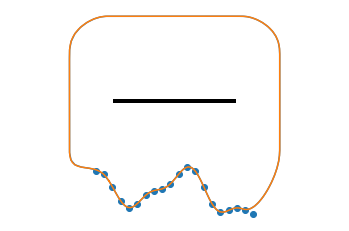

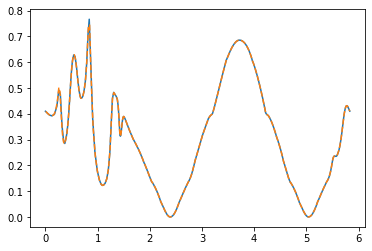

In [18]:
geom = GPDomain("exp", 
                  shape=.05, 
                  num=20, 
                  scale=.05, 
                  bound=.3, 
                  width=1, 
                  height=1, 
                  corner_w = 0.3,
                  line_pos=np.random.rand()*0.4 + 0.2, 
                  n_refine=2, 
                  n_corner_refine=0)    

z, dz, ddz = geom.param

t = lambda s: s  ** 2
dt = lambda s: 2 * s
ddt = lambda s: 2 * np.ones_like(s)

t_inv = lambda t: np.sqrt(t)
dom_s = t_inv(geom.grid.segments)

z_s = lambda s: z(t(s))
dz_s = lambda s: dt(s) * dz(t(s))
ddz_s = lambda s: ddt(s) * dz(t(s)) + (dt(s)**2) * ddz(t(s))

param = [z_s, dz_s, ddz_s]
grid = GaussLegGrid(segments=dom_s, corners=np.ones_like(dom_s).astype(int))
geom_s = Geometry(param, grid)

geom_s.plot(ax=plt.gca())
geom.plot(ax=plt.gca())

r1,_ = geom_s.line_eval_adjoint(-0.45*geom.width + 1j*geom.line_pos, 0.45*geom.width+1j*geom.line_pos, derivative=0)
a1 = geom_s.curve_length()

r2,_ = geom.line_eval_adjoint(derivative=0)
a2 = geom.curve_length()

plt.axis("equal")
remove_axes(plt.gca())

plt.figure()
plt.plot(a1, np.real(r1))
plt.plot(a2, np.real(r2), '--')